In [27]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error,r2_score,mean_absolute_error
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from lightgbm import LGBMRegressor
from statsmodels.graphics.gofplots import qqplot
from lightgbm import LGBMClassifier, LGBMRegressor
from sklearn import datasets, ensemble
from sklearn.inspection import permutation_importance
from sklearn.metrics import mean_squared_error

In [28]:
df = pd.read_csv("train.csv")
df.head(10)

,id,Date,Count,Hour,Hotness,Humidity,Wind Speed,Visibility,Solar Radiation,Rainfall,Snowfall,Seasons,Holiday,Working Day
0,1,05/08/2018,222,6:00,300.3,83,5.04,1080,0.00,0.0,0.0,Summer,NO,YES
1,2,21/01/2018,170,23:00,272.6,32,2.16,2000,0.00,0.0,0.0,Winter,NO,YES
2,3,11/05/2018,486,6:00,285.0,83,1.44,321,0.01,0.0,0.0,Spring,NO,YES
3,4,05/07/2018,929,13:00,301.1,67,3.96,1772,1.43,0.0,0.0,Summer,NO,YES
4,5,02/01/2018,58,5:00,269.9,67,2.16,1384,0.00,0.0,0.0,Winter,NO,YES
5,6,09/08/2018,1494,22:00,300.5,82,1.44,1228,0.00,0.0,0.0,Summer,NO,YES
6,7,15/09/2018,881,1:00,294.8,79,5.04,2000,0.00,0.0,0.0,Autumn,NO,YES
7,8,12/06/2018,1202,12:00,297.0,51,6.48,2000,2.29,0.0,0.0,Summer,NO,YES
8,9,20/09/2018,886,0:00,293.1,58,1.08,2000,0.00,0.0,0.0,Autumn,NO,YES
9,10,15/03/2018,214,16:00,283.7,98,4.32,196,0.14,0.0,0.0,Spring,NO,YES


In [29]:
df.describe()

,id,Count,Hotness,Humidity,Wind Speed,Visibility,Solar Radiation,Rainfall,Snowfall
count,4986.000000,4986.000000,4986.000000,4986.000000,4986.000000,4986.000000,4986.000000,4986.000000,4986.00000
mean,2493.500000,705.851986,285.977778,58.247493,6.159495,1432.546731,0.576897,0.154673,0.06775
std,1439.478551,646.444092,11.838222,20.373339,3.679312,605.976182,0.874589,1.121118,0.40789
min,1.000000,0.000000,255.200000,0.000000,0.000000,33.000000,0.000000,0.000000,0.00000
25%,1247.250000,191.000000,276.700000,43.000000,3.240000,942.250000,0.000000,0.000000,0.00000
50%,2493.500000,505.000000,286.700000,57.000000,5.400000,1678.000000,0.010000,0.000000,0.00000
75%,3739.750000,1066.750000,295.400000,74.000000,8.280000,1999.000000,0.950000,0.000000,0.00000
max,4986.000000,3556.000000,312.400000,98.000000,26.280000,2000.000000,3.520000,29.500000,8.80000


In [30]:
df.dtypes

id                   int64
Date                object
Count                int64
Hour                object
Hotness            float64
Humidity             int64
Wind Speed         float64
Visibility           int64
Solar Radiation    float64
Rainfall           float64
Snowfall           float64
Seasons             object
Holiday             object
Working Day         object
dtype: object

In [31]:
df.isnull().sum()

id                 0
Date               0
Count              0
Hour               0
Hotness            0
Humidity           0
Wind Speed         0
Visibility         0
Solar Radiation    0
Rainfall           0
Snowfall           0
Seasons            0
Holiday            0
Working Day        0
dtype: int64

In [32]:
#checking how many unique values exist
df.apply(lambda x:len(x.unique()))

id                 4986
Date                365
Count              1813
Hour                 24
Hotness             533
Humidity             88
Wind Speed           60
Visibility         1543
Solar Radiation     340
Rainfall             47
Snowfall             45
Seasons               4
Holiday               2
Working Day           2
dtype: int64

In [33]:
def func(df):
 df['Hour'] = df['Hour'].map({ "0:00":  0,   "1:00":  1,"2:00":  2,"3:00":  3,"4:00":  4,"5:00":  5,"6:00":  6,"7:00":  7,"8:00":  8,"9:00":  9,"10:00": 10,"11:00": 11,"12:00": 12,"13:00": 13,"14:00": 14,"15:00": 15,"16:00": 16,"17:00": 17,"18:00": 18,"19:00": 19,"20:00": 20,"21:00": 21,"22:00": 22,"23:00": 23
})
 return df

def func1(df):
 df['Seasons'] = df['Seasons'].map({"Summer":1,"Winter":2,"Autumn":3,"Spring":4
})
 return df

<AxesSubplot:>

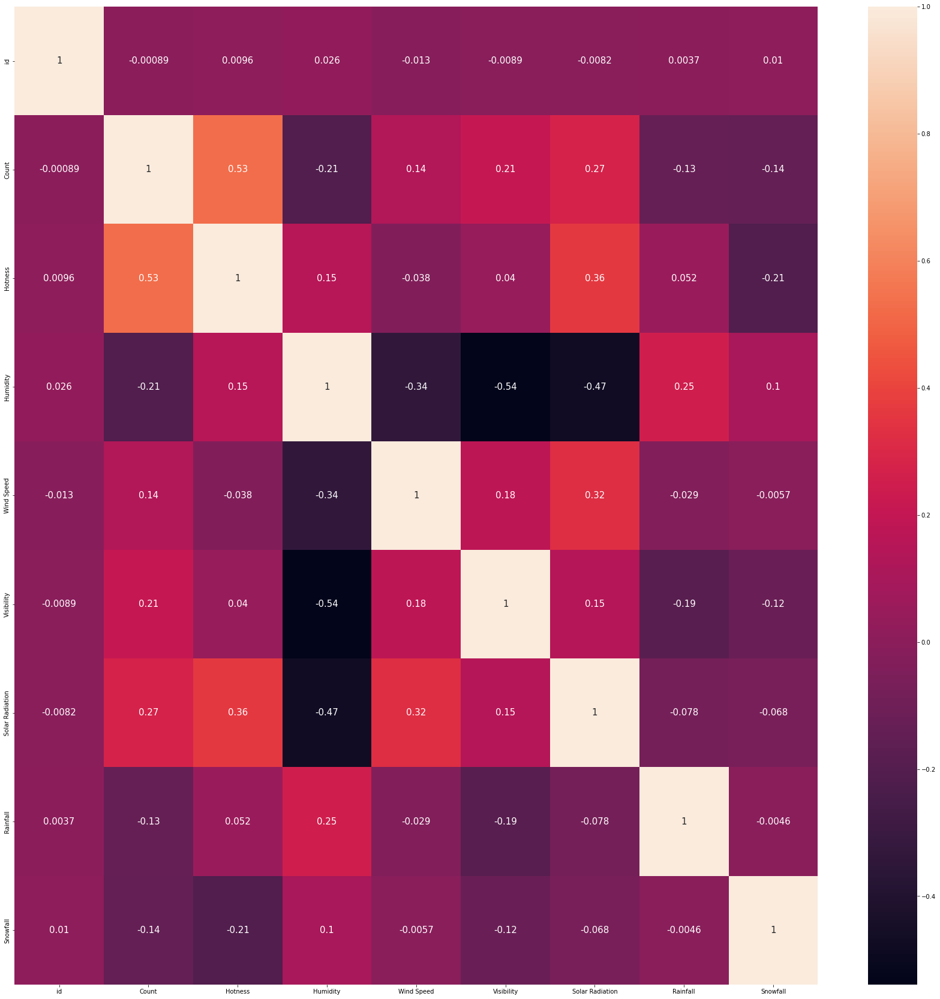

In [34]:
corrm = df.corr()
plt.figure(figsize=(30,30))
sns.heatmap(corrm, annot=True, annot_kws={'size':15})

In [35]:
def one_hot_encod(dframe,column):
  dframe = pd.concat([dframe,pd.get_dummies(dframe[column],prefix = column,drop_first=True)],axis=1)
  dframe = dframe.drop([column],axis=1)
  return dframe


def preprocess(df):
  df2=df
  df2['Date']=pd.to_datetime(df2['Date'],format="%d/%m/%Y")
  df2['day']=df2['Date'].dt.dayofweek
  df2['month']=df2['Date'].dt.month
  df2 = df2.drop(columns=['Date'],axis=1)
  cols = ['Holiday','Working Day']
  for col in cols:
    df2 = one_hot_encod(df2,col)
  df2 = df2.drop(['id'],axis=1)
  df2 = func(df2)
  return df2

In [36]:
df = preprocess(df)
x = df.drop(['Count'],axis=1)
x = one_hot_encod(x,'Seasons')
y = df['Count']
x.head()

,Hour,Hotness,Humidity,Wind Speed,Visibility,Solar Radiation,Rainfall,Snowfall,day,month,Holiday_YES,Working Day_YES,Seasons_Spring,Seasons_Summer,Seasons_Winter
0,6,300.3,83,5.04,1080,0.00,0.0,0.0,6,8,0,1,0,1,0
1,23,272.6,32,2.16,2000,0.00,0.0,0.0,6,1,0,1,0,0,1
2,6,285.0,83,1.44,321,0.01,0.0,0.0,4,5,0,1,1,0,0
3,13,301.1,67,3.96,1772,1.43,0.0,0.0,3,7,0,1,0,1,0
4,5,269.9,67,2.16,1384,0.00,0.0,0.0,1,1,0,1,0,0,1


[Text(0.5, 1.0, 'Count of bikes during weekdays and weekends')]

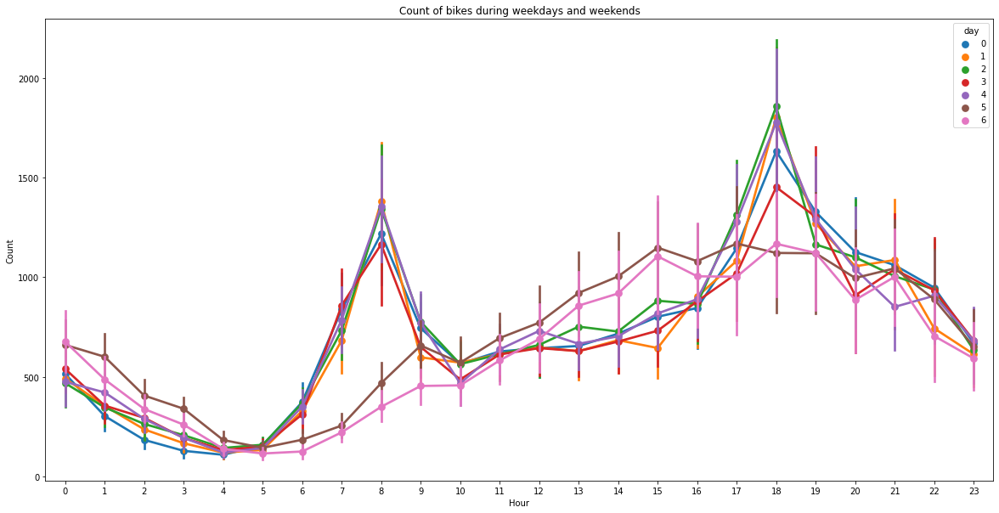

In [37]:
fig, ax = plt.subplots(figsize=(20,10))
sns.pointplot(data=df, x='Hour', y='Count', hue='day', ax=ax)
ax.set(title='Count of bikes during weekdays and weekends')

[Text(0.5, 1.0, 'Count of bikes during weekdays and weekends')]

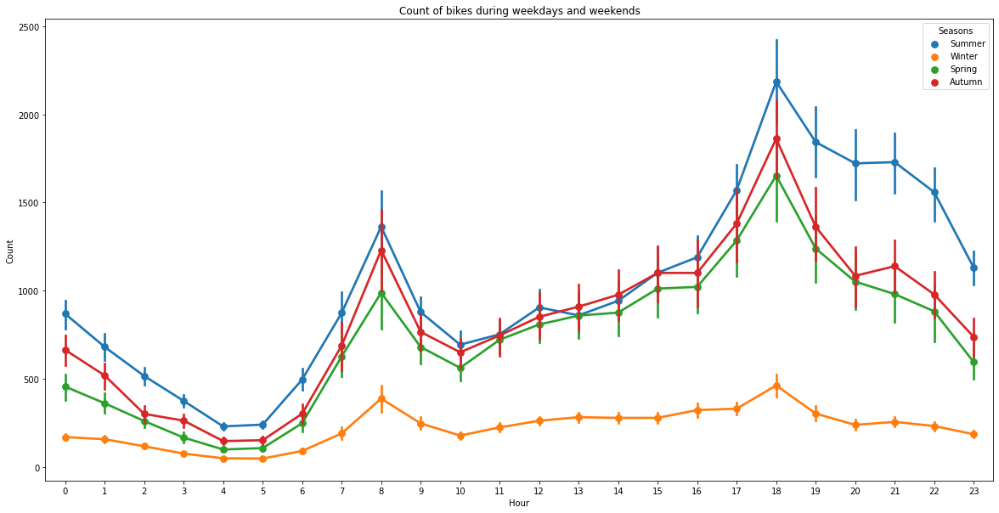

In [38]:
fig, ax = plt.subplots(figsize=(20,10))
sns.pointplot(data=df, x='Hour', y='Count', hue='Seasons', ax=ax)
ax.set(title='Count of bikes during weekdays and weekends')

[Text(0.5, 1.0, 'Count of bikes during different months')]

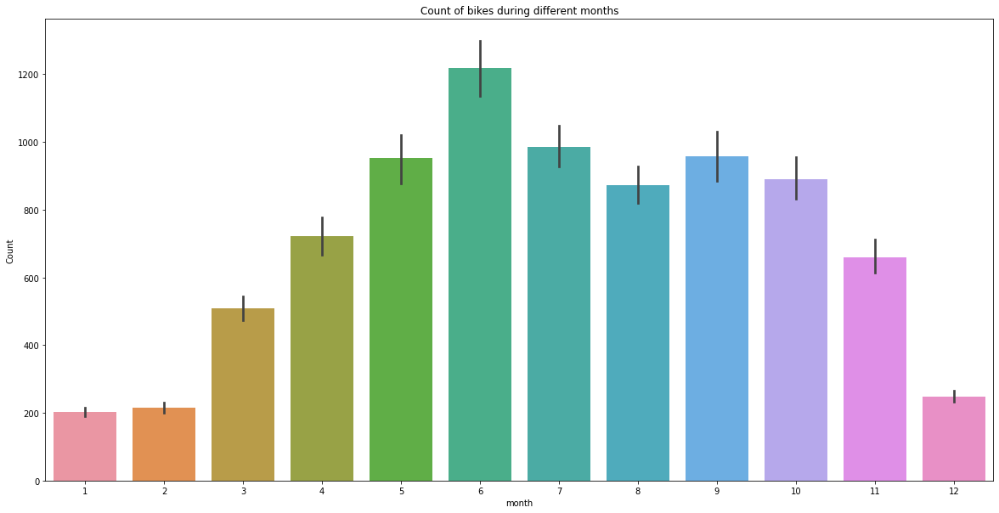

In [39]:
fig, ax = plt.subplots(figsize=(20,10))
sns.barplot(data=df, x='month', y='Count', ax=ax)
ax.set(title='Count of bikes during different months')

[Text(0.5, 1.0, 'Count of bikes during different weekdays')]

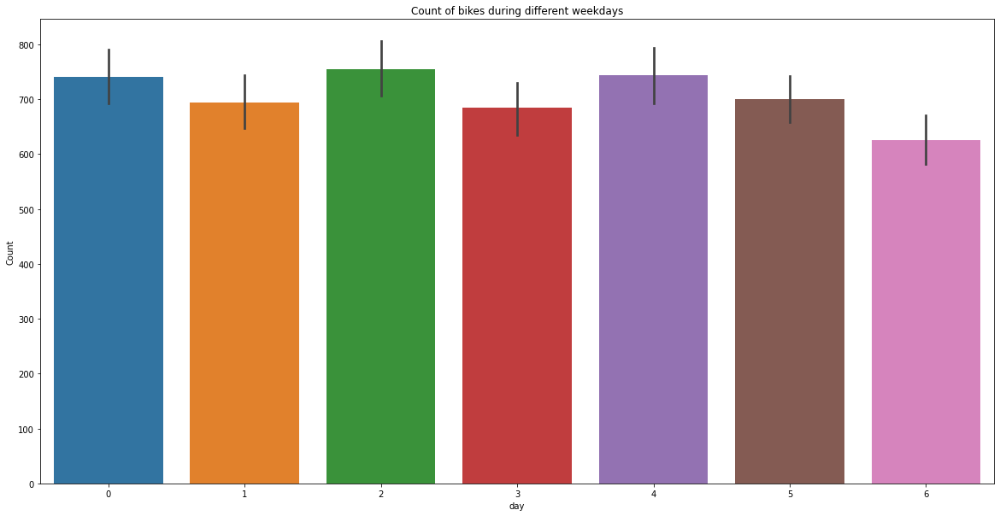

In [40]:
fig, ax = plt.subplots(figsize=(20,10))
sns.barplot(data=df, x='day', y='Count', ax=ax)
ax.set(title='Count of bikes during different weekdays')

In [42]:
x

,Hour,Hotness,Humidity,Wind Speed,Visibility,Solar Radiation,Rainfall,Snowfall,day,month,Holiday_YES,Working Day_YES,Seasons_Spring,Seasons_Summer,Seasons_Winter
0,6,300.3,83,5.04,1080,0.00,0.0,0.0,6,8,0,1,0,1,0
1,23,272.6,32,2.16,2000,0.00,0.0,0.0,6,1,0,1,0,0,1
2,6,285.0,83,1.44,321,0.01,0.0,0.0,4,5,0,1,1,0,0
3,13,301.1,67,3.96,1772,1.43,0.0,0.0,3,7,0,1,0,1,0
4,5,269.9,67,2.16,1384,0.00,0.0,0.0,1,1,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4981,19,306.4,51,9.36,2000,0.59,0.0,0.0,5,7,0,1,0,1,0
4982,19,281.4,51,11.88,1977,0.01,0.0,0.0,0,3,0,1,1,0,0
4983,13,295.5,40,9.36,1854,2.64,0.0,0.0,2,10,1,1,0,0,0
4984,21,268.2,59,3.24,2000,0.00,0.0,0.0,1,1,0,1,0,0,1


In [43]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.1, random_state=42)

In [44]:
#!pip install catboost

In [45]:
import catboost as cb

In [46]:
train_dataset = cb.Pool(x_train, y_train) 
test_dataset = cb.Pool(x_test, y_test)

In [47]:
model = cb.CatBoostRegressor(loss_function='RMSE')

In [48]:
grid = {'iterations': [200, 300, 400 , 500 , 600],
        'learning_rate': [0.013, 0.085 , 0.087],
        'depth': [2, 4, 6, 8 , 10],
        'l2_leaf_reg': [0.2, 0.5, 1, 3 , 5 , 7]}
model.grid_search(grid, train_dataset)

0:	learn: 945.5291731	test: 960.6044391	best: 960.6044391 (0)	total: 2.05ms	remaining: 409ms
1:	learn: 937.3243751	test: 952.8447649	best: 952.8447649 (1)	total: 3.76ms	remaining: 372ms
2:	learn: 928.8865744	test: 944.7391755	best: 944.7391755 (2)	total: 5.41ms	remaining: 355ms
3:	learn: 920.9852090	test: 937.1196682	best: 937.1196682 (3)	total: 7.28ms	remaining: 357ms
4:	learn: 912.4790692	test: 928.6586620	best: 928.6586620 (4)	total: 9.74ms	remaining: 380ms
5:	learn: 904.3242332	test: 920.4955507	best: 920.4955507 (5)	total: 13.3ms	remaining: 429ms
6:	learn: 896.1055258	test: 912.3461866	best: 912.3461866 (6)	total: 14.7ms	remaining: 404ms
7:	learn: 888.1070508	test: 904.4579253	best: 904.4579253 (7)	total: 16.4ms	remaining: 395ms
8:	learn: 881.0189557	test: 897.6587291	best: 897.6587291 (8)	total: 18.4ms	remaining: 391ms
9:	learn: 873.6540784	test: 890.5920501	best: 890.5920501 (9)	total: 19.4ms	remaining: 368ms
10:	learn: 865.9229505	test: 882.9032813	best: 882.9032813 (10)	total:

167:	learn: 426.3720294	test: 450.2161605	best: 450.2161605 (167)	total: 176ms	remaining: 33.6ms
168:	learn: 425.5909013	test: 449.4006863	best: 449.4006863 (168)	total: 178ms	remaining: 32.6ms
169:	learn: 424.7740379	test: 448.5078630	best: 448.5078630 (169)	total: 179ms	remaining: 31.6ms
170:	learn: 424.0195457	test: 447.7266174	best: 447.7266174 (170)	total: 181ms	remaining: 30.6ms
171:	learn: 423.2921795	test: 446.9682148	best: 446.9682148 (171)	total: 182ms	remaining: 29.6ms
172:	learn: 422.5419343	test: 446.1526011	best: 446.1526011 (172)	total: 183ms	remaining: 28.6ms
173:	learn: 421.8277257	test: 445.4191006	best: 445.4191006 (173)	total: 184ms	remaining: 27.5ms
174:	learn: 421.1223861	test: 444.7152602	best: 444.7152602 (174)	total: 185ms	remaining: 26.5ms
175:	learn: 420.4214205	test: 444.0105252	best: 444.0105252 (175)	total: 187ms	remaining: 25.4ms
176:	learn: 419.7220147	test: 443.2829761	best: 443.2829761 (176)	total: 188ms	remaining: 24.4ms
177:	learn: 418.8473356	test: 

107:	learn: 314.8577128	test: 333.7852881	best: 333.7852881 (107)	total: 122ms	remaining: 104ms
108:	learn: 314.5658284	test: 333.4681545	best: 333.4681545 (108)	total: 123ms	remaining: 103ms
109:	learn: 313.9652675	test: 332.8222430	best: 332.8222430 (109)	total: 125ms	remaining: 102ms
110:	learn: 313.5556375	test: 332.4218642	best: 332.4218642 (110)	total: 127ms	remaining: 102ms
111:	learn: 313.1473143	test: 332.0666095	best: 332.0666095 (111)	total: 128ms	remaining: 101ms
112:	learn: 312.5967945	test: 331.3608388	best: 331.3608388 (112)	total: 129ms	remaining: 99.5ms
113:	learn: 312.2513629	test: 331.0447695	best: 331.0447695 (113)	total: 130ms	remaining: 98.4ms
114:	learn: 310.9667509	test: 329.3472941	best: 329.3472941 (114)	total: 132ms	remaining: 97.2ms
115:	learn: 310.3709876	test: 328.5120807	best: 328.5120807 (115)	total: 133ms	remaining: 96.1ms
116:	learn: 310.0286823	test: 328.3069085	best: 328.3069085 (116)	total: 134ms	remaining: 94.9ms
117:	learn: 309.5505089	test: 327.8

41:	learn: 368.4102207	test: 388.7692195	best: 388.7692195 (41)	total: 50.5ms	remaining: 190ms
42:	learn: 366.9426590	test: 387.1076179	best: 387.1076179 (42)	total: 51.9ms	remaining: 190ms
43:	learn: 364.3256945	test: 384.6288438	best: 384.6288438 (43)	total: 54.5ms	remaining: 193ms
44:	learn: 362.8869101	test: 383.0055945	best: 383.0055945 (44)	total: 55.6ms	remaining: 191ms
45:	learn: 361.6662315	test: 381.8460851	best: 381.8460851 (45)	total: 56.6ms	remaining: 189ms
46:	learn: 360.5371744	test: 380.2965188	best: 380.2965188 (46)	total: 57.6ms	remaining: 188ms
47:	learn: 359.3416209	test: 378.8720268	best: 378.8720268 (47)	total: 58.6ms	remaining: 186ms
48:	learn: 358.0445398	test: 377.4709896	best: 377.4709896 (48)	total: 59.5ms	remaining: 183ms
49:	learn: 357.0619452	test: 376.5485171	best: 376.5485171 (49)	total: 60.5ms	remaining: 182ms
50:	learn: 355.5048469	test: 374.9475094	best: 374.9475094 (50)	total: 61.5ms	remaining: 180ms
51:	learn: 354.1126657	test: 373.6147056	best: 373

2:	learn: 928.8953257	test: 944.7474614	best: 944.7474614 (2)	total: 3.55ms	remaining: 233ms
3:	learn: 920.9957143	test: 937.1296465	best: 937.1296465 (3)	total: 5.03ms	remaining: 246ms
4:	learn: 912.4930735	test: 928.6722483	best: 928.6722483 (4)	total: 6.51ms	remaining: 254ms
5:	learn: 904.3403946	test: 920.5113430	best: 920.5113430 (5)	total: 7.85ms	remaining: 254ms
6:	learn: 896.1241414	test: 912.3644256	best: 912.3644256 (6)	total: 9.09ms	remaining: 251ms
7:	learn: 888.1275727	test: 904.4780032	best: 904.4780032 (7)	total: 10.7ms	remaining: 256ms
8:	learn: 881.0403989	test: 897.6796943	best: 897.6796943 (8)	total: 11.8ms	remaining: 251ms
9:	learn: 873.6769752	test: 890.6144212	best: 890.6144212 (9)	total: 12.9ms	remaining: 246ms
10:	learn: 865.9488189	test: 882.9286688	best: 882.9286688 (10)	total: 14.1ms	remaining: 242ms
11:	learn: 859.3113871	test: 876.4444368	best: 876.4444368 (11)	total: 15.4ms	remaining: 241ms
12:	learn: 852.6855253	test: 870.0803793	best: 870.0803793 (12)	to

162:	learn: 431.0729353	test: 454.8157405	best: 454.8157405 (162)	total: 181ms	remaining: 41ms
163:	learn: 430.1252659	test: 453.8548172	best: 453.8548172 (163)	total: 182ms	remaining: 40ms
164:	learn: 429.2950974	test: 453.0141333	best: 453.0141333 (164)	total: 184ms	remaining: 39ms
165:	learn: 428.4600673	test: 452.1457119	best: 452.1457119 (165)	total: 185ms	remaining: 37.9ms
166:	learn: 427.3786506	test: 451.1249835	best: 451.1249835 (166)	total: 186ms	remaining: 36.8ms
167:	learn: 426.5862541	test: 450.3071535	best: 450.3071535 (167)	total: 188ms	remaining: 35.7ms
168:	learn: 425.8041013	test: 449.4904420	best: 449.4904420 (168)	total: 189ms	remaining: 34.7ms
169:	learn: 424.9865580	test: 448.5963782	best: 448.5963782 (169)	total: 191ms	remaining: 33.8ms
170:	learn: 424.2329649	test: 447.8152070	best: 447.8152070 (170)	total: 193ms	remaining: 32.7ms
171:	learn: 423.5108149	test: 447.0612940	best: 447.0612940 (171)	total: 194ms	remaining: 31.6ms
172:	learn: 422.7792562	test: 446.33

91:	learn: 324.2790480	test: 343.1380056	best: 343.1380056 (91)	total: 113ms	remaining: 133ms
92:	learn: 323.9112798	test: 342.8661943	best: 342.8661943 (92)	total: 115ms	remaining: 132ms
93:	learn: 323.3793254	test: 342.3891180	best: 342.3891180 (93)	total: 116ms	remaining: 131ms
94:	learn: 321.8968748	test: 340.8875775	best: 340.8875775 (94)	total: 118ms	remaining: 130ms
95:	learn: 321.4239636	test: 340.3266765	best: 340.3266765 (95)	total: 119ms	remaining: 129ms
96:	learn: 320.7031980	test: 339.6991592	best: 339.6991592 (96)	total: 120ms	remaining: 127ms
97:	learn: 320.3950868	test: 339.3492015	best: 339.3492015 (97)	total: 121ms	remaining: 126ms
98:	learn: 319.8009601	test: 338.9120539	best: 338.9120539 (98)	total: 122ms	remaining: 125ms
99:	learn: 319.2139852	test: 338.3042653	best: 338.3042653 (99)	total: 124ms	remaining: 124ms
100:	learn: 318.7386064	test: 337.7973015	best: 337.7973015 (100)	total: 125ms	remaining: 122ms
101:	learn: 318.3895894	test: 337.4151225	best: 337.415122

59:	learn: 346.5281711	test: 364.2710070	best: 364.2710070 (59)	total: 59.1ms	remaining: 138ms
60:	learn: 345.7681125	test: 363.4274382	best: 363.4274382 (60)	total: 60.5ms	remaining: 138ms
61:	learn: 344.7428452	test: 362.5200703	best: 362.5200703 (61)	total: 62ms	remaining: 138ms
62:	learn: 344.0177897	test: 361.9159315	best: 361.9159315 (62)	total: 63.4ms	remaining: 138ms
63:	learn: 343.0828967	test: 360.7096770	best: 360.7096770 (63)	total: 64.6ms	remaining: 137ms
64:	learn: 342.4053141	test: 360.0926980	best: 360.0926980 (64)	total: 65.8ms	remaining: 137ms
65:	learn: 341.7210322	test: 359.2711212	best: 359.2711212 (65)	total: 67.3ms	remaining: 137ms
66:	learn: 341.0866639	test: 358.7009810	best: 358.7009810 (66)	total: 68.5ms	remaining: 136ms
67:	learn: 340.4775026	test: 358.1123074	best: 358.1123074 (67)	total: 69.7ms	remaining: 135ms
68:	learn: 338.6557092	test: 356.6967826	best: 356.6967826 (68)	total: 70.8ms	remaining: 135ms
69:	learn: 337.7906410	test: 355.6760354	best: 355.6

24:	learn: 774.1137789	test: 793.0098298	best: 793.0098298 (24)	total: 26.1ms	remaining: 183ms
25:	learn: 768.0689820	test: 787.0208105	best: 787.0208105 (25)	total: 27.4ms	remaining: 183ms
26:	learn: 762.0016355	test: 780.9997615	best: 780.9997615 (26)	total: 28.7ms	remaining: 184ms
27:	learn: 756.6546311	test: 775.8077195	best: 775.8077195 (27)	total: 29.9ms	remaining: 183ms
28:	learn: 751.2154028	test: 770.5705432	best: 770.5705432 (28)	total: 31ms	remaining: 183ms
29:	learn: 745.4529872	test: 764.9148782	best: 764.9148782 (29)	total: 32.2ms	remaining: 182ms
30:	learn: 740.3640924	test: 760.0504498	best: 760.0504498 (30)	total: 33.4ms	remaining: 182ms
31:	learn: 734.9984286	test: 754.8731399	best: 754.8731399 (31)	total: 34.5ms	remaining: 181ms
32:	learn: 729.7292642	test: 749.7206418	best: 749.7206418 (32)	total: 35.7ms	remaining: 181ms
33:	learn: 724.3178942	test: 744.4011468	best: 744.4011468 (33)	total: 37ms	remaining: 181ms
34:	learn: 719.4510562	test: 739.7642382	best: 739.764

188:	learn: 411.1824688	test: 434.3827322	best: 434.3827322 (188)	total: 195ms	remaining: 11.3ms
189:	learn: 410.5790372	test: 433.7334350	best: 433.7334350 (189)	total: 196ms	remaining: 10.3ms
190:	learn: 409.9589445	test: 433.0407820	best: 433.0407820 (190)	total: 198ms	remaining: 9.32ms
191:	learn: 409.3438798	test: 432.4001926	best: 432.4001926 (191)	total: 199ms	remaining: 8.3ms
192:	learn: 408.7576941	test: 431.7620854	best: 431.7620854 (192)	total: 200ms	remaining: 7.27ms
193:	learn: 408.1948206	test: 431.1674132	best: 431.1674132 (193)	total: 202ms	remaining: 6.23ms
194:	learn: 407.5951883	test: 430.5646365	best: 430.5646365 (194)	total: 203ms	remaining: 5.2ms
195:	learn: 407.0349709	test: 429.9576657	best: 429.9576657 (195)	total: 204ms	remaining: 4.16ms
196:	learn: 406.4782258	test: 429.3792717	best: 429.3792717 (196)	total: 205ms	remaining: 3.13ms
197:	learn: 405.8934417	test: 428.7368289	best: 428.7368289 (197)	total: 206ms	remaining: 2.08ms
198:	learn: 405.3719821	test: 42

149:	learn: 295.8155945	test: 314.9377367	best: 314.9377367 (149)	total: 153ms	remaining: 51.1ms
150:	learn: 295.4460571	test: 314.5382007	best: 314.5382007 (150)	total: 155ms	remaining: 50.2ms
151:	learn: 294.9221658	test: 313.9772843	best: 313.9772843 (151)	total: 156ms	remaining: 49.3ms
152:	learn: 294.4869588	test: 313.6293695	best: 313.6293695 (152)	total: 157ms	remaining: 48.4ms
153:	learn: 294.2797629	test: 313.5268795	best: 313.5268795 (153)	total: 159ms	remaining: 47.4ms
154:	learn: 293.6205391	test: 312.5819786	best: 312.5819786 (154)	total: 160ms	remaining: 46.4ms
155:	learn: 293.3628929	test: 312.5196031	best: 312.5196031 (155)	total: 161ms	remaining: 45.4ms
156:	learn: 292.8896062	test: 312.0039311	best: 312.0039311 (156)	total: 162ms	remaining: 44.4ms
157:	learn: 292.7045561	test: 311.9200707	best: 311.9200707 (157)	total: 163ms	remaining: 43.4ms
158:	learn: 292.2951845	test: 311.6761392	best: 311.6761392 (158)	total: 164ms	remaining: 42.3ms
159:	learn: 292.0720601	test: 

108:	learn: 314.0314910	test: 331.8849622	best: 331.8849622 (108)	total: 112ms	remaining: 93.4ms
109:	learn: 312.7735484	test: 330.1919556	best: 330.1919556 (109)	total: 113ms	remaining: 92.6ms
110:	learn: 311.9858216	test: 329.5775715	best: 329.5775715 (110)	total: 115ms	remaining: 92ms
111:	learn: 311.5290142	test: 329.0555434	best: 329.0555434 (111)	total: 116ms	remaining: 91.2ms
112:	learn: 310.4058952	test: 327.8095720	best: 327.8095720 (112)	total: 117ms	remaining: 90.3ms
113:	learn: 310.0244260	test: 327.6885872	best: 327.6885872 (113)	total: 118ms	remaining: 89.4ms
114:	learn: 309.6134618	test: 327.3152434	best: 327.3152434 (114)	total: 120ms	remaining: 88.4ms
115:	learn: 309.2435917	test: 327.0022747	best: 327.0022747 (115)	total: 122ms	remaining: 88.1ms
116:	learn: 308.6654349	test: 326.3500544	best: 326.3500544 (116)	total: 123ms	remaining: 87.1ms
117:	learn: 308.1636572	test: 325.8234513	best: 325.8234513 (117)	total: 124ms	remaining: 86.2ms
118:	learn: 307.3954462	test: 32

60:	learn: 610.3336399	test: 633.0337823	best: 633.0337823 (60)	total: 61.4ms	remaining: 140ms
61:	learn: 606.9092667	test: 629.6468546	best: 629.6468546 (61)	total: 62.8ms	remaining: 140ms
62:	learn: 603.6246463	test: 626.5101430	best: 626.5101430 (62)	total: 64.4ms	remaining: 140ms
63:	learn: 600.3379208	test: 623.3379800	best: 623.3379800 (63)	total: 65.7ms	remaining: 140ms
64:	learn: 597.1721866	test: 620.3102471	best: 620.3102471 (64)	total: 67ms	remaining: 139ms
65:	learn: 594.0825238	test: 617.2520866	best: 617.2520866 (65)	total: 68.3ms	remaining: 139ms
66:	learn: 590.8882098	test: 614.0017799	best: 614.0017799 (66)	total: 69.4ms	remaining: 138ms
67:	learn: 587.8516108	test: 611.0874002	best: 611.0874002 (67)	total: 70.6ms	remaining: 137ms
68:	learn: 584.6780390	test: 607.9499554	best: 607.9499554 (68)	total: 71.8ms	remaining: 136ms
69:	learn: 581.5771877	test: 604.8546760	best: 604.8546760 (69)	total: 72.9ms	remaining: 135ms
70:	learn: 578.7128031	test: 602.0516602	best: 602.0

33:	learn: 390.9583318	test: 413.0657734	best: 413.0657734 (33)	total: 34ms	remaining: 166ms
34:	learn: 388.4419997	test: 410.3792955	best: 410.3792955 (34)	total: 35.5ms	remaining: 167ms
35:	learn: 385.5271952	test: 407.0384238	best: 407.0384238 (35)	total: 36.8ms	remaining: 168ms
36:	learn: 383.2138586	test: 404.6115599	best: 404.6115599 (36)	total: 38.2ms	remaining: 168ms
37:	learn: 381.1651072	test: 402.3848106	best: 402.3848106 (37)	total: 39.4ms	remaining: 168ms
38:	learn: 379.3212995	test: 400.3601048	best: 400.3601048 (38)	total: 40.5ms	remaining: 167ms
39:	learn: 377.4482617	test: 398.1693665	best: 398.1693665 (39)	total: 41.7ms	remaining: 167ms
40:	learn: 375.6232276	test: 396.0176241	best: 396.0176241 (40)	total: 42.8ms	remaining: 166ms
41:	learn: 373.2092959	test: 393.7987247	best: 393.7987247 (41)	total: 44ms	remaining: 165ms
42:	learn: 369.9024218	test: 390.8643184	best: 390.8643184 (42)	total: 45.4ms	remaining: 166ms
43:	learn: 367.2382736	test: 388.3000415	best: 388.300

193:	learn: 280.7405319	test: 300.8972268	best: 300.8972268 (193)	total: 205ms	remaining: 6.35ms
194:	learn: 280.4445515	test: 300.6004688	best: 300.6004688 (194)	total: 207ms	remaining: 5.3ms
195:	learn: 280.3018579	test: 300.5590692	best: 300.5590692 (195)	total: 208ms	remaining: 4.25ms
196:	learn: 279.8561343	test: 300.0770767	best: 300.0770767 (196)	total: 209ms	remaining: 3.19ms
197:	learn: 279.6620788	test: 299.9755675	best: 299.9755675 (197)	total: 210ms	remaining: 2.13ms
198:	learn: 279.3978946	test: 299.6276209	best: 299.6276209 (198)	total: 212ms	remaining: 1.06ms
199:	learn: 279.2494897	test: 299.3982417	best: 299.3982417 (199)	total: 213ms	remaining: 0us

bestTest = 299.3982417
bestIteration = 199

10:	loss: 299.3982417	best: 296.5801148 (5)	total: 2.67s	remaining: 1m 46s
0:	learn: 895.6515236	test: 910.8068671	best: 910.8068671 (0)	total: 1.12ms	remaining: 223ms
1:	learn: 843.2900627	test: 859.3810243	best: 859.3810243 (1)	total: 2.34ms	remaining: 231ms
2:	learn: 799.07048

152:	learn: 291.9628064	test: 310.1204559	best: 310.1204559 (152)	total: 159ms	remaining: 48.9ms
153:	learn: 291.6621909	test: 310.0309743	best: 310.0309743 (153)	total: 161ms	remaining: 48ms
154:	learn: 291.4594066	test: 309.8791902	best: 309.8791902 (154)	total: 162ms	remaining: 47ms
155:	learn: 291.0422060	test: 309.3710128	best: 309.3710128 (155)	total: 163ms	remaining: 46.1ms
156:	learn: 290.7119213	test: 308.9323662	best: 308.9323662 (156)	total: 165ms	remaining: 45.1ms
157:	learn: 289.9814391	test: 308.1633923	best: 308.1633923 (157)	total: 166ms	remaining: 44.1ms
158:	learn: 289.7151841	test: 308.0890288	best: 308.0890288 (158)	total: 167ms	remaining: 43.1ms
159:	learn: 289.3867546	test: 307.7839537	best: 307.7839537 (159)	total: 168ms	remaining: 42ms
160:	learn: 289.0900620	test: 307.4356805	best: 307.4356805 (160)	total: 169ms	remaining: 41ms
161:	learn: 288.6951402	test: 307.1815915	best: 307.1815915 (161)	total: 171ms	remaining: 40ms
162:	learn: 288.3620617	test: 306.808580

111:	learn: 491.2445962	test: 515.7686765	best: 515.7686765 (111)	total: 114ms	remaining: 89.7ms
112:	learn: 489.6645975	test: 514.1870839	best: 514.1870839 (112)	total: 116ms	remaining: 89.1ms
113:	learn: 488.1684389	test: 512.6935476	best: 512.6935476 (113)	total: 117ms	remaining: 88.3ms
114:	learn: 486.6280891	test: 511.1039644	best: 511.1039644 (114)	total: 118ms	remaining: 87.5ms
115:	learn: 485.0787631	test: 509.5297174	best: 509.5297174 (115)	total: 120ms	remaining: 86.8ms
116:	learn: 483.6869933	test: 508.1492286	best: 508.1492286 (116)	total: 121ms	remaining: 85.9ms
117:	learn: 482.1766186	test: 506.5905643	best: 506.5905643 (117)	total: 122ms	remaining: 84.9ms
118:	learn: 480.7180701	test: 505.1405871	best: 505.1405871 (118)	total: 123ms	remaining: 84ms
119:	learn: 479.4377395	test: 503.8374389	best: 503.8374389 (119)	total: 125ms	remaining: 83.1ms
120:	learn: 478.1268159	test: 502.4936427	best: 502.4936427 (120)	total: 126ms	remaining: 82.1ms
121:	learn: 476.7777037	test: 50

69:	learn: 340.1739307	test: 357.6356380	best: 357.6356380 (69)	total: 69.7ms	remaining: 130ms
70:	learn: 339.6248790	test: 356.9823168	best: 356.9823168 (70)	total: 71.2ms	remaining: 129ms
71:	learn: 338.8533483	test: 356.1361479	best: 356.1361479 (71)	total: 72.5ms	remaining: 129ms
72:	learn: 338.0321026	test: 355.5480052	best: 355.5480052 (72)	total: 74ms	remaining: 129ms
73:	learn: 337.4833219	test: 354.9780243	best: 354.9780243 (73)	total: 75.3ms	remaining: 128ms
74:	learn: 336.7956993	test: 354.4791421	best: 354.4791421 (74)	total: 76.3ms	remaining: 127ms
75:	learn: 335.9278347	test: 353.6771074	best: 353.6771074 (75)	total: 77.4ms	remaining: 126ms
76:	learn: 334.9850930	test: 352.6693407	best: 352.6693407 (76)	total: 78.5ms	remaining: 125ms
77:	learn: 333.3121023	test: 351.2141313	best: 351.2141313 (77)	total: 79.6ms	remaining: 125ms
78:	learn: 332.8419872	test: 350.7247026	best: 350.7247026 (78)	total: 80.7ms	remaining: 124ms
79:	learn: 332.3659820	test: 350.2417750	best: 350.2

47:	learn: 360.4881692	test: 379.7962415	best: 379.7962415 (47)	total: 47.6ms	remaining: 151ms
48:	learn: 359.3635987	test: 378.6429527	best: 378.6429527 (48)	total: 48.9ms	remaining: 151ms
49:	learn: 358.2477885	test: 377.4191146	best: 377.4191146 (49)	total: 50.5ms	remaining: 152ms
50:	learn: 356.8392679	test: 375.7067551	best: 375.7067551 (50)	total: 51.8ms	remaining: 151ms
51:	learn: 355.3831561	test: 374.2843876	best: 374.2843876 (51)	total: 53ms	remaining: 151ms
52:	learn: 354.1442803	test: 372.9998139	best: 372.9998139 (52)	total: 54.2ms	remaining: 150ms
53:	learn: 352.4040914	test: 370.9843197	best: 370.9843197 (53)	total: 55.4ms	remaining: 150ms
54:	learn: 351.4706796	test: 370.1024649	best: 370.1024649 (54)	total: 56.5ms	remaining: 149ms
55:	learn: 350.4059145	test: 368.8515555	best: 368.8515555 (55)	total: 57.6ms	remaining: 148ms
56:	learn: 349.2639072	test: 367.4179999	best: 367.4179999 (56)	total: 58.8ms	remaining: 147ms
57:	learn: 348.3543783	test: 366.2776364	best: 366.2

9:	learn: 874.1689661	test: 891.0951079	best: 891.0951079 (9)	total: 10.3ms	remaining: 196ms
10:	learn: 866.5045885	test: 883.4740884	best: 883.4740884 (10)	total: 11.7ms	remaining: 201ms
11:	learn: 859.8859858	test: 877.0081127	best: 877.0081127 (11)	total: 14.7ms	remaining: 230ms
12:	learn: 853.2779028	test: 870.6611226	best: 870.6611226 (12)	total: 15.9ms	remaining: 229ms
13:	learn: 846.3699242	test: 863.9970721	best: 863.9970721 (13)	total: 17.1ms	remaining: 227ms
14:	learn: 839.2637793	test: 856.8817391	best: 856.8817391 (14)	total: 18.3ms	remaining: 225ms
15:	learn: 832.1395046	test: 849.8321759	best: 849.8321759 (15)	total: 19.4ms	remaining: 224ms
16:	learn: 825.1449720	test: 842.8347389	best: 842.8347389 (16)	total: 20.6ms	remaining: 221ms
17:	learn: 818.5849970	test: 836.4096573	best: 836.4096573 (17)	total: 21.7ms	remaining: 220ms
18:	learn: 812.2744149	test: 830.4224377	best: 830.4224377 (18)	total: 22.9ms	remaining: 219ms
19:	learn: 805.7171988	test: 823.9251574	best: 823.9

169:	learn: 426.4876113	test: 449.9772702	best: 449.9772702 (169)	total: 176ms	remaining: 31ms
170:	learn: 425.6669823	test: 449.1121453	best: 449.1121453 (170)	total: 177ms	remaining: 30ms
171:	learn: 424.9429675	test: 448.3575607	best: 448.3575607 (171)	total: 179ms	remaining: 29.1ms
172:	learn: 424.2253794	test: 447.6487660	best: 447.6487660 (172)	total: 180ms	remaining: 28.1ms
173:	learn: 423.5070689	test: 446.9109790	best: 446.9109790 (173)	total: 181ms	remaining: 27.1ms
174:	learn: 422.8065603	test: 446.2098746	best: 446.2098746 (174)	total: 183ms	remaining: 26.1ms
175:	learn: 422.1160313	test: 445.5157201	best: 445.5157201 (175)	total: 184ms	remaining: 25.1ms
176:	learn: 421.4171825	test: 444.7883087	best: 444.7883087 (176)	total: 185ms	remaining: 24ms
177:	learn: 420.5534723	test: 443.9397584	best: 443.9397584 (177)	total: 186ms	remaining: 23ms
178:	learn: 419.8940578	test: 443.2284213	best: 443.2284213 (178)	total: 187ms	remaining: 22ms
179:	learn: 419.1472574	test: 442.515425

143:	learn: 300.2417661	test: 318.1335107	best: 318.1335107 (143)	total: 144ms	remaining: 56.2ms
144:	learn: 299.8749583	test: 317.7270121	best: 317.7270121 (144)	total: 146ms	remaining: 55.3ms
145:	learn: 299.2835987	test: 317.2278681	best: 317.2278681 (145)	total: 148ms	remaining: 54.6ms
146:	learn: 298.9853408	test: 317.1232523	best: 317.1232523 (146)	total: 149ms	remaining: 53.9ms
147:	learn: 298.5485175	test: 316.6414532	best: 316.6414532 (147)	total: 151ms	remaining: 53ms
148:	learn: 298.2016355	test: 316.2462287	best: 316.2462287 (148)	total: 152ms	remaining: 52.2ms
149:	learn: 297.4377400	test: 315.1737459	best: 315.1737459 (149)	total: 154ms	remaining: 51.4ms
150:	learn: 297.0764485	test: 314.8553541	best: 314.8553541 (150)	total: 155ms	remaining: 50.4ms
151:	learn: 296.7857268	test: 314.5842922	best: 314.5842922 (151)	total: 157ms	remaining: 49.5ms
152:	learn: 296.2676555	test: 314.2429300	best: 314.2429300 (152)	total: 158ms	remaining: 48.6ms
153:	learn: 295.9761723	test: 31

101:	learn: 318.8467371	test: 336.1643739	best: 336.1643739 (101)	total: 101ms	remaining: 96.7ms
102:	learn: 317.6117639	test: 334.8137094	best: 334.8137094 (102)	total: 102ms	remaining: 96.1ms
103:	learn: 317.1668474	test: 334.4482057	best: 334.4482057 (103)	total: 104ms	remaining: 95.6ms
104:	learn: 316.7367127	test: 334.0743585	best: 334.0743585 (104)	total: 105ms	remaining: 94.8ms
105:	learn: 316.2281528	test: 333.6386289	best: 333.6386289 (105)	total: 106ms	remaining: 94ms
106:	learn: 315.8280546	test: 333.3855479	best: 333.3855479 (106)	total: 107ms	remaining: 93.1ms
107:	learn: 315.2871759	test: 332.8510565	best: 332.8510565 (107)	total: 108ms	remaining: 92.2ms
108:	learn: 314.2925523	test: 331.4947503	best: 331.4947503 (108)	total: 109ms	remaining: 91.3ms
109:	learn: 313.8110699	test: 330.9506719	best: 330.9506719 (109)	total: 110ms	remaining: 90.3ms
110:	learn: 313.0665005	test: 330.4062458	best: 330.4062458 (110)	total: 111ms	remaining: 89.4ms
111:	learn: 312.4126209	test: 32

64:	learn: 596.6770565	test: 619.7704941	best: 619.7704941 (64)	total: 63.7ms	remaining: 230ms
65:	learn: 593.5915287	test: 616.7162707	best: 616.7162707 (65)	total: 65.1ms	remaining: 231ms
66:	learn: 590.4109033	test: 613.4791944	best: 613.4791944 (66)	total: 66.5ms	remaining: 231ms
67:	learn: 587.3742549	test: 610.5642103	best: 610.5642103 (67)	total: 67.8ms	remaining: 231ms
68:	learn: 584.1907664	test: 607.4165414	best: 607.4165414 (68)	total: 69.6ms	remaining: 233ms
69:	learn: 581.1025785	test: 604.3332898	best: 604.3332898 (69)	total: 70.7ms	remaining: 232ms
70:	learn: 578.2436242	test: 601.5353503	best: 601.5353503 (70)	total: 71.8ms	remaining: 232ms
71:	learn: 575.3935372	test: 598.6674696	best: 598.6674696 (71)	total: 73ms	remaining: 231ms
72:	learn: 572.7523021	test: 596.1767511	best: 596.1767511 (72)	total: 74ms	remaining: 230ms
73:	learn: 570.0749314	test: 593.6240875	best: 593.6240875 (73)	total: 75.2ms	remaining: 230ms
74:	learn: 567.4347930	test: 590.9605285	best: 590.960

227:	learn: 389.7218756	test: 412.3150210	best: 412.3150210 (227)	total: 233ms	remaining: 73.7ms
228:	learn: 389.2594048	test: 411.7834112	best: 411.7834112 (228)	total: 235ms	remaining: 72.7ms
229:	learn: 388.9222999	test: 411.4271252	best: 411.4271252 (229)	total: 236ms	remaining: 71.9ms
230:	learn: 388.4880839	test: 410.9886565	best: 410.9886565 (230)	total: 238ms	remaining: 71ms
231:	learn: 388.0605941	test: 410.5592474	best: 410.5592474 (231)	total: 239ms	remaining: 70ms
232:	learn: 387.6201840	test: 410.0549409	best: 410.0549409 (232)	total: 240ms	remaining: 69ms
233:	learn: 387.1591799	test: 409.6291009	best: 409.6291009 (233)	total: 241ms	remaining: 68ms
234:	learn: 386.7354455	test: 409.1857710	best: 409.1857710 (234)	total: 242ms	remaining: 67ms
235:	learn: 386.3265736	test: 408.7668404	best: 408.7668404 (235)	total: 243ms	remaining: 66ms
236:	learn: 385.9262790	test: 408.3436199	best: 408.3436199 (236)	total: 245ms	remaining: 65ms
237:	learn: 385.5069526	test: 407.8889891	be

88:	learn: 325.7218526	test: 344.2903873	best: 344.2903873 (88)	total: 88.7ms	remaining: 210ms
89:	learn: 325.2850785	test: 343.8956229	best: 343.8956229 (89)	total: 90.2ms	remaining: 211ms
90:	learn: 324.6005940	test: 343.2815461	best: 343.2815461 (90)	total: 91.5ms	remaining: 210ms
91:	learn: 323.8573803	test: 342.5344384	best: 342.5344384 (91)	total: 92.8ms	remaining: 210ms
92:	learn: 323.3229360	test: 341.8842846	best: 341.8842846 (92)	total: 94ms	remaining: 209ms
93:	learn: 322.7582728	test: 341.3888301	best: 341.3888301 (93)	total: 95.1ms	remaining: 209ms
94:	learn: 322.1837585	test: 340.8092371	best: 340.8092371 (94)	total: 96.3ms	remaining: 208ms
95:	learn: 321.7312489	test: 340.4331302	best: 340.4331302 (95)	total: 97.5ms	remaining: 207ms
96:	learn: 321.0260893	test: 339.8132899	best: 339.8132899 (96)	total: 98.6ms	remaining: 206ms
97:	learn: 320.5644671	test: 339.2855181	best: 339.2855181 (97)	total: 99.8ms	remaining: 206ms
98:	learn: 319.9792115	test: 338.8583187	best: 338.8

251:	learn: 266.6043337	test: 286.9643609	best: 286.9643609 (251)	total: 257ms	remaining: 49ms
252:	learn: 265.8295728	test: 286.7088956	best: 286.7088956 (252)	total: 258ms	remaining: 48ms
253:	learn: 265.6863898	test: 286.6083052	best: 286.6083052 (253)	total: 260ms	remaining: 47.1ms
254:	learn: 265.5031856	test: 286.3882105	best: 286.3882105 (254)	total: 261ms	remaining: 46.1ms
255:	learn: 265.1885344	test: 286.0912894	best: 286.0912894 (255)	total: 262ms	remaining: 45.1ms
256:	learn: 264.9611760	test: 285.8838276	best: 285.8838276 (256)	total: 264ms	remaining: 44.1ms
257:	learn: 264.8191982	test: 285.8070359	best: 285.8070359 (257)	total: 265ms	remaining: 43.1ms
258:	learn: 264.6456312	test: 285.5961312	best: 285.5961312 (258)	total: 266ms	remaining: 42.1ms
259:	learn: 264.4856629	test: 285.4810928	best: 285.4810928 (259)	total: 267ms	remaining: 41.1ms
260:	learn: 264.1700760	test: 285.2143690	best: 285.2143690 (260)	total: 269ms	remaining: 40.1ms
261:	learn: 264.0867163	test: 285.

122:	learn: 304.9183502	test: 323.0815547	best: 323.0815547 (122)	total: 126ms	remaining: 181ms
123:	learn: 304.2449923	test: 322.6023091	best: 322.6023091 (123)	total: 127ms	remaining: 181ms
124:	learn: 303.3343861	test: 321.5677158	best: 321.5677158 (124)	total: 129ms	remaining: 181ms
125:	learn: 303.0542544	test: 321.4464130	best: 321.4464130 (125)	total: 130ms	remaining: 180ms
126:	learn: 302.6383525	test: 321.1751886	best: 321.1751886 (126)	total: 132ms	remaining: 179ms
127:	learn: 302.2835424	test: 320.8635071	best: 320.8635071 (127)	total: 133ms	remaining: 178ms
128:	learn: 301.5339488	test: 320.1489083	best: 320.1489083 (128)	total: 134ms	remaining: 177ms
129:	learn: 301.2391211	test: 319.8881152	best: 319.8881152 (129)	total: 135ms	remaining: 176ms
130:	learn: 300.8653756	test: 319.5706245	best: 319.5706245 (130)	total: 136ms	remaining: 175ms
131:	learn: 300.3512992	test: 318.9786311	best: 318.9786311 (131)	total: 137ms	remaining: 174ms
132:	learn: 299.8977195	test: 318.493771

270:	learn: 260.9513941	test: 283.4775024	best: 283.4775024 (270)	total: 290ms	remaining: 31ms
271:	learn: 260.8506968	test: 283.3715553	best: 283.3715553 (271)	total: 291ms	remaining: 30ms
272:	learn: 260.5859279	test: 283.1700111	best: 283.1700111 (272)	total: 293ms	remaining: 29ms
273:	learn: 260.3586285	test: 282.9161812	best: 282.9161812 (273)	total: 294ms	remaining: 27.9ms
274:	learn: 260.2354219	test: 282.8561324	best: 282.8561324 (274)	total: 295ms	remaining: 26.8ms
275:	learn: 259.9632970	test: 282.6197598	best: 282.6197598 (275)	total: 296ms	remaining: 25.8ms
276:	learn: 259.7979369	test: 282.4218648	best: 282.4218648 (276)	total: 297ms	remaining: 24.7ms
277:	learn: 259.5548727	test: 282.1323024	best: 282.1323024 (277)	total: 299ms	remaining: 23.6ms
278:	learn: 259.4505921	test: 281.9390956	best: 281.9390956 (278)	total: 300ms	remaining: 22.6ms
279:	learn: 259.3869144	test: 281.8586945	best: 281.8586945 (279)	total: 301ms	remaining: 21.5ms
280:	learn: 259.2098299	test: 281.64

134:	learn: 459.1327707	test: 483.5430919	best: 483.5430919 (134)	total: 132ms	remaining: 161ms
135:	learn: 458.0050974	test: 482.3871293	best: 482.3871293 (135)	total: 134ms	remaining: 161ms
136:	learn: 456.6911381	test: 481.1119627	best: 481.1119627 (136)	total: 135ms	remaining: 161ms
137:	learn: 455.5589605	test: 480.0074661	best: 480.0074661 (137)	total: 136ms	remaining: 160ms
138:	learn: 454.4558002	test: 478.8356798	best: 478.8356798 (138)	total: 137ms	remaining: 159ms
139:	learn: 453.2643177	test: 477.7363471	best: 477.7363471 (139)	total: 139ms	remaining: 158ms
140:	learn: 452.2883401	test: 476.7470751	best: 476.7470751 (140)	total: 140ms	remaining: 158ms
141:	learn: 451.2283025	test: 475.6737718	best: 475.6737718 (141)	total: 141ms	remaining: 157ms
142:	learn: 450.0220643	test: 474.4616909	best: 474.4616909 (142)	total: 142ms	remaining: 156ms
143:	learn: 449.0235663	test: 473.4011316	best: 473.4011316 (143)	total: 143ms	remaining: 155ms
144:	learn: 448.0275092	test: 472.361713

10:	learn: 568.8317274	test: 592.2870265	best: 592.2870265 (10)	total: 11.3ms	remaining: 296ms
11:	learn: 553.0111422	test: 576.5825638	best: 576.5825638 (11)	total: 12.7ms	remaining: 305ms
12:	learn: 538.0053878	test: 562.1424014	best: 562.1424014 (12)	total: 14.1ms	remaining: 311ms
13:	learn: 523.6915459	test: 548.0550030	best: 548.0550030 (13)	total: 15.4ms	remaining: 314ms
14:	learn: 510.3874120	test: 534.4824156	best: 534.4824156 (14)	total: 16.5ms	remaining: 314ms
15:	learn: 498.0851949	test: 522.0049392	best: 522.0049392 (15)	total: 17.6ms	remaining: 313ms
16:	learn: 487.4684830	test: 510.8093755	best: 510.8093755 (16)	total: 18.7ms	remaining: 312ms
17:	learn: 478.8557799	test: 502.3909370	best: 502.3909370 (17)	total: 19.8ms	remaining: 310ms
18:	learn: 467.9092538	test: 491.9285005	best: 491.9285005 (18)	total: 20.9ms	remaining: 309ms
19:	learn: 459.9963498	test: 483.9339956	best: 483.9339956 (19)	total: 22.1ms	remaining: 309ms
20:	learn: 451.0549305	test: 475.3987567	best: 475

172:	learn: 286.0539008	test: 304.9417108	best: 304.9417108 (172)	total: 181ms	remaining: 133ms
173:	learn: 285.8688068	test: 304.7246453	best: 304.7246453 (173)	total: 182ms	remaining: 132ms
174:	learn: 285.2483362	test: 304.0798450	best: 304.0798450 (174)	total: 184ms	remaining: 131ms
175:	learn: 285.0335168	test: 304.0392078	best: 304.0392078 (175)	total: 185ms	remaining: 130ms
176:	learn: 284.8583682	test: 303.9957194	best: 303.9957194 (176)	total: 186ms	remaining: 130ms
177:	learn: 284.5838947	test: 303.6954894	best: 303.6954894 (177)	total: 188ms	remaining: 129ms
178:	learn: 284.4034899	test: 303.4822492	best: 303.4822492 (178)	total: 189ms	remaining: 128ms
179:	learn: 283.9717686	test: 303.2097669	best: 303.2097669 (179)	total: 190ms	remaining: 127ms
180:	learn: 283.8052028	test: 303.0403984	best: 303.0403984 (180)	total: 191ms	remaining: 126ms
181:	learn: 283.2393985	test: 302.5870240	best: 302.5870240 (181)	total: 192ms	remaining: 125ms
182:	learn: 282.9673495	test: 302.432366

30:	learn: 396.7720224	test: 418.6004047	best: 418.6004047 (30)	total: 32.9ms	remaining: 285ms
31:	learn: 393.8129912	test: 415.6179383	best: 415.6179383 (31)	total: 34.5ms	remaining: 289ms
32:	learn: 390.4255972	test: 412.2087523	best: 412.2087523 (32)	total: 35.6ms	remaining: 288ms
33:	learn: 386.8650651	test: 408.0753434	best: 408.0753434 (33)	total: 36.9ms	remaining: 289ms
34:	learn: 384.4206517	test: 405.4425230	best: 405.4425230 (34)	total: 38.2ms	remaining: 289ms
35:	learn: 381.5235323	test: 402.7661345	best: 402.7661345 (35)	total: 39.4ms	remaining: 289ms
36:	learn: 379.2865252	test: 400.4988134	best: 400.4988134 (36)	total: 40.5ms	remaining: 288ms
37:	learn: 377.2581870	test: 398.2850809	best: 398.2850809 (37)	total: 41.7ms	remaining: 288ms
38:	learn: 374.8678183	test: 395.4370667	best: 395.4370667 (38)	total: 42.9ms	remaining: 287ms
39:	learn: 373.0091089	test: 393.2882687	best: 393.2882687 (39)	total: 44.7ms	remaining: 291ms
40:	learn: 371.2144581	test: 391.2006317	best: 391

195:	learn: 277.7824652	test: 297.6074212	best: 297.6074212 (195)	total: 203ms	remaining: 108ms
196:	learn: 277.6604478	test: 297.5641335	best: 297.5641335 (196)	total: 204ms	remaining: 107ms
197:	learn: 277.4407473	test: 297.2280513	best: 297.2280513 (197)	total: 205ms	remaining: 106ms
198:	learn: 277.2865457	test: 297.0627211	best: 297.0627211 (198)	total: 207ms	remaining: 105ms
199:	learn: 276.8254496	test: 296.5801148	best: 296.5801148 (199)	total: 208ms	remaining: 104ms
200:	learn: 276.3773766	test: 296.3248528	best: 296.3248528 (200)	total: 210ms	remaining: 104ms
201:	learn: 276.1522606	test: 296.0117728	best: 296.0117728 (201)	total: 211ms	remaining: 103ms
202:	learn: 275.8647424	test: 295.7092894	best: 295.7092894 (202)	total: 213ms	remaining: 102ms
203:	learn: 275.5829391	test: 295.5534919	best: 295.5534919 (203)	total: 214ms	remaining: 101ms
204:	learn: 275.3242238	test: 295.3238667	best: 295.3238667 (204)	total: 215ms	remaining: 99.7ms
205:	learn: 274.8182507	test: 295.17423

55:	learn: 627.6069716	test: 650.0486193	best: 650.0486193 (55)	total: 55.4ms	remaining: 241ms
56:	learn: 623.9540858	test: 646.3650628	best: 646.3650628 (56)	total: 56.8ms	remaining: 242ms
57:	learn: 620.5135534	test: 642.8595118	best: 642.8595118 (57)	total: 58.3ms	remaining: 243ms
58:	learn: 617.1244126	test: 639.7180781	best: 639.7180781 (58)	total: 59.6ms	remaining: 243ms
59:	learn: 613.5622447	test: 636.1931870	best: 636.1931870 (59)	total: 60.7ms	remaining: 243ms
60:	learn: 610.0014561	test: 632.6564931	best: 632.6564931 (60)	total: 61.8ms	remaining: 242ms
61:	learn: 606.5717196	test: 629.2633416	best: 629.2633416 (61)	total: 62.9ms	remaining: 242ms
62:	learn: 603.2918219	test: 626.1302598	best: 626.1302598 (62)	total: 64.3ms	remaining: 242ms
63:	learn: 600.0144533	test: 622.9665697	best: 622.9665697 (63)	total: 65.4ms	remaining: 241ms
64:	learn: 596.8534302	test: 619.9423994	best: 619.9423994 (64)	total: 66.6ms	remaining: 241ms
65:	learn: 593.7672672	test: 616.8875243	best: 616

222:	learn: 392.6977676	test: 415.1105899	best: 415.1105899 (222)	total: 226ms	remaining: 77.9ms
223:	learn: 392.1183346	test: 414.5456330	best: 414.5456330 (223)	total: 227ms	remaining: 77.1ms
224:	learn: 391.6666533	test: 414.0482432	best: 414.0482432 (224)	total: 229ms	remaining: 76.2ms
225:	learn: 391.2210968	test: 413.5813152	best: 413.5813152 (225)	total: 230ms	remaining: 75.3ms
226:	learn: 390.7884244	test: 413.1153916	best: 413.1153916 (226)	total: 231ms	remaining: 74.4ms
227:	learn: 390.3826430	test: 412.6416720	best: 412.6416720 (227)	total: 232ms	remaining: 73.4ms
228:	learn: 389.6662166	test: 412.0078008	best: 412.0078008 (228)	total: 234ms	remaining: 72.4ms
229:	learn: 389.3363698	test: 411.6589350	best: 411.6589350 (229)	total: 235ms	remaining: 71.4ms
230:	learn: 388.9089089	test: 411.2261656	best: 411.2261656 (230)	total: 236ms	remaining: 70.4ms
231:	learn: 388.4746719	test: 410.7526367	best: 410.7526367 (231)	total: 237ms	remaining: 69.4ms
232:	learn: 388.0420487	test: 

93:	learn: 322.9795198	test: 341.5775812	best: 341.5775812 (93)	total: 92.8ms	remaining: 203ms
94:	learn: 322.3855085	test: 340.9778576	best: 340.9778576 (94)	total: 94.3ms	remaining: 203ms
95:	learn: 322.0278907	test: 340.5849506	best: 340.5849506 (95)	total: 95.7ms	remaining: 203ms
96:	learn: 321.4991120	test: 340.0277786	best: 340.0277786 (96)	total: 97.2ms	remaining: 203ms
97:	learn: 321.0391414	test: 339.5156060	best: 339.5156060 (97)	total: 98.4ms	remaining: 203ms
98:	learn: 320.4546288	test: 338.7801805	best: 338.7801805 (98)	total: 99.5ms	remaining: 202ms
99:	learn: 319.9065479	test: 338.3020417	best: 338.3020417 (99)	total: 101ms	remaining: 201ms
100:	learn: 319.4497269	test: 337.8084608	best: 337.8084608 (100)	total: 102ms	remaining: 201ms
101:	learn: 318.9599617	test: 337.2463041	best: 337.2463041 (101)	total: 103ms	remaining: 200ms
102:	learn: 317.7197044	test: 335.8919421	best: 335.8919421 (102)	total: 104ms	remaining: 199ms
103:	learn: 317.2575610	test: 335.5096412	best: 

241:	learn: 268.8940701	test: 289.9075216	best: 289.9075216 (241)	total: 260ms	remaining: 62.3ms
242:	learn: 268.5695013	test: 289.5333035	best: 289.5333035 (242)	total: 262ms	remaining: 61.4ms
243:	learn: 268.3751742	test: 289.3810627	best: 289.3810627 (243)	total: 263ms	remaining: 60.5ms
244:	learn: 268.1645341	test: 289.1718991	best: 289.1718991 (244)	total: 265ms	remaining: 59.4ms
245:	learn: 267.4154256	test: 288.9174858	best: 288.9174858 (245)	total: 266ms	remaining: 58.3ms
246:	learn: 267.3029321	test: 288.8019955	best: 288.8019955 (246)	total: 267ms	remaining: 57.3ms
247:	learn: 267.2003074	test: 288.6911841	best: 288.6911841 (247)	total: 268ms	remaining: 56.2ms
248:	learn: 266.8805506	test: 288.5503311	best: 288.5503311 (248)	total: 269ms	remaining: 55.1ms
249:	learn: 266.6412854	test: 288.3201087	best: 288.3201087 (249)	total: 270ms	remaining: 54.1ms
250:	learn: 266.3294927	test: 288.0247850	best: 288.0247850 (250)	total: 271ms	remaining: 53ms
251:	learn: 266.1941894	test: 28

90:	learn: 324.3916274	test: 342.1806040	best: 342.1806040 (90)	total: 100ms	remaining: 230ms
91:	learn: 323.8542790	test: 341.5127766	best: 341.5127766 (91)	total: 101ms	remaining: 229ms
92:	learn: 323.3448947	test: 340.9114896	best: 340.9114896 (92)	total: 103ms	remaining: 229ms
93:	learn: 322.7356759	test: 340.3693942	best: 340.3693942 (93)	total: 104ms	remaining: 228ms
94:	learn: 322.1360542	test: 339.7930221	best: 339.7930221 (94)	total: 106ms	remaining: 228ms
95:	learn: 321.6533778	test: 339.3716598	best: 339.3716598 (95)	total: 107ms	remaining: 227ms
96:	learn: 320.9466788	test: 338.7566279	best: 338.7566279 (96)	total: 108ms	remaining: 226ms
97:	learn: 320.5888056	test: 338.3530699	best: 338.3530699 (97)	total: 109ms	remaining: 225ms
98:	learn: 320.0268166	test: 337.9354519	best: 337.9354519 (98)	total: 110ms	remaining: 224ms
99:	learn: 319.5874596	test: 337.4873764	best: 337.4873764 (99)	total: 111ms	remaining: 223ms
100:	learn: 319.1068566	test: 336.9918179	best: 336.9918179 

243:	learn: 267.1246371	test: 288.1597016	best: 288.1597016 (243)	total: 265ms	remaining: 60.8ms
244:	learn: 266.7839283	test: 287.8746657	best: 287.8746657 (244)	total: 266ms	remaining: 59.8ms
245:	learn: 266.7272502	test: 287.8125196	best: 287.8125196 (245)	total: 268ms	remaining: 58.8ms
246:	learn: 266.6103146	test: 287.6951621	best: 287.6951621 (246)	total: 270ms	remaining: 57.9ms
247:	learn: 266.4413601	test: 287.6018600	best: 287.6018600 (247)	total: 271ms	remaining: 56.9ms
248:	learn: 266.0986553	test: 287.2854545	best: 287.2854545 (248)	total: 272ms	remaining: 55.8ms
249:	learn: 265.8921707	test: 287.0465343	best: 287.0465343 (249)	total: 274ms	remaining: 54.7ms
250:	learn: 265.6935076	test: 286.8913446	best: 286.8913446 (250)	total: 275ms	remaining: 53.7ms
251:	learn: 265.6184716	test: 286.8592517	best: 286.8592517 (251)	total: 277ms	remaining: 52.7ms
252:	learn: 265.5151986	test: 286.7581740	best: 286.7581740 (252)	total: 278ms	remaining: 51.6ms
253:	learn: 265.2100071	test: 

79:	learn: 554.6844251	test: 578.3182953	best: 578.3182953 (79)	total: 88.9ms	remaining: 244ms
80:	learn: 552.3765333	test: 576.0172081	best: 576.0172081 (80)	total: 90.6ms	remaining: 245ms
81:	learn: 550.1299104	test: 573.7971697	best: 573.7971697 (81)	total: 91.9ms	remaining: 244ms
82:	learn: 547.7357174	test: 571.4746433	best: 571.4746433 (82)	total: 93.2ms	remaining: 244ms
83:	learn: 545.4645127	test: 569.1913853	best: 569.1913853 (83)	total: 94.4ms	remaining: 243ms
84:	learn: 543.1051541	test: 566.9086035	best: 566.9086035 (84)	total: 95.7ms	remaining: 242ms
85:	learn: 540.5466826	test: 564.4050554	best: 564.4050554 (85)	total: 97ms	remaining: 241ms
86:	learn: 538.3616629	test: 562.2855904	best: 562.2855904 (86)	total: 98.2ms	remaining: 240ms
87:	learn: 536.0653636	test: 560.0317558	best: 560.0317558 (87)	total: 99.3ms	remaining: 239ms
88:	learn: 533.9986689	test: 558.0943941	best: 558.0943941 (88)	total: 100ms	remaining: 238ms
89:	learn: 531.6949559	test: 555.9361887	best: 555.93

248:	learn: 381.2349122	test: 403.5107420	best: 403.5107420 (248)	total: 270ms	remaining: 55.4ms
249:	learn: 380.8859601	test: 403.1154129	best: 403.1154129 (249)	total: 272ms	remaining: 54.4ms
250:	learn: 380.4094792	test: 402.6665289	best: 402.6665289 (250)	total: 274ms	remaining: 53.4ms
251:	learn: 380.0452022	test: 402.2566840	best: 402.2566840 (251)	total: 275ms	remaining: 52.4ms
252:	learn: 379.7063196	test: 401.8926490	best: 401.8926490 (252)	total: 277ms	remaining: 51.4ms
253:	learn: 379.3537089	test: 401.5256707	best: 401.5256707 (253)	total: 278ms	remaining: 50.3ms
254:	learn: 378.9935908	test: 401.1577241	best: 401.1577241 (254)	total: 279ms	remaining: 49.2ms
255:	learn: 378.6718964	test: 400.8297522	best: 400.8297522 (255)	total: 280ms	remaining: 48.1ms
256:	learn: 378.2950275	test: 400.4258356	best: 400.4258356 (256)	total: 281ms	remaining: 47ms
257:	learn: 377.9283900	test: 399.9942536	best: 399.9942536 (257)	total: 282ms	remaining: 46ms
258:	learn: 377.5866398	test: 399.

86:	learn: 327.7275223	test: 346.5308468	best: 346.5308468 (86)	total: 100ms	remaining: 245ms
87:	learn: 326.2991847	test: 345.5647808	best: 345.5647808 (87)	total: 102ms	remaining: 245ms
88:	learn: 325.7932247	test: 345.1993048	best: 345.1993048 (88)	total: 103ms	remaining: 245ms
89:	learn: 325.4100154	test: 344.8970354	best: 344.8970354 (89)	total: 104ms	remaining: 243ms
90:	learn: 324.7494042	test: 344.3096743	best: 344.3096743 (90)	total: 105ms	remaining: 242ms
91:	learn: 324.0550511	test: 343.6097339	best: 343.6097339 (91)	total: 106ms	remaining: 240ms
92:	learn: 323.6513925	test: 343.1212148	best: 343.1212148 (92)	total: 108ms	remaining: 239ms
93:	learn: 323.0988915	test: 342.6364888	best: 342.6364888 (93)	total: 109ms	remaining: 238ms
94:	learn: 322.5193471	test: 342.0546787	best: 342.0546787 (94)	total: 110ms	remaining: 238ms
95:	learn: 322.1857712	test: 341.6772967	best: 341.6772967 (95)	total: 112ms	remaining: 237ms
96:	learn: 321.5033226	test: 341.0784795	best: 341.0784795 (

232:	learn: 271.1554820	test: 291.9634126	best: 291.9634126 (232)	total: 272ms	remaining: 78.2ms
233:	learn: 271.0768907	test: 291.9105411	best: 291.9105411 (233)	total: 274ms	remaining: 77.1ms
234:	learn: 270.7099662	test: 291.5642365	best: 291.5642365 (234)	total: 275ms	remaining: 76ms
235:	learn: 270.5006598	test: 291.2748408	best: 291.2748408 (235)	total: 276ms	remaining: 74.8ms
236:	learn: 270.3889632	test: 291.0910190	best: 291.0910190 (236)	total: 277ms	remaining: 73.7ms
237:	learn: 270.2813376	test: 290.9752313	best: 290.9752313 (237)	total: 278ms	remaining: 72.5ms
238:	learn: 270.1687171	test: 290.9334490	best: 290.9334490 (238)	total: 280ms	remaining: 71.3ms
239:	learn: 269.8108871	test: 290.6828389	best: 290.6828389 (239)	total: 281ms	remaining: 70.2ms
240:	learn: 269.6593373	test: 290.5970880	best: 290.5970880 (240)	total: 282ms	remaining: 69ms
241:	learn: 269.4768370	test: 290.3815491	best: 290.3815491 (241)	total: 283ms	remaining: 67.9ms
242:	learn: 269.2393163	test: 290.

82:	learn: 327.6505431	test: 345.5211918	best: 345.5211918 (82)	total: 86.2ms	remaining: 225ms
83:	learn: 327.0879320	test: 344.9087344	best: 344.9087344 (83)	total: 87.9ms	remaining: 226ms
84:	learn: 326.5870860	test: 344.3535650	best: 344.3535650 (84)	total: 89.4ms	remaining: 226ms
85:	learn: 326.1623863	test: 343.9264468	best: 343.9264468 (85)	total: 90.9ms	remaining: 226ms
86:	learn: 325.5788384	test: 343.3827756	best: 343.3827756 (86)	total: 92.3ms	remaining: 226ms
87:	learn: 325.2189670	test: 342.9987309	best: 342.9987309 (87)	total: 93.5ms	remaining: 225ms
88:	learn: 324.7343172	test: 342.6487257	best: 342.6487257 (88)	total: 94.7ms	remaining: 224ms
89:	learn: 324.1491497	test: 342.0890429	best: 342.0890429 (89)	total: 95.8ms	remaining: 224ms
90:	learn: 323.4514722	test: 341.4630665	best: 341.4630665 (90)	total: 96.9ms	remaining: 223ms
91:	learn: 322.9452447	test: 341.0145544	best: 341.0145544 (91)	total: 98.1ms	remaining: 222ms
92:	learn: 322.3871649	test: 340.3568554	best: 340

249:	learn: 266.8795754	test: 287.5052019	best: 287.5052019 (249)	total: 266ms	remaining: 53.3ms
250:	learn: 266.5745044	test: 287.1462195	best: 287.1462195 (250)	total: 268ms	remaining: 52.3ms
251:	learn: 265.8121356	test: 286.8951963	best: 286.8951963 (251)	total: 269ms	remaining: 51.3ms
252:	learn: 265.1719317	test: 286.7260113	best: 286.7260113 (252)	total: 271ms	remaining: 50.4ms
253:	learn: 264.9243687	test: 286.4599481	best: 286.4599481 (253)	total: 272ms	remaining: 49.3ms
254:	learn: 264.7913114	test: 286.3682003	best: 286.3682003 (254)	total: 274ms	remaining: 48.3ms
255:	learn: 264.7331336	test: 286.3399241	best: 286.3399241 (255)	total: 275ms	remaining: 47.3ms
256:	learn: 264.3720733	test: 285.7539900	best: 285.7539900 (256)	total: 276ms	remaining: 46.2ms
257:	learn: 264.3191378	test: 285.7011924	best: 285.7011924 (257)	total: 277ms	remaining: 45.2ms
258:	learn: 264.1681038	test: 285.4820973	best: 285.4820973 (258)	total: 278ms	remaining: 44.1ms
259:	learn: 263.8682614	test: 

106:	learn: 499.0178399	test: 523.5290605	best: 523.5290605 (106)	total: 108ms	remaining: 194ms
107:	learn: 497.4091891	test: 521.9588939	best: 521.9588939 (107)	total: 109ms	remaining: 194ms
108:	learn: 495.8269831	test: 520.3227713	best: 520.3227713 (108)	total: 111ms	remaining: 194ms
109:	learn: 494.2498683	test: 518.7278875	best: 518.7278875 (109)	total: 112ms	remaining: 193ms
110:	learn: 492.8048076	test: 517.2801177	best: 517.2801177 (110)	total: 113ms	remaining: 193ms
111:	learn: 491.2445962	test: 515.7686765	best: 515.7686765 (111)	total: 114ms	remaining: 192ms
112:	learn: 489.6645975	test: 514.1870839	best: 514.1870839 (112)	total: 115ms	remaining: 191ms
113:	learn: 488.1684389	test: 512.6935476	best: 512.6935476 (113)	total: 117ms	remaining: 190ms
114:	learn: 486.6280891	test: 511.1039644	best: 511.1039644 (114)	total: 118ms	remaining: 189ms
115:	learn: 485.0787631	test: 509.5297174	best: 509.5297174 (115)	total: 119ms	remaining: 189ms
116:	learn: 483.6869933	test: 508.149228

264:	learn: 376.0738246	test: 397.7660854	best: 397.7660854 (264)	total: 278ms	remaining: 36.7ms
265:	learn: 375.7642312	test: 397.4386286	best: 397.4386286 (265)	total: 280ms	remaining: 35.8ms
266:	learn: 375.4331924	test: 397.0914993	best: 397.0914993 (266)	total: 282ms	remaining: 34.8ms
267:	learn: 375.1474556	test: 396.7730033	best: 396.7730033 (267)	total: 283ms	remaining: 33.8ms
268:	learn: 374.8624803	test: 396.4401534	best: 396.4401534 (268)	total: 284ms	remaining: 32.7ms
269:	learn: 374.5574811	test: 396.0993660	best: 396.0993660 (269)	total: 285ms	remaining: 31.7ms
270:	learn: 374.2240772	test: 395.7413747	best: 395.7413747 (270)	total: 286ms	remaining: 30.6ms
271:	learn: 373.8985787	test: 395.4038054	best: 395.4038054 (271)	total: 287ms	remaining: 29.6ms
272:	learn: 373.5708638	test: 395.0912415	best: 395.0912415 (272)	total: 288ms	remaining: 28.5ms
273:	learn: 373.2585184	test: 394.7179833	best: 394.7179833 (273)	total: 289ms	remaining: 27.5ms
274:	learn: 372.9547787	test: 

135:	learn: 300.8085252	test: 318.7316797	best: 318.7316797 (135)	total: 138ms	remaining: 166ms
136:	learn: 300.5095226	test: 318.4607184	best: 318.4607184 (136)	total: 139ms	remaining: 166ms
137:	learn: 300.1794175	test: 318.1548670	best: 318.1548670 (137)	total: 141ms	remaining: 165ms
138:	learn: 299.9276244	test: 317.9598824	best: 317.9598824 (138)	total: 142ms	remaining: 165ms
139:	learn: 299.3735100	test: 317.3619129	best: 317.3619129 (139)	total: 143ms	remaining: 164ms
140:	learn: 299.1022901	test: 317.1125566	best: 317.1125566 (140)	total: 145ms	remaining: 163ms
141:	learn: 298.8995589	test: 316.9303131	best: 316.9303131 (141)	total: 146ms	remaining: 162ms
142:	learn: 298.1872226	test: 316.1847261	best: 316.1847261 (142)	total: 147ms	remaining: 161ms
143:	learn: 297.6731979	test: 315.7532882	best: 315.7532882 (143)	total: 148ms	remaining: 160ms
144:	learn: 297.3343197	test: 315.6310724	best: 315.6310724 (144)	total: 149ms	remaining: 159ms
145:	learn: 296.9182979	test: 315.345000

299:	learn: 258.7441586	test: 280.5562107	best: 280.5562107 (299)	total: 308ms	remaining: 0us

bestTest = 280.5562107
bestIteration = 299

31:	loss: 280.5562107	best: 279.0790372 (19)	total: 9.23s	remaining: 2m
0:	learn: 895.7380111	test: 910.8916968	best: 910.8916968 (0)	total: 1.05ms	remaining: 314ms
1:	learn: 843.4588120	test: 859.5473448	best: 859.5473448 (1)	total: 2.2ms	remaining: 328ms
2:	learn: 799.2972136	test: 815.4937402	best: 815.4937402 (2)	total: 3.29ms	remaining: 326ms
3:	learn: 758.4794030	test: 774.8092865	best: 774.8092865 (3)	total: 4.38ms	remaining: 324ms
4:	learn: 721.6796377	test: 739.0703078	best: 739.0703078 (4)	total: 5.49ms	remaining: 324ms
5:	learn: 686.0403089	test: 704.1016612	best: 704.1016612 (5)	total: 6.64ms	remaining: 325ms
6:	learn: 656.7324598	test: 676.0014046	best: 676.0014046 (6)	total: 7.71ms	remaining: 323ms
7:	learn: 629.1835360	test: 648.7290063	best: 648.7290063 (7)	total: 8.8ms	remaining: 321ms
8:	learn: 605.0215835	test: 625.6812294	best: 6

164:	learn: 289.1668065	test: 307.0642925	best: 307.0642925 (164)	total: 168ms	remaining: 138ms
165:	learn: 288.9450276	test: 307.0017262	best: 307.0017262 (165)	total: 170ms	remaining: 137ms
166:	learn: 288.5227695	test: 306.7489011	best: 306.7489011 (166)	total: 171ms	remaining: 136ms
167:	learn: 288.3577010	test: 306.5876922	best: 306.5876922 (167)	total: 172ms	remaining: 135ms
168:	learn: 288.1520587	test: 306.4113526	best: 306.4113526 (168)	total: 173ms	remaining: 134ms
169:	learn: 287.8399032	test: 306.0559600	best: 306.0559600 (169)	total: 175ms	remaining: 134ms
170:	learn: 287.6723233	test: 305.8664892	best: 305.8664892 (170)	total: 176ms	remaining: 133ms
171:	learn: 287.0144783	test: 305.1773705	best: 305.1773705 (171)	total: 178ms	remaining: 132ms
172:	learn: 286.8144873	test: 304.9561663	best: 304.9561663 (172)	total: 179ms	remaining: 131ms
173:	learn: 286.4136795	test: 304.7196122	best: 304.7196122 (173)	total: 180ms	remaining: 130ms
174:	learn: 286.1324784	test: 304.467743

19:	learn: 805.7171988	test: 823.9251574	best: 823.9251574 (19)	total: 20.2ms	remaining: 283ms
20:	learn: 799.0817529	test: 817.4713876	best: 817.4713876 (20)	total: 21.5ms	remaining: 286ms
21:	learn: 792.7855853	test: 811.3563356	best: 811.3563356 (21)	total: 22.9ms	remaining: 289ms
22:	learn: 786.7955115	test: 805.4674572	best: 805.4674572 (22)	total: 24.1ms	remaining: 290ms
23:	learn: 780.9707161	test: 799.7855060	best: 799.7855060 (23)	total: 25.4ms	remaining: 292ms
24:	learn: 775.0224242	test: 793.8948431	best: 793.8948431 (24)	total: 26.6ms	remaining: 293ms
25:	learn: 768.9918467	test: 787.9197636	best: 787.9197636 (25)	total: 27.8ms	remaining: 293ms
26:	learn: 762.9495863	test: 781.9236191	best: 781.9236191 (26)	total: 28.9ms	remaining: 292ms
27:	learn: 757.6043992	test: 776.7332961	best: 776.7332961 (27)	total: 30.1ms	remaining: 292ms
28:	learn: 752.1748334	test: 771.5053715	best: 771.5053715 (28)	total: 31.2ms	remaining: 292ms
29:	learn: 746.4274095	test: 765.8639444	best: 765

201:	learn: 405.0835961	test: 427.7980440	best: 427.7980440 (201)	total: 205ms	remaining: 99.5ms
202:	learn: 404.3249917	test: 427.0561080	best: 427.0561080 (202)	total: 207ms	remaining: 98.7ms
203:	learn: 403.7624612	test: 426.4784440	best: 426.4784440 (203)	total: 208ms	remaining: 97.9ms
204:	learn: 403.2367771	test: 425.9451854	best: 425.9451854 (204)	total: 209ms	remaining: 97ms
205:	learn: 402.6019165	test: 425.2997938	best: 425.2997938 (205)	total: 211ms	remaining: 96.1ms
206:	learn: 402.0441796	test: 424.6658759	best: 424.6658759 (206)	total: 212ms	remaining: 95.1ms
207:	learn: 401.5179987	test: 424.1344324	best: 424.1344324 (207)	total: 213ms	remaining: 94.2ms
208:	learn: 400.9862852	test: 423.5796948	best: 423.5796948 (208)	total: 214ms	remaining: 93.2ms
209:	learn: 400.4886002	test: 423.0800819	best: 423.0800819 (209)	total: 215ms	remaining: 92.3ms
210:	learn: 399.9803101	test: 422.5380380	best: 422.5380380 (210)	total: 217ms	remaining: 91.3ms
211:	learn: 399.4790296	test: 42

62:	learn: 348.2245821	test: 366.5161043	best: 366.5161043 (62)	total: 63ms	remaining: 237ms
63:	learn: 347.3075379	test: 365.3543118	best: 365.3543118 (63)	total: 64.5ms	remaining: 238ms
64:	learn: 346.5287711	test: 364.4122747	best: 364.4122747 (64)	total: 66.1ms	remaining: 239ms
65:	learn: 345.8504300	test: 363.5837056	best: 363.5837056 (65)	total: 67.6ms	remaining: 240ms
66:	learn: 345.1690027	test: 363.0526706	best: 363.0526706 (66)	total: 69.5ms	remaining: 242ms
67:	learn: 344.4992033	test: 362.4149122	best: 362.4149122 (67)	total: 70.7ms	remaining: 241ms
68:	learn: 342.5100076	test: 360.8105264	best: 360.8105264 (68)	total: 71.9ms	remaining: 241ms
69:	learn: 341.5211235	test: 359.6285313	best: 359.6285313 (69)	total: 73.1ms	remaining: 240ms
70:	learn: 340.9445360	test: 358.9425399	best: 358.9425399 (70)	total: 74.3ms	remaining: 240ms
71:	learn: 340.0327914	test: 357.7081873	best: 357.7081873 (71)	total: 75.9ms	remaining: 240ms
72:	learn: 339.2837902	test: 357.1673051	best: 357.1

183:	learn: 284.6727866	test: 303.5592646	best: 303.5592646 (183)	total: 217ms	remaining: 137ms
184:	learn: 284.3913820	test: 303.2491789	best: 303.2491789 (184)	total: 219ms	remaining: 136ms
185:	learn: 284.0677855	test: 302.9012456	best: 302.9012456 (185)	total: 220ms	remaining: 135ms
186:	learn: 283.8946701	test: 302.7979928	best: 302.7979928 (186)	total: 221ms	remaining: 134ms
187:	learn: 283.6328195	test: 302.5142836	best: 302.5142836 (187)	total: 222ms	remaining: 132ms
188:	learn: 283.3537731	test: 302.3742897	best: 302.3742897 (188)	total: 223ms	remaining: 131ms
189:	learn: 283.1135450	test: 302.0529533	best: 302.0529533 (189)	total: 224ms	remaining: 130ms
190:	learn: 282.8480426	test: 301.8007540	best: 301.8007540 (190)	total: 225ms	remaining: 129ms
191:	learn: 282.3990088	test: 301.4213950	best: 301.4213950 (191)	total: 227ms	remaining: 127ms
192:	learn: 282.0864482	test: 301.1003574	best: 301.1003574 (192)	total: 228ms	remaining: 126ms
193:	learn: 281.8454653	test: 300.986618

25:	learn: 418.3758970	test: 441.6450426	best: 441.6450426 (25)	total: 29.2ms	remaining: 307ms
26:	learn: 414.1998243	test: 437.2756064	best: 437.2756064 (26)	total: 30.7ms	remaining: 310ms
27:	learn: 410.3406499	test: 433.2350843	best: 433.2350843 (27)	total: 31.9ms	remaining: 310ms
28:	learn: 406.4907086	test: 429.3601708	best: 429.3601708 (28)	total: 33ms	remaining: 308ms
29:	learn: 402.7054872	test: 425.1884042	best: 425.1884042 (29)	total: 34.1ms	remaining: 307ms
30:	learn: 399.2371690	test: 421.1744430	best: 421.1744430 (30)	total: 35.2ms	remaining: 306ms
31:	learn: 396.2340523	test: 418.1593831	best: 418.1593831 (31)	total: 36.3ms	remaining: 304ms
32:	learn: 392.8793357	test: 414.7729377	best: 414.7729377 (32)	total: 37.3ms	remaining: 302ms
33:	learn: 389.8885678	test: 411.3187891	best: 411.3187891 (33)	total: 38.4ms	remaining: 300ms
34:	learn: 387.1762075	test: 408.4610452	best: 408.4610452 (34)	total: 39.4ms	remaining: 298ms
35:	learn: 384.1844544	test: 405.6752730	best: 405.6

179:	learn: 284.6484397	test: 303.3181153	best: 303.3181153 (179)	total: 211ms	remaining: 141ms
180:	learn: 284.4638118	test: 303.1029842	best: 303.1029842 (180)	total: 212ms	remaining: 140ms
181:	learn: 284.3108977	test: 303.0457971	best: 303.0457971 (181)	total: 214ms	remaining: 138ms
182:	learn: 284.1432673	test: 302.9009127	best: 302.9009127 (182)	total: 215ms	remaining: 137ms
183:	learn: 283.8658541	test: 302.7683064	best: 302.7683064 (183)	total: 216ms	remaining: 136ms
184:	learn: 283.5637452	test: 302.4363795	best: 302.4363795 (184)	total: 217ms	remaining: 135ms
185:	learn: 283.3160903	test: 302.1555078	best: 302.1555078 (185)	total: 218ms	remaining: 134ms
186:	learn: 282.7579662	test: 301.5851143	best: 301.5851143 (186)	total: 219ms	remaining: 132ms
187:	learn: 282.5939412	test: 301.3837516	best: 301.3837516 (187)	total: 220ms	remaining: 131ms
188:	learn: 282.3257177	test: 301.1604965	best: 301.1604965 (188)	total: 221ms	remaining: 130ms
189:	learn: 282.0568819	test: 300.808139

12:	learn: 852.6579638	test: 870.0533570	best: 870.0533570 (12)	total: 15.6ms	remaining: 466ms
13:	learn: 845.7336439	test: 863.3735197	best: 863.3735197 (13)	total: 17.1ms	remaining: 473ms
14:	learn: 838.5903961	test: 856.2202040	best: 856.2202040 (14)	total: 18.3ms	remaining: 470ms
15:	learn: 831.4056471	test: 849.1096782	best: 849.1096782 (15)	total: 19.4ms	remaining: 465ms
16:	learn: 824.3932674	test: 842.0947478	best: 842.0947478 (16)	total: 20.5ms	remaining: 462ms
17:	learn: 817.8135176	test: 835.6504200	best: 835.6504200 (17)	total: 21.5ms	remaining: 457ms
18:	learn: 811.4658925	test: 829.6278260	best: 829.6278260 (18)	total: 22.6ms	remaining: 454ms
19:	learn: 804.8888717	test: 823.1110756	best: 823.1110756 (19)	total: 23.8ms	remaining: 452ms
20:	learn: 798.2184587	test: 816.6231740	best: 816.6231740 (20)	total: 24.8ms	remaining: 448ms
21:	learn: 791.8917923	test: 810.4796328	best: 810.4796328 (21)	total: 25.9ms	remaining: 445ms
22:	learn: 785.8946895	test: 804.5841444	best: 804

169:	learn: 424.7740379	test: 448.5078630	best: 448.5078630 (169)	total: 198ms	remaining: 268ms
170:	learn: 424.0195457	test: 447.7266174	best: 447.7266174 (170)	total: 199ms	remaining: 267ms
171:	learn: 423.2921795	test: 446.9682148	best: 446.9682148 (171)	total: 201ms	remaining: 266ms
172:	learn: 422.5419343	test: 446.1526011	best: 446.1526011 (172)	total: 202ms	remaining: 265ms
173:	learn: 421.8277257	test: 445.4191006	best: 445.4191006 (173)	total: 203ms	remaining: 264ms
174:	learn: 421.1223861	test: 444.7152602	best: 444.7152602 (174)	total: 204ms	remaining: 263ms
175:	learn: 420.4214205	test: 444.0105252	best: 444.0105252 (175)	total: 205ms	remaining: 261ms
176:	learn: 419.7220147	test: 443.2829761	best: 443.2829761 (176)	total: 206ms	remaining: 260ms
177:	learn: 418.8473356	test: 442.4246120	best: 442.4246120 (177)	total: 208ms	remaining: 259ms
178:	learn: 418.1947804	test: 441.7547401	best: 441.7547401 (178)	total: 209ms	remaining: 258ms
179:	learn: 417.5288189	test: 441.038052

304:	learn: 363.3419667	test: 384.7264422	best: 384.7264422 (304)	total: 365ms	remaining: 114ms
305:	learn: 362.9309183	test: 384.3369203	best: 384.3369203 (305)	total: 366ms	remaining: 113ms
306:	learn: 362.6913516	test: 384.0722795	best: 384.0722795 (306)	total: 368ms	remaining: 111ms
307:	learn: 362.4178723	test: 383.7749160	best: 383.7749160 (307)	total: 369ms	remaining: 110ms
308:	learn: 362.1833017	test: 383.5029835	best: 383.5029835 (308)	total: 370ms	remaining: 109ms
309:	learn: 361.9722708	test: 383.2333277	best: 383.2333277 (309)	total: 371ms	remaining: 108ms
310:	learn: 361.7345584	test: 383.0067327	best: 383.0067327 (310)	total: 372ms	remaining: 107ms
311:	learn: 361.5199984	test: 382.7789965	best: 382.7789965 (311)	total: 373ms	remaining: 105ms
312:	learn: 361.2876391	test: 382.5571601	best: 382.5571601 (312)	total: 374ms	remaining: 104ms
313:	learn: 361.0402242	test: 382.2543435	best: 382.2543435 (313)	total: 375ms	remaining: 103ms
314:	learn: 360.8302668	test: 382.017125

47:	learn: 361.4335313	test: 381.6271874	best: 381.6271874 (47)	total: 60.7ms	remaining: 445ms
48:	learn: 359.7293204	test: 379.7591459	best: 379.7591459 (48)	total: 62.2ms	remaining: 446ms
49:	learn: 358.5527991	test: 378.4655727	best: 378.4655727 (49)	total: 63.5ms	remaining: 445ms
50:	learn: 356.9436338	test: 376.7832365	best: 376.7832365 (50)	total: 64.9ms	remaining: 444ms
51:	learn: 355.5906865	test: 375.4721950	best: 375.4721950 (51)	total: 66.1ms	remaining: 443ms
52:	learn: 354.4344865	test: 374.2743204	best: 374.2743204 (52)	total: 67.5ms	remaining: 442ms
53:	learn: 353.2393180	test: 372.9703611	best: 372.9703611 (53)	total: 68.7ms	remaining: 440ms
54:	learn: 352.2127225	test: 371.8859561	best: 371.8859561 (54)	total: 69.8ms	remaining: 438ms
55:	learn: 351.0756326	test: 370.5512885	best: 370.5512885 (55)	total: 71ms	remaining: 436ms
56:	learn: 349.8224456	test: 368.9909566	best: 368.9909566 (56)	total: 72.2ms	remaining: 435ms
57:	learn: 349.0082685	test: 368.0423178	best: 368.0

181:	learn: 283.6998840	test: 302.6050933	best: 302.6050933 (181)	total: 229ms	remaining: 274ms
182:	learn: 283.5546454	test: 302.4743640	best: 302.4743640 (182)	total: 231ms	remaining: 274ms
183:	learn: 283.2855581	test: 302.3475224	best: 302.3475224 (183)	total: 232ms	remaining: 272ms
184:	learn: 283.0935197	test: 302.2731154	best: 302.2731154 (184)	total: 233ms	remaining: 271ms
185:	learn: 282.8360673	test: 301.9901206	best: 301.9901206 (185)	total: 234ms	remaining: 269ms
186:	learn: 282.3246760	test: 301.4892134	best: 301.4892134 (186)	total: 235ms	remaining: 268ms
187:	learn: 282.0457784	test: 301.1248028	best: 301.1248028 (187)	total: 237ms	remaining: 267ms
188:	learn: 281.5774417	test: 300.7464048	best: 300.7464048 (188)	total: 238ms	remaining: 266ms
189:	learn: 281.3433419	test: 300.6416281	best: 300.6416281 (189)	total: 239ms	remaining: 265ms
190:	learn: 281.1933777	test: 300.4881702	best: 300.4881702 (190)	total: 241ms	remaining: 263ms
191:	learn: 281.0197038	test: 300.293865

326:	learn: 252.8526818	test: 276.1853906	best: 276.1853906 (326)	total: 398ms	remaining: 88.7ms
327:	learn: 252.8071946	test: 276.1582096	best: 276.1582096 (327)	total: 400ms	remaining: 87.9ms
328:	learn: 252.7388965	test: 276.0197393	best: 276.0197393 (328)	total: 401ms	remaining: 86.6ms
329:	learn: 252.6750678	test: 275.9897532	best: 275.9897532 (329)	total: 402ms	remaining: 85.4ms
330:	learn: 252.6265417	test: 275.9240663	best: 275.9240663 (330)	total: 404ms	remaining: 84.1ms
331:	learn: 252.5058056	test: 275.8004843	best: 275.8004843 (331)	total: 405ms	remaining: 83ms
332:	learn: 252.3096686	test: 275.6203960	best: 275.6203960 (332)	total: 406ms	remaining: 81.8ms
333:	learn: 252.2522274	test: 275.4987311	best: 275.4987311 (333)	total: 408ms	remaining: 80.6ms
334:	learn: 252.1585839	test: 275.4773237	best: 275.4773237 (334)	total: 409ms	remaining: 79.3ms
335:	learn: 252.1092852	test: 275.4426202	best: 275.4426202 (335)	total: 410ms	remaining: 78.1ms
336:	learn: 251.9850787	test: 27

58:	learn: 346.7337828	test: 365.5186209	best: 365.5186209 (58)	total: 69.3ms	remaining: 401ms
59:	learn: 345.9591265	test: 364.7175740	best: 364.7175740 (59)	total: 71.2ms	remaining: 403ms
60:	learn: 345.2055998	test: 363.8522475	best: 363.8522475 (60)	total: 72.5ms	remaining: 403ms
61:	learn: 344.1068447	test: 362.5007936	best: 362.5007936 (61)	total: 73.8ms	remaining: 402ms
62:	learn: 343.3581605	test: 361.8435355	best: 361.8435355 (62)	total: 75.1ms	remaining: 402ms
63:	learn: 342.3686974	test: 360.5871583	best: 360.5871583 (63)	total: 76.4ms	remaining: 401ms
64:	learn: 341.0775641	test: 359.0666975	best: 359.0666975 (64)	total: 77.8ms	remaining: 401ms
65:	learn: 340.3743876	test: 358.2383246	best: 358.2383246 (65)	total: 78.9ms	remaining: 399ms
66:	learn: 339.7058908	test: 357.7251351	best: 357.7251351 (66)	total: 80.6ms	remaining: 400ms
67:	learn: 338.9608860	test: 357.0176071	best: 357.0176071 (67)	total: 81.9ms	remaining: 400ms
68:	learn: 337.2208748	test: 355.7093748	best: 355

200:	learn: 276.5365801	test: 296.4205182	best: 296.4205182 (200)	total: 245ms	remaining: 243ms
201:	learn: 276.2376485	test: 296.1227607	best: 296.1227607 (201)	total: 247ms	remaining: 242ms
202:	learn: 276.0179628	test: 295.8202683	best: 295.8202683 (202)	total: 248ms	remaining: 240ms
203:	learn: 275.8144301	test: 295.7459993	best: 295.7459993 (203)	total: 249ms	remaining: 239ms
204:	learn: 275.4318125	test: 295.3999245	best: 295.3999245 (204)	total: 250ms	remaining: 238ms
205:	learn: 275.0292755	test: 295.0897423	best: 295.0897423 (205)	total: 251ms	remaining: 236ms
206:	learn: 274.8392484	test: 294.9613901	best: 294.9613901 (206)	total: 252ms	remaining: 235ms
207:	learn: 274.7135947	test: 294.8389884	best: 294.8389884 (207)	total: 253ms	remaining: 234ms
208:	learn: 274.4587258	test: 294.5652953	best: 294.5652953 (208)	total: 254ms	remaining: 232ms
209:	learn: 274.3507653	test: 294.5405490	best: 294.5405490 (209)	total: 255ms	remaining: 231ms
210:	learn: 274.1845908	test: 294.474631

344:	learn: 249.7974090	test: 275.0434281	best: 275.0434281 (344)	total: 418ms	remaining: 66.7ms
345:	learn: 249.7079799	test: 275.0084168	best: 275.0084168 (345)	total: 420ms	remaining: 65.5ms
346:	learn: 249.5773945	test: 274.8460338	best: 274.8460338 (346)	total: 421ms	remaining: 64.3ms
347:	learn: 249.3922961	test: 274.5083893	best: 274.5083893 (347)	total: 422ms	remaining: 63.1ms
348:	learn: 249.3301886	test: 274.4781864	best: 274.4781864 (348)	total: 423ms	remaining: 61.9ms
349:	learn: 249.2852324	test: 274.4508655	best: 274.4508655 (349)	total: 424ms	remaining: 60.6ms
350:	learn: 249.1607334	test: 274.3083890	best: 274.3083890 (350)	total: 426ms	remaining: 59.4ms
351:	learn: 248.9666486	test: 274.1543387	best: 274.1543387 (351)	total: 427ms	remaining: 58.2ms
352:	learn: 248.7703880	test: 274.0153691	best: 274.0153691 (352)	total: 428ms	remaining: 57ms
353:	learn: 248.6719278	test: 273.9036302	best: 273.9036302 (353)	total: 429ms	remaining: 55.7ms
354:	learn: 248.6308248	test: 27

94:	learn: 520.8010391	test: 545.3460187	best: 545.3460187 (94)	total: 104ms	remaining: 335ms
95:	learn: 518.8352517	test: 543.2986337	best: 543.2986337 (95)	total: 106ms	remaining: 335ms
96:	learn: 516.8643940	test: 541.3429585	best: 541.3429585 (96)	total: 107ms	remaining: 334ms
97:	learn: 514.9729388	test: 539.4832167	best: 539.4832167 (97)	total: 108ms	remaining: 333ms
98:	learn: 513.0660316	test: 537.5591026	best: 537.5591026 (98)	total: 109ms	remaining: 332ms
99:	learn: 511.2388627	test: 535.7521933	best: 535.7521933 (99)	total: 110ms	remaining: 330ms
100:	learn: 509.2300917	test: 533.6892751	best: 533.6892751 (100)	total: 111ms	remaining: 329ms
101:	learn: 507.2090402	test: 531.7171584	best: 531.7171584 (101)	total: 112ms	remaining: 328ms
102:	learn: 505.6004332	test: 530.1481429	best: 530.1481429 (102)	total: 113ms	remaining: 327ms
103:	learn: 503.7646612	test: 528.2764892	best: 528.2764892 (103)	total: 115ms	remaining: 326ms
104:	learn: 501.8709489	test: 526.3922591	best: 526.

233:	learn: 387.2883773	test: 409.7128495	best: 409.7128495 (233)	total: 276ms	remaining: 196ms
234:	learn: 386.8669288	test: 409.2784724	best: 409.2784724 (234)	total: 279ms	remaining: 196ms
235:	learn: 386.4561584	test: 408.8580141	best: 408.8580141 (235)	total: 280ms	remaining: 195ms
236:	learn: 386.0552029	test: 408.4330902	best: 408.4330902 (236)	total: 281ms	remaining: 193ms
237:	learn: 385.6383176	test: 407.9819922	best: 407.9819922 (237)	total: 282ms	remaining: 192ms
238:	learn: 385.2425873	test: 407.5381318	best: 407.5381318 (238)	total: 283ms	remaining: 191ms
239:	learn: 384.8684117	test: 407.1649943	best: 407.1649943 (239)	total: 285ms	remaining: 190ms
240:	learn: 384.2777400	test: 406.5938521	best: 406.5938521 (240)	total: 286ms	remaining: 189ms
241:	learn: 383.8717627	test: 406.1613538	best: 406.1613538 (241)	total: 287ms	remaining: 188ms
242:	learn: 383.5124999	test: 405.7841851	best: 405.7841851 (242)	total: 290ms	remaining: 187ms
243:	learn: 383.1756947	test: 405.425423

363:	learn: 350.3716835	test: 370.8754056	best: 370.8754056 (363)	total: 445ms	remaining: 44.1ms
364:	learn: 350.2698590	test: 370.7370971	best: 370.7370971 (364)	total: 447ms	remaining: 42.9ms
365:	learn: 350.1110716	test: 370.5573291	best: 370.5573291 (365)	total: 448ms	remaining: 41.7ms
366:	learn: 349.9265624	test: 370.3282299	best: 370.3282299 (366)	total: 450ms	remaining: 40.4ms
367:	learn: 349.7666997	test: 370.1461732	best: 370.1461732 (367)	total: 451ms	remaining: 39.2ms
368:	learn: 349.5966874	test: 369.9433210	best: 369.9433210 (368)	total: 452ms	remaining: 38ms
369:	learn: 349.4036601	test: 369.7455462	best: 369.7455462 (369)	total: 453ms	remaining: 36.7ms
370:	learn: 349.2561743	test: 369.5739135	best: 369.5739135 (370)	total: 454ms	remaining: 35.5ms
371:	learn: 349.1095803	test: 369.4038909	best: 369.4038909 (371)	total: 456ms	remaining: 34.3ms
372:	learn: 348.9345252	test: 369.2388697	best: 369.2388697 (372)	total: 457ms	remaining: 33.1ms
373:	learn: 348.7731549	test: 36

94:	learn: 321.8968748	test: 340.8875775	best: 340.8875775 (94)	total: 122ms	remaining: 392ms
95:	learn: 321.4239636	test: 340.3266765	best: 340.3266765 (95)	total: 125ms	remaining: 395ms
96:	learn: 320.7031980	test: 339.6991592	best: 339.6991592 (96)	total: 126ms	remaining: 395ms
97:	learn: 320.3950868	test: 339.3492015	best: 339.3492015 (97)	total: 128ms	remaining: 394ms
98:	learn: 319.8009601	test: 338.9120539	best: 338.9120539 (98)	total: 129ms	remaining: 392ms
99:	learn: 319.2139852	test: 338.3042653	best: 338.3042653 (99)	total: 130ms	remaining: 391ms
100:	learn: 318.7386064	test: 337.7973015	best: 337.7973015 (100)	total: 131ms	remaining: 389ms
101:	learn: 318.3895894	test: 337.4151225	best: 337.4151225 (101)	total: 133ms	remaining: 388ms
102:	learn: 317.6004707	test: 336.5892042	best: 336.5892042 (102)	total: 134ms	remaining: 386ms
103:	learn: 317.1664959	test: 336.2157486	best: 336.2157486 (103)	total: 135ms	remaining: 384ms
104:	learn: 316.7608153	test: 335.7430404	best: 335.

212:	learn: 275.2649302	test: 295.0597625	best: 295.0597625 (212)	total: 292ms	remaining: 256ms
213:	learn: 275.1382861	test: 294.9294396	best: 294.9294396 (213)	total: 293ms	remaining: 255ms
214:	learn: 274.8266457	test: 294.6334381	best: 294.6334381 (214)	total: 295ms	remaining: 254ms
215:	learn: 274.7072554	test: 294.5043245	best: 294.5043245 (215)	total: 296ms	remaining: 252ms
216:	learn: 274.2854626	test: 294.2124963	best: 294.2124963 (216)	total: 297ms	remaining: 251ms
217:	learn: 274.0765555	test: 294.0387442	best: 294.0387442 (217)	total: 299ms	remaining: 249ms
218:	learn: 273.8444491	test: 293.7371284	best: 293.7371284 (218)	total: 300ms	remaining: 248ms
219:	learn: 272.9086798	test: 293.3328149	best: 293.3328149 (219)	total: 301ms	remaining: 247ms
220:	learn: 272.7719104	test: 293.1847207	best: 293.1847207 (220)	total: 303ms	remaining: 245ms
221:	learn: 272.3916674	test: 292.7978205	best: 292.7978205 (221)	total: 304ms	remaining: 243ms
222:	learn: 272.2265190	test: 292.706968

358:	learn: 248.9850493	test: 274.0966339	best: 274.0966339 (358)	total: 476ms	remaining: 54.3ms
359:	learn: 248.7418869	test: 273.8706933	best: 273.8706933 (359)	total: 477ms	remaining: 53ms
360:	learn: 248.6943120	test: 273.9008442	best: 273.8706933 (359)	total: 479ms	remaining: 51.7ms
361:	learn: 248.5951133	test: 273.8311462	best: 273.8311462 (361)	total: 480ms	remaining: 50.4ms
362:	learn: 248.1704889	test: 273.4766961	best: 273.4766961 (362)	total: 481ms	remaining: 49.1ms
363:	learn: 248.0331749	test: 273.3776957	best: 273.3776957 (363)	total: 482ms	remaining: 47.7ms
364:	learn: 247.9524411	test: 273.3477837	best: 273.3477837 (364)	total: 483ms	remaining: 46.4ms
365:	learn: 247.7915533	test: 273.1751073	best: 273.1751073 (365)	total: 485ms	remaining: 45ms
366:	learn: 247.7205891	test: 273.1333461	best: 273.1333461 (366)	total: 486ms	remaining: 43.7ms
367:	learn: 247.6479342	test: 273.0983584	best: 273.0983584 (367)	total: 487ms	remaining: 42.4ms
368:	learn: 247.4627868	test: 272.

87:	learn: 325.4576085	test: 343.0250965	best: 343.0250965 (87)	total: 113ms	remaining: 401ms
88:	learn: 324.9425574	test: 342.6441049	best: 342.6441049 (88)	total: 115ms	remaining: 402ms
89:	learn: 324.4913975	test: 342.3290333	best: 342.3290333 (89)	total: 116ms	remaining: 400ms
90:	learn: 323.7562683	test: 341.6708102	best: 341.6708102 (90)	total: 117ms	remaining: 398ms
91:	learn: 323.2165478	test: 341.1875673	best: 341.1875673 (91)	total: 118ms	remaining: 396ms
92:	learn: 322.8481402	test: 340.9044531	best: 340.9044531 (92)	total: 119ms	remaining: 394ms
93:	learn: 322.2991258	test: 340.4189580	best: 340.4189580 (93)	total: 120ms	remaining: 392ms
94:	learn: 320.8815191	test: 338.5400326	best: 338.5400326 (94)	total: 122ms	remaining: 390ms
95:	learn: 320.4347528	test: 338.0105056	best: 338.0105056 (95)	total: 123ms	remaining: 390ms
96:	learn: 319.7420266	test: 337.4239342	best: 337.4239342 (96)	total: 125ms	remaining: 389ms
97:	learn: 319.3344572	test: 336.9633980	best: 336.9633980 (

221:	learn: 271.4621072	test: 292.0296487	best: 292.0296487 (221)	total: 281ms	remaining: 225ms
222:	learn: 271.0690650	test: 291.8423687	best: 291.8423687 (222)	total: 283ms	remaining: 224ms
223:	learn: 270.8304404	test: 291.5490394	best: 291.5490394 (223)	total: 284ms	remaining: 223ms
224:	learn: 270.6041360	test: 291.2995252	best: 291.2995252 (224)	total: 285ms	remaining: 222ms
225:	learn: 270.3802010	test: 291.1090182	best: 291.1090182 (225)	total: 286ms	remaining: 220ms
226:	learn: 270.0006914	test: 290.5019452	best: 290.5019452 (226)	total: 288ms	remaining: 219ms
227:	learn: 269.7786215	test: 290.2622435	best: 290.2622435 (227)	total: 289ms	remaining: 218ms
228:	learn: 269.4274369	test: 289.9300524	best: 289.9300524 (228)	total: 290ms	remaining: 217ms
229:	learn: 269.2498736	test: 289.7215716	best: 289.7215716 (229)	total: 292ms	remaining: 215ms
230:	learn: 268.9866934	test: 289.4798094	best: 289.4798094 (230)	total: 293ms	remaining: 214ms
231:	learn: 268.8963172	test: 289.447503

353:	learn: 247.3733720	test: 273.0143378	best: 273.0143378 (353)	total: 448ms	remaining: 58.3ms
354:	learn: 247.3207711	test: 273.0145653	best: 273.0143378 (353)	total: 450ms	remaining: 57.1ms
355:	learn: 247.2817970	test: 272.9628611	best: 272.9628611 (355)	total: 452ms	remaining: 55.8ms
356:	learn: 247.0930938	test: 272.7926580	best: 272.7926580 (356)	total: 453ms	remaining: 54.6ms
357:	learn: 246.9943742	test: 272.7602896	best: 272.7602896 (357)	total: 454ms	remaining: 53.3ms
358:	learn: 246.6671876	test: 272.4167814	best: 272.4167814 (358)	total: 455ms	remaining: 52ms
359:	learn: 246.4805179	test: 272.2026719	best: 272.2026719 (359)	total: 457ms	remaining: 50.8ms
360:	learn: 246.3801608	test: 272.0734087	best: 272.0734087 (360)	total: 458ms	remaining: 49.5ms
361:	learn: 246.2812820	test: 272.0070441	best: 272.0070441 (361)	total: 459ms	remaining: 48.2ms
362:	learn: 246.1262363	test: 271.8739992	best: 271.8739992 (362)	total: 460ms	remaining: 46.9ms
363:	learn: 246.0332193	test: 27

85:	learn: 540.3905655	test: 564.3528087	best: 564.3528087 (85)	total: 107ms	remaining: 389ms
86:	learn: 538.2876331	test: 562.4256639	best: 562.4256639 (86)	total: 109ms	remaining: 391ms
87:	learn: 535.9865175	test: 560.1651477	best: 560.1651477 (87)	total: 111ms	remaining: 393ms
88:	learn: 533.9438556	test: 558.2492413	best: 558.2492413 (88)	total: 112ms	remaining: 392ms
89:	learn: 531.6258692	test: 556.0732499	best: 556.0732499 (89)	total: 113ms	remaining: 390ms
90:	learn: 529.3542982	test: 553.8174400	best: 553.8174400 (90)	total: 115ms	remaining: 390ms
91:	learn: 527.4951389	test: 552.0170258	best: 552.0170258 (91)	total: 116ms	remaining: 388ms
92:	learn: 525.1160984	test: 549.7173580	best: 549.7173580 (92)	total: 117ms	remaining: 387ms
93:	learn: 523.1417009	test: 547.6794179	best: 547.6794179 (93)	total: 118ms	remaining: 385ms
94:	learn: 520.9157795	test: 545.4583911	best: 545.4583911 (94)	total: 119ms	remaining: 383ms
95:	learn: 518.9505781	test: 543.4116754	best: 543.4116754 (

207:	learn: 400.1001589	test: 422.7718565	best: 422.7718565 (207)	total: 274ms	remaining: 252ms
208:	learn: 399.5703304	test: 422.2194295	best: 422.2194295 (208)	total: 275ms	remaining: 252ms
209:	learn: 399.0342262	test: 421.6657944	best: 421.6657944 (209)	total: 277ms	remaining: 250ms
210:	learn: 398.5158061	test: 421.1138577	best: 421.1138577 (210)	total: 278ms	remaining: 249ms
211:	learn: 398.0300799	test: 420.5994113	best: 420.5994113 (211)	total: 280ms	remaining: 248ms
212:	learn: 397.5297627	test: 420.1032078	best: 420.1032078 (212)	total: 282ms	remaining: 247ms
213:	learn: 397.0356734	test: 419.5413172	best: 419.5413172 (213)	total: 283ms	remaining: 246ms
214:	learn: 396.5530238	test: 419.0887999	best: 419.0887999 (214)	total: 284ms	remaining: 245ms
215:	learn: 396.0905969	test: 418.6258995	best: 418.6258995 (215)	total: 286ms	remaining: 243ms
216:	learn: 395.4801189	test: 418.0300476	best: 418.0300476 (216)	total: 287ms	remaining: 242ms
217:	learn: 395.0084366	test: 417.524433

333:	learn: 356.8564147	test: 377.6499780	best: 377.6499780 (333)	total: 441ms	remaining: 87.1ms
334:	learn: 356.5051590	test: 377.3210788	best: 377.3210788 (334)	total: 444ms	remaining: 86.1ms
335:	learn: 356.3235236	test: 377.1650390	best: 377.1650390 (335)	total: 445ms	remaining: 84.7ms
336:	learn: 356.1061869	test: 376.9762302	best: 376.9762302 (336)	total: 446ms	remaining: 83.4ms
337:	learn: 355.9015393	test: 376.7803360	best: 376.7803360 (337)	total: 447ms	remaining: 82ms
338:	learn: 355.7346028	test: 376.5821892	best: 376.5821892 (338)	total: 448ms	remaining: 80.7ms
339:	learn: 355.5561863	test: 376.3785155	best: 376.3785155 (339)	total: 450ms	remaining: 79.4ms
340:	learn: 355.3667886	test: 376.1746939	best: 376.1746939 (340)	total: 451ms	remaining: 78ms
341:	learn: 355.0286956	test: 375.8586454	best: 375.8586454 (341)	total: 452ms	remaining: 76.7ms
342:	learn: 354.8303524	test: 375.6310581	best: 375.6310581 (342)	total: 453ms	remaining: 75.3ms
343:	learn: 354.6456414	test: 375.

60:	learn: 346.5617283	test: 365.5203170	best: 365.5203170 (60)	total: 80.3ms	remaining: 446ms
61:	learn: 345.6321737	test: 364.5371377	best: 364.5371377 (61)	total: 81.8ms	remaining: 446ms
62:	learn: 344.8438661	test: 363.8033069	best: 363.8033069 (62)	total: 83.1ms	remaining: 444ms
63:	learn: 343.8795992	test: 362.5595763	best: 362.5595763 (63)	total: 84.6ms	remaining: 444ms
64:	learn: 342.9594749	test: 361.7540100	best: 361.7540100 (64)	total: 86.4ms	remaining: 445ms
65:	learn: 342.2455748	test: 360.9058141	best: 360.9058141 (65)	total: 88.6ms	remaining: 449ms
66:	learn: 341.5769844	test: 360.3098821	best: 360.3098821 (66)	total: 90.2ms	remaining: 449ms
67:	learn: 340.9485783	test: 359.6942499	best: 359.6942499 (67)	total: 93.6ms	remaining: 457ms
68:	learn: 339.9756407	test: 358.5344995	best: 358.5344995 (68)	total: 95.1ms	remaining: 456ms
69:	learn: 339.1798689	test: 357.5119561	best: 357.5119561 (69)	total: 96.6ms	remaining: 455ms
70:	learn: 338.6034552	test: 356.8408728	best: 356

189:	learn: 281.1343976	test: 301.2298676	best: 301.2298676 (189)	total: 249ms	remaining: 275ms
190:	learn: 280.9673643	test: 301.0554815	best: 301.0554815 (190)	total: 250ms	remaining: 274ms
191:	learn: 280.7976251	test: 300.8676871	best: 300.8676871 (191)	total: 252ms	remaining: 273ms
192:	learn: 280.4872744	test: 300.5362857	best: 300.5362857 (192)	total: 253ms	remaining: 271ms
193:	learn: 280.0260401	test: 300.0522571	best: 300.0522571 (193)	total: 254ms	remaining: 270ms
194:	learn: 279.7218334	test: 299.7604669	best: 299.7604669 (194)	total: 255ms	remaining: 268ms
195:	learn: 279.5654214	test: 299.5744792	best: 299.5744792 (195)	total: 256ms	remaining: 267ms
196:	learn: 279.3068589	test: 299.3689669	best: 299.3689669 (196)	total: 257ms	remaining: 265ms
197:	learn: 279.0855917	test: 299.2327359	best: 299.2327359 (197)	total: 259ms	remaining: 264ms
198:	learn: 278.7975277	test: 298.8739852	best: 298.8739852 (198)	total: 260ms	remaining: 263ms
199:	learn: 278.5304259	test: 298.536221

322:	learn: 254.5377652	test: 278.4480201	best: 278.4480201 (322)	total: 418ms	remaining: 99.7ms
323:	learn: 254.4882591	test: 278.3832136	best: 278.3832136 (323)	total: 419ms	remaining: 98.4ms
324:	learn: 254.3783165	test: 278.3581587	best: 278.3581587 (324)	total: 421ms	remaining: 97.2ms
325:	learn: 254.2660310	test: 278.2288407	best: 278.2288407 (325)	total: 422ms	remaining: 95.9ms
326:	learn: 253.6982440	test: 278.2313465	best: 278.2288407 (325)	total: 424ms	remaining: 94.6ms
327:	learn: 253.6001030	test: 278.1800664	best: 278.1800664 (327)	total: 425ms	remaining: 93.2ms
328:	learn: 253.5418074	test: 278.1047974	best: 278.1047974 (328)	total: 426ms	remaining: 91.9ms
329:	learn: 253.4090156	test: 277.9375063	best: 277.9375063 (329)	total: 427ms	remaining: 90.6ms
330:	learn: 253.2168917	test: 277.7326105	best: 277.7326105 (330)	total: 428ms	remaining: 89.3ms
331:	learn: 253.1781672	test: 277.7041090	best: 277.7041090 (331)	total: 429ms	remaining: 87.9ms
332:	learn: 252.9790348	test: 

51:	learn: 354.6223164	test: 373.2497322	best: 373.2497322 (51)	total: 65.8ms	remaining: 440ms
52:	learn: 353.4722410	test: 372.2087383	best: 372.2087383 (52)	total: 67.5ms	remaining: 442ms
53:	learn: 352.2682261	test: 371.2176214	best: 371.2176214 (53)	total: 69.8ms	remaining: 448ms
54:	learn: 351.1154668	test: 370.0057644	best: 370.0057644 (54)	total: 71.2ms	remaining: 446ms
55:	learn: 350.1485543	test: 368.9092884	best: 368.9092884 (55)	total: 72.4ms	remaining: 445ms
56:	learn: 348.9968554	test: 367.4972028	best: 367.4972028 (56)	total: 73.5ms	remaining: 442ms
57:	learn: 348.1604791	test: 366.5231490	best: 366.5231490 (57)	total: 74.7ms	remaining: 441ms
58:	learn: 347.1769585	test: 365.5157102	best: 365.5157102 (58)	total: 75.9ms	remaining: 439ms
59:	learn: 346.6371903	test: 365.1591211	best: 365.1591211 (59)	total: 77.1ms	remaining: 437ms
60:	learn: 345.7739365	test: 364.2804631	best: 364.2804631 (60)	total: 78.3ms	remaining: 435ms
61:	learn: 344.8580323	test: 363.2999410	best: 363

200:	learn: 277.6339013	test: 296.3111858	best: 296.3111858 (200)	total: 238ms	remaining: 236ms
201:	learn: 277.3248975	test: 296.0166083	best: 296.0166083 (201)	total: 240ms	remaining: 235ms
202:	learn: 276.2634003	test: 295.5509171	best: 295.5509171 (202)	total: 241ms	remaining: 234ms
203:	learn: 276.0693629	test: 295.4284591	best: 295.4284591 (203)	total: 243ms	remaining: 233ms
204:	learn: 275.9206119	test: 295.3029984	best: 295.3029984 (204)	total: 244ms	remaining: 232ms
205:	learn: 275.4471170	test: 294.9149660	best: 294.9149660 (205)	total: 245ms	remaining: 231ms
206:	learn: 275.3443232	test: 294.8710781	best: 294.8710781 (206)	total: 246ms	remaining: 230ms
207:	learn: 275.2251180	test: 294.7608353	best: 294.7608353 (207)	total: 247ms	remaining: 228ms
208:	learn: 274.9362925	test: 294.4660483	best: 294.4660483 (208)	total: 249ms	remaining: 227ms
209:	learn: 274.8422046	test: 294.4141349	best: 294.4141349 (209)	total: 250ms	remaining: 226ms
210:	learn: 274.7091933	test: 294.411002

375:	learn: 246.4077502	test: 271.8780556	best: 271.8780556 (375)	total: 424ms	remaining: 27.1ms
376:	learn: 246.2252355	test: 271.8406569	best: 271.8406569 (376)	total: 425ms	remaining: 25.9ms
377:	learn: 246.1488924	test: 271.8030040	best: 271.8030040 (377)	total: 427ms	remaining: 24.8ms
378:	learn: 245.8386416	test: 271.4805046	best: 271.4805046 (378)	total: 428ms	remaining: 23.7ms
379:	learn: 245.7863594	test: 271.4809532	best: 271.4805046 (378)	total: 429ms	remaining: 22.6ms
380:	learn: 245.7344092	test: 271.4532902	best: 271.4532902 (380)	total: 430ms	remaining: 21.5ms
381:	learn: 245.6304522	test: 271.3232771	best: 271.3232771 (381)	total: 431ms	remaining: 20.3ms
382:	learn: 245.4877943	test: 271.1875723	best: 271.1875723 (382)	total: 433ms	remaining: 19.2ms
383:	learn: 245.3733171	test: 271.2107411	best: 271.1875723 (382)	total: 434ms	remaining: 18.1ms
384:	learn: 245.2538927	test: 271.0866204	best: 271.0866204 (384)	total: 435ms	remaining: 16.9ms
385:	learn: 245.0518380	test: 

120:	learn: 477.6544644	test: 502.2105763	best: 502.2105763 (120)	total: 127ms	remaining: 294ms
121:	learn: 476.2983659	test: 500.8079505	best: 500.8079505 (121)	total: 129ms	remaining: 295ms
122:	learn: 474.8314256	test: 499.2457671	best: 499.2457671 (122)	total: 131ms	remaining: 296ms
123:	learn: 473.5146674	test: 497.9428901	best: 497.9428901 (123)	total: 133ms	remaining: 296ms
124:	learn: 472.2333297	test: 496.6862329	best: 496.6862329 (124)	total: 135ms	remaining: 297ms
125:	learn: 470.6553339	test: 495.1787134	best: 495.1787134 (125)	total: 137ms	remaining: 299ms
126:	learn: 469.4384924	test: 493.9295830	best: 493.9295830 (126)	total: 139ms	remaining: 298ms
127:	learn: 468.0155859	test: 492.5014157	best: 492.5014157 (127)	total: 141ms	remaining: 300ms
128:	learn: 466.7080413	test: 491.1537058	best: 491.1537058 (128)	total: 143ms	remaining: 299ms
129:	learn: 465.4718984	test: 489.9336028	best: 489.9336028 (129)	total: 144ms	remaining: 299ms
130:	learn: 464.3016920	test: 488.754760

208:	learn: 399.9048792	test: 422.6732764	best: 422.6732764 (208)	total: 292ms	remaining: 267ms
209:	learn: 399.3734812	test: 422.1231305	best: 422.1231305 (209)	total: 294ms	remaining: 266ms
210:	learn: 398.8600845	test: 421.5763315	best: 421.5763315 (210)	total: 295ms	remaining: 265ms
211:	learn: 398.3825230	test: 421.0716037	best: 421.0716037 (211)	total: 297ms	remaining: 263ms
212:	learn: 397.8875489	test: 420.5792377	best: 420.5792377 (212)	total: 299ms	remaining: 263ms
213:	learn: 397.3942820	test: 420.0208086	best: 420.0208086 (213)	total: 301ms	remaining: 261ms
214:	learn: 396.9106227	test: 419.5649202	best: 419.5649202 (214)	total: 302ms	remaining: 260ms
215:	learn: 396.4490549	test: 419.1028309	best: 419.1028309 (215)	total: 303ms	remaining: 258ms
216:	learn: 395.7592232	test: 418.4307584	best: 418.4307584 (216)	total: 305ms	remaining: 257ms
217:	learn: 395.2924565	test: 417.9305265	best: 417.9305265 (217)	total: 307ms	remaining: 256ms
218:	learn: 394.8162538	test: 417.429053

364:	learn: 350.5122562	test: 371.2037394	best: 371.2037394 (364)	total: 474ms	remaining: 45.4ms
365:	learn: 350.3549033	test: 371.0245410	best: 371.0245410 (365)	total: 475ms	remaining: 44.1ms
366:	learn: 350.1718691	test: 370.7972169	best: 370.7972169 (366)	total: 477ms	remaining: 42.9ms
367:	learn: 349.9993771	test: 370.6210831	best: 370.6210831 (367)	total: 479ms	remaining: 41.6ms
368:	learn: 349.8283639	test: 370.4166118	best: 370.4166118 (368)	total: 480ms	remaining: 40.3ms
369:	learn: 349.6379352	test: 370.2208814	best: 370.2208814 (369)	total: 481ms	remaining: 39ms
370:	learn: 349.4905989	test: 370.0491677	best: 370.0491677 (370)	total: 482ms	remaining: 37.6ms
371:	learn: 349.3367333	test: 369.8707498	best: 369.8707498 (371)	total: 483ms	remaining: 36.3ms
372:	learn: 349.1549897	test: 369.6778932	best: 369.6778932 (372)	total: 484ms	remaining: 35ms
373:	learn: 348.9946231	test: 369.4792258	best: 369.4792258 (373)	total: 485ms	remaining: 33.7ms
374:	learn: 348.8459785	test: 369.

108:	learn: 314.8526652	test: 334.0181733	best: 334.0181733 (108)	total: 119ms	remaining: 319ms
109:	learn: 314.3606188	test: 333.4893742	best: 333.4893742 (109)	total: 123ms	remaining: 325ms
110:	learn: 313.8523371	test: 333.0162169	best: 333.0162169 (110)	total: 125ms	remaining: 324ms
111:	learn: 313.1707526	test: 332.1884417	best: 332.1884417 (111)	total: 127ms	remaining: 327ms
112:	learn: 312.5356716	test: 331.3812743	best: 331.3812743 (112)	total: 128ms	remaining: 326ms
113:	learn: 312.2154087	test: 331.0826645	best: 331.0826645 (113)	total: 130ms	remaining: 326ms
114:	learn: 311.1147612	test: 329.9008635	best: 329.9008635 (114)	total: 131ms	remaining: 325ms
115:	learn: 310.3911218	test: 329.3464547	best: 329.3464547 (115)	total: 132ms	remaining: 324ms
116:	learn: 310.0332923	test: 328.9254560	best: 328.9254560 (116)	total: 134ms	remaining: 323ms
117:	learn: 309.6263729	test: 328.5446082	best: 328.5446082 (117)	total: 135ms	remaining: 323ms
118:	learn: 308.5540646	test: 327.357397

215:	learn: 274.9035078	test: 295.5150111	best: 295.5150111 (215)	total: 289ms	remaining: 246ms
216:	learn: 274.4872274	test: 295.2150084	best: 295.2150084 (216)	total: 290ms	remaining: 245ms
217:	learn: 274.3029809	test: 295.0871686	best: 295.0871686 (217)	total: 294ms	remaining: 246ms
218:	learn: 274.1744310	test: 294.9438238	best: 294.9438238 (218)	total: 296ms	remaining: 244ms
219:	learn: 273.9783781	test: 294.7878482	best: 294.7878482 (219)	total: 297ms	remaining: 243ms
220:	learn: 273.8140636	test: 294.6959477	best: 294.6959477 (220)	total: 298ms	remaining: 241ms
221:	learn: 273.4101650	test: 294.2728278	best: 294.2728278 (221)	total: 299ms	remaining: 240ms
222:	learn: 273.1400829	test: 293.9919470	best: 293.9919470 (222)	total: 300ms	remaining: 238ms
223:	learn: 273.0374989	test: 293.8606324	best: 293.8606324 (223)	total: 302ms	remaining: 237ms
224:	learn: 272.8138893	test: 293.5916505	best: 293.5916505 (224)	total: 303ms	remaining: 235ms
225:	learn: 272.4192272	test: 292.962653

351:	learn: 251.2940454	test: 276.2528549	best: 276.2528549 (351)	total: 459ms	remaining: 62.6ms
352:	learn: 251.2350568	test: 276.1725439	best: 276.1725439 (352)	total: 460ms	remaining: 61.3ms
353:	learn: 251.1861659	test: 276.1450294	best: 276.1450294 (353)	total: 461ms	remaining: 60ms
354:	learn: 251.0375284	test: 276.0785064	best: 276.0785064 (354)	total: 463ms	remaining: 58.6ms
355:	learn: 250.9407765	test: 275.9328472	best: 275.9328472 (355)	total: 463ms	remaining: 57.3ms
356:	learn: 250.7593515	test: 275.7197566	best: 275.7197566 (356)	total: 465ms	remaining: 56ms
357:	learn: 250.7126361	test: 275.6380274	best: 275.6380274 (357)	total: 466ms	remaining: 54.6ms
358:	learn: 250.6298346	test: 275.6277954	best: 275.6277954 (358)	total: 467ms	remaining: 53.3ms
359:	learn: 250.5934649	test: 275.5731945	best: 275.5731945 (359)	total: 468ms	remaining: 52ms
360:	learn: 250.5492430	test: 275.5481689	best: 275.5481689 (360)	total: 469ms	remaining: 50.6ms
361:	learn: 250.4744645	test: 275.53

100:	learn: 317.7575491	test: 336.0546813	best: 336.0546813 (100)	total: 107ms	remaining: 317ms
101:	learn: 317.2020432	test: 335.4112180	best: 335.4112180 (101)	total: 109ms	remaining: 319ms
102:	learn: 316.8895858	test: 335.1850538	best: 335.1850538 (102)	total: 111ms	remaining: 320ms
103:	learn: 316.4750515	test: 334.8245460	best: 334.8245460 (103)	total: 112ms	remaining: 320ms
104:	learn: 315.7278425	test: 334.0880145	best: 334.0880145 (104)	total: 114ms	remaining: 320ms
105:	learn: 314.9641834	test: 333.3241601	best: 333.3241601 (105)	total: 116ms	remaining: 322ms
106:	learn: 314.6083085	test: 332.9144400	best: 332.9144400 (106)	total: 118ms	remaining: 323ms
107:	learn: 314.1945862	test: 332.5428471	best: 332.5428471 (107)	total: 120ms	remaining: 323ms
108:	learn: 312.8068646	test: 330.6910053	best: 330.6910053 (108)	total: 121ms	remaining: 322ms
109:	learn: 312.3755126	test: 330.3291630	best: 330.3291630 (109)	total: 122ms	remaining: 321ms
110:	learn: 311.9120126	test: 329.894860

257:	learn: 264.3191378	test: 285.7011924	best: 285.7011924 (257)	total: 282ms	remaining: 155ms
258:	learn: 264.1681038	test: 285.4820973	best: 285.4820973 (258)	total: 284ms	remaining: 154ms
259:	learn: 263.8682614	test: 285.2905777	best: 285.2905777 (259)	total: 285ms	remaining: 154ms
260:	learn: 263.7769719	test: 285.2736650	best: 285.2736650 (260)	total: 287ms	remaining: 153ms
261:	learn: 263.5961010	test: 285.0515446	best: 285.0515446 (261)	total: 288ms	remaining: 152ms
262:	learn: 263.5456388	test: 284.9918261	best: 284.9918261 (262)	total: 289ms	remaining: 151ms
263:	learn: 263.4579944	test: 284.9197361	best: 284.9197361 (263)	total: 290ms	remaining: 150ms
264:	learn: 263.3048445	test: 284.7732643	best: 284.7732643 (264)	total: 291ms	remaining: 148ms
265:	learn: 263.0966768	test: 284.5816445	best: 284.5816445 (265)	total: 293ms	remaining: 147ms
266:	learn: 262.8083157	test: 284.3147630	best: 284.3147630 (266)	total: 294ms	remaining: 147ms
267:	learn: 262.6759786	test: 284.172510

0:	learn: 945.5610009	test: 960.6356490	best: 960.6356490 (0)	total: 1.84ms	remaining: 733ms
1:	learn: 937.3899676	test: 952.9072252	best: 952.9072252 (1)	total: 4.45ms	remaining: 887ms
2:	learn: 929.0256219	test: 944.8708432	best: 944.8708432 (2)	total: 5.79ms	remaining: 766ms
3:	learn: 921.1522181	test: 937.2783140	best: 937.2783140 (3)	total: 7.78ms	remaining: 770ms
4:	learn: 912.7016675	test: 928.8746197	best: 928.8746197 (4)	total: 8.89ms	remaining: 703ms
5:	learn: 904.5811914	test: 920.7466466	best: 920.7466466 (5)	total: 10ms	remaining: 660ms
6:	learn: 896.4015712	test: 912.6362485	best: 912.6362485 (6)	total: 12.5ms	remaining: 700ms
7:	learn: 888.4334837	test: 904.7773081	best: 904.7773081 (7)	total: 14.1ms	remaining: 690ms
8:	learn: 881.3600998	test: 897.9922654	best: 897.9922654 (8)	total: 15.3ms	remaining: 666ms
9:	learn: 874.0184136	test: 890.9480157	best: 890.9480157 (9)	total: 16.7ms	remaining: 652ms
10:	learn: 866.3345340	test: 883.3072044	best: 883.3072044 (10)	total: 1

160:	learn: 433.3235534	test: 457.1853670	best: 457.1853670 (160)	total: 178ms	remaining: 264ms
161:	learn: 432.5114150	test: 456.3590261	best: 456.3590261 (161)	total: 180ms	remaining: 264ms
162:	learn: 431.6876952	test: 455.4832697	best: 455.4832697 (162)	total: 181ms	remaining: 263ms
163:	learn: 430.7458123	test: 454.5296774	best: 454.5296774 (163)	total: 182ms	remaining: 262ms
164:	learn: 429.9193786	test: 453.6936128	best: 453.6936128 (164)	total: 184ms	remaining: 262ms
165:	learn: 429.0814038	test: 452.8232042	best: 452.8232042 (165)	total: 185ms	remaining: 261ms
166:	learn: 428.0241655	test: 451.8251953	best: 451.8251953 (166)	total: 186ms	remaining: 260ms
167:	learn: 427.2295230	test: 451.0060568	best: 451.0060568 (167)	total: 187ms	remaining: 259ms
168:	learn: 426.4302487	test: 450.1723013	best: 450.1723013 (168)	total: 189ms	remaining: 258ms
169:	learn: 425.6240508	test: 449.2903625	best: 449.2903625 (169)	total: 190ms	remaining: 257ms
170:	learn: 424.8685504	test: 448.508388

318:	learn: 361.3009024	test: 382.1150452	best: 382.1150452 (318)	total: 348ms	remaining: 88.4ms
319:	learn: 361.1429265	test: 381.9021225	best: 381.9021225 (319)	total: 349ms	remaining: 87.4ms
320:	learn: 360.9272574	test: 381.6697349	best: 381.6697349 (320)	total: 351ms	remaining: 86.4ms
321:	learn: 360.7139287	test: 381.4224358	best: 381.4224358 (321)	total: 352ms	remaining: 85.4ms
322:	learn: 360.3912528	test: 381.1092127	best: 381.1092127 (322)	total: 354ms	remaining: 84.3ms
323:	learn: 360.1967837	test: 380.8870350	best: 380.8870350 (323)	total: 355ms	remaining: 83.2ms
324:	learn: 360.0102310	test: 380.6592030	best: 380.6592030 (324)	total: 356ms	remaining: 82.1ms
325:	learn: 359.6650510	test: 380.2993312	best: 380.2993312 (325)	total: 357ms	remaining: 81ms
326:	learn: 359.2872962	test: 379.9434262	best: 379.9434262 (326)	total: 358ms	remaining: 80ms
327:	learn: 358.9643288	test: 379.6716211	best: 379.6716211 (327)	total: 360ms	remaining: 78.9ms
328:	learn: 358.7654437	test: 379.

74:	learn: 336.7956993	test: 354.4791421	best: 354.4791421 (74)	total: 77.2ms	remaining: 335ms
75:	learn: 335.9278347	test: 353.6771074	best: 353.6771074 (75)	total: 78.7ms	remaining: 335ms
76:	learn: 334.9850930	test: 352.6693407	best: 352.6693407 (76)	total: 80.1ms	remaining: 336ms
77:	learn: 333.3121023	test: 351.2141313	best: 351.2141313 (77)	total: 81.5ms	remaining: 337ms
78:	learn: 332.8419872	test: 350.7247026	best: 350.7247026 (78)	total: 82.8ms	remaining: 337ms
79:	learn: 332.3659820	test: 350.2417750	best: 350.2417750 (79)	total: 84ms	remaining: 336ms
80:	learn: 331.8278926	test: 349.7585194	best: 349.7585194 (80)	total: 85ms	remaining: 335ms
81:	learn: 331.4032351	test: 349.3466554	best: 349.3466554 (81)	total: 86.2ms	remaining: 334ms
82:	learn: 330.9419291	test: 349.0570191	best: 349.0570191 (82)	total: 87.4ms	remaining: 334ms
83:	learn: 330.3062741	test: 348.3714703	best: 348.3714703 (83)	total: 88.6ms	remaining: 333ms
84:	learn: 329.7773221	test: 347.7917900	best: 347.791

212:	learn: 276.2490233	test: 296.1358567	best: 296.1358567 (212)	total: 246ms	remaining: 216ms
213:	learn: 276.0408106	test: 295.9713520	best: 295.9713520 (213)	total: 247ms	remaining: 215ms
214:	learn: 275.7634432	test: 295.6415677	best: 295.6415677 (214)	total: 248ms	remaining: 214ms
215:	learn: 274.7689526	test: 295.1934269	best: 295.1934269 (215)	total: 249ms	remaining: 213ms
216:	learn: 274.5720172	test: 295.0314778	best: 295.0314778 (216)	total: 251ms	remaining: 211ms
217:	learn: 274.2658102	test: 294.8736808	best: 294.8736808 (217)	total: 252ms	remaining: 210ms
218:	learn: 274.0284670	test: 294.6306673	best: 294.6306673 (218)	total: 253ms	remaining: 209ms
219:	learn: 273.8803218	test: 294.4684601	best: 294.4684601 (219)	total: 254ms	remaining: 208ms
220:	learn: 273.8158337	test: 294.4738869	best: 294.4684601 (219)	total: 255ms	remaining: 206ms
221:	learn: 273.5916668	test: 294.2219320	best: 294.2219320 (221)	total: 256ms	remaining: 205ms
222:	learn: 273.1697897	test: 293.923955

365:	learn: 250.3093309	test: 274.4330755	best: 274.4330755 (365)	total: 419ms	remaining: 38.9ms
366:	learn: 250.1932543	test: 274.2993898	best: 274.2993898 (366)	total: 420ms	remaining: 37.8ms
367:	learn: 250.1585500	test: 274.2394759	best: 274.2394759 (367)	total: 421ms	remaining: 36.6ms
368:	learn: 249.9797433	test: 274.1160877	best: 274.1160877 (368)	total: 423ms	remaining: 35.5ms
369:	learn: 249.4947077	test: 274.1480933	best: 274.1160877 (368)	total: 424ms	remaining: 34.4ms
370:	learn: 249.3667779	test: 274.0549249	best: 274.0549249 (370)	total: 425ms	remaining: 33.2ms
371:	learn: 249.3032152	test: 274.0742827	best: 274.0549249 (370)	total: 426ms	remaining: 32.1ms
372:	learn: 249.2459391	test: 273.9955459	best: 273.9955459 (372)	total: 427ms	remaining: 30.9ms
373:	learn: 249.1747371	test: 273.9045622	best: 273.9045622 (373)	total: 429ms	remaining: 29.8ms
374:	learn: 248.7184341	test: 273.4455060	best: 273.4455060 (374)	total: 431ms	remaining: 28.7ms
375:	learn: 248.6249407	test: 

126:	learn: 304.3208270	test: 321.7921943	best: 321.7921943 (126)	total: 132ms	remaining: 283ms
127:	learn: 303.8996365	test: 321.4125750	best: 321.4125750 (127)	total: 133ms	remaining: 283ms
128:	learn: 303.1340633	test: 320.6709105	best: 320.6709105 (128)	total: 135ms	remaining: 283ms
129:	learn: 302.4929454	test: 320.1123474	best: 320.1123474 (129)	total: 136ms	remaining: 283ms
130:	learn: 302.1890487	test: 319.8544395	best: 319.8544395 (130)	total: 137ms	remaining: 282ms
131:	learn: 301.9380326	test: 319.6602902	best: 319.6602902 (131)	total: 138ms	remaining: 281ms
132:	learn: 301.5620813	test: 319.5081852	best: 319.5081852 (132)	total: 140ms	remaining: 280ms
133:	learn: 301.1220234	test: 319.0043190	best: 319.0043190 (133)	total: 141ms	remaining: 279ms
134:	learn: 300.3106176	test: 318.0835389	best: 318.0835389 (134)	total: 142ms	remaining: 279ms
135:	learn: 300.0104742	test: 317.8340251	best: 317.8340251 (135)	total: 143ms	remaining: 278ms
136:	learn: 299.5165323	test: 317.306874

271:	learn: 263.7485486	test: 285.0456156	best: 285.0456156 (271)	total: 294ms	remaining: 138ms
272:	learn: 263.6167322	test: 284.8332636	best: 284.8332636 (272)	total: 296ms	remaining: 138ms
273:	learn: 263.5163264	test: 284.8161972	best: 284.8161972 (273)	total: 297ms	remaining: 137ms
274:	learn: 263.3777268	test: 284.7439010	best: 284.7439010 (274)	total: 298ms	remaining: 136ms
275:	learn: 263.3186890	test: 284.6578826	best: 284.6578826 (275)	total: 300ms	remaining: 135ms
276:	learn: 263.1701334	test: 284.4794020	best: 284.4794020 (276)	total: 302ms	remaining: 134ms
277:	learn: 262.8793249	test: 284.1832534	best: 284.1832534 (277)	total: 303ms	remaining: 133ms
278:	learn: 262.6258895	test: 284.0578323	best: 284.0578323 (278)	total: 304ms	remaining: 132ms
279:	learn: 261.9151411	test: 283.9619662	best: 283.9619662 (279)	total: 305ms	remaining: 131ms
280:	learn: 261.7425917	test: 283.7586420	best: 283.7586420 (280)	total: 306ms	remaining: 130ms
281:	learn: 261.5613628	test: 283.644585

17:	learn: 818.5849970	test: 836.4096573	best: 836.4096573 (17)	total: 19.3ms	remaining: 409ms
18:	learn: 812.2744149	test: 830.4224377	best: 830.4224377 (18)	total: 20.7ms	remaining: 414ms
19:	learn: 805.7171988	test: 823.9251574	best: 823.9251574 (19)	total: 22.1ms	remaining: 421ms
20:	learn: 799.0817529	test: 817.4713876	best: 817.4713876 (20)	total: 23.4ms	remaining: 422ms
21:	learn: 792.7855853	test: 811.3563356	best: 811.3563356 (21)	total: 24.7ms	remaining: 424ms
22:	learn: 786.7955115	test: 805.4674572	best: 805.4674572 (22)	total: 25.8ms	remaining: 423ms
23:	learn: 780.9707161	test: 799.7855060	best: 799.7855060 (23)	total: 26.9ms	remaining: 422ms
24:	learn: 775.0224242	test: 793.8948431	best: 793.8948431 (24)	total: 28.1ms	remaining: 421ms
25:	learn: 768.9918467	test: 787.9197636	best: 787.9197636 (25)	total: 29.4ms	remaining: 423ms
26:	learn: 762.9495863	test: 781.9236191	best: 781.9236191 (26)	total: 30.5ms	remaining: 422ms
27:	learn: 757.6043992	test: 776.7332961	best: 776

177:	learn: 420.5534723	test: 443.9397584	best: 443.9397584 (177)	total: 199ms	remaining: 249ms
178:	learn: 419.8940578	test: 443.2284213	best: 443.2284213 (178)	total: 201ms	remaining: 248ms
179:	learn: 419.1472574	test: 442.5154251	best: 442.5154251 (179)	total: 202ms	remaining: 247ms
180:	learn: 418.4993370	test: 441.8503972	best: 441.8503972 (180)	total: 204ms	remaining: 247ms
181:	learn: 417.7130322	test: 441.0224056	best: 441.0224056 (181)	total: 205ms	remaining: 246ms
182:	learn: 417.0835613	test: 440.3604742	best: 440.3604742 (182)	total: 206ms	remaining: 245ms
183:	learn: 416.3864294	test: 439.5852750	best: 439.5852750 (183)	total: 208ms	remaining: 244ms
184:	learn: 415.7253166	test: 438.9184756	best: 438.9184756 (184)	total: 209ms	remaining: 242ms
185:	learn: 415.0258622	test: 438.1541254	best: 438.1541254 (185)	total: 210ms	remaining: 241ms
186:	learn: 414.1187479	test: 437.3045084	best: 437.3045084 (186)	total: 211ms	remaining: 240ms
187:	learn: 413.4603210	test: 436.579597

335:	learn: 357.3043313	test: 377.6313675	best: 377.6313675 (335)	total: 369ms	remaining: 70.3ms
336:	learn: 357.0954339	test: 377.4495960	best: 377.4495960 (336)	total: 370ms	remaining: 69.2ms
337:	learn: 356.8939462	test: 377.2583725	best: 377.2583725 (337)	total: 372ms	remaining: 68.2ms
338:	learn: 356.7260606	test: 377.0597978	best: 377.0597978 (338)	total: 373ms	remaining: 67.1ms
339:	learn: 356.5436369	test: 376.8522544	best: 376.8522544 (339)	total: 374ms	remaining: 66ms
340:	learn: 356.2463222	test: 376.5892362	best: 376.5892362 (340)	total: 375ms	remaining: 65ms
341:	learn: 356.0785155	test: 376.3990298	best: 376.3990298 (341)	total: 377ms	remaining: 63.9ms
342:	learn: 355.8817346	test: 376.1721412	best: 376.1721412 (342)	total: 378ms	remaining: 62.8ms
343:	learn: 355.7012756	test: 375.9992574	best: 375.9992574 (343)	total: 379ms	remaining: 61.7ms
344:	learn: 355.5103834	test: 375.7952502	best: 375.7952502 (344)	total: 380ms	remaining: 60.6ms
345:	learn: 355.3472660	test: 375.

92:	learn: 325.8927388	test: 343.8622857	best: 343.8622857 (92)	total: 93.7ms	remaining: 309ms
93:	learn: 325.3004779	test: 343.3354615	best: 343.3354615 (93)	total: 95.2ms	remaining: 310ms
94:	learn: 324.8292040	test: 342.9348139	best: 342.9348139 (94)	total: 96.7ms	remaining: 311ms
95:	learn: 324.2704997	test: 342.2676642	best: 342.2676642 (95)	total: 98ms	remaining: 310ms
96:	learn: 323.6623375	test: 341.7324984	best: 341.7324984 (96)	total: 99.5ms	remaining: 311ms
97:	learn: 323.2926067	test: 341.3086638	best: 341.3086638 (97)	total: 101ms	remaining: 311ms
98:	learn: 322.7383419	test: 340.8246682	best: 340.8246682 (98)	total: 102ms	remaining: 310ms
99:	learn: 322.1571345	test: 340.1932232	best: 340.1932232 (99)	total: 103ms	remaining: 309ms
100:	learn: 321.6047361	test: 339.7127553	best: 339.7127553 (100)	total: 104ms	remaining: 309ms
101:	learn: 321.0942717	test: 339.1338192	best: 339.1338192 (101)	total: 105ms	remaining: 308ms
102:	learn: 320.8179049	test: 338.9222619	best: 338.9

255:	learn: 267.1189423	test: 288.9512243	best: 288.9512243 (255)	total: 264ms	remaining: 149ms
256:	learn: 267.0594328	test: 288.9105081	best: 288.9105081 (256)	total: 266ms	remaining: 148ms
257:	learn: 266.9652514	test: 288.8839264	best: 288.8839264 (257)	total: 267ms	remaining: 147ms
258:	learn: 266.8208557	test: 288.7254399	best: 288.7254399 (258)	total: 269ms	remaining: 146ms
259:	learn: 266.6738929	test: 288.4891939	best: 288.4891939 (259)	total: 270ms	remaining: 145ms
260:	learn: 266.3372113	test: 288.1461010	best: 288.1461010 (260)	total: 271ms	remaining: 144ms
261:	learn: 266.2181904	test: 288.0635403	best: 288.0635403 (261)	total: 272ms	remaining: 143ms
262:	learn: 265.9787571	test: 287.8300050	best: 287.8300050 (262)	total: 273ms	remaining: 142ms
263:	learn: 265.6861078	test: 287.5504841	best: 287.5504841 (263)	total: 275ms	remaining: 141ms
264:	learn: 265.6309467	test: 287.5157236	best: 287.5157236 (264)	total: 276ms	remaining: 140ms
265:	learn: 265.0941555	test: 287.380506

31:	learn: 396.2340523	test: 418.1593831	best: 418.1593831 (31)	total: 31.8ms	remaining: 366ms
32:	learn: 392.8793357	test: 414.7729377	best: 414.7729377 (32)	total: 33.3ms	remaining: 370ms
33:	learn: 389.8885678	test: 411.3187891	best: 411.3187891 (33)	total: 34.8ms	remaining: 375ms
34:	learn: 387.1762075	test: 408.4610452	best: 408.4610452 (34)	total: 36.1ms	remaining: 376ms
35:	learn: 384.1844544	test: 405.6752730	best: 405.6752730 (35)	total: 37.2ms	remaining: 376ms
36:	learn: 381.8837539	test: 403.3345037	best: 403.3345037 (36)	total: 38.3ms	remaining: 376ms
37:	learn: 379.9923753	test: 401.2663799	best: 401.2663799 (37)	total: 39.4ms	remaining: 376ms
38:	learn: 378.0656834	test: 398.9678728	best: 398.9678728 (38)	total: 40.5ms	remaining: 375ms
39:	learn: 376.2871505	test: 396.8958955	best: 396.8958955 (39)	total: 42.4ms	remaining: 381ms
40:	learn: 374.4556536	test: 394.7678752	best: 394.7678752 (40)	total: 43.5ms	remaining: 381ms
41:	learn: 373.0541129	test: 393.2962655	best: 393

197:	learn: 279.8887995	test: 298.9502358	best: 298.9502358 (197)	total: 203ms	remaining: 207ms
198:	learn: 279.7771833	test: 298.8426023	best: 298.8426023 (198)	total: 205ms	remaining: 207ms
199:	learn: 279.4806667	test: 298.6892687	best: 298.6892687 (199)	total: 206ms	remaining: 206ms
200:	learn: 279.2313895	test: 298.3523660	best: 298.3523660 (200)	total: 208ms	remaining: 205ms
201:	learn: 278.9690470	test: 297.9707944	best: 297.9707944 (201)	total: 209ms	remaining: 205ms
202:	learn: 278.7448682	test: 297.7600199	best: 297.7600199 (202)	total: 210ms	remaining: 204ms
203:	learn: 278.5210438	test: 297.5742255	best: 297.5742255 (203)	total: 211ms	remaining: 203ms
204:	learn: 278.2207836	test: 297.2580361	best: 297.2580361 (204)	total: 212ms	remaining: 202ms
205:	learn: 277.9974934	test: 297.0653712	best: 297.0653712 (205)	total: 213ms	remaining: 201ms
206:	learn: 277.8349703	test: 296.8856625	best: 296.8856625 (206)	total: 214ms	remaining: 200ms
207:	learn: 277.6915543	test: 296.741520

355:	learn: 250.3201290	test: 275.0195896	best: 275.0195896 (355)	total: 367ms	remaining: 45.3ms
356:	learn: 250.2406920	test: 274.9787953	best: 274.9787953 (356)	total: 368ms	remaining: 44.4ms
357:	learn: 250.1552514	test: 274.8768578	best: 274.8768578 (357)	total: 370ms	remaining: 43.4ms
358:	learn: 250.0648594	test: 274.8377281	best: 274.8377281 (358)	total: 371ms	remaining: 42.4ms
359:	learn: 249.9820221	test: 274.8204179	best: 274.8204179 (359)	total: 372ms	remaining: 41.3ms
360:	learn: 249.8200256	test: 274.6978513	best: 274.6978513 (360)	total: 373ms	remaining: 40.3ms
361:	learn: 249.7120085	test: 274.6167319	best: 274.6167319 (361)	total: 374ms	remaining: 39.3ms
362:	learn: 249.3452518	test: 274.2380114	best: 274.2380114 (362)	total: 375ms	remaining: 38.3ms
363:	learn: 249.1200410	test: 274.0635875	best: 274.0635875 (363)	total: 376ms	remaining: 37.2ms
364:	learn: 249.1035557	test: 274.0625545	best: 274.0625545 (364)	total: 377ms	remaining: 36.2ms
365:	learn: 248.9339072	test: 

118:	learn: 479.7425477	test: 504.2799360	best: 504.2799360 (118)	total: 119ms	remaining: 381ms
119:	learn: 478.4474899	test: 502.9631440	best: 502.9631440 (119)	total: 121ms	remaining: 382ms
120:	learn: 477.1301125	test: 501.6113984	best: 501.6113984 (120)	total: 122ms	remaining: 383ms
121:	learn: 475.7642273	test: 500.1966448	best: 500.1966448 (121)	total: 123ms	remaining: 383ms
122:	learn: 474.2870562	test: 498.6228226	best: 498.6228226 (122)	total: 125ms	remaining: 382ms
123:	learn: 472.9766707	test: 497.3256351	best: 497.3256351 (123)	total: 126ms	remaining: 382ms
124:	learn: 471.6972544	test: 496.0716498	best: 496.0716498 (124)	total: 127ms	remaining: 381ms
125:	learn: 470.1040978	test: 494.5516127	best: 494.5516127 (125)	total: 128ms	remaining: 380ms
126:	learn: 468.8381536	test: 493.2821062	best: 493.2821062 (126)	total: 130ms	remaining: 380ms
127:	learn: 467.3925894	test: 491.8294022	best: 491.8294022 (127)	total: 131ms	remaining: 380ms
128:	learn: 466.0620287	test: 490.456660

293:	learn: 366.0140978	test: 387.7017268	best: 387.7017268 (293)	total: 300ms	remaining: 210ms
294:	learn: 365.7578825	test: 387.4206656	best: 387.4206656 (294)	total: 302ms	remaining: 210ms
295:	learn: 365.5291587	test: 387.1712460	best: 387.1712460 (295)	total: 303ms	remaining: 209ms
296:	learn: 365.2818184	test: 386.9142821	best: 386.9142821 (296)	total: 304ms	remaining: 208ms
297:	learn: 365.0326565	test: 386.6272076	best: 386.6272076 (297)	total: 306ms	remaining: 207ms
298:	learn: 364.7897620	test: 386.3467345	best: 386.3467345 (298)	total: 307ms	remaining: 206ms
299:	learn: 364.4991339	test: 385.9991958	best: 385.9991958 (299)	total: 308ms	remaining: 205ms
300:	learn: 364.2679595	test: 385.7475285	best: 385.7475285 (300)	total: 309ms	remaining: 204ms
301:	learn: 364.0397739	test: 385.5044437	best: 385.5044437 (301)	total: 310ms	remaining: 203ms
302:	learn: 363.8093002	test: 385.2632980	best: 385.2632980 (302)	total: 311ms	remaining: 202ms
303:	learn: 363.5721126	test: 384.979280

446:	learn: 338.1359703	test: 358.3291703	best: 358.3291703 (446)	total: 472ms	remaining: 55.9ms
447:	learn: 337.9874514	test: 358.1764007	best: 358.1764007 (447)	total: 473ms	remaining: 54.9ms
448:	learn: 337.8673471	test: 358.0380977	best: 358.0380977 (448)	total: 475ms	remaining: 54ms
449:	learn: 337.7598636	test: 357.9573508	best: 357.9573508 (449)	total: 476ms	remaining: 52.9ms
450:	learn: 337.6480793	test: 357.8450265	best: 357.8450265 (450)	total: 478ms	remaining: 51.9ms
451:	learn: 337.5415603	test: 357.7448947	best: 357.7448947 (451)	total: 479ms	remaining: 50.8ms
452:	learn: 337.3900601	test: 357.6185282	best: 357.6185282 (452)	total: 480ms	remaining: 49.8ms
453:	learn: 337.2899407	test: 357.4967493	best: 357.4967493 (453)	total: 481ms	remaining: 48.7ms
454:	learn: 337.1859475	test: 357.3534523	best: 357.3534523 (454)	total: 482ms	remaining: 47.7ms
455:	learn: 337.0553759	test: 357.1781798	best: 357.1781798 (455)	total: 484ms	remaining: 46.7ms
456:	learn: 336.9555919	test: 35

101:	learn: 318.5510596	test: 337.5165351	best: 337.5165351 (101)	total: 102ms	remaining: 398ms
102:	learn: 317.1686983	test: 336.0142010	best: 336.0142010 (102)	total: 103ms	remaining: 398ms
103:	learn: 316.7691790	test: 335.6813917	best: 335.6813917 (103)	total: 105ms	remaining: 399ms
104:	learn: 316.4644021	test: 335.4520912	best: 335.4520912 (104)	total: 106ms	remaining: 399ms
105:	learn: 315.7103975	test: 334.6881257	best: 334.6881257 (105)	total: 107ms	remaining: 398ms
106:	learn: 315.3102325	test: 334.2142277	best: 334.2142277 (106)	total: 108ms	remaining: 398ms
107:	learn: 314.8577128	test: 333.7852881	best: 333.7852881 (107)	total: 109ms	remaining: 397ms
108:	learn: 314.5658284	test: 333.4681545	best: 333.4681545 (108)	total: 110ms	remaining: 396ms
109:	learn: 313.9652675	test: 332.8222430	best: 332.8222430 (109)	total: 112ms	remaining: 396ms
110:	learn: 313.5556375	test: 332.4218642	best: 332.4218642 (110)	total: 113ms	remaining: 395ms
111:	learn: 313.1473143	test: 332.066609

259:	learn: 264.4856629	test: 285.4810928	best: 285.4810928 (259)	total: 272ms	remaining: 251ms
260:	learn: 264.1700760	test: 285.2143690	best: 285.2143690 (260)	total: 274ms	remaining: 251ms
261:	learn: 264.0867163	test: 285.1307542	best: 285.1307542 (261)	total: 275ms	remaining: 250ms
262:	learn: 263.9462349	test: 284.9820067	best: 284.9820067 (262)	total: 276ms	remaining: 249ms
263:	learn: 263.8173759	test: 284.9468389	best: 284.9468389 (263)	total: 277ms	remaining: 248ms
264:	learn: 263.6577809	test: 284.7855361	best: 284.7855361 (264)	total: 278ms	remaining: 247ms
265:	learn: 263.3907844	test: 284.4889757	best: 284.4889757 (265)	total: 280ms	remaining: 246ms
266:	learn: 263.2770452	test: 284.4199700	best: 284.4199700 (266)	total: 281ms	remaining: 245ms
267:	learn: 263.0771246	test: 284.2873995	best: 284.2873995 (267)	total: 282ms	remaining: 244ms
268:	learn: 263.0264114	test: 284.2500247	best: 284.2500247 (268)	total: 283ms	remaining: 243ms
269:	learn: 262.9074414	test: 284.190255

425:	learn: 239.4209893	test: 266.3764894	best: 266.3764894 (425)	total: 442ms	remaining: 76.8ms
426:	learn: 239.3677974	test: 266.3454862	best: 266.3454862 (426)	total: 444ms	remaining: 75.8ms
427:	learn: 239.2106083	test: 266.2279711	best: 266.2279711 (427)	total: 445ms	remaining: 74.9ms
428:	learn: 239.1511197	test: 266.2220435	best: 266.2220435 (428)	total: 446ms	remaining: 73.9ms
429:	learn: 238.7695082	test: 265.8479345	best: 265.8479345 (429)	total: 448ms	remaining: 72.9ms
430:	learn: 238.6479486	test: 265.7268063	best: 265.7268063 (430)	total: 449ms	remaining: 71.8ms
431:	learn: 238.5108847	test: 265.7196569	best: 265.7196569 (431)	total: 450ms	remaining: 70.8ms
432:	learn: 238.3954076	test: 265.6033097	best: 265.6033097 (432)	total: 451ms	remaining: 69.8ms
433:	learn: 238.1301759	test: 265.3221297	best: 265.3221297 (433)	total: 452ms	remaining: 68.7ms
434:	learn: 238.0402020	test: 265.2143649	best: 265.2143649 (434)	total: 453ms	remaining: 67.7ms
435:	learn: 237.8962135	test: 

98:	learn: 319.1246081	test: 337.9395480	best: 337.9395480 (98)	total: 97.8ms	remaining: 396ms
99:	learn: 318.5901289	test: 337.4890705	best: 337.4890705 (99)	total: 99.2ms	remaining: 397ms
100:	learn: 318.1673694	test: 337.3529877	best: 337.3529877 (100)	total: 101ms	remaining: 397ms
101:	learn: 317.6183237	test: 336.7299884	best: 336.7299884 (101)	total: 102ms	remaining: 397ms
102:	learn: 316.1755473	test: 335.1378576	best: 335.1378576 (102)	total: 104ms	remaining: 403ms
103:	learn: 315.7084923	test: 334.7379331	best: 334.7379331 (103)	total: 106ms	remaining: 402ms
104:	learn: 315.2379099	test: 334.3137681	best: 334.3137681 (104)	total: 107ms	remaining: 402ms
105:	learn: 314.8553207	test: 333.8613076	best: 333.8613076 (105)	total: 108ms	remaining: 401ms
106:	learn: 314.3913372	test: 333.5421486	best: 333.5421486 (106)	total: 109ms	remaining: 400ms
107:	learn: 314.0007396	test: 333.1388758	best: 333.1388758 (107)	total: 110ms	remaining: 399ms
108:	learn: 313.5466350	test: 332.7190430	

263:	learn: 262.0405505	test: 284.5112092	best: 284.5112092 (263)	total: 269ms	remaining: 241ms
264:	learn: 261.8478663	test: 284.3286023	best: 284.3286023 (264)	total: 271ms	remaining: 240ms
265:	learn: 261.7958550	test: 284.2775780	best: 284.2775780 (265)	total: 272ms	remaining: 239ms
266:	learn: 261.5202162	test: 284.0263552	best: 284.0263552 (266)	total: 274ms	remaining: 239ms
267:	learn: 261.3315905	test: 283.8554226	best: 283.8554226 (267)	total: 275ms	remaining: 238ms
268:	learn: 261.2452469	test: 283.7530426	best: 283.7530426 (268)	total: 276ms	remaining: 237ms
269:	learn: 261.0831151	test: 283.6286659	best: 283.6286659 (269)	total: 277ms	remaining: 236ms
270:	learn: 260.9513941	test: 283.4775024	best: 283.4775024 (270)	total: 278ms	remaining: 235ms
271:	learn: 260.8506968	test: 283.3715553	best: 283.3715553 (271)	total: 279ms	remaining: 234ms
272:	learn: 260.5859279	test: 283.1700111	best: 283.1700111 (272)	total: 280ms	remaining: 233ms
273:	learn: 260.3586285	test: 282.916181

420:	learn: 239.9185776	test: 268.0233462	best: 268.0233462 (420)	total: 433ms	remaining: 81.2ms
421:	learn: 239.8568904	test: 267.9962091	best: 267.9962091 (421)	total: 434ms	remaining: 80.2ms
422:	learn: 239.5832103	test: 267.7053281	best: 267.7053281 (422)	total: 435ms	remaining: 79.2ms
423:	learn: 239.4716250	test: 267.5952293	best: 267.5952293 (423)	total: 436ms	remaining: 78.2ms
424:	learn: 239.3714549	test: 267.5335438	best: 267.5335438 (424)	total: 438ms	remaining: 77.2ms
425:	learn: 239.2729468	test: 267.4051362	best: 267.4051362 (425)	total: 439ms	remaining: 76.2ms
426:	learn: 239.2153398	test: 267.3651088	best: 267.3651088 (426)	total: 440ms	remaining: 75.2ms
427:	learn: 239.1243434	test: 267.3647481	best: 267.3647481 (427)	total: 441ms	remaining: 74.2ms
428:	learn: 239.0626882	test: 267.3626118	best: 267.3626118 (428)	total: 442ms	remaining: 73.2ms
429:	learn: 239.0135116	test: 267.2391178	best: 267.2391178 (429)	total: 444ms	remaining: 72.2ms
430:	learn: 238.8273995	test: 

97:	learn: 514.9729388	test: 539.4832167	best: 539.4832167 (97)	total: 94.9ms	remaining: 389ms
98:	learn: 513.0660316	test: 537.5591026	best: 537.5591026 (98)	total: 96.2ms	remaining: 390ms
99:	learn: 511.2388627	test: 535.7521933	best: 535.7521933 (99)	total: 98ms	remaining: 392ms
100:	learn: 509.2300917	test: 533.6892751	best: 533.6892751 (100)	total: 99.3ms	remaining: 392ms
101:	learn: 507.2090402	test: 531.7171584	best: 531.7171584 (101)	total: 100ms	remaining: 392ms
102:	learn: 505.6004332	test: 530.1481429	best: 530.1481429 (102)	total: 102ms	remaining: 392ms
103:	learn: 503.7646612	test: 528.2764892	best: 528.2764892 (103)	total: 103ms	remaining: 391ms
104:	learn: 501.8709489	test: 526.3922591	best: 526.3922591 (104)	total: 104ms	remaining: 391ms
105:	learn: 500.1085899	test: 524.6584265	best: 524.6584265 (105)	total: 105ms	remaining: 391ms
106:	learn: 498.2282806	test: 522.8392754	best: 522.8392754 (106)	total: 107ms	remaining: 391ms
107:	learn: 496.7453494	test: 521.3323890	be

259:	learn: 376.8238261	test: 398.8844975	best: 398.8844975 (259)	total: 266ms	remaining: 245ms
260:	learn: 376.3766218	test: 398.4260286	best: 398.4260286 (260)	total: 267ms	remaining: 245ms
261:	learn: 376.0463152	test: 398.0512450	best: 398.0512450 (261)	total: 269ms	remaining: 244ms
262:	learn: 375.6898754	test: 397.6307116	best: 397.6307116 (262)	total: 270ms	remaining: 243ms
263:	learn: 375.3617134	test: 397.2826092	best: 397.2826092 (263)	total: 271ms	remaining: 242ms
264:	learn: 375.0138985	test: 396.8714141	best: 396.8714141 (264)	total: 273ms	remaining: 242ms
265:	learn: 374.6837060	test: 396.5231983	best: 396.5231983 (265)	total: 274ms	remaining: 241ms
266:	learn: 374.3575487	test: 396.1810763	best: 396.1810763 (266)	total: 275ms	remaining: 240ms
267:	learn: 374.0633668	test: 395.8526132	best: 395.8526132 (267)	total: 276ms	remaining: 239ms
268:	learn: 373.7709452	test: 395.5142215	best: 395.5142215 (268)	total: 277ms	remaining: 238ms
269:	learn: 373.4720220	test: 395.179419

422:	learn: 341.4660808	test: 361.5032355	best: 361.5032355 (422)	total: 436ms	remaining: 79.4ms
423:	learn: 341.3362933	test: 361.3649476	best: 361.3649476 (423)	total: 437ms	remaining: 78.4ms
424:	learn: 341.1788857	test: 361.2183328	best: 361.2183328 (424)	total: 439ms	remaining: 77.4ms
425:	learn: 341.0319541	test: 361.0367910	best: 361.0367910 (425)	total: 440ms	remaining: 76.5ms
426:	learn: 340.9128492	test: 360.9271827	best: 360.9271827 (426)	total: 441ms	remaining: 75.5ms
427:	learn: 340.7827109	test: 360.8054652	best: 360.8054652 (427)	total: 443ms	remaining: 74.5ms
428:	learn: 340.6713881	test: 360.6734307	best: 360.6734307 (428)	total: 444ms	remaining: 73.4ms
429:	learn: 340.5488388	test: 360.5422714	best: 360.5422714 (429)	total: 445ms	remaining: 72.4ms
430:	learn: 340.4495885	test: 360.4403861	best: 360.4403861 (430)	total: 446ms	remaining: 71.4ms
431:	learn: 340.3209892	test: 360.2793334	best: 360.2793334 (431)	total: 447ms	remaining: 70.4ms
432:	learn: 340.2096180	test: 

83:	learn: 329.2499417	test: 348.0159112	best: 348.0159112 (83)	total: 82.3ms	remaining: 408ms
84:	learn: 328.7504532	test: 347.4611086	best: 347.4611086 (84)	total: 83.7ms	remaining: 409ms
85:	learn: 327.5808509	test: 346.4427059	best: 346.4427059 (85)	total: 85.1ms	remaining: 410ms
86:	learn: 326.8658580	test: 345.5453603	best: 345.5453603 (86)	total: 86.4ms	remaining: 410ms
87:	learn: 326.4035292	test: 345.0594375	best: 345.0594375 (87)	total: 87.6ms	remaining: 410ms
88:	learn: 325.7310783	test: 344.4657953	best: 344.4657953 (88)	total: 88.8ms	remaining: 410ms
89:	learn: 325.3451992	test: 344.0211617	best: 344.0211617 (89)	total: 89.9ms	remaining: 410ms
90:	learn: 324.6525002	test: 343.3966295	best: 343.3966295 (90)	total: 91.1ms	remaining: 409ms
91:	learn: 324.2790480	test: 343.1380056	best: 343.1380056 (91)	total: 92.2ms	remaining: 409ms
92:	learn: 323.9112798	test: 342.8661943	best: 342.8661943 (92)	total: 93.3ms	remaining: 408ms
93:	learn: 323.3793254	test: 342.3891180	best: 342

246:	learn: 266.5539725	test: 288.0543594	best: 288.0543594 (246)	total: 253ms	remaining: 259ms
247:	learn: 266.4480768	test: 287.9455994	best: 287.9455994 (247)	total: 254ms	remaining: 259ms
248:	learn: 266.3040489	test: 287.9067494	best: 287.9067494 (248)	total: 256ms	remaining: 258ms
249:	learn: 266.2270593	test: 287.8863909	best: 287.8863909 (249)	total: 257ms	remaining: 257ms
250:	learn: 266.1011106	test: 287.8454416	best: 287.8454416 (250)	total: 258ms	remaining: 256ms
251:	learn: 265.9555915	test: 287.6813627	best: 287.6813627 (251)	total: 259ms	remaining: 255ms
252:	learn: 265.6384366	test: 287.3181891	best: 287.3181891 (252)	total: 261ms	remaining: 254ms
253:	learn: 265.0402441	test: 287.1677933	best: 287.1677933 (253)	total: 262ms	remaining: 253ms
254:	learn: 264.9248873	test: 287.0912026	best: 287.0912026 (254)	total: 263ms	remaining: 252ms
255:	learn: 264.8462685	test: 287.0017554	best: 287.0017554 (255)	total: 264ms	remaining: 252ms
256:	learn: 264.5242739	test: 286.864677

411:	learn: 242.0930738	test: 269.9132417	best: 269.9132417 (411)	total: 424ms	remaining: 90.5ms
412:	learn: 241.7784610	test: 269.5720948	best: 269.5720948 (412)	total: 425ms	remaining: 89.5ms
413:	learn: 241.6888984	test: 269.5539458	best: 269.5539458 (413)	total: 427ms	remaining: 88.6ms
414:	learn: 241.5128492	test: 269.4291902	best: 269.4291902 (414)	total: 428ms	remaining: 87.6ms
415:	learn: 241.3590838	test: 269.2438387	best: 269.2438387 (415)	total: 429ms	remaining: 86.6ms
416:	learn: 241.3039929	test: 269.2402244	best: 269.2402244 (416)	total: 430ms	remaining: 85.6ms
417:	learn: 241.0157101	test: 268.9272517	best: 268.9272517 (417)	total: 431ms	remaining: 84.6ms
418:	learn: 240.8630355	test: 268.7669868	best: 268.7669868 (418)	total: 432ms	remaining: 83.6ms
419:	learn: 240.8177933	test: 268.7329078	best: 268.7329078 (419)	total: 435ms	remaining: 82.9ms
420:	learn: 240.6975130	test: 268.6287841	best: 268.6287841 (420)	total: 437ms	remaining: 82ms
421:	learn: 240.5832472	test: 26

75:	learn: 334.4558713	test: 352.5008204	best: 352.5008204 (75)	total: 75.4ms	remaining: 421ms
76:	learn: 333.6093033	test: 351.4634429	best: 351.4634429 (76)	total: 76.9ms	remaining: 423ms
77:	learn: 332.7885971	test: 350.4426293	best: 350.4426293 (77)	total: 78.3ms	remaining: 423ms
78:	learn: 332.0685667	test: 349.5187983	best: 349.5187983 (78)	total: 79.5ms	remaining: 424ms
79:	learn: 331.2995338	test: 348.8089070	best: 348.8089070 (79)	total: 81ms	remaining: 425ms
80:	learn: 330.5646612	test: 348.1772089	best: 348.1772089 (80)	total: 82.2ms	remaining: 425ms
81:	learn: 330.1298446	test: 347.7299797	best: 347.7299797 (81)	total: 83.4ms	remaining: 425ms
82:	learn: 329.4862233	test: 346.9784875	best: 346.9784875 (82)	total: 84.5ms	remaining: 425ms
83:	learn: 328.6471275	test: 346.1454200	best: 346.1454200 (83)	total: 85.8ms	remaining: 425ms
84:	learn: 328.1414530	test: 345.5984684	best: 345.5984684 (84)	total: 87ms	remaining: 425ms
85:	learn: 326.7989459	test: 344.4746001	best: 344.474

230:	learn: 268.9866934	test: 289.4798094	best: 289.4798094 (230)	total: 245ms	remaining: 286ms
231:	learn: 268.8963172	test: 289.4475031	best: 289.4475031 (231)	total: 247ms	remaining: 285ms
232:	learn: 268.5412997	test: 289.1572658	best: 289.1572658 (232)	total: 248ms	remaining: 284ms
233:	learn: 267.9194952	test: 288.9321567	best: 288.9321567 (233)	total: 249ms	remaining: 284ms
234:	learn: 267.6977045	test: 288.7310621	best: 288.7310621 (234)	total: 251ms	remaining: 283ms
235:	learn: 267.5341939	test: 288.6186148	best: 288.6186148 (235)	total: 252ms	remaining: 282ms
236:	learn: 267.4210451	test: 288.5612443	best: 288.5612443 (236)	total: 253ms	remaining: 281ms
237:	learn: 267.2845704	test: 288.4176182	best: 288.4176182 (237)	total: 254ms	remaining: 280ms
238:	learn: 267.1270153	test: 288.3310134	best: 288.3310134 (238)	total: 255ms	remaining: 279ms
239:	learn: 266.8095704	test: 287.9615225	best: 287.9615225 (239)	total: 257ms	remaining: 278ms
240:	learn: 266.7396898	test: 287.900754

390:	learn: 242.5802224	test: 269.4344265	best: 269.4344265 (390)	total: 415ms	remaining: 116ms
391:	learn: 242.4152439	test: 269.3091175	best: 269.3091175 (391)	total: 417ms	remaining: 115ms
392:	learn: 242.3509809	test: 269.2340012	best: 269.2340012 (392)	total: 418ms	remaining: 114ms
393:	learn: 241.9412088	test: 268.8271801	best: 268.8271801 (393)	total: 420ms	remaining: 113ms
394:	learn: 241.7036953	test: 268.6957458	best: 268.6957458 (394)	total: 421ms	remaining: 112ms
395:	learn: 241.6236870	test: 268.6282550	best: 268.6282550 (395)	total: 422ms	remaining: 111ms
396:	learn: 241.5192737	test: 268.6586221	best: 268.6282550 (395)	total: 423ms	remaining: 110ms
397:	learn: 241.3284185	test: 268.5783825	best: 268.5783825 (397)	total: 424ms	remaining: 109ms
398:	learn: 241.3045816	test: 268.5941520	best: 268.5783825 (397)	total: 425ms	remaining: 108ms
399:	learn: 241.1989350	test: 268.5852140	best: 268.5783825 (397)	total: 427ms	remaining: 107ms
400:	learn: 241.0494664	test: 268.483596

46:	learn: 664.0093324	test: 685.5706753	best: 685.5706753 (46)	total: 45.4ms	remaining: 438ms
47:	learn: 659.9820138	test: 681.7280689	best: 681.7280689 (47)	total: 46.9ms	remaining: 441ms
48:	learn: 655.5696620	test: 677.4691192	best: 677.4691192 (48)	total: 48.2ms	remaining: 444ms
49:	learn: 651.2910394	test: 673.2544447	best: 673.2544447 (49)	total: 49.5ms	remaining: 445ms
50:	learn: 647.2184587	test: 669.2104472	best: 669.2104472 (50)	total: 50.7ms	remaining: 446ms
51:	learn: 643.1498488	test: 665.2499951	best: 665.2499951 (51)	total: 51.9ms	remaining: 447ms
52:	learn: 639.1159531	test: 661.3134824	best: 661.3134824 (52)	total: 53ms	remaining: 447ms
53:	learn: 635.2355447	test: 657.5924607	best: 657.5924607 (53)	total: 54.1ms	remaining: 447ms
54:	learn: 631.3991624	test: 653.8373816	best: 653.8373816 (54)	total: 55.3ms	remaining: 447ms
55:	learn: 627.6069716	test: 650.0486193	best: 650.0486193 (55)	total: 56.4ms	remaining: 447ms
56:	learn: 623.9540858	test: 646.3650628	best: 646.3

219:	learn: 394.0324767	test: 416.5195251	best: 416.5195251 (219)	total: 230ms	remaining: 293ms
220:	learn: 393.5465621	test: 415.9697862	best: 415.9697862 (220)	total: 232ms	remaining: 293ms
221:	learn: 393.1517019	test: 415.5791423	best: 415.5791423 (221)	total: 235ms	remaining: 294ms
222:	learn: 392.6977676	test: 415.1105899	best: 415.1105899 (222)	total: 236ms	remaining: 293ms
223:	learn: 392.1183346	test: 414.5456330	best: 414.5456330 (223)	total: 237ms	remaining: 292ms
224:	learn: 391.6666533	test: 414.0482432	best: 414.0482432 (224)	total: 239ms	remaining: 292ms
225:	learn: 391.2210968	test: 413.5813152	best: 413.5813152 (225)	total: 240ms	remaining: 291ms
226:	learn: 390.7884244	test: 413.1153916	best: 413.1153916 (226)	total: 241ms	remaining: 290ms
227:	learn: 390.3826430	test: 412.6416720	best: 412.6416720 (227)	total: 242ms	remaining: 289ms
228:	learn: 389.6662166	test: 412.0078008	best: 412.0078008 (228)	total: 243ms	remaining: 288ms
229:	learn: 389.3363698	test: 411.658935

377:	learn: 348.2319319	test: 368.7154811	best: 368.7154811 (377)	total: 400ms	remaining: 129ms
378:	learn: 348.1099755	test: 368.5786367	best: 368.5786367 (378)	total: 402ms	remaining: 128ms
379:	learn: 347.9613557	test: 368.4127313	best: 368.4127313 (379)	total: 403ms	remaining: 127ms
380:	learn: 347.7936907	test: 368.2063996	best: 368.2063996 (380)	total: 405ms	remaining: 126ms
381:	learn: 347.6787635	test: 368.0873400	best: 368.0873400 (381)	total: 406ms	remaining: 125ms
382:	learn: 347.3733010	test: 367.8485275	best: 367.8485275 (382)	total: 407ms	remaining: 124ms
383:	learn: 347.2298422	test: 367.6975911	best: 367.6975911 (383)	total: 408ms	remaining: 123ms
384:	learn: 347.1014689	test: 367.5202959	best: 367.5202959 (384)	total: 409ms	remaining: 122ms
385:	learn: 346.9451255	test: 367.3546898	best: 367.3546898 (385)	total: 410ms	remaining: 121ms
386:	learn: 346.7601148	test: 367.1858272	best: 367.1858272 (386)	total: 412ms	remaining: 120ms
387:	learn: 346.6408284	test: 367.031411

38:	learn: 378.4112044	test: 399.6744585	best: 399.6744585 (38)	total: 38.4ms	remaining: 454ms
39:	learn: 376.4911438	test: 397.4269275	best: 397.4269275 (39)	total: 39.9ms	remaining: 458ms
40:	learn: 374.6778804	test: 395.3088104	best: 395.3088104 (40)	total: 41.4ms	remaining: 463ms
41:	learn: 373.1725672	test: 393.6972864	best: 393.6972864 (41)	total: 42.7ms	remaining: 466ms
42:	learn: 369.6825566	test: 390.6064743	best: 390.6064743 (42)	total: 43.9ms	remaining: 467ms
43:	learn: 366.8582275	test: 387.8995370	best: 387.8995370 (43)	total: 45.1ms	remaining: 467ms
44:	learn: 365.5449865	test: 386.4786033	best: 386.4786033 (44)	total: 46.2ms	remaining: 468ms
45:	learn: 364.0442540	test: 384.9133642	best: 384.9133642 (45)	total: 47.4ms	remaining: 468ms
46:	learn: 362.9411236	test: 383.3967435	best: 383.3967435 (46)	total: 48.6ms	remaining: 468ms
47:	learn: 361.6346878	test: 381.8404538	best: 381.8404538 (47)	total: 50.8ms	remaining: 479ms
48:	learn: 359.9302057	test: 379.9729684	best: 379

198:	learn: 278.7975277	test: 298.8739852	best: 298.8739852 (198)	total: 208ms	remaining: 315ms
199:	learn: 278.5304259	test: 298.5362210	best: 298.5362210 (199)	total: 210ms	remaining: 314ms
200:	learn: 278.3094234	test: 298.3629656	best: 298.3629656 (200)	total: 211ms	remaining: 314ms
201:	learn: 277.8510385	test: 297.9932616	best: 297.9932616 (201)	total: 212ms	remaining: 313ms
202:	learn: 277.6245992	test: 297.6923489	best: 297.6923489 (202)	total: 214ms	remaining: 312ms
203:	learn: 277.2623511	test: 297.3510156	best: 297.3510156 (203)	total: 215ms	remaining: 312ms
204:	learn: 276.9783099	test: 297.0321986	best: 297.0321986 (204)	total: 216ms	remaining: 311ms
205:	learn: 276.5585467	test: 296.6078261	best: 296.6078261 (205)	total: 217ms	remaining: 310ms
206:	learn: 276.3398052	test: 296.5207411	best: 296.5207411 (206)	total: 218ms	remaining: 309ms
207:	learn: 276.2115253	test: 296.3977964	best: 296.3977964 (207)	total: 220ms	remaining: 308ms
208:	learn: 276.0900779	test: 296.371536

367:	learn: 247.7390873	test: 273.1540212	best: 273.1540212 (367)	total: 386ms	remaining: 139ms
368:	learn: 247.6494317	test: 273.1000390	best: 273.1000390 (368)	total: 388ms	remaining: 138ms
369:	learn: 247.4762811	test: 273.0372409	best: 273.0372409 (369)	total: 389ms	remaining: 137ms
370:	learn: 247.2902339	test: 272.8218105	best: 272.8218105 (370)	total: 391ms	remaining: 136ms
371:	learn: 247.1250670	test: 272.6558409	best: 272.6558409 (371)	total: 392ms	remaining: 135ms
372:	learn: 246.7268776	test: 272.7340414	best: 272.6558409 (371)	total: 393ms	remaining: 134ms
373:	learn: 246.6399718	test: 272.7163042	best: 272.6558409 (371)	total: 394ms	remaining: 133ms
374:	learn: 246.5245561	test: 272.6307634	best: 272.6307634 (374)	total: 395ms	remaining: 132ms
375:	learn: 246.4587585	test: 272.5877755	best: 272.5877755 (375)	total: 396ms	remaining: 131ms
376:	learn: 246.3385313	test: 272.5014249	best: 272.5014249 (376)	total: 397ms	remaining: 130ms
377:	learn: 246.2574728	test: 272.500889

27:	learn: 407.9558914	test: 430.6350760	best: 430.6350760 (27)	total: 27.6ms	remaining: 465ms
28:	learn: 404.1775156	test: 426.8439689	best: 426.8439689 (28)	total: 29ms	remaining: 471ms
29:	learn: 400.2773619	test: 422.6529437	best: 422.6529437 (29)	total: 30.5ms	remaining: 478ms
30:	learn: 396.9090585	test: 418.7369564	best: 418.7369564 (30)	total: 31.8ms	remaining: 480ms
31:	learn: 393.9505811	test: 415.7547907	best: 415.7547907 (31)	total: 32.9ms	remaining: 482ms
32:	learn: 390.5659862	test: 412.3482516	best: 412.3482516 (32)	total: 34.1ms	remaining: 482ms
33:	learn: 387.0040818	test: 408.2136616	best: 408.2136616 (33)	total: 35.2ms	remaining: 482ms
34:	learn: 384.5548778	test: 405.5767168	best: 405.5767168 (34)	total: 36.3ms	remaining: 482ms
35:	learn: 381.6599811	test: 402.9018520	best: 402.9018520 (35)	total: 37.3ms	remaining: 481ms
36:	learn: 379.4205087	test: 400.6320320	best: 400.6320320 (36)	total: 38.4ms	remaining: 481ms
37:	learn: 377.6173703	test: 398.6434332	best: 398.6

191:	learn: 279.9926827	test: 298.4879262	best: 298.4879262 (191)	total: 198ms	remaining: 318ms
192:	learn: 279.6879705	test: 298.1615695	best: 298.1615695 (192)	total: 200ms	remaining: 318ms
193:	learn: 279.4465620	test: 298.0560361	best: 298.0560361 (193)	total: 201ms	remaining: 317ms
194:	learn: 279.2775146	test: 297.8757274	best: 297.8757274 (194)	total: 203ms	remaining: 317ms
195:	learn: 279.0310341	test: 297.6632929	best: 297.6632929 (195)	total: 204ms	remaining: 316ms
196:	learn: 278.7308496	test: 297.3678668	best: 297.3678668 (196)	total: 205ms	remaining: 315ms
197:	learn: 278.2747348	test: 296.9450986	best: 296.9450986 (197)	total: 206ms	remaining: 314ms
198:	learn: 278.1061322	test: 296.7978730	best: 296.7978730 (198)	total: 207ms	remaining: 313ms
199:	learn: 277.8885350	test: 296.6644556	best: 296.6644556 (199)	total: 209ms	remaining: 313ms
200:	learn: 277.6339013	test: 296.3111858	best: 296.3111858 (200)	total: 210ms	remaining: 312ms
201:	learn: 277.3248975	test: 296.016608

355:	learn: 249.0026239	test: 274.0589028	best: 274.0294704 (351)	total: 368ms	remaining: 149ms
356:	learn: 248.9356931	test: 274.0112402	best: 274.0112402 (356)	total: 370ms	remaining: 148ms
357:	learn: 248.8372370	test: 273.9820254	best: 273.9820254 (357)	total: 371ms	remaining: 147ms
358:	learn: 248.7421936	test: 273.9426384	best: 273.9426384 (358)	total: 373ms	remaining: 146ms
359:	learn: 248.6663200	test: 273.9012602	best: 273.9012602 (359)	total: 374ms	remaining: 145ms
360:	learn: 248.5718328	test: 273.7564700	best: 273.7564700 (360)	total: 375ms	remaining: 144ms
361:	learn: 248.4390491	test: 273.6336003	best: 273.6336003 (361)	total: 376ms	remaining: 143ms
362:	learn: 248.2721290	test: 273.4599251	best: 273.4599251 (362)	total: 377ms	remaining: 142ms
363:	learn: 248.1049012	test: 273.3346849	best: 273.3346849 (363)	total: 378ms	remaining: 141ms
364:	learn: 247.9683325	test: 273.3327077	best: 273.3327077 (364)	total: 379ms	remaining: 140ms
365:	learn: 247.8181076	test: 273.141236

30:	learn: 740.6943771	test: 760.3719259	best: 760.3719259 (30)	total: 31.1ms	remaining: 470ms
31:	learn: 735.3302784	test: 755.1960769	best: 755.1960769 (31)	total: 32.5ms	remaining: 476ms
32:	learn: 730.0721696	test: 750.0542662	best: 750.0542662 (32)	total: 34ms	remaining: 481ms
33:	learn: 724.6654886	test: 744.7392532	best: 744.7392532 (33)	total: 35.3ms	remaining: 484ms
34:	learn: 719.8012612	test: 740.1047779	best: 740.1047779 (34)	total: 36.5ms	remaining: 485ms
35:	learn: 714.4486172	test: 734.7981510	best: 734.7981510 (35)	total: 37.6ms	remaining: 485ms
36:	learn: 709.4618257	test: 730.0448903	best: 730.0448903 (36)	total: 38.8ms	remaining: 486ms
37:	learn: 704.6723541	test: 725.4026691	best: 725.4026691 (37)	total: 40ms	remaining: 486ms
38:	learn: 699.6040841	test: 720.2619655	best: 720.2619655 (38)	total: 41.1ms	remaining: 486ms
39:	learn: 694.7094738	test: 715.5210237	best: 715.5210237 (39)	total: 42.3ms	remaining: 486ms
40:	learn: 689.8285976	test: 710.6917206	best: 710.691

193:	learn: 408.4876550	test: 431.5557874	best: 431.5557874 (193)	total: 201ms	remaining: 318ms
194:	learn: 407.8842920	test: 430.9491370	best: 430.9491370 (194)	total: 203ms	remaining: 318ms
195:	learn: 407.2948675	test: 430.3223017	best: 430.3223017 (195)	total: 205ms	remaining: 317ms
196:	learn: 406.7328028	test: 429.7378374	best: 429.7378374 (196)	total: 206ms	remaining: 316ms
197:	learn: 406.1562902	test: 429.1053971	best: 429.1053971 (197)	total: 207ms	remaining: 315ms
198:	learn: 405.5938885	test: 428.5407677	best: 428.5407677 (198)	total: 208ms	remaining: 315ms
199:	learn: 405.0423218	test: 427.9266170	best: 427.9266170 (199)	total: 209ms	remaining: 314ms
200:	learn: 404.4731998	test: 427.3587535	best: 427.3587535 (200)	total: 210ms	remaining: 313ms
201:	learn: 403.9424473	test: 426.8058846	best: 426.8058846 (201)	total: 211ms	remaining: 312ms
202:	learn: 403.1803479	test: 426.0621351	best: 426.0621351 (202)	total: 213ms	remaining: 311ms
203:	learn: 402.6857311	test: 425.576462

357:	learn: 351.9891344	test: 372.8110146	best: 372.8110146 (357)	total: 372ms	remaining: 148ms
358:	learn: 351.8316637	test: 372.6387252	best: 372.6387252 (358)	total: 373ms	remaining: 147ms
359:	learn: 351.4886912	test: 372.3533114	best: 372.3533114 (359)	total: 375ms	remaining: 146ms
360:	learn: 351.2013672	test: 372.0368413	best: 372.0368413 (360)	total: 376ms	remaining: 145ms
361:	learn: 351.0160477	test: 371.8031292	best: 371.8031292 (361)	total: 377ms	remaining: 144ms
362:	learn: 350.8353206	test: 371.5746613	best: 371.5746613 (362)	total: 379ms	remaining: 143ms
363:	learn: 350.6164767	test: 371.3448554	best: 371.3448554 (363)	total: 380ms	remaining: 142ms
364:	learn: 350.5122562	test: 371.2037394	best: 371.2037394 (364)	total: 382ms	remaining: 141ms
365:	learn: 350.3549033	test: 371.0245410	best: 371.0245410 (365)	total: 383ms	remaining: 140ms
366:	learn: 350.1718691	test: 370.7972169	best: 370.7972169 (366)	total: 384ms	remaining: 139ms
367:	learn: 349.9993771	test: 370.621083

16:	learn: 488.0180180	test: 511.3998984	best: 511.3998984 (16)	total: 17.2ms	remaining: 489ms
17:	learn: 479.4100889	test: 502.9895846	best: 502.9895846 (17)	total: 18.5ms	remaining: 496ms
18:	learn: 468.5285983	test: 492.5848765	best: 492.5848765 (18)	total: 20.1ms	remaining: 508ms
19:	learn: 460.6073545	test: 484.5814093	best: 484.5814093 (19)	total: 21.4ms	remaining: 514ms
20:	learn: 451.7086471	test: 476.0828701	best: 476.0828701 (20)	total: 22.7ms	remaining: 518ms
21:	learn: 444.6513430	test: 468.5266576	best: 468.5266576 (21)	total: 24.1ms	remaining: 523ms
22:	learn: 438.5290279	test: 462.4735187	best: 462.4735187 (22)	total: 25.3ms	remaining: 524ms
23:	learn: 432.2298168	test: 456.1874151	best: 456.1874151 (23)	total: 26.4ms	remaining: 523ms
24:	learn: 426.7650064	test: 450.6964342	best: 450.6964342 (24)	total: 27.5ms	remaining: 523ms
25:	learn: 420.8468057	test: 444.9959007	best: 444.9959007 (25)	total: 28.7ms	remaining: 523ms
26:	learn: 416.2183973	test: 439.9853099	best: 439

187:	learn: 282.3480125	test: 302.2352334	best: 302.2352334 (187)	total: 196ms	remaining: 325ms
188:	learn: 282.2085414	test: 302.1918770	best: 302.1918770 (188)	total: 197ms	remaining: 325ms
189:	learn: 281.9024375	test: 301.7871193	best: 301.7871193 (189)	total: 199ms	remaining: 324ms
190:	learn: 281.4926823	test: 301.5601050	best: 301.5601050 (190)	total: 200ms	remaining: 324ms
191:	learn: 281.1603518	test: 301.2020996	best: 301.2020996 (191)	total: 201ms	remaining: 323ms
192:	learn: 280.9895819	test: 301.0123422	best: 301.0123422 (192)	total: 202ms	remaining: 322ms
193:	learn: 280.7405319	test: 300.8972268	best: 300.8972268 (193)	total: 204ms	remaining: 321ms
194:	learn: 280.4445515	test: 300.6004688	best: 300.6004688 (194)	total: 205ms	remaining: 320ms
195:	learn: 280.3018579	test: 300.5590692	best: 300.5590692 (195)	total: 206ms	remaining: 319ms
196:	learn: 279.8561343	test: 300.0770767	best: 300.0770767 (196)	total: 207ms	remaining: 318ms
197:	learn: 279.6620788	test: 299.975567

344:	learn: 252.1989742	test: 276.9802992	best: 276.9802992 (344)	total: 366ms	remaining: 164ms
345:	learn: 252.1394774	test: 276.9609038	best: 276.9609038 (345)	total: 368ms	remaining: 164ms
346:	learn: 251.9663016	test: 276.7993178	best: 276.7993178 (346)	total: 369ms	remaining: 163ms
347:	learn: 251.8878959	test: 276.8028208	best: 276.7993178 (346)	total: 370ms	remaining: 162ms
348:	learn: 251.6557536	test: 276.5817691	best: 276.5817691 (348)	total: 371ms	remaining: 161ms
349:	learn: 251.5869159	test: 276.5097736	best: 276.5097736 (349)	total: 373ms	remaining: 160ms
350:	learn: 251.3998905	test: 276.2840121	best: 276.2840121 (350)	total: 374ms	remaining: 159ms
351:	learn: 251.2940454	test: 276.2528549	best: 276.2528549 (351)	total: 375ms	remaining: 158ms
352:	learn: 251.2350568	test: 276.1725439	best: 276.1725439 (352)	total: 376ms	remaining: 157ms
353:	learn: 251.1861659	test: 276.1450294	best: 276.1450294 (353)	total: 377ms	remaining: 156ms
354:	learn: 251.0375284	test: 276.078506

5:	learn: 685.6097807	test: 703.6742519	best: 703.6742519 (5)	total: 7.88ms	remaining: 648ms
6:	learn: 656.1969712	test: 675.4698518	best: 675.4698518 (6)	total: 9.16ms	remaining: 645ms
7:	learn: 628.6529058	test: 648.2033700	best: 648.2033700 (7)	total: 10.4ms	remaining: 639ms
8:	learn: 604.4873848	test: 625.1504732	best: 625.1504732 (8)	total: 11.6ms	remaining: 631ms
9:	learn: 583.5067750	test: 605.2084914	best: 605.2084914 (9)	total: 12.7ms	remaining: 621ms
10:	learn: 563.1131692	test: 585.3395732	best: 585.3395732 (10)	total: 13.8ms	remaining: 611ms
11:	learn: 547.4183945	test: 569.8203239	best: 569.8203239 (11)	total: 15ms	remaining: 612ms
12:	learn: 532.3326759	test: 555.4117352	best: 555.4117352 (12)	total: 16.2ms	remaining: 606ms
13:	learn: 518.0210034	test: 541.3672903	best: 541.3672903 (13)	total: 17.3ms	remaining: 600ms
14:	learn: 504.8800333	test: 528.0012314	best: 528.0012314 (14)	total: 18.4ms	remaining: 595ms
15:	learn: 492.7386435	test: 515.7256222	best: 515.7256222 (15

169:	learn: 285.9378393	test: 304.7597367	best: 304.7597367 (169)	total: 177ms	remaining: 343ms
170:	learn: 285.7641114	test: 304.5992983	best: 304.5992983 (170)	total: 178ms	remaining: 342ms
171:	learn: 285.4025344	test: 304.2123882	best: 304.2123882 (171)	total: 179ms	remaining: 342ms
172:	learn: 284.8970091	test: 303.5943878	best: 303.5943878 (172)	total: 181ms	remaining: 342ms
173:	learn: 284.6056151	test: 303.3434496	best: 303.3434496 (173)	total: 182ms	remaining: 341ms
174:	learn: 284.4041890	test: 303.1123228	best: 303.1123228 (174)	total: 183ms	remaining: 340ms
175:	learn: 284.1743850	test: 302.9100116	best: 302.9100116 (175)	total: 184ms	remaining: 339ms
176:	learn: 283.9535093	test: 302.7333228	best: 302.7333228 (176)	total: 185ms	remaining: 338ms
177:	learn: 283.8023264	test: 302.5550419	best: 302.5550419 (177)	total: 187ms	remaining: 337ms
178:	learn: 283.3267848	test: 302.0461545	best: 302.0461545 (178)	total: 188ms	remaining: 337ms
179:	learn: 283.0747572	test: 301.832781

332:	learn: 251.8772682	test: 276.8041611	best: 276.8026654 (331)	total: 347ms	remaining: 174ms
333:	learn: 251.8031997	test: 276.7112810	best: 276.7112810 (333)	total: 348ms	remaining: 173ms
334:	learn: 251.7182933	test: 276.7056797	best: 276.7056797 (334)	total: 350ms	remaining: 172ms
335:	learn: 251.3038534	test: 276.3797197	best: 276.3797197 (335)	total: 351ms	remaining: 171ms
336:	learn: 251.1739152	test: 276.2233821	best: 276.2233821 (336)	total: 352ms	remaining: 170ms
337:	learn: 250.9624561	test: 276.0519801	best: 276.0519801 (337)	total: 354ms	remaining: 169ms
338:	learn: 250.8666955	test: 275.9484244	best: 275.9484244 (338)	total: 355ms	remaining: 168ms
339:	learn: 250.7841037	test: 275.8426359	best: 275.8426359 (339)	total: 356ms	remaining: 167ms
340:	learn: 250.7046447	test: 275.8351311	best: 275.8351311 (340)	total: 357ms	remaining: 166ms
341:	learn: 250.5246299	test: 275.6094097	best: 275.6094097 (341)	total: 358ms	remaining: 165ms
342:	learn: 250.4885196	test: 275.584274

489:	learn: 232.6109442	test: 262.3435992	best: 262.3435992 (489)	total: 515ms	remaining: 10.5ms
490:	learn: 232.4589628	test: 262.4745217	best: 262.3435992 (489)	total: 517ms	remaining: 9.47ms
491:	learn: 232.3107574	test: 262.3683419	best: 262.3435992 (489)	total: 518ms	remaining: 8.43ms
492:	learn: 232.2325581	test: 262.3015984	best: 262.3015984 (492)	total: 520ms	remaining: 7.38ms
493:	learn: 232.1713790	test: 262.3668709	best: 262.3015984 (492)	total: 521ms	remaining: 6.33ms
494:	learn: 232.1306558	test: 262.2694359	best: 262.2694359 (494)	total: 522ms	remaining: 5.27ms
495:	learn: 232.0732810	test: 262.2025424	best: 262.2025424 (495)	total: 523ms	remaining: 4.22ms
496:	learn: 231.8859790	test: 261.9934776	best: 261.9934776 (496)	total: 524ms	remaining: 3.16ms
497:	learn: 231.7935079	test: 261.9703977	best: 261.9703977 (497)	total: 525ms	remaining: 2.11ms
498:	learn: 231.6521952	test: 261.8975675	best: 261.8975675 (498)	total: 527ms	remaining: 1.05ms
499:	learn: 231.6107298	test: 

163:	learn: 430.7458123	test: 454.5296774	best: 454.5296774 (163)	total: 168ms	remaining: 345ms
164:	learn: 429.9193786	test: 453.6936128	best: 453.6936128 (164)	total: 170ms	remaining: 345ms
165:	learn: 429.0814038	test: 452.8232042	best: 452.8232042 (165)	total: 171ms	remaining: 345ms
166:	learn: 428.0241655	test: 451.8251953	best: 451.8251953 (166)	total: 173ms	remaining: 344ms
167:	learn: 427.2295230	test: 451.0060568	best: 451.0060568 (167)	total: 174ms	remaining: 344ms
168:	learn: 426.4302487	test: 450.1723013	best: 450.1723013 (168)	total: 175ms	remaining: 343ms
169:	learn: 425.6240508	test: 449.2903625	best: 449.2903625 (169)	total: 176ms	remaining: 342ms
170:	learn: 424.8685504	test: 448.5083884	best: 448.5083884 (170)	total: 177ms	remaining: 341ms
171:	learn: 424.1458552	test: 447.7555280	best: 447.7555280 (171)	total: 179ms	remaining: 341ms
172:	learn: 423.4257855	test: 447.0450954	best: 447.0450954 (172)	total: 180ms	remaining: 340ms
173:	learn: 422.7025116	test: 446.302577

320:	learn: 360.9272574	test: 381.6697349	best: 381.6697349 (320)	total: 336ms	remaining: 187ms
321:	learn: 360.7139287	test: 381.4224358	best: 381.4224358 (321)	total: 338ms	remaining: 187ms
322:	learn: 360.3912528	test: 381.1092127	best: 381.1092127 (322)	total: 339ms	remaining: 186ms
323:	learn: 360.1967837	test: 380.8870350	best: 380.8870350 (323)	total: 340ms	remaining: 185ms
324:	learn: 360.0102310	test: 380.6592030	best: 380.6592030 (324)	total: 342ms	remaining: 184ms
325:	learn: 359.6650510	test: 380.2993312	best: 380.2993312 (325)	total: 343ms	remaining: 183ms
326:	learn: 359.2872962	test: 379.9434262	best: 379.9434262 (326)	total: 344ms	remaining: 182ms
327:	learn: 358.9643288	test: 379.6716211	best: 379.6716211 (327)	total: 345ms	remaining: 181ms
328:	learn: 358.7654437	test: 379.4536483	best: 379.4536483 (328)	total: 346ms	remaining: 180ms
329:	learn: 358.5400925	test: 379.2150558	best: 379.2150558 (329)	total: 347ms	remaining: 179ms
330:	learn: 358.3476858	test: 378.981887

480:	learn: 335.4761764	test: 355.3310281	best: 355.3310281 (480)	total: 503ms	remaining: 19.9ms
481:	learn: 335.3530147	test: 355.1803369	best: 355.1803369 (481)	total: 504ms	remaining: 18.8ms
482:	learn: 335.2202357	test: 355.0584999	best: 355.0584999 (482)	total: 506ms	remaining: 17.8ms
483:	learn: 335.0361526	test: 354.8243930	best: 354.8243930 (483)	total: 507ms	remaining: 16.8ms
484:	learn: 334.9055641	test: 354.7104952	best: 354.7104952 (484)	total: 508ms	remaining: 15.7ms
485:	learn: 334.8075544	test: 354.6532993	best: 354.6532993 (485)	total: 509ms	remaining: 14.7ms
486:	learn: 334.7172637	test: 354.5647623	best: 354.5647623 (486)	total: 510ms	remaining: 13.6ms
487:	learn: 334.6295029	test: 354.4909200	best: 354.4909200 (487)	total: 512ms	remaining: 12.6ms
488:	learn: 334.5211549	test: 354.3638317	best: 354.3638317 (488)	total: 513ms	remaining: 11.5ms
489:	learn: 334.4285322	test: 354.2816203	best: 354.2816203 (489)	total: 514ms	remaining: 10.5ms
490:	learn: 334.3320994	test: 

155:	learn: 293.0834979	test: 311.8201343	best: 311.8201343 (155)	total: 159ms	remaining: 351ms
156:	learn: 292.4506452	test: 311.2523360	best: 311.2523360 (156)	total: 161ms	remaining: 351ms
157:	learn: 292.2021430	test: 311.1841919	best: 311.1841919 (157)	total: 162ms	remaining: 351ms
158:	learn: 291.7815848	test: 310.7309067	best: 310.7309067 (158)	total: 163ms	remaining: 350ms
159:	learn: 291.1919327	test: 309.8733660	best: 309.8733660 (159)	total: 165ms	remaining: 350ms
160:	learn: 290.8382419	test: 309.6452852	best: 309.6452852 (160)	total: 166ms	remaining: 349ms
161:	learn: 290.4741493	test: 309.3659372	best: 309.3659372 (161)	total: 167ms	remaining: 348ms
162:	learn: 290.2555250	test: 309.3093990	best: 309.3093990 (162)	total: 168ms	remaining: 347ms
163:	learn: 289.8761109	test: 308.8984449	best: 308.8984449 (163)	total: 169ms	remaining: 346ms
164:	learn: 289.5778989	test: 308.7157074	best: 308.7157074 (164)	total: 170ms	remaining: 346ms
165:	learn: 289.2071595	test: 308.317977

318:	learn: 255.6057590	test: 278.5186473	best: 278.5186473 (318)	total: 331ms	remaining: 188ms
319:	learn: 255.5529669	test: 278.4908179	best: 278.4908179 (319)	total: 332ms	remaining: 187ms
320:	learn: 255.4407612	test: 278.4379326	best: 278.4379326 (320)	total: 334ms	remaining: 186ms
321:	learn: 255.3034266	test: 278.3701285	best: 278.3701285 (321)	total: 335ms	remaining: 185ms
322:	learn: 255.2360836	test: 278.2401281	best: 278.2401281 (322)	total: 337ms	remaining: 184ms
323:	learn: 255.0203828	test: 278.0554052	best: 278.0554052 (323)	total: 338ms	remaining: 184ms
324:	learn: 254.7947992	test: 277.8689869	best: 277.8689869 (324)	total: 339ms	remaining: 183ms
325:	learn: 254.3490073	test: 277.8211735	best: 277.8211735 (325)	total: 340ms	remaining: 182ms
326:	learn: 254.1702571	test: 277.7481986	best: 277.7481986 (326)	total: 341ms	remaining: 181ms
327:	learn: 253.9754371	test: 277.5487715	best: 277.5487715 (327)	total: 343ms	remaining: 180ms
328:	learn: 253.8919299	test: 277.497887

479:	learn: 236.9451458	test: 265.1225880	best: 265.1225880 (479)	total: 501ms	remaining: 20.9ms
480:	learn: 236.8939125	test: 265.1023696	best: 265.1023696 (480)	total: 503ms	remaining: 19.9ms
481:	learn: 236.8105081	test: 265.1342076	best: 265.1023696 (480)	total: 504ms	remaining: 18.8ms
482:	learn: 236.7640186	test: 265.0657595	best: 265.0657595 (482)	total: 506ms	remaining: 17.8ms
483:	learn: 236.7373099	test: 265.0199850	best: 265.0199850 (483)	total: 507ms	remaining: 16.8ms
484:	learn: 236.6038880	test: 264.8664283	best: 264.8664283 (484)	total: 508ms	remaining: 15.7ms
485:	learn: 236.5717048	test: 264.8247517	best: 264.8247517 (485)	total: 509ms	remaining: 14.7ms
486:	learn: 236.5177143	test: 264.8126794	best: 264.8126794 (486)	total: 510ms	remaining: 13.6ms
487:	learn: 236.3576206	test: 264.7516467	best: 264.7516467 (487)	total: 511ms	remaining: 12.6ms
488:	learn: 236.2478404	test: 264.6611596	best: 264.6611596 (488)	total: 512ms	remaining: 11.5ms
489:	learn: 236.0116198	test: 

136:	learn: 299.5165323	test: 317.3068748	best: 317.3068748 (136)	total: 143ms	remaining: 380ms
137:	learn: 299.1114696	test: 316.8506846	best: 316.8506846 (137)	total: 145ms	remaining: 380ms
138:	learn: 298.8676247	test: 316.6606048	best: 316.6606048 (138)	total: 146ms	remaining: 379ms
139:	learn: 298.2964696	test: 316.2602055	best: 316.2602055 (139)	total: 147ms	remaining: 378ms
140:	learn: 298.0220986	test: 316.0246438	best: 316.0246438 (140)	total: 148ms	remaining: 377ms
141:	learn: 297.8143464	test: 315.8773606	best: 315.8773606 (141)	total: 149ms	remaining: 376ms
142:	learn: 297.4375919	test: 315.5315263	best: 315.5315263 (142)	total: 150ms	remaining: 375ms
143:	learn: 297.1124408	test: 315.4068568	best: 315.4068568 (143)	total: 152ms	remaining: 375ms
144:	learn: 296.7561947	test: 314.9923986	best: 314.9923986 (144)	total: 153ms	remaining: 374ms
145:	learn: 296.0661290	test: 314.1663595	best: 314.1663595 (145)	total: 154ms	remaining: 373ms
146:	learn: 295.6652360	test: 313.905805

299:	learn: 258.7583850	test: 281.6058032	best: 281.6058032 (299)	total: 311ms	remaining: 208ms
300:	learn: 258.6808828	test: 281.4570561	best: 281.4570561 (300)	total: 313ms	remaining: 207ms
301:	learn: 258.4843441	test: 281.1722963	best: 281.1722963 (301)	total: 314ms	remaining: 206ms
302:	learn: 258.1873850	test: 280.9367635	best: 280.9367635 (302)	total: 316ms	remaining: 205ms
303:	learn: 258.0595165	test: 280.8749680	best: 280.8749680 (303)	total: 317ms	remaining: 204ms
304:	learn: 257.9487531	test: 280.7415415	best: 280.7415415 (304)	total: 318ms	remaining: 203ms
305:	learn: 257.8126495	test: 280.5842740	best: 280.5842740 (305)	total: 319ms	remaining: 202ms
306:	learn: 257.5601246	test: 280.4090603	best: 280.4090603 (306)	total: 320ms	remaining: 201ms
307:	learn: 257.4175789	test: 280.2987727	best: 280.2987727 (307)	total: 322ms	remaining: 200ms
308:	learn: 257.1533709	test: 280.0717406	best: 280.0717406 (308)	total: 323ms	remaining: 200ms
309:	learn: 256.7638096	test: 280.046946

462:	learn: 237.1653991	test: 265.2882418	best: 265.2873266 (460)	total: 482ms	remaining: 38.5ms
463:	learn: 237.1454861	test: 265.2790727	best: 265.2790727 (463)	total: 484ms	remaining: 37.5ms
464:	learn: 237.0328743	test: 265.2494177	best: 265.2494177 (464)	total: 485ms	remaining: 36.5ms
465:	learn: 236.9979794	test: 265.2100793	best: 265.2100793 (465)	total: 486ms	remaining: 35.5ms
466:	learn: 236.9353055	test: 265.2061887	best: 265.2061887 (466)	total: 487ms	remaining: 34.4ms
467:	learn: 236.9057802	test: 265.1679277	best: 265.1679277 (467)	total: 489ms	remaining: 33.4ms
468:	learn: 236.8420414	test: 265.1788332	best: 265.1679277 (467)	total: 490ms	remaining: 32.4ms
469:	learn: 236.7897217	test: 265.1080076	best: 265.1080076 (469)	total: 491ms	remaining: 31.3ms
470:	learn: 236.7111517	test: 265.0065004	best: 265.0065004 (470)	total: 492ms	remaining: 30.3ms
471:	learn: 236.5439084	test: 264.8805731	best: 264.8805731 (471)	total: 493ms	remaining: 29.3ms
472:	learn: 236.4395232	test: 

106:	learn: 499.2688895	test: 523.4689677	best: 523.4689677 (106)	total: 139ms	remaining: 509ms
107:	learn: 497.6810519	test: 521.9193017	best: 521.9193017 (107)	total: 140ms	remaining: 508ms
108:	learn: 496.0917836	test: 520.2765288	best: 520.2765288 (108)	total: 141ms	remaining: 507ms
109:	learn: 494.5074143	test: 518.6750511	best: 518.6750511 (109)	total: 143ms	remaining: 506ms
110:	learn: 493.0486490	test: 517.2150974	best: 517.2150974 (110)	total: 144ms	remaining: 504ms
111:	learn: 491.4730152	test: 515.6900194	best: 515.6900194 (111)	total: 145ms	remaining: 503ms
112:	learn: 489.8820615	test: 514.0964273	best: 514.0964273 (112)	total: 146ms	remaining: 501ms
113:	learn: 488.4666161	test: 512.6938733	best: 512.6938733 (113)	total: 147ms	remaining: 499ms
114:	learn: 487.0853797	test: 511.4426104	best: 511.4426104 (114)	total: 148ms	remaining: 497ms
115:	learn: 485.5429776	test: 509.8764930	best: 509.8764930 (115)	total: 149ms	remaining: 495ms
116:	learn: 484.0819475	test: 508.441441

262:	learn: 377.4489232	test: 398.9009533	best: 398.9009533 (262)	total: 304ms	remaining: 274ms
263:	learn: 377.1328220	test: 398.5396595	best: 398.5396595 (263)	total: 306ms	remaining: 273ms
264:	learn: 376.7989951	test: 398.1431389	best: 398.1431389 (264)	total: 307ms	remaining: 272ms
265:	learn: 376.4924760	test: 397.8182962	best: 397.8182962 (265)	total: 308ms	remaining: 271ms
266:	learn: 376.1564996	test: 397.4674381	best: 397.4674381 (266)	total: 310ms	remaining: 270ms
267:	learn: 375.6549362	test: 396.9849744	best: 396.9849744 (267)	total: 311ms	remaining: 269ms
268:	learn: 375.3684968	test: 396.6835226	best: 396.6835226 (268)	total: 312ms	remaining: 268ms
269:	learn: 375.0656114	test: 396.3444275	best: 396.3444275 (269)	total: 313ms	remaining: 266ms
270:	learn: 374.6501626	test: 395.9189200	best: 395.9189200 (270)	total: 314ms	remaining: 265ms
271:	learn: 374.3330211	test: 395.5893355	best: 395.5893355 (271)	total: 315ms	remaining: 264ms
272:	learn: 373.9857077	test: 395.275994

416:	learn: 343.5392092	test: 363.0968127	best: 363.0968127 (416)	total: 473ms	remaining: 94.1ms
417:	learn: 343.4101952	test: 362.9742009	best: 362.9742009 (417)	total: 474ms	remaining: 93ms
418:	learn: 343.3036134	test: 362.8933366	best: 362.8933366 (418)	total: 475ms	remaining: 91.9ms
419:	learn: 343.0541409	test: 362.6653942	best: 362.6653942 (419)	total: 477ms	remaining: 90.8ms
420:	learn: 342.9130011	test: 362.4847971	best: 362.4847971 (420)	total: 478ms	remaining: 89.7ms
421:	learn: 342.7707148	test: 362.3214971	best: 362.3214971 (421)	total: 479ms	remaining: 88.5ms
422:	learn: 342.6618180	test: 362.2058919	best: 362.2058919 (422)	total: 480ms	remaining: 87.4ms
423:	learn: 342.5324553	test: 362.0679312	best: 362.0679312 (423)	total: 481ms	remaining: 86.2ms
424:	learn: 342.4284060	test: 361.9700813	best: 361.9700813 (424)	total: 482ms	remaining: 85.1ms
425:	learn: 342.3321194	test: 361.8667761	best: 361.8667761 (425)	total: 483ms	remaining: 84ms
426:	learn: 342.2170073	test: 361.

85:	learn: 329.7773205	test: 347.5680120	best: 347.5680120 (85)	total: 86.8ms	remaining: 418ms
86:	learn: 329.2598628	test: 346.9570739	best: 346.9570739 (86)	total: 88.3ms	remaining: 419ms
87:	learn: 328.8119672	test: 346.4851776	best: 346.4851776 (87)	total: 89.7ms	remaining: 420ms
88:	learn: 328.3011399	test: 346.1225399	best: 346.1225399 (88)	total: 91ms	remaining: 420ms
89:	learn: 327.8513923	test: 345.8020162	best: 345.8020162 (89)	total: 92.2ms	remaining: 420ms
90:	learn: 327.1268211	test: 345.1390218	best: 345.1390218 (90)	total: 93.4ms	remaining: 420ms
91:	learn: 326.3028952	test: 344.3140426	best: 344.3140426 (91)	total: 94.5ms	remaining: 419ms
92:	learn: 325.8927388	test: 343.8622857	best: 343.8622857 (92)	total: 95.7ms	remaining: 419ms
93:	learn: 325.3004779	test: 343.3354615	best: 343.3354615 (93)	total: 96.8ms	remaining: 418ms
94:	learn: 324.8292040	test: 342.9348139	best: 342.9348139 (94)	total: 98.2ms	remaining: 419ms
95:	learn: 324.2704997	test: 342.2676642	best: 342.2

246:	learn: 268.6225593	test: 290.2644786	best: 290.2644786 (246)	total: 257ms	remaining: 263ms
247:	learn: 268.2561893	test: 289.9241547	best: 289.9241547 (247)	total: 258ms	remaining: 262ms
248:	learn: 268.1530360	test: 289.8338148	best: 289.8338148 (248)	total: 260ms	remaining: 262ms
249:	learn: 267.9769618	test: 289.6629645	best: 289.6629645 (249)	total: 261ms	remaining: 261ms
250:	learn: 267.8138826	test: 289.4346508	best: 289.4346508 (250)	total: 262ms	remaining: 260ms
251:	learn: 267.4772282	test: 289.2049344	best: 289.2049344 (251)	total: 263ms	remaining: 259ms
252:	learn: 267.4231253	test: 289.1741869	best: 289.1741869 (252)	total: 264ms	remaining: 258ms
253:	learn: 267.2508969	test: 289.0408475	best: 289.0408475 (253)	total: 265ms	remaining: 257ms
254:	learn: 267.2078585	test: 289.0275014	best: 289.0275014 (254)	total: 267ms	remaining: 256ms
255:	learn: 267.1189423	test: 288.9512243	best: 288.9512243 (255)	total: 268ms	remaining: 255ms
256:	learn: 267.0594328	test: 288.910508

408:	learn: 245.4772681	test: 270.8040913	best: 270.8040913 (408)	total: 426ms	remaining: 94.9ms
409:	learn: 245.3907679	test: 270.6727656	best: 270.6727656 (409)	total: 428ms	remaining: 93.9ms
410:	learn: 245.2914094	test: 270.5954940	best: 270.5954940 (410)	total: 429ms	remaining: 92.9ms
411:	learn: 245.1724893	test: 270.5027011	best: 270.5027011 (411)	total: 430ms	remaining: 91.9ms
412:	learn: 245.0623295	test: 270.4655110	best: 270.4655110 (412)	total: 432ms	remaining: 90.9ms
413:	learn: 244.8268973	test: 270.3291206	best: 270.3291206 (413)	total: 433ms	remaining: 89.9ms
414:	learn: 244.6739851	test: 270.2188568	best: 270.2188568 (414)	total: 434ms	remaining: 88.9ms
415:	learn: 244.6539148	test: 270.2343456	best: 270.2188568 (414)	total: 435ms	remaining: 87.8ms
416:	learn: 244.5529275	test: 270.1657641	best: 270.1657641 (416)	total: 436ms	remaining: 86.8ms
417:	learn: 244.3612079	test: 269.9931942	best: 269.9931942 (417)	total: 437ms	remaining: 85.7ms
418:	learn: 244.3043180	test: 

66:	learn: 341.7521101	test: 359.8311494	best: 359.8311494 (66)	total: 66.9ms	remaining: 432ms
67:	learn: 341.1200533	test: 359.2029288	best: 359.2029288 (67)	total: 68.4ms	remaining: 434ms
68:	learn: 340.1834636	test: 358.3290470	best: 358.3290470 (68)	total: 69.6ms	remaining: 435ms
69:	learn: 339.2365336	test: 357.1862295	best: 357.1862295 (69)	total: 70.8ms	remaining: 435ms
70:	learn: 338.6613867	test: 356.4856148	best: 356.4856148 (70)	total: 71.9ms	remaining: 435ms
71:	learn: 337.7438083	test: 355.2509316	best: 355.2509316 (71)	total: 73.1ms	remaining: 434ms
72:	learn: 336.9338303	test: 354.6757172	best: 354.6757172 (72)	total: 74.2ms	remaining: 434ms
73:	learn: 336.3800830	test: 354.0806647	best: 354.0806647 (73)	total: 75.3ms	remaining: 434ms
74:	learn: 335.9025428	test: 353.5323710	best: 353.5323710 (74)	total: 76.4ms	remaining: 433ms
75:	learn: 335.4390359	test: 353.2006802	best: 353.2006802 (75)	total: 77.7ms	remaining: 434ms
76:	learn: 334.4774785	test: 352.2184018	best: 352

228:	learn: 271.1006859	test: 290.9905398	best: 290.9905398 (228)	total: 238ms	remaining: 281ms
229:	learn: 270.8934947	test: 290.8217023	best: 290.8217023 (229)	total: 239ms	remaining: 281ms
230:	learn: 270.7769343	test: 290.7200455	best: 290.7200455 (230)	total: 240ms	remaining: 280ms
231:	learn: 270.5883554	test: 290.5255728	best: 290.5255728 (231)	total: 242ms	remaining: 279ms
232:	learn: 270.2400667	test: 290.2413260	best: 290.2413260 (232)	total: 243ms	remaining: 279ms
233:	learn: 270.1162705	test: 290.1068494	best: 290.1068494 (233)	total: 244ms	remaining: 278ms
234:	learn: 269.8753289	test: 289.8955537	best: 289.8955537 (234)	total: 246ms	remaining: 277ms
235:	learn: 269.7125847	test: 289.6939109	best: 289.6939109 (235)	total: 247ms	remaining: 276ms
236:	learn: 269.4829655	test: 289.4563977	best: 289.4563977 (236)	total: 248ms	remaining: 275ms
237:	learn: 269.3799762	test: 289.3359811	best: 289.3359811 (237)	total: 249ms	remaining: 274ms
238:	learn: 269.1961094	test: 289.189893

398:	learn: 245.5737655	test: 271.3677262	best: 271.3677262 (398)	total: 416ms	remaining: 105ms
399:	learn: 245.4559317	test: 271.2047797	best: 271.2047797 (399)	total: 417ms	remaining: 104ms
400:	learn: 245.3448870	test: 271.0888283	best: 271.0888283 (400)	total: 419ms	remaining: 103ms
401:	learn: 245.2536556	test: 271.0308234	best: 271.0308234 (401)	total: 420ms	remaining: 102ms
402:	learn: 245.1690607	test: 270.9609433	best: 270.9609433 (402)	total: 421ms	remaining: 101ms
403:	learn: 245.0310069	test: 270.9218103	best: 270.9218103 (403)	total: 422ms	remaining: 100ms
404:	learn: 244.9801684	test: 270.8092884	best: 270.8092884 (404)	total: 423ms	remaining: 99.3ms
405:	learn: 244.7943386	test: 270.6356996	best: 270.6356996 (405)	total: 425ms	remaining: 98.3ms
406:	learn: 244.7223354	test: 270.5445328	best: 270.5445328 (406)	total: 426ms	remaining: 97.3ms
407:	learn: 244.6355508	test: 270.5190804	best: 270.5190804 (407)	total: 427ms	remaining: 96.2ms
408:	learn: 244.5777746	test: 270.53

58:	learn: 616.9482047	test: 639.5463947	best: 639.5463947 (58)	total: 57.5ms	remaining: 527ms
59:	learn: 613.3861198	test: 636.0215857	best: 636.0215857 (59)	total: 58.9ms	remaining: 530ms
60:	learn: 609.8236562	test: 632.4831500	best: 632.4831500 (60)	total: 60.4ms	remaining: 533ms
61:	learn: 606.3941442	test: 629.0902202	best: 629.0902202 (61)	total: 61.6ms	remaining: 535ms
62:	learn: 603.1146895	test: 625.9575702	best: 625.9575702 (62)	total: 62.9ms	remaining: 536ms
63:	learn: 599.8375107	test: 622.7940996	best: 622.7940996 (63)	total: 64ms	remaining: 536ms
64:	learn: 596.6770565	test: 619.7704941	best: 619.7704941 (64)	total: 65.2ms	remaining: 537ms
65:	learn: 593.5915287	test: 616.7162707	best: 616.7162707 (65)	total: 66.3ms	remaining: 537ms
66:	learn: 590.4109033	test: 613.4791944	best: 613.4791944 (66)	total: 67.5ms	remaining: 537ms
67:	learn: 587.3742549	test: 610.5642103	best: 610.5642103 (67)	total: 68.6ms	remaining: 537ms
68:	learn: 584.1907664	test: 607.4165414	best: 607.4

221:	learn: 392.6001919	test: 415.3280088	best: 415.3280088 (221)	total: 228ms	remaining: 389ms
222:	learn: 392.1446894	test: 414.8575690	best: 414.8575690 (222)	total: 230ms	remaining: 388ms
223:	learn: 391.5638027	test: 414.2898681	best: 414.2898681 (223)	total: 231ms	remaining: 388ms
224:	learn: 391.1133419	test: 413.7952021	best: 413.7952021 (224)	total: 232ms	remaining: 387ms
225:	learn: 390.6638592	test: 413.3252224	best: 413.3252224 (225)	total: 233ms	remaining: 386ms
226:	learn: 390.1317269	test: 412.7924391	best: 412.7924391 (226)	total: 235ms	remaining: 385ms
227:	learn: 389.7218756	test: 412.3150210	best: 412.3150210 (227)	total: 236ms	remaining: 385ms
228:	learn: 389.2594048	test: 411.7834112	best: 411.7834112 (228)	total: 237ms	remaining: 384ms
229:	learn: 388.9222999	test: 411.4271252	best: 411.4271252 (229)	total: 238ms	remaining: 383ms
230:	learn: 388.4880839	test: 410.9886565	best: 410.9886565 (230)	total: 239ms	remaining: 382ms
231:	learn: 388.0605941	test: 410.559247

381:	learn: 347.2170111	test: 367.6813739	best: 367.6813739 (381)	total: 397ms	remaining: 226ms
382:	learn: 346.9154332	test: 367.4447502	best: 367.4447502 (382)	total: 398ms	remaining: 226ms
383:	learn: 346.7728388	test: 367.2952819	best: 367.2952819 (383)	total: 401ms	remaining: 226ms
384:	learn: 346.6444659	test: 367.1177323	best: 367.1177323 (384)	total: 403ms	remaining: 225ms
385:	learn: 346.4830139	test: 366.9470012	best: 366.9470012 (385)	total: 404ms	remaining: 224ms
386:	learn: 346.2941892	test: 366.7872053	best: 366.7872053 (386)	total: 405ms	remaining: 223ms
387:	learn: 346.1748776	test: 366.6325071	best: 366.6325071 (387)	total: 406ms	remaining: 222ms
388:	learn: 346.0481253	test: 366.5109196	best: 366.5109196 (388)	total: 407ms	remaining: 221ms
389:	learn: 345.8920766	test: 366.3450662	best: 366.3450662 (389)	total: 409ms	remaining: 220ms
390:	learn: 345.7350085	test: 366.1712558	best: 366.1712558 (390)	total: 410ms	remaining: 219ms
391:	learn: 345.6005512	test: 366.024658

556:	learn: 326.1830700	test: 346.2803223	best: 346.2803223 (556)	total: 581ms	remaining: 44.8ms
557:	learn: 326.1035075	test: 346.2242077	best: 346.2242077 (557)	total: 582ms	remaining: 43.8ms
558:	learn: 325.9924270	test: 346.0735812	best: 346.0735812 (558)	total: 584ms	remaining: 42.8ms
559:	learn: 325.8829013	test: 345.9608278	best: 345.9608278 (559)	total: 585ms	remaining: 41.8ms
560:	learn: 325.7987883	test: 345.8757428	best: 345.8757428 (560)	total: 586ms	remaining: 40.7ms
561:	learn: 325.6239467	test: 345.7243108	best: 345.7243108 (561)	total: 587ms	remaining: 39.7ms
562:	learn: 325.5375546	test: 345.6252327	best: 345.6252327 (562)	total: 588ms	remaining: 38.7ms
563:	learn: 325.4597250	test: 345.5705552	best: 345.5705552 (563)	total: 590ms	remaining: 37.6ms
564:	learn: 325.3842541	test: 345.4820403	best: 345.4820403 (564)	total: 591ms	remaining: 36.6ms
565:	learn: 325.3049092	test: 345.4303094	best: 345.4303094 (565)	total: 592ms	remaining: 35.6ms
566:	learn: 325.1962059	test: 

115:	learn: 310.3709876	test: 328.5120807	best: 328.5120807 (115)	total: 117ms	remaining: 488ms
116:	learn: 310.0286823	test: 328.3069085	best: 328.3069085 (116)	total: 118ms	remaining: 488ms
117:	learn: 309.5505089	test: 327.8541793	best: 327.8541793 (117)	total: 120ms	remaining: 489ms
118:	learn: 308.4630575	test: 326.3846185	best: 326.3846185 (118)	total: 121ms	remaining: 489ms
119:	learn: 308.1705446	test: 325.9944844	best: 325.9944844 (119)	total: 122ms	remaining: 489ms
120:	learn: 307.7700623	test: 325.6002987	best: 325.6002987 (120)	total: 124ms	remaining: 489ms
121:	learn: 307.3578727	test: 325.3206799	best: 325.3206799 (121)	total: 125ms	remaining: 489ms
122:	learn: 307.0447656	test: 325.2183706	best: 325.2183706 (122)	total: 126ms	remaining: 488ms
123:	learn: 306.3241631	test: 324.6939956	best: 324.6939956 (123)	total: 127ms	remaining: 487ms
124:	learn: 305.3444482	test: 323.6083902	best: 323.6083902 (124)	total: 128ms	remaining: 486ms
125:	learn: 305.0792710	test: 323.374689

278:	learn: 261.0360970	test: 282.3845505	best: 282.3845505 (278)	total: 288ms	remaining: 331ms
279:	learn: 260.9346573	test: 282.2864442	best: 282.2864442 (279)	total: 289ms	remaining: 330ms
280:	learn: 260.6742259	test: 282.1418542	best: 282.1418542 (280)	total: 290ms	remaining: 330ms
281:	learn: 260.5441131	test: 282.0494858	best: 282.0494858 (281)	total: 292ms	remaining: 329ms
282:	learn: 260.2720435	test: 281.7980078	best: 281.7980078 (282)	total: 293ms	remaining: 328ms
283:	learn: 259.7374519	test: 281.3258661	best: 281.3258661 (283)	total: 294ms	remaining: 327ms
284:	learn: 259.5906462	test: 281.1575283	best: 281.1575283 (284)	total: 295ms	remaining: 327ms
285:	learn: 259.4766586	test: 281.0396372	best: 281.0396372 (285)	total: 297ms	remaining: 326ms
286:	learn: 259.2396241	test: 280.8778037	best: 280.8778037 (286)	total: 298ms	remaining: 325ms
287:	learn: 259.0682117	test: 280.7312549	best: 280.7312549 (287)	total: 299ms	remaining: 324ms
288:	learn: 258.9364481	test: 280.569287

441:	learn: 236.8194869	test: 264.4252311	best: 264.4252311 (441)	total: 457ms	remaining: 164ms
442:	learn: 236.7758258	test: 264.3879348	best: 264.3879348 (442)	total: 459ms	remaining: 163ms
443:	learn: 236.7195974	test: 264.3042010	best: 264.3042010 (443)	total: 460ms	remaining: 162ms
444:	learn: 236.6597422	test: 264.3245872	best: 264.3042010 (443)	total: 462ms	remaining: 161ms
445:	learn: 236.4495156	test: 264.1431053	best: 264.1431053 (445)	total: 463ms	remaining: 160ms
446:	learn: 236.3946426	test: 264.1040332	best: 264.1040332 (446)	total: 464ms	remaining: 159ms
447:	learn: 236.2907216	test: 264.0191739	best: 264.0191739 (447)	total: 465ms	remaining: 158ms
448:	learn: 236.1762468	test: 263.8931173	best: 263.8931173 (448)	total: 467ms	remaining: 157ms
449:	learn: 236.0362605	test: 263.7615787	best: 263.7615787 (449)	total: 468ms	remaining: 156ms
450:	learn: 235.9296420	test: 263.7306524	best: 263.7306524 (450)	total: 469ms	remaining: 155ms
451:	learn: 235.8837534	test: 263.687021

0:	learn: 895.5299623	test: 910.6876512	best: 910.6876512 (0)	total: 1.46ms	remaining: 877ms
1:	learn: 843.0528699	test: 859.1472542	best: 859.1472542 (1)	total: 2.92ms	remaining: 874ms
2:	learn: 798.7518503	test: 814.9564774	best: 814.9564774 (2)	total: 4.15ms	remaining: 825ms
3:	learn: 757.6103652	test: 773.9442384	best: 773.9442384 (3)	total: 5.31ms	remaining: 791ms
4:	learn: 720.8027166	test: 738.1993052	best: 738.1993052 (4)	total: 6.46ms	remaining: 769ms
5:	learn: 685.0031132	test: 703.0719801	best: 703.0719801 (5)	total: 7.62ms	remaining: 755ms
6:	learn: 655.4409006	test: 674.7192468	best: 674.7192468 (6)	total: 8.75ms	remaining: 742ms
7:	learn: 627.9041904	test: 647.4616234	best: 647.4616234 (7)	total: 9.92ms	remaining: 734ms
8:	learn: 603.7315333	test: 624.3992946	best: 624.3992946 (8)	total: 11.1ms	remaining: 732ms
9:	learn: 582.7609931	test: 604.4677055	best: 604.4677055 (9)	total: 12.3ms	remaining: 724ms
10:	learn: 562.3635455	test: 584.5954149	best: 584.5954149 (10)	total:

170:	learn: 285.7802587	test: 304.9959787	best: 304.9959787 (170)	total: 178ms	remaining: 447ms
171:	learn: 285.1828304	test: 304.3465223	best: 304.3465223 (171)	total: 179ms	remaining: 447ms
172:	learn: 284.9501063	test: 304.1675118	best: 304.1675118 (172)	total: 181ms	remaining: 447ms
173:	learn: 284.6411366	test: 303.8858612	best: 303.8858612 (173)	total: 182ms	remaining: 446ms
174:	learn: 284.1377874	test: 303.5424196	best: 303.5424196 (174)	total: 183ms	remaining: 445ms
175:	learn: 283.8300156	test: 303.3944822	best: 303.3944822 (175)	total: 184ms	remaining: 444ms
176:	learn: 283.2993416	test: 303.0974850	best: 303.0974850 (176)	total: 186ms	remaining: 444ms
177:	learn: 282.9570619	test: 302.7062531	best: 302.7062531 (177)	total: 187ms	remaining: 443ms
178:	learn: 282.7668305	test: 302.4861919	best: 302.4861919 (178)	total: 188ms	remaining: 442ms
179:	learn: 282.4289313	test: 302.1112853	best: 302.1112853 (179)	total: 189ms	remaining: 441ms
180:	learn: 282.1398060	test: 301.750137

332:	learn: 251.7349230	test: 276.7487457	best: 276.7487457 (332)	total: 352ms	remaining: 282ms
333:	learn: 251.6812484	test: 276.6352360	best: 276.6352360 (333)	total: 353ms	remaining: 281ms
334:	learn: 251.2772878	test: 276.2231147	best: 276.2231147 (334)	total: 355ms	remaining: 281ms
335:	learn: 250.9400344	test: 275.8771501	best: 275.8771501 (335)	total: 356ms	remaining: 280ms
336:	learn: 250.7344405	test: 275.7493349	best: 275.7493349 (336)	total: 357ms	remaining: 279ms
337:	learn: 250.6618059	test: 275.7146366	best: 275.7146366 (337)	total: 359ms	remaining: 278ms
338:	learn: 250.4416776	test: 275.5407922	best: 275.5407922 (338)	total: 360ms	remaining: 277ms
339:	learn: 250.3410508	test: 275.4219705	best: 275.4219705 (339)	total: 362ms	remaining: 277ms
340:	learn: 250.2571348	test: 275.4217962	best: 275.4217962 (340)	total: 363ms	remaining: 276ms
341:	learn: 250.0715965	test: 275.2787125	best: 275.2787125 (341)	total: 365ms	remaining: 275ms
342:	learn: 249.9194593	test: 275.200342

490:	learn: 232.4772739	test: 263.0172566	best: 262.8843296 (489)	total: 519ms	remaining: 115ms
491:	learn: 232.4257176	test: 262.9980054	best: 262.8843296 (489)	total: 520ms	remaining: 114ms
492:	learn: 232.3380570	test: 262.9191439	best: 262.8843296 (489)	total: 522ms	remaining: 113ms
493:	learn: 232.2999824	test: 262.9582591	best: 262.8843296 (489)	total: 523ms	remaining: 112ms
494:	learn: 232.1576041	test: 263.0510159	best: 262.8843296 (489)	total: 524ms	remaining: 111ms
495:	learn: 232.0977811	test: 262.9861716	best: 262.8843296 (489)	total: 525ms	remaining: 110ms
496:	learn: 231.9966767	test: 262.8964886	best: 262.8843296 (489)	total: 526ms	remaining: 109ms
497:	learn: 231.9385375	test: 262.9598231	best: 262.8843296 (489)	total: 527ms	remaining: 108ms
498:	learn: 231.9054609	test: 262.9405158	best: 262.8843296 (489)	total: 529ms	remaining: 107ms
499:	learn: 231.8306394	test: 262.8403078	best: 262.8403078 (499)	total: 530ms	remaining: 106ms
500:	learn: 231.7616988	test: 262.806523

51:	learn: 643.0449914	test: 665.1477479	best: 665.1477479 (51)	total: 50.7ms	remaining: 535ms
52:	learn: 639.0111891	test: 661.2113276	best: 661.2113276 (52)	total: 52.2ms	remaining: 539ms
53:	learn: 635.1274527	test: 657.4872241	best: 657.4872241 (53)	total: 53.6ms	remaining: 542ms
54:	learn: 631.2909630	test: 653.7320501	best: 653.7320501 (54)	total: 54.9ms	remaining: 544ms
55:	learn: 627.4966309	test: 649.9410162	best: 649.9410162 (55)	total: 56.1ms	remaining: 545ms
56:	learn: 623.8442623	test: 646.2579699	best: 646.2579699 (56)	total: 57.3ms	remaining: 546ms
57:	learn: 620.4036284	test: 642.7523107	best: 642.7523107 (57)	total: 58.4ms	remaining: 546ms
58:	learn: 617.0143409	test: 639.6108306	best: 639.6108306 (58)	total: 59.6ms	remaining: 546ms
59:	learn: 613.4522246	test: 636.0859904	best: 636.0859904 (59)	total: 60.7ms	remaining: 547ms
60:	learn: 609.8903892	test: 632.5482080	best: 632.5482080 (60)	total: 61.9ms	remaining: 547ms
61:	learn: 606.4607927	test: 629.1551948	best: 629

214:	learn: 396.2383207	test: 418.9065062	best: 418.9065062 (214)	total: 222ms	remaining: 397ms
215:	learn: 395.7785623	test: 418.4469687	best: 418.4469687 (215)	total: 223ms	remaining: 397ms
216:	learn: 395.3045570	test: 417.9395472	best: 417.9395472 (216)	total: 225ms	remaining: 397ms
217:	learn: 394.8451642	test: 417.4461813	best: 417.4461813 (217)	total: 226ms	remaining: 396ms
218:	learn: 394.3673820	test: 416.9440501	best: 416.9440501 (218)	total: 227ms	remaining: 396ms
219:	learn: 393.8797163	test: 416.4509337	best: 416.4509337 (219)	total: 229ms	remaining: 395ms
220:	learn: 393.3924112	test: 415.8990585	best: 415.8990585 (220)	total: 230ms	remaining: 394ms
221:	learn: 393.0028326	test: 415.5115589	best: 415.5115589 (221)	total: 231ms	remaining: 393ms
222:	learn: 392.5474453	test: 415.0411994	best: 415.0411994 (222)	total: 232ms	remaining: 392ms
223:	learn: 391.9592300	test: 414.4672475	best: 414.4672475 (223)	total: 233ms	remaining: 391ms
224:	learn: 391.4829267	test: 414.007894

386:	learn: 346.5509646	test: 366.7849888	best: 366.7849888 (386)	total: 407ms	remaining: 224ms
387:	learn: 346.4335507	test: 366.6322352	best: 366.6322352 (387)	total: 408ms	remaining: 223ms
388:	learn: 346.3063819	test: 366.5101819	best: 366.5101819 (388)	total: 410ms	remaining: 222ms
389:	learn: 346.1512080	test: 366.3452954	best: 366.3452954 (389)	total: 411ms	remaining: 221ms
390:	learn: 345.9947631	test: 366.1720775	best: 366.1720775 (390)	total: 412ms	remaining: 220ms
391:	learn: 345.8452369	test: 366.0159701	best: 366.0159701 (391)	total: 414ms	remaining: 219ms
392:	learn: 345.7109304	test: 365.8762175	best: 365.8762175 (392)	total: 415ms	remaining: 218ms
393:	learn: 345.4073530	test: 365.6276334	best: 365.6276334 (393)	total: 416ms	remaining: 217ms
394:	learn: 345.2732635	test: 365.4716685	best: 365.4716685 (394)	total: 417ms	remaining: 216ms
395:	learn: 345.1423449	test: 365.3422520	best: 365.3422520 (395)	total: 418ms	remaining: 215ms
396:	learn: 345.0305609	test: 365.254514

530:	learn: 329.0628394	test: 348.7267104	best: 348.7267104 (530)	total: 575ms	remaining: 74.7ms
531:	learn: 328.9812280	test: 348.6639446	best: 348.6639446 (531)	total: 576ms	remaining: 73.6ms
532:	learn: 328.9069126	test: 348.5957703	best: 348.5957703 (532)	total: 577ms	remaining: 72.6ms
533:	learn: 328.8204572	test: 348.5008869	best: 348.5008869 (533)	total: 578ms	remaining: 71.5ms
534:	learn: 328.7388641	test: 348.4442584	best: 348.4442584 (534)	total: 579ms	remaining: 70.4ms
535:	learn: 328.6792799	test: 348.3799666	best: 348.3799666 (535)	total: 581ms	remaining: 69.3ms
536:	learn: 328.5863497	test: 348.2956963	best: 348.2956963 (536)	total: 582ms	remaining: 68.2ms
537:	learn: 328.4848598	test: 348.2074697	best: 348.2074697 (537)	total: 583ms	remaining: 67.2ms
538:	learn: 328.3963724	test: 348.1448697	best: 348.1448697 (538)	total: 584ms	remaining: 66.1ms
539:	learn: 328.3325622	test: 348.0812883	best: 348.0812883 (539)	total: 585ms	remaining: 65ms
540:	learn: 328.1390229	test: 34

84:	learn: 328.7504532	test: 347.4611086	best: 347.4611086 (84)	total: 87ms	remaining: 527ms
85:	learn: 327.5808509	test: 346.4427059	best: 346.4427059 (85)	total: 88.4ms	remaining: 528ms
86:	learn: 326.8658580	test: 345.5453603	best: 345.5453603 (86)	total: 89.9ms	remaining: 530ms
87:	learn: 326.4035292	test: 345.0594375	best: 345.0594375 (87)	total: 91.1ms	remaining: 530ms
88:	learn: 325.7310783	test: 344.4657953	best: 344.4657953 (88)	total: 92.4ms	remaining: 530ms
89:	learn: 325.3451992	test: 344.0211617	best: 344.0211617 (89)	total: 93.6ms	remaining: 530ms
90:	learn: 324.6525002	test: 343.3966295	best: 343.3966295 (90)	total: 94.7ms	remaining: 530ms
91:	learn: 324.2790480	test: 343.1380056	best: 343.1380056 (91)	total: 95.9ms	remaining: 529ms
92:	learn: 323.9112798	test: 342.8661943	best: 342.8661943 (92)	total: 97ms	remaining: 529ms
93:	learn: 323.3793254	test: 342.3891180	best: 342.3891180 (93)	total: 98.1ms	remaining: 528ms
94:	learn: 321.8968748	test: 340.8875775	best: 340.887

261:	learn: 263.5698047	test: 285.8082731	best: 285.8082731 (261)	total: 272ms	remaining: 351ms
262:	learn: 263.4672613	test: 285.7376796	best: 285.7376796 (262)	total: 274ms	remaining: 351ms
263:	learn: 263.3434628	test: 285.6775321	best: 285.6775321 (263)	total: 275ms	remaining: 351ms
264:	learn: 263.0362138	test: 285.4182428	best: 285.4182428 (264)	total: 277ms	remaining: 350ms
265:	learn: 262.8615916	test: 285.2762376	best: 285.2762376 (265)	total: 278ms	remaining: 349ms
266:	learn: 262.7960539	test: 285.2427123	best: 285.2427123 (266)	total: 279ms	remaining: 348ms
267:	learn: 262.6320022	test: 285.0393549	best: 285.0393549 (267)	total: 280ms	remaining: 347ms
268:	learn: 262.4522338	test: 284.8283462	best: 284.8283462 (268)	total: 281ms	remaining: 346ms
269:	learn: 262.3147341	test: 284.7290840	best: 284.7290840 (269)	total: 282ms	remaining: 345ms
270:	learn: 261.9959810	test: 284.4643108	best: 284.4643108 (270)	total: 283ms	remaining: 344ms
271:	learn: 261.8598694	test: 284.298151

422:	learn: 240.3517146	test: 268.6623938	best: 268.5470713 (421)	total: 442ms	remaining: 185ms
423:	learn: 240.2571572	test: 268.6629261	best: 268.5470713 (421)	total: 443ms	remaining: 184ms
424:	learn: 240.1818594	test: 268.5701483	best: 268.5470713 (421)	total: 445ms	remaining: 183ms
425:	learn: 240.1170576	test: 268.5151391	best: 268.5151391 (425)	total: 446ms	remaining: 182ms
426:	learn: 240.0540006	test: 268.4665850	best: 268.4665850 (426)	total: 447ms	remaining: 181ms
427:	learn: 239.8795544	test: 268.3430901	best: 268.3430901 (427)	total: 448ms	remaining: 180ms
428:	learn: 239.8178778	test: 268.3273413	best: 268.3273413 (428)	total: 450ms	remaining: 179ms
429:	learn: 239.7710654	test: 268.2423222	best: 268.2423222 (429)	total: 451ms	remaining: 178ms
430:	learn: 239.6577225	test: 268.1441685	best: 268.1441685 (430)	total: 452ms	remaining: 177ms
431:	learn: 239.6152067	test: 268.0888931	best: 268.0888931 (431)	total: 453ms	remaining: 176ms
432:	learn: 239.4175262	test: 268.211614

576:	learn: 226.8639688	test: 260.3449007	best: 260.3449007 (576)	total: 614ms	remaining: 24.5ms
577:	learn: 226.8014355	test: 260.2675841	best: 260.2675841 (577)	total: 615ms	remaining: 23.4ms
578:	learn: 226.7694172	test: 260.2538511	best: 260.2538511 (578)	total: 617ms	remaining: 22.4ms
579:	learn: 226.7163473	test: 260.2066635	best: 260.2066635 (579)	total: 618ms	remaining: 21.3ms
580:	learn: 226.6884844	test: 260.1764062	best: 260.1764062 (580)	total: 619ms	remaining: 20.3ms
581:	learn: 226.5324721	test: 259.9958492	best: 259.9958492 (581)	total: 621ms	remaining: 19.2ms
582:	learn: 226.4833276	test: 259.9336935	best: 259.9336935 (582)	total: 622ms	remaining: 18.1ms
583:	learn: 226.3587152	test: 259.8762437	best: 259.8762437 (583)	total: 623ms	remaining: 17.1ms
584:	learn: 226.2543197	test: 259.8320475	best: 259.8320475 (584)	total: 624ms	remaining: 16ms
585:	learn: 226.2151770	test: 259.8156096	best: 259.8156096 (585)	total: 626ms	remaining: 14.9ms
586:	learn: 226.1905181	test: 25

135:	learn: 298.3200514	test: 316.4790612	best: 316.4790612 (135)	total: 139ms	remaining: 475ms
136:	learn: 297.8772798	test: 316.0024711	best: 316.0024711 (136)	total: 141ms	remaining: 475ms
137:	learn: 297.1818811	test: 315.0049134	best: 315.0049134 (137)	total: 142ms	remaining: 476ms
138:	learn: 296.8649830	test: 314.7339892	best: 314.7339892 (138)	total: 143ms	remaining: 476ms
139:	learn: 296.6059601	test: 314.4278922	best: 314.4278922 (139)	total: 145ms	remaining: 475ms
140:	learn: 296.0660689	test: 313.9884167	best: 313.9884167 (140)	total: 146ms	remaining: 475ms
141:	learn: 295.4541580	test: 313.4544166	best: 313.4544166 (141)	total: 147ms	remaining: 475ms
142:	learn: 295.1251411	test: 313.1656898	best: 313.1656898 (142)	total: 148ms	remaining: 474ms
143:	learn: 294.6759531	test: 312.9017020	best: 312.9017020 (143)	total: 150ms	remaining: 474ms
144:	learn: 294.2518146	test: 312.4313369	best: 312.4313369 (144)	total: 151ms	remaining: 473ms
145:	learn: 294.0300700	test: 312.318727

297:	learn: 255.6640261	test: 279.9010526	best: 279.9010526 (297)	total: 311ms	remaining: 315ms
298:	learn: 255.4104692	test: 279.4660303	best: 279.4660303 (298)	total: 312ms	remaining: 314ms
299:	learn: 255.2339996	test: 279.3091614	best: 279.3091614 (299)	total: 313ms	remaining: 313ms
300:	learn: 255.0203795	test: 279.2265355	best: 279.2265355 (300)	total: 315ms	remaining: 313ms
301:	learn: 254.9083207	test: 279.1789944	best: 279.1789944 (301)	total: 316ms	remaining: 312ms
302:	learn: 254.8448544	test: 279.1423672	best: 279.1423672 (302)	total: 317ms	remaining: 311ms
303:	learn: 254.7913357	test: 279.1113395	best: 279.1113395 (303)	total: 318ms	remaining: 310ms
304:	learn: 254.7129083	test: 279.1335130	best: 279.1113395 (303)	total: 320ms	remaining: 309ms
305:	learn: 254.5691349	test: 278.9630588	best: 278.9630588 (305)	total: 321ms	remaining: 308ms
306:	learn: 254.5194259	test: 278.9079487	best: 278.9079487 (306)	total: 322ms	remaining: 307ms
307:	learn: 254.3001862	test: 278.658592

457:	learn: 234.7378096	test: 263.5746940	best: 263.5746940 (457)	total: 480ms	remaining: 149ms
458:	learn: 234.6838190	test: 263.5778452	best: 263.5746940 (457)	total: 481ms	remaining: 148ms
459:	learn: 234.6152378	test: 263.5163879	best: 263.5163879 (459)	total: 483ms	remaining: 147ms
460:	learn: 234.5275955	test: 263.4946456	best: 263.4946456 (460)	total: 484ms	remaining: 146ms
461:	learn: 234.3173571	test: 263.2660402	best: 263.2660402 (461)	total: 485ms	remaining: 145ms
462:	learn: 234.1378840	test: 263.0936827	best: 263.0936827 (462)	total: 486ms	remaining: 144ms
463:	learn: 233.9857732	test: 262.9787941	best: 262.9787941 (463)	total: 488ms	remaining: 143ms
464:	learn: 233.8968728	test: 262.9187678	best: 262.9187678 (464)	total: 489ms	remaining: 142ms
465:	learn: 233.6883375	test: 263.0483997	best: 262.9187678 (464)	total: 490ms	remaining: 141ms
466:	learn: 233.6284633	test: 263.0355118	best: 262.9187678 (464)	total: 491ms	remaining: 140ms
467:	learn: 233.5861228	test: 263.009635

20:	learn: 798.3206825	test: 816.7236211	best: 816.7236211 (20)	total: 20.7ms	remaining: 572ms
21:	learn: 791.9976235	test: 810.5834478	best: 810.5834478 (21)	total: 22ms	remaining: 579ms
22:	learn: 786.0013450	test: 804.6887339	best: 804.6887339 (22)	total: 23.5ms	remaining: 589ms
23:	learn: 780.1676443	test: 798.9983162	best: 798.9983162 (23)	total: 24.7ms	remaining: 594ms
24:	learn: 774.1137789	test: 793.0098298	best: 793.0098298 (24)	total: 25.9ms	remaining: 597ms
25:	learn: 768.0689820	test: 787.0208105	best: 787.0208105 (25)	total: 27.1ms	remaining: 598ms
26:	learn: 762.0016355	test: 780.9997615	best: 780.9997615 (26)	total: 28.2ms	remaining: 599ms
27:	learn: 756.6546311	test: 775.8077195	best: 775.8077195 (27)	total: 29.4ms	remaining: 600ms
28:	learn: 751.2154028	test: 770.5705432	best: 770.5705432 (28)	total: 30.5ms	remaining: 601ms
29:	learn: 745.4529872	test: 764.9148782	best: 764.9148782 (29)	total: 31.7ms	remaining: 602ms
30:	learn: 740.3640924	test: 760.0504498	best: 760.0

191:	learn: 409.3438798	test: 432.4001926	best: 432.4001926 (191)	total: 205ms	remaining: 435ms
192:	learn: 408.7576941	test: 431.7620854	best: 431.7620854 (192)	total: 206ms	remaining: 435ms
193:	learn: 408.1948206	test: 431.1674132	best: 431.1674132 (193)	total: 208ms	remaining: 435ms
194:	learn: 407.5951883	test: 430.5646365	best: 430.5646365 (194)	total: 209ms	remaining: 434ms
195:	learn: 407.0349709	test: 429.9576657	best: 429.9576657 (195)	total: 210ms	remaining: 433ms
196:	learn: 406.4782258	test: 429.3792717	best: 429.3792717 (196)	total: 211ms	remaining: 432ms
197:	learn: 405.8934417	test: 428.7368289	best: 428.7368289 (197)	total: 212ms	remaining: 431ms
198:	learn: 405.3719821	test: 428.2286540	best: 428.2286540 (198)	total: 214ms	remaining: 430ms
199:	learn: 404.8159102	test: 427.6087326	best: 427.6087326 (199)	total: 215ms	remaining: 429ms
200:	learn: 404.1818682	test: 426.9657509	best: 426.9657509 (200)	total: 216ms	remaining: 428ms
201:	learn: 403.6451659	test: 426.408014

340:	learn: 355.3667886	test: 376.1746939	best: 376.1746939 (340)	total: 366ms	remaining: 278ms
341:	learn: 355.0286956	test: 375.8586454	best: 375.8586454 (341)	total: 368ms	remaining: 278ms
342:	learn: 354.8303524	test: 375.6310581	best: 375.6310581 (342)	total: 369ms	remaining: 277ms
343:	learn: 354.6456414	test: 375.4542453	best: 375.4542453 (343)	total: 371ms	remaining: 276ms
344:	learn: 354.4926273	test: 375.2781651	best: 375.2781651 (344)	total: 372ms	remaining: 275ms
345:	learn: 354.3219206	test: 375.0904506	best: 375.0904506 (345)	total: 373ms	remaining: 274ms
346:	learn: 353.9972070	test: 374.7875269	best: 374.7875269 (346)	total: 374ms	remaining: 273ms
347:	learn: 353.8331926	test: 374.6311198	best: 374.6311198 (347)	total: 375ms	remaining: 272ms
348:	learn: 353.6658362	test: 374.4500573	best: 374.4500573 (348)	total: 376ms	remaining: 271ms
349:	learn: 353.3170371	test: 374.1687161	best: 374.1687161 (349)	total: 377ms	remaining: 270ms
350:	learn: 353.1361132	test: 373.990027

493:	learn: 333.0587094	test: 353.2239888	best: 353.2239888 (493)	total: 535ms	remaining: 115ms
494:	learn: 332.9648695	test: 353.0936071	best: 353.0936071 (494)	total: 536ms	remaining: 114ms
495:	learn: 332.8500090	test: 352.9931714	best: 352.9931714 (495)	total: 537ms	remaining: 113ms
496:	learn: 332.7711337	test: 352.9148153	best: 352.9148153 (496)	total: 539ms	remaining: 112ms
497:	learn: 332.6823198	test: 352.8151224	best: 352.8151224 (497)	total: 540ms	remaining: 111ms
498:	learn: 332.5958736	test: 352.7143001	best: 352.7143001 (498)	total: 541ms	remaining: 109ms
499:	learn: 332.5099753	test: 352.6576101	best: 352.6576101 (499)	total: 542ms	remaining: 108ms
500:	learn: 332.4050953	test: 352.5375673	best: 352.5375673 (500)	total: 543ms	remaining: 107ms
501:	learn: 332.2840570	test: 352.3914698	best: 352.3914698 (501)	total: 544ms	remaining: 106ms
502:	learn: 332.1979591	test: 352.3120764	best: 352.3120764 (502)	total: 546ms	remaining: 105ms
503:	learn: 332.0788281	test: 352.158254

60:	learn: 346.5617283	test: 365.5203170	best: 365.5203170 (60)	total: 62.2ms	remaining: 549ms
61:	learn: 345.6321737	test: 364.5371377	best: 364.5371377 (61)	total: 63.5ms	remaining: 551ms
62:	learn: 344.8438661	test: 363.8033069	best: 363.8033069 (62)	total: 65ms	remaining: 554ms
63:	learn: 343.8795992	test: 362.5595763	best: 362.5595763 (63)	total: 66.4ms	remaining: 556ms
64:	learn: 342.9594749	test: 361.7540100	best: 361.7540100 (64)	total: 67.7ms	remaining: 557ms
65:	learn: 342.2455748	test: 360.9058141	best: 360.9058141 (65)	total: 69ms	remaining: 559ms
66:	learn: 341.5769844	test: 360.3098821	best: 360.3098821 (66)	total: 70.2ms	remaining: 559ms
67:	learn: 340.9485783	test: 359.6942499	best: 359.6942499 (67)	total: 71.5ms	remaining: 559ms
68:	learn: 339.9756407	test: 358.5344995	best: 358.5344995 (68)	total: 72.7ms	remaining: 559ms
69:	learn: 339.1798689	test: 357.5119561	best: 357.5119561 (69)	total: 73.9ms	remaining: 559ms
70:	learn: 338.6034552	test: 356.8408728	best: 356.840

220:	learn: 273.4295836	test: 294.0580446	best: 294.0580446 (220)	total: 232ms	remaining: 398ms
221:	learn: 273.2049272	test: 293.8167512	best: 293.8167512 (221)	total: 233ms	remaining: 397ms
222:	learn: 272.8350099	test: 293.5677736	best: 293.5677736 (222)	total: 235ms	remaining: 397ms
223:	learn: 272.5842912	test: 293.2608896	best: 293.2608896 (223)	total: 236ms	remaining: 396ms
224:	learn: 272.4649748	test: 293.1375155	best: 293.1375155 (224)	total: 237ms	remaining: 395ms
225:	learn: 272.2736929	test: 292.8749169	best: 292.8749169 (225)	total: 238ms	remaining: 395ms
226:	learn: 271.8898841	test: 292.6811661	best: 292.6811661 (226)	total: 240ms	remaining: 394ms
227:	learn: 271.6604121	test: 292.4353428	best: 292.4353428 (227)	total: 241ms	remaining: 393ms
228:	learn: 271.5075976	test: 292.1815966	best: 292.1815966 (228)	total: 242ms	remaining: 392ms
229:	learn: 271.1302577	test: 291.8161967	best: 291.8161967 (229)	total: 243ms	remaining: 391ms
230:	learn: 270.9295632	test: 291.651225

382:	learn: 245.6873689	test: 272.1254940	best: 272.1254940 (382)	total: 403ms	remaining: 228ms
383:	learn: 245.5157802	test: 271.9936924	best: 271.9936924 (383)	total: 404ms	remaining: 227ms
384:	learn: 245.3962165	test: 271.8661433	best: 271.8661433 (384)	total: 406ms	remaining: 227ms
385:	learn: 245.1808615	test: 271.6578034	best: 271.6578034 (385)	total: 407ms	remaining: 226ms
386:	learn: 244.7669966	test: 271.2495571	best: 271.2495571 (386)	total: 408ms	remaining: 225ms
387:	learn: 244.6960340	test: 271.1921104	best: 271.1921104 (387)	total: 410ms	remaining: 224ms
388:	learn: 244.6025737	test: 271.1580462	best: 271.1580462 (388)	total: 411ms	remaining: 223ms
389:	learn: 244.4337650	test: 270.9585166	best: 270.9585166 (389)	total: 412ms	remaining: 222ms
390:	learn: 244.3275886	test: 270.8889600	best: 270.8889600 (390)	total: 413ms	remaining: 221ms
391:	learn: 244.2455718	test: 270.7936399	best: 270.7936399 (391)	total: 414ms	remaining: 220ms
392:	learn: 244.1881741	test: 270.754785

544:	learn: 228.8668739	test: 260.9069911	best: 260.9069911 (544)	total: 572ms	remaining: 57.8ms
545:	learn: 228.7824011	test: 260.8632554	best: 260.8632554 (545)	total: 574ms	remaining: 56.7ms
546:	learn: 228.7485471	test: 260.8783024	best: 260.8632554 (545)	total: 575ms	remaining: 55.7ms
547:	learn: 228.6494960	test: 260.8107419	best: 260.8107419 (547)	total: 577ms	remaining: 54.7ms
548:	learn: 228.6156196	test: 260.7799334	best: 260.7799334 (548)	total: 578ms	remaining: 53.7ms
549:	learn: 228.3939474	test: 260.5369346	best: 260.5369346 (549)	total: 579ms	remaining: 52.6ms
550:	learn: 228.2767736	test: 260.6654068	best: 260.5369346 (549)	total: 580ms	remaining: 51.6ms
551:	learn: 228.1836068	test: 260.6504309	best: 260.5369346 (549)	total: 581ms	remaining: 50.5ms
552:	learn: 228.1388493	test: 260.6611060	best: 260.5369346 (549)	total: 582ms	remaining: 49.5ms
553:	learn: 228.0959297	test: 260.6434072	best: 260.5369346 (549)	total: 583ms	remaining: 48.4ms
554:	learn: 228.0199470	test: 

103:	learn: 316.7123156	test: 334.6206697	best: 334.6206697 (103)	total: 103ms	remaining: 492ms
104:	learn: 316.1703102	test: 334.0048935	best: 334.0048935 (104)	total: 105ms	remaining: 493ms
105:	learn: 315.5184266	test: 333.2356399	best: 333.2356399 (105)	total: 106ms	remaining: 494ms
106:	learn: 315.0958234	test: 332.9579610	best: 332.9579610 (106)	total: 107ms	remaining: 494ms
107:	learn: 314.5180014	test: 332.3439747	best: 332.3439747 (107)	total: 108ms	remaining: 494ms
108:	learn: 314.0314910	test: 331.8849622	best: 331.8849622 (108)	total: 109ms	remaining: 493ms
109:	learn: 312.7735484	test: 330.1919556	best: 330.1919556 (109)	total: 111ms	remaining: 493ms
110:	learn: 311.9858216	test: 329.5775715	best: 329.5775715 (110)	total: 112ms	remaining: 492ms
111:	learn: 311.5290142	test: 329.0555434	best: 329.0555434 (111)	total: 113ms	remaining: 491ms
112:	learn: 310.4058952	test: 327.8095720	best: 327.8095720 (112)	total: 114ms	remaining: 491ms
113:	learn: 310.0244260	test: 327.688587

272:	learn: 261.5083077	test: 282.9934994	best: 282.9934994 (272)	total: 282ms	remaining: 337ms
273:	learn: 260.9580148	test: 282.8916167	best: 282.8916167 (273)	total: 283ms	remaining: 337ms
274:	learn: 260.8460342	test: 282.8636994	best: 282.8636994 (274)	total: 285ms	remaining: 336ms
275:	learn: 260.5548913	test: 282.6560716	best: 282.6560716 (275)	total: 286ms	remaining: 336ms
276:	learn: 260.3016645	test: 282.3804403	best: 282.3804403 (276)	total: 288ms	remaining: 335ms
277:	learn: 260.0578354	test: 282.0890246	best: 282.0890246 (277)	total: 289ms	remaining: 335ms
278:	learn: 259.9563662	test: 282.0457972	best: 282.0457972 (278)	total: 290ms	remaining: 334ms
279:	learn: 259.6967306	test: 282.0619394	best: 282.0457972 (278)	total: 291ms	remaining: 333ms
280:	learn: 259.6106654	test: 281.9455629	best: 281.9455629 (280)	total: 292ms	remaining: 332ms
281:	learn: 259.0242052	test: 281.9305795	best: 281.9305795 (281)	total: 294ms	remaining: 331ms
282:	learn: 258.9582519	test: 281.851400

420:	learn: 240.3978584	test: 267.1254210	best: 267.1254210 (420)	total: 453ms	remaining: 193ms
421:	learn: 240.2423767	test: 267.0367077	best: 267.0367077 (421)	total: 455ms	remaining: 192ms
422:	learn: 239.9392808	test: 267.1473165	best: 267.0367077 (421)	total: 456ms	remaining: 191ms
423:	learn: 239.8978353	test: 267.1063340	best: 267.0367077 (421)	total: 457ms	remaining: 190ms
424:	learn: 239.8426506	test: 267.0227880	best: 267.0227880 (424)	total: 458ms	remaining: 189ms
425:	learn: 239.7383847	test: 266.9992023	best: 266.9992023 (425)	total: 459ms	remaining: 188ms
426:	learn: 239.6807471	test: 266.9526305	best: 266.9526305 (426)	total: 461ms	remaining: 187ms
427:	learn: 239.5200965	test: 266.8323801	best: 266.8323801 (427)	total: 462ms	remaining: 186ms
428:	learn: 239.4183372	test: 266.7618020	best: 266.7618020 (428)	total: 463ms	remaining: 184ms
429:	learn: 239.3330152	test: 266.6497936	best: 266.6497936 (429)	total: 464ms	remaining: 183ms
430:	learn: 239.2499495	test: 266.603231

583:	learn: 225.4239928	test: 257.9361722	best: 257.9361722 (583)	total: 624ms	remaining: 17.1ms
584:	learn: 225.3498731	test: 257.8745551	best: 257.8745551 (584)	total: 625ms	remaining: 16ms
585:	learn: 225.1551090	test: 257.6909782	best: 257.6909782 (585)	total: 627ms	remaining: 15ms
586:	learn: 225.0649158	test: 257.6500237	best: 257.6500237 (586)	total: 628ms	remaining: 13.9ms
587:	learn: 224.9308318	test: 257.5388045	best: 257.5388045 (587)	total: 629ms	remaining: 12.8ms
588:	learn: 224.7624239	test: 257.3245111	best: 257.3245111 (588)	total: 631ms	remaining: 11.8ms
589:	learn: 224.7013087	test: 257.2867880	best: 257.2867880 (589)	total: 632ms	remaining: 10.7ms
590:	learn: 224.6488295	test: 257.3389959	best: 257.2867880 (589)	total: 633ms	remaining: 9.64ms
591:	learn: 224.5944180	test: 257.2941851	best: 257.2867880 (589)	total: 634ms	remaining: 8.57ms
592:	learn: 224.5303005	test: 257.2479164	best: 257.2479164 (592)	total: 635ms	remaining: 7.5ms
593:	learn: 224.3646799	test: 257.1

157:	learn: 435.8626125	test: 459.7530091	best: 459.7530091 (157)	total: 162ms	remaining: 454ms
158:	learn: 435.0023197	test: 458.8682307	best: 458.8682307 (158)	total: 164ms	remaining: 454ms
159:	learn: 434.1227692	test: 457.9260160	best: 457.9260160 (159)	total: 165ms	remaining: 454ms
160:	learn: 433.1264389	test: 456.9195546	best: 456.9195546 (160)	total: 168ms	remaining: 458ms
161:	learn: 432.3182289	test: 456.0969694	best: 456.0969694 (161)	total: 169ms	remaining: 457ms
162:	learn: 431.4961751	test: 455.2215950	best: 455.2215950 (162)	total: 170ms	remaining: 456ms
163:	learn: 430.5482551	test: 454.2602079	best: 454.2602079 (163)	total: 171ms	remaining: 456ms
164:	learn: 429.7147898	test: 453.4167756	best: 453.4167756 (164)	total: 173ms	remaining: 455ms
165:	learn: 428.8773732	test: 452.5469711	best: 452.5469711 (165)	total: 174ms	remaining: 454ms
166:	learn: 428.1040429	test: 451.7756408	best: 451.7756408 (166)	total: 175ms	remaining: 454ms
167:	learn: 427.3133886	test: 450.960490

314:	learn: 361.3346205	test: 382.4637895	best: 382.4637895 (314)	total: 332ms	remaining: 300ms
315:	learn: 360.9057943	test: 382.0956818	best: 382.0956818 (315)	total: 333ms	remaining: 300ms
316:	learn: 360.6770872	test: 381.8849082	best: 381.8849082 (316)	total: 335ms	remaining: 299ms
317:	learn: 360.4683520	test: 381.6403683	best: 381.6403683 (317)	total: 336ms	remaining: 298ms
318:	learn: 360.2462498	test: 381.4045572	best: 381.4045572 (318)	total: 337ms	remaining: 297ms
319:	learn: 360.0873379	test: 381.1900830	best: 381.1900830 (319)	total: 338ms	remaining: 296ms
320:	learn: 359.8739200	test: 380.9606930	best: 380.9606930 (320)	total: 339ms	remaining: 295ms
321:	learn: 359.6556186	test: 380.7078451	best: 380.7078451 (321)	total: 340ms	remaining: 294ms
322:	learn: 359.5358770	test: 380.5676658	best: 380.5676658 (322)	total: 341ms	remaining: 293ms
323:	learn: 359.3423059	test: 380.3709065	best: 380.3709065 (323)	total: 343ms	remaining: 292ms
324:	learn: 359.2232861	test: 380.236200

476:	learn: 334.8875317	test: 354.9668350	best: 354.9668350 (476)	total: 503ms	remaining: 130ms
477:	learn: 334.7452170	test: 354.8350143	best: 354.8350143 (477)	total: 505ms	remaining: 129ms
478:	learn: 334.6603051	test: 354.7620712	best: 354.7620712 (478)	total: 506ms	remaining: 128ms
479:	learn: 334.5215160	test: 354.6335719	best: 354.6335719 (479)	total: 508ms	remaining: 127ms
480:	learn: 334.4101335	test: 354.5095522	best: 354.5095522 (480)	total: 509ms	remaining: 126ms
481:	learn: 334.2882584	test: 354.3598299	best: 354.3598299 (481)	total: 510ms	remaining: 125ms
482:	learn: 334.1555287	test: 354.2388554	best: 354.2388554 (482)	total: 511ms	remaining: 124ms
483:	learn: 333.9371390	test: 353.9943877	best: 353.9943877 (483)	total: 512ms	remaining: 123ms
484:	learn: 333.8082175	test: 353.8821055	best: 353.8821055 (484)	total: 513ms	remaining: 122ms
485:	learn: 333.7113692	test: 353.7795523	best: 353.7795523 (485)	total: 514ms	remaining: 121ms
486:	learn: 333.6191062	test: 353.689976

30:	learn: 401.1856344	test: 423.9856882	best: 423.9856882 (30)	total: 30.5ms	remaining: 560ms
31:	learn: 398.0587525	test: 420.8546637	best: 420.8546637 (31)	total: 32ms	remaining: 568ms
32:	learn: 394.6346331	test: 417.3467421	best: 417.3467421 (32)	total: 33.5ms	remaining: 576ms
33:	learn: 390.9583318	test: 413.0657734	best: 413.0657734 (33)	total: 34.8ms	remaining: 580ms
34:	learn: 388.4419997	test: 410.3792955	best: 410.3792955 (34)	total: 36ms	remaining: 581ms
35:	learn: 385.5271952	test: 407.0384238	best: 407.0384238 (35)	total: 37.2ms	remaining: 582ms
36:	learn: 383.2138586	test: 404.6115599	best: 404.6115599 (36)	total: 38.3ms	remaining: 583ms
37:	learn: 381.1651072	test: 402.3848106	best: 402.3848106 (37)	total: 39.5ms	remaining: 583ms
38:	learn: 379.3212995	test: 400.3601048	best: 400.3601048 (38)	total: 40.6ms	remaining: 584ms
39:	learn: 377.4482617	test: 398.1693665	best: 398.1693665 (39)	total: 41.8ms	remaining: 585ms
40:	learn: 375.6232276	test: 396.0176241	best: 396.017

203:	learn: 278.4192909	test: 298.4642799	best: 298.4642799 (203)	total: 214ms	remaining: 416ms
204:	learn: 277.9467462	test: 298.0735978	best: 298.0735978 (204)	total: 216ms	remaining: 416ms
205:	learn: 277.4678155	test: 297.5720317	best: 297.5720317 (205)	total: 217ms	remaining: 415ms
206:	learn: 276.9966099	test: 297.2808987	best: 297.2808987 (206)	total: 218ms	remaining: 414ms
207:	learn: 276.8036326	test: 297.1662326	best: 297.1662326 (207)	total: 219ms	remaining: 414ms
208:	learn: 276.4964057	test: 296.8838067	best: 296.8838067 (208)	total: 221ms	remaining: 413ms
209:	learn: 276.3467397	test: 296.7083208	best: 296.7083208 (209)	total: 222ms	remaining: 412ms
210:	learn: 276.1896368	test: 296.6567076	best: 296.6567076 (210)	total: 223ms	remaining: 411ms
211:	learn: 275.8350710	test: 296.4707102	best: 296.4707102 (211)	total: 224ms	remaining: 410ms
212:	learn: 275.5830238	test: 296.2254138	best: 296.2254138 (212)	total: 225ms	remaining: 409ms
213:	learn: 275.3446532	test: 295.902450

363:	learn: 249.9804237	test: 275.0480451	best: 275.0480451 (363)	total: 384ms	remaining: 249ms
364:	learn: 249.8270162	test: 274.9892439	best: 274.9892439 (364)	total: 385ms	remaining: 248ms
365:	learn: 249.5902216	test: 274.7634348	best: 274.7634348 (365)	total: 386ms	remaining: 247ms
366:	learn: 249.4381218	test: 274.6382544	best: 274.6382544 (366)	total: 388ms	remaining: 246ms
367:	learn: 249.2309213	test: 274.3986084	best: 274.3986084 (367)	total: 389ms	remaining: 245ms
368:	learn: 249.1307382	test: 274.3266461	best: 274.3266461 (368)	total: 390ms	remaining: 244ms
369:	learn: 248.7312048	test: 274.3964115	best: 274.3266461 (368)	total: 391ms	remaining: 243ms
370:	learn: 248.5183412	test: 274.2326230	best: 274.2326230 (370)	total: 392ms	remaining: 242ms
371:	learn: 248.4692473	test: 274.1245095	best: 274.1245095 (371)	total: 393ms	remaining: 241ms
372:	learn: 248.4197734	test: 274.0825212	best: 274.0825212 (372)	total: 394ms	remaining: 240ms
373:	learn: 248.3380215	test: 274.052485

519:	learn: 231.1293166	test: 260.7926932	best: 260.7926932 (519)	total: 552ms	remaining: 85ms
520:	learn: 231.0034470	test: 260.7296918	best: 260.7296918 (520)	total: 554ms	remaining: 84ms
521:	learn: 230.8274880	test: 260.8499153	best: 260.7296918 (520)	total: 555ms	remaining: 83ms
522:	learn: 230.7291735	test: 260.8301449	best: 260.7296918 (520)	total: 556ms	remaining: 81.9ms
523:	learn: 230.6957164	test: 260.8433561	best: 260.7296918 (520)	total: 558ms	remaining: 80.9ms
524:	learn: 230.6272730	test: 260.7561125	best: 260.7296918 (520)	total: 559ms	remaining: 79.8ms
525:	learn: 230.5613149	test: 260.7793297	best: 260.7296918 (520)	total: 561ms	remaining: 78.9ms
526:	learn: 230.5054593	test: 260.8351526	best: 260.7296918 (520)	total: 562ms	remaining: 77.9ms
527:	learn: 230.4593437	test: 260.8068557	best: 260.7296918 (520)	total: 563ms	remaining: 76.8ms
528:	learn: 230.3806901	test: 260.7307899	best: 260.7296918 (520)	total: 564ms	remaining: 75.8ms
529:	learn: 230.3197339	test: 260.68

77:	learn: 330.5439423	test: 348.5764389	best: 348.5764389 (77)	total: 81.6ms	remaining: 546ms
78:	learn: 330.0816582	test: 348.0937983	best: 348.0937983 (78)	total: 83ms	remaining: 547ms
79:	learn: 329.3247841	test: 347.4031434	best: 347.4031434 (79)	total: 84.5ms	remaining: 549ms
80:	learn: 328.7245454	test: 346.7193038	best: 346.7193038 (80)	total: 85.7ms	remaining: 549ms
81:	learn: 328.3316399	test: 346.3141645	best: 346.3141645 (81)	total: 86.9ms	remaining: 549ms
82:	learn: 327.6505431	test: 345.5211918	best: 345.5211918 (82)	total: 88ms	remaining: 548ms
83:	learn: 327.0879320	test: 344.9087344	best: 344.9087344 (83)	total: 89.1ms	remaining: 547ms
84:	learn: 326.5870860	test: 344.3535650	best: 344.3535650 (84)	total: 90.2ms	remaining: 547ms
85:	learn: 326.1623863	test: 343.9264468	best: 343.9264468 (85)	total: 91.2ms	remaining: 545ms
86:	learn: 325.5788384	test: 343.3827756	best: 343.3827756 (86)	total: 92.3ms	remaining: 544ms
87:	learn: 325.2189670	test: 342.9987309	best: 342.998

234:	learn: 269.5254226	test: 289.7710488	best: 289.7710488 (234)	total: 248ms	remaining: 385ms
235:	learn: 269.3492885	test: 289.5850974	best: 289.5850974 (235)	total: 249ms	remaining: 384ms
236:	learn: 269.2328022	test: 289.5158690	best: 289.5158690 (236)	total: 251ms	remaining: 384ms
237:	learn: 269.1750978	test: 289.4598878	best: 289.4598878 (237)	total: 252ms	remaining: 383ms
238:	learn: 269.0516274	test: 289.4394492	best: 289.4394492 (238)	total: 253ms	remaining: 382ms
239:	learn: 268.8517920	test: 289.2729467	best: 289.2729467 (239)	total: 254ms	remaining: 381ms
240:	learn: 268.7955169	test: 289.2381965	best: 289.2381965 (240)	total: 255ms	remaining: 380ms
241:	learn: 268.6339229	test: 289.0630426	best: 289.0630426 (241)	total: 257ms	remaining: 380ms
242:	learn: 268.3740940	test: 288.8179355	best: 288.8179355 (242)	total: 258ms	remaining: 379ms
243:	learn: 268.2245516	test: 288.7790752	best: 288.7790752 (243)	total: 259ms	remaining: 378ms
244:	learn: 267.8821773	test: 288.451100

395:	learn: 243.3250136	test: 269.6614949	best: 269.6614949 (395)	total: 418ms	remaining: 216ms
396:	learn: 243.2167319	test: 269.5711576	best: 269.5711576 (396)	total: 420ms	remaining: 215ms
397:	learn: 243.1534197	test: 269.5533485	best: 269.5533485 (397)	total: 421ms	remaining: 214ms
398:	learn: 243.1114621	test: 269.5148591	best: 269.5148591 (398)	total: 423ms	remaining: 213ms
399:	learn: 242.9258693	test: 269.3808942	best: 269.3808942 (399)	total: 424ms	remaining: 212ms
400:	learn: 242.8467808	test: 269.3456845	best: 269.3456845 (400)	total: 425ms	remaining: 211ms
401:	learn: 242.7840557	test: 269.2817794	best: 269.2817794 (401)	total: 426ms	remaining: 210ms
402:	learn: 242.5926330	test: 269.1345148	best: 269.1345148 (402)	total: 427ms	remaining: 209ms
403:	learn: 242.5051873	test: 269.0333922	best: 269.0333922 (403)	total: 428ms	remaining: 208ms
404:	learn: 242.3911965	test: 268.8933957	best: 268.8933957 (404)	total: 429ms	remaining: 207ms
405:	learn: 242.2441414	test: 268.708060

572:	learn: 226.0083321	test: 258.6334403	best: 258.6334403 (572)	total: 604ms	remaining: 28.5ms
573:	learn: 225.9453541	test: 258.6013566	best: 258.6013566 (573)	total: 605ms	remaining: 27.4ms
574:	learn: 225.8550169	test: 258.4942061	best: 258.4942061 (574)	total: 607ms	remaining: 26.4ms
575:	learn: 225.7502409	test: 258.3756123	best: 258.3756123 (575)	total: 608ms	remaining: 25.3ms
576:	learn: 225.6851264	test: 258.3781926	best: 258.3756123 (575)	total: 609ms	remaining: 24.3ms
577:	learn: 225.5749115	test: 258.4682672	best: 258.3756123 (575)	total: 611ms	remaining: 23.2ms
578:	learn: 225.4632112	test: 258.4122996	best: 258.3756123 (575)	total: 612ms	remaining: 22.2ms
579:	learn: 225.4443451	test: 258.3943012	best: 258.3756123 (575)	total: 613ms	remaining: 21.1ms
580:	learn: 225.4013182	test: 258.4167287	best: 258.3756123 (575)	total: 614ms	remaining: 20.1ms
581:	learn: 225.2498830	test: 258.2458887	best: 258.2458887 (581)	total: 615ms	remaining: 19ms
582:	learn: 225.2030595	test: 25

118:	learn: 480.7180701	test: 505.1405871	best: 505.1405871 (118)	total: 125ms	remaining: 504ms
119:	learn: 479.4377395	test: 503.8374389	best: 503.8374389 (119)	total: 126ms	remaining: 504ms
120:	learn: 478.1268159	test: 502.4936427	best: 502.4936427 (120)	total: 127ms	remaining: 503ms
121:	learn: 476.7777037	test: 501.0986134	best: 501.0986134 (121)	total: 128ms	remaining: 502ms
122:	learn: 475.3127104	test: 499.5395712	best: 499.5395712 (122)	total: 129ms	remaining: 502ms
123:	learn: 473.9972595	test: 498.2387834	best: 498.2387834 (123)	total: 130ms	remaining: 501ms
124:	learn: 472.7235124	test: 496.9893631	best: 496.9893631 (124)	total: 132ms	remaining: 500ms
125:	learn: 471.1406838	test: 495.4780747	best: 495.4780747 (125)	total: 133ms	remaining: 499ms
126:	learn: 469.9153298	test: 494.2215854	best: 494.2215854 (126)	total: 134ms	remaining: 498ms
127:	learn: 468.4903163	test: 492.7913320	best: 492.7913320 (127)	total: 135ms	remaining: 497ms
128:	learn: 467.1746145	test: 491.435401

283:	learn: 370.1345852	test: 391.4949778	best: 391.4949778 (283)	total: 297ms	remaining: 330ms
284:	learn: 369.8570320	test: 391.1678608	best: 391.1678608 (284)	total: 298ms	remaining: 330ms
285:	learn: 369.5852558	test: 390.8786254	best: 390.8786254 (285)	total: 299ms	remaining: 329ms
286:	learn: 369.3398612	test: 390.6109682	best: 390.6109682 (286)	total: 301ms	remaining: 328ms
287:	learn: 369.0643988	test: 390.3233789	best: 390.3233789 (287)	total: 302ms	remaining: 327ms
288:	learn: 368.8223037	test: 390.0571332	best: 390.0571332 (288)	total: 303ms	remaining: 326ms
289:	learn: 368.5546547	test: 389.8168717	best: 389.8168717 (289)	total: 304ms	remaining: 325ms
290:	learn: 368.2740833	test: 389.5373745	best: 389.5373745 (290)	total: 305ms	remaining: 324ms
291:	learn: 367.7992833	test: 389.1333896	best: 389.1333896 (291)	total: 306ms	remaining: 323ms
292:	learn: 367.5377961	test: 388.8475702	best: 388.8475702 (292)	total: 307ms	remaining: 322ms
293:	learn: 367.2769929	test: 388.568353

457:	learn: 338.2624196	test: 358.0643694	best: 358.0643694 (457)	total: 481ms	remaining: 149ms
458:	learn: 338.1466778	test: 357.9218774	best: 357.9218774 (458)	total: 483ms	remaining: 148ms
459:	learn: 338.0437940	test: 357.8082282	best: 357.8082282 (459)	total: 484ms	remaining: 147ms
460:	learn: 337.9131331	test: 357.6490865	best: 357.6490865 (460)	total: 486ms	remaining: 146ms
461:	learn: 337.7835966	test: 357.4885135	best: 357.4885135 (461)	total: 487ms	remaining: 146ms
462:	learn: 337.5976364	test: 357.3240840	best: 357.3240840 (462)	total: 489ms	remaining: 145ms
463:	learn: 337.5166271	test: 357.2681713	best: 357.2681713 (463)	total: 490ms	remaining: 144ms
464:	learn: 337.3703171	test: 357.1521908	best: 357.1521908 (464)	total: 491ms	remaining: 143ms
465:	learn: 337.2800415	test: 357.0825494	best: 357.0825494 (465)	total: 492ms	remaining: 142ms
466:	learn: 337.1535115	test: 356.9282368	best: 356.9282368 (466)	total: 494ms	remaining: 141ms
467:	learn: 337.0449232	test: 356.800400

13:	learn: 524.7048448	test: 549.1093528	best: 549.1093528 (13)	total: 14.3ms	remaining: 599ms
14:	learn: 511.3957181	test: 535.5385258	best: 535.5385258 (14)	total: 15.8ms	remaining: 616ms
15:	learn: 499.0821661	test: 523.0571883	best: 523.0571883 (15)	total: 17.2ms	remaining: 628ms
16:	learn: 488.4418837	test: 511.8448162	best: 511.8448162 (16)	total: 18.5ms	remaining: 635ms
17:	learn: 479.8368301	test: 503.4395070	best: 503.4395070 (17)	total: 19.7ms	remaining: 636ms
18:	learn: 469.0054792	test: 493.0789462	best: 493.0789462 (18)	total: 20.8ms	remaining: 636ms
19:	learn: 461.0791785	test: 485.0709184	best: 485.0709184 (19)	total: 21.9ms	remaining: 635ms
20:	learn: 452.2134124	test: 476.6003989	best: 476.6003989 (20)	total: 24.6ms	remaining: 677ms
21:	learn: 445.1613906	test: 469.0546744	best: 469.0546744 (21)	total: 25.8ms	remaining: 677ms
22:	learn: 439.0380614	test: 463.0007398	best: 463.0007398 (22)	total: 27ms	remaining: 676ms
23:	learn: 432.7449353	test: 456.7216326	best: 456.7

174:	learn: 286.6847783	test: 305.6044988	best: 305.6044988 (174)	total: 185ms	remaining: 448ms
175:	learn: 286.1798502	test: 305.2147379	best: 305.2147379 (175)	total: 186ms	remaining: 448ms
176:	learn: 285.9376178	test: 305.0030675	best: 305.0030675 (176)	total: 187ms	remaining: 448ms
177:	learn: 285.5785764	test: 304.5800446	best: 304.5800446 (177)	total: 189ms	remaining: 447ms
178:	learn: 285.0743054	test: 303.9923146	best: 303.9923146 (178)	total: 190ms	remaining: 447ms
179:	learn: 284.9287839	test: 303.8667245	best: 303.8667245 (179)	total: 191ms	remaining: 446ms
180:	learn: 284.6245464	test: 303.4814820	best: 303.4814820 (180)	total: 192ms	remaining: 445ms
181:	learn: 284.0357270	test: 302.8855558	best: 302.8855558 (181)	total: 194ms	remaining: 445ms
182:	learn: 283.8483309	test: 302.6707385	best: 302.6707385 (182)	total: 195ms	remaining: 444ms
183:	learn: 283.6662121	test: 302.6317793	best: 302.6317793 (183)	total: 196ms	remaining: 443ms
184:	learn: 283.4511987	test: 302.502441

335:	learn: 253.1950040	test: 276.8896238	best: 276.8896238 (335)	total: 355ms	remaining: 279ms
336:	learn: 253.1119450	test: 276.8680723	best: 276.8680723 (336)	total: 357ms	remaining: 279ms
337:	learn: 252.9826476	test: 276.7143446	best: 276.7143446 (337)	total: 358ms	remaining: 278ms
338:	learn: 252.8638117	test: 276.5435417	best: 276.5435417 (338)	total: 359ms	remaining: 277ms
339:	learn: 252.7567848	test: 276.4176783	best: 276.4176783 (339)	total: 361ms	remaining: 276ms
340:	learn: 252.5500195	test: 276.1854707	best: 276.1854707 (340)	total: 362ms	remaining: 275ms
341:	learn: 252.4760995	test: 276.1714990	best: 276.1714990 (341)	total: 363ms	remaining: 274ms
342:	learn: 252.4383231	test: 276.1375684	best: 276.1375684 (342)	total: 364ms	remaining: 273ms
343:	learn: 252.2461415	test: 275.9052968	best: 275.9052968 (343)	total: 365ms	remaining: 272ms
344:	learn: 252.1241025	test: 275.7498473	best: 275.7498473 (344)	total: 366ms	remaining: 271ms
345:	learn: 252.0929911	test: 275.751029

496:	learn: 235.2861024	test: 264.1553754	best: 264.0374447 (495)	total: 525ms	remaining: 109ms
497:	learn: 235.2372957	test: 264.1569998	best: 264.0374447 (495)	total: 527ms	remaining: 108ms
498:	learn: 235.1794050	test: 264.0938039	best: 264.0374447 (495)	total: 528ms	remaining: 107ms
499:	learn: 235.0826890	test: 263.9768161	best: 263.9768161 (499)	total: 530ms	remaining: 106ms
500:	learn: 234.9708223	test: 263.8450709	best: 263.8450709 (500)	total: 531ms	remaining: 105ms
501:	learn: 234.8768013	test: 263.8095975	best: 263.8095975 (501)	total: 532ms	remaining: 104ms
502:	learn: 234.7969182	test: 263.7611450	best: 263.7611450 (502)	total: 533ms	remaining: 103ms
503:	learn: 234.7684166	test: 263.7652805	best: 263.7611450 (502)	total: 534ms	remaining: 102ms
504:	learn: 234.6589848	test: 263.6899234	best: 263.6899234 (504)	total: 535ms	remaining: 101ms
505:	learn: 234.6199692	test: 263.6600959	best: 263.6600959 (505)	total: 536ms	remaining: 99.6ms
506:	learn: 234.5992164	test: 263.69813

55:	learn: 350.4059145	test: 368.8515555	best: 368.8515555 (55)	total: 55.1ms	remaining: 535ms
56:	learn: 349.2639072	test: 367.4179999	best: 367.4179999 (56)	total: 56.5ms	remaining: 538ms
57:	learn: 348.3543783	test: 366.2776364	best: 366.2776364 (57)	total: 57.9ms	remaining: 541ms
58:	learn: 347.4745658	test: 365.3702090	best: 365.3702090 (58)	total: 60ms	remaining: 550ms
59:	learn: 346.7522001	test: 364.6058557	best: 364.6058557 (59)	total: 61.2ms	remaining: 551ms
60:	learn: 345.7604802	test: 363.8430943	best: 363.8430943 (60)	total: 62.4ms	remaining: 551ms
61:	learn: 344.6277322	test: 362.8036634	best: 362.8036634 (61)	total: 63.5ms	remaining: 551ms
62:	learn: 343.8903349	test: 362.1871869	best: 362.1871869 (62)	total: 64.7ms	remaining: 551ms
63:	learn: 342.9250739	test: 360.9597214	best: 360.9597214 (63)	total: 65.8ms	remaining: 551ms
64:	learn: 342.1950062	test: 360.2151118	best: 360.2151118 (64)	total: 67ms	remaining: 552ms
65:	learn: 341.5390382	test: 359.4072672	best: 359.407

228:	learn: 270.7355888	test: 291.5509739	best: 291.5509739 (228)	total: 239ms	remaining: 387ms
229:	learn: 270.5500870	test: 291.3106030	best: 291.3106030 (229)	total: 240ms	remaining: 386ms
230:	learn: 270.4152346	test: 291.1713798	best: 291.1713798 (230)	total: 241ms	remaining: 386ms
231:	learn: 270.3626539	test: 291.1630797	best: 291.1630797 (231)	total: 243ms	remaining: 385ms
232:	learn: 269.9815799	test: 290.8413791	best: 290.8413791 (232)	total: 244ms	remaining: 385ms
233:	learn: 269.8726115	test: 290.7476385	best: 290.7476385 (233)	total: 245ms	remaining: 384ms
234:	learn: 269.6591442	test: 290.5565210	best: 290.5565210 (234)	total: 247ms	remaining: 384ms
235:	learn: 269.4985884	test: 290.3475994	best: 290.3475994 (235)	total: 248ms	remaining: 383ms
236:	learn: 269.4002012	test: 290.3580417	best: 290.3475994 (235)	total: 250ms	remaining: 382ms
237:	learn: 269.2899694	test: 290.2354425	best: 290.2354425 (237)	total: 251ms	remaining: 381ms
238:	learn: 268.9337422	test: 289.790378

388:	learn: 245.9186933	test: 271.5750578	best: 271.5750578 (388)	total: 407ms	remaining: 221ms
389:	learn: 245.8477814	test: 271.5536163	best: 271.5536163 (389)	total: 409ms	remaining: 220ms
390:	learn: 245.7493063	test: 271.5473315	best: 271.5473315 (390)	total: 410ms	remaining: 219ms
391:	learn: 245.6422789	test: 271.5587834	best: 271.5473315 (390)	total: 412ms	remaining: 219ms
392:	learn: 245.4848002	test: 271.4017343	best: 271.4017343 (392)	total: 413ms	remaining: 218ms
393:	learn: 245.3667789	test: 271.3013325	best: 271.3013325 (393)	total: 414ms	remaining: 217ms
394:	learn: 245.1933829	test: 271.1488668	best: 271.1488668 (394)	total: 415ms	remaining: 216ms
395:	learn: 244.9020445	test: 270.8468919	best: 270.8468919 (395)	total: 417ms	remaining: 215ms
396:	learn: 244.7169305	test: 270.6255843	best: 270.6255843 (396)	total: 418ms	remaining: 214ms
397:	learn: 244.4408454	test: 270.7241597	best: 270.6255843 (396)	total: 419ms	remaining: 213ms
398:	learn: 244.3879037	test: 270.709111

547:	learn: 229.4872557	test: 260.6059513	best: 260.6059513 (547)	total: 577ms	remaining: 54.7ms
548:	learn: 229.4247447	test: 260.5618687	best: 260.5618687 (548)	total: 578ms	remaining: 53.7ms
549:	learn: 229.3534623	test: 260.5045544	best: 260.5045544 (549)	total: 580ms	remaining: 52.7ms
550:	learn: 229.2627202	test: 260.4869133	best: 260.4869133 (550)	total: 581ms	remaining: 51.7ms
551:	learn: 229.2084937	test: 260.4965673	best: 260.4869133 (550)	total: 582ms	remaining: 50.6ms
552:	learn: 229.1951880	test: 260.4938931	best: 260.4869133 (550)	total: 583ms	remaining: 49.6ms
553:	learn: 229.1330614	test: 260.4657464	best: 260.4657464 (553)	total: 584ms	remaining: 48.5ms
554:	learn: 229.0573929	test: 260.3655431	best: 260.3655431 (554)	total: 585ms	remaining: 47.5ms
555:	learn: 229.0355910	test: 260.3088240	best: 260.3088240 (555)	total: 586ms	remaining: 46.4ms
556:	learn: 228.7591682	test: 260.0907576	best: 260.0907576 (556)	total: 587ms	remaining: 45.3ms
557:	learn: 228.7131427	test: 

116:	learn: 484.0819475	test: 508.4414410	best: 508.4414410 (116)	total: 118ms	remaining: 489ms
117:	learn: 482.5722417	test: 506.8822871	best: 506.8822871 (117)	total: 120ms	remaining: 489ms
118:	learn: 481.1068266	test: 505.4264063	best: 505.4264063 (118)	total: 121ms	remaining: 490ms
119:	learn: 479.8330014	test: 504.1292937	best: 504.1292937 (119)	total: 123ms	remaining: 490ms
120:	learn: 478.5255263	test: 502.7884310	best: 502.7884310 (120)	total: 124ms	remaining: 490ms
121:	learn: 477.1584881	test: 501.3906133	best: 501.3906133 (121)	total: 125ms	remaining: 489ms
122:	learn: 475.7067830	test: 499.8454799	best: 499.8454799 (122)	total: 126ms	remaining: 489ms
123:	learn: 474.3802166	test: 498.5335661	best: 498.5335661 (123)	total: 127ms	remaining: 488ms
124:	learn: 473.1028085	test: 497.2817830	best: 497.2817830 (124)	total: 128ms	remaining: 488ms
125:	learn: 471.5313715	test: 495.7795275	best: 495.7795275 (125)	total: 130ms	remaining: 487ms
126:	learn: 470.2959784	test: 494.512775

237:	learn: 387.5594100	test: 409.4654250	best: 409.4654250 (237)	total: 273ms	remaining: 416ms
238:	learn: 387.1676964	test: 409.0246146	best: 409.0246146 (238)	total: 275ms	remaining: 415ms
239:	learn: 386.7800574	test: 408.6381020	best: 408.6381020 (239)	total: 276ms	remaining: 414ms
240:	learn: 386.1802035	test: 408.0563217	best: 408.0563217 (240)	total: 277ms	remaining: 413ms
241:	learn: 385.7702060	test: 407.6207386	best: 407.6207386 (241)	total: 279ms	remaining: 412ms
242:	learn: 385.4085935	test: 407.2402963	best: 407.2402963 (242)	total: 280ms	remaining: 411ms
243:	learn: 385.0602605	test: 406.8703472	best: 406.8703472 (243)	total: 281ms	remaining: 410ms
244:	learn: 384.6913178	test: 406.4404872	best: 406.4404872 (244)	total: 282ms	remaining: 409ms
245:	learn: 384.3231270	test: 406.0436375	best: 406.0436375 (245)	total: 284ms	remaining: 408ms
246:	learn: 383.7086189	test: 405.4968405	best: 405.4968405 (246)	total: 285ms	remaining: 407ms
247:	learn: 383.1086010	test: 404.963456

392:	learn: 346.9445837	test: 366.6499131	best: 366.6499131 (392)	total: 442ms	remaining: 233ms
393:	learn: 346.6462974	test: 366.4036773	best: 366.4036773 (393)	total: 444ms	remaining: 232ms
394:	learn: 346.5114556	test: 366.2473116	best: 366.2473116 (394)	total: 445ms	remaining: 231ms
395:	learn: 346.3796649	test: 366.1172103	best: 366.1172103 (395)	total: 447ms	remaining: 230ms
396:	learn: 346.2495491	test: 365.9902801	best: 365.9902801 (396)	total: 448ms	remaining: 229ms
397:	learn: 346.1174132	test: 365.8686298	best: 365.8686298 (397)	total: 449ms	remaining: 228ms
398:	learn: 345.9352005	test: 365.6443022	best: 365.6443022 (398)	total: 450ms	remaining: 227ms
399:	learn: 345.8116199	test: 365.5463572	best: 365.5463572 (399)	total: 451ms	remaining: 226ms
400:	learn: 345.7035262	test: 365.4351721	best: 365.4351721 (400)	total: 452ms	remaining: 224ms
401:	learn: 345.5874437	test: 365.3021265	best: 365.3021265 (401)	total: 454ms	remaining: 223ms
402:	learn: 345.4513621	test: 365.163711

549:	learn: 328.4992356	test: 347.8936001	best: 347.8936001 (549)	total: 613ms	remaining: 55.7ms
550:	learn: 328.3738642	test: 347.7804781	best: 347.7804781 (550)	total: 615ms	remaining: 54.6ms
551:	learn: 328.2707283	test: 347.6558404	best: 347.6558404 (551)	total: 616ms	remaining: 53.6ms
552:	learn: 328.1753227	test: 347.5328345	best: 347.5328345 (552)	total: 617ms	remaining: 52.5ms
553:	learn: 327.9912716	test: 347.3726394	best: 347.3726394 (553)	total: 619ms	remaining: 51.4ms
554:	learn: 327.8985541	test: 347.2529832	best: 347.2529832 (554)	total: 620ms	remaining: 50.3ms
555:	learn: 327.7769391	test: 347.1437145	best: 347.1437145 (555)	total: 621ms	remaining: 49.2ms
556:	learn: 327.6973341	test: 347.0875350	best: 347.0875350 (556)	total: 622ms	remaining: 48ms
557:	learn: 327.6262249	test: 347.0329082	best: 347.0329082 (557)	total: 624ms	remaining: 46.9ms
558:	learn: 327.5088644	test: 346.9275448	best: 346.9275448 (558)	total: 625ms	remaining: 45.8ms
559:	learn: 327.3953150	test: 34

98:	learn: 322.7383419	test: 340.8246682	best: 340.8246682 (98)	total: 100ms	remaining: 507ms
99:	learn: 322.1571345	test: 340.1932232	best: 340.1932232 (99)	total: 102ms	remaining: 509ms
100:	learn: 321.6047361	test: 339.7127553	best: 339.7127553 (100)	total: 103ms	remaining: 510ms
101:	learn: 321.0942717	test: 339.1338192	best: 339.1338192 (101)	total: 104ms	remaining: 510ms
102:	learn: 320.8179049	test: 338.9222619	best: 338.9222619 (102)	total: 106ms	remaining: 510ms
103:	learn: 320.3353575	test: 338.4856602	best: 338.4856602 (103)	total: 107ms	remaining: 509ms
104:	learn: 319.3034242	test: 337.2005141	best: 337.2005141 (104)	total: 108ms	remaining: 509ms
105:	learn: 318.8560195	test: 336.6660574	best: 336.6660574 (105)	total: 109ms	remaining: 509ms
106:	learn: 318.4630414	test: 336.2894351	best: 336.2894351 (106)	total: 110ms	remaining: 508ms
107:	learn: 317.9161186	test: 335.7425751	best: 335.7425751 (107)	total: 111ms	remaining: 508ms
108:	learn: 317.3854002	test: 335.2324371	be

273:	learn: 264.0804767	test: 286.3717037	best: 286.3717037 (273)	total: 284ms	remaining: 337ms
274:	learn: 263.9497521	test: 286.3322479	best: 286.3322479 (274)	total: 285ms	remaining: 337ms
275:	learn: 263.8584777	test: 286.3099266	best: 286.3099266 (275)	total: 286ms	remaining: 336ms
276:	learn: 263.6116764	test: 286.1895001	best: 286.1895001 (276)	total: 288ms	remaining: 336ms
277:	learn: 263.4497430	test: 286.0261539	best: 286.0261539 (277)	total: 289ms	remaining: 335ms
278:	learn: 263.3425705	test: 285.8615767	best: 285.8615767 (278)	total: 290ms	remaining: 334ms
279:	learn: 263.2359762	test: 285.7501772	best: 285.7501772 (279)	total: 291ms	remaining: 333ms
280:	learn: 263.0641799	test: 285.6060719	best: 285.6060719 (280)	total: 292ms	remaining: 332ms
281:	learn: 262.7603832	test: 285.3360620	best: 285.3360620 (281)	total: 294ms	remaining: 331ms
282:	learn: 262.6243719	test: 285.2637459	best: 285.2637459 (282)	total: 295ms	remaining: 330ms
283:	learn: 262.4555554	test: 285.066239

434:	learn: 242.6595011	test: 268.9590044	best: 268.9590044 (434)	total: 453ms	remaining: 172ms
435:	learn: 242.5174677	test: 268.6919071	best: 268.6919071 (435)	total: 454ms	remaining: 171ms
436:	learn: 242.4220035	test: 268.5700254	best: 268.5700254 (436)	total: 456ms	remaining: 170ms
437:	learn: 242.3757748	test: 268.5872613	best: 268.5700254 (436)	total: 457ms	remaining: 169ms
438:	learn: 242.3320756	test: 268.5300862	best: 268.5300862 (438)	total: 458ms	remaining: 168ms
439:	learn: 242.1660697	test: 268.3814260	best: 268.3814260 (439)	total: 459ms	remaining: 167ms
440:	learn: 242.0919672	test: 268.2818520	best: 268.2818520 (440)	total: 460ms	remaining: 166ms
441:	learn: 241.9967409	test: 268.2029086	best: 268.2029086 (441)	total: 462ms	remaining: 165ms
442:	learn: 241.8809963	test: 268.0857383	best: 268.0857383 (442)	total: 463ms	remaining: 164ms
443:	learn: 241.4517049	test: 267.6520625	best: 267.6520625 (443)	total: 464ms	remaining: 163ms
444:	learn: 241.2886266	test: 267.539959

592:	learn: 227.7833382	test: 258.7942324	best: 258.7942324 (592)	total: 623ms	remaining: 7.36ms
593:	learn: 227.6076759	test: 258.5605127	best: 258.5605127 (593)	total: 625ms	remaining: 6.31ms
594:	learn: 227.5878470	test: 258.5409254	best: 258.5409254 (594)	total: 626ms	remaining: 5.26ms
595:	learn: 227.4787014	test: 258.4927144	best: 258.4927144 (595)	total: 627ms	remaining: 4.21ms
596:	learn: 227.4357654	test: 258.4448489	best: 258.4448489 (596)	total: 629ms	remaining: 3.16ms
597:	learn: 227.3731962	test: 258.4448714	best: 258.4448489 (596)	total: 630ms	remaining: 2.11ms
598:	learn: 227.3535582	test: 258.4266163	best: 258.4266163 (598)	total: 631ms	remaining: 1.05ms
599:	learn: 227.2734939	test: 258.3468853	best: 258.3468853 (599)	total: 632ms	remaining: 0us

bestTest = 258.3468853
bestIteration = 599

88:	loss: 258.3468853	best: 254.8606869 (73)	total: 42.4s	remaining: 2m 52s
0:	learn: 895.8242155	test: 910.9762579	best: 910.9762579 (0)	total: 1.16ms	remaining: 695ms
1:	learn: 843

147:	learn: 295.3233628	test: 313.2099093	best: 313.2099093 (147)	total: 158ms	remaining: 481ms
148:	learn: 294.9730222	test: 312.7995778	best: 312.7995778 (148)	total: 159ms	remaining: 482ms
149:	learn: 294.3785578	test: 311.9319485	best: 311.9319485 (149)	total: 161ms	remaining: 482ms
150:	learn: 294.1647035	test: 311.8302673	best: 311.8302673 (150)	total: 162ms	remaining: 481ms
151:	learn: 293.7085168	test: 311.3476157	best: 311.3476157 (151)	total: 163ms	remaining: 481ms
152:	learn: 293.4524913	test: 311.1226164	best: 311.1226164 (152)	total: 164ms	remaining: 480ms
153:	learn: 293.1934824	test: 310.8313071	best: 310.8313071 (153)	total: 165ms	remaining: 479ms
154:	learn: 292.8513593	test: 310.5291845	best: 310.5291845 (154)	total: 167ms	remaining: 478ms
155:	learn: 292.2822700	test: 310.0386351	best: 310.0386351 (155)	total: 168ms	remaining: 477ms
156:	learn: 291.8933166	test: 309.5976627	best: 309.5976627 (156)	total: 169ms	remaining: 477ms
157:	learn: 291.4980568	test: 309.293275

309:	learn: 256.4867419	test: 279.3479792	best: 279.3479792 (309)	total: 327ms	remaining: 306ms
310:	learn: 256.3743840	test: 279.2814853	best: 279.2814853 (310)	total: 329ms	remaining: 305ms
311:	learn: 256.3236510	test: 279.2564824	best: 279.2564824 (311)	total: 330ms	remaining: 305ms
312:	learn: 256.0768914	test: 278.8308009	best: 278.8308009 (312)	total: 332ms	remaining: 304ms
313:	learn: 255.9868387	test: 278.6794951	best: 278.6794951 (313)	total: 333ms	remaining: 303ms
314:	learn: 255.9321028	test: 278.6761891	best: 278.6761891 (314)	total: 334ms	remaining: 302ms
315:	learn: 255.8961078	test: 278.6777096	best: 278.6761891 (314)	total: 335ms	remaining: 301ms
316:	learn: 255.8240399	test: 278.5887461	best: 278.5887461 (316)	total: 336ms	remaining: 300ms
317:	learn: 255.6618297	test: 278.5242083	best: 278.5242083 (317)	total: 338ms	remaining: 299ms
318:	learn: 255.5690102	test: 278.4357476	best: 278.4357476 (318)	total: 339ms	remaining: 298ms
319:	learn: 255.5263362	test: 278.417095

486:	learn: 234.6269278	test: 263.6032921	best: 263.6032921 (486)	total: 513ms	remaining: 119ms
487:	learn: 234.4482657	test: 263.7167313	best: 263.6032921 (486)	total: 514ms	remaining: 118ms
488:	learn: 234.3834575	test: 263.7268052	best: 263.6032921 (486)	total: 516ms	remaining: 117ms
489:	learn: 234.3313035	test: 263.7291005	best: 263.6032921 (486)	total: 517ms	remaining: 116ms
490:	learn: 234.2698829	test: 263.6912624	best: 263.6032921 (486)	total: 518ms	remaining: 115ms
491:	learn: 234.2560180	test: 263.6884014	best: 263.6032921 (486)	total: 519ms	remaining: 114ms
492:	learn: 234.1288689	test: 263.6510767	best: 263.6032921 (486)	total: 520ms	remaining: 113ms
493:	learn: 233.8925071	test: 263.3985037	best: 263.3985037 (493)	total: 521ms	remaining: 112ms
494:	learn: 233.7556172	test: 263.3338196	best: 263.3338196 (494)	total: 523ms	remaining: 111ms
495:	learn: 233.6957020	test: 263.2694691	best: 263.2694691 (495)	total: 524ms	remaining: 110ms
496:	learn: 233.6413879	test: 263.230023

28:	learn: 728.5665880	test: 746.6631139	best: 746.6631139 (28)	total: 44ms	remaining: 260ms
29:	learn: 721.9000787	test: 739.9979052	best: 739.9979052 (29)	total: 48.1ms	remaining: 273ms
30:	learn: 715.6411885	test: 733.7179627	best: 733.7179627 (30)	total: 50ms	remaining: 273ms
31:	learn: 709.8302354	test: 727.9547347	best: 727.9547347 (31)	total: 52.1ms	remaining: 273ms
32:	learn: 703.7348559	test: 721.9672772	best: 721.9672772 (32)	total: 53.8ms	remaining: 272ms
33:	learn: 697.3699321	test: 715.7651810	best: 715.7651810 (33)	total: 55.5ms	remaining: 271ms
34:	learn: 691.4752131	test: 709.9595940	best: 709.9595940 (34)	total: 57.2ms	remaining: 270ms
35:	learn: 685.6522332	test: 704.2669766	best: 704.2669766 (35)	total: 59ms	remaining: 269ms
36:	learn: 679.8861475	test: 698.6761480	best: 698.6761480 (36)	total: 60.7ms	remaining: 267ms
37:	learn: 673.8963122	test: 692.7363906	best: 692.7363906 (37)	total: 62.5ms	remaining: 266ms
38:	learn: 668.5520050	test: 687.5538238	best: 687.55382

133:	learn: 387.1315338	test: 408.6282995	best: 408.6282995 (133)	total: 217ms	remaining: 107ms
134:	learn: 386.0587426	test: 407.4799111	best: 407.4799111 (134)	total: 219ms	remaining: 105ms
135:	learn: 384.8642655	test: 406.3169623	best: 406.3169623 (135)	total: 221ms	remaining: 104ms
136:	learn: 383.7322052	test: 405.1180655	best: 405.1180655 (136)	total: 223ms	remaining: 102ms
137:	learn: 382.5733649	test: 403.9753887	best: 403.9753887 (137)	total: 224ms	remaining: 101ms
138:	learn: 381.4127804	test: 402.8086568	best: 402.8086568 (138)	total: 226ms	remaining: 99.2ms
139:	learn: 380.2549484	test: 401.6070896	best: 401.6070896 (139)	total: 228ms	remaining: 97.7ms
140:	learn: 379.1064038	test: 400.3929466	best: 400.3929466 (140)	total: 230ms	remaining: 96.1ms
141:	learn: 377.9116877	test: 399.1676644	best: 399.1676644 (141)	total: 232ms	remaining: 94.6ms
142:	learn: 376.5492086	test: 397.8497884	best: 397.8497884 (142)	total: 233ms	remaining: 93ms
143:	learn: 375.6280540	test: 396.869

40:	learn: 293.9490502	test: 308.2922224	best: 308.2922224 (40)	total: 62.4ms	remaining: 242ms
41:	learn: 291.9808356	test: 306.1332224	best: 306.1332224 (41)	total: 64.5ms	remaining: 243ms
42:	learn: 290.2610402	test: 304.3933054	best: 304.3933054 (42)	total: 66.3ms	remaining: 242ms
43:	learn: 288.5917825	test: 302.8040965	best: 302.8040965 (43)	total: 68ms	remaining: 241ms
44:	learn: 286.8232364	test: 300.8006406	best: 300.8006406 (44)	total: 69.7ms	remaining: 240ms
45:	learn: 285.7091826	test: 299.5767473	best: 299.5767473 (45)	total: 71.3ms	remaining: 239ms
46:	learn: 284.1244240	test: 298.0298749	best: 298.0298749 (46)	total: 73ms	remaining: 238ms
47:	learn: 282.6102186	test: 296.4208851	best: 296.4208851 (47)	total: 74.7ms	remaining: 237ms
48:	learn: 280.6400925	test: 294.9821091	best: 294.9821091 (48)	total: 76.6ms	remaining: 236ms
49:	learn: 279.5633738	test: 293.8852090	best: 293.8852090 (49)	total: 78.3ms	remaining: 235ms
50:	learn: 277.6208509	test: 291.9332253	best: 291.933

152:	learn: 200.0802277	test: 225.7576424	best: 225.7576424 (152)	total: 240ms	remaining: 73.8ms
153:	learn: 199.7098310	test: 225.5943676	best: 225.5943676 (153)	total: 242ms	remaining: 72.4ms
154:	learn: 199.3868861	test: 225.2841164	best: 225.2841164 (154)	total: 244ms	remaining: 70.9ms
155:	learn: 199.0272975	test: 225.0866219	best: 225.0866219 (155)	total: 246ms	remaining: 69.4ms
156:	learn: 198.8035066	test: 224.9488285	best: 224.9488285 (156)	total: 248ms	remaining: 67.9ms
157:	learn: 198.5097755	test: 224.7590451	best: 224.7590451 (157)	total: 250ms	remaining: 66.4ms
158:	learn: 197.9105039	test: 224.1526835	best: 224.1526835 (158)	total: 251ms	remaining: 64.8ms
159:	learn: 196.6200063	test: 222.7804282	best: 222.7804282 (159)	total: 253ms	remaining: 63.3ms
160:	learn: 196.2747423	test: 222.5381945	best: 222.5381945 (160)	total: 255ms	remaining: 61.8ms
161:	learn: 195.8572306	test: 222.1443711	best: 222.1443711 (161)	total: 257ms	remaining: 60.2ms
162:	learn: 195.6020604	test: 

57:	learn: 271.4167631	test: 285.8559998	best: 285.8559998 (57)	total: 90.3ms	remaining: 221ms
58:	learn: 270.4603627	test: 284.8719137	best: 284.8719137 (58)	total: 92.6ms	remaining: 221ms
59:	learn: 269.5984528	test: 283.8685303	best: 283.8685303 (59)	total: 94.4ms	remaining: 220ms
60:	learn: 266.8651761	test: 281.2416555	best: 281.2416555 (60)	total: 96.1ms	remaining: 219ms
61:	learn: 265.7658498	test: 280.2864764	best: 280.2864764 (61)	total: 97.9ms	remaining: 218ms
62:	learn: 265.3455390	test: 280.0111590	best: 280.0111590 (62)	total: 99.6ms	remaining: 217ms
63:	learn: 264.6147454	test: 279.4735854	best: 279.4735854 (63)	total: 101ms	remaining: 216ms
64:	learn: 263.6513865	test: 278.6092179	best: 278.6092179 (64)	total: 103ms	remaining: 214ms
65:	learn: 261.2479020	test: 276.2549671	best: 276.2549671 (65)	total: 105ms	remaining: 213ms
66:	learn: 259.9927373	test: 275.4396103	best: 275.4396103 (66)	total: 107ms	remaining: 212ms
67:	learn: 258.2245305	test: 274.1464334	best: 274.146

163:	learn: 196.8945821	test: 224.3546329	best: 224.3546329 (163)	total: 262ms	remaining: 57.6ms
164:	learn: 196.6191045	test: 224.1869045	best: 224.1869045 (164)	total: 265ms	remaining: 56.1ms
165:	learn: 195.9278540	test: 223.8497492	best: 223.8497492 (165)	total: 266ms	remaining: 54.6ms
166:	learn: 195.7056877	test: 223.7430040	best: 223.7430040 (166)	total: 268ms	remaining: 53ms
167:	learn: 195.4553331	test: 223.7400386	best: 223.7400386 (167)	total: 270ms	remaining: 51.4ms
168:	learn: 195.2260091	test: 223.6475672	best: 223.6475672 (168)	total: 272ms	remaining: 49.8ms
169:	learn: 194.9784541	test: 223.4500386	best: 223.4500386 (169)	total: 273ms	remaining: 48.2ms
170:	learn: 194.8260345	test: 223.3876276	best: 223.3876276 (170)	total: 275ms	remaining: 46.7ms
171:	learn: 194.5886806	test: 223.2543378	best: 223.2543378 (171)	total: 277ms	remaining: 45.1ms
172:	learn: 194.2616546	test: 222.9774701	best: 222.9774701 (172)	total: 279ms	remaining: 43.5ms
173:	learn: 194.0139525	test: 22

67:	learn: 538.1810954	test: 559.2693190	best: 559.2693190 (67)	total: 107ms	remaining: 208ms
68:	learn: 534.4595611	test: 555.7054250	best: 555.7054250 (68)	total: 110ms	remaining: 208ms
69:	learn: 530.7603952	test: 552.0309236	best: 552.0309236 (69)	total: 112ms	remaining: 207ms
70:	learn: 527.3776535	test: 548.7344632	best: 548.7344632 (70)	total: 113ms	remaining: 206ms
71:	learn: 524.1576280	test: 545.5725907	best: 545.5725907 (71)	total: 115ms	remaining: 205ms
72:	learn: 520.7832475	test: 542.2147228	best: 542.2147228 (72)	total: 117ms	remaining: 204ms
73:	learn: 517.5870554	test: 539.1137416	best: 539.1137416 (73)	total: 119ms	remaining: 202ms
74:	learn: 514.5600908	test: 536.1170421	best: 536.1170421 (74)	total: 121ms	remaining: 201ms
75:	learn: 511.1461960	test: 532.7503120	best: 532.7503120 (75)	total: 123ms	remaining: 200ms
76:	learn: 507.8313024	test: 529.3323020	best: 529.3323020 (76)	total: 124ms	remaining: 199ms
77:	learn: 504.6364975	test: 526.1636823	best: 526.1636823 (

174:	learn: 346.3211231	test: 366.8363227	best: 366.8363227 (174)	total: 280ms	remaining: 39.9ms
175:	learn: 345.6155072	test: 366.0511789	best: 366.0511789 (175)	total: 282ms	remaining: 38.4ms
176:	learn: 344.8838311	test: 365.2922481	best: 365.2922481 (176)	total: 284ms	remaining: 36.9ms
177:	learn: 344.1426971	test: 364.4718136	best: 364.4718136 (177)	total: 286ms	remaining: 35.3ms
178:	learn: 343.4396287	test: 363.7026184	best: 363.7026184 (178)	total: 287ms	remaining: 33.7ms
179:	learn: 342.7568010	test: 363.0026075	best: 363.0026075 (179)	total: 289ms	remaining: 32.1ms
180:	learn: 342.0367177	test: 362.2365579	best: 362.2365579 (180)	total: 291ms	remaining: 30.5ms
181:	learn: 341.2067444	test: 361.3895352	best: 361.3895352 (181)	total: 293ms	remaining: 28.9ms
182:	learn: 340.3541922	test: 360.5536844	best: 360.5536844 (182)	total: 294ms	remaining: 27.4ms
183:	learn: 339.6777939	test: 359.8468397	best: 359.8468397 (183)	total: 296ms	remaining: 25.8ms
184:	learn: 338.5854171	test: 

91:	learn: 237.7489484	test: 255.7270547	best: 255.7270547 (91)	total: 142ms	remaining: 166ms
92:	learn: 236.3057472	test: 254.3940989	best: 254.3940989 (92)	total: 144ms	remaining: 166ms
93:	learn: 235.6881527	test: 253.8757726	best: 253.8757726 (93)	total: 146ms	remaining: 164ms
94:	learn: 235.0645972	test: 253.5534382	best: 253.5534382 (94)	total: 148ms	remaining: 163ms
95:	learn: 234.5909932	test: 253.1899418	best: 253.1899418 (95)	total: 149ms	remaining: 162ms
96:	learn: 233.9902926	test: 252.6616787	best: 252.6616787 (96)	total: 151ms	remaining: 161ms
97:	learn: 233.6452781	test: 252.3318297	best: 252.3318297 (97)	total: 153ms	remaining: 159ms
98:	learn: 233.0789188	test: 252.1347833	best: 252.1347833 (98)	total: 155ms	remaining: 158ms
99:	learn: 232.4030551	test: 251.6885405	best: 251.6885405 (99)	total: 157ms	remaining: 157ms
100:	learn: 231.6437760	test: 251.3502861	best: 251.3502861 (100)	total: 159ms	remaining: 156ms
101:	learn: 231.2715802	test: 251.1303904	best: 251.130390

196:	learn: 188.3076862	test: 219.3913815	best: 219.0632223 (194)	total: 313ms	remaining: 4.77ms
197:	learn: 188.0508606	test: 219.2077613	best: 219.0632223 (194)	total: 315ms	remaining: 3.19ms
198:	learn: 187.5797127	test: 218.7708036	best: 218.7708036 (198)	total: 317ms	remaining: 1.59ms
199:	learn: 187.0057045	test: 218.2026725	best: 218.2026725 (199)	total: 319ms	remaining: 0us

bestTest = 218.2026725
bestIteration = 199

94:	loss: 218.2026725	best: 215.2032149 (91)	total: 44.9s	remaining: 2m 47s
0:	learn: 893.6438316	test: 908.8843932	best: 908.8843932 (0)	total: 2.79ms	remaining: 556ms
1:	learn: 838.3520240	test: 854.4319524	best: 854.4319524 (1)	total: 4.62ms	remaining: 457ms
2:	learn: 786.3246214	test: 803.8189750	best: 803.8189750 (2)	total: 6.42ms	remaining: 422ms
3:	learn: 740.4086328	test: 757.6502268	best: 757.6502268 (3)	total: 8.37ms	remaining: 410ms
4:	learn: 697.0223861	test: 714.5985329	best: 714.5985329 (4)	total: 10.2ms	remaining: 396ms
5:	learn: 661.5887365	test: 6

99:	learn: 231.2374247	test: 251.1153369	best: 251.1153369 (99)	total: 163ms	remaining: 163ms
100:	learn: 229.6027764	test: 248.8685627	best: 248.8685627 (100)	total: 165ms	remaining: 162ms
101:	learn: 229.0979950	test: 248.6082597	best: 248.6082597 (101)	total: 167ms	remaining: 160ms
102:	learn: 227.5502899	test: 246.5426859	best: 246.5426859 (102)	total: 169ms	remaining: 159ms
103:	learn: 227.1052174	test: 246.1385884	best: 246.1385884 (103)	total: 170ms	remaining: 157ms
104:	learn: 226.3925248	test: 245.6993487	best: 245.6993487 (104)	total: 173ms	remaining: 157ms
105:	learn: 225.3502501	test: 244.7741926	best: 244.7741926 (105)	total: 175ms	remaining: 155ms
106:	learn: 224.7535831	test: 244.1288919	best: 244.1288919 (106)	total: 177ms	remaining: 154ms
107:	learn: 224.4165603	test: 243.8946446	best: 243.8946446 (107)	total: 178ms	remaining: 152ms
108:	learn: 222.4992269	test: 241.7348748	best: 241.7348748 (108)	total: 180ms	remaining: 150ms
109:	learn: 221.6568597	test: 240.9660686	

3:	learn: 917.3668217	test: 932.6716168	best: 932.6716168 (3)	total: 6.77ms	remaining: 332ms
4:	learn: 908.1873869	test: 923.5398731	best: 923.5398731 (4)	total: 9.05ms	remaining: 353ms
5:	learn: 899.4055512	test: 914.8194976	best: 914.8194976 (5)	total: 10.9ms	remaining: 352ms
6:	learn: 890.8609637	test: 906.3900636	best: 906.3900636 (6)	total: 12.6ms	remaining: 348ms
7:	learn: 882.2436766	test: 897.8839858	best: 897.8839858 (7)	total: 14.3ms	remaining: 343ms
8:	learn: 873.9427234	test: 889.7137701	best: 889.7137701 (8)	total: 16ms	remaining: 340ms
9:	learn: 865.7213478	test: 881.7829534	best: 881.7829534 (9)	total: 17.7ms	remaining: 337ms
10:	learn: 857.8838978	test: 874.0003010	best: 874.0003010 (10)	total: 19.5ms	remaining: 335ms
11:	learn: 849.6486362	test: 865.7905342	best: 865.7905342 (11)	total: 21.2ms	remaining: 332ms
12:	learn: 841.6657577	test: 857.8664560	best: 857.8664560 (12)	total: 22.9ms	remaining: 330ms
13:	learn: 833.4074510	test: 849.6667098	best: 849.6667098 (13)	to

121:	learn: 405.1075600	test: 426.6803368	best: 426.6803368 (121)	total: 194ms	remaining: 124ms
122:	learn: 403.4226756	test: 424.9732677	best: 424.9732677 (122)	total: 197ms	remaining: 123ms
123:	learn: 401.6787163	test: 423.2195677	best: 423.2195677 (123)	total: 199ms	remaining: 122ms
124:	learn: 400.1483785	test: 421.6357202	best: 421.6357202 (124)	total: 200ms	remaining: 120ms
125:	learn: 398.5972349	test: 420.1159110	best: 420.1159110 (125)	total: 202ms	remaining: 119ms
126:	learn: 397.3288064	test: 418.8210705	best: 418.8210705 (126)	total: 204ms	remaining: 117ms
127:	learn: 395.8301448	test: 417.2647461	best: 417.2647461 (127)	total: 206ms	remaining: 116ms
128:	learn: 394.3069809	test: 415.7053594	best: 415.7053594 (128)	total: 207ms	remaining: 114ms
129:	learn: 392.8605726	test: 414.3054437	best: 414.3054437 (129)	total: 209ms	remaining: 113ms
130:	learn: 391.4120282	test: 412.9369399	best: 412.9369399 (130)	total: 211ms	remaining: 111ms
131:	learn: 389.8743086	test: 411.389782

24:	learn: 352.3699072	test: 367.9284398	best: 367.9284398 (24)	total: 37.9ms	remaining: 265ms
25:	learn: 347.8335740	test: 363.1486029	best: 363.1486029 (25)	total: 40.3ms	remaining: 269ms
26:	learn: 343.2756202	test: 358.4509577	best: 358.4509577 (26)	total: 42ms	remaining: 269ms
27:	learn: 338.0239357	test: 353.5329153	best: 353.5329153 (27)	total: 43.7ms	remaining: 269ms
28:	learn: 334.9930722	test: 350.4044784	best: 350.4044784 (28)	total: 45.4ms	remaining: 268ms
29:	learn: 331.5817944	test: 346.4425664	best: 346.4425664 (29)	total: 47ms	remaining: 267ms
30:	learn: 328.3913279	test: 343.1459368	best: 343.1459368 (30)	total: 48.7ms	remaining: 266ms
31:	learn: 321.8726966	test: 336.5831852	best: 336.5831852 (31)	total: 50.4ms	remaining: 265ms
32:	learn: 318.3744303	test: 333.2064481	best: 333.2064481 (32)	total: 52.3ms	remaining: 265ms
33:	learn: 315.3535724	test: 330.2171838	best: 330.2171838 (33)	total: 54.3ms	remaining: 265ms
34:	learn: 313.3693189	test: 327.9346142	best: 327.934

131:	learn: 213.5365236	test: 237.4153636	best: 237.4153636 (131)	total: 210ms	remaining: 108ms
132:	learn: 213.1922214	test: 237.1425359	best: 237.1425359 (132)	total: 212ms	remaining: 107ms
133:	learn: 212.1996542	test: 236.1556742	best: 236.1556742 (133)	total: 214ms	remaining: 105ms
134:	learn: 211.3736946	test: 235.2939307	best: 235.2939307 (134)	total: 216ms	remaining: 104ms
135:	learn: 210.9599044	test: 235.0372954	best: 235.0372954 (135)	total: 220ms	remaining: 103ms
136:	learn: 210.5683845	test: 235.0056010	best: 235.0056010 (136)	total: 221ms	remaining: 102ms
137:	learn: 209.4908531	test: 233.6161997	best: 233.6161997 (137)	total: 223ms	remaining: 100ms
138:	learn: 208.5077945	test: 232.3252214	best: 232.3252214 (138)	total: 225ms	remaining: 98.8ms
139:	learn: 208.1662578	test: 231.9861649	best: 231.9861649 (139)	total: 227ms	remaining: 97.3ms
140:	learn: 207.3398896	test: 231.2180237	best: 231.2180237 (140)	total: 229ms	remaining: 95.7ms
141:	learn: 206.7045662	test: 230.564

35:	learn: 308.8376981	test: 323.3070533	best: 323.3070533 (35)	total: 54.4ms	remaining: 248ms
36:	learn: 306.5531565	test: 320.7479006	best: 320.7479006 (36)	total: 56.6ms	remaining: 249ms
37:	learn: 303.9733828	test: 318.1721148	best: 318.1721148 (37)	total: 58.3ms	remaining: 249ms
38:	learn: 301.8284837	test: 315.8972269	best: 315.8972269 (38)	total: 60.1ms	remaining: 248ms
39:	learn: 297.5861853	test: 311.5711709	best: 311.5711709 (39)	total: 61.8ms	remaining: 247ms
40:	learn: 293.8683149	test: 308.0089403	best: 308.0089403 (40)	total: 63.5ms	remaining: 246ms
41:	learn: 291.8734127	test: 305.8536328	best: 305.8536328 (41)	total: 65.2ms	remaining: 245ms
42:	learn: 289.6167231	test: 303.8258853	best: 303.8258853 (42)	total: 67ms	remaining: 245ms
43:	learn: 288.0219779	test: 302.3223509	best: 302.3223509 (43)	total: 69.2ms	remaining: 245ms
44:	learn: 286.3232330	test: 300.4679070	best: 300.4679070 (44)	total: 71ms	remaining: 244ms
45:	learn: 285.3025522	test: 299.3390404	best: 299.339

142:	learn: 205.2763333	test: 231.4380713	best: 231.4380713 (142)	total: 228ms	remaining: 90.8ms
143:	learn: 204.8002712	test: 231.0355974	best: 231.0355974 (143)	total: 230ms	remaining: 89.4ms
144:	learn: 204.3059063	test: 230.9320010	best: 230.9320010 (144)	total: 232ms	remaining: 87.9ms
145:	learn: 203.9314505	test: 230.6100567	best: 230.6100567 (145)	total: 234ms	remaining: 86.4ms
146:	learn: 203.7198465	test: 230.5192691	best: 230.5192691 (146)	total: 237ms	remaining: 85.3ms
147:	learn: 203.3612930	test: 230.4019907	best: 230.4019907 (147)	total: 238ms	remaining: 83.7ms
148:	learn: 202.8745741	test: 230.0778422	best: 230.0778422 (148)	total: 240ms	remaining: 82.2ms
149:	learn: 202.5089977	test: 229.8277016	best: 229.8277016 (149)	total: 242ms	remaining: 80.7ms
150:	learn: 202.2788689	test: 229.6290088	best: 229.6290088 (150)	total: 244ms	remaining: 79.1ms
151:	learn: 201.9036699	test: 230.0084580	best: 229.6290088 (150)	total: 248ms	remaining: 78.3ms
152:	learn: 201.5935367	test: 

53:	learn: 595.8061905	test: 616.4266477	best: 616.4266477 (53)	total: 81.6ms	remaining: 221ms
54:	learn: 591.5814366	test: 612.3137469	best: 612.3137469 (54)	total: 84.1ms	remaining: 222ms
55:	learn: 586.8714451	test: 607.6298573	best: 607.6298573 (55)	total: 85.9ms	remaining: 221ms
56:	learn: 582.6663032	test: 603.4967477	best: 603.4967477 (56)	total: 87.7ms	remaining: 220ms
57:	learn: 578.3963452	test: 599.2497349	best: 599.2497349 (57)	total: 89.4ms	remaining: 219ms
58:	learn: 574.2912059	test: 595.2148044	best: 595.2148044 (58)	total: 91.1ms	remaining: 218ms
59:	learn: 570.2312747	test: 591.1353467	best: 591.1353467 (59)	total: 92.8ms	remaining: 217ms
60:	learn: 566.2833098	test: 587.2811774	best: 587.2811774 (60)	total: 94.5ms	remaining: 215ms
61:	learn: 562.2271789	test: 583.2713171	best: 583.2713171 (61)	total: 96.3ms	remaining: 214ms
62:	learn: 558.4264012	test: 579.4693289	best: 579.4693289 (62)	total: 98.3ms	remaining: 214ms
63:	learn: 554.4147247	test: 575.5262762	best: 575

159:	learn: 360.5543480	test: 381.5581561	best: 381.5581561 (159)	total: 252ms	remaining: 63ms
160:	learn: 359.7344395	test: 380.7135515	best: 380.7135515 (160)	total: 255ms	remaining: 61.7ms
161:	learn: 358.8557658	test: 379.7276198	best: 379.7276198 (161)	total: 256ms	remaining: 60.1ms
162:	learn: 357.9856053	test: 378.7569942	best: 378.7569942 (162)	total: 258ms	remaining: 58.6ms
163:	learn: 357.1851876	test: 377.8823657	best: 377.8823657 (163)	total: 260ms	remaining: 57ms
164:	learn: 355.8876564	test: 376.6169251	best: 376.6169251 (164)	total: 262ms	remaining: 55.5ms
165:	learn: 355.0198396	test: 375.7070982	best: 375.7070982 (165)	total: 264ms	remaining: 54ms
166:	learn: 354.1486063	test: 374.8244298	best: 374.8244298 (166)	total: 265ms	remaining: 52.5ms
167:	learn: 353.3525489	test: 373.9387323	best: 373.9387323 (167)	total: 267ms	remaining: 50.9ms
168:	learn: 352.5676515	test: 373.1726977	best: 373.1726977 (168)	total: 269ms	remaining: 49.4ms
169:	learn: 351.9132266	test: 372.52

64:	learn: 263.5681119	test: 278.8398294	best: 278.8398294 (64)	total: 98.5ms	remaining: 205ms
65:	learn: 261.0403490	test: 276.4252455	best: 276.4252455 (65)	total: 101ms	remaining: 205ms
66:	learn: 260.0040825	test: 275.7842659	best: 275.7842659 (66)	total: 103ms	remaining: 204ms
67:	learn: 259.1205119	test: 275.0046040	best: 275.0046040 (67)	total: 104ms	remaining: 202ms
68:	learn: 258.1610089	test: 274.2478741	best: 274.2478741 (68)	total: 106ms	remaining: 201ms
69:	learn: 257.4115373	test: 273.5653421	best: 273.5653421 (69)	total: 108ms	remaining: 200ms
70:	learn: 256.5552241	test: 272.7554424	best: 272.7554424 (70)	total: 110ms	remaining: 199ms
71:	learn: 256.0104852	test: 272.2908917	best: 272.2908917 (71)	total: 111ms	remaining: 198ms
72:	learn: 254.7067880	test: 271.2264877	best: 271.2264877 (72)	total: 113ms	remaining: 197ms
73:	learn: 254.1514145	test: 270.6259695	best: 270.6259695 (73)	total: 115ms	remaining: 196ms
74:	learn: 253.3142009	test: 269.9487340	best: 269.9487340 

181:	learn: 194.8320108	test: 221.3864328	best: 221.3864328 (181)	total: 285ms	remaining: 28.2ms
182:	learn: 194.5608518	test: 221.3206464	best: 221.3206464 (182)	total: 288ms	remaining: 26.7ms
183:	learn: 194.1132694	test: 220.6371732	best: 220.6371732 (183)	total: 290ms	remaining: 25.2ms
184:	learn: 193.8612248	test: 220.5012269	best: 220.5012269 (184)	total: 291ms	remaining: 23.6ms
185:	learn: 193.6648307	test: 220.3156290	best: 220.3156290 (185)	total: 293ms	remaining: 22.1ms
186:	learn: 193.5137937	test: 220.2432420	best: 220.2432420 (186)	total: 295ms	remaining: 20.5ms
187:	learn: 193.0425887	test: 220.0269583	best: 220.0269583 (187)	total: 297ms	remaining: 18.9ms
188:	learn: 192.8916996	test: 219.8937406	best: 219.8937406 (188)	total: 298ms	remaining: 17.4ms
189:	learn: 192.2675678	test: 219.2204851	best: 219.2204851 (189)	total: 302ms	remaining: 15.9ms
190:	learn: 192.0961325	test: 219.0992829	best: 219.0992829 (190)	total: 304ms	remaining: 14.3ms
191:	learn: 191.7885082	test: 

84:	learn: 243.0723822	test: 262.0380735	best: 262.0380735 (84)	total: 136ms	remaining: 183ms
85:	learn: 242.2382535	test: 261.1808007	best: 261.1808007 (85)	total: 138ms	remaining: 183ms
86:	learn: 240.3322994	test: 259.1898413	best: 259.1898413 (86)	total: 140ms	remaining: 181ms
87:	learn: 239.9042090	test: 258.7372775	best: 258.7372775 (87)	total: 141ms	remaining: 180ms
88:	learn: 239.2864262	test: 258.2277155	best: 258.2277155 (88)	total: 143ms	remaining: 178ms
89:	learn: 238.7031590	test: 257.8652055	best: 257.8652055 (89)	total: 145ms	remaining: 177ms
90:	learn: 237.8752621	test: 256.9453539	best: 256.9453539 (90)	total: 147ms	remaining: 176ms
91:	learn: 236.4262508	test: 255.5752628	best: 255.5752628 (91)	total: 149ms	remaining: 174ms
92:	learn: 235.1457339	test: 254.3913566	best: 254.3913566 (92)	total: 150ms	remaining: 173ms
93:	learn: 234.1743967	test: 253.5685245	best: 253.5685245 (93)	total: 152ms	remaining: 172ms
94:	learn: 233.6432729	test: 253.3115842	best: 253.3115842 (

189:	learn: 189.9176120	test: 219.2018953	best: 219.2018953 (189)	total: 307ms	remaining: 16.2ms
190:	learn: 189.3488917	test: 218.5946793	best: 218.5946793 (190)	total: 310ms	remaining: 14.6ms
191:	learn: 189.0134311	test: 218.6633506	best: 218.5946793 (190)	total: 311ms	remaining: 13ms
192:	learn: 188.6576357	test: 218.4932622	best: 218.4932622 (192)	total: 313ms	remaining: 11.4ms
193:	learn: 188.4044606	test: 218.8283677	best: 218.4932622 (192)	total: 315ms	remaining: 9.74ms
194:	learn: 187.8965273	test: 218.5871816	best: 218.4932622 (192)	total: 317ms	remaining: 8.12ms
195:	learn: 187.4853973	test: 218.1317049	best: 218.1317049 (195)	total: 318ms	remaining: 6.5ms
196:	learn: 187.2300619	test: 218.2380400	best: 218.1317049 (195)	total: 320ms	remaining: 4.88ms
197:	learn: 186.7491889	test: 217.7872107	best: 217.7872107 (197)	total: 322ms	remaining: 3.25ms
198:	learn: 186.6027434	test: 217.7647128	best: 217.7647128 (198)	total: 324ms	remaining: 1.63ms
199:	learn: 186.0863135	test: 217

89:	learn: 472.1579261	test: 494.1603132	best: 494.1603132 (89)	total: 149ms	remaining: 182ms
90:	learn: 469.8374196	test: 491.8450964	best: 491.8450964 (90)	total: 151ms	remaining: 181ms
91:	learn: 467.1885544	test: 489.1249467	best: 489.1249467 (91)	total: 153ms	remaining: 180ms
92:	learn: 464.7025455	test: 486.5621405	best: 486.5621405 (92)	total: 155ms	remaining: 178ms
93:	learn: 462.1287306	test: 483.9372166	best: 483.9372166 (93)	total: 157ms	remaining: 176ms
94:	learn: 459.7222263	test: 481.4991243	best: 481.4991243 (94)	total: 158ms	remaining: 175ms
95:	learn: 457.0830414	test: 478.8791929	best: 478.8791929 (95)	total: 160ms	remaining: 173ms
96:	learn: 454.5379612	test: 476.3533822	best: 476.3533822 (96)	total: 163ms	remaining: 173ms
97:	learn: 452.2995859	test: 474.0246777	best: 474.0246777 (97)	total: 165ms	remaining: 172ms
98:	learn: 449.8906895	test: 471.5887257	best: 471.5887257 (98)	total: 167ms	remaining: 170ms
99:	learn: 447.8373278	test: 469.5006350	best: 469.5006350 (

196:	learn: 332.5032182	test: 352.3435503	best: 352.3435503 (196)	total: 322ms	remaining: 4.91ms
197:	learn: 332.0061211	test: 351.8332519	best: 351.8332519 (197)	total: 326ms	remaining: 3.29ms
198:	learn: 331.4336353	test: 351.1875176	best: 351.1875176 (198)	total: 328ms	remaining: 1.65ms
199:	learn: 330.4924128	test: 350.2486468	best: 350.2486468 (199)	total: 329ms	remaining: 0us

bestTest = 350.2486468
bestIteration = 199

102:	loss: 350.2486468	best: 215.1933617 (95)	total: 47.7s	remaining: 2m 40s
0:	learn: 895.5569488	test: 910.7892463	best: 910.7892463 (0)	total: 2.09ms	remaining: 416ms
1:	learn: 841.9784116	test: 857.9517805	best: 857.9517805 (1)	total: 3.96ms	remaining: 392ms
2:	learn: 791.3982947	test: 808.7848343	best: 808.7848343 (2)	total: 5.77ms	remaining: 379ms
3:	learn: 746.2552540	test: 763.3787291	best: 763.3787291 (3)	total: 7.51ms	remaining: 368ms
4:	learn: 703.6513588	test: 721.0921730	best: 721.0921730 (4)	total: 9.26ms	remaining: 361ms
5:	learn: 668.4400116	test: 

105:	learn: 229.1988314	test: 249.0757769	best: 249.0757769 (105)	total: 172ms	remaining: 152ms
106:	learn: 228.8727857	test: 248.8076291	best: 248.8076291 (106)	total: 174ms	remaining: 151ms
107:	learn: 228.2885963	test: 248.1382213	best: 248.1382213 (107)	total: 176ms	remaining: 150ms
108:	learn: 227.6927333	test: 247.5431391	best: 247.5431391 (108)	total: 178ms	remaining: 148ms
109:	learn: 227.2951874	test: 247.1964601	best: 247.1964601 (109)	total: 179ms	remaining: 147ms
110:	learn: 226.4107204	test: 246.4256568	best: 246.4256568 (110)	total: 181ms	remaining: 145ms
111:	learn: 225.9180933	test: 245.8553552	best: 245.8553552 (111)	total: 183ms	remaining: 143ms
112:	learn: 225.4613491	test: 245.5323662	best: 245.5323662 (112)	total: 184ms	remaining: 142ms
113:	learn: 224.6255355	test: 244.8449858	best: 244.8449858 (113)	total: 186ms	remaining: 140ms
114:	learn: 224.2307790	test: 244.5733176	best: 244.5733176 (114)	total: 188ms	remaining: 139ms
115:	learn: 223.5112157	test: 243.936447

11:	learn: 497.1134709	test: 515.3315239	best: 515.3315239 (11)	total: 18.6ms	remaining: 291ms
12:	learn: 477.0462994	test: 494.9357265	best: 494.9357265 (12)	total: 20.8ms	remaining: 299ms
13:	learn: 458.6863814	test: 475.9061916	best: 475.9061916 (13)	total: 23.9ms	remaining: 318ms
14:	learn: 441.7512134	test: 458.6683112	best: 458.6683112 (14)	total: 25.6ms	remaining: 316ms
15:	learn: 428.6256250	test: 445.0366550	best: 445.0366550 (15)	total: 27.3ms	remaining: 314ms
16:	learn: 415.2560355	test: 431.8680238	best: 431.8680238 (16)	total: 29ms	remaining: 312ms
17:	learn: 402.5923294	test: 419.3255015	best: 419.3255015 (17)	total: 30.9ms	remaining: 312ms
18:	learn: 393.6818198	test: 409.9399404	best: 409.9399404 (18)	total: 32.7ms	remaining: 312ms
19:	learn: 385.7492460	test: 401.6915455	best: 401.6915455 (19)	total: 34.5ms	remaining: 310ms
20:	learn: 377.2538897	test: 392.8090511	best: 392.8090511 (20)	total: 36.2ms	remaining: 309ms
21:	learn: 370.3552707	test: 386.1772872	best: 386.1

119:	learn: 218.5278394	test: 240.2436618	best: 240.2436618 (119)	total: 192ms	remaining: 128ms
120:	learn: 217.7646748	test: 239.4400204	best: 239.4400204 (120)	total: 194ms	remaining: 127ms
121:	learn: 216.7166870	test: 238.4103733	best: 238.4103733 (121)	total: 196ms	remaining: 125ms
122:	learn: 215.4968526	test: 237.1134587	best: 237.1134587 (122)	total: 198ms	remaining: 124ms
123:	learn: 214.9464423	test: 236.5542714	best: 236.5542714 (123)	total: 200ms	remaining: 122ms
124:	learn: 214.1900399	test: 235.8335305	best: 235.8335305 (124)	total: 202ms	remaining: 121ms
125:	learn: 213.6198629	test: 235.3152349	best: 235.3152349 (125)	total: 203ms	remaining: 119ms
126:	learn: 213.1692361	test: 234.9966770	best: 234.9966770 (126)	total: 205ms	remaining: 118ms
127:	learn: 212.9180981	test: 234.9339010	best: 234.9339010 (127)	total: 207ms	remaining: 116ms
128:	learn: 212.4887091	test: 234.6941541	best: 234.6941541 (128)	total: 209ms	remaining: 115ms
129:	learn: 212.1342547	test: 234.389441

24:	learn: 757.3264734	test: 775.3309005	best: 775.3309005 (24)	total: 41.3ms	remaining: 289ms
25:	learn: 750.8604351	test: 768.9964797	best: 768.9964797 (25)	total: 43.2ms	remaining: 289ms
26:	learn: 744.2594498	test: 762.6039996	best: 762.6039996 (26)	total: 44.9ms	remaining: 288ms
27:	learn: 737.8937074	test: 756.2537844	best: 756.2537844 (27)	total: 46.7ms	remaining: 287ms
28:	learn: 731.4934806	test: 750.0432458	best: 750.0432458 (28)	total: 48.6ms	remaining: 287ms
29:	learn: 724.8349926	test: 743.3869748	best: 743.3869748 (29)	total: 50.5ms	remaining: 286ms
30:	learn: 718.5706257	test: 737.0962125	best: 737.0962125 (30)	total: 52.6ms	remaining: 287ms
31:	learn: 712.7947954	test: 731.3627027	best: 731.3627027 (31)	total: 54.4ms	remaining: 286ms
32:	learn: 706.7324037	test: 725.4060189	best: 725.4060189 (32)	total: 56.2ms	remaining: 285ms
33:	learn: 700.3731896	test: 719.2089172	best: 719.2089172 (33)	total: 58.3ms	remaining: 285ms
34:	learn: 694.5031024	test: 713.4260682	best: 713

137:	learn: 385.6557339	test: 407.5047275	best: 407.5047275 (137)	total: 226ms	remaining: 101ms
138:	learn: 384.4936327	test: 406.3348237	best: 406.3348237 (138)	total: 228ms	remaining: 100ms
139:	learn: 383.3350757	test: 405.1399522	best: 405.1399522 (139)	total: 230ms	remaining: 98.7ms
140:	learn: 382.1654651	test: 403.9075689	best: 403.9075689 (140)	total: 232ms	remaining: 97.1ms
141:	learn: 381.0191540	test: 402.6790994	best: 402.6790994 (141)	total: 235ms	remaining: 95.8ms
142:	learn: 379.7514524	test: 401.4101584	best: 401.4101584 (142)	total: 237ms	remaining: 94.3ms
143:	learn: 378.8281387	test: 400.4327879	best: 400.4327879 (143)	total: 238ms	remaining: 92.7ms
144:	learn: 377.6237765	test: 399.1526649	best: 399.1526649 (144)	total: 240ms	remaining: 91.1ms
145:	learn: 376.4834431	test: 398.0076385	best: 398.0076385 (145)	total: 242ms	remaining: 89.6ms
146:	learn: 375.4590094	test: 396.8885407	best: 396.8885407 (146)	total: 244ms	remaining: 88ms
147:	learn: 374.3882315	test: 395.

42:	learn: 293.0283564	test: 308.2102150	best: 308.2102150 (42)	total: 65.2ms	remaining: 238ms
43:	learn: 291.5134384	test: 306.9071347	best: 306.9071347 (43)	total: 67.3ms	remaining: 239ms
44:	learn: 290.1047191	test: 305.3443412	best: 305.3443412 (44)	total: 69.2ms	remaining: 238ms
45:	learn: 289.0210202	test: 304.2162265	best: 304.2162265 (45)	total: 71ms	remaining: 238ms
46:	learn: 287.4877612	test: 302.6833827	best: 302.6833827 (46)	total: 72.8ms	remaining: 237ms
47:	learn: 285.8909091	test: 301.1440769	best: 301.1440769 (47)	total: 74.6ms	remaining: 236ms
48:	learn: 284.2107110	test: 299.8400976	best: 299.8400976 (48)	total: 76.5ms	remaining: 236ms
49:	learn: 283.2938281	test: 298.9352250	best: 298.9352250 (49)	total: 78.4ms	remaining: 235ms
50:	learn: 281.4863815	test: 297.1253429	best: 297.1253429 (50)	total: 80.2ms	remaining: 234ms
51:	learn: 280.3391453	test: 295.8146120	best: 295.8146120 (51)	total: 82ms	remaining: 233ms
52:	learn: 278.7643745	test: 294.3288787	best: 294.328

149:	learn: 205.7541266	test: 229.5811591	best: 229.5659986 (148)	total: 239ms	remaining: 79.7ms
150:	learn: 205.2188834	test: 229.0705898	best: 229.0705898 (150)	total: 241ms	remaining: 78.3ms
151:	learn: 204.4098772	test: 228.3666344	best: 228.3666344 (151)	total: 243ms	remaining: 76.8ms
152:	learn: 204.0612188	test: 228.0389775	best: 228.0389775 (152)	total: 245ms	remaining: 75.2ms
153:	learn: 203.4550177	test: 227.4221285	best: 227.4221285 (153)	total: 247ms	remaining: 73.7ms
154:	learn: 203.2257901	test: 227.2879755	best: 227.2879755 (154)	total: 248ms	remaining: 72.1ms
155:	learn: 203.0082929	test: 227.3070087	best: 227.2879755 (154)	total: 250ms	remaining: 70.5ms
156:	learn: 202.6543853	test: 226.8354309	best: 226.8354309 (156)	total: 252ms	remaining: 69ms
157:	learn: 202.3133335	test: 226.7051245	best: 226.7051245 (157)	total: 254ms	remaining: 67.4ms
158:	learn: 202.0421188	test: 226.5197524	best: 226.5197524 (158)	total: 255ms	remaining: 65.8ms
159:	learn: 201.7403410	test: 22

54:	learn: 280.1990663	test: 294.8008357	best: 294.8008357 (54)	total: 82.8ms	remaining: 218ms
55:	learn: 279.3012792	test: 293.7105363	best: 293.7105363 (55)	total: 86.2ms	remaining: 222ms
56:	learn: 278.2100091	test: 292.9458336	best: 292.9458336 (56)	total: 88ms	remaining: 221ms
57:	learn: 277.0570275	test: 291.9906761	best: 291.9906761 (57)	total: 89.9ms	remaining: 220ms
58:	learn: 276.0256963	test: 290.9053694	best: 290.9053694 (58)	total: 91.5ms	remaining: 219ms
59:	learn: 275.1088593	test: 290.0388060	best: 290.0388060 (59)	total: 93.3ms	remaining: 218ms
60:	learn: 271.7583155	test: 286.8026706	best: 286.8026706 (60)	total: 95ms	remaining: 216ms
61:	learn: 270.7153017	test: 285.9029331	best: 285.9029331 (61)	total: 96.8ms	remaining: 215ms
62:	learn: 270.2112331	test: 285.3399720	best: 285.3399720 (62)	total: 98.6ms	remaining: 214ms
63:	learn: 269.4912473	test: 284.7818038	best: 284.7818038 (63)	total: 101ms	remaining: 214ms
64:	learn: 268.3794364	test: 284.0877855	best: 284.0877

161:	learn: 200.7074617	test: 224.0215227	best: 224.0215227 (161)	total: 256ms	remaining: 60.1ms
162:	learn: 200.4477727	test: 223.7950286	best: 223.7950286 (162)	total: 258ms	remaining: 58.7ms
163:	learn: 200.2073165	test: 223.6267727	best: 223.6267727 (163)	total: 260ms	remaining: 57.1ms
164:	learn: 199.5125125	test: 223.0113300	best: 223.0113300 (164)	total: 262ms	remaining: 55.6ms
165:	learn: 199.0597300	test: 222.7766225	best: 222.7766225 (165)	total: 264ms	remaining: 54ms
166:	learn: 198.7986978	test: 222.8787107	best: 222.7766225 (165)	total: 265ms	remaining: 52.5ms
167:	learn: 198.5802623	test: 222.7449769	best: 222.7449769 (167)	total: 267ms	remaining: 50.9ms
168:	learn: 198.3013620	test: 222.9399620	best: 222.7449769 (167)	total: 269ms	remaining: 49.4ms
169:	learn: 197.9571550	test: 222.6975067	best: 222.6975067 (169)	total: 271ms	remaining: 47.8ms
170:	learn: 197.7167604	test: 222.4750712	best: 222.4750712 (170)	total: 273ms	remaining: 46.3ms
171:	learn: 197.4790567	test: 22

65:	learn: 545.3790057	test: 566.5407548	best: 566.5407548 (65)	total: 102ms	remaining: 360ms
66:	learn: 541.3751691	test: 562.6462996	best: 562.6462996 (66)	total: 104ms	remaining: 361ms
67:	learn: 537.8088977	test: 559.2254720	best: 559.2254720 (67)	total: 106ms	remaining: 360ms
68:	learn: 534.4553198	test: 556.0793981	best: 556.0793981 (68)	total: 107ms	remaining: 359ms
69:	learn: 530.7370596	test: 552.3804033	best: 552.3804033 (69)	total: 109ms	remaining: 358ms
70:	learn: 526.9693483	test: 548.6864494	best: 548.6864494 (70)	total: 111ms	remaining: 359ms
71:	learn: 523.7508892	test: 545.5258300	best: 545.5258300 (71)	total: 113ms	remaining: 358ms
72:	learn: 520.3717748	test: 542.1565979	best: 542.1565979 (72)	total: 115ms	remaining: 357ms
73:	learn: 516.8732007	test: 538.6358016	best: 538.6358016 (73)	total: 117ms	remaining: 357ms
74:	learn: 513.8559569	test: 535.6468983	best: 535.6468983 (74)	total: 119ms	remaining: 356ms
75:	learn: 510.6024543	test: 532.4307833	best: 532.4307833 (

179:	learn: 342.8309305	test: 363.1274556	best: 363.1274556 (179)	total: 284ms	remaining: 189ms
180:	learn: 342.2015482	test: 362.4479924	best: 362.4479924 (180)	total: 286ms	remaining: 188ms
181:	learn: 341.5499978	test: 361.6958984	best: 361.6958984 (181)	total: 288ms	remaining: 187ms
182:	learn: 340.6967018	test: 360.8613901	best: 360.8613901 (182)	total: 290ms	remaining: 185ms
183:	learn: 340.0350721	test: 360.1467852	best: 360.1467852 (183)	total: 291ms	remaining: 184ms
184:	learn: 338.9369728	test: 359.0586035	best: 359.0586035 (184)	total: 293ms	remaining: 182ms
185:	learn: 338.2027136	test: 358.2546520	best: 358.2546520 (185)	total: 295ms	remaining: 181ms
186:	learn: 337.4913177	test: 357.5547518	best: 357.5547518 (186)	total: 297ms	remaining: 179ms
187:	learn: 336.9654855	test: 356.9824670	best: 356.9824670 (187)	total: 298ms	remaining: 178ms
188:	learn: 336.3613369	test: 356.3569691	best: 356.3569691 (188)	total: 300ms	remaining: 176ms
189:	learn: 335.6991994	test: 355.694180

288:	learn: 295.3129014	test: 314.7556865	best: 314.7556865 (288)	total: 456ms	remaining: 17.4ms
289:	learn: 295.0693150	test: 314.5226756	best: 314.5226756 (289)	total: 459ms	remaining: 15.8ms
290:	learn: 294.8164892	test: 314.2834210	best: 314.2834210 (290)	total: 460ms	remaining: 14.2ms
291:	learn: 294.3562554	test: 313.8577964	best: 313.8577964 (291)	total: 462ms	remaining: 12.7ms
292:	learn: 294.0534953	test: 313.5812338	best: 313.5812338 (292)	total: 464ms	remaining: 11.1ms
293:	learn: 293.8786215	test: 313.3946494	best: 313.3946494 (293)	total: 465ms	remaining: 9.5ms
294:	learn: 293.7097586	test: 313.2651113	best: 313.2651113 (294)	total: 467ms	remaining: 7.92ms
295:	learn: 293.2702741	test: 312.9435559	best: 312.9435559 (295)	total: 469ms	remaining: 6.34ms
296:	learn: 292.9057539	test: 312.4814929	best: 312.4814929 (296)	total: 471ms	remaining: 4.75ms
297:	learn: 292.7351658	test: 312.2951363	best: 312.2951363 (297)	total: 473ms	remaining: 3.17ms
298:	learn: 292.1225192	test: 3

93:	learn: 232.2332103	test: 250.8064709	best: 250.8064709 (93)	total: 149ms	remaining: 327ms
94:	learn: 231.6163375	test: 250.4647634	best: 250.4647634 (94)	total: 151ms	remaining: 327ms
95:	learn: 230.6670012	test: 249.5969596	best: 249.5969596 (95)	total: 153ms	remaining: 326ms
96:	learn: 230.0459865	test: 249.0122758	best: 249.0122758 (96)	total: 155ms	remaining: 324ms
97:	learn: 229.4356741	test: 248.4361088	best: 248.4361088 (97)	total: 157ms	remaining: 323ms
98:	learn: 229.0073475	test: 248.3005241	best: 248.3005241 (98)	total: 159ms	remaining: 322ms
99:	learn: 228.5946204	test: 248.1203473	best: 248.1203473 (99)	total: 160ms	remaining: 321ms
100:	learn: 227.1358439	test: 246.4162189	best: 246.4162189 (100)	total: 162ms	remaining: 319ms
101:	learn: 226.8604870	test: 246.2263012	best: 246.2263012 (101)	total: 164ms	remaining: 318ms
102:	learn: 226.2122040	test: 245.7128270	best: 245.7128270 (102)	total: 166ms	remaining: 317ms
103:	learn: 225.7652183	test: 245.3454295	best: 245.34

200:	learn: 184.4296202	test: 215.1903208	best: 215.1903208 (200)	total: 322ms	remaining: 159ms
201:	learn: 184.2420698	test: 215.2141372	best: 215.1903208 (200)	total: 325ms	remaining: 158ms
202:	learn: 184.0496804	test: 215.1205409	best: 215.1205409 (202)	total: 329ms	remaining: 157ms
203:	learn: 183.4832262	test: 214.7971447	best: 214.7971447 (203)	total: 331ms	remaining: 156ms
204:	learn: 183.2440880	test: 214.7495786	best: 214.7495786 (204)	total: 333ms	remaining: 154ms
205:	learn: 182.8890227	test: 214.7110927	best: 214.7110927 (205)	total: 335ms	remaining: 153ms
206:	learn: 182.7328715	test: 214.6717185	best: 214.6717185 (206)	total: 337ms	remaining: 151ms
207:	learn: 181.8387834	test: 214.1337246	best: 214.1337246 (207)	total: 339ms	remaining: 150ms
208:	learn: 181.6016290	test: 214.0951253	best: 214.0951253 (208)	total: 341ms	remaining: 148ms
209:	learn: 181.4882958	test: 214.0577238	best: 214.0577238 (209)	total: 343ms	remaining: 147ms
210:	learn: 181.2083550	test: 213.977888

3:	learn: 740.2867517	test: 757.5364481	best: 757.5364481 (3)	total: 6.9ms	remaining: 511ms
4:	learn: 696.8857138	test: 714.4724509	best: 714.4724509 (4)	total: 9.19ms	remaining: 542ms
5:	learn: 661.4604227	test: 679.3458032	best: 679.3458032 (5)	total: 10.9ms	remaining: 537ms
6:	learn: 629.4403732	test: 647.5689444	best: 647.5689444 (6)	total: 12.8ms	remaining: 535ms
7:	learn: 598.1381210	test: 616.2019055	best: 616.2019055 (7)	total: 14.6ms	remaining: 533ms
8:	learn: 568.2376586	test: 586.1850754	best: 586.1850754 (8)	total: 16.4ms	remaining: 532ms
9:	learn: 541.5633726	test: 559.5903704	best: 559.5903704 (9)	total: 18.4ms	remaining: 534ms
10:	learn: 517.6336928	test: 536.0612250	best: 536.0612250 (10)	total: 20.3ms	remaining: 533ms
11:	learn: 494.6053691	test: 512.8518566	best: 512.8518566 (11)	total: 22.2ms	remaining: 532ms
12:	learn: 475.5888634	test: 493.2301409	best: 493.2301409 (12)	total: 23.9ms	remaining: 529ms
13:	learn: 457.5477890	test: 474.5409293	best: 474.5409293 (13)	t

116:	learn: 219.9475710	test: 240.7966143	best: 240.7966143 (116)	total: 188ms	remaining: 295ms
117:	learn: 218.6566370	test: 239.5005367	best: 239.5005367 (117)	total: 191ms	remaining: 294ms
118:	learn: 217.9171044	test: 239.1106348	best: 239.1106348 (118)	total: 193ms	remaining: 293ms
119:	learn: 217.5229792	test: 238.8409045	best: 238.8409045 (119)	total: 194ms	remaining: 292ms
120:	learn: 216.6407366	test: 237.9651579	best: 237.9651579 (120)	total: 196ms	remaining: 290ms
121:	learn: 216.2210110	test: 237.5853757	best: 237.5853757 (121)	total: 198ms	remaining: 289ms
122:	learn: 215.7776015	test: 237.2529241	best: 237.2529241 (122)	total: 200ms	remaining: 287ms
123:	learn: 215.4890972	test: 237.0833260	best: 237.0833260 (123)	total: 203ms	remaining: 289ms
124:	learn: 214.9679796	test: 237.0995282	best: 237.0833260 (123)	total: 205ms	remaining: 288ms
125:	learn: 214.5104105	test: 236.8792541	best: 236.8792541 (125)	total: 207ms	remaining: 286ms
126:	learn: 214.0368279	test: 236.556245

222:	learn: 179.7282948	test: 215.5370588	best: 215.4786680 (220)	total: 360ms	remaining: 124ms
223:	learn: 179.2026371	test: 214.8879565	best: 214.8879565 (223)	total: 363ms	remaining: 123ms
224:	learn: 178.9402971	test: 214.8699658	best: 214.8699658 (224)	total: 365ms	remaining: 122ms
225:	learn: 178.5984641	test: 214.7354628	best: 214.7354628 (225)	total: 367ms	remaining: 120ms
226:	learn: 178.4931381	test: 214.6602568	best: 214.6602568 (226)	total: 369ms	remaining: 119ms
227:	learn: 178.2185134	test: 214.3587642	best: 214.3587642 (227)	total: 370ms	remaining: 117ms
228:	learn: 177.6167932	test: 213.7311077	best: 213.7311077 (228)	total: 372ms	remaining: 115ms
229:	learn: 177.4419905	test: 213.5277163	best: 213.5277163 (229)	total: 374ms	remaining: 114ms
230:	learn: 177.2022537	test: 213.4046877	best: 213.4046877 (230)	total: 376ms	remaining: 112ms
231:	learn: 176.8923480	test: 213.3256039	best: 213.3256039 (231)	total: 378ms	remaining: 111ms
232:	learn: 176.6240536	test: 213.110460

28:	learn: 728.6923878	test: 746.7893483	best: 746.7893483 (28)	total: 46.1ms	remaining: 430ms
29:	learn: 722.0263624	test: 740.1246442	best: 740.1246442 (29)	total: 48.5ms	remaining: 436ms
30:	learn: 715.7678749	test: 733.8451034	best: 733.8451034 (30)	total: 50.5ms	remaining: 438ms
31:	learn: 709.7654719	test: 727.9748354	best: 727.9748354 (31)	total: 52.3ms	remaining: 438ms
32:	learn: 703.6720001	test: 721.9890611	best: 721.9890611 (32)	total: 54.1ms	remaining: 437ms
33:	learn: 697.3074809	test: 715.7869660	best: 715.7869660 (33)	total: 55.8ms	remaining: 437ms
34:	learn: 691.4158746	test: 709.9842804	best: 709.9842804 (34)	total: 57.9ms	remaining: 438ms
35:	learn: 685.5952047	test: 704.2936963	best: 704.2936963 (35)	total: 59.7ms	remaining: 438ms
36:	learn: 679.8330812	test: 698.7073733	best: 698.7073733 (36)	total: 61.6ms	remaining: 438ms
37:	learn: 673.8438955	test: 692.7682623	best: 692.7682623 (37)	total: 63.6ms	remaining: 439ms
38:	learn: 668.5009001	test: 687.5871790	best: 687

129:	learn: 393.3311643	test: 414.7230718	best: 414.7230718 (129)	total: 227ms	remaining: 297ms
130:	learn: 391.8612279	test: 413.3357304	best: 413.3357304 (130)	total: 230ms	remaining: 297ms
131:	learn: 390.2970562	test: 411.7650264	best: 411.7650264 (131)	total: 233ms	remaining: 297ms
132:	learn: 388.8160780	test: 410.2979992	best: 410.2979992 (132)	total: 235ms	remaining: 295ms
133:	learn: 387.5361623	test: 408.9413890	best: 408.9413890 (133)	total: 237ms	remaining: 293ms
134:	learn: 386.2308343	test: 407.6163634	best: 407.6163634 (134)	total: 239ms	remaining: 292ms
135:	learn: 385.0344040	test: 406.4525063	best: 406.4525063 (135)	total: 240ms	remaining: 290ms
136:	learn: 383.8495257	test: 405.2176971	best: 405.2176971 (136)	total: 242ms	remaining: 288ms
137:	learn: 382.6918650	test: 404.0779689	best: 404.0779689 (137)	total: 244ms	remaining: 287ms
138:	learn: 381.5158761	test: 402.8944655	best: 402.8944655 (138)	total: 246ms	remaining: 285ms
139:	learn: 380.4538424	test: 401.818647

219:	learn: 318.9530889	test: 338.8332038	best: 338.8332038 (219)	total: 392ms	remaining: 143ms
220:	learn: 318.4655598	test: 338.3424402	best: 338.3424402 (220)	total: 394ms	remaining: 141ms
221:	learn: 317.9435657	test: 337.8125600	best: 337.8125600 (221)	total: 396ms	remaining: 139ms
222:	learn: 317.4305237	test: 337.3218992	best: 337.3218992 (222)	total: 398ms	remaining: 137ms
223:	learn: 317.0694578	test: 336.9212391	best: 336.9212391 (223)	total: 400ms	remaining: 136ms
224:	learn: 316.6674574	test: 336.4621126	best: 336.4621126 (224)	total: 402ms	remaining: 134ms
225:	learn: 316.2411716	test: 336.0358546	best: 336.0358546 (225)	total: 404ms	remaining: 132ms
226:	learn: 315.7694535	test: 335.5333836	best: 335.5333836 (226)	total: 405ms	remaining: 130ms
227:	learn: 315.2315074	test: 335.0591031	best: 335.0591031 (227)	total: 407ms	remaining: 129ms
228:	learn: 314.3597227	test: 334.2074146	best: 334.2074146 (228)	total: 409ms	remaining: 127ms
229:	learn: 313.8755889	test: 333.758941

27:	learn: 335.1440578	test: 350.5965685	best: 350.5965685 (27)	total: 47.5ms	remaining: 462ms
28:	learn: 330.8319172	test: 346.1372610	best: 346.1372610 (28)	total: 51.1ms	remaining: 477ms
29:	learn: 327.3745923	test: 342.1470668	best: 342.1470668 (29)	total: 53.7ms	remaining: 484ms
30:	learn: 323.8179578	test: 338.5689975	best: 338.5689975 (30)	total: 56.1ms	remaining: 487ms
31:	learn: 321.0101977	test: 335.9505096	best: 335.9505096 (31)	total: 58.2ms	remaining: 488ms
32:	learn: 317.5824592	test: 332.6548034	best: 332.6548034 (32)	total: 62.9ms	remaining: 509ms
33:	learn: 314.3425625	test: 329.2777045	best: 329.2777045 (33)	total: 65.4ms	remaining: 511ms
34:	learn: 311.9642119	test: 326.9059019	best: 326.9059019 (34)	total: 68.3ms	remaining: 517ms
35:	learn: 309.6611518	test: 324.4727210	best: 324.4727210 (35)	total: 70.7ms	remaining: 519ms
36:	learn: 307.1730531	test: 321.8656135	best: 321.8656135 (36)	total: 72.9ms	remaining: 518ms
37:	learn: 305.3910166	test: 319.8768804	best: 319

199:	learn: 187.0057045	test: 218.2026725	best: 218.2026725 (199)	total: 384ms	remaining: 192ms
200:	learn: 186.3864995	test: 217.9604427	best: 217.9604427 (200)	total: 386ms	remaining: 190ms
201:	learn: 186.2181268	test: 217.8623565	best: 217.8623565 (201)	total: 388ms	remaining: 188ms
202:	learn: 185.9703070	test: 217.7320090	best: 217.7320090 (202)	total: 390ms	remaining: 187ms
203:	learn: 185.8036646	test: 217.6469045	best: 217.6469045 (203)	total: 392ms	remaining: 185ms
204:	learn: 185.5944243	test: 217.4977867	best: 217.4977867 (204)	total: 394ms	remaining: 183ms
205:	learn: 185.4060342	test: 217.3984002	best: 217.3984002 (205)	total: 398ms	remaining: 182ms
206:	learn: 185.0946699	test: 217.2480247	best: 217.2480247 (206)	total: 400ms	remaining: 180ms
207:	learn: 184.8186177	test: 216.9435067	best: 216.9435067 (207)	total: 401ms	remaining: 178ms
208:	learn: 184.5471687	test: 216.6750524	best: 216.6750524 (208)	total: 403ms	remaining: 176ms
209:	learn: 184.3905039	test: 216.662332

66:	learn: 256.6074201	test: 273.2666581	best: 273.2666581 (66)	total: 130ms	remaining: 453ms
67:	learn: 254.9718227	test: 272.0643980	best: 272.0643980 (67)	total: 132ms	remaining: 452ms
68:	learn: 254.1471815	test: 271.3992072	best: 271.3992072 (68)	total: 134ms	remaining: 448ms
69:	learn: 253.5238153	test: 270.8123700	best: 270.8123700 (69)	total: 135ms	remaining: 445ms
70:	learn: 252.7181830	test: 270.0998027	best: 270.0998027 (70)	total: 138ms	remaining: 444ms
71:	learn: 252.0325651	test: 269.4186384	best: 269.4186384 (71)	total: 140ms	remaining: 442ms
72:	learn: 250.7128979	test: 268.3255337	best: 268.3255337 (72)	total: 141ms	remaining: 439ms
73:	learn: 249.9792721	test: 267.5814662	best: 267.5814662 (73)	total: 143ms	remaining: 436ms
74:	learn: 249.2304282	test: 266.8964177	best: 266.8964177 (74)	total: 145ms	remaining: 436ms
75:	learn: 248.3320100	test: 266.2901186	best: 266.2901186 (75)	total: 147ms	remaining: 434ms
76:	learn: 247.7830663	test: 265.9848612	best: 265.9848612 (

160:	learn: 198.4411025	test: 223.8792203	best: 223.8792203 (160)	total: 302ms	remaining: 261ms
161:	learn: 198.2033951	test: 223.8235568	best: 223.8235568 (161)	total: 304ms	remaining: 259ms
162:	learn: 197.9414300	test: 223.5437055	best: 223.5437055 (162)	total: 306ms	remaining: 257ms
163:	learn: 197.2224487	test: 222.7734133	best: 222.7734133 (163)	total: 308ms	remaining: 255ms
164:	learn: 196.9722126	test: 222.5655133	best: 222.5655133 (164)	total: 310ms	remaining: 253ms
165:	learn: 196.7410620	test: 222.6070687	best: 222.5655133 (164)	total: 311ms	remaining: 251ms
166:	learn: 196.4826623	test: 222.5031308	best: 222.5031308 (166)	total: 314ms	remaining: 250ms
167:	learn: 196.1562815	test: 222.2272335	best: 222.2272335 (167)	total: 315ms	remaining: 248ms
168:	learn: 196.0122397	test: 222.1054893	best: 222.1054893 (168)	total: 317ms	remaining: 246ms
169:	learn: 195.5400962	test: 221.4778310	best: 221.4778310 (169)	total: 319ms	remaining: 244ms
170:	learn: 195.2038367	test: 221.404558

268:	learn: 170.2781704	test: 206.4460817	best: 206.4460817 (268)	total: 484ms	remaining: 55.8ms
269:	learn: 170.0837186	test: 206.3215507	best: 206.3215507 (269)	total: 486ms	remaining: 54ms
270:	learn: 169.9185724	test: 206.2250953	best: 206.2250953 (270)	total: 488ms	remaining: 52.2ms
271:	learn: 169.8252756	test: 206.1863688	best: 206.1863688 (271)	total: 490ms	remaining: 50.4ms
272:	learn: 169.6823932	test: 206.1008231	best: 206.1008231 (272)	total: 492ms	remaining: 48.6ms
273:	learn: 169.5001915	test: 206.0948432	best: 206.0948432 (273)	total: 494ms	remaining: 46.8ms
274:	learn: 169.2584783	test: 206.4427715	best: 206.0948432 (273)	total: 495ms	remaining: 45ms
275:	learn: 169.1782982	test: 206.4099819	best: 206.0948432 (273)	total: 497ms	remaining: 43.2ms
276:	learn: 168.9300244	test: 206.2183776	best: 206.0948432 (273)	total: 500ms	remaining: 41.5ms
277:	learn: 168.6166527	test: 206.0263827	best: 206.0263827 (277)	total: 501ms	remaining: 39.7ms
278:	learn: 168.4439339	test: 206.

70:	learn: 527.6568518	test: 549.2755436	best: 549.2755436 (70)	total: 113ms	remaining: 365ms
71:	learn: 524.4378416	test: 546.1148479	best: 546.1148479 (71)	total: 115ms	remaining: 364ms
72:	learn: 521.0624725	test: 542.7525945	best: 542.7525945 (72)	total: 117ms	remaining: 362ms
73:	learn: 517.6267381	test: 539.2960509	best: 539.2960509 (73)	total: 118ms	remaining: 361ms
74:	learn: 514.6050707	test: 536.3042795	best: 536.3042795 (74)	total: 120ms	remaining: 361ms
75:	learn: 511.2074004	test: 532.9492514	best: 532.9492514 (75)	total: 122ms	remaining: 360ms
76:	learn: 507.8091155	test: 529.4974432	best: 529.4974432 (76)	total: 124ms	remaining: 359ms
77:	learn: 504.6125608	test: 526.3240624	best: 526.3240624 (77)	total: 126ms	remaining: 359ms
78:	learn: 501.8004712	test: 523.6667178	best: 523.6667178 (78)	total: 129ms	remaining: 360ms
79:	learn: 498.5302451	test: 520.4479843	best: 520.4479843 (79)	total: 131ms	remaining: 359ms
80:	learn: 495.4583487	test: 517.3787924	best: 517.3787924 (

156:	learn: 361.8685285	test: 382.8108459	best: 382.8108459 (156)	total: 281ms	remaining: 256ms
157:	learn: 360.8724720	test: 381.8034445	best: 381.8034445 (157)	total: 283ms	remaining: 255ms
158:	learn: 360.0257262	test: 380.9281728	best: 380.9281728 (158)	total: 286ms	remaining: 253ms
159:	learn: 359.1894641	test: 380.0803009	best: 380.0803009 (159)	total: 287ms	remaining: 251ms
160:	learn: 358.3651085	test: 379.2323517	best: 379.2323517 (160)	total: 289ms	remaining: 249ms
161:	learn: 357.3614337	test: 378.2204875	best: 378.2204875 (161)	total: 291ms	remaining: 247ms
162:	learn: 356.4916476	test: 377.3145022	best: 377.3145022 (162)	total: 293ms	remaining: 246ms
163:	learn: 355.7052232	test: 376.4544400	best: 376.4544400 (163)	total: 294ms	remaining: 244ms
164:	learn: 354.4075169	test: 375.1836371	best: 375.1836371 (164)	total: 296ms	remaining: 242ms
165:	learn: 353.5090228	test: 374.1995777	best: 374.1995777 (165)	total: 298ms	remaining: 240ms
166:	learn: 352.8657379	test: 373.561790

255:	learn: 305.8054813	test: 325.3078344	best: 325.3078344 (255)	total: 457ms	remaining: 78.6ms
256:	learn: 305.3996740	test: 324.9480728	best: 324.9480728 (256)	total: 460ms	remaining: 76.9ms
257:	learn: 305.1281894	test: 324.6803970	best: 324.6803970 (257)	total: 462ms	remaining: 75.1ms
258:	learn: 304.6318500	test: 324.2113442	best: 324.2113442 (258)	total: 463ms	remaining: 73.4ms
259:	learn: 304.3294891	test: 323.8834803	best: 323.8834803 (259)	total: 465ms	remaining: 71.6ms
260:	learn: 303.9500495	test: 323.5410158	best: 323.5410158 (260)	total: 467ms	remaining: 69.8ms
261:	learn: 303.6223109	test: 323.1885218	best: 323.1885218 (261)	total: 469ms	remaining: 68ms
262:	learn: 303.3379215	test: 322.8702972	best: 322.8702972 (262)	total: 471ms	remaining: 66.3ms
263:	learn: 303.1071142	test: 322.6697991	best: 322.6697991 (263)	total: 474ms	remaining: 64.7ms
264:	learn: 302.8531709	test: 322.3832302	best: 322.3832302 (264)	total: 477ms	remaining: 63ms
265:	learn: 302.4989949	test: 322.

49:	learn: 283.1263194	test: 298.3397322	best: 298.3397322 (49)	total: 82.7ms	remaining: 414ms
50:	learn: 281.2551055	test: 296.4214448	best: 296.4214448 (50)	total: 85ms	remaining: 415ms
51:	learn: 280.1398792	test: 295.2161497	best: 295.2161497 (51)	total: 86.9ms	remaining: 415ms
52:	learn: 279.0201728	test: 294.1103628	best: 294.1103628 (52)	total: 97.4ms	remaining: 454ms
53:	learn: 278.1904445	test: 293.2659214	best: 293.2659214 (53)	total: 99.2ms	remaining: 452ms
54:	learn: 277.3492713	test: 292.4528468	best: 292.4528468 (54)	total: 101ms	remaining: 451ms
55:	learn: 275.6843172	test: 291.0801706	best: 291.0801706 (55)	total: 104ms	remaining: 451ms
56:	learn: 274.7781509	test: 290.4214652	best: 290.4214652 (56)	total: 106ms	remaining: 451ms
57:	learn: 273.4582439	test: 289.4442645	best: 289.4442645 (57)	total: 108ms	remaining: 449ms
58:	learn: 272.1321429	test: 288.1662980	best: 288.1662980 (58)	total: 110ms	remaining: 449ms
59:	learn: 271.0790459	test: 287.3178741	best: 287.317874

143:	learn: 205.9685865	test: 230.1588857	best: 230.1588857 (143)	total: 262ms	remaining: 284ms
144:	learn: 205.4001252	test: 229.6258868	best: 229.6258868 (144)	total: 264ms	remaining: 283ms
145:	learn: 205.0350324	test: 229.4458592	best: 229.4458592 (145)	total: 269ms	remaining: 283ms
146:	learn: 204.7105064	test: 229.1911280	best: 229.1911280 (146)	total: 275ms	remaining: 286ms
147:	learn: 204.4559353	test: 228.9015955	best: 228.9015955 (147)	total: 277ms	remaining: 284ms
148:	learn: 204.0125037	test: 228.6196950	best: 228.6196950 (148)	total: 279ms	remaining: 282ms
149:	learn: 203.5198120	test: 228.5188640	best: 228.5188640 (149)	total: 281ms	remaining: 281ms
150:	learn: 203.2810339	test: 228.3745306	best: 228.3745306 (150)	total: 282ms	remaining: 279ms
151:	learn: 203.0409337	test: 228.3190456	best: 228.3190456 (151)	total: 284ms	remaining: 276ms
152:	learn: 202.7125867	test: 227.9889888	best: 227.9889888 (152)	total: 286ms	remaining: 275ms
153:	learn: 202.4501805	test: 227.814770

241:	learn: 177.5310347	test: 212.4274211	best: 212.4274211 (241)	total: 434ms	remaining: 104ms
242:	learn: 177.3335962	test: 212.2739668	best: 212.2739668 (242)	total: 436ms	remaining: 102ms
243:	learn: 177.2258864	test: 212.1945659	best: 212.1945659 (243)	total: 438ms	remaining: 101ms
244:	learn: 177.1154984	test: 212.1662392	best: 212.1662392 (244)	total: 440ms	remaining: 98.8ms
245:	learn: 176.8477599	test: 212.1230343	best: 212.1230343 (245)	total: 443ms	remaining: 97.2ms
246:	learn: 176.7126382	test: 212.0159756	best: 212.0159756 (246)	total: 445ms	remaining: 95.4ms
247:	learn: 176.3995220	test: 211.8224440	best: 211.8224440 (247)	total: 447ms	remaining: 93.6ms
248:	learn: 175.9508878	test: 211.6062095	best: 211.6062095 (248)	total: 449ms	remaining: 91.9ms
249:	learn: 175.8535344	test: 211.5386628	best: 211.5386628 (249)	total: 450ms	remaining: 90ms
250:	learn: 175.7604961	test: 211.4912110	best: 211.4912110 (250)	total: 452ms	remaining: 88.2ms
251:	learn: 175.6660050	test: 211.5

33:	learn: 313.7244672	test: 328.5923555	best: 328.5923555 (33)	total: 69.4ms	remaining: 543ms
34:	learn: 311.5828767	test: 326.4391026	best: 326.4391026 (34)	total: 72.3ms	remaining: 547ms
35:	learn: 308.8376981	test: 323.3070533	best: 323.3070533 (35)	total: 74.9ms	remaining: 549ms
36:	learn: 306.5531565	test: 320.7479006	best: 320.7479006 (36)	total: 77ms	remaining: 547ms
37:	learn: 303.9733828	test: 318.1721148	best: 318.1721148 (37)	total: 78.8ms	remaining: 543ms
38:	learn: 301.8284837	test: 315.8972269	best: 315.8972269 (38)	total: 81.5ms	remaining: 545ms
39:	learn: 297.5861853	test: 311.5711709	best: 311.5711709 (39)	total: 83.5ms	remaining: 543ms
40:	learn: 293.8683149	test: 308.0089403	best: 308.0089403 (40)	total: 85.5ms	remaining: 540ms
41:	learn: 291.8734127	test: 305.8536328	best: 305.8536328 (41)	total: 87.8ms	remaining: 539ms
42:	learn: 289.6167231	test: 303.8258853	best: 303.8258853 (42)	total: 89.8ms	remaining: 536ms
43:	learn: 288.0219779	test: 302.3223509	best: 302.3

129:	learn: 212.6727539	test: 236.8257011	best: 236.8257011 (129)	total: 241ms	remaining: 315ms
130:	learn: 211.7706201	test: 235.8218697	best: 235.8218697 (130)	total: 244ms	remaining: 315ms
131:	learn: 211.3106347	test: 235.3159576	best: 235.3159576 (131)	total: 246ms	remaining: 313ms
132:	learn: 210.3792699	test: 234.3217896	best: 234.3217896 (132)	total: 248ms	remaining: 311ms
133:	learn: 209.8871295	test: 233.9619006	best: 233.9619006 (133)	total: 250ms	remaining: 309ms
134:	learn: 209.3414672	test: 233.2801910	best: 233.2801910 (134)	total: 252ms	remaining: 308ms
135:	learn: 208.4815681	test: 232.4826355	best: 232.4826355 (135)	total: 254ms	remaining: 306ms
136:	learn: 208.0366415	test: 232.3048411	best: 232.3048411 (136)	total: 256ms	remaining: 304ms
137:	learn: 207.5324021	test: 232.1525138	best: 232.1525138 (137)	total: 257ms	remaining: 302ms
138:	learn: 207.0275746	test: 231.7851392	best: 231.7851392 (138)	total: 260ms	remaining: 301ms
139:	learn: 206.6179942	test: 232.134468

4:	learn: 908.4320429	test: 923.7636372	best: 923.7636372 (4)	total: 11.7ms	remaining: 692ms
5:	learn: 899.6759591	test: 915.0694648	best: 915.0694648 (5)	total: 13.9ms	remaining: 681ms
6:	learn: 891.1671744	test: 906.6751966	best: 906.6751966 (6)	total: 15.6ms	remaining: 653ms
7:	learn: 882.5626173	test: 898.1817231	best: 898.1817231 (7)	total: 17.1ms	remaining: 625ms
8:	learn: 874.2741079	test: 890.0241971	best: 890.0241971 (8)	total: 18.8ms	remaining: 608ms
9:	learn: 866.0863191	test: 882.1277498	best: 882.1277498 (9)	total: 20.4ms	remaining: 593ms
10:	learn: 858.2767013	test: 874.3736904	best: 874.3736904 (10)	total: 22ms	remaining: 577ms
11:	learn: 850.0545766	test: 866.1769625	best: 866.1769625 (11)	total: 23.8ms	remaining: 571ms
12:	learn: 842.0897618	test: 858.2712269	best: 858.2712269 (12)	total: 25.7ms	remaining: 568ms
13:	learn: 833.8816604	test: 850.1215495	best: 850.1215495 (13)	total: 27.6ms	remaining: 563ms
14:	learn: 826.0534638	test: 842.3715315	best: 842.3715315 (14)	

98:	learn: 449.7279944	test: 471.6670305	best: 471.6670305 (98)	total: 186ms	remaining: 377ms
99:	learn: 447.6670127	test: 469.5717876	best: 469.5717876 (99)	total: 188ms	remaining: 376ms
100:	learn: 445.3948048	test: 467.3107894	best: 467.3107894 (100)	total: 190ms	remaining: 374ms
101:	learn: 443.2491254	test: 465.2208733	best: 465.2208733 (101)	total: 192ms	remaining: 373ms
102:	learn: 441.2217937	test: 463.2503058	best: 463.2503058 (102)	total: 194ms	remaining: 371ms
103:	learn: 439.3878007	test: 461.4048824	best: 461.4048824 (103)	total: 196ms	remaining: 369ms
104:	learn: 437.2985404	test: 459.3828552	best: 459.3828552 (104)	total: 199ms	remaining: 369ms
105:	learn: 435.2929027	test: 457.3692110	best: 457.3692110 (105)	total: 201ms	remaining: 367ms
106:	learn: 433.5106565	test: 455.5210730	best: 455.5210730 (106)	total: 202ms	remaining: 365ms
107:	learn: 431.4233581	test: 453.3730292	best: 453.3730292 (107)	total: 204ms	remaining: 363ms
108:	learn: 429.2653315	test: 451.2329302	be

189:	learn: 336.7746198	test: 356.7826037	best: 356.7826037 (189)	total: 360ms	remaining: 209ms
190:	learn: 336.1134863	test: 356.0739489	best: 356.0739489 (190)	total: 363ms	remaining: 207ms
191:	learn: 335.0408569	test: 355.0213322	best: 355.0213322 (191)	total: 365ms	remaining: 205ms
192:	learn: 334.4985092	test: 354.3874530	best: 354.3874530 (192)	total: 367ms	remaining: 203ms
193:	learn: 333.7473425	test: 353.6941643	best: 353.6941643 (193)	total: 369ms	remaining: 201ms
194:	learn: 333.1966431	test: 353.1013479	best: 353.1013479 (194)	total: 371ms	remaining: 200ms
195:	learn: 332.5266862	test: 352.4452347	best: 352.4452347 (195)	total: 373ms	remaining: 198ms
196:	learn: 332.0589974	test: 351.9932641	best: 351.9932641 (196)	total: 374ms	remaining: 196ms
197:	learn: 331.5532815	test: 351.4899800	best: 351.4899800 (197)	total: 377ms	remaining: 194ms
198:	learn: 331.0319358	test: 350.9368475	best: 350.9368475 (198)	total: 379ms	remaining: 192ms
199:	learn: 330.3934301	test: 350.286091

283:	learn: 297.9398937	test: 317.4776265	best: 317.4776265 (283)	total: 536ms	remaining: 30.2ms
284:	learn: 297.6822342	test: 317.1938965	best: 317.1938965 (284)	total: 538ms	remaining: 28.3ms
285:	learn: 297.4800097	test: 316.9684607	best: 316.9684607 (285)	total: 539ms	remaining: 26.4ms
286:	learn: 297.0354583	test: 316.5690656	best: 316.5690656 (286)	total: 541ms	remaining: 24.5ms
287:	learn: 296.8465307	test: 316.3588214	best: 316.3588214 (287)	total: 543ms	remaining: 22.6ms
288:	learn: 296.5878129	test: 316.1189778	best: 316.1189778 (288)	total: 545ms	remaining: 20.7ms
289:	learn: 296.3498490	test: 315.8872391	best: 315.8872391 (289)	total: 546ms	remaining: 18.8ms
290:	learn: 296.0969608	test: 315.6438501	best: 315.6438501 (290)	total: 547ms	remaining: 16.9ms
291:	learn: 295.7165927	test: 315.3109227	best: 315.3109227 (291)	total: 550ms	remaining: 15.1ms
292:	learn: 295.4062674	test: 315.0227066	best: 315.0227066 (292)	total: 552ms	remaining: 13.2ms
293:	learn: 295.2279316	test: 

77:	learn: 251.0333899	test: 268.1203829	best: 268.1203829 (77)	total: 151ms	remaining: 429ms
78:	learn: 250.4618659	test: 267.5751751	best: 267.5751751 (78)	total: 153ms	remaining: 428ms
79:	learn: 249.8731230	test: 266.9849826	best: 266.9849826 (79)	total: 155ms	remaining: 426ms
80:	learn: 249.1575194	test: 266.7852928	best: 266.7852928 (80)	total: 157ms	remaining: 424ms
81:	learn: 248.5415129	test: 266.1931211	best: 266.1931211 (81)	total: 159ms	remaining: 422ms
82:	learn: 247.8503323	test: 265.5396438	best: 265.5396438 (82)	total: 161ms	remaining: 420ms
83:	learn: 247.4693797	test: 265.2544228	best: 265.2544228 (83)	total: 163ms	remaining: 418ms
84:	learn: 246.5743702	test: 264.2113978	best: 264.2113978 (84)	total: 166ms	remaining: 420ms
85:	learn: 245.7773256	test: 263.3649514	best: 263.3649514 (85)	total: 168ms	remaining: 418ms
86:	learn: 243.9206872	test: 261.2908219	best: 261.2908219 (86)	total: 170ms	remaining: 416ms
87:	learn: 243.4617456	test: 260.7457604	best: 260.7457604 (

165:	learn: 199.3509090	test: 224.2065558	best: 224.2065558 (165)	total: 319ms	remaining: 257ms
166:	learn: 199.2126881	test: 224.0924306	best: 224.0924306 (166)	total: 322ms	remaining: 257ms
167:	learn: 198.9484757	test: 223.9270050	best: 223.9270050 (167)	total: 324ms	remaining: 255ms
168:	learn: 198.7539661	test: 223.8174989	best: 223.8174989 (168)	total: 326ms	remaining: 253ms
169:	learn: 198.4454076	test: 223.5676600	best: 223.5676600 (169)	total: 328ms	remaining: 251ms
170:	learn: 198.1505782	test: 223.3932202	best: 223.3932202 (170)	total: 330ms	remaining: 249ms
171:	learn: 197.8570114	test: 223.4631870	best: 223.3932202 (170)	total: 332ms	remaining: 247ms
172:	learn: 197.6186693	test: 223.2051357	best: 223.2051357 (172)	total: 336ms	remaining: 246ms
173:	learn: 197.3815199	test: 222.9709894	best: 222.9709894 (173)	total: 338ms	remaining: 245ms
174:	learn: 197.0519242	test: 222.7731572	best: 222.7731572 (174)	total: 340ms	remaining: 243ms
175:	learn: 196.8290551	test: 222.674253

258:	learn: 176.6524968	test: 211.5930465	best: 211.5531357 (250)	total: 490ms	remaining: 77.5ms
259:	learn: 176.3966220	test: 211.4686488	best: 211.4686488 (259)	total: 492ms	remaining: 75.8ms
260:	learn: 176.2894457	test: 211.4472425	best: 211.4472425 (260)	total: 494ms	remaining: 73.9ms
261:	learn: 176.1678119	test: 211.3914164	best: 211.3914164 (261)	total: 496ms	remaining: 72ms
262:	learn: 176.0490755	test: 211.3289524	best: 211.3289524 (262)	total: 498ms	remaining: 70.1ms
263:	learn: 175.9210699	test: 211.2976036	best: 211.2976036 (263)	total: 500ms	remaining: 68.2ms
264:	learn: 175.6948330	test: 211.1847417	best: 211.1847417 (264)	total: 502ms	remaining: 66.3ms
265:	learn: 175.6051119	test: 211.1282442	best: 211.1282442 (265)	total: 504ms	remaining: 64.4ms
266:	learn: 175.3870862	test: 211.2215773	best: 211.1282442 (265)	total: 506ms	remaining: 62.5ms
267:	learn: 175.2484656	test: 211.0644818	best: 211.0644818 (267)	total: 508ms	remaining: 60.6ms
268:	learn: 174.9269496	test: 21

55:	learn: 272.2120774	test: 287.7135100	best: 287.7135100 (55)	total: 94.3ms	remaining: 411ms
56:	learn: 271.0716933	test: 286.9328791	best: 286.9328791 (56)	total: 96.4ms	remaining: 411ms
57:	learn: 270.3315012	test: 286.3173757	best: 286.3173757 (57)	total: 98.2ms	remaining: 410ms
58:	learn: 269.4161677	test: 285.3655509	best: 285.3655509 (58)	total: 100ms	remaining: 409ms
59:	learn: 268.4386254	test: 284.4960847	best: 284.4960847 (59)	total: 102ms	remaining: 407ms
60:	learn: 265.7745064	test: 281.9167726	best: 281.9167726 (60)	total: 104ms	remaining: 406ms
61:	learn: 264.8692238	test: 281.2154249	best: 281.2154249 (61)	total: 106ms	remaining: 405ms
62:	learn: 264.3607581	test: 280.6602329	best: 280.6602329 (62)	total: 108ms	remaining: 405ms
63:	learn: 263.6643102	test: 280.1377419	best: 280.1377419 (63)	total: 110ms	remaining: 406ms
64:	learn: 262.5999190	test: 279.4350501	best: 279.4350501 (64)	total: 112ms	remaining: 405ms
65:	learn: 260.1592965	test: 277.0709699	best: 277.070969

164:	learn: 197.6014757	test: 225.1903359	best: 225.1903359 (164)	total: 281ms	remaining: 230ms
165:	learn: 196.9257644	test: 224.4619569	best: 224.4619569 (165)	total: 284ms	remaining: 229ms
166:	learn: 196.8038405	test: 224.3869226	best: 224.3869226 (166)	total: 285ms	remaining: 227ms
167:	learn: 196.5319483	test: 224.2529148	best: 224.2529148 (167)	total: 287ms	remaining: 226ms
168:	learn: 195.9871287	test: 223.6738260	best: 223.6738260 (168)	total: 289ms	remaining: 224ms
169:	learn: 195.7062987	test: 223.6572225	best: 223.6572225 (169)	total: 291ms	remaining: 222ms
170:	learn: 195.4494303	test: 223.4641821	best: 223.4641821 (170)	total: 293ms	remaining: 221ms
171:	learn: 195.2317069	test: 223.4277876	best: 223.4277876 (171)	total: 295ms	remaining: 220ms
172:	learn: 194.9837107	test: 223.2677548	best: 223.2677548 (172)	total: 297ms	remaining: 218ms
173:	learn: 194.6869773	test: 223.0397233	best: 223.0397233 (173)	total: 299ms	remaining: 217ms
174:	learn: 194.4943013	test: 222.980267

265:	learn: 174.0505157	test: 210.2578598	best: 210.2578598 (265)	total: 451ms	remaining: 57.6ms
266:	learn: 173.9685835	test: 210.1780921	best: 210.1780921 (266)	total: 454ms	remaining: 56.1ms
267:	learn: 173.7755855	test: 209.9784001	best: 209.9784001 (267)	total: 456ms	remaining: 54.5ms
268:	learn: 173.6298230	test: 209.9071128	best: 209.9071128 (268)	total: 458ms	remaining: 52.8ms
269:	learn: 173.4450559	test: 209.9029558	best: 209.9029558 (269)	total: 460ms	remaining: 51.1ms
270:	learn: 173.3369174	test: 209.8032955	best: 209.8032955 (270)	total: 463ms	remaining: 49.5ms
271:	learn: 173.0919183	test: 209.6501578	best: 209.6501578 (271)	total: 465ms	remaining: 47.9ms
272:	learn: 172.9304659	test: 209.5682762	best: 209.5682762 (272)	total: 476ms	remaining: 47.1ms
273:	learn: 172.8166787	test: 209.5456760	best: 209.5456760 (273)	total: 478ms	remaining: 45.4ms
274:	learn: 172.6867215	test: 209.3649455	best: 209.3649455 (274)	total: 480ms	remaining: 43.7ms
275:	learn: 172.5288808	test: 

110:	learn: 425.8098474	test: 447.4535933	best: 447.4535933 (110)	total: 267ms	remaining: 455ms
111:	learn: 423.8349978	test: 445.4411555	best: 445.4411555 (111)	total: 271ms	remaining: 454ms
112:	learn: 421.9150997	test: 443.5368350	best: 443.5368350 (112)	total: 274ms	remaining: 454ms
113:	learn: 420.0654594	test: 441.7198795	best: 441.7198795 (113)	total: 277ms	remaining: 452ms
114:	learn: 418.3971171	test: 440.0897748	best: 440.0897748 (114)	total: 279ms	remaining: 450ms
115:	learn: 416.8668735	test: 438.5234222	best: 438.5234222 (115)	total: 282ms	remaining: 447ms
116:	learn: 415.0922058	test: 436.7238506	best: 436.7238506 (116)	total: 284ms	remaining: 444ms
117:	learn: 413.4737762	test: 435.0573499	best: 435.0573499 (117)	total: 286ms	remaining: 441ms
118:	learn: 411.6916484	test: 433.1997699	best: 433.1997699 (118)	total: 288ms	remaining: 438ms
119:	learn: 409.8549877	test: 431.3455387	best: 431.3455387 (119)	total: 291ms	remaining: 436ms
120:	learn: 408.2732075	test: 429.795398

235:	learn: 313.5878325	test: 332.9582735	best: 332.9582735 (235)	total: 611ms	remaining: 166ms
236:	learn: 313.2203390	test: 332.5368502	best: 332.5368502 (236)	total: 613ms	remaining: 163ms
237:	learn: 312.8265304	test: 332.1216411	best: 332.1216411 (237)	total: 630ms	remaining: 164ms
238:	learn: 312.4619163	test: 331.7324263	best: 331.7324263 (238)	total: 648ms	remaining: 165ms
239:	learn: 312.1973070	test: 331.4940811	best: 331.4940811 (239)	total: 698ms	remaining: 174ms
240:	learn: 311.9083981	test: 331.2063574	best: 331.2063574 (240)	total: 702ms	remaining: 172ms
241:	learn: 311.5600376	test: 330.8411293	best: 330.8411293 (241)	total: 705ms	remaining: 169ms
242:	learn: 311.2070983	test: 330.4514115	best: 330.4514115 (242)	total: 710ms	remaining: 166ms
243:	learn: 310.8617003	test: 330.1039134	best: 330.1039134 (243)	total: 712ms	remaining: 163ms
244:	learn: 310.5036766	test: 329.7758302	best: 329.7758302 (244)	total: 715ms	remaining: 160ms
245:	learn: 310.1962944	test: 329.461669

52:	learn: 280.4093682	test: 294.1042708	best: 294.1042708 (52)	total: 188ms	remaining: 875ms
53:	learn: 278.9099594	test: 292.7719819	best: 292.7719819 (53)	total: 195ms	remaining: 888ms
54:	learn: 277.5152510	test: 291.7633049	best: 291.7633049 (54)	total: 197ms	remaining: 878ms
55:	learn: 276.1261370	test: 290.5818863	best: 290.5818863 (55)	total: 200ms	remaining: 872ms
56:	learn: 275.0105522	test: 289.8085507	best: 289.8085507 (56)	total: 203ms	remaining: 864ms
57:	learn: 273.8225786	test: 288.6551497	best: 288.6551497 (57)	total: 205ms	remaining: 857ms
58:	learn: 272.8953683	test: 287.6779698	best: 287.6779698 (58)	total: 208ms	remaining: 848ms
59:	learn: 271.8046365	test: 286.7368594	best: 286.7368594 (59)	total: 211ms	remaining: 842ms
60:	learn: 268.8463887	test: 283.9534500	best: 283.9534500 (60)	total: 212ms	remaining: 832ms
61:	learn: 267.6231032	test: 282.8392813	best: 282.8392813 (61)	total: 214ms	remaining: 821ms
62:	learn: 267.1200525	test: 282.3031275	best: 282.3031275 (

156:	learn: 202.5876608	test: 226.1234774	best: 226.1234774 (156)	total: 553ms	remaining: 504ms
157:	learn: 202.3168642	test: 225.9251478	best: 225.9251478 (157)	total: 610ms	remaining: 549ms
158:	learn: 202.0875943	test: 225.7669001	best: 225.7669001 (158)	total: 660ms	remaining: 585ms
159:	learn: 201.8056372	test: 225.5757403	best: 225.5757403 (159)	total: 662ms	remaining: 579ms
160:	learn: 201.3608204	test: 225.3693018	best: 225.3693018 (160)	total: 664ms	remaining: 573ms
161:	learn: 201.1039154	test: 225.1205328	best: 225.1205328 (161)	total: 667ms	remaining: 568ms
162:	learn: 200.8808457	test: 225.1607555	best: 225.1205328 (161)	total: 669ms	remaining: 562ms
163:	learn: 200.7035296	test: 225.0482036	best: 225.0482036 (163)	total: 671ms	remaining: 556ms
164:	learn: 200.3778853	test: 224.8147064	best: 224.8147064 (164)	total: 674ms	remaining: 551ms
165:	learn: 199.8840959	test: 224.5710582	best: 224.5710582 (165)	total: 676ms	remaining: 546ms
166:	learn: 199.6322258	test: 224.445297

248:	learn: 180.4250639	test: 212.2864297	best: 212.1527374 (247)	total: 892ms	remaining: 183ms
249:	learn: 180.1342983	test: 212.4450611	best: 212.1527374 (247)	total: 895ms	remaining: 179ms
250:	learn: 179.9902136	test: 212.3610604	best: 212.1527374 (247)	total: 898ms	remaining: 175ms
251:	learn: 179.7496656	test: 212.1788416	best: 212.1527374 (247)	total: 900ms	remaining: 171ms
252:	learn: 179.6026220	test: 212.1200855	best: 212.1200855 (252)	total: 903ms	remaining: 168ms
253:	learn: 179.5032825	test: 212.0231301	best: 212.0231301 (253)	total: 905ms	remaining: 164ms
254:	learn: 179.3534042	test: 211.8704648	best: 211.8704648 (254)	total: 907ms	remaining: 160ms
255:	learn: 179.1256677	test: 211.7563229	best: 211.7563229 (255)	total: 915ms	remaining: 157ms
256:	learn: 179.0366450	test: 211.6724710	best: 211.6724710 (256)	total: 918ms	remaining: 154ms
257:	learn: 178.9521912	test: 211.6833483	best: 211.6724710 (256)	total: 921ms	remaining: 150ms
258:	learn: 178.7222931	test: 211.562364

70:	learn: 255.5622964	test: 273.1912918	best: 273.1912918 (70)	total: 192ms	remaining: 620ms
71:	learn: 254.7882843	test: 272.6609526	best: 272.6609526 (71)	total: 194ms	remaining: 615ms
72:	learn: 254.0338095	test: 271.9544410	best: 271.9544410 (72)	total: 196ms	remaining: 611ms
73:	learn: 253.4425265	test: 271.2959171	best: 271.2959171 (73)	total: 198ms	remaining: 606ms
74:	learn: 252.9297896	test: 270.7400162	best: 270.7400162 (74)	total: 200ms	remaining: 601ms
75:	learn: 252.0990622	test: 270.2279060	best: 270.2279060 (75)	total: 203ms	remaining: 598ms
76:	learn: 251.3627116	test: 269.5553816	best: 269.5553816 (76)	total: 205ms	remaining: 594ms
77:	learn: 249.1278967	test: 267.0908651	best: 267.0908651 (77)	total: 207ms	remaining: 590ms
78:	learn: 248.6440875	test: 266.5860439	best: 266.5860439 (78)	total: 209ms	remaining: 585ms
79:	learn: 247.9473968	test: 265.7895020	best: 265.7895020 (79)	total: 211ms	remaining: 581ms
80:	learn: 247.2895844	test: 265.5416171	best: 265.5416171 (

163:	learn: 197.7680602	test: 222.2622689	best: 222.2622689 (163)	total: 370ms	remaining: 307ms
164:	learn: 197.4469813	test: 221.8809896	best: 221.8809896 (164)	total: 373ms	remaining: 305ms
165:	learn: 197.0454018	test: 221.7831394	best: 221.7831394 (165)	total: 374ms	remaining: 302ms
166:	learn: 196.7627175	test: 222.0721426	best: 221.7831394 (165)	total: 376ms	remaining: 300ms
167:	learn: 196.5216317	test: 221.9246748	best: 221.7831394 (165)	total: 378ms	remaining: 297ms
168:	learn: 196.2265001	test: 221.6678802	best: 221.6678802 (168)	total: 380ms	remaining: 294ms
169:	learn: 195.9628020	test: 221.4242468	best: 221.4242468 (169)	total: 381ms	remaining: 292ms
170:	learn: 195.6663353	test: 221.0211530	best: 221.0211530 (170)	total: 383ms	remaining: 289ms
171:	learn: 195.4654944	test: 220.9059445	best: 220.9059445 (171)	total: 384ms	remaining: 286ms
172:	learn: 195.2552356	test: 220.8007503	best: 220.8007503 (172)	total: 386ms	remaining: 283ms
173:	learn: 195.1227516	test: 220.781093

260:	learn: 175.7753509	test: 209.1151959	best: 209.1151959 (260)	total: 541ms	remaining: 80.8ms
261:	learn: 175.6055490	test: 209.0099179	best: 209.0099179 (261)	total: 543ms	remaining: 78.7ms
262:	learn: 175.5146616	test: 208.9096109	best: 208.9096109 (262)	total: 545ms	remaining: 76.6ms
263:	learn: 175.3518319	test: 208.8252201	best: 208.8252201 (263)	total: 547ms	remaining: 74.5ms
264:	learn: 175.1067467	test: 208.8448405	best: 208.8252201 (263)	total: 548ms	remaining: 72.4ms
265:	learn: 174.8235326	test: 208.8427285	best: 208.8252201 (263)	total: 550ms	remaining: 70.3ms
266:	learn: 174.6687382	test: 208.7746018	best: 208.7746018 (266)	total: 552ms	remaining: 68.2ms
267:	learn: 174.5695285	test: 208.7535504	best: 208.7535504 (267)	total: 554ms	remaining: 66.1ms
268:	learn: 174.3524243	test: 208.5382313	best: 208.5382313 (268)	total: 555ms	remaining: 64ms
269:	learn: 174.1953363	test: 208.5793572	best: 208.5382313 (268)	total: 557ms	remaining: 61.9ms
270:	learn: 174.0792895	test: 20

52:	learn: 602.5278386	test: 623.3692834	best: 623.3692834 (52)	total: 96.4ms	remaining: 449ms
53:	learn: 598.3394758	test: 619.3374372	best: 619.3374372 (53)	total: 98.7ms	remaining: 450ms
54:	learn: 594.1406800	test: 615.2480931	best: 615.2480931 (54)	total: 101ms	remaining: 448ms
55:	learn: 589.4349611	test: 610.5711130	best: 610.5711130 (55)	total: 102ms	remaining: 446ms
56:	learn: 585.1929755	test: 606.4043732	best: 606.4043732 (56)	total: 104ms	remaining: 444ms
57:	learn: 580.9319273	test: 602.1725017	best: 602.1725017 (57)	total: 106ms	remaining: 443ms
58:	learn: 576.8179313	test: 598.1324295	best: 598.1324295 (58)	total: 108ms	remaining: 442ms
59:	learn: 572.9676536	test: 594.2218982	best: 594.2218982 (59)	total: 110ms	remaining: 442ms
60:	learn: 569.0057808	test: 590.3554873	best: 590.3554873 (60)	total: 112ms	remaining: 440ms
61:	learn: 564.6825777	test: 586.1116855	best: 586.1116855 (61)	total: 114ms	remaining: 438ms
62:	learn: 560.8719441	test: 582.2980484	best: 582.2980484

152:	learn: 368.7223518	test: 390.0669799	best: 390.0669799 (152)	total: 274ms	remaining: 263ms
153:	learn: 367.7678697	test: 389.0085164	best: 389.0085164 (153)	total: 277ms	remaining: 262ms
154:	learn: 366.6682219	test: 387.9716001	best: 387.9716001 (154)	total: 278ms	remaining: 260ms
155:	learn: 365.6020654	test: 386.9267313	best: 386.9267313 (155)	total: 280ms	remaining: 259ms
156:	learn: 364.5921640	test: 385.8342131	best: 385.8342131 (156)	total: 282ms	remaining: 257ms
157:	learn: 363.5747860	test: 384.8079351	best: 384.8079351 (157)	total: 284ms	remaining: 255ms
158:	learn: 362.5793255	test: 383.7314159	best: 383.7314159 (158)	total: 286ms	remaining: 254ms
159:	learn: 361.7598090	test: 382.8990061	best: 382.8990061 (159)	total: 288ms	remaining: 252ms
160:	learn: 360.8399387	test: 381.8876645	best: 381.8876645 (160)	total: 290ms	remaining: 250ms
161:	learn: 359.8409762	test: 380.8775261	best: 380.8775261 (161)	total: 291ms	remaining: 248ms
162:	learn: 358.9859569	test: 380.002331

256:	learn: 308.0575576	test: 327.4264950	best: 327.4264950 (256)	total: 446ms	remaining: 74.6ms
257:	learn: 307.7879989	test: 327.1589465	best: 327.1589465 (257)	total: 448ms	remaining: 72.9ms
258:	learn: 307.4115528	test: 326.8268232	best: 326.8268232 (258)	total: 449ms	remaining: 71.1ms
259:	learn: 307.1102356	test: 326.4990365	best: 326.4990365 (259)	total: 451ms	remaining: 69.4ms
260:	learn: 306.7419018	test: 326.1611944	best: 326.1611944 (260)	total: 453ms	remaining: 67.6ms
261:	learn: 306.3854875	test: 325.7925119	best: 325.7925119 (261)	total: 454ms	remaining: 65.9ms
262:	learn: 306.1020420	test: 325.4737085	best: 325.4737085 (262)	total: 456ms	remaining: 64.2ms
263:	learn: 305.8822875	test: 325.2764674	best: 325.2764674 (263)	total: 458ms	remaining: 62.4ms
264:	learn: 305.6013439	test: 324.9801905	best: 324.9801905 (264)	total: 459ms	remaining: 60.6ms
265:	learn: 304.9707852	test: 324.3543436	best: 324.3543436 (265)	total: 461ms	remaining: 58.9ms
266:	learn: 304.6701056	test: 

67:	learn: 259.4698922	test: 276.9425631	best: 276.9425631 (67)	total: 181ms	remaining: 616ms
68:	learn: 258.6730668	test: 276.2416125	best: 276.2416125 (68)	total: 184ms	remaining: 615ms
69:	learn: 257.8651520	test: 275.4816553	best: 275.4816553 (69)	total: 188ms	remaining: 617ms
70:	learn: 257.0015734	test: 274.6899390	best: 274.6899390 (70)	total: 190ms	remaining: 614ms
71:	learn: 256.3463474	test: 274.2337439	best: 274.2337439 (71)	total: 193ms	remaining: 611ms
72:	learn: 255.5693186	test: 273.4630208	best: 273.4630208 (72)	total: 196ms	remaining: 609ms
73:	learn: 254.8601682	test: 272.5580216	best: 272.5580216 (73)	total: 198ms	remaining: 605ms
74:	learn: 254.1134283	test: 271.9522819	best: 271.9522819 (74)	total: 201ms	remaining: 602ms
75:	learn: 253.2106767	test: 271.3491375	best: 271.3491375 (75)	total: 203ms	remaining: 598ms
76:	learn: 252.5923438	test: 270.9912235	best: 270.9912235 (76)	total: 205ms	remaining: 594ms
77:	learn: 250.4906252	test: 268.7111701	best: 268.7111701 (

225:	learn: 184.5479703	test: 214.4156665	best: 214.4156665 (225)	total: 513ms	remaining: 168ms
226:	learn: 184.3897649	test: 214.2564502	best: 214.2564502 (226)	total: 515ms	remaining: 165ms
227:	learn: 184.2001150	test: 214.1346909	best: 214.1346909 (227)	total: 516ms	remaining: 163ms
228:	learn: 184.0239860	test: 214.1220263	best: 214.1220263 (228)	total: 518ms	remaining: 161ms
229:	learn: 183.8470491	test: 214.0157128	best: 214.0157128 (229)	total: 520ms	remaining: 158ms
230:	learn: 183.7452978	test: 213.9803195	best: 213.9803195 (230)	total: 521ms	remaining: 156ms
231:	learn: 183.6178610	test: 213.9612522	best: 213.9612522 (231)	total: 523ms	remaining: 153ms
232:	learn: 183.4980485	test: 213.9112835	best: 213.9112835 (232)	total: 525ms	remaining: 151ms
233:	learn: 183.3747581	test: 213.8090727	best: 213.8090727 (233)	total: 526ms	remaining: 148ms
234:	learn: 183.2880829	test: 213.7752068	best: 213.7752068 (234)	total: 528ms	remaining: 146ms
235:	learn: 182.7128581	test: 213.449047

22:	learn: 365.3895409	test: 380.3159354	best: 380.3159354 (22)	total: 40.9ms	remaining: 493ms
23:	learn: 359.4865935	test: 374.3605266	best: 374.3605266 (23)	total: 43ms	remaining: 494ms
24:	learn: 353.7251898	test: 368.0195907	best: 368.0195907 (24)	total: 45.3ms	remaining: 498ms
25:	learn: 349.2321138	test: 363.5329937	best: 363.5329937 (25)	total: 47.2ms	remaining: 497ms
26:	learn: 341.7424397	test: 356.0215747	best: 356.0215747 (26)	total: 48.9ms	remaining: 494ms
27:	learn: 337.0350330	test: 351.4126800	best: 351.4126800 (27)	total: 50.7ms	remaining: 493ms
28:	learn: 332.8023547	test: 346.8405677	best: 346.8405677 (28)	total: 54.8ms	remaining: 513ms
29:	learn: 329.8399554	test: 344.5643797	best: 344.5643797 (29)	total: 56.7ms	remaining: 510ms
30:	learn: 326.5114454	test: 341.0942826	best: 341.0942826 (30)	total: 58.7ms	remaining: 510ms
31:	learn: 323.6551022	test: 338.3795049	best: 338.3795049 (31)	total: 60.5ms	remaining: 506ms
32:	learn: 320.7176515	test: 335.2881444	best: 335.2

125:	learn: 215.7789906	test: 234.9142697	best: 234.9142697 (125)	total: 213ms	remaining: 294ms
126:	learn: 215.3564824	test: 234.7041003	best: 234.7041003 (126)	total: 215ms	remaining: 293ms
127:	learn: 214.9806761	test: 234.5772522	best: 234.5772522 (127)	total: 217ms	remaining: 292ms
128:	learn: 214.4350938	test: 234.1589039	best: 234.1589039 (128)	total: 219ms	remaining: 290ms
129:	learn: 213.5035395	test: 233.3459980	best: 233.3459980 (129)	total: 220ms	remaining: 288ms
130:	learn: 212.9268436	test: 233.1678788	best: 233.1678788 (130)	total: 222ms	remaining: 287ms
131:	learn: 212.5181364	test: 233.1636430	best: 233.1636430 (131)	total: 224ms	remaining: 285ms
132:	learn: 212.0957180	test: 232.8001291	best: 232.8001291 (132)	total: 226ms	remaining: 284ms
133:	learn: 211.7296991	test: 232.6326344	best: 232.6326344 (133)	total: 227ms	remaining: 282ms
134:	learn: 211.3652875	test: 232.2938867	best: 232.2938867 (134)	total: 229ms	remaining: 280ms
135:	learn: 210.9685973	test: 231.995391

236:	learn: 182.3223293	test: 212.5149289	best: 212.5149289 (236)	total: 399ms	remaining: 106ms
237:	learn: 182.2216926	test: 212.4287937	best: 212.4287937 (237)	total: 401ms	remaining: 104ms
238:	learn: 181.7590125	test: 211.9554577	best: 211.9554577 (238)	total: 403ms	remaining: 103ms
239:	learn: 181.6935581	test: 211.9265726	best: 211.9265726 (239)	total: 405ms	remaining: 101ms
240:	learn: 181.5379571	test: 211.8277706	best: 211.8277706 (240)	total: 406ms	remaining: 99.5ms
241:	learn: 181.3268777	test: 211.7453271	best: 211.7453271 (241)	total: 409ms	remaining: 97.9ms
242:	learn: 181.2099562	test: 211.7648275	best: 211.7453271 (241)	total: 411ms	remaining: 96.3ms
243:	learn: 180.7032733	test: 211.4868354	best: 211.4868354 (243)	total: 412ms	remaining: 94.6ms
244:	learn: 180.2704407	test: 211.1042106	best: 211.1042106 (244)	total: 414ms	remaining: 92.9ms
245:	learn: 180.1109277	test: 211.0604796	best: 211.0604796 (245)	total: 415ms	remaining: 91.1ms
246:	learn: 179.9047902	test: 211.

40:	learn: 658.0398807	test: 677.3398449	best: 677.3398449 (40)	total: 63.7ms	remaining: 558ms
41:	learn: 652.7912884	test: 672.2171473	best: 672.2171473 (41)	total: 65.8ms	remaining: 561ms
42:	learn: 647.2737274	test: 666.7967206	best: 666.7967206 (42)	total: 67.7ms	remaining: 562ms
43:	learn: 641.9588865	test: 661.6140638	best: 661.6140638 (43)	total: 69.4ms	remaining: 562ms
44:	learn: 636.9108874	test: 656.6083509	best: 656.6083509 (44)	total: 71ms	remaining: 560ms
45:	learn: 631.8719070	test: 651.7654662	best: 651.7654662 (45)	total: 72.7ms	remaining: 559ms
46:	learn: 626.8818589	test: 646.9441286	best: 646.9441286 (46)	total: 74.4ms	remaining: 559ms
47:	learn: 622.0221078	test: 642.1877626	best: 642.1877626 (47)	total: 75.9ms	remaining: 556ms
48:	learn: 617.4612067	test: 637.8202121	best: 637.8202121 (48)	total: 77.4ms	remaining: 555ms
49:	learn: 612.7154785	test: 633.1199360	best: 633.1199360 (49)	total: 78.9ms	remaining: 553ms
50:	learn: 607.8127754	test: 628.2348393	best: 628.2

141:	learn: 377.9116877	test: 399.1676644	best: 399.1676644 (141)	total: 231ms	remaining: 419ms
142:	learn: 376.5492086	test: 397.8497884	best: 397.8497884 (142)	total: 232ms	remaining: 418ms
143:	learn: 375.6280540	test: 396.8696674	best: 396.8696674 (143)	total: 234ms	remaining: 416ms
144:	learn: 374.4560691	test: 395.6207085	best: 395.6207085 (144)	total: 236ms	remaining: 415ms
145:	learn: 373.2303326	test: 394.3781544	best: 394.3781544 (145)	total: 238ms	remaining: 413ms
146:	learn: 372.1955492	test: 393.2478478	best: 393.2478478 (146)	total: 239ms	remaining: 412ms
147:	learn: 371.1098999	test: 392.0916593	best: 392.0916593 (147)	total: 241ms	remaining: 411ms
148:	learn: 369.9187392	test: 390.9275285	best: 390.9275285 (148)	total: 243ms	remaining: 409ms
149:	learn: 368.7369110	test: 389.7370603	best: 389.7370603 (149)	total: 245ms	remaining: 408ms
150:	learn: 367.5534184	test: 388.6410707	best: 388.6410707 (150)	total: 246ms	remaining: 406ms
151:	learn: 366.7001737	test: 387.720768

280:	learn: 297.4612442	test: 316.9431789	best: 316.9431789 (280)	total: 589ms	remaining: 250ms
281:	learn: 297.2536540	test: 316.7324129	best: 316.7324129 (281)	total: 591ms	remaining: 247ms
282:	learn: 296.7371857	test: 316.2683138	best: 316.2683138 (282)	total: 594ms	remaining: 245ms
283:	learn: 296.5233840	test: 316.0340375	best: 316.0340375 (283)	total: 597ms	remaining: 244ms
284:	learn: 296.2707580	test: 315.7573187	best: 315.7573187 (284)	total: 603ms	remaining: 243ms
285:	learn: 296.0550999	test: 315.5125756	best: 315.5125756 (285)	total: 607ms	remaining: 242ms
286:	learn: 295.6921837	test: 315.1759392	best: 315.1759392 (286)	total: 610ms	remaining: 240ms
287:	learn: 295.5029110	test: 314.9664503	best: 314.9664503 (287)	total: 612ms	remaining: 238ms
288:	learn: 295.3129014	test: 314.7556865	best: 314.7556865 (288)	total: 614ms	remaining: 236ms
289:	learn: 295.0693150	test: 314.5226756	best: 314.5226756 (289)	total: 617ms	remaining: 234ms
290:	learn: 294.8164892	test: 314.283421

38:	learn: 301.2074136	test: 315.5105242	best: 315.5105242 (38)	total: 86.7ms	remaining: 802ms
39:	learn: 297.3234435	test: 311.5295120	best: 311.5295120 (39)	total: 89.1ms	remaining: 802ms
40:	learn: 293.9490502	test: 308.2922224	best: 308.2922224 (40)	total: 91.2ms	remaining: 798ms
41:	learn: 291.9808356	test: 306.1332224	best: 306.1332224 (41)	total: 93.4ms	remaining: 797ms
42:	learn: 290.2610402	test: 304.3933054	best: 304.3933054 (42)	total: 95.4ms	remaining: 792ms
43:	learn: 288.5917825	test: 302.8040965	best: 302.8040965 (43)	total: 97.3ms	remaining: 787ms
44:	learn: 286.8232364	test: 300.8006406	best: 300.8006406 (44)	total: 99.7ms	remaining: 787ms
45:	learn: 285.7091826	test: 299.5767473	best: 299.5767473 (45)	total: 102ms	remaining: 783ms
46:	learn: 284.1244240	test: 298.0298749	best: 298.0298749 (46)	total: 104ms	remaining: 778ms
47:	learn: 282.6102186	test: 296.4208851	best: 296.4208851 (47)	total: 106ms	remaining: 778ms
48:	learn: 280.6400925	test: 294.9821091	best: 294.98

193:	learn: 186.7705614	test: 216.3791681	best: 216.3791681 (193)	total: 429ms	remaining: 455ms
194:	learn: 186.2922655	test: 215.8794495	best: 215.8794495 (194)	total: 431ms	remaining: 453ms
195:	learn: 186.1538163	test: 215.8363097	best: 215.8363097 (195)	total: 433ms	remaining: 451ms
196:	learn: 185.9322776	test: 215.7524877	best: 215.7524877 (196)	total: 435ms	remaining: 448ms
197:	learn: 185.2585935	test: 215.3475000	best: 215.3475000 (197)	total: 437ms	remaining: 446ms
198:	learn: 184.8592293	test: 215.2778036	best: 215.2778036 (198)	total: 439ms	remaining: 443ms
199:	learn: 184.7442957	test: 215.2032149	best: 215.2032149 (199)	total: 441ms	remaining: 441ms
200:	learn: 184.4296202	test: 215.1903208	best: 215.1903208 (200)	total: 442ms	remaining: 438ms
201:	learn: 184.2420698	test: 215.2141372	best: 215.1903208 (200)	total: 444ms	remaining: 436ms
202:	learn: 184.0496804	test: 215.1205409	best: 215.1205409 (202)	total: 446ms	remaining: 433ms
203:	learn: 183.4832262	test: 214.797144

332:	learn: 157.7025189	test: 201.1701904	best: 201.1701904 (332)	total: 784ms	remaining: 158ms
333:	learn: 157.6208585	test: 201.2147413	best: 201.1701904 (332)	total: 787ms	remaining: 155ms
334:	learn: 157.4742952	test: 201.1733346	best: 201.1701904 (332)	total: 789ms	remaining: 153ms
335:	learn: 157.3379621	test: 201.0734886	best: 201.0734886 (335)	total: 792ms	remaining: 151ms
336:	learn: 157.2657491	test: 201.1187458	best: 201.0734886 (335)	total: 794ms	remaining: 148ms
337:	learn: 157.1651728	test: 200.9950886	best: 200.9950886 (337)	total: 796ms	remaining: 146ms
338:	learn: 157.0252981	test: 201.0053604	best: 200.9950886 (337)	total: 798ms	remaining: 144ms
339:	learn: 156.8900519	test: 200.9648834	best: 200.9648834 (339)	total: 802ms	remaining: 142ms
340:	learn: 156.7817407	test: 200.9119998	best: 200.9119998 (340)	total: 804ms	remaining: 139ms
341:	learn: 156.6593323	test: 200.9524496	best: 200.9119998 (340)	total: 806ms	remaining: 137ms
342:	learn: 156.5381670	test: 200.961304

23:	learn: 357.0696243	test: 372.3511580	best: 372.3511580 (23)	total: 51.8ms	remaining: 812ms
24:	learn: 351.6032893	test: 366.8209935	best: 366.8209935 (24)	total: 53.8ms	remaining: 807ms
25:	learn: 347.0356666	test: 362.2157437	best: 362.2157437 (25)	total: 55.8ms	remaining: 802ms
26:	learn: 339.5423233	test: 354.6617617	best: 354.6617617 (26)	total: 57.9ms	remaining: 800ms
27:	learn: 334.8998692	test: 349.5070950	best: 349.5070950 (27)	total: 59.9ms	remaining: 796ms
28:	learn: 330.7690336	test: 345.1795490	best: 345.1795490 (28)	total: 61.9ms	remaining: 792ms
29:	learn: 327.5724759	test: 341.4113181	best: 341.4113181 (29)	total: 63.7ms	remaining: 786ms
30:	learn: 324.6161958	test: 338.4935076	best: 338.4935076 (30)	total: 65.3ms	remaining: 777ms
31:	learn: 321.7218982	test: 335.7799986	best: 335.7799986 (31)	total: 67ms	remaining: 770ms
32:	learn: 318.8935633	test: 332.7707278	best: 332.7707278 (32)	total: 68.7ms	remaining: 764ms
33:	learn: 315.5782390	test: 329.2826596	best: 329.2

127:	learn: 213.6145829	test: 236.1781464	best: 236.1781464 (127)	total: 230ms	remaining: 490ms
128:	learn: 213.0677706	test: 235.7009212	best: 235.7009212 (128)	total: 232ms	remaining: 488ms
129:	learn: 212.7572424	test: 235.5075025	best: 235.5075025 (129)	total: 234ms	remaining: 487ms
130:	learn: 211.4446798	test: 233.6901311	best: 233.6901311 (130)	total: 236ms	remaining: 485ms
131:	learn: 210.9551453	test: 233.4626920	best: 233.4626920 (131)	total: 238ms	remaining: 484ms
132:	learn: 210.5644236	test: 233.3255715	best: 233.3255715 (132)	total: 240ms	remaining: 481ms
133:	learn: 210.1326125	test: 233.2729486	best: 233.2729486 (133)	total: 241ms	remaining: 479ms
134:	learn: 209.0508252	test: 231.8130218	best: 231.8130218 (134)	total: 243ms	remaining: 478ms
135:	learn: 208.1400817	test: 230.8290219	best: 230.8290219 (135)	total: 245ms	remaining: 476ms
136:	learn: 207.7746245	test: 230.5174949	best: 230.5174949 (136)	total: 246ms	remaining: 473ms
137:	learn: 207.2871946	test: 230.418117

226:	learn: 178.4931381	test: 214.6602568	best: 214.6602568 (226)	total: 402ms	remaining: 306ms
227:	learn: 178.2185134	test: 214.3587642	best: 214.3587642 (227)	total: 404ms	remaining: 304ms
228:	learn: 177.6167932	test: 213.7311077	best: 213.7311077 (228)	total: 406ms	remaining: 303ms
229:	learn: 177.4419905	test: 213.5277163	best: 213.5277163 (229)	total: 407ms	remaining: 301ms
230:	learn: 177.2022537	test: 213.4046877	best: 213.4046877 (230)	total: 409ms	remaining: 299ms
231:	learn: 176.8923480	test: 213.3256039	best: 213.3256039 (231)	total: 411ms	remaining: 297ms
232:	learn: 176.6240536	test: 213.1104601	best: 213.1104601 (232)	total: 413ms	remaining: 296ms
233:	learn: 176.5061006	test: 213.0774343	best: 213.0774343 (233)	total: 414ms	remaining: 294ms
234:	learn: 176.3027757	test: 212.9605599	best: 212.9605599 (234)	total: 416ms	remaining: 292ms
235:	learn: 176.1886686	test: 212.9229183	best: 212.9229183 (235)	total: 418ms	remaining: 290ms
236:	learn: 175.9201393	test: 212.675775

324:	learn: 160.6842507	test: 204.5202336	best: 204.4601290 (323)	total: 572ms	remaining: 132ms
325:	learn: 160.6071126	test: 204.4690331	best: 204.4601290 (323)	total: 574ms	remaining: 130ms
326:	learn: 160.4760389	test: 204.4345682	best: 204.4345682 (326)	total: 577ms	remaining: 129ms
327:	learn: 160.3139393	test: 204.4347517	best: 204.4345682 (326)	total: 578ms	remaining: 127ms
328:	learn: 160.1885523	test: 204.3720730	best: 204.3720730 (328)	total: 580ms	remaining: 125ms
329:	learn: 159.9548509	test: 204.1461814	best: 204.1461814 (329)	total: 582ms	remaining: 123ms
330:	learn: 159.9115373	test: 204.1181254	best: 204.1181254 (330)	total: 584ms	remaining: 122ms
331:	learn: 159.5017349	test: 203.8259157	best: 203.8259157 (331)	total: 585ms	remaining: 120ms
332:	learn: 159.3955195	test: 203.7839613	best: 203.7839613 (332)	total: 587ms	remaining: 118ms
333:	learn: 159.2130867	test: 203.7792195	best: 203.7792195 (333)	total: 588ms	remaining: 116ms
334:	learn: 159.0647370	test: 203.688443

98:	learn: 449.3962432	test: 470.9248503	best: 470.9248503 (98)	total: 157ms	remaining: 478ms
99:	learn: 447.3312610	test: 468.8186109	best: 468.8186109 (99)	total: 159ms	remaining: 478ms
100:	learn: 445.0542324	test: 466.5534847	best: 466.5534847 (100)	total: 161ms	remaining: 477ms
101:	learn: 442.8287731	test: 464.3915510	best: 464.3915510 (101)	total: 163ms	remaining: 475ms
102:	learn: 440.8184318	test: 462.4352308	best: 462.4352308 (102)	total: 165ms	remaining: 475ms
103:	learn: 438.9856507	test: 460.5871295	best: 460.5871295 (103)	total: 166ms	remaining: 474ms
104:	learn: 436.7241775	test: 458.3660335	best: 458.3660335 (104)	total: 168ms	remaining: 472ms
105:	learn: 434.7424013	test: 456.3742558	best: 456.3742558 (105)	total: 169ms	remaining: 470ms
106:	learn: 432.9661418	test: 454.5280700	best: 454.5280700 (106)	total: 171ms	remaining: 468ms
107:	learn: 430.9169757	test: 452.4163723	best: 452.4163723 (107)	total: 172ms	remaining: 466ms
108:	learn: 428.7344195	test: 450.2536743	be

213:	learn: 321.6067241	test: 341.5706158	best: 341.5706158 (213)	total: 345ms	remaining: 300ms
214:	learn: 321.0995089	test: 340.9709313	best: 340.9709313 (214)	total: 347ms	remaining: 299ms
215:	learn: 320.6892348	test: 340.5177097	best: 340.5177097 (215)	total: 349ms	remaining: 297ms
216:	learn: 320.3159683	test: 340.1569807	best: 340.1569807 (216)	total: 350ms	remaining: 295ms
217:	learn: 319.8949874	test: 339.7714239	best: 339.7714239 (217)	total: 352ms	remaining: 294ms
218:	learn: 319.3574504	test: 339.2446173	best: 339.2446173 (218)	total: 354ms	remaining: 292ms
219:	learn: 318.9530889	test: 338.8332038	best: 338.8332038 (219)	total: 355ms	remaining: 291ms
220:	learn: 318.4655598	test: 338.3424402	best: 338.3424402 (220)	total: 357ms	remaining: 289ms
221:	learn: 317.9435657	test: 337.8125600	best: 337.8125600 (221)	total: 358ms	remaining: 287ms
222:	learn: 317.4305237	test: 337.3218992	best: 337.3218992 (222)	total: 360ms	remaining: 286ms
223:	learn: 317.0694578	test: 336.921239

324:	learn: 285.1620448	test: 305.5365940	best: 305.5365940 (324)	total: 516ms	remaining: 119ms
325:	learn: 284.9140312	test: 305.2865255	best: 305.2865255 (325)	total: 519ms	remaining: 118ms
326:	learn: 284.7154129	test: 305.1006342	best: 305.1006342 (326)	total: 520ms	remaining: 116ms
327:	learn: 284.4355767	test: 304.8612232	best: 304.8612232 (327)	total: 522ms	remaining: 115ms
328:	learn: 284.1653060	test: 304.6025721	best: 304.6025721 (328)	total: 524ms	remaining: 113ms
329:	learn: 283.9756545	test: 304.3953807	best: 304.3953807 (329)	total: 526ms	remaining: 111ms
330:	learn: 283.7850550	test: 304.1682465	best: 304.1682465 (330)	total: 527ms	remaining: 110ms
331:	learn: 283.5609463	test: 303.9461827	best: 303.9461827 (331)	total: 531ms	remaining: 109ms
332:	learn: 283.1136946	test: 303.5488345	best: 303.5488345 (332)	total: 532ms	remaining: 107ms
333:	learn: 282.9044263	test: 303.3485261	best: 303.3485261 (333)	total: 534ms	remaining: 105ms
334:	learn: 282.7164941	test: 303.165444

104:	learn: 228.3977823	test: 248.2368843	best: 248.2368843 (104)	total: 171ms	remaining: 480ms
105:	learn: 227.8126250	test: 247.6612169	best: 247.6612169 (105)	total: 173ms	remaining: 479ms
106:	learn: 227.2296193	test: 247.3044122	best: 247.3044122 (106)	total: 175ms	remaining: 478ms
107:	learn: 226.8448524	test: 246.9312575	best: 246.9312575 (107)	total: 176ms	remaining: 477ms
108:	learn: 226.1292091	test: 246.4802259	best: 246.4802259 (108)	total: 178ms	remaining: 476ms
109:	learn: 225.3875300	test: 245.8131896	best: 245.8131896 (109)	total: 180ms	remaining: 475ms
110:	learn: 224.8138476	test: 245.1047180	best: 245.1047180 (110)	total: 182ms	remaining: 473ms
111:	learn: 224.2757505	test: 244.8427539	best: 244.8427539 (111)	total: 183ms	remaining: 471ms
112:	learn: 223.6964865	test: 244.3796859	best: 244.3796859 (112)	total: 185ms	remaining: 470ms
113:	learn: 223.2787361	test: 244.2387560	best: 244.2387560 (113)	total: 187ms	remaining: 469ms
114:	learn: 222.3916909	test: 243.911035

210:	learn: 184.2116596	test: 216.5994409	best: 216.5994409 (210)	total: 343ms	remaining: 307ms
211:	learn: 184.0966507	test: 216.4961955	best: 216.4961955 (211)	total: 345ms	remaining: 306ms
212:	learn: 183.7389961	test: 216.3308123	best: 216.3308123 (212)	total: 346ms	remaining: 304ms
213:	learn: 183.5784764	test: 216.2054498	best: 216.2054498 (213)	total: 348ms	remaining: 303ms
214:	learn: 183.2756449	test: 215.9594480	best: 215.9594480 (214)	total: 350ms	remaining: 301ms
215:	learn: 183.0387068	test: 215.6959672	best: 215.6959672 (215)	total: 352ms	remaining: 299ms
216:	learn: 182.8222669	test: 215.5387468	best: 215.5387468 (216)	total: 353ms	remaining: 298ms
217:	learn: 182.5954629	test: 215.3905651	best: 215.3905651 (217)	total: 355ms	remaining: 296ms
218:	learn: 182.4531450	test: 215.3721317	best: 215.3721317 (218)	total: 356ms	remaining: 294ms
219:	learn: 182.2790384	test: 215.3445474	best: 215.3445474 (219)	total: 358ms	remaining: 293ms
220:	learn: 181.4468264	test: 214.695031

318:	learn: 162.2302911	test: 204.4439440	best: 204.4439440 (318)	total: 516ms	remaining: 131ms
319:	learn: 162.0367102	test: 204.3070601	best: 204.3070601 (319)	total: 518ms	remaining: 129ms
320:	learn: 161.9414653	test: 204.2755695	best: 204.2755695 (320)	total: 520ms	remaining: 128ms
321:	learn: 161.7492799	test: 204.0741905	best: 204.0741905 (321)	total: 521ms	remaining: 126ms
322:	learn: 161.5919593	test: 203.8694922	best: 203.8694922 (322)	total: 523ms	remaining: 125ms
323:	learn: 161.4510540	test: 203.8133967	best: 203.8133967 (323)	total: 524ms	remaining: 123ms
324:	learn: 161.3666957	test: 203.7284812	best: 203.7284812 (324)	total: 526ms	remaining: 121ms
325:	learn: 161.2575102	test: 203.6978260	best: 203.6978260 (325)	total: 528ms	remaining: 120ms
326:	learn: 161.0371438	test: 203.6540281	best: 203.6540281 (326)	total: 529ms	remaining: 118ms
327:	learn: 160.8976386	test: 203.5604312	best: 203.5604312 (327)	total: 531ms	remaining: 117ms
328:	learn: 160.7644661	test: 203.488914

61:	learn: 263.2112766	test: 279.2394332	best: 279.2394332 (61)	total: 166ms	remaining: 902ms
62:	learn: 262.2484037	test: 278.0269756	best: 278.0269756 (62)	total: 167ms	remaining: 895ms
63:	learn: 261.5163978	test: 277.4552217	best: 277.4552217 (63)	total: 169ms	remaining: 889ms
64:	learn: 260.0808184	test: 276.2534784	best: 276.2534784 (64)	total: 171ms	remaining: 882ms
65:	learn: 257.7272384	test: 273.9615108	best: 273.9615108 (65)	total: 173ms	remaining: 874ms
66:	learn: 256.6074201	test: 273.2666581	best: 273.2666581 (66)	total: 174ms	remaining: 866ms
67:	learn: 254.9718227	test: 272.0643980	best: 272.0643980 (67)	total: 176ms	remaining: 858ms
68:	learn: 254.1471815	test: 271.3992072	best: 271.3992072 (68)	total: 177ms	remaining: 851ms
69:	learn: 253.5238153	test: 270.8123700	best: 270.8123700 (69)	total: 179ms	remaining: 844ms
70:	learn: 252.7181830	test: 270.0998027	best: 270.0998027 (70)	total: 181ms	remaining: 836ms
71:	learn: 252.0325651	test: 269.4186384	best: 269.4186384 (

166:	learn: 196.4826623	test: 222.5031308	best: 222.5031308 (166)	total: 337ms	remaining: 470ms
167:	learn: 196.1562815	test: 222.2272335	best: 222.2272335 (167)	total: 339ms	remaining: 468ms
168:	learn: 196.0122397	test: 222.1054893	best: 222.1054893 (168)	total: 341ms	remaining: 465ms
169:	learn: 195.5400962	test: 221.4778310	best: 221.4778310 (169)	total: 342ms	remaining: 463ms
170:	learn: 195.2038367	test: 221.4045582	best: 221.4045582 (170)	total: 344ms	remaining: 461ms
171:	learn: 194.6789718	test: 220.8666918	best: 220.8666918 (171)	total: 346ms	remaining: 458ms
172:	learn: 193.9258774	test: 220.4369869	best: 220.4369869 (172)	total: 347ms	remaining: 456ms
173:	learn: 193.6167804	test: 220.2686687	best: 220.2686687 (173)	total: 349ms	remaining: 453ms
174:	learn: 193.4112248	test: 220.1503117	best: 220.1503117 (174)	total: 351ms	remaining: 451ms
175:	learn: 192.9494558	test: 219.6869364	best: 219.6869364 (175)	total: 352ms	remaining: 448ms
176:	learn: 192.7666908	test: 219.686239

271:	learn: 169.8252756	test: 206.1863688	best: 206.1863688 (271)	total: 510ms	remaining: 240ms
272:	learn: 169.6823932	test: 206.1008231	best: 206.1008231 (272)	total: 512ms	remaining: 238ms
273:	learn: 169.5001915	test: 206.0948432	best: 206.0948432 (273)	total: 514ms	remaining: 236ms
274:	learn: 169.2584783	test: 206.4427715	best: 206.0948432 (273)	total: 515ms	remaining: 234ms
275:	learn: 169.1782982	test: 206.4099819	best: 206.0948432 (273)	total: 517ms	remaining: 232ms
276:	learn: 168.9300244	test: 206.2183776	best: 206.0948432 (273)	total: 519ms	remaining: 230ms
277:	learn: 168.6166527	test: 206.0263827	best: 206.0263827 (277)	total: 520ms	remaining: 228ms
278:	learn: 168.4439339	test: 206.0943849	best: 206.0263827 (277)	total: 522ms	remaining: 226ms
279:	learn: 168.2202623	test: 206.0025739	best: 206.0025739 (279)	total: 524ms	remaining: 224ms
280:	learn: 168.0797947	test: 205.8812104	best: 205.8812104 (280)	total: 525ms	remaining: 222ms
281:	learn: 167.9755555	test: 205.792263

378:	learn: 153.0614408	test: 199.1348408	best: 199.1348408 (378)	total: 684ms	remaining: 37.9ms
379:	learn: 152.9054065	test: 199.1182469	best: 199.1182469 (379)	total: 686ms	remaining: 36.1ms
380:	learn: 152.8222135	test: 199.0755650	best: 199.0755650 (380)	total: 688ms	remaining: 34.3ms
381:	learn: 152.6838751	test: 199.0684141	best: 199.0684141 (381)	total: 690ms	remaining: 32.5ms
382:	learn: 152.5256922	test: 199.0120869	best: 199.0120869 (382)	total: 691ms	remaining: 30.7ms
383:	learn: 152.4747235	test: 198.9877772	best: 198.9877772 (383)	total: 693ms	remaining: 28.9ms
384:	learn: 152.3658904	test: 198.9657083	best: 198.9657083 (384)	total: 695ms	remaining: 27.1ms
385:	learn: 152.2951199	test: 198.9588219	best: 198.9588219 (385)	total: 696ms	remaining: 25.2ms
386:	learn: 152.2360212	test: 198.8925582	best: 198.8925582 (386)	total: 698ms	remaining: 23.4ms
387:	learn: 152.1098323	test: 198.7689303	best: 198.7689303 (387)	total: 699ms	remaining: 21.6ms
388:	learn: 152.0390222	test: 

86:	learn: 478.5043313	test: 500.4270402	best: 500.4270402 (86)	total: 176ms	remaining: 631ms
87:	learn: 475.7656744	test: 497.6809495	best: 497.6809495 (87)	total: 177ms	remaining: 629ms
88:	learn: 473.1577812	test: 495.0845404	best: 495.0845404 (88)	total: 179ms	remaining: 627ms
89:	learn: 470.7735764	test: 492.7461267	best: 492.7461267 (89)	total: 181ms	remaining: 623ms
90:	learn: 468.4517926	test: 490.4268623	best: 490.4268623 (90)	total: 183ms	remaining: 620ms
91:	learn: 465.8212109	test: 487.7219174	best: 487.7219174 (91)	total: 184ms	remaining: 618ms
92:	learn: 463.3610765	test: 485.1832509	best: 485.1832509 (92)	total: 186ms	remaining: 615ms
93:	learn: 460.8150933	test: 482.5830712	best: 482.5830712 (93)	total: 188ms	remaining: 612ms
94:	learn: 458.4361148	test: 480.1699866	best: 480.1699866 (94)	total: 189ms	remaining: 608ms
95:	learn: 455.7665407	test: 477.5206485	best: 477.5206485 (95)	total: 191ms	remaining: 605ms
96:	learn: 453.1885668	test: 474.9619534	best: 474.9619534 (

190:	learn: 335.2548634	test: 355.2238450	best: 355.2238450 (190)	total: 348ms	remaining: 381ms
191:	learn: 334.1700039	test: 354.1577944	best: 354.1577944 (191)	total: 350ms	remaining: 379ms
192:	learn: 333.6218437	test: 353.5177329	best: 353.5177329 (192)	total: 352ms	remaining: 378ms
193:	learn: 332.9820737	test: 352.8855509	best: 352.8855509 (193)	total: 354ms	remaining: 376ms
194:	learn: 332.4311528	test: 352.2942915	best: 352.2942915 (194)	total: 355ms	remaining: 374ms
195:	learn: 331.7581929	test: 351.6362709	best: 351.6362709 (195)	total: 357ms	remaining: 372ms
196:	learn: 331.2812624	test: 351.1758340	best: 351.1758340 (196)	total: 359ms	remaining: 370ms
197:	learn: 330.7777793	test: 350.6746325	best: 350.6746325 (197)	total: 361ms	remaining: 368ms
198:	learn: 330.2591483	test: 350.1227526	best: 350.1227526 (198)	total: 362ms	remaining: 366ms
199:	learn: 329.3124299	test: 349.1771985	best: 349.1771985 (199)	total: 364ms	remaining: 364ms
200:	learn: 328.6688592	test: 348.539649

297:	learn: 293.3080307	test: 312.9821162	best: 312.9821162 (297)	total: 521ms	remaining: 178ms
298:	learn: 292.7047915	test: 312.4127419	best: 312.4127419 (298)	total: 523ms	remaining: 177ms
299:	learn: 292.4934267	test: 312.1816443	best: 312.1816443 (299)	total: 525ms	remaining: 175ms
300:	learn: 292.2966776	test: 312.0049832	best: 312.0049832 (300)	total: 527ms	remaining: 173ms
301:	learn: 292.0608848	test: 311.7639425	best: 311.7639425 (301)	total: 528ms	remaining: 171ms
302:	learn: 291.6308253	test: 311.4616759	best: 311.4616759 (302)	total: 530ms	remaining: 170ms
303:	learn: 291.3571753	test: 311.1764829	best: 311.1764829 (303)	total: 532ms	remaining: 168ms
304:	learn: 291.0919449	test: 310.9119098	best: 310.9119098 (304)	total: 533ms	remaining: 166ms
305:	learn: 290.8989504	test: 310.7328873	best: 310.7328873 (305)	total: 536ms	remaining: 165ms
306:	learn: 290.6835550	test: 310.4916394	best: 310.4916394 (306)	total: 537ms	remaining: 163ms
307:	learn: 290.5184373	test: 310.341518

0:	learn: 895.0833992	test: 910.3197238	best: 910.3197238 (0)	total: 5.03ms	remaining: 2.01s
1:	learn: 840.9828927	test: 857.0299532	best: 857.0299532 (1)	total: 12.5ms	remaining: 2.48s
2:	learn: 789.9352948	test: 807.3740527	best: 807.3740527 (2)	total: 18ms	remaining: 2.38s
3:	learn: 744.7218062	test: 761.9161210	best: 761.9161210 (3)	total: 24.1ms	remaining: 2.39s
4:	learn: 701.9224550	test: 719.4466961	best: 719.4466961 (4)	total: 29.8ms	remaining: 2.35s
5:	learn: 666.8002966	test: 684.6213546	best: 684.6213546 (5)	total: 34.6ms	remaining: 2.27s
6:	learn: 634.9834150	test: 653.0548604	best: 653.0548604 (6)	total: 37.2ms	remaining: 2.09s
7:	learn: 603.8626508	test: 621.8954457	best: 621.8954457 (7)	total: 39.7ms	remaining: 1.95s
8:	learn: 574.0718978	test: 592.0131716	best: 592.0131716 (8)	total: 42.3ms	remaining: 1.84s
9:	learn: 547.4862310	test: 565.5131230	best: 565.5131230 (9)	total: 44.8ms	remaining: 1.75s
10:	learn: 523.5677102	test: 542.0224186	best: 542.0224186 (10)	total: 4

93:	learn: 237.1093685	test: 256.4084449	best: 256.4084449 (93)	total: 188ms	remaining: 612ms
94:	learn: 236.6096047	test: 256.0979822	best: 256.0979822 (94)	total: 190ms	remaining: 610ms
95:	learn: 236.2243274	test: 255.7361245	best: 255.7361245 (95)	total: 192ms	remaining: 607ms
96:	learn: 235.7259242	test: 255.3505931	best: 255.3505931 (96)	total: 194ms	remaining: 605ms
97:	learn: 235.1613209	test: 254.9925689	best: 254.9925689 (97)	total: 195ms	remaining: 602ms
98:	learn: 234.5678339	test: 254.4742207	best: 254.4742207 (98)	total: 197ms	remaining: 599ms
99:	learn: 234.2261952	test: 254.3321389	best: 254.3321389 (99)	total: 199ms	remaining: 596ms
100:	learn: 232.3028353	test: 252.1826727	best: 252.1826727 (100)	total: 201ms	remaining: 594ms
101:	learn: 231.8458933	test: 251.6879994	best: 251.6879994 (101)	total: 202ms	remaining: 591ms
102:	learn: 231.0475213	test: 251.1782592	best: 251.1782592 (102)	total: 204ms	remaining: 587ms
103:	learn: 230.3562205	test: 250.5915656	best: 250.59

195:	learn: 189.2007984	test: 219.7386799	best: 219.7386799 (195)	total: 361ms	remaining: 375ms
196:	learn: 188.9031670	test: 219.6852114	best: 219.6852114 (196)	total: 363ms	remaining: 374ms
197:	learn: 188.7513347	test: 219.7739226	best: 219.6852114 (196)	total: 367ms	remaining: 374ms
198:	learn: 188.4549484	test: 219.5389874	best: 219.5389874 (198)	total: 369ms	remaining: 372ms
199:	learn: 188.1252269	test: 219.4816342	best: 219.4816342 (199)	total: 370ms	remaining: 370ms
200:	learn: 187.9825480	test: 219.4100676	best: 219.4100676 (200)	total: 373ms	remaining: 369ms
201:	learn: 187.7963503	test: 219.2712658	best: 219.2712658 (201)	total: 374ms	remaining: 367ms
202:	learn: 187.6656661	test: 219.2237433	best: 219.2237433 (202)	total: 376ms	remaining: 365ms
203:	learn: 187.5026938	test: 219.1891681	best: 219.1891681 (203)	total: 377ms	remaining: 362ms
204:	learn: 187.2796266	test: 219.0041628	best: 219.0041628 (204)	total: 379ms	remaining: 360ms
205:	learn: 187.0209520	test: 218.827197

290:	learn: 168.0427755	test: 206.9409056	best: 206.9409056 (290)	total: 530ms	remaining: 198ms
291:	learn: 167.7215180	test: 206.5228358	best: 206.5228358 (291)	total: 531ms	remaining: 197ms
292:	learn: 167.5389877	test: 206.4122205	best: 206.4122205 (292)	total: 534ms	remaining: 195ms
293:	learn: 167.4529533	test: 206.4992625	best: 206.4122205 (292)	total: 536ms	remaining: 193ms
294:	learn: 167.2589174	test: 206.8162431	best: 206.4122205 (292)	total: 537ms	remaining: 191ms
295:	learn: 167.0516385	test: 206.5887736	best: 206.4122205 (292)	total: 539ms	remaining: 189ms
296:	learn: 166.8971918	test: 206.5423613	best: 206.4122205 (292)	total: 540ms	remaining: 187ms
297:	learn: 166.6916110	test: 206.5172327	best: 206.4122205 (292)	total: 542ms	remaining: 186ms
298:	learn: 166.6159536	test: 206.5251161	best: 206.4122205 (292)	total: 544ms	remaining: 184ms
299:	learn: 166.4251563	test: 206.3556362	best: 206.3556362 (299)	total: 545ms	remaining: 182ms
300:	learn: 166.3000425	test: 206.278012

395:	learn: 153.2097253	test: 201.4583033	best: 201.4336948 (394)	total: 702ms	remaining: 7.09ms
396:	learn: 153.0285727	test: 201.4075128	best: 201.4075128 (396)	total: 704ms	remaining: 5.32ms
397:	learn: 152.8887557	test: 201.3395719	best: 201.3395719 (397)	total: 706ms	remaining: 3.54ms
398:	learn: 152.6701618	test: 201.2227841	best: 201.2227841 (398)	total: 707ms	remaining: 1.77ms
399:	learn: 152.5833704	test: 201.2336133	best: 201.2227841 (398)	total: 709ms	remaining: 0us

bestTest = 201.2227841
bestIteration = 398

133:	loss: 201.2227841	best: 198.3753407 (131)	total: 1m 7s	remaining: 2m 39s
0:	learn: 893.7050555	test: 908.9450865	best: 908.9450865 (0)	total: 1.89ms	remaining: 754ms
1:	learn: 838.4864288	test: 854.5529395	best: 854.5529395 (1)	total: 3.51ms	remaining: 698ms
2:	learn: 786.5179946	test: 804.0020994	best: 804.0020994 (2)	total: 5.07ms	remaining: 671ms
3:	learn: 740.6100047	test: 757.8390532	best: 757.8390532 (3)	total: 6.69ms	remaining: 662ms
4:	learn: 697.2479005	t

97:	learn: 233.2345564	test: 253.7597939	best: 253.7597939 (97)	total: 162ms	remaining: 500ms
98:	learn: 232.6031688	test: 253.0887930	best: 253.0887930 (98)	total: 164ms	remaining: 499ms
99:	learn: 232.0425698	test: 252.7201271	best: 252.7201271 (99)	total: 166ms	remaining: 497ms
100:	learn: 231.3032283	test: 252.1115407	best: 252.1115407 (100)	total: 168ms	remaining: 496ms
101:	learn: 231.0533831	test: 251.9156133	best: 251.9156133 (101)	total: 169ms	remaining: 494ms
102:	learn: 230.3062997	test: 251.4262401	best: 251.4262401 (102)	total: 171ms	remaining: 492ms
103:	learn: 229.7658808	test: 250.9588993	best: 250.9588993 (103)	total: 172ms	remaining: 490ms
104:	learn: 229.0532593	test: 250.5232182	best: 250.5232182 (104)	total: 174ms	remaining: 489ms
105:	learn: 228.0254496	test: 249.5477900	best: 249.5477900 (105)	total: 175ms	remaining: 487ms
106:	learn: 227.5941502	test: 249.3119599	best: 249.3119599 (106)	total: 177ms	remaining: 485ms
107:	learn: 227.2773621	test: 249.0918969	best

201:	learn: 186.5218739	test: 218.6980440	best: 218.6980440 (201)	total: 334ms	remaining: 328ms
202:	learn: 186.2376076	test: 218.6788570	best: 218.6788570 (202)	total: 336ms	remaining: 326ms
203:	learn: 185.9994137	test: 218.5330715	best: 218.5330715 (203)	total: 338ms	remaining: 325ms
204:	learn: 185.7756603	test: 218.3821541	best: 218.3821541 (204)	total: 340ms	remaining: 323ms
205:	learn: 185.5388793	test: 218.2825416	best: 218.2825416 (205)	total: 342ms	remaining: 322ms
206:	learn: 185.1120155	test: 217.9444455	best: 217.9444455 (206)	total: 343ms	remaining: 320ms
207:	learn: 184.9493125	test: 217.9377544	best: 217.9377544 (207)	total: 345ms	remaining: 318ms
208:	learn: 184.8185173	test: 217.8861197	best: 217.8861197 (208)	total: 347ms	remaining: 317ms
209:	learn: 184.6474985	test: 217.7511524	best: 217.7511524 (209)	total: 348ms	remaining: 315ms
210:	learn: 184.5079840	test: 217.7204655	best: 217.7204655 (210)	total: 350ms	remaining: 314ms
211:	learn: 183.8649139	test: 217.340470

311:	learn: 163.7701034	test: 205.5549108	best: 205.5549108 (311)	total: 514ms	remaining: 145ms
312:	learn: 163.5986098	test: 205.5745368	best: 205.5549108 (311)	total: 517ms	remaining: 144ms
313:	learn: 163.5043013	test: 205.5351570	best: 205.5351570 (313)	total: 518ms	remaining: 142ms
314:	learn: 163.3877227	test: 205.5497705	best: 205.5351570 (313)	total: 520ms	remaining: 140ms
315:	learn: 163.0843187	test: 205.2531089	best: 205.2531089 (315)	total: 522ms	remaining: 139ms
316:	learn: 162.9332941	test: 205.1770981	best: 205.1770981 (316)	total: 523ms	remaining: 137ms
317:	learn: 162.8054531	test: 205.1444422	best: 205.1444422 (317)	total: 525ms	remaining: 135ms
318:	learn: 162.6264366	test: 205.1335263	best: 205.1335263 (318)	total: 527ms	remaining: 134ms
319:	learn: 162.4602832	test: 205.1319096	best: 205.1319096 (319)	total: 528ms	remaining: 132ms
320:	learn: 162.3549183	test: 205.1039469	best: 205.1039469 (320)	total: 530ms	remaining: 130ms
321:	learn: 162.2860646	test: 205.072003

15:	learn: 818.2786759	test: 834.7493095	best: 834.7493095 (15)	total: 25.6ms	remaining: 615ms
16:	learn: 811.1145917	test: 827.6951941	best: 827.6951941 (16)	total: 27.7ms	remaining: 623ms
17:	learn: 803.6924198	test: 820.4000348	best: 820.4000348 (17)	total: 29.5ms	remaining: 626ms
18:	learn: 796.7163462	test: 813.5297580	best: 813.5297580 (18)	total: 31.3ms	remaining: 627ms
19:	learn: 789.6785792	test: 806.6719982	best: 806.6719982 (19)	total: 32.9ms	remaining: 626ms
20:	learn: 782.7050564	test: 799.8418729	best: 799.8418729 (20)	total: 34.7ms	remaining: 626ms
21:	learn: 775.8393618	test: 793.1072346	best: 793.1072346 (21)	total: 36.2ms	remaining: 622ms
22:	learn: 768.9146944	test: 786.2161954	best: 786.2161954 (22)	total: 37.8ms	remaining: 620ms
23:	learn: 762.2250682	test: 779.6921237	best: 779.6921237 (23)	total: 39.5ms	remaining: 619ms
24:	learn: 755.6301110	test: 773.2466102	best: 773.2466102 (24)	total: 41.2ms	remaining: 618ms
25:	learn: 749.1307084	test: 766.8837216	best: 766

123:	learn: 403.0340687	test: 424.8861845	best: 424.8861845 (123)	total: 201ms	remaining: 447ms
124:	learn: 401.4885579	test: 423.2872444	best: 423.2872444 (124)	total: 202ms	remaining: 445ms
125:	learn: 399.9185412	test: 421.6498039	best: 421.6498039 (125)	total: 204ms	remaining: 444ms
126:	learn: 398.6490866	test: 420.3702161	best: 420.3702161 (126)	total: 206ms	remaining: 443ms
127:	learn: 397.1390742	test: 418.8017501	best: 418.8017501 (127)	total: 207ms	remaining: 441ms
128:	learn: 395.6002861	test: 417.2288709	best: 417.2288709 (128)	total: 209ms	remaining: 439ms
129:	learn: 394.1625831	test: 415.8363941	best: 415.8363941 (129)	total: 211ms	remaining: 438ms
130:	learn: 392.7084348	test: 414.4628566	best: 414.4628566 (130)	total: 213ms	remaining: 437ms
131:	learn: 391.1546045	test: 412.9026778	best: 412.9026778 (131)	total: 214ms	remaining: 435ms
132:	learn: 389.8812914	test: 411.6361152	best: 411.6361152 (132)	total: 216ms	remaining: 434ms
133:	learn: 388.5954287	test: 410.272107

233:	learn: 314.2308574	test: 333.7490743	best: 333.7490743 (233)	total: 387ms	remaining: 274ms
234:	learn: 313.9117565	test: 333.4463348	best: 333.4463348 (234)	total: 389ms	remaining: 273ms
235:	learn: 313.5858427	test: 333.0952676	best: 333.0952676 (235)	total: 390ms	remaining: 271ms
236:	learn: 313.2690486	test: 332.7192120	best: 332.7192120 (236)	total: 392ms	remaining: 270ms
237:	learn: 312.8833075	test: 332.3113450	best: 332.3113450 (237)	total: 394ms	remaining: 268ms
238:	learn: 312.5237982	test: 331.9259669	best: 331.9259669 (238)	total: 396ms	remaining: 267ms
239:	learn: 312.2094119	test: 331.6146594	best: 331.6146594 (239)	total: 397ms	remaining: 265ms
240:	learn: 311.9295070	test: 331.3360830	best: 331.3360830 (240)	total: 399ms	remaining: 263ms
241:	learn: 311.5755264	test: 331.0047937	best: 331.0047937 (241)	total: 400ms	remaining: 261ms
242:	learn: 311.2327305	test: 330.5806610	best: 330.5806610 (242)	total: 402ms	remaining: 260ms
243:	learn: 310.8925608	test: 330.223025

334:	learn: 284.5669653	test: 304.7393519	best: 304.7393519 (334)	total: 573ms	remaining: 111ms
335:	learn: 284.0840062	test: 304.1837640	best: 304.1837640 (335)	total: 575ms	remaining: 109ms
336:	learn: 283.8520104	test: 303.9560227	best: 303.9560227 (336)	total: 576ms	remaining: 108ms
337:	learn: 283.6442993	test: 303.7833638	best: 303.7833638 (337)	total: 578ms	remaining: 106ms
338:	learn: 283.5000987	test: 303.6237222	best: 303.6237222 (338)	total: 580ms	remaining: 104ms
339:	learn: 283.2453140	test: 303.4231283	best: 303.4231283 (339)	total: 581ms	remaining: 103ms
340:	learn: 283.0810443	test: 303.2562704	best: 303.2562704 (340)	total: 583ms	remaining: 101ms
341:	learn: 282.8340280	test: 303.0325044	best: 303.0325044 (341)	total: 585ms	remaining: 99.2ms
342:	learn: 282.6324010	test: 302.8515308	best: 302.8515308 (342)	total: 587ms	remaining: 97.5ms
343:	learn: 282.3823603	test: 302.6941405	best: 302.6941405 (343)	total: 589ms	remaining: 95.8ms
344:	learn: 282.1640669	test: 302.470

107:	learn: 228.6928610	test: 247.4698002	best: 247.4698002 (107)	total: 170ms	remaining: 459ms
108:	learn: 228.3993023	test: 247.2091631	best: 247.2091631 (108)	total: 171ms	remaining: 458ms
109:	learn: 228.0260735	test: 246.7978240	best: 246.7978240 (109)	total: 173ms	remaining: 457ms
110:	learn: 226.9919660	test: 245.9308744	best: 245.9308744 (110)	total: 175ms	remaining: 456ms
111:	learn: 226.3943251	test: 245.4061641	best: 245.4061641 (111)	total: 177ms	remaining: 454ms
112:	learn: 225.7803826	test: 244.9207252	best: 244.9207252 (112)	total: 178ms	remaining: 453ms
113:	learn: 224.9344384	test: 244.1726145	best: 244.1726145 (113)	total: 180ms	remaining: 452ms
114:	learn: 224.4538860	test: 244.0186524	best: 244.0186524 (114)	total: 182ms	remaining: 450ms
115:	learn: 223.6379129	test: 243.5901400	best: 243.5901400 (115)	total: 183ms	remaining: 449ms
116:	learn: 223.2302650	test: 243.2332439	best: 243.2332439 (116)	total: 194ms	remaining: 470ms
117:	learn: 222.3135862	test: 242.397677

198:	learn: 190.2672246	test: 218.3392643	best: 218.1660967 (196)	total: 342ms	remaining: 346ms
199:	learn: 189.9810247	test: 218.1930291	best: 218.1660967 (196)	total: 344ms	remaining: 344ms
200:	learn: 189.7913434	test: 218.0430397	best: 218.0430397 (200)	total: 346ms	remaining: 342ms
201:	learn: 189.5963446	test: 218.0979343	best: 218.0430397 (200)	total: 348ms	remaining: 341ms
202:	learn: 189.3312768	test: 218.0687368	best: 218.0430397 (200)	total: 349ms	remaining: 339ms
203:	learn: 188.7686799	test: 217.7860285	best: 217.7860285 (203)	total: 351ms	remaining: 337ms
204:	learn: 188.5269592	test: 217.5741144	best: 217.5741144 (204)	total: 353ms	remaining: 335ms
205:	learn: 188.2968050	test: 217.2905898	best: 217.2905898 (205)	total: 355ms	remaining: 334ms
206:	learn: 187.6545081	test: 216.7254172	best: 216.7254172 (206)	total: 357ms	remaining: 333ms
207:	learn: 187.4851535	test: 216.6667840	best: 216.6667840 (207)	total: 358ms	remaining: 331ms
208:	learn: 187.1948824	test: 216.507686

304:	learn: 167.7423424	test: 206.5426360	best: 206.3691733 (302)	total: 514ms	remaining: 160ms
305:	learn: 167.6426133	test: 206.5263706	best: 206.3691733 (302)	total: 516ms	remaining: 158ms
306:	learn: 167.3312811	test: 206.1281318	best: 206.1281318 (306)	total: 518ms	remaining: 157ms
307:	learn: 167.2295397	test: 206.0183671	best: 206.0183671 (307)	total: 519ms	remaining: 155ms
308:	learn: 167.1128851	test: 205.9428114	best: 205.9428114 (308)	total: 521ms	remaining: 153ms
309:	learn: 167.0156434	test: 205.9336006	best: 205.9336006 (309)	total: 523ms	remaining: 152ms
310:	learn: 166.8328306	test: 205.8544708	best: 205.8544708 (310)	total: 524ms	remaining: 150ms
311:	learn: 166.6359227	test: 205.6986069	best: 205.6986069 (311)	total: 526ms	remaining: 148ms
312:	learn: 166.5204615	test: 205.6135998	best: 205.6135998 (312)	total: 528ms	remaining: 147ms
313:	learn: 166.4161731	test: 205.5016980	best: 205.5016980 (313)	total: 529ms	remaining: 145ms
314:	learn: 166.3042811	test: 205.585068

0:	learn: 893.9484397	test: 909.1863816	best: 909.1863816 (0)	total: 3.16ms	remaining: 1.26s
1:	learn: 839.0048856	test: 855.0281359	best: 855.0281359 (1)	total: 5.26ms	remaining: 1.05s
2:	learn: 787.2729872	test: 804.7254106	best: 804.7254106 (2)	total: 6.92ms	remaining: 916ms
3:	learn: 741.3981254	test: 758.5861282	best: 758.5861282 (3)	total: 8.43ms	remaining: 835ms
4:	learn: 698.1319409	test: 715.6446643	best: 715.6446643 (4)	total: 9.91ms	remaining: 783ms
5:	learn: 662.6351450	test: 680.4454783	best: 680.4454783 (5)	total: 11.5ms	remaining: 756ms
6:	learn: 630.6708451	test: 648.7235341	best: 648.7235341 (6)	total: 13.1ms	remaining: 733ms
7:	learn: 599.3515032	test: 617.3490705	best: 617.3490705 (7)	total: 14.6ms	remaining: 714ms
8:	learn: 569.3871901	test: 587.2733489	best: 587.2733489 (8)	total: 16.1ms	remaining: 699ms
9:	learn: 542.9390404	test: 560.8893404	best: 560.8893404 (9)	total: 17.6ms	remaining: 686ms
10:	learn: 519.0846140	test: 537.4541908	best: 537.4541908 (10)	total:

115:	learn: 220.1847045	test: 243.1248693	best: 243.1248693 (115)	total: 182ms	remaining: 445ms
116:	learn: 219.5276889	test: 242.5278926	best: 242.5278926 (116)	total: 184ms	remaining: 445ms
117:	learn: 218.3383721	test: 241.3338719	best: 241.3338719 (117)	total: 186ms	remaining: 443ms
118:	learn: 217.8736434	test: 241.0122251	best: 241.0122251 (118)	total: 187ms	remaining: 442ms
119:	learn: 217.2959842	test: 240.4417509	best: 240.4417509 (119)	total: 189ms	remaining: 441ms
120:	learn: 216.7138922	test: 239.8631650	best: 239.8631650 (120)	total: 190ms	remaining: 439ms
121:	learn: 216.3998830	test: 239.6291707	best: 239.6291707 (121)	total: 192ms	remaining: 437ms
122:	learn: 215.8133510	test: 239.3723911	best: 239.3723911 (122)	total: 194ms	remaining: 436ms
123:	learn: 215.4132686	test: 239.3443736	best: 239.3443736 (123)	total: 195ms	remaining: 434ms
124:	learn: 214.7675085	test: 238.8822944	best: 238.8822944 (124)	total: 197ms	remaining: 432ms
125:	learn: 214.2302369	test: 238.294982

223:	learn: 181.1045716	test: 213.8703067	best: 213.8703067 (223)	total: 348ms	remaining: 273ms
224:	learn: 180.8509281	test: 213.7219546	best: 213.7219546 (224)	total: 350ms	remaining: 272ms
225:	learn: 180.7286123	test: 213.7126585	best: 213.7126585 (225)	total: 352ms	remaining: 271ms
226:	learn: 180.6005094	test: 213.6074971	best: 213.6074971 (226)	total: 353ms	remaining: 269ms
227:	learn: 180.4503837	test: 213.5721320	best: 213.5721320 (227)	total: 355ms	remaining: 268ms
228:	learn: 180.1545162	test: 213.5499268	best: 213.5499268 (228)	total: 357ms	remaining: 266ms
229:	learn: 180.0211100	test: 213.5610369	best: 213.5499268 (228)	total: 358ms	remaining: 265ms
230:	learn: 179.8906144	test: 213.4487093	best: 213.4487093 (230)	total: 360ms	remaining: 263ms
231:	learn: 179.5550746	test: 213.2318434	best: 213.2318434 (231)	total: 361ms	remaining: 261ms
232:	learn: 179.4433206	test: 213.3368834	best: 213.2318434 (231)	total: 363ms	remaining: 260ms
233:	learn: 179.3294984	test: 213.304479

342:	learn: 162.7563090	test: 205.1382008	best: 205.1382008 (342)	total: 536ms	remaining: 89ms
343:	learn: 162.7240609	test: 205.1857277	best: 205.1382008 (342)	total: 538ms	remaining: 87.6ms
344:	learn: 162.6085255	test: 205.1242684	best: 205.1242684 (344)	total: 542ms	remaining: 86.3ms
345:	learn: 162.5738007	test: 205.0692802	best: 205.0692802 (345)	total: 544ms	remaining: 84.9ms
346:	learn: 162.5154952	test: 205.0672303	best: 205.0672303 (346)	total: 546ms	remaining: 83.4ms
347:	learn: 162.4635855	test: 205.0003576	best: 205.0003576 (347)	total: 548ms	remaining: 81.9ms
348:	learn: 162.3409764	test: 204.8981714	best: 204.8981714 (348)	total: 550ms	remaining: 80.3ms
349:	learn: 162.1821808	test: 204.7628207	best: 204.7628207 (349)	total: 552ms	remaining: 78.8ms
350:	learn: 162.0389265	test: 204.6444758	best: 204.6444758 (350)	total: 554ms	remaining: 77.3ms
351:	learn: 161.9990965	test: 204.6044345	best: 204.6044345 (351)	total: 555ms	remaining: 75.7ms
352:	learn: 161.9361033	test: 20

96:	learn: 454.5379612	test: 476.3533822	best: 476.3533822 (96)	total: 197ms	remaining: 617ms
97:	learn: 452.2995859	test: 474.0246777	best: 474.0246777 (97)	total: 200ms	remaining: 615ms
98:	learn: 449.8906895	test: 471.5887257	best: 471.5887257 (98)	total: 201ms	remaining: 612ms
99:	learn: 447.8373278	test: 469.5006350	best: 469.5006350 (99)	total: 203ms	remaining: 610ms
100:	learn: 445.5543399	test: 467.2291692	best: 467.2291692 (100)	total: 205ms	remaining: 607ms
101:	learn: 443.4312711	test: 465.1537285	best: 465.1537285 (101)	total: 207ms	remaining: 604ms
102:	learn: 441.4064889	test: 463.1870162	best: 463.1870162 (102)	total: 209ms	remaining: 603ms
103:	learn: 439.5628179	test: 461.3051521	best: 461.3051521 (103)	total: 211ms	remaining: 600ms
104:	learn: 437.4702943	test: 459.2754350	best: 459.2754350 (104)	total: 213ms	remaining: 598ms
105:	learn: 435.4656743	test: 457.2642335	best: 457.2642335 (105)	total: 215ms	remaining: 595ms
106:	learn: 433.6812301	test: 455.4144991	best: 

211:	learn: 324.2594231	test: 343.9021828	best: 343.9021828 (211)	total: 535ms	remaining: 475ms
212:	learn: 323.7633812	test: 343.3865484	best: 343.3865484 (212)	total: 537ms	remaining: 472ms
213:	learn: 323.2343093	test: 342.8157345	best: 342.8157345 (213)	total: 539ms	remaining: 469ms
214:	learn: 322.7329757	test: 342.2215764	best: 342.2215764 (214)	total: 541ms	remaining: 466ms
215:	learn: 322.3231429	test: 341.7676596	best: 341.7676596 (215)	total: 543ms	remaining: 463ms
216:	learn: 321.9569891	test: 341.4097231	best: 341.4097231 (216)	total: 546ms	remaining: 461ms
217:	learn: 321.5538742	test: 340.9948463	best: 340.9948463 (217)	total: 548ms	remaining: 458ms
218:	learn: 321.0373497	test: 340.4855964	best: 340.4855964 (218)	total: 550ms	remaining: 455ms
219:	learn: 320.6387660	test: 340.0776223	best: 340.0776223 (219)	total: 552ms	remaining: 452ms
220:	learn: 320.1608064	test: 339.5948540	best: 339.5948540 (220)	total: 554ms	remaining: 449ms
221:	learn: 319.6603819	test: 339.059329

342:	learn: 282.9451370	test: 302.6152390	best: 302.6152390 (342)	total: 871ms	remaining: 145ms
343:	learn: 282.7051148	test: 302.4641300	best: 302.4641300 (343)	total: 874ms	remaining: 142ms
344:	learn: 282.5106865	test: 302.3035166	best: 302.3035166 (344)	total: 876ms	remaining: 140ms
345:	learn: 282.2040988	test: 302.0025028	best: 302.0025028 (345)	total: 878ms	remaining: 137ms
346:	learn: 281.6781762	test: 301.5076164	best: 301.5076164 (346)	total: 880ms	remaining: 134ms
347:	learn: 281.5292745	test: 301.3863090	best: 301.3863090 (347)	total: 882ms	remaining: 132ms
348:	learn: 281.0939240	test: 300.9666903	best: 300.9666903 (348)	total: 885ms	remaining: 129ms
349:	learn: 280.8919941	test: 300.7594194	best: 300.7594194 (349)	total: 886ms	remaining: 127ms
350:	learn: 280.7277071	test: 300.6041176	best: 300.6041176 (350)	total: 888ms	remaining: 124ms
351:	learn: 280.5221482	test: 300.4193621	best: 300.4193621 (351)	total: 890ms	remaining: 121ms
352:	learn: 280.3236316	test: 300.215710

85:	learn: 245.9054597	test: 264.6392804	best: 264.6392804 (85)	total: 216ms	remaining: 790ms
86:	learn: 243.8889061	test: 262.4978635	best: 262.4978635 (86)	total: 219ms	remaining: 787ms
87:	learn: 243.4318712	test: 261.8849749	best: 261.8849749 (87)	total: 221ms	remaining: 783ms
88:	learn: 241.1932839	test: 259.6345214	best: 259.6345214 (88)	total: 224ms	remaining: 784ms
89:	learn: 240.5624776	test: 259.0696544	best: 259.0696544 (89)	total: 227ms	remaining: 782ms
90:	learn: 239.7096559	test: 258.1428743	best: 258.1428743 (90)	total: 229ms	remaining: 779ms
91:	learn: 238.5271615	test: 257.0441637	best: 257.0441637 (91)	total: 231ms	remaining: 774ms
92:	learn: 237.9643238	test: 256.6836957	best: 256.6836957 (92)	total: 236ms	remaining: 779ms
93:	learn: 237.2789646	test: 256.0886954	best: 256.0886954 (93)	total: 239ms	remaining: 777ms
94:	learn: 236.6998005	test: 255.7812311	best: 255.7812311 (94)	total: 240ms	remaining: 771ms
95:	learn: 235.7234061	test: 254.8555530	best: 254.8555530 (

187:	learn: 194.8898376	test: 221.2504891	best: 221.2504891 (187)	total: 563ms	remaining: 635ms
188:	learn: 194.6806760	test: 221.0022033	best: 221.0022033 (188)	total: 565ms	remaining: 631ms
189:	learn: 194.4679991	test: 220.9108581	best: 220.9108581 (189)	total: 567ms	remaining: 627ms
190:	learn: 193.9992609	test: 220.6798148	best: 220.6798148 (190)	total: 570ms	remaining: 624ms
191:	learn: 193.7389976	test: 220.4622812	best: 220.4622812 (191)	total: 572ms	remaining: 620ms
192:	learn: 193.5510124	test: 220.3628537	best: 220.3628537 (192)	total: 574ms	remaining: 616ms
193:	learn: 192.9782051	test: 219.7845675	best: 219.7845675 (193)	total: 577ms	remaining: 613ms
194:	learn: 192.8120451	test: 219.6821992	best: 219.6821992 (194)	total: 579ms	remaining: 609ms
195:	learn: 192.6806616	test: 219.6958036	best: 219.6821992 (194)	total: 581ms	remaining: 605ms
196:	learn: 192.4121358	test: 219.9771111	best: 219.6821992 (194)	total: 583ms	remaining: 601ms
197:	learn: 191.9227619	test: 219.482417

328:	learn: 167.7408299	test: 205.8221692	best: 205.8221692 (328)	total: 899ms	remaining: 194ms
329:	learn: 167.6024716	test: 205.8063546	best: 205.8063546 (329)	total: 904ms	remaining: 192ms
330:	learn: 167.5389407	test: 205.8284119	best: 205.8063546 (329)	total: 906ms	remaining: 189ms
331:	learn: 167.4584044	test: 205.7960729	best: 205.7960729 (331)	total: 908ms	remaining: 186ms
332:	learn: 167.4346401	test: 205.7844729	best: 205.7844729 (332)	total: 910ms	remaining: 183ms
333:	learn: 167.3448126	test: 205.7049940	best: 205.7049940 (333)	total: 913ms	remaining: 180ms
334:	learn: 167.2654496	test: 205.7025689	best: 205.7025689 (334)	total: 919ms	remaining: 178ms
335:	learn: 167.1344280	test: 205.7734239	best: 205.7025689 (334)	total: 921ms	remaining: 175ms
336:	learn: 166.7544754	test: 205.4474519	best: 205.4474519 (336)	total: 923ms	remaining: 173ms
337:	learn: 166.5908344	test: 205.4403559	best: 205.4403559 (337)	total: 925ms	remaining: 170ms
338:	learn: 166.5054037	test: 205.398691

53:	learn: 275.0116016	test: 290.3099599	best: 290.3099599 (53)	total: 142ms	remaining: 908ms
54:	learn: 273.6195623	test: 289.3269421	best: 289.3269421 (54)	total: 144ms	remaining: 905ms
55:	learn: 272.6658612	test: 288.5047888	best: 288.5047888 (55)	total: 147ms	remaining: 900ms
56:	learn: 271.8679036	test: 287.6328103	best: 287.6328103 (56)	total: 149ms	remaining: 895ms
57:	learn: 270.5771360	test: 286.7052074	best: 286.7052074 (57)	total: 151ms	remaining: 889ms
58:	learn: 269.5942839	test: 285.6855778	best: 285.6855778 (58)	total: 153ms	remaining: 884ms
59:	learn: 268.6200571	test: 284.8681985	best: 284.8681985 (59)	total: 155ms	remaining: 878ms
60:	learn: 266.0494362	test: 282.3703320	best: 282.3703320 (60)	total: 157ms	remaining: 875ms
61:	learn: 264.6831428	test: 281.0037714	best: 281.0037714 (61)	total: 160ms	remaining: 870ms
62:	learn: 264.2607306	test: 280.7109357	best: 280.7109357 (62)	total: 161ms	remaining: 864ms
63:	learn: 263.0536897	test: 279.4623770	best: 279.4623770 (

200:	learn: 188.2784203	test: 215.6741664	best: 215.6741664 (200)	total: 488ms	remaining: 483ms
201:	learn: 188.1370415	test: 215.6278952	best: 215.6278952 (201)	total: 491ms	remaining: 481ms
202:	learn: 187.8950470	test: 215.4670621	best: 215.4670621 (202)	total: 493ms	remaining: 478ms
203:	learn: 187.4589172	test: 214.9756183	best: 214.9756183 (203)	total: 495ms	remaining: 476ms
204:	learn: 187.2969153	test: 214.8255478	best: 214.8255478 (204)	total: 497ms	remaining: 473ms
205:	learn: 187.1456629	test: 214.7754330	best: 214.7754330 (205)	total: 499ms	remaining: 470ms
206:	learn: 186.9648634	test: 214.5910015	best: 214.5910015 (206)	total: 502ms	remaining: 468ms
207:	learn: 186.8325098	test: 214.5603050	best: 214.5603050 (207)	total: 504ms	remaining: 465ms
208:	learn: 186.5837668	test: 214.4554150	best: 214.4554150 (208)	total: 506ms	remaining: 462ms
209:	learn: 186.3614709	test: 214.4119774	best: 214.4119774 (209)	total: 508ms	remaining: 460ms
210:	learn: 186.0141346	test: 214.115082

329:	learn: 166.1262727	test: 204.9378189	best: 204.9378189 (329)	total: 834ms	remaining: 177ms
330:	learn: 166.0734777	test: 204.9386746	best: 204.9378189 (329)	total: 836ms	remaining: 174ms
331:	learn: 165.8765173	test: 204.9138704	best: 204.9138704 (331)	total: 838ms	remaining: 172ms
332:	learn: 165.7954180	test: 204.9074141	best: 204.9074141 (332)	total: 841ms	remaining: 169ms
333:	learn: 165.5768456	test: 204.8290658	best: 204.8290658 (333)	total: 847ms	remaining: 167ms
334:	learn: 165.4237644	test: 204.8026460	best: 204.8026460 (334)	total: 849ms	remaining: 165ms
335:	learn: 165.3371446	test: 204.7272309	best: 204.7272309 (335)	total: 853ms	remaining: 162ms
336:	learn: 165.2955665	test: 204.7276606	best: 204.7272309 (335)	total: 857ms	remaining: 160ms
337:	learn: 165.1948266	test: 204.6835990	best: 204.6835990 (337)	total: 867ms	remaining: 159ms
338:	learn: 165.0344122	test: 204.5646438	best: 204.5646438 (338)	total: 870ms	remaining: 156ms
339:	learn: 164.8576035	test: 204.510259

87:	learn: 479.3087883	test: 501.8628495	best: 501.8628495 (87)	total: 187ms	remaining: 662ms
88:	learn: 476.8412330	test: 499.4200919	best: 499.4200919 (88)	total: 189ms	remaining: 662ms
89:	learn: 474.4195319	test: 497.0475238	best: 497.0475238 (89)	total: 191ms	remaining: 659ms
90:	learn: 472.0768536	test: 494.7085275	best: 494.7085275 (90)	total: 194ms	remaining: 658ms
91:	learn: 469.4152441	test: 491.9742073	best: 491.9742073 (91)	total: 196ms	remaining: 655ms
92:	learn: 466.9008111	test: 489.3846975	best: 489.3846975 (92)	total: 198ms	remaining: 652ms
93:	learn: 464.2834287	test: 486.7186125	best: 486.7186125 (93)	total: 200ms	remaining: 650ms
94:	learn: 461.8379427	test: 484.2415272	best: 484.2415272 (94)	total: 202ms	remaining: 647ms
95:	learn: 459.4510024	test: 481.8952168	best: 481.8952168 (95)	total: 203ms	remaining: 644ms
96:	learn: 456.9253819	test: 479.3893424	best: 479.3893424 (96)	total: 205ms	remaining: 642ms
97:	learn: 454.6913055	test: 477.0640453	best: 477.0640453 (

223:	learn: 320.8100133	test: 340.4352109	best: 340.4352109 (223)	total: 526ms	remaining: 413ms
224:	learn: 320.4064201	test: 339.9702432	best: 339.9702432 (224)	total: 528ms	remaining: 411ms
225:	learn: 320.0122802	test: 339.6262115	best: 339.6262115 (225)	total: 531ms	remaining: 408ms
226:	learn: 319.5462850	test: 339.1231443	best: 339.1231443 (226)	total: 533ms	remaining: 406ms
227:	learn: 319.0045406	test: 338.6378316	best: 338.6378316 (227)	total: 535ms	remaining: 403ms
228:	learn: 318.1372280	test: 337.7905441	best: 337.7905441 (228)	total: 537ms	remaining: 401ms
229:	learn: 317.6354476	test: 337.3102423	best: 337.3102423 (229)	total: 539ms	remaining: 398ms
230:	learn: 317.2467695	test: 336.9301611	best: 336.9301611 (230)	total: 541ms	remaining: 396ms
231:	learn: 316.8518479	test: 336.5354332	best: 336.5354332 (231)	total: 543ms	remaining: 393ms
232:	learn: 316.4651806	test: 336.0956426	best: 336.0956426 (232)	total: 545ms	remaining: 391ms
233:	learn: 316.1086947	test: 335.695442

339:	learn: 285.3684350	test: 305.1288095	best: 305.1288095 (339)	total: 863ms	remaining: 152ms
340:	learn: 285.2041908	test: 304.9629897	best: 304.9629897 (340)	total: 867ms	remaining: 150ms
341:	learn: 284.9699561	test: 304.7086463	best: 304.7086463 (341)	total: 869ms	remaining: 147ms
342:	learn: 284.7660351	test: 304.5261016	best: 304.5261016 (342)	total: 871ms	remaining: 145ms
343:	learn: 284.5218194	test: 304.3678802	best: 304.3678802 (343)	total: 874ms	remaining: 142ms
344:	learn: 284.3194954	test: 304.1993273	best: 304.1993273 (344)	total: 876ms	remaining: 140ms
345:	learn: 284.1729323	test: 304.0559957	best: 304.0559957 (345)	total: 879ms	remaining: 137ms
346:	learn: 283.6427108	test: 303.5563959	best: 303.5563959 (346)	total: 882ms	remaining: 135ms
347:	learn: 283.4797365	test: 303.4259212	best: 303.4259212 (347)	total: 886ms	remaining: 132ms
348:	learn: 282.8433916	test: 302.7880359	best: 302.7880359 (348)	total: 888ms	remaining: 130ms
349:	learn: 282.6434564	test: 302.577740

64:	learn: 264.6071682	test: 281.2290636	best: 281.2290636 (64)	total: 236ms	remaining: 1.22s
65:	learn: 262.0361579	test: 278.7606203	best: 278.7606203 (65)	total: 239ms	remaining: 1.21s
66:	learn: 260.9628599	test: 278.0622303	best: 278.0622303 (66)	total: 241ms	remaining: 1.2s
67:	learn: 259.4698922	test: 276.9425631	best: 276.9425631 (67)	total: 244ms	remaining: 1.19s
68:	learn: 258.6730668	test: 276.2416125	best: 276.2416125 (68)	total: 246ms	remaining: 1.18s
69:	learn: 257.8651520	test: 275.4816553	best: 275.4816553 (69)	total: 248ms	remaining: 1.17s
70:	learn: 257.0015734	test: 274.6899390	best: 274.6899390 (70)	total: 251ms	remaining: 1.16s
71:	learn: 256.3463474	test: 274.2337439	best: 274.2337439 (71)	total: 253ms	remaining: 1.15s
72:	learn: 255.5693186	test: 273.4630208	best: 273.4630208 (72)	total: 255ms	remaining: 1.14s
73:	learn: 254.8601682	test: 272.5580216	best: 272.5580216 (73)	total: 257ms	remaining: 1.13s
74:	learn: 254.1134283	test: 271.9522819	best: 271.9522819 (7

228:	learn: 184.0239860	test: 214.1220263	best: 214.1220263 (228)	total: 575ms	remaining: 429ms
229:	learn: 183.8470491	test: 214.0157128	best: 214.0157128 (229)	total: 577ms	remaining: 427ms
230:	learn: 183.7452978	test: 213.9803195	best: 213.9803195 (230)	total: 579ms	remaining: 424ms
231:	learn: 183.6178610	test: 213.9612522	best: 213.9612522 (231)	total: 581ms	remaining: 421ms
232:	learn: 183.4980485	test: 213.9112835	best: 213.9112835 (232)	total: 583ms	remaining: 418ms
233:	learn: 183.3747581	test: 213.8090727	best: 213.8090727 (233)	total: 585ms	remaining: 415ms
234:	learn: 183.2880829	test: 213.7752068	best: 213.7752068 (234)	total: 588ms	remaining: 413ms
235:	learn: 182.7128581	test: 213.4490470	best: 213.4490470 (235)	total: 590ms	remaining: 410ms
236:	learn: 182.6046016	test: 213.3661319	best: 213.3661319 (236)	total: 592ms	remaining: 407ms
237:	learn: 182.4416260	test: 213.2591023	best: 213.2591023 (237)	total: 593ms	remaining: 404ms
238:	learn: 182.3644201	test: 213.249081

395:	learn: 161.0177257	test: 202.3291624	best: 202.3291624 (395)	total: 920ms	remaining: 9.29ms
396:	learn: 160.9476784	test: 202.2708746	best: 202.2708746 (396)	total: 922ms	remaining: 6.97ms
397:	learn: 160.9259617	test: 202.2685330	best: 202.2685330 (397)	total: 924ms	remaining: 4.64ms
398:	learn: 160.8438411	test: 202.2458867	best: 202.2458867 (398)	total: 926ms	remaining: 2.32ms
399:	learn: 160.7735635	test: 202.2427386	best: 202.2427386 (399)	total: 929ms	remaining: 0us

bestTest = 202.2427386
bestIteration = 399

142:	loss: 202.2427386	best: 198.3753407 (131)	total: 1m 16s	remaining: 2m 43s
0:	learn: 894.4280986	test: 909.6620166	best: 909.6620166 (0)	total: 2.36ms	remaining: 941ms
1:	learn: 839.9842224	test: 855.9506238	best: 855.9506238 (1)	total: 4.62ms	remaining: 920ms
2:	learn: 788.7229339	test: 806.1384865	best: 806.1384865 (2)	total: 6.37ms	remaining: 843ms
3:	learn: 742.9174631	test: 760.0497484	best: 760.0497484 (3)	total: 9.01ms	remaining: 892ms
4:	learn: 699.8463037	

151:	learn: 204.0051994	test: 226.7463140	best: 226.7463140 (151)	total: 336ms	remaining: 549ms
152:	learn: 203.7665045	test: 226.5847305	best: 226.5847305 (152)	total: 338ms	remaining: 546ms
153:	learn: 203.1079727	test: 225.8424624	best: 225.8424624 (153)	total: 340ms	remaining: 543ms
154:	learn: 202.8691226	test: 225.5990243	best: 225.5990243 (154)	total: 342ms	remaining: 540ms
155:	learn: 202.3058214	test: 224.9519637	best: 224.9519637 (155)	total: 344ms	remaining: 538ms
156:	learn: 201.9640989	test: 224.8152052	best: 224.8152052 (156)	total: 345ms	remaining: 534ms
157:	learn: 201.6701345	test: 224.5874555	best: 224.5874555 (157)	total: 347ms	remaining: 531ms
158:	learn: 201.4761138	test: 224.4646740	best: 224.4646740 (158)	total: 348ms	remaining: 528ms
159:	learn: 201.1957723	test: 224.2379808	best: 224.2379808 (159)	total: 350ms	remaining: 525ms
160:	learn: 200.9116296	test: 224.1989092	best: 224.1989092 (160)	total: 351ms	remaining: 522ms
161:	learn: 200.7074617	test: 224.021522

249:	learn: 179.5160540	test: 211.0346481	best: 211.0064711 (246)	total: 504ms	remaining: 302ms
250:	learn: 179.2013349	test: 210.7884639	best: 210.7884639 (250)	total: 506ms	remaining: 300ms
251:	learn: 179.0328283	test: 210.7094928	best: 210.7094928 (251)	total: 507ms	remaining: 298ms
252:	learn: 178.9174825	test: 210.6137250	best: 210.6137250 (252)	total: 509ms	remaining: 296ms
253:	learn: 178.7563706	test: 210.5427221	best: 210.5427221 (253)	total: 511ms	remaining: 294ms
254:	learn: 178.5949153	test: 210.5444814	best: 210.5427221 (253)	total: 513ms	remaining: 292ms
255:	learn: 178.5088119	test: 210.4956557	best: 210.4956557 (255)	total: 515ms	remaining: 290ms
256:	learn: 178.4201977	test: 210.3936812	best: 210.3936812 (256)	total: 517ms	remaining: 287ms
257:	learn: 178.1680202	test: 210.1754845	best: 210.1754845 (257)	total: 518ms	remaining: 285ms
258:	learn: 178.0816776	test: 210.1702241	best: 210.1702241 (258)	total: 521ms	remaining: 283ms
259:	learn: 177.8921042	test: 210.070788

355:	learn: 163.8517178	test: 202.8093468	best: 202.8093468 (355)	total: 678ms	remaining: 83.9ms
356:	learn: 163.7561864	test: 202.8501736	best: 202.8093468 (355)	total: 680ms	remaining: 81.9ms
357:	learn: 163.6664214	test: 202.8524430	best: 202.8093468 (355)	total: 682ms	remaining: 80ms
358:	learn: 163.5628175	test: 202.7655166	best: 202.7655166 (358)	total: 683ms	remaining: 78.1ms
359:	learn: 163.4273245	test: 202.7187677	best: 202.7187677 (359)	total: 685ms	remaining: 76.1ms
360:	learn: 163.3300713	test: 202.6507066	best: 202.6507066 (360)	total: 687ms	remaining: 74.2ms
361:	learn: 163.1513308	test: 202.5806845	best: 202.5806845 (361)	total: 689ms	remaining: 72.3ms
362:	learn: 163.0649045	test: 202.5550336	best: 202.5550336 (362)	total: 690ms	remaining: 70.4ms
363:	learn: 162.9997354	test: 202.5246753	best: 202.5246753 (363)	total: 692ms	remaining: 68.4ms
364:	learn: 162.8506034	test: 202.6351940	best: 202.5246753 (363)	total: 693ms	remaining: 66.5ms
365:	learn: 162.7808423	test: 20

57:	learn: 577.2857756	test: 598.2539649	best: 598.2539649 (57)	total: 97.3ms	remaining: 741ms
58:	learn: 573.1777778	test: 594.2133938	best: 594.2133938 (58)	total: 99.2ms	remaining: 741ms
59:	learn: 569.1547302	test: 590.2254401	best: 590.2254401 (59)	total: 101ms	remaining: 740ms
60:	learn: 565.2077014	test: 586.3712101	best: 586.3712101 (60)	total: 103ms	remaining: 739ms
61:	learn: 561.1267479	test: 582.3359974	best: 582.3359974 (61)	total: 104ms	remaining: 738ms
62:	learn: 557.3275831	test: 578.5371534	best: 578.5371534 (62)	total: 106ms	remaining: 736ms
63:	learn: 553.2915925	test: 574.5665513	best: 574.5665513 (63)	total: 108ms	remaining: 733ms
64:	learn: 549.3046145	test: 570.5156009	best: 570.5156009 (64)	total: 109ms	remaining: 731ms
65:	learn: 545.3790057	test: 566.5407548	best: 566.5407548 (65)	total: 111ms	remaining: 729ms
66:	learn: 541.3751691	test: 562.6462996	best: 562.6462996 (66)	total: 112ms	remaining: 727ms
67:	learn: 537.8088977	test: 559.2254720	best: 559.2254720

164:	learn: 354.4647950	test: 375.1133472	best: 375.1133472 (164)	total: 272ms	remaining: 551ms
165:	learn: 353.6038752	test: 374.2105783	best: 374.2105783 (165)	total: 274ms	remaining: 551ms
166:	learn: 352.7257632	test: 373.3237078	best: 373.3237078 (166)	total: 275ms	remaining: 549ms
167:	learn: 351.9396551	test: 372.4478485	best: 372.4478485 (167)	total: 278ms	remaining: 549ms
168:	learn: 351.1049324	test: 371.6959273	best: 371.6959273 (168)	total: 280ms	remaining: 548ms
169:	learn: 350.4529678	test: 371.0558503	best: 371.0558503 (169)	total: 281ms	remaining: 546ms
170:	learn: 349.6148608	test: 370.1926059	best: 370.1926059 (170)	total: 283ms	remaining: 545ms
171:	learn: 348.7339682	test: 369.2464578	best: 369.2464578 (171)	total: 285ms	remaining: 543ms
172:	learn: 348.1675629	test: 368.6731854	best: 368.6731854 (172)	total: 286ms	remaining: 541ms
173:	learn: 347.3183925	test: 367.8231453	best: 367.8231453 (173)	total: 288ms	remaining: 539ms
174:	learn: 346.3736638	test: 366.932036

265:	learn: 301.5601588	test: 321.0443568	best: 321.0443568 (265)	total: 438ms	remaining: 385ms
266:	learn: 301.2709077	test: 320.7274408	best: 320.7274408 (266)	total: 440ms	remaining: 384ms
267:	learn: 301.0044008	test: 320.4235672	best: 320.4235672 (267)	total: 442ms	remaining: 383ms
268:	learn: 300.6938448	test: 320.1290782	best: 320.1290782 (268)	total: 444ms	remaining: 381ms
269:	learn: 300.4596599	test: 319.8781425	best: 319.8781425 (269)	total: 445ms	remaining: 379ms
270:	learn: 300.2145951	test: 319.6464672	best: 319.6464672 (270)	total: 447ms	remaining: 378ms
271:	learn: 299.9101011	test: 319.2926457	best: 319.2926457 (271)	total: 449ms	remaining: 376ms
272:	learn: 299.6402262	test: 319.0983621	best: 319.0983621 (272)	total: 450ms	remaining: 374ms
273:	learn: 299.3895097	test: 318.8434205	best: 318.8434205 (273)	total: 452ms	remaining: 373ms
274:	learn: 299.1603268	test: 318.5877760	best: 318.5877760 (274)	total: 454ms	remaining: 371ms
275:	learn: 298.9090794	test: 318.299843

374:	learn: 273.5711945	test: 294.0684473	best: 294.0684473 (374)	total: 615ms	remaining: 205ms
375:	learn: 273.4440522	test: 293.9212843	best: 293.9212843 (375)	total: 617ms	remaining: 203ms
376:	learn: 273.3004173	test: 293.7552456	best: 293.7552456 (376)	total: 618ms	remaining: 202ms
377:	learn: 273.1446262	test: 293.6005875	best: 293.6005875 (377)	total: 620ms	remaining: 200ms
378:	learn: 273.0247420	test: 293.4994289	best: 293.4994289 (378)	total: 622ms	remaining: 199ms
379:	learn: 272.8430781	test: 293.3245223	best: 293.3245223 (379)	total: 624ms	remaining: 197ms
380:	learn: 272.6920772	test: 293.1971094	best: 293.1971094 (380)	total: 626ms	remaining: 195ms
381:	learn: 272.5297449	test: 293.0306399	best: 293.0306399 (381)	total: 627ms	remaining: 194ms
382:	learn: 272.4193756	test: 292.9366459	best: 292.9366459 (382)	total: 629ms	remaining: 192ms
383:	learn: 272.3182178	test: 292.8154610	best: 292.8154610 (383)	total: 631ms	remaining: 191ms
384:	learn: 272.1409111	test: 292.634733

473:	learn: 257.5836060	test: 279.2229639	best: 279.2229639 (473)	total: 795ms	remaining: 43.6ms
474:	learn: 257.4529760	test: 279.1049797	best: 279.1049797 (474)	total: 796ms	remaining: 41.9ms
475:	learn: 257.1216419	test: 278.7831788	best: 278.7831788 (475)	total: 798ms	remaining: 40.2ms
476:	learn: 256.7862661	test: 278.4769810	best: 278.4769810 (476)	total: 800ms	remaining: 38.6ms
477:	learn: 256.5176236	test: 278.3202444	best: 278.3202444 (477)	total: 801ms	remaining: 36.9ms
478:	learn: 256.3508600	test: 278.2012721	best: 278.2012721 (478)	total: 803ms	remaining: 35.2ms
479:	learn: 256.1942105	test: 278.0846983	best: 278.0846983 (479)	total: 805ms	remaining: 33.5ms
480:	learn: 256.0504627	test: 278.0123027	best: 278.0123027 (480)	total: 806ms	remaining: 31.8ms
481:	learn: 255.9463486	test: 277.9574766	best: 277.9574766 (481)	total: 808ms	remaining: 30.2ms
482:	learn: 255.7259851	test: 277.7417746	best: 277.7417746 (482)	total: 809ms	remaining: 28.5ms
483:	learn: 255.6267883	test: 

83:	learn: 241.1471519	test: 259.4773628	best: 259.4773628 (83)	total: 129ms	remaining: 639ms
84:	learn: 240.3475949	test: 258.5622220	best: 258.5622220 (84)	total: 131ms	remaining: 639ms
85:	learn: 238.9794328	test: 257.2907939	best: 257.2907939 (85)	total: 133ms	remaining: 638ms
86:	learn: 237.2826374	test: 255.4959714	best: 255.4959714 (86)	total: 134ms	remaining: 638ms
87:	learn: 236.8885333	test: 255.1884127	best: 255.1884127 (87)	total: 136ms	remaining: 637ms
88:	learn: 236.5139902	test: 254.9181572	best: 254.9181572 (88)	total: 138ms	remaining: 636ms
89:	learn: 236.0481744	test: 254.4074080	best: 254.4074080 (89)	total: 139ms	remaining: 635ms
90:	learn: 235.2368223	test: 253.5147367	best: 253.5147367 (90)	total: 141ms	remaining: 634ms
91:	learn: 234.0681001	test: 252.4605110	best: 252.4605110 (91)	total: 143ms	remaining: 633ms
92:	learn: 232.8699436	test: 251.3636356	best: 251.3636356 (92)	total: 144ms	remaining: 632ms
93:	learn: 232.2332103	test: 250.8064709	best: 250.8064709 (

200:	learn: 184.4296202	test: 215.1903208	best: 215.1903208 (200)	total: 307ms	remaining: 457ms
201:	learn: 184.2420698	test: 215.2141372	best: 215.1903208 (200)	total: 309ms	remaining: 456ms
202:	learn: 184.0496804	test: 215.1205409	best: 215.1205409 (202)	total: 311ms	remaining: 455ms
203:	learn: 183.4832262	test: 214.7971447	best: 214.7971447 (203)	total: 312ms	remaining: 453ms
204:	learn: 183.2440880	test: 214.7495786	best: 214.7495786 (204)	total: 314ms	remaining: 452ms
205:	learn: 182.8890227	test: 214.7110927	best: 214.7110927 (205)	total: 315ms	remaining: 450ms
206:	learn: 182.7328715	test: 214.6717185	best: 214.6717185 (206)	total: 317ms	remaining: 449ms
207:	learn: 181.8387834	test: 214.1337246	best: 214.1337246 (207)	total: 319ms	remaining: 448ms
208:	learn: 181.6016290	test: 214.0951253	best: 214.0951253 (208)	total: 321ms	remaining: 446ms
209:	learn: 181.4882958	test: 214.0577238	best: 214.0577238 (209)	total: 322ms	remaining: 445ms
210:	learn: 181.2083550	test: 213.977888

298:	learn: 163.2062810	test: 203.7813903	best: 203.6189371 (295)	total: 472ms	remaining: 317ms
299:	learn: 163.0747217	test: 203.7813578	best: 203.6189371 (295)	total: 474ms	remaining: 316ms
300:	learn: 162.5837295	test: 203.5106531	best: 203.5106531 (300)	total: 475ms	remaining: 314ms
301:	learn: 162.3947004	test: 203.3444006	best: 203.3444006 (301)	total: 477ms	remaining: 313ms
302:	learn: 162.2625964	test: 203.2846776	best: 203.2846776 (302)	total: 479ms	remaining: 312ms
303:	learn: 161.9904879	test: 203.1671142	best: 203.1671142 (303)	total: 482ms	remaining: 310ms
304:	learn: 161.8765059	test: 203.1113993	best: 203.1113993 (304)	total: 483ms	remaining: 309ms
305:	learn: 161.6637287	test: 202.9897958	best: 202.9897958 (305)	total: 485ms	remaining: 308ms
306:	learn: 161.4995884	test: 202.8647967	best: 202.8647967 (306)	total: 487ms	remaining: 306ms
307:	learn: 161.3379888	test: 202.6336898	best: 202.6336898 (307)	total: 489ms	remaining: 305ms
308:	learn: 161.2082386	test: 202.542705

401:	learn: 148.8041820	test: 199.0841430	best: 198.9642771 (400)	total: 645ms	remaining: 157ms
402:	learn: 148.6843764	test: 198.9880411	best: 198.9642771 (400)	total: 647ms	remaining: 156ms
403:	learn: 148.5877101	test: 198.9820496	best: 198.9642771 (400)	total: 648ms	remaining: 154ms
404:	learn: 148.4351546	test: 198.9635944	best: 198.9635944 (404)	total: 650ms	remaining: 152ms
405:	learn: 148.3102688	test: 198.8342487	best: 198.8342487 (405)	total: 652ms	remaining: 151ms
406:	learn: 148.1752553	test: 198.8484914	best: 198.8342487 (405)	total: 653ms	remaining: 149ms
407:	learn: 148.0739572	test: 198.7462898	best: 198.7462898 (407)	total: 655ms	remaining: 148ms
408:	learn: 147.8794054	test: 198.7795624	best: 198.7462898 (407)	total: 656ms	remaining: 146ms
409:	learn: 147.7218804	test: 198.7544662	best: 198.7462898 (407)	total: 658ms	remaining: 144ms
410:	learn: 147.6510245	test: 198.7222734	best: 198.7222734 (410)	total: 660ms	remaining: 143ms
411:	learn: 147.4644360	test: 198.947841

3:	learn: 740.2867517	test: 757.5364481	best: 757.5364481 (3)	total: 6.82ms	remaining: 846ms
4:	learn: 696.8857138	test: 714.4724509	best: 714.4724509 (4)	total: 8.67ms	remaining: 858ms
5:	learn: 661.4604227	test: 679.3458032	best: 679.3458032 (5)	total: 10.3ms	remaining: 849ms
6:	learn: 629.4403732	test: 647.5689444	best: 647.5689444 (6)	total: 12ms	remaining: 845ms
7:	learn: 598.1381210	test: 616.2019055	best: 616.2019055 (7)	total: 13.7ms	remaining: 840ms
8:	learn: 568.2376586	test: 586.1850754	best: 586.1850754 (8)	total: 15.2ms	remaining: 829ms
9:	learn: 541.5633726	test: 559.5903704	best: 559.5903704 (9)	total: 16.7ms	remaining: 818ms
10:	learn: 517.6336928	test: 536.0612250	best: 536.0612250 (10)	total: 18.2ms	remaining: 810ms
11:	learn: 494.6053691	test: 512.8518566	best: 512.8518566 (11)	total: 19.7ms	remaining: 802ms
12:	learn: 475.5888634	test: 493.2301409	best: 493.2301409 (12)	total: 21.3ms	remaining: 796ms
13:	learn: 457.5477890	test: 474.5409293	best: 474.5409293 (13)	to

127:	learn: 213.6145829	test: 236.1781464	best: 236.1781464 (127)	total: 194ms	remaining: 565ms
128:	learn: 213.0677706	test: 235.7009212	best: 235.7009212 (128)	total: 196ms	remaining: 565ms
129:	learn: 212.7572424	test: 235.5075025	best: 235.5075025 (129)	total: 198ms	remaining: 564ms
130:	learn: 211.4446798	test: 233.6901311	best: 233.6901311 (130)	total: 200ms	remaining: 563ms
131:	learn: 210.9551453	test: 233.4626920	best: 233.4626920 (131)	total: 202ms	remaining: 562ms
132:	learn: 210.5644236	test: 233.3255715	best: 233.3255715 (132)	total: 203ms	remaining: 560ms
133:	learn: 210.1326125	test: 233.2729486	best: 233.2729486 (133)	total: 205ms	remaining: 560ms
134:	learn: 209.0508252	test: 231.8130218	best: 231.8130218 (134)	total: 207ms	remaining: 559ms
135:	learn: 208.1400817	test: 230.8290219	best: 230.8290219 (135)	total: 208ms	remaining: 557ms
136:	learn: 207.7746245	test: 230.5174949	best: 230.5174949 (136)	total: 210ms	remaining: 555ms
137:	learn: 207.2871946	test: 230.418117

236:	learn: 175.9201393	test: 212.6757754	best: 212.6757754 (236)	total: 366ms	remaining: 407ms
237:	learn: 175.6518725	test: 212.4117716	best: 212.4117716 (237)	total: 368ms	remaining: 405ms
238:	learn: 175.4990884	test: 212.4131766	best: 212.4117716 (237)	total: 370ms	remaining: 404ms
239:	learn: 175.3377022	test: 212.4264674	best: 212.4117716 (237)	total: 371ms	remaining: 402ms
240:	learn: 175.2126779	test: 212.3581170	best: 212.3581170 (240)	total: 373ms	remaining: 401ms
241:	learn: 175.0052865	test: 212.2814558	best: 212.2814558 (241)	total: 375ms	remaining: 399ms
242:	learn: 174.9321959	test: 212.2579457	best: 212.2579457 (242)	total: 376ms	remaining: 398ms
243:	learn: 174.7937148	test: 212.3604853	best: 212.2579457 (242)	total: 377ms	remaining: 396ms
244:	learn: 174.6216832	test: 212.2893761	best: 212.2579457 (242)	total: 379ms	remaining: 394ms
245:	learn: 174.3584239	test: 212.2987321	best: 212.2579457 (242)	total: 381ms	remaining: 393ms
246:	learn: 174.0862865	test: 212.182973

334:	learn: 159.0647370	test: 203.6884435	best: 203.6884435 (334)	total: 532ms	remaining: 262ms
335:	learn: 158.9931188	test: 203.6997134	best: 203.6884435 (334)	total: 534ms	remaining: 261ms
336:	learn: 158.9165726	test: 203.6555040	best: 203.6555040 (336)	total: 536ms	remaining: 259ms
337:	learn: 158.8411442	test: 203.6172415	best: 203.6172415 (337)	total: 537ms	remaining: 258ms
338:	learn: 158.6785410	test: 203.5956743	best: 203.5956743 (338)	total: 539ms	remaining: 256ms
339:	learn: 158.4995663	test: 203.6538501	best: 203.5956743 (338)	total: 540ms	remaining: 254ms
340:	learn: 158.3407325	test: 203.6389803	best: 203.5956743 (338)	total: 542ms	remaining: 253ms
341:	learn: 158.2195649	test: 203.4890741	best: 203.4890741 (341)	total: 543ms	remaining: 251ms
342:	learn: 157.8997574	test: 203.2730130	best: 203.2730130 (342)	total: 545ms	remaining: 249ms
343:	learn: 157.7853828	test: 203.3697204	best: 203.2730130 (342)	total: 547ms	remaining: 248ms
344:	learn: 157.5955323	test: 203.316555

455:	learn: 143.5977337	test: 198.9715367	best: 198.9715367 (455)	total: 720ms	remaining: 69.4ms
456:	learn: 143.4819715	test: 198.9596161	best: 198.9596161 (456)	total: 721ms	remaining: 67.9ms
457:	learn: 143.4077706	test: 198.9293417	best: 198.9293417 (457)	total: 723ms	remaining: 66.3ms
458:	learn: 143.3029344	test: 198.8675067	best: 198.8675067 (458)	total: 725ms	remaining: 64.7ms
459:	learn: 143.2159281	test: 198.8161002	best: 198.8161002 (459)	total: 726ms	remaining: 63.2ms
460:	learn: 143.1484891	test: 198.8167361	best: 198.8161002 (459)	total: 728ms	remaining: 61.6ms
461:	learn: 143.0447058	test: 198.7915502	best: 198.7915502 (461)	total: 730ms	remaining: 60ms
462:	learn: 142.8758917	test: 198.7877882	best: 198.7877882 (462)	total: 731ms	remaining: 58.4ms
463:	learn: 142.7951439	test: 198.7185453	best: 198.7185453 (463)	total: 733ms	remaining: 56.8ms
464:	learn: 142.7373958	test: 198.7224829	best: 198.7185453 (463)	total: 734ms	remaining: 55.3ms
465:	learn: 142.6881380	test: 19

60:	learn: 565.1836388	test: 585.9604375	best: 585.9604375 (60)	total: 94.3ms	remaining: 679ms
61:	learn: 561.1070025	test: 581.9328923	best: 581.9328923 (61)	total: 96.2ms	remaining: 680ms
62:	learn: 557.2992056	test: 578.1264829	best: 578.1264829 (62)	total: 97.8ms	remaining: 679ms
63:	learn: 553.2679226	test: 574.1647337	best: 574.1647337 (63)	total: 99.5ms	remaining: 678ms
64:	learn: 549.2917120	test: 570.1288755	best: 570.1288755 (64)	total: 101ms	remaining: 677ms
65:	learn: 545.3608929	test: 566.1512003	best: 566.1512003 (65)	total: 103ms	remaining: 675ms
66:	learn: 541.4079051	test: 562.2942762	best: 562.2942762 (66)	total: 104ms	remaining: 674ms
67:	learn: 538.1810954	test: 559.2693190	best: 559.2693190 (67)	total: 106ms	remaining: 672ms
68:	learn: 534.4595611	test: 555.7054250	best: 555.7054250 (68)	total: 107ms	remaining: 670ms
69:	learn: 530.7603952	test: 552.0309236	best: 552.0309236 (69)	total: 109ms	remaining: 669ms
70:	learn: 527.3776535	test: 548.7344632	best: 548.73446

171:	learn: 348.5362946	test: 369.0074207	best: 369.0074207 (171)	total: 268ms	remaining: 511ms
172:	learn: 347.6578218	test: 368.1996317	best: 368.1996317 (172)	total: 270ms	remaining: 510ms
173:	learn: 346.8413994	test: 367.3561826	best: 367.3561826 (173)	total: 271ms	remaining: 509ms
174:	learn: 346.3211231	test: 366.8363227	best: 366.8363227 (174)	total: 273ms	remaining: 507ms
175:	learn: 345.6155072	test: 366.0511789	best: 366.0511789 (175)	total: 275ms	remaining: 506ms
176:	learn: 344.8838311	test: 365.2922481	best: 365.2922481 (176)	total: 277ms	remaining: 505ms
177:	learn: 344.1426971	test: 364.4718136	best: 364.4718136 (177)	total: 278ms	remaining: 503ms
178:	learn: 343.4396287	test: 363.7026184	best: 363.7026184 (178)	total: 280ms	remaining: 501ms
179:	learn: 342.7568010	test: 363.0026075	best: 363.0026075 (179)	total: 281ms	remaining: 500ms
180:	learn: 342.0367177	test: 362.2365579	best: 362.2365579 (180)	total: 283ms	remaining: 498ms
181:	learn: 341.2067444	test: 361.389535

286:	learn: 295.3227548	test: 315.1985724	best: 315.1985724 (286)	total: 441ms	remaining: 327ms
287:	learn: 295.1327426	test: 314.9878094	best: 314.9878094 (287)	total: 442ms	remaining: 326ms
288:	learn: 294.8729489	test: 314.7473812	best: 314.7473812 (288)	total: 444ms	remaining: 324ms
289:	learn: 294.6283328	test: 314.5127199	best: 314.5127199 (289)	total: 446ms	remaining: 323ms
290:	learn: 294.3751084	test: 314.2722889	best: 314.2722889 (290)	total: 447ms	remaining: 321ms
291:	learn: 293.8402332	test: 313.7449686	best: 313.7449686 (291)	total: 449ms	remaining: 320ms
292:	learn: 293.5354404	test: 313.4656072	best: 313.4656072 (292)	total: 450ms	remaining: 318ms
293:	learn: 293.3548876	test: 313.2736344	best: 313.2736344 (293)	total: 452ms	remaining: 317ms
294:	learn: 293.1819212	test: 313.1397098	best: 313.1397098 (294)	total: 453ms	remaining: 315ms
295:	learn: 292.7480978	test: 312.8247622	best: 312.8247622 (295)	total: 455ms	remaining: 314ms
296:	learn: 292.3899535	test: 312.370245

401:	learn: 268.8819547	test: 289.7466622	best: 289.7466622 (401)	total: 613ms	remaining: 150ms
402:	learn: 268.7781970	test: 289.6669646	best: 289.6669646 (402)	total: 615ms	remaining: 148ms
403:	learn: 268.5580600	test: 289.3803565	best: 289.3803565 (403)	total: 617ms	remaining: 147ms
404:	learn: 268.3782131	test: 289.2211530	best: 289.2211530 (404)	total: 619ms	remaining: 145ms
405:	learn: 268.2295691	test: 289.0813457	best: 289.0813457 (405)	total: 620ms	remaining: 144ms
406:	learn: 267.9383496	test: 288.8555502	best: 288.8555502 (406)	total: 622ms	remaining: 142ms
407:	learn: 267.4990733	test: 288.4425935	best: 288.4425935 (407)	total: 623ms	remaining: 141ms
408:	learn: 267.3523166	test: 288.3110095	best: 288.3110095 (408)	total: 625ms	remaining: 139ms
409:	learn: 267.1983143	test: 288.1633338	best: 288.1633338 (409)	total: 626ms	remaining: 138ms
410:	learn: 267.0409609	test: 288.0412876	best: 288.0412876 (410)	total: 628ms	remaining: 136ms
411:	learn: 266.9332606	test: 287.928044

12:	learn: 480.1677970	test: 498.1717008	best: 498.1717008 (12)	total: 20.4ms	remaining: 764ms
13:	learn: 461.6626967	test: 478.9924501	best: 478.9924501 (13)	total: 22.3ms	remaining: 773ms
14:	learn: 444.6013058	test: 461.6246523	best: 461.6246523 (14)	total: 24ms	remaining: 775ms
15:	learn: 431.3448852	test: 447.8846934	best: 447.8846934 (15)	total: 25.6ms	remaining: 775ms
16:	learn: 417.7016988	test: 434.4370974	best: 434.4370974 (16)	total: 27.3ms	remaining: 775ms
17:	learn: 405.9560597	test: 422.7264933	best: 422.7264933 (17)	total: 28.8ms	remaining: 772ms
18:	learn: 396.6200366	test: 412.8938287	best: 412.8938287 (18)	total: 30.4ms	remaining: 769ms
19:	learn: 388.3628207	test: 404.3281937	best: 404.3281937 (19)	total: 31.9ms	remaining: 765ms
20:	learn: 379.5890592	test: 395.1638311	best: 395.1638311 (20)	total: 33.4ms	remaining: 762ms
21:	learn: 371.7114095	test: 387.5387502	best: 387.5387502 (21)	total: 34.9ms	remaining: 758ms
22:	learn: 364.6664940	test: 379.9905789	best: 379.9

135:	learn: 209.2870281	test: 233.4174391	best: 233.4174391 (135)	total: 209ms	remaining: 559ms
136:	learn: 209.0164628	test: 233.2479854	best: 233.2479854 (136)	total: 211ms	remaining: 558ms
137:	learn: 208.7148044	test: 233.1084130	best: 233.1084130 (137)	total: 212ms	remaining: 557ms
138:	learn: 208.2274376	test: 232.7343282	best: 232.7343282 (138)	total: 214ms	remaining: 556ms
139:	learn: 207.9680527	test: 232.5226701	best: 232.5226701 (139)	total: 216ms	remaining: 554ms
140:	learn: 207.6551807	test: 232.2212378	best: 232.2212378 (140)	total: 217ms	remaining: 553ms
141:	learn: 207.3145020	test: 231.9382297	best: 231.9382297 (141)	total: 219ms	remaining: 552ms
142:	learn: 206.9213267	test: 231.7664179	best: 231.7664179 (142)	total: 220ms	remaining: 550ms
143:	learn: 206.6418415	test: 231.5271649	best: 231.5271649 (143)	total: 222ms	remaining: 548ms
144:	learn: 206.2416106	test: 231.1397571	best: 231.1397571 (144)	total: 223ms	remaining: 547ms
145:	learn: 205.6678820	test: 230.286369

245:	learn: 176.0372089	test: 211.9894785	best: 211.9894785 (245)	total: 375ms	remaining: 388ms
246:	learn: 175.8913698	test: 211.8938995	best: 211.8938995 (246)	total: 377ms	remaining: 386ms
247:	learn: 175.7356568	test: 211.7615485	best: 211.7615485 (247)	total: 379ms	remaining: 385ms
248:	learn: 175.5621159	test: 211.6057186	best: 211.6057186 (248)	total: 380ms	remaining: 383ms
249:	learn: 175.4781395	test: 211.6111613	best: 211.6057186 (248)	total: 382ms	remaining: 382ms
250:	learn: 175.3776887	test: 211.5813892	best: 211.5813892 (250)	total: 383ms	remaining: 380ms
251:	learn: 175.2771829	test: 211.5855477	best: 211.5813892 (250)	total: 385ms	remaining: 379ms
252:	learn: 174.8020899	test: 211.1740036	best: 211.1740036 (252)	total: 386ms	remaining: 377ms
253:	learn: 174.6861421	test: 211.1441463	best: 211.1441463 (253)	total: 388ms	remaining: 376ms
254:	learn: 174.4979516	test: 211.0261792	best: 211.0261792 (254)	total: 389ms	remaining: 374ms
255:	learn: 174.0436092	test: 210.593920

360:	learn: 156.4547829	test: 201.8873992	best: 201.8873992 (360)	total: 550ms	remaining: 212ms
361:	learn: 156.3734341	test: 201.8205519	best: 201.8205519 (361)	total: 551ms	remaining: 210ms
362:	learn: 156.3054781	test: 201.7733881	best: 201.7733881 (362)	total: 553ms	remaining: 209ms
363:	learn: 156.0354088	test: 202.1844177	best: 201.7733881 (362)	total: 555ms	remaining: 207ms
364:	learn: 155.9569017	test: 202.1367325	best: 201.7733881 (362)	total: 556ms	remaining: 206ms
365:	learn: 155.8545722	test: 202.0889222	best: 201.7733881 (362)	total: 558ms	remaining: 204ms
366:	learn: 155.7364881	test: 202.0572151	best: 201.7733881 (362)	total: 559ms	remaining: 203ms
367:	learn: 155.6594875	test: 202.0279868	best: 201.7733881 (362)	total: 561ms	remaining: 201ms
368:	learn: 155.5121379	test: 201.9937241	best: 201.7733881 (362)	total: 563ms	remaining: 200ms
369:	learn: 155.4398414	test: 202.0340179	best: 201.7733881 (362)	total: 564ms	remaining: 198ms
370:	learn: 155.3798495	test: 202.044595

474:	learn: 143.3080729	test: 197.5529820	best: 197.5529820 (474)	total: 733ms	remaining: 38.6ms
475:	learn: 143.2335711	test: 197.4742529	best: 197.4742529 (475)	total: 735ms	remaining: 37.1ms
476:	learn: 143.1227128	test: 197.4535135	best: 197.4535135 (476)	total: 737ms	remaining: 35.5ms
477:	learn: 143.0373617	test: 197.3796415	best: 197.3796415 (477)	total: 738ms	remaining: 34ms
478:	learn: 142.9143016	test: 197.5108141	best: 197.3796415 (477)	total: 740ms	remaining: 32.4ms
479:	learn: 142.8678171	test: 197.4932601	best: 197.3796415 (477)	total: 741ms	remaining: 30.9ms
480:	learn: 142.7897235	test: 197.5393416	best: 197.3796415 (477)	total: 743ms	remaining: 29.4ms
481:	learn: 142.7499227	test: 197.5506298	best: 197.3796415 (477)	total: 745ms	remaining: 27.8ms
482:	learn: 142.6786730	test: 197.5569445	best: 197.3796415 (477)	total: 747ms	remaining: 26.3ms
483:	learn: 142.6330899	test: 197.5479423	best: 197.3796415 (477)	total: 748ms	remaining: 24.7ms
484:	learn: 142.5520606	test: 19

70:	learn: 252.7181830	test: 270.0998027	best: 270.0998027 (70)	total: 128ms	remaining: 774ms
71:	learn: 252.0325651	test: 269.4186384	best: 269.4186384 (71)	total: 130ms	remaining: 774ms
72:	learn: 250.7128979	test: 268.3255337	best: 268.3255337 (72)	total: 132ms	remaining: 773ms
73:	learn: 249.9792721	test: 267.5814662	best: 267.5814662 (73)	total: 134ms	remaining: 771ms
74:	learn: 249.2304282	test: 266.8964177	best: 266.8964177 (74)	total: 135ms	remaining: 768ms
75:	learn: 248.3320100	test: 266.2901186	best: 266.2901186 (75)	total: 137ms	remaining: 764ms
76:	learn: 247.7830663	test: 265.9848612	best: 265.9848612 (76)	total: 139ms	remaining: 762ms
77:	learn: 247.0871032	test: 265.4103838	best: 265.4103838 (77)	total: 140ms	remaining: 759ms
78:	learn: 246.5942104	test: 264.9046349	best: 264.9046349 (78)	total: 142ms	remaining: 757ms
79:	learn: 245.7908235	test: 264.2581834	best: 264.2581834 (79)	total: 144ms	remaining: 754ms
80:	learn: 245.0890822	test: 264.0956886	best: 264.0956886 (

164:	learn: 196.9722126	test: 222.5655133	best: 222.5655133 (164)	total: 297ms	remaining: 602ms
165:	learn: 196.7410620	test: 222.6070687	best: 222.5655133 (164)	total: 299ms	remaining: 602ms
166:	learn: 196.4826623	test: 222.5031308	best: 222.5031308 (166)	total: 301ms	remaining: 600ms
167:	learn: 196.1562815	test: 222.2272335	best: 222.2272335 (167)	total: 303ms	remaining: 598ms
168:	learn: 196.0122397	test: 222.1054893	best: 222.1054893 (168)	total: 304ms	remaining: 596ms
169:	learn: 195.5400962	test: 221.4778310	best: 221.4778310 (169)	total: 306ms	remaining: 594ms
170:	learn: 195.2038367	test: 221.4045582	best: 221.4045582 (170)	total: 308ms	remaining: 592ms
171:	learn: 194.6789718	test: 220.8666918	best: 220.8666918 (171)	total: 310ms	remaining: 591ms
172:	learn: 193.9258774	test: 220.4369869	best: 220.4369869 (172)	total: 312ms	remaining: 589ms
173:	learn: 193.6167804	test: 220.2686687	best: 220.2686687 (173)	total: 314ms	remaining: 588ms
174:	learn: 193.4112248	test: 220.150311

257:	learn: 172.4070846	test: 207.6144886	best: 207.6144886 (257)	total: 469ms	remaining: 440ms
258:	learn: 171.9552834	test: 207.4295042	best: 207.4295042 (258)	total: 471ms	remaining: 438ms
259:	learn: 171.8014451	test: 207.3582192	best: 207.3582192 (259)	total: 473ms	remaining: 436ms
260:	learn: 171.6769346	test: 207.2096697	best: 207.2096697 (260)	total: 474ms	remaining: 434ms
261:	learn: 171.5147017	test: 207.0852300	best: 207.0852300 (261)	total: 476ms	remaining: 433ms
262:	learn: 171.4258398	test: 207.0610356	best: 207.0610356 (262)	total: 478ms	remaining: 431ms
263:	learn: 171.2999630	test: 206.9845218	best: 206.9845218 (263)	total: 481ms	remaining: 430ms
264:	learn: 171.1115557	test: 207.0141600	best: 206.9845218 (263)	total: 483ms	remaining: 428ms
265:	learn: 170.7248263	test: 206.7496069	best: 206.7496069 (265)	total: 485ms	remaining: 426ms
266:	learn: 170.6168972	test: 206.7401891	best: 206.7401891 (266)	total: 486ms	remaining: 424ms
267:	learn: 170.4638643	test: 206.594097

345:	learn: 158.0489897	test: 201.6117032	best: 201.6117032 (345)	total: 635ms	remaining: 283ms
346:	learn: 157.8026932	test: 201.4884565	best: 201.4884565 (346)	total: 637ms	remaining: 281ms
347:	learn: 157.4509100	test: 201.2485354	best: 201.2485354 (347)	total: 639ms	remaining: 279ms
348:	learn: 157.3424927	test: 201.2112178	best: 201.2112178 (348)	total: 641ms	remaining: 277ms
349:	learn: 157.2179260	test: 201.0709443	best: 201.0709443 (349)	total: 642ms	remaining: 275ms
350:	learn: 156.8993481	test: 200.8004535	best: 200.8004535 (350)	total: 644ms	remaining: 273ms
351:	learn: 156.7569780	test: 200.7852071	best: 200.7852071 (351)	total: 646ms	remaining: 272ms
352:	learn: 156.6371104	test: 200.6780319	best: 200.6780319 (352)	total: 649ms	remaining: 270ms
353:	learn: 156.5473763	test: 200.6025848	best: 200.6025848 (353)	total: 651ms	remaining: 268ms
354:	learn: 156.4173207	test: 200.5683970	best: 200.5683970 (354)	total: 653ms	remaining: 267ms
355:	learn: 156.2935014	test: 200.413981

15:	learn: 817.7801309	test: 834.2698800	best: 834.2698800 (15)	total: 32.5ms	remaining: 982ms
16:	learn: 810.5688041	test: 827.1599024	best: 827.1599024 (16)	total: 34.4ms	remaining: 978ms
17:	learn: 803.0821062	test: 819.8014690	best: 819.8014690 (17)	total: 36.3ms	remaining: 971ms
18:	learn: 796.0693899	test: 812.8883061	best: 812.8883061 (18)	total: 38.6ms	remaining: 977ms
19:	learn: 789.0118900	test: 806.0123520	best: 806.0123520 (19)	total: 40.6ms	remaining: 976ms
20:	learn: 782.0277229	test: 799.1684574	best: 799.1684574 (20)	total: 42.6ms	remaining: 971ms
21:	learn: 775.1533676	test: 792.4253562	best: 792.4253562 (21)	total: 47.1ms	remaining: 1.02s
22:	learn: 768.2023207	test: 785.5063215	best: 785.5063215 (22)	total: 49ms	remaining: 1.02s
23:	learn: 761.4979249	test: 778.9685446	best: 778.9685446 (23)	total: 51.1ms	remaining: 1.01s
24:	learn: 754.8800807	test: 772.4998520	best: 772.4998520 (24)	total: 52.8ms	remaining: 1s
25:	learn: 748.3702640	test: 766.1277510	best: 766.1277

110:	learn: 424.4050211	test: 445.9700689	best: 445.9700689 (110)	total: 206ms	remaining: 722ms
111:	learn: 422.4346784	test: 443.9541453	best: 443.9541453 (111)	total: 208ms	remaining: 719ms
112:	learn: 420.4685339	test: 442.0369286	best: 442.0369286 (112)	total: 209ms	remaining: 717ms
113:	learn: 418.7594823	test: 440.3828426	best: 440.3828426 (113)	total: 211ms	remaining: 714ms
114:	learn: 417.0961900	test: 438.7507926	best: 438.7507926 (114)	total: 213ms	remaining: 713ms
115:	learn: 415.4319291	test: 437.0577709	best: 437.0577709 (115)	total: 215ms	remaining: 710ms
116:	learn: 413.7765852	test: 435.4277548	best: 435.4277548 (116)	total: 216ms	remaining: 708ms
117:	learn: 412.0480567	test: 433.6593913	best: 433.6593913 (117)	total: 218ms	remaining: 705ms
118:	learn: 410.2811129	test: 431.8153374	best: 431.8153374 (118)	total: 220ms	remaining: 703ms
119:	learn: 408.4391530	test: 429.9527318	best: 429.9527318 (119)	total: 221ms	remaining: 700ms
120:	learn: 406.8804192	test: 428.420338

200:	learn: 328.6688592	test: 348.5396494	best: 348.5396494 (200)	total: 375ms	remaining: 558ms
201:	learn: 328.0562602	test: 347.9221744	best: 347.9221744 (201)	total: 377ms	remaining: 556ms
202:	learn: 327.5274157	test: 347.3927880	best: 347.3927880 (202)	total: 379ms	remaining: 554ms
203:	learn: 326.9966407	test: 346.8385839	best: 346.8385839 (203)	total: 380ms	remaining: 552ms
204:	learn: 326.4143399	test: 346.2865458	best: 346.2865458 (204)	total: 382ms	remaining: 550ms
205:	learn: 325.8739817	test: 345.7711288	best: 345.7711288 (205)	total: 384ms	remaining: 548ms
206:	learn: 325.4162025	test: 345.2790574	best: 345.2790574 (206)	total: 386ms	remaining: 546ms
207:	learn: 324.7879065	test: 344.7229917	best: 344.7229917 (207)	total: 388ms	remaining: 545ms
208:	learn: 324.3292802	test: 344.2378822	best: 344.2378822 (208)	total: 390ms	remaining: 543ms
209:	learn: 323.9292006	test: 343.8144496	best: 343.8144496 (209)	total: 392ms	remaining: 541ms
210:	learn: 323.4563340	test: 343.308114

295:	learn: 293.8513527	test: 313.6416049	best: 313.6416049 (295)	total: 550ms	remaining: 379ms
296:	learn: 293.4795581	test: 313.1705439	best: 313.1705439 (296)	total: 552ms	remaining: 377ms
297:	learn: 293.3080307	test: 312.9821162	best: 312.9821162 (297)	total: 554ms	remaining: 376ms
298:	learn: 292.7047915	test: 312.4127419	best: 312.4127419 (298)	total: 556ms	remaining: 374ms
299:	learn: 292.4934267	test: 312.1816443	best: 312.1816443 (299)	total: 557ms	remaining: 372ms
300:	learn: 292.2966776	test: 312.0049832	best: 312.0049832 (300)	total: 559ms	remaining: 370ms
301:	learn: 292.0608848	test: 311.7639425	best: 311.7639425 (301)	total: 561ms	remaining: 368ms
302:	learn: 291.6308253	test: 311.4616759	best: 311.4616759 (302)	total: 563ms	remaining: 366ms
303:	learn: 291.3571753	test: 311.1764829	best: 311.1764829 (303)	total: 564ms	remaining: 364ms
304:	learn: 291.0919449	test: 310.9119098	best: 310.9119098 (304)	total: 566ms	remaining: 362ms
305:	learn: 290.8989504	test: 310.732887

394:	learn: 270.7503118	test: 291.0620741	best: 291.0620741 (394)	total: 723ms	remaining: 192ms
395:	learn: 270.5736641	test: 290.8947308	best: 290.8947308 (395)	total: 725ms	remaining: 190ms
396:	learn: 270.4491401	test: 290.7538104	best: 290.7538104 (396)	total: 727ms	remaining: 189ms
397:	learn: 270.3455718	test: 290.6477142	best: 290.6477142 (397)	total: 728ms	remaining: 187ms
398:	learn: 270.0665328	test: 290.3999757	best: 290.3999757 (398)	total: 730ms	remaining: 185ms
399:	learn: 269.9298106	test: 290.2628231	best: 290.2628231 (399)	total: 732ms	remaining: 183ms
400:	learn: 269.7848509	test: 290.1374902	best: 290.1374902 (400)	total: 734ms	remaining: 181ms
401:	learn: 269.5783942	test: 289.9630522	best: 289.9630522 (401)	total: 735ms	remaining: 179ms
402:	learn: 269.4776227	test: 289.8867663	best: 289.8867663 (402)	total: 737ms	remaining: 177ms
403:	learn: 269.2513088	test: 289.5926681	best: 289.5926681 (403)	total: 739ms	remaining: 176ms
404:	learn: 269.0947528	test: 289.444657

34:	learn: 313.3693189	test: 327.9346142	best: 327.9346142 (34)	total: 92.9ms	remaining: 1.23s
35:	learn: 309.9219070	test: 324.6766836	best: 324.6766836 (35)	total: 95.1ms	remaining: 1.23s
36:	learn: 307.5030733	test: 321.9426247	best: 321.9426247 (36)	total: 97.4ms	remaining: 1.22s
37:	learn: 304.8836184	test: 319.4184719	best: 319.4184719 (37)	total: 99.6ms	remaining: 1.21s
38:	learn: 303.2263511	test: 317.5987741	best: 317.5987741 (38)	total: 102ms	remaining: 1.2s
39:	learn: 301.2502543	test: 315.4990958	best: 315.4990958 (39)	total: 104ms	remaining: 1.2s
40:	learn: 297.3648509	test: 311.7774519	best: 311.7774519 (40)	total: 106ms	remaining: 1.19s
41:	learn: 295.1059757	test: 309.4112746	best: 309.4112746 (41)	total: 110ms	remaining: 1.19s
42:	learn: 293.8169725	test: 307.9728932	best: 307.9728932 (42)	total: 112ms	remaining: 1.19s
43:	learn: 292.1819846	test: 306.4032111	best: 306.4032111 (43)	total: 115ms	remaining: 1.19s
44:	learn: 290.2450741	test: 304.9090164	best: 304.9090164

221:	learn: 182.0757206	test: 215.1103299	best: 215.1103299 (221)	total: 438ms	remaining: 549ms
222:	learn: 181.5879215	test: 214.9986159	best: 214.9986159 (222)	total: 440ms	remaining: 546ms
223:	learn: 181.4322629	test: 214.9878505	best: 214.9878505 (223)	total: 441ms	remaining: 544ms
224:	learn: 181.1728051	test: 214.8872939	best: 214.8872939 (224)	total: 443ms	remaining: 541ms
225:	learn: 181.0617062	test: 214.8795331	best: 214.8795331 (225)	total: 444ms	remaining: 539ms
226:	learn: 180.9268603	test: 214.7675804	best: 214.7675804 (226)	total: 446ms	remaining: 536ms
227:	learn: 180.7438750	test: 214.6267164	best: 214.6267164 (227)	total: 448ms	remaining: 534ms
228:	learn: 180.4686604	test: 214.5279308	best: 214.5279308 (228)	total: 449ms	remaining: 531ms
229:	learn: 180.3212310	test: 214.5179155	best: 214.5179155 (229)	total: 451ms	remaining: 529ms
230:	learn: 180.1837112	test: 214.4401767	best: 214.4401767 (230)	total: 452ms	remaining: 527ms
231:	learn: 180.0406346	test: 214.333545

331:	learn: 161.5912646	test: 203.6692330	best: 203.6692330 (331)	total: 610ms	remaining: 309ms
332:	learn: 161.5195701	test: 203.6324498	best: 203.6324498 (332)	total: 612ms	remaining: 307ms
333:	learn: 161.2236713	test: 203.4386623	best: 203.4386623 (333)	total: 613ms	remaining: 305ms
334:	learn: 161.1366582	test: 203.4266836	best: 203.4266836 (334)	total: 615ms	remaining: 303ms
335:	learn: 160.9851015	test: 203.4751860	best: 203.4266836 (334)	total: 616ms	remaining: 301ms
336:	learn: 160.8655387	test: 203.4710527	best: 203.4266836 (334)	total: 618ms	remaining: 299ms
337:	learn: 160.6978919	test: 203.4533410	best: 203.4266836 (334)	total: 619ms	remaining: 297ms
338:	learn: 160.4620027	test: 203.3473516	best: 203.3473516 (338)	total: 621ms	remaining: 295ms
339:	learn: 160.2835700	test: 203.2624478	best: 203.2624478 (339)	total: 622ms	remaining: 293ms
340:	learn: 160.1402579	test: 203.1157388	best: 203.1157388 (340)	total: 624ms	remaining: 291ms
341:	learn: 160.0212700	test: 203.065647

451:	learn: 147.0158220	test: 198.9402194	best: 198.9402194 (451)	total: 797ms	remaining: 84.6ms
452:	learn: 146.9317082	test: 198.8866536	best: 198.8866536 (452)	total: 799ms	remaining: 82.9ms
453:	learn: 146.8346944	test: 198.8535652	best: 198.8535652 (453)	total: 800ms	remaining: 81.1ms
454:	learn: 146.7892364	test: 198.8386018	best: 198.8386018 (454)	total: 802ms	remaining: 79.3ms
455:	learn: 146.6388949	test: 198.8825461	best: 198.8386018 (454)	total: 803ms	remaining: 77.5ms
456:	learn: 146.6020285	test: 198.8423915	best: 198.8386018 (454)	total: 805ms	remaining: 75.7ms
457:	learn: 146.4883075	test: 198.8299160	best: 198.8299160 (457)	total: 806ms	remaining: 73.9ms
458:	learn: 146.4260492	test: 198.7776024	best: 198.7776024 (458)	total: 808ms	remaining: 72.2ms
459:	learn: 146.3679680	test: 198.7647398	best: 198.7647398 (459)	total: 810ms	remaining: 70.4ms
460:	learn: 146.1884759	test: 198.6342296	best: 198.6342296 (460)	total: 811ms	remaining: 68.6ms
461:	learn: 146.1126998	test: 

47:	learn: 282.6898487	test: 296.9166130	best: 296.9166130 (47)	total: 91.3ms	remaining: 860ms
48:	learn: 281.8425624	test: 296.1577786	best: 296.1577786 (48)	total: 93.1ms	remaining: 857ms
49:	learn: 280.5092035	test: 294.9604575	best: 294.9604575 (49)	total: 94.6ms	remaining: 852ms
50:	learn: 278.5584289	test: 292.9926646	best: 292.9926646 (50)	total: 96.2ms	remaining: 847ms
51:	learn: 277.4391129	test: 291.7700051	best: 291.7700051 (51)	total: 97.8ms	remaining: 842ms
52:	learn: 276.3385724	test: 290.6492967	best: 290.6492967 (52)	total: 99.3ms	remaining: 838ms
53:	learn: 274.7059799	test: 288.9774420	best: 288.9774420 (53)	total: 101ms	remaining: 833ms
54:	learn: 273.3104704	test: 287.9801907	best: 287.9801907 (54)	total: 102ms	remaining: 829ms
55:	learn: 272.6817810	test: 287.1569328	best: 287.1569328 (55)	total: 104ms	remaining: 825ms
56:	learn: 271.4322144	test: 286.2733198	best: 286.2733198 (56)	total: 106ms	remaining: 821ms
57:	learn: 270.3342433	test: 285.4219800	best: 285.421

154:	learn: 201.0004541	test: 229.2454045	best: 229.2454045 (154)	total: 258ms	remaining: 575ms
155:	learn: 200.6995455	test: 229.1478120	best: 229.1478120 (155)	total: 260ms	remaining: 573ms
156:	learn: 199.7134474	test: 227.8614367	best: 227.8614367 (156)	total: 262ms	remaining: 571ms
157:	learn: 199.4032958	test: 227.4643118	best: 227.4643118 (157)	total: 263ms	remaining: 570ms
158:	learn: 199.1550131	test: 227.2956938	best: 227.2956938 (158)	total: 265ms	remaining: 568ms
159:	learn: 198.3358899	test: 226.3283192	best: 226.3283192 (159)	total: 266ms	remaining: 566ms
160:	learn: 197.9651450	test: 226.1527378	best: 226.1527378 (160)	total: 268ms	remaining: 564ms
161:	learn: 197.3710901	test: 225.5759773	best: 225.5759773 (161)	total: 269ms	remaining: 562ms
162:	learn: 196.8749909	test: 225.3425729	best: 225.3425729 (162)	total: 271ms	remaining: 560ms
163:	learn: 196.5553162	test: 225.1934766	best: 225.1934766 (163)	total: 273ms	remaining: 559ms
164:	learn: 196.3666700	test: 225.076915

263:	learn: 172.7869346	test: 210.7128983	best: 210.7128983 (263)	total: 447ms	remaining: 400ms
264:	learn: 172.6288290	test: 210.7354309	best: 210.7128983 (263)	total: 452ms	remaining: 401ms
265:	learn: 172.5393679	test: 210.7072018	best: 210.7072018 (265)	total: 454ms	remaining: 400ms
266:	learn: 172.3473032	test: 210.5922879	best: 210.5922879 (266)	total: 456ms	remaining: 398ms
267:	learn: 172.1173884	test: 210.3828052	best: 210.3828052 (267)	total: 458ms	remaining: 397ms
268:	learn: 171.9629320	test: 210.3039644	best: 210.3039644 (268)	total: 460ms	remaining: 395ms
269:	learn: 171.6508870	test: 210.3301514	best: 210.3039644 (268)	total: 462ms	remaining: 394ms
270:	learn: 171.5273917	test: 210.2131514	best: 210.2131514 (270)	total: 464ms	remaining: 392ms
271:	learn: 171.4179796	test: 210.2158711	best: 210.2131514 (270)	total: 465ms	remaining: 390ms
272:	learn: 171.2238485	test: 210.1297639	best: 210.1297639 (272)	total: 467ms	remaining: 389ms
273:	learn: 171.1044399	test: 210.116101

367:	learn: 156.0217803	test: 202.3715026	best: 202.3715026 (367)	total: 619ms	remaining: 222ms
368:	learn: 155.8550236	test: 202.3869476	best: 202.3715026 (367)	total: 620ms	remaining: 220ms
369:	learn: 155.7453485	test: 202.2967677	best: 202.2967677 (369)	total: 622ms	remaining: 218ms
370:	learn: 155.6901618	test: 202.2502443	best: 202.2502443 (370)	total: 623ms	remaining: 217ms
371:	learn: 155.5695380	test: 202.2268622	best: 202.2268622 (371)	total: 625ms	remaining: 215ms
372:	learn: 155.3453959	test: 202.0859501	best: 202.0859501 (372)	total: 627ms	remaining: 213ms
373:	learn: 155.2131738	test: 202.1142410	best: 202.0859501 (372)	total: 628ms	remaining: 212ms
374:	learn: 155.1178450	test: 202.1400737	best: 202.0859501 (372)	total: 630ms	remaining: 210ms
375:	learn: 155.0391072	test: 202.1176422	best: 202.0859501 (372)	total: 631ms	remaining: 208ms
376:	learn: 154.9710339	test: 202.1374797	best: 202.0859501 (372)	total: 633ms	remaining: 206ms
377:	learn: 154.8736632	test: 202.123592

476:	learn: 143.8522023	test: 198.0307216	best: 198.0307216 (476)	total: 791ms	remaining: 38.1ms
477:	learn: 143.7918137	test: 198.0319895	best: 198.0307216 (476)	total: 793ms	remaining: 36.5ms
478:	learn: 143.6929346	test: 198.0347767	best: 198.0307216 (476)	total: 794ms	remaining: 34.8ms
479:	learn: 143.5434712	test: 197.9312366	best: 197.9312366 (479)	total: 796ms	remaining: 33.2ms
480:	learn: 143.4646310	test: 197.8469701	best: 197.8469701 (480)	total: 798ms	remaining: 31.5ms
481:	learn: 143.3539819	test: 197.9741554	best: 197.8469701 (480)	total: 799ms	remaining: 29.8ms
482:	learn: 143.2720700	test: 197.9021393	best: 197.8469701 (480)	total: 801ms	remaining: 28.2ms
483:	learn: 143.1967412	test: 197.8949969	best: 197.8469701 (480)	total: 803ms	remaining: 26.5ms
484:	learn: 143.0583390	test: 197.7482746	best: 197.7482746 (484)	total: 804ms	remaining: 24.9ms
485:	learn: 143.0013507	test: 197.6965844	best: 197.6965844 (485)	total: 806ms	remaining: 23.2ms
486:	learn: 142.9338755	test: 

78:	learn: 502.5497178	test: 524.2995194	best: 524.2995194 (78)	total: 130ms	remaining: 692ms
79:	learn: 499.2765569	test: 521.0776260	best: 521.0776260 (79)	total: 132ms	remaining: 691ms
80:	learn: 496.2172352	test: 518.0089979	best: 518.0089979 (80)	total: 133ms	remaining: 689ms
81:	learn: 493.2827158	test: 515.1214200	best: 515.1214200 (81)	total: 135ms	remaining: 687ms
82:	learn: 490.3873987	test: 512.2085954	best: 512.2085954 (82)	total: 136ms	remaining: 684ms
83:	learn: 487.2728567	test: 509.1403301	best: 509.1403301 (83)	total: 138ms	remaining: 682ms
84:	learn: 484.3981756	test: 506.1812577	best: 506.1812577 (84)	total: 139ms	remaining: 680ms
85:	learn: 481.7065479	test: 503.4747639	best: 503.4747639 (85)	total: 141ms	remaining: 678ms
86:	learn: 479.2519598	test: 501.0453757	best: 501.0453757 (86)	total: 142ms	remaining: 676ms
87:	learn: 476.5163418	test: 498.4317809	best: 498.4317809 (87)	total: 144ms	remaining: 674ms
88:	learn: 473.9062963	test: 495.8330748	best: 495.8330748 (

186:	learn: 338.6702537	test: 358.7403018	best: 358.7403018 (186)	total: 302ms	remaining: 506ms
187:	learn: 338.0843340	test: 358.1417947	best: 358.1417947 (187)	total: 304ms	remaining: 504ms
188:	learn: 337.4706525	test: 357.5054427	best: 357.5054427 (188)	total: 306ms	remaining: 503ms
189:	learn: 336.7746198	test: 356.7826037	best: 356.7826037 (189)	total: 307ms	remaining: 501ms
190:	learn: 336.1134863	test: 356.0739489	best: 356.0739489 (190)	total: 309ms	remaining: 499ms
191:	learn: 335.0408569	test: 355.0213322	best: 355.0213322 (191)	total: 310ms	remaining: 498ms
192:	learn: 334.4985092	test: 354.3874530	best: 354.3874530 (192)	total: 312ms	remaining: 496ms
193:	learn: 333.7473425	test: 353.6941643	best: 353.6941643 (193)	total: 313ms	remaining: 494ms
194:	learn: 333.1966431	test: 353.1013479	best: 353.1013479 (194)	total: 315ms	remaining: 493ms
195:	learn: 332.5266862	test: 352.4452347	best: 352.4452347 (195)	total: 317ms	remaining: 491ms
196:	learn: 332.0589974	test: 351.993264

292:	learn: 295.4062674	test: 315.0227066	best: 315.0227066 (292)	total: 474ms	remaining: 335ms
293:	learn: 295.2279316	test: 314.8316785	best: 314.8316785 (293)	total: 476ms	remaining: 333ms
294:	learn: 295.0580425	test: 314.6992597	best: 314.6992597 (294)	total: 477ms	remaining: 332ms
295:	learn: 294.7332364	test: 314.4797575	best: 314.4797575 (295)	total: 479ms	remaining: 330ms
296:	learn: 294.5183448	test: 314.2161675	best: 314.2161675 (296)	total: 480ms	remaining: 328ms
297:	learn: 294.3473911	test: 314.0277324	best: 314.0277324 (297)	total: 482ms	remaining: 327ms
298:	learn: 293.7469915	test: 313.4621402	best: 313.4621402 (298)	total: 484ms	remaining: 325ms
299:	learn: 293.5339680	test: 313.2297708	best: 313.2297708 (299)	total: 485ms	remaining: 323ms
300:	learn: 293.2754292	test: 312.9717142	best: 312.9717142 (300)	total: 487ms	remaining: 322ms
301:	learn: 293.0402481	test: 312.7311127	best: 312.7311127 (301)	total: 488ms	remaining: 320ms
302:	learn: 292.6158113	test: 312.432120

407:	learn: 269.9414207	test: 290.7651799	best: 290.7651799 (407)	total: 655ms	remaining: 148ms
408:	learn: 269.7955327	test: 290.6313472	best: 290.6313472 (408)	total: 656ms	remaining: 146ms
409:	learn: 269.6432643	test: 290.4832534	best: 290.4832534 (409)	total: 658ms	remaining: 144ms
410:	learn: 269.4191352	test: 290.2785322	best: 290.2785322 (410)	total: 660ms	remaining: 143ms
411:	learn: 268.8367849	test: 289.7065208	best: 289.7065208 (411)	total: 661ms	remaining: 141ms
412:	learn: 268.6294121	test: 289.4730222	best: 289.4730222 (412)	total: 663ms	remaining: 140ms
413:	learn: 268.5357417	test: 289.4027046	best: 289.4027046 (413)	total: 665ms	remaining: 138ms
414:	learn: 268.4005083	test: 289.2817756	best: 289.2817756 (414)	total: 666ms	remaining: 136ms
415:	learn: 268.1298033	test: 289.0174699	best: 289.0174699 (415)	total: 668ms	remaining: 135ms
416:	learn: 268.0261303	test: 288.9354420	best: 288.9354420 (416)	total: 669ms	remaining: 133ms
417:	learn: 267.9380994	test: 288.865404

8:	learn: 574.8888218	test: 592.7932201	best: 592.7932201 (8)	total: 15.4ms	remaining: 842ms
9:	learn: 548.4654498	test: 566.4453422	best: 566.4453422 (9)	total: 17.1ms	remaining: 840ms
10:	learn: 524.5951255	test: 543.0163515	best: 543.0163515 (10)	total: 18.8ms	remaining: 837ms
11:	learn: 501.5517043	test: 519.8432933	best: 519.8432933 (11)	total: 20.5ms	remaining: 834ms
12:	learn: 481.4066669	test: 499.3965744	best: 499.3965744 (12)	total: 22.2ms	remaining: 831ms
13:	learn: 462.8887415	test: 480.2234337	best: 480.2234337 (13)	total: 23.9ms	remaining: 829ms
14:	learn: 445.7866139	test: 462.8275421	best: 462.8275421 (14)	total: 25.5ms	remaining: 826ms
15:	learn: 432.4658395	test: 449.0274433	best: 449.0274433 (15)	total: 27.3ms	remaining: 825ms
16:	learn: 418.8496811	test: 435.6093543	best: 435.6093543 (16)	total: 29ms	remaining: 824ms
17:	learn: 407.2760178	test: 424.0607441	best: 424.0607441 (17)	total: 30.8ms	remaining: 824ms
18:	learn: 396.8234388	test: 412.8414506	best: 412.84145

106:	learn: 229.3172772	test: 248.1837751	best: 248.1837751 (106)	total: 186ms	remaining: 683ms
107:	learn: 228.6928610	test: 247.4698002	best: 247.4698002 (107)	total: 188ms	remaining: 681ms
108:	learn: 228.3993023	test: 247.2091631	best: 247.2091631 (108)	total: 189ms	remaining: 679ms
109:	learn: 228.0260735	test: 246.7978240	best: 246.7978240 (109)	total: 191ms	remaining: 677ms
110:	learn: 226.9919660	test: 245.9308744	best: 245.9308744 (110)	total: 192ms	remaining: 675ms
111:	learn: 226.3943251	test: 245.4061641	best: 245.4061641 (111)	total: 194ms	remaining: 673ms
112:	learn: 225.7803826	test: 244.9207252	best: 244.9207252 (112)	total: 196ms	remaining: 671ms
113:	learn: 224.9344384	test: 244.1726145	best: 244.1726145 (113)	total: 198ms	remaining: 670ms
114:	learn: 224.4538860	test: 244.0186524	best: 244.0186524 (114)	total: 199ms	remaining: 668ms
115:	learn: 223.6379129	test: 243.5901400	best: 243.5901400 (115)	total: 201ms	remaining: 666ms
116:	learn: 223.2302650	test: 243.233243

209:	learn: 186.8735246	test: 216.3297795	best: 216.3297795 (209)	total: 357ms	remaining: 493ms
210:	learn: 186.7427439	test: 216.2656439	best: 216.2656439 (210)	total: 358ms	remaining: 491ms
211:	learn: 186.5116945	test: 216.1214576	best: 216.1214576 (211)	total: 360ms	remaining: 489ms
212:	learn: 186.3189908	test: 216.0224499	best: 216.0224499 (212)	total: 362ms	remaining: 487ms
213:	learn: 186.0759359	test: 215.8880547	best: 215.8880547 (213)	total: 363ms	remaining: 485ms
214:	learn: 185.9506608	test: 215.8411957	best: 215.8411957 (214)	total: 365ms	remaining: 484ms
215:	learn: 185.7061254	test: 215.6916607	best: 215.6916607 (215)	total: 366ms	remaining: 482ms
216:	learn: 185.4480400	test: 215.5587760	best: 215.5587760 (216)	total: 368ms	remaining: 480ms
217:	learn: 185.0878790	test: 215.7192582	best: 215.5587760 (216)	total: 370ms	remaining: 479ms
218:	learn: 184.9091882	test: 215.6114612	best: 215.5587760 (216)	total: 372ms	remaining: 477ms
219:	learn: 184.7979730	test: 215.601232

317:	learn: 165.8999697	test: 205.3733123	best: 205.3733123 (317)	total: 541ms	remaining: 309ms
318:	learn: 165.8104468	test: 205.3328429	best: 205.3328429 (318)	total: 543ms	remaining: 308ms
319:	learn: 165.6701790	test: 205.3077817	best: 205.3077817 (319)	total: 544ms	remaining: 306ms
320:	learn: 165.4899302	test: 205.2713825	best: 205.2713825 (320)	total: 546ms	remaining: 305ms
321:	learn: 165.4013630	test: 205.2050780	best: 205.2050780 (321)	total: 548ms	remaining: 303ms
322:	learn: 165.0704117	test: 205.1083120	best: 205.1083120 (322)	total: 550ms	remaining: 301ms
323:	learn: 164.9761591	test: 205.0925726	best: 205.0925726 (323)	total: 551ms	remaining: 299ms
324:	learn: 164.8649985	test: 205.0073015	best: 205.0073015 (324)	total: 553ms	remaining: 298ms
325:	learn: 164.8270349	test: 204.9773696	best: 204.9773696 (325)	total: 555ms	remaining: 296ms
326:	learn: 164.6920109	test: 204.8931457	best: 204.8931457 (326)	total: 556ms	remaining: 294ms
327:	learn: 164.5878277	test: 204.806026

420:	learn: 153.4746817	test: 200.5274203	best: 200.4467995 (410)	total: 711ms	remaining: 133ms
421:	learn: 153.3592535	test: 200.5225033	best: 200.4467995 (410)	total: 713ms	remaining: 132ms
422:	learn: 153.2510275	test: 200.4178215	best: 200.4178215 (422)	total: 715ms	remaining: 130ms
423:	learn: 153.1471472	test: 200.3738133	best: 200.3738133 (423)	total: 716ms	remaining: 128ms
424:	learn: 153.0575448	test: 200.3697702	best: 200.3697702 (424)	total: 718ms	remaining: 127ms
425:	learn: 152.9340166	test: 200.2682080	best: 200.2682080 (425)	total: 720ms	remaining: 125ms
426:	learn: 152.7460078	test: 200.2535409	best: 200.2535409 (426)	total: 721ms	remaining: 123ms
427:	learn: 152.6435686	test: 200.1816012	best: 200.1816012 (427)	total: 723ms	remaining: 122ms
428:	learn: 152.5982822	test: 200.1985094	best: 200.1816012 (427)	total: 725ms	remaining: 120ms
429:	learn: 152.4892694	test: 200.0922990	best: 200.0922990 (429)	total: 727ms	remaining: 118ms
430:	learn: 152.3979318	test: 200.072436

18:	learn: 394.0021839	test: 410.1262007	best: 410.1262007 (18)	total: 32.1ms	remaining: 814ms
19:	learn: 386.0368474	test: 401.8492705	best: 401.8492705 (19)	total: 34ms	remaining: 816ms
20:	learn: 377.4107541	test: 392.8285924	best: 392.8285924 (20)	total: 35.6ms	remaining: 813ms
21:	learn: 369.7034012	test: 385.3771900	best: 385.3771900 (21)	total: 37.3ms	remaining: 810ms
22:	learn: 362.8080551	test: 378.2689174	best: 378.2689174 (22)	total: 38.9ms	remaining: 806ms
23:	learn: 356.2041274	test: 371.8916770	best: 371.8916770 (23)	total: 40.5ms	remaining: 803ms
24:	learn: 350.4841719	test: 365.7185332	best: 365.7185332 (24)	total: 42.1ms	remaining: 800ms
25:	learn: 346.0181358	test: 361.0050172	best: 361.0050172 (25)	total: 43.8ms	remaining: 798ms
26:	learn: 338.5736628	test: 353.5753236	best: 353.5753236 (26)	total: 45.4ms	remaining: 796ms
27:	learn: 334.0253277	test: 348.7704768	best: 348.7704768 (27)	total: 47ms	remaining: 792ms
28:	learn: 329.6790974	test: 344.2862656	best: 344.286

125:	learn: 214.2302369	test: 238.2949824	best: 238.2949824 (125)	total: 203ms	remaining: 603ms
126:	learn: 213.7829655	test: 237.8285510	best: 237.8285510 (126)	total: 205ms	remaining: 602ms
127:	learn: 213.4339049	test: 237.4366052	best: 237.4366052 (127)	total: 207ms	remaining: 601ms
128:	learn: 212.3191032	test: 236.1763813	best: 236.1763813 (128)	total: 208ms	remaining: 599ms
129:	learn: 211.8336232	test: 235.7003356	best: 235.7003356 (129)	total: 210ms	remaining: 598ms
130:	learn: 211.3042255	test: 235.3178133	best: 235.3178133 (130)	total: 212ms	remaining: 596ms
131:	learn: 210.8809045	test: 234.9171938	best: 234.9171938 (131)	total: 213ms	remaining: 594ms
132:	learn: 210.4156304	test: 234.5431381	best: 234.5431381 (132)	total: 215ms	remaining: 592ms
133:	learn: 209.9315658	test: 234.5707553	best: 234.5431381 (132)	total: 216ms	remaining: 590ms
134:	learn: 209.5251046	test: 234.1545672	best: 234.1545672 (134)	total: 218ms	remaining: 589ms
135:	learn: 209.0879074	test: 233.838403

246:	learn: 177.1093109	test: 211.8803482	best: 211.8803482 (246)	total: 386ms	remaining: 395ms
247:	learn: 176.9544282	test: 211.7780959	best: 211.7780959 (247)	total: 387ms	remaining: 394ms
248:	learn: 176.8377613	test: 211.7753117	best: 211.7753117 (248)	total: 389ms	remaining: 392ms
249:	learn: 176.7102998	test: 211.6561995	best: 211.6561995 (249)	total: 391ms	remaining: 391ms
250:	learn: 176.6195383	test: 211.5299851	best: 211.5299851 (250)	total: 392ms	remaining: 389ms
251:	learn: 176.4771760	test: 211.5261552	best: 211.5261552 (251)	total: 394ms	remaining: 388ms
252:	learn: 176.3520664	test: 211.4251934	best: 211.4251934 (252)	total: 395ms	remaining: 386ms
253:	learn: 176.1777686	test: 211.2577518	best: 211.2577518 (253)	total: 397ms	remaining: 384ms
254:	learn: 175.8779995	test: 211.2079105	best: 211.2079105 (254)	total: 398ms	remaining: 383ms
255:	learn: 175.5906726	test: 211.1835553	best: 211.1835553 (255)	total: 400ms	remaining: 381ms
256:	learn: 175.4470139	test: 211.079101

362:	learn: 160.5497375	test: 204.0695051	best: 204.0695051 (362)	total: 559ms	remaining: 211ms
363:	learn: 160.3603859	test: 204.4410963	best: 204.0695051 (362)	total: 560ms	remaining: 209ms
364:	learn: 160.2019307	test: 204.3691637	best: 204.0695051 (362)	total: 562ms	remaining: 208ms
365:	learn: 160.1315517	test: 204.3594227	best: 204.0695051 (362)	total: 564ms	remaining: 206ms
366:	learn: 160.0305924	test: 204.3201369	best: 204.0695051 (362)	total: 565ms	remaining: 205ms
367:	learn: 159.8651116	test: 204.2420920	best: 204.0695051 (362)	total: 567ms	remaining: 203ms
368:	learn: 159.8125911	test: 204.2090473	best: 204.0695051 (362)	total: 569ms	remaining: 202ms
369:	learn: 159.6805494	test: 204.1908124	best: 204.0695051 (362)	total: 570ms	remaining: 200ms
370:	learn: 159.6062062	test: 204.1968356	best: 204.0695051 (362)	total: 572ms	remaining: 199ms
371:	learn: 159.5356188	test: 204.2493954	best: 204.0695051 (362)	total: 573ms	remaining: 197ms
372:	learn: 159.4480422	test: 204.169760

473:	learn: 149.4820213	test: 200.2204233	best: 200.2204233 (473)	total: 731ms	remaining: 40.1ms
474:	learn: 149.3205586	test: 200.1472416	best: 200.1472416 (474)	total: 733ms	remaining: 38.6ms
475:	learn: 149.2323264	test: 200.1698092	best: 200.1472416 (474)	total: 734ms	remaining: 37ms
476:	learn: 149.1388830	test: 200.1208895	best: 200.1208895 (476)	total: 736ms	remaining: 35.5ms
477:	learn: 148.9610146	test: 200.0687689	best: 200.0687689 (477)	total: 738ms	remaining: 34ms
478:	learn: 148.8995488	test: 200.0441626	best: 200.0441626 (478)	total: 739ms	remaining: 32.4ms
479:	learn: 148.8732931	test: 200.0429647	best: 200.0429647 (479)	total: 741ms	remaining: 30.9ms
480:	learn: 148.8036805	test: 200.0244961	best: 200.0244961 (480)	total: 742ms	remaining: 29.3ms
481:	learn: 148.7022775	test: 200.0219222	best: 200.0219222 (481)	total: 745ms	remaining: 27.8ms
482:	learn: 148.6412029	test: 199.9897875	best: 199.9897875 (482)	total: 746ms	remaining: 26.3ms
483:	learn: 148.6179977	test: 199.

86:	learn: 480.1679019	test: 502.0859017	best: 502.0859017 (86)	total: 130ms	remaining: 618ms
87:	learn: 477.4169508	test: 499.3300501	best: 499.3300501 (87)	total: 132ms	remaining: 619ms
88:	learn: 474.5577666	test: 496.5110393	best: 496.5110393 (88)	total: 134ms	remaining: 618ms
89:	learn: 472.1579261	test: 494.1603132	best: 494.1603132 (89)	total: 136ms	remaining: 617ms
90:	learn: 469.8374196	test: 491.8450964	best: 491.8450964 (90)	total: 137ms	remaining: 616ms
91:	learn: 467.1885544	test: 489.1249467	best: 489.1249467 (91)	total: 139ms	remaining: 615ms
92:	learn: 464.7025455	test: 486.5621405	best: 486.5621405 (92)	total: 140ms	remaining: 613ms
93:	learn: 462.1287306	test: 483.9372166	best: 483.9372166 (93)	total: 142ms	remaining: 612ms
94:	learn: 459.7222263	test: 481.4991243	best: 481.4991243 (94)	total: 143ms	remaining: 611ms
95:	learn: 457.0830414	test: 478.8791929	best: 478.8791929 (95)	total: 145ms	remaining: 610ms
96:	learn: 454.5379612	test: 476.3533822	best: 476.3533822 (

195:	learn: 332.9760465	test: 352.8003373	best: 352.8003373 (195)	total: 303ms	remaining: 470ms
196:	learn: 332.5032182	test: 352.3435503	best: 352.3435503 (196)	total: 305ms	remaining: 469ms
197:	learn: 332.0061211	test: 351.8332519	best: 351.8332519 (197)	total: 307ms	remaining: 468ms
198:	learn: 331.4336353	test: 351.1875176	best: 351.1875176 (198)	total: 308ms	remaining: 466ms
199:	learn: 330.4924128	test: 350.2486468	best: 350.2486468 (199)	total: 310ms	remaining: 465ms
200:	learn: 329.8607146	test: 349.6216732	best: 349.6216732 (200)	total: 312ms	remaining: 464ms
201:	learn: 329.2456745	test: 349.0048130	best: 349.0048130 (201)	total: 313ms	remaining: 462ms
202:	learn: 328.7164916	test: 348.4743996	best: 348.4743996 (202)	total: 316ms	remaining: 462ms
203:	learn: 328.1916098	test: 347.9304432	best: 347.9304432 (203)	total: 317ms	remaining: 460ms
204:	learn: 327.6192029	test: 347.3861882	best: 347.3861882 (204)	total: 319ms	remaining: 458ms
205:	learn: 327.1886916	test: 346.905851

318:	learn: 288.9351683	test: 308.6477282	best: 308.6477282 (318)	total: 490ms	remaining: 278ms
319:	learn: 288.3933683	test: 308.1354835	best: 308.1354835 (319)	total: 492ms	remaining: 277ms
320:	learn: 288.1685681	test: 307.9240255	best: 307.9240255 (320)	total: 494ms	remaining: 275ms
321:	learn: 288.0573984	test: 307.8080713	best: 307.8080713 (321)	total: 496ms	remaining: 274ms
322:	learn: 287.8761169	test: 307.6591036	best: 307.6591036 (322)	total: 497ms	remaining: 272ms
323:	learn: 287.5637888	test: 307.2815017	best: 307.2815017 (323)	total: 499ms	remaining: 271ms
324:	learn: 287.3341905	test: 307.0989697	best: 307.0989697 (324)	total: 500ms	remaining: 269ms
325:	learn: 287.0898843	test: 306.8515513	best: 306.8515513 (325)	total: 502ms	remaining: 268ms
326:	learn: 286.8147676	test: 306.5869243	best: 306.5869243 (326)	total: 503ms	remaining: 266ms
327:	learn: 286.5438619	test: 306.3525510	best: 306.3525510 (327)	total: 505ms	remaining: 265ms
328:	learn: 286.2794106	test: 306.099115

434:	learn: 265.5519224	test: 286.3312372	best: 286.3312372 (434)	total: 665ms	remaining: 99.3ms
435:	learn: 265.4368389	test: 286.2120439	best: 286.2120439 (435)	total: 667ms	remaining: 97.8ms
436:	learn: 265.3316158	test: 286.1398120	best: 286.1398120 (436)	total: 668ms	remaining: 96.3ms
437:	learn: 265.2479116	test: 286.0585876	best: 286.0585876 (437)	total: 670ms	remaining: 94.8ms
438:	learn: 265.1348338	test: 285.9521986	best: 285.9521986 (438)	total: 672ms	remaining: 93.3ms
439:	learn: 264.9750043	test: 285.7738070	best: 285.7738070 (439)	total: 673ms	remaining: 91.8ms
440:	learn: 264.7777052	test: 285.6681491	best: 285.6681491 (440)	total: 675ms	remaining: 90.2ms
441:	learn: 264.4277046	test: 285.3477376	best: 285.3477376 (441)	total: 676ms	remaining: 88.7ms
442:	learn: 264.3234951	test: 285.2645445	best: 285.2645445 (442)	total: 678ms	remaining: 87.2ms
443:	learn: 264.1984416	test: 285.1536232	best: 285.1536232 (443)	total: 679ms	remaining: 85.6ms
444:	learn: 264.0722101	test: 

40:	learn: 299.3906714	test: 313.3822305	best: 313.3822305 (40)	total: 62ms	remaining: 695ms
41:	learn: 297.2176255	test: 310.8421776	best: 310.8421776 (41)	total: 64.1ms	remaining: 698ms
42:	learn: 295.0048842	test: 308.5226075	best: 308.5226075 (42)	total: 65.8ms	remaining: 699ms
43:	learn: 292.7530233	test: 306.1881217	best: 306.1881217 (43)	total: 67.4ms	remaining: 699ms
44:	learn: 291.3131266	test: 304.5778420	best: 304.5778420 (44)	total: 69.1ms	remaining: 698ms
45:	learn: 290.2648822	test: 303.4269963	best: 303.4269963 (45)	total: 70.6ms	remaining: 696ms
46:	learn: 288.7805822	test: 302.0002146	best: 302.0002146 (46)	total: 72.1ms	remaining: 695ms
47:	learn: 287.2930670	test: 300.4620422	best: 300.4620422 (47)	total: 73.5ms	remaining: 693ms
48:	learn: 285.4939611	test: 299.1003049	best: 299.1003049 (48)	total: 75ms	remaining: 691ms
49:	learn: 284.4450890	test: 298.0493306	best: 298.0493306 (49)	total: 76.5ms	remaining: 689ms
50:	learn: 282.5107446	test: 296.1316356	best: 296.131

164:	learn: 200.3778853	test: 224.8147064	best: 224.8147064 (164)	total: 251ms	remaining: 509ms
165:	learn: 199.8840959	test: 224.5710582	best: 224.5710582 (165)	total: 253ms	remaining: 508ms
166:	learn: 199.6322258	test: 224.4452978	best: 224.4452978 (166)	total: 255ms	remaining: 508ms
167:	learn: 199.3846191	test: 224.3184472	best: 224.3184472 (167)	total: 256ms	remaining: 507ms
168:	learn: 199.1731743	test: 224.2899951	best: 224.2899951 (168)	total: 258ms	remaining: 505ms
169:	learn: 198.9564277	test: 224.2483659	best: 224.2483659 (169)	total: 260ms	remaining: 504ms
170:	learn: 198.7909388	test: 224.1197268	best: 224.1197268 (170)	total: 261ms	remaining: 502ms
171:	learn: 198.5723352	test: 223.9785770	best: 223.9785770 (171)	total: 263ms	remaining: 501ms
172:	learn: 198.3669565	test: 223.7836835	best: 223.7836835 (172)	total: 264ms	remaining: 499ms
173:	learn: 198.2890410	test: 223.7238473	best: 223.7238473 (173)	total: 265ms	remaining: 497ms
174:	learn: 197.9604026	test: 223.279669

277:	learn: 175.4948592	test: 210.1183816	best: 210.1183816 (277)	total: 423ms	remaining: 338ms
278:	learn: 175.3065572	test: 210.0065034	best: 210.0065034 (278)	total: 425ms	remaining: 336ms
279:	learn: 175.2054087	test: 209.9727359	best: 209.9727359 (279)	total: 426ms	remaining: 335ms
280:	learn: 174.8438212	test: 209.7427707	best: 209.7427707 (280)	total: 428ms	remaining: 334ms
281:	learn: 174.7121071	test: 209.6686691	best: 209.6686691 (281)	total: 430ms	remaining: 332ms
282:	learn: 174.4776789	test: 209.5597389	best: 209.5597389 (282)	total: 431ms	remaining: 331ms
283:	learn: 174.2719068	test: 209.4471329	best: 209.4471329 (283)	total: 433ms	remaining: 329ms
284:	learn: 173.9361395	test: 209.1301077	best: 209.1301077 (284)	total: 434ms	remaining: 328ms
285:	learn: 173.7147941	test: 208.9454986	best: 208.9454986 (285)	total: 436ms	remaining: 326ms
286:	learn: 173.5249384	test: 208.8307570	best: 208.8307570 (286)	total: 437ms	remaining: 325ms
287:	learn: 173.4354627	test: 208.807848

392:	learn: 160.1919490	test: 202.2528416	best: 202.2528416 (392)	total: 596ms	remaining: 162ms
393:	learn: 160.0624933	test: 202.1775414	best: 202.1775414 (393)	total: 598ms	remaining: 161ms
394:	learn: 160.0008136	test: 202.0664858	best: 202.0664858 (394)	total: 599ms	remaining: 159ms
395:	learn: 159.9115838	test: 202.0496438	best: 202.0496438 (395)	total: 601ms	remaining: 158ms
396:	learn: 159.7254201	test: 201.8928332	best: 201.8928332 (396)	total: 603ms	remaining: 156ms
397:	learn: 159.5522273	test: 201.9111890	best: 201.8928332 (396)	total: 604ms	remaining: 155ms
398:	learn: 159.4277518	test: 201.8465164	best: 201.8465164 (398)	total: 606ms	remaining: 153ms
399:	learn: 159.2721608	test: 201.7445998	best: 201.7445998 (399)	total: 607ms	remaining: 152ms
400:	learn: 159.1611433	test: 201.6799381	best: 201.6799381 (400)	total: 609ms	remaining: 150ms
401:	learn: 159.0763094	test: 201.6207481	best: 201.6207481 (401)	total: 610ms	remaining: 149ms
402:	learn: 158.9859381	test: 201.516623

6:	learn: 631.5332783	test: 649.5489941	best: 649.5489941 (6)	total: 11.4ms	remaining: 805ms
7:	learn: 600.2025783	test: 618.1702446	best: 618.1702446 (7)	total: 13.2ms	remaining: 815ms
8:	learn: 570.1951208	test: 588.0554792	best: 588.0554792 (8)	total: 15ms	remaining: 816ms
9:	learn: 543.9035051	test: 561.8206056	best: 561.8206056 (9)	total: 16.6ms	remaining: 813ms
10:	learn: 520.0864947	test: 538.4354377	best: 538.4354377 (10)	total: 18.2ms	remaining: 810ms
11:	learn: 497.1134709	test: 515.3315239	best: 515.3315239 (11)	total: 19.9ms	remaining: 808ms
12:	learn: 477.0462994	test: 494.9357265	best: 494.9357265 (12)	total: 21.4ms	remaining: 803ms
13:	learn: 458.6863814	test: 475.9061916	best: 475.9061916 (13)	total: 23ms	remaining: 797ms
14:	learn: 441.7512134	test: 458.6683112	best: 458.6683112 (14)	total: 24.5ms	remaining: 793ms
15:	learn: 428.6256250	test: 445.0366550	best: 445.0366550 (15)	total: 26ms	remaining: 788ms
16:	learn: 415.2560355	test: 431.8680238	best: 431.8680238 (16)	

121:	learn: 216.7166870	test: 238.4103733	best: 238.4103733 (121)	total: 186ms	remaining: 576ms
122:	learn: 215.4968526	test: 237.1134587	best: 237.1134587 (122)	total: 188ms	remaining: 576ms
123:	learn: 214.9464423	test: 236.5542714	best: 236.5542714 (123)	total: 190ms	remaining: 575ms
124:	learn: 214.1900399	test: 235.8335305	best: 235.8335305 (124)	total: 191ms	remaining: 574ms
125:	learn: 213.6198629	test: 235.3152349	best: 235.3152349 (125)	total: 193ms	remaining: 572ms
126:	learn: 213.1692361	test: 234.9966770	best: 234.9966770 (126)	total: 194ms	remaining: 571ms
127:	learn: 212.9180981	test: 234.9339010	best: 234.9339010 (127)	total: 196ms	remaining: 569ms
128:	learn: 212.4887091	test: 234.6941541	best: 234.6941541 (128)	total: 197ms	remaining: 568ms
129:	learn: 212.1342547	test: 234.3894410	best: 234.3894410 (129)	total: 199ms	remaining: 567ms
130:	learn: 211.2107845	test: 233.4468826	best: 233.4468826 (130)	total: 201ms	remaining: 565ms
131:	learn: 210.8676454	test: 233.237959

236:	learn: 180.2498123	test: 211.3321283	best: 211.3321283 (236)	total: 359ms	remaining: 398ms
237:	learn: 180.1353704	test: 211.2411815	best: 211.2411815 (237)	total: 360ms	remaining: 397ms
238:	learn: 179.7672222	test: 211.0085810	best: 211.0085810 (238)	total: 362ms	remaining: 395ms
239:	learn: 179.5854822	test: 210.9514096	best: 210.9514096 (239)	total: 363ms	remaining: 394ms
240:	learn: 179.2678195	test: 210.8973585	best: 210.8973585 (240)	total: 365ms	remaining: 392ms
241:	learn: 179.1524935	test: 210.8832608	best: 210.8832608 (241)	total: 367ms	remaining: 391ms
242:	learn: 179.0551395	test: 210.8295034	best: 210.8295034 (242)	total: 368ms	remaining: 389ms
243:	learn: 178.9016552	test: 210.7291809	best: 210.7291809 (243)	total: 370ms	remaining: 388ms
244:	learn: 178.7451517	test: 210.6270129	best: 210.6270129 (244)	total: 371ms	remaining: 386ms
245:	learn: 178.6246087	test: 210.6090060	best: 210.6090060 (245)	total: 373ms	remaining: 385ms
246:	learn: 178.4716929	test: 210.456256

362:	learn: 161.9877397	test: 202.7315030	best: 202.5989529 (357)	total: 546ms	remaining: 206ms
363:	learn: 161.8750561	test: 202.7149605	best: 202.5989529 (357)	total: 548ms	remaining: 205ms
364:	learn: 161.5931904	test: 202.5031890	best: 202.5031890 (364)	total: 549ms	remaining: 203ms
365:	learn: 161.4805643	test: 202.4570520	best: 202.4570520 (365)	total: 551ms	remaining: 202ms
366:	learn: 161.2771833	test: 202.6199684	best: 202.4570520 (365)	total: 552ms	remaining: 200ms
367:	learn: 161.1407459	test: 202.5829220	best: 202.4570520 (365)	total: 554ms	remaining: 199ms
368:	learn: 161.0221296	test: 202.5496237	best: 202.4570520 (365)	total: 556ms	remaining: 197ms
369:	learn: 160.9549348	test: 202.5330179	best: 202.4570520 (365)	total: 557ms	remaining: 196ms
370:	learn: 160.8299402	test: 202.4670869	best: 202.4570520 (365)	total: 559ms	remaining: 194ms
371:	learn: 160.6906696	test: 202.3661968	best: 202.3661968 (371)	total: 560ms	remaining: 193ms
372:	learn: 160.6338325	test: 202.360017

474:	learn: 150.7845611	test: 199.0953366	best: 199.0953366 (474)	total: 714ms	remaining: 37.6ms
475:	learn: 150.7470591	test: 199.1088811	best: 199.0953366 (474)	total: 715ms	remaining: 36.1ms
476:	learn: 150.6660575	test: 199.0819831	best: 199.0819831 (476)	total: 717ms	remaining: 34.6ms
477:	learn: 150.5102936	test: 199.0224584	best: 199.0224584 (477)	total: 719ms	remaining: 33.1ms
478:	learn: 150.4595269	test: 199.0430596	best: 199.0224584 (477)	total: 720ms	remaining: 31.6ms
479:	learn: 150.4140967	test: 199.0300179	best: 199.0224584 (477)	total: 722ms	remaining: 30.1ms
480:	learn: 150.3126271	test: 199.0180791	best: 199.0180791 (480)	total: 723ms	remaining: 28.6ms
481:	learn: 150.2082414	test: 198.9068256	best: 198.9068256 (481)	total: 725ms	remaining: 27.1ms
482:	learn: 150.1630257	test: 198.9640300	best: 198.9068256 (481)	total: 726ms	remaining: 25.6ms
483:	learn: 150.0922721	test: 198.9618141	best: 198.9068256 (481)	total: 728ms	remaining: 24.1ms
484:	learn: 149.9969254	test: 

86:	learn: 481.9776175	test: 504.4079126	best: 504.4079126 (86)	total: 132ms	remaining: 627ms
87:	learn: 479.3087883	test: 501.8628495	best: 501.8628495 (87)	total: 134ms	remaining: 628ms
88:	learn: 476.8412330	test: 499.4200919	best: 499.4200919 (88)	total: 136ms	remaining: 627ms
89:	learn: 474.4195319	test: 497.0475238	best: 497.0475238 (89)	total: 137ms	remaining: 626ms
90:	learn: 472.0768536	test: 494.7085275	best: 494.7085275 (90)	total: 139ms	remaining: 625ms
91:	learn: 469.4152441	test: 491.9742073	best: 491.9742073 (91)	total: 141ms	remaining: 623ms
92:	learn: 466.9008111	test: 489.3846975	best: 489.3846975 (92)	total: 142ms	remaining: 622ms
93:	learn: 464.2834287	test: 486.7186125	best: 486.7186125 (93)	total: 144ms	remaining: 620ms
94:	learn: 461.8379427	test: 484.2415272	best: 484.2415272 (94)	total: 145ms	remaining: 619ms
95:	learn: 459.4510024	test: 481.8952168	best: 481.8952168 (95)	total: 147ms	remaining: 617ms
96:	learn: 456.9253819	test: 479.3893424	best: 479.3893424 (

210:	learn: 326.3913722	test: 346.3465208	best: 346.3465208 (210)	total: 321ms	remaining: 439ms
211:	learn: 325.9273184	test: 345.8486865	best: 345.8486865 (211)	total: 322ms	remaining: 438ms
212:	learn: 325.4925882	test: 345.3620918	best: 345.3620918 (212)	total: 324ms	remaining: 437ms
213:	learn: 324.9544054	test: 344.7833180	best: 344.7833180 (213)	total: 326ms	remaining: 435ms
214:	learn: 324.5468052	test: 344.3252033	best: 344.3252033 (214)	total: 327ms	remaining: 434ms
215:	learn: 324.1364740	test: 343.8673309	best: 343.8673309 (215)	total: 329ms	remaining: 432ms
216:	learn: 323.7661613	test: 343.5038834	best: 343.5038834 (216)	total: 330ms	remaining: 431ms
217:	learn: 323.3563991	test: 343.0803897	best: 343.0803897 (217)	total: 332ms	remaining: 429ms
218:	learn: 322.8218112	test: 342.5528945	best: 342.5528945 (218)	total: 333ms	remaining: 428ms
219:	learn: 322.4186552	test: 342.1369640	best: 342.1369640 (219)	total: 335ms	remaining: 426ms
220:	learn: 321.9264668	test: 341.639006

326:	learn: 288.2833578	test: 308.1023619	best: 308.1023619 (326)	total: 494ms	remaining: 261ms
327:	learn: 288.0083021	test: 307.8617953	best: 307.8617953 (327)	total: 496ms	remaining: 260ms
328:	learn: 287.7505668	test: 307.6151507	best: 307.6151507 (328)	total: 497ms	remaining: 259ms
329:	learn: 287.5686274	test: 307.4137532	best: 307.4137532 (329)	total: 499ms	remaining: 257ms
330:	learn: 287.3740161	test: 307.1805582	best: 307.1805582 (330)	total: 501ms	remaining: 256ms
331:	learn: 287.1537409	test: 306.9585026	best: 306.9585026 (331)	total: 502ms	remaining: 254ms
332:	learn: 286.9448993	test: 306.7449847	best: 306.7449847 (332)	total: 504ms	remaining: 253ms
333:	learn: 286.7345563	test: 306.5422494	best: 306.5422494 (333)	total: 505ms	remaining: 251ms
334:	learn: 286.5649923	test: 306.3443995	best: 306.3443995 (334)	total: 507ms	remaining: 250ms
335:	learn: 286.1259764	test: 305.8512367	best: 305.8512367 (335)	total: 508ms	remaining: 248ms
336:	learn: 285.8925284	test: 305.620378

441:	learn: 266.0681464	test: 287.0337308	best: 287.0337308 (441)	total: 667ms	remaining: 87.5ms
442:	learn: 265.9928523	test: 286.9655732	best: 286.9655732 (442)	total: 669ms	remaining: 86ms
443:	learn: 265.5162162	test: 286.5065256	best: 286.5065256 (443)	total: 670ms	remaining: 84.5ms
444:	learn: 265.4218522	test: 286.4040437	best: 286.4040437 (444)	total: 672ms	remaining: 83ms
445:	learn: 265.2359343	test: 286.2232876	best: 286.2232876 (445)	total: 673ms	remaining: 81.5ms
446:	learn: 265.0946508	test: 286.0502277	best: 286.0502277 (446)	total: 675ms	remaining: 80ms
447:	learn: 264.9733823	test: 285.9487962	best: 285.9487962 (447)	total: 677ms	remaining: 78.5ms
448:	learn: 264.7737883	test: 285.7418744	best: 285.7418744 (448)	total: 678ms	remaining: 77ms
449:	learn: 264.6648752	test: 285.6175071	best: 285.6175071 (449)	total: 680ms	remaining: 75.5ms
450:	learn: 264.5237265	test: 285.4756051	best: 285.4756051 (450)	total: 681ms	remaining: 74ms
451:	learn: 264.3883500	test: 285.376629

34:	learn: 313.6522823	test: 328.7255623	best: 328.7255623 (34)	total: 78.8ms	remaining: 1.05s
35:	learn: 310.9727401	test: 325.7546040	best: 325.7546040 (35)	total: 80.6ms	remaining: 1.04s
36:	learn: 308.5619783	test: 323.2044639	best: 323.2044639 (36)	total: 82.3ms	remaining: 1.03s
37:	learn: 306.0101047	test: 320.6519131	best: 320.6519131 (37)	total: 83.9ms	remaining: 1.02s
38:	learn: 303.2497818	test: 317.8225109	best: 317.8225109 (38)	total: 85.6ms	remaining: 1.01s
39:	learn: 300.6538095	test: 315.5992263	best: 315.5992263 (39)	total: 87.1ms	remaining: 1s
40:	learn: 297.0429176	test: 312.1562794	best: 312.1562794 (40)	total: 88.6ms	remaining: 992ms
41:	learn: 294.7606312	test: 309.8451890	best: 309.8451890 (41)	total: 90.1ms	remaining: 983ms
42:	learn: 293.0283564	test: 308.2102150	best: 308.2102150 (42)	total: 91.7ms	remaining: 974ms
43:	learn: 291.5134384	test: 306.9071347	best: 306.9071347 (43)	total: 93.3ms	remaining: 966ms
44:	learn: 290.1047191	test: 305.3443412	best: 305.34

149:	learn: 205.7541266	test: 229.5811591	best: 229.5659986 (148)	total: 253ms	remaining: 590ms
150:	learn: 205.2188834	test: 229.0705898	best: 229.0705898 (150)	total: 255ms	remaining: 589ms
151:	learn: 204.4098772	test: 228.3666344	best: 228.3666344 (151)	total: 256ms	remaining: 587ms
152:	learn: 204.0612188	test: 228.0389775	best: 228.0389775 (152)	total: 258ms	remaining: 585ms
153:	learn: 203.4550177	test: 227.4221285	best: 227.4221285 (153)	total: 260ms	remaining: 583ms
154:	learn: 203.2257901	test: 227.2879755	best: 227.2879755 (154)	total: 261ms	remaining: 581ms
155:	learn: 203.0082929	test: 227.3070087	best: 227.2879755 (154)	total: 263ms	remaining: 579ms
156:	learn: 202.6543853	test: 226.8354309	best: 226.8354309 (156)	total: 264ms	remaining: 577ms
157:	learn: 202.3133335	test: 226.7051245	best: 226.7051245 (157)	total: 266ms	remaining: 575ms
158:	learn: 202.0421188	test: 226.5197524	best: 226.5197524 (158)	total: 267ms	remaining: 573ms
159:	learn: 201.7403410	test: 226.350142

265:	learn: 177.9461080	test: 210.9798911	best: 210.9798911 (265)	total: 426ms	remaining: 375ms
266:	learn: 177.5660115	test: 210.5026643	best: 210.5026643 (266)	total: 428ms	remaining: 374ms
267:	learn: 177.4881262	test: 210.4852238	best: 210.4852238 (267)	total: 430ms	remaining: 372ms
268:	learn: 177.3752201	test: 210.3864768	best: 210.3864768 (268)	total: 432ms	remaining: 371ms
269:	learn: 177.0645722	test: 210.1671427	best: 210.1671427 (269)	total: 433ms	remaining: 369ms
270:	learn: 176.9296570	test: 210.1737166	best: 210.1671427 (269)	total: 435ms	remaining: 367ms
271:	learn: 176.4825265	test: 209.7498687	best: 209.7498687 (271)	total: 436ms	remaining: 366ms
272:	learn: 176.3173350	test: 209.6830975	best: 209.6830975 (272)	total: 438ms	remaining: 364ms
273:	learn: 176.0836684	test: 209.4910771	best: 209.4910771 (273)	total: 440ms	remaining: 363ms
274:	learn: 176.0388490	test: 209.5412369	best: 209.4910771 (273)	total: 441ms	remaining: 361ms
275:	learn: 175.6998096	test: 209.100241

383:	learn: 162.1806428	test: 202.7844301	best: 202.7844301 (383)	total: 607ms	remaining: 183ms
384:	learn: 162.0859476	test: 202.7815648	best: 202.7815648 (384)	total: 609ms	remaining: 182ms
385:	learn: 161.9186494	test: 202.7183975	best: 202.7183975 (385)	total: 610ms	remaining: 180ms
386:	learn: 161.7583726	test: 202.5713208	best: 202.5713208 (386)	total: 612ms	remaining: 179ms
387:	learn: 161.6907838	test: 202.5745099	best: 202.5713208 (386)	total: 614ms	remaining: 177ms
388:	learn: 161.6174606	test: 202.5600438	best: 202.5600438 (388)	total: 615ms	remaining: 176ms
389:	learn: 161.5504112	test: 202.5516497	best: 202.5516497 (389)	total: 617ms	remaining: 174ms
390:	learn: 161.4637013	test: 202.4683292	best: 202.4683292 (390)	total: 618ms	remaining: 172ms
391:	learn: 161.3844579	test: 202.4130826	best: 202.4130826 (391)	total: 620ms	remaining: 171ms
392:	learn: 161.3085332	test: 202.4005459	best: 202.4005459 (392)	total: 621ms	remaining: 169ms
393:	learn: 161.1831095	test: 202.383698

499:	learn: 152.2783440	test: 198.4368288	best: 198.4368288 (499)	total: 781ms	remaining: 0us

bestTest = 198.4368288
bestIteration = 499

160:	loss: 198.4368288	best: 194.9109749 (149)	total: 1m 31s	remaining: 2m 45s
0:	learn: 894.4280986	test: 909.6620166	best: 909.6620166 (0)	total: 1.56ms	remaining: 781ms
1:	learn: 839.9842224	test: 855.9506238	best: 855.9506238 (1)	total: 3.12ms	remaining: 776ms
2:	learn: 788.7229339	test: 806.1384865	best: 806.1384865 (2)	total: 4.6ms	remaining: 762ms
3:	learn: 742.9174631	test: 760.0497484	best: 760.0497484 (3)	total: 6.03ms	remaining: 748ms
4:	learn: 699.8463037	test: 717.2919976	best: 717.2919976 (4)	total: 7.51ms	remaining: 743ms
5:	learn: 664.2605964	test: 682.0033785	best: 682.0033785 (5)	total: 9.02ms	remaining: 742ms
6:	learn: 632.3855418	test: 650.3703564	best: 650.3703564 (6)	total: 10.5ms	remaining: 741ms
7:	learn: 601.0431640	test: 618.9864683	best: 618.9864683 (7)	total: 12ms	remaining: 737ms
8:	learn: 570.9939259	test: 588.8337633	b

107:	learn: 227.8284690	test: 245.8473600	best: 245.8473600 (107)	total: 168ms	remaining: 609ms
108:	learn: 227.3382228	test: 245.3167664	best: 245.3167664 (108)	total: 169ms	remaining: 608ms
109:	learn: 226.5804003	test: 244.7368615	best: 244.7368615 (109)	total: 171ms	remaining: 607ms
110:	learn: 225.9964412	test: 244.2948564	best: 244.2948564 (110)	total: 173ms	remaining: 606ms
111:	learn: 225.5904983	test: 243.9958661	best: 243.9958661 (111)	total: 175ms	remaining: 605ms
112:	learn: 225.1766509	test: 243.7042813	best: 243.7042813 (112)	total: 176ms	remaining: 604ms
113:	learn: 224.7736751	test: 243.2903654	best: 243.2903654 (113)	total: 178ms	remaining: 602ms
114:	learn: 224.2923277	test: 242.9131895	best: 242.9131895 (114)	total: 179ms	remaining: 601ms
115:	learn: 222.6157499	test: 240.8713272	best: 240.8713272 (115)	total: 181ms	remaining: 599ms
116:	learn: 222.1163147	test: 240.6382049	best: 240.6382049 (116)	total: 182ms	remaining: 597ms
117:	learn: 221.5843154	test: 240.072968

231:	learn: 183.3263334	test: 212.7916249	best: 212.7916249 (231)	total: 357ms	remaining: 413ms
232:	learn: 183.0778251	test: 212.8377853	best: 212.7916249 (231)	total: 359ms	remaining: 411ms
233:	learn: 182.9893068	test: 212.8147152	best: 212.7916249 (231)	total: 361ms	remaining: 410ms
234:	learn: 182.7835365	test: 212.8271077	best: 212.7916249 (231)	total: 362ms	remaining: 408ms
235:	learn: 182.5634489	test: 212.7856475	best: 212.7856475 (235)	total: 364ms	remaining: 407ms
236:	learn: 182.3223293	test: 212.5149289	best: 212.5149289 (236)	total: 365ms	remaining: 405ms
237:	learn: 182.2216926	test: 212.4287937	best: 212.4287937 (237)	total: 367ms	remaining: 404ms
238:	learn: 181.7590125	test: 211.9554577	best: 211.9554577 (238)	total: 368ms	remaining: 402ms
239:	learn: 181.6935581	test: 211.9265726	best: 211.9265726 (239)	total: 370ms	remaining: 401ms
240:	learn: 181.5379571	test: 211.8277706	best: 211.8277706 (240)	total: 372ms	remaining: 399ms
241:	learn: 181.3268777	test: 211.745327

346:	learn: 164.9441293	test: 203.1362669	best: 203.0928133 (344)	total: 530ms	remaining: 234ms
347:	learn: 164.8275845	test: 203.0473982	best: 203.0473982 (347)	total: 532ms	remaining: 232ms
348:	learn: 164.7673531	test: 203.0633990	best: 203.0473982 (347)	total: 534ms	remaining: 231ms
349:	learn: 164.6357507	test: 202.9789711	best: 202.9789711 (349)	total: 535ms	remaining: 229ms
350:	learn: 164.5296380	test: 203.0985531	best: 202.9789711 (349)	total: 537ms	remaining: 228ms
351:	learn: 164.2980296	test: 203.0195273	best: 202.9789711 (349)	total: 538ms	remaining: 226ms
352:	learn: 164.2413832	test: 203.0186809	best: 202.9789711 (349)	total: 540ms	remaining: 225ms
353:	learn: 164.1416422	test: 202.9947940	best: 202.9789711 (349)	total: 541ms	remaining: 223ms
354:	learn: 163.9313658	test: 202.8510865	best: 202.8510865 (354)	total: 543ms	remaining: 222ms
355:	learn: 163.8517178	test: 202.8093468	best: 202.8093468 (355)	total: 544ms	remaining: 220ms
356:	learn: 163.7561864	test: 202.850173

461:	learn: 154.3454618	test: 199.1566985	best: 199.1566985 (461)	total: 703ms	remaining: 57.8ms
462:	learn: 154.2180380	test: 199.1561510	best: 199.1561510 (462)	total: 704ms	remaining: 56.3ms
463:	learn: 154.1675293	test: 199.1459911	best: 199.1459911 (463)	total: 706ms	remaining: 54.8ms
464:	learn: 154.1030883	test: 199.0895641	best: 199.0895641 (464)	total: 708ms	remaining: 53.3ms
465:	learn: 154.0339828	test: 199.0458448	best: 199.0458448 (465)	total: 709ms	remaining: 51.8ms
466:	learn: 153.9576419	test: 199.0262130	best: 199.0262130 (466)	total: 711ms	remaining: 50.2ms
467:	learn: 153.9184623	test: 199.0318666	best: 199.0262130 (466)	total: 712ms	remaining: 48.7ms
468:	learn: 153.8530182	test: 199.0116121	best: 199.0116121 (468)	total: 714ms	remaining: 47.2ms
469:	learn: 153.8418482	test: 199.0139698	best: 199.0116121 (468)	total: 715ms	remaining: 45.7ms
470:	learn: 153.7918652	test: 199.0025392	best: 199.0025392 (470)	total: 717ms	remaining: 44.1ms
471:	learn: 153.7377029	test: 

68:	learn: 534.4553198	test: 556.0793981	best: 556.0793981 (68)	total: 112ms	remaining: 864ms
69:	learn: 530.7370596	test: 552.3804033	best: 552.3804033 (69)	total: 114ms	remaining: 864ms
70:	learn: 526.9693483	test: 548.6864494	best: 548.6864494 (70)	total: 116ms	remaining: 863ms
71:	learn: 523.7508892	test: 545.5258300	best: 545.5258300 (71)	total: 117ms	remaining: 861ms
72:	learn: 520.3717748	test: 542.1565979	best: 542.1565979 (72)	total: 119ms	remaining: 860ms
73:	learn: 516.8732007	test: 538.6358016	best: 538.6358016 (73)	total: 121ms	remaining: 858ms
74:	learn: 513.8559569	test: 535.6468983	best: 535.6468983 (74)	total: 122ms	remaining: 856ms
75:	learn: 510.6024543	test: 532.4307833	best: 532.4307833 (75)	total: 124ms	remaining: 853ms
76:	learn: 507.1486566	test: 528.9515182	best: 528.9515182 (76)	total: 125ms	remaining: 850ms
77:	learn: 503.9475516	test: 525.7718854	best: 525.7718854 (77)	total: 127ms	remaining: 848ms
78:	learn: 501.1444106	test: 523.1225391	best: 523.1225391 (

182:	learn: 340.6967018	test: 360.8613901	best: 360.8613901 (182)	total: 285ms	remaining: 650ms
183:	learn: 340.0350721	test: 360.1467852	best: 360.1467852 (183)	total: 287ms	remaining: 650ms
184:	learn: 338.9369728	test: 359.0586035	best: 359.0586035 (184)	total: 289ms	remaining: 648ms
185:	learn: 338.2027136	test: 358.2546520	best: 358.2546520 (185)	total: 291ms	remaining: 647ms
186:	learn: 337.4913177	test: 357.5547518	best: 357.5547518 (186)	total: 292ms	remaining: 646ms
187:	learn: 336.9654855	test: 356.9824670	best: 356.9824670 (187)	total: 294ms	remaining: 644ms
188:	learn: 336.3613369	test: 356.3569691	best: 356.3569691 (188)	total: 295ms	remaining: 642ms
189:	learn: 335.6991994	test: 355.6941808	best: 355.6941808 (189)	total: 297ms	remaining: 641ms
190:	learn: 335.0172259	test: 354.9320818	best: 354.9320818 (190)	total: 299ms	remaining: 639ms
191:	learn: 333.9285852	test: 353.8634338	best: 353.8634338 (191)	total: 300ms	remaining: 638ms
192:	learn: 333.3876552	test: 353.233731

304:	learn: 290.4698994	test: 310.2446625	best: 310.2446625 (304)	total: 467ms	remaining: 452ms
305:	learn: 290.2274785	test: 310.0345082	best: 310.0345082 (305)	total: 469ms	remaining: 451ms
306:	learn: 290.0148648	test: 309.7968782	best: 309.7968782 (306)	total: 471ms	remaining: 449ms
307:	learn: 289.8472933	test: 309.6442897	best: 309.6442897 (307)	total: 472ms	remaining: 448ms
308:	learn: 289.6501195	test: 309.4661972	best: 309.4661972 (308)	total: 474ms	remaining: 446ms
309:	learn: 289.3708560	test: 309.2355957	best: 309.2355957 (309)	total: 475ms	remaining: 445ms
310:	learn: 289.0023492	test: 308.9497608	best: 308.9497608 (310)	total: 477ms	remaining: 443ms
311:	learn: 288.7449320	test: 308.7630997	best: 308.7630997 (311)	total: 479ms	remaining: 442ms
312:	learn: 288.5276416	test: 308.5974861	best: 308.5974861 (312)	total: 480ms	remaining: 440ms
313:	learn: 288.2834988	test: 308.3577683	best: 308.3577683 (313)	total: 482ms	remaining: 439ms
314:	learn: 288.1012935	test: 308.179525

419:	learn: 266.2990222	test: 287.2766076	best: 287.2766076 (419)	total: 641ms	remaining: 275ms
420:	learn: 266.1883068	test: 287.2148716	best: 287.2148716 (420)	total: 642ms	remaining: 273ms
421:	learn: 265.9320780	test: 286.9569786	best: 286.9569786 (421)	total: 644ms	remaining: 272ms
422:	learn: 265.8275078	test: 286.8967198	best: 286.8967198 (422)	total: 646ms	remaining: 270ms
423:	learn: 265.6829828	test: 286.7251721	best: 286.7251721 (423)	total: 648ms	remaining: 269ms
424:	learn: 265.5747677	test: 286.6026632	best: 286.6026632 (424)	total: 649ms	remaining: 267ms
425:	learn: 265.3552136	test: 286.4468468	best: 286.4468468 (425)	total: 651ms	remaining: 266ms
426:	learn: 265.1454156	test: 286.2526406	best: 286.2526406 (426)	total: 652ms	remaining: 264ms
427:	learn: 265.0570851	test: 286.1891429	best: 286.1891429 (427)	total: 654ms	remaining: 263ms
428:	learn: 264.8874221	test: 286.0358082	best: 286.0358082 (428)	total: 656ms	remaining: 261ms
429:	learn: 264.7574229	test: 285.939723

524:	learn: 249.7049452	test: 272.6431392	best: 272.6431392 (524)	total: 811ms	remaining: 116ms
525:	learn: 249.6204845	test: 272.5511983	best: 272.5511983 (525)	total: 813ms	remaining: 114ms
526:	learn: 249.5490523	test: 272.4667060	best: 272.4667060 (526)	total: 814ms	remaining: 113ms
527:	learn: 249.4983650	test: 272.4345458	best: 272.4345458 (527)	total: 816ms	remaining: 111ms
528:	learn: 249.3851132	test: 272.3447944	best: 272.3447944 (528)	total: 818ms	remaining: 110ms
529:	learn: 249.0192415	test: 271.9891390	best: 271.9891390 (529)	total: 819ms	remaining: 108ms
530:	learn: 248.9077465	test: 271.8922889	best: 271.8922889 (530)	total: 821ms	remaining: 107ms
531:	learn: 248.8261921	test: 271.8338922	best: 271.8338922 (531)	total: 822ms	remaining: 105ms
532:	learn: 248.7116412	test: 271.7373190	best: 271.7373190 (532)	total: 824ms	remaining: 104ms
533:	learn: 248.6160776	test: 271.6499788	best: 271.6499788 (533)	total: 825ms	remaining: 102ms
534:	learn: 248.5285988	test: 271.582133

36:	learn: 304.8231716	test: 319.4828141	best: 319.4828141 (36)	total: 55.7ms	remaining: 848ms
37:	learn: 302.9118707	test: 317.3660819	best: 317.3660819 (37)	total: 57.5ms	remaining: 851ms
38:	learn: 301.2074136	test: 315.5105242	best: 315.5105242 (38)	total: 59.2ms	remaining: 852ms
39:	learn: 297.3234435	test: 311.5295120	best: 311.5295120 (39)	total: 60.8ms	remaining: 851ms
40:	learn: 293.9490502	test: 308.2922224	best: 308.2922224 (40)	total: 62.4ms	remaining: 851ms
41:	learn: 291.9808356	test: 306.1332224	best: 306.1332224 (41)	total: 64ms	remaining: 851ms
42:	learn: 290.2610402	test: 304.3933054	best: 304.3933054 (42)	total: 65.6ms	remaining: 850ms
43:	learn: 288.5917825	test: 302.8040965	best: 302.8040965 (43)	total: 67.3ms	remaining: 851ms
44:	learn: 286.8232364	test: 300.8006406	best: 300.8006406 (44)	total: 68.8ms	remaining: 849ms
45:	learn: 285.7091826	test: 299.5767473	best: 299.5767473 (45)	total: 70.4ms	remaining: 847ms
46:	learn: 284.1244240	test: 298.0298749	best: 298.0

159:	learn: 196.6200063	test: 222.7804282	best: 222.7804282 (159)	total: 244ms	remaining: 670ms
160:	learn: 196.2747423	test: 222.5381945	best: 222.5381945 (160)	total: 246ms	remaining: 670ms
161:	learn: 195.8572306	test: 222.1443711	best: 222.1443711 (161)	total: 247ms	remaining: 669ms
162:	learn: 195.6020604	test: 221.9041560	best: 221.9041560 (162)	total: 249ms	remaining: 667ms
163:	learn: 195.2577711	test: 221.5473591	best: 221.5473591 (163)	total: 251ms	remaining: 666ms
164:	learn: 194.5144810	test: 220.7916296	best: 220.7916296 (164)	total: 252ms	remaining: 665ms
165:	learn: 194.3118099	test: 220.6645934	best: 220.6645934 (165)	total: 254ms	remaining: 663ms
166:	learn: 194.0830446	test: 220.5246514	best: 220.5246514 (166)	total: 255ms	remaining: 662ms
167:	learn: 193.8365893	test: 220.4072651	best: 220.4072651 (167)	total: 257ms	remaining: 660ms
168:	learn: 193.4546254	test: 220.3306766	best: 220.3306766 (168)	total: 258ms	remaining: 658ms
169:	learn: 193.2217946	test: 220.152439

268:	learn: 168.6238385	test: 206.2982850	best: 206.2957554 (266)	total: 415ms	remaining: 510ms
269:	learn: 168.3617719	test: 206.1340466	best: 206.1340466 (269)	total: 417ms	remaining: 509ms
270:	learn: 168.2049981	test: 206.0054985	best: 206.0054985 (270)	total: 418ms	remaining: 508ms
271:	learn: 168.0771198	test: 205.8178004	best: 205.8178004 (271)	total: 420ms	remaining: 506ms
272:	learn: 167.9399438	test: 205.7035384	best: 205.7035384 (272)	total: 422ms	remaining: 505ms
273:	learn: 167.8625958	test: 205.6299142	best: 205.6299142 (273)	total: 423ms	remaining: 503ms
274:	learn: 167.7239721	test: 205.6370696	best: 205.6299142 (273)	total: 425ms	remaining: 502ms
275:	learn: 167.6373597	test: 205.6093103	best: 205.6093103 (275)	total: 426ms	remaining: 501ms
276:	learn: 167.3297975	test: 205.7719211	best: 205.6093103 (275)	total: 428ms	remaining: 499ms
277:	learn: 167.0985104	test: 205.5469755	best: 205.5469755 (277)	total: 429ms	remaining: 497ms
278:	learn: 166.9188171	test: 205.449599

383:	learn: 151.0683871	test: 199.8426550	best: 199.8426550 (383)	total: 588ms	remaining: 331ms
384:	learn: 150.9088654	test: 199.8598610	best: 199.8426550 (383)	total: 590ms	remaining: 330ms
385:	learn: 150.7550008	test: 199.6935375	best: 199.6935375 (385)	total: 592ms	remaining: 328ms
386:	learn: 150.6537577	test: 199.7124768	best: 199.6935375 (385)	total: 594ms	remaining: 327ms
387:	learn: 150.5724926	test: 199.6509492	best: 199.6509492 (387)	total: 595ms	remaining: 325ms
388:	learn: 150.5258922	test: 199.6679877	best: 199.6509492 (387)	total: 597ms	remaining: 324ms
389:	learn: 150.3798590	test: 199.5839290	best: 199.5839290 (389)	total: 598ms	remaining: 322ms
390:	learn: 150.3261120	test: 199.6209509	best: 199.5839290 (389)	total: 600ms	remaining: 321ms
391:	learn: 150.1651791	test: 199.6192468	best: 199.5839290 (389)	total: 601ms	remaining: 319ms
392:	learn: 150.0836412	test: 199.6170830	best: 199.5839290 (389)	total: 603ms	remaining: 318ms
393:	learn: 149.9668376	test: 199.549308

498:	learn: 138.9004706	test: 196.2422321	best: 196.2318891 (495)	total: 761ms	remaining: 154ms
499:	learn: 138.8372575	test: 196.2091475	best: 196.2091475 (499)	total: 763ms	remaining: 153ms
500:	learn: 138.7705244	test: 196.1897464	best: 196.1897464 (500)	total: 764ms	remaining: 151ms
501:	learn: 138.7135069	test: 196.1443812	best: 196.1443812 (501)	total: 766ms	remaining: 150ms
502:	learn: 138.5732092	test: 196.4867027	best: 196.1443812 (501)	total: 768ms	remaining: 148ms
503:	learn: 138.4632354	test: 196.5047459	best: 196.1443812 (501)	total: 769ms	remaining: 146ms
504:	learn: 138.3482589	test: 196.4562914	best: 196.1443812 (501)	total: 770ms	remaining: 145ms
505:	learn: 138.2049403	test: 196.4471278	best: 196.1443812 (501)	total: 772ms	remaining: 143ms
506:	learn: 138.0940454	test: 196.4394369	best: 196.1443812 (501)	total: 774ms	remaining: 142ms
507:	learn: 138.0288736	test: 196.3935698	best: 196.1443812 (501)	total: 775ms	remaining: 140ms
508:	learn: 137.9430585	test: 196.410578

14:	learn: 440.6934085	test: 457.4176614	best: 457.4176614 (14)	total: 23.7ms	remaining: 923ms
15:	learn: 427.2734757	test: 443.5020036	best: 443.5020036 (15)	total: 25.6ms	remaining: 935ms
16:	learn: 416.1374565	test: 431.8820965	best: 431.8820965 (16)	total: 27.3ms	remaining: 936ms
17:	learn: 404.2478701	test: 420.0647329	best: 420.0647329 (17)	total: 28.9ms	remaining: 936ms
18:	learn: 393.5829922	test: 409.6332188	best: 409.6332188 (18)	total: 30.6ms	remaining: 937ms
19:	learn: 385.4076486	test: 401.0850491	best: 401.0850491 (19)	total: 32.2ms	remaining: 934ms
20:	learn: 376.7646218	test: 392.0816873	best: 392.0816873 (20)	total: 33.7ms	remaining: 930ms
21:	learn: 369.6924382	test: 385.2912198	best: 385.2912198 (21)	total: 35.2ms	remaining: 926ms
22:	learn: 362.8598866	test: 378.2541715	best: 378.2541715 (22)	total: 36.7ms	remaining: 921ms
23:	learn: 357.0696243	test: 372.3511580	best: 372.3511580 (23)	total: 38.2ms	remaining: 917ms
24:	learn: 351.6032893	test: 366.8209935	best: 366

129:	learn: 212.7572424	test: 235.5075025	best: 235.5075025 (129)	total: 199ms	remaining: 718ms
130:	learn: 211.4446798	test: 233.6901311	best: 233.6901311 (130)	total: 201ms	remaining: 718ms
131:	learn: 210.9551453	test: 233.4626920	best: 233.4626920 (131)	total: 202ms	remaining: 717ms
132:	learn: 210.5644236	test: 233.3255715	best: 233.3255715 (132)	total: 204ms	remaining: 716ms
133:	learn: 210.1326125	test: 233.2729486	best: 233.2729486 (133)	total: 205ms	remaining: 715ms
134:	learn: 209.0508252	test: 231.8130218	best: 231.8130218 (134)	total: 207ms	remaining: 713ms
135:	learn: 208.1400817	test: 230.8290219	best: 230.8290219 (135)	total: 209ms	remaining: 712ms
136:	learn: 207.7746245	test: 230.5174949	best: 230.5174949 (136)	total: 210ms	remaining: 710ms
137:	learn: 207.2871946	test: 230.4181170	best: 230.4181170 (137)	total: 212ms	remaining: 708ms
138:	learn: 206.4972419	test: 230.2913714	best: 230.2913714 (138)	total: 213ms	remaining: 707ms
139:	learn: 205.8937205	test: 229.678305

244:	learn: 174.6216832	test: 212.2893761	best: 212.2579457 (242)	total: 372ms	remaining: 538ms
245:	learn: 174.3584239	test: 212.2987321	best: 212.2579457 (242)	total: 373ms	remaining: 537ms
246:	learn: 174.0862865	test: 212.1829736	best: 212.1829736 (246)	total: 375ms	remaining: 536ms
247:	learn: 173.9085472	test: 212.1016986	best: 212.1016986 (247)	total: 377ms	remaining: 535ms
248:	learn: 173.6856801	test: 211.8718552	best: 211.8718552 (248)	total: 378ms	remaining: 533ms
249:	learn: 173.4518094	test: 211.6600864	best: 211.6600864 (249)	total: 380ms	remaining: 532ms
250:	learn: 173.2827435	test: 211.5774591	best: 211.5774591 (250)	total: 381ms	remaining: 530ms
251:	learn: 173.1481085	test: 211.5652412	best: 211.5652412 (251)	total: 383ms	remaining: 529ms
252:	learn: 173.0277533	test: 211.4784772	best: 211.4784772 (252)	total: 384ms	remaining: 527ms
253:	learn: 172.8914499	test: 211.2880770	best: 211.2880770 (253)	total: 386ms	remaining: 526ms
254:	learn: 172.7250630	test: 211.066290

360:	learn: 155.0202429	test: 202.5886853	best: 202.5886853 (360)	total: 544ms	remaining: 360ms
361:	learn: 154.8842663	test: 202.5405137	best: 202.5405137 (361)	total: 546ms	remaining: 359ms
362:	learn: 154.8202649	test: 202.5280803	best: 202.5280803 (362)	total: 548ms	remaining: 358ms
363:	learn: 154.7282259	test: 202.4868999	best: 202.4868999 (363)	total: 549ms	remaining: 356ms
364:	learn: 154.5932348	test: 202.4690448	best: 202.4690448 (364)	total: 551ms	remaining: 355ms
365:	learn: 154.3900605	test: 202.4478667	best: 202.4478667 (365)	total: 552ms	remaining: 353ms
366:	learn: 154.2643528	test: 202.3612833	best: 202.3612833 (366)	total: 554ms	remaining: 352ms
367:	learn: 153.8505016	test: 202.0415978	best: 202.0415978 (367)	total: 555ms	remaining: 350ms
368:	learn: 153.7680001	test: 202.0232354	best: 202.0232354 (368)	total: 557ms	remaining: 349ms
369:	learn: 153.6948496	test: 202.0247201	best: 202.0232354 (368)	total: 558ms	remaining: 347ms
370:	learn: 153.3600433	test: 201.882789

476:	learn: 141.4485636	test: 198.5110420	best: 198.5110420 (476)	total: 718ms	remaining: 185ms
477:	learn: 141.3265514	test: 198.5019467	best: 198.5019467 (477)	total: 720ms	remaining: 184ms
478:	learn: 141.2401037	test: 198.4514114	best: 198.4514114 (478)	total: 722ms	remaining: 182ms
479:	learn: 141.0602524	test: 198.3492099	best: 198.3492099 (479)	total: 724ms	remaining: 181ms
480:	learn: 140.9967198	test: 198.3291430	best: 198.3291430 (480)	total: 725ms	remaining: 179ms
481:	learn: 140.8845351	test: 198.3799633	best: 198.3291430 (480)	total: 727ms	remaining: 178ms
482:	learn: 140.7777235	test: 198.3029072	best: 198.3029072 (482)	total: 728ms	remaining: 176ms
483:	learn: 140.7318562	test: 198.2606205	best: 198.2606205 (483)	total: 730ms	remaining: 175ms
484:	learn: 140.6598507	test: 198.2214463	best: 198.2214463 (484)	total: 731ms	remaining: 173ms
485:	learn: 140.5804486	test: 198.2531736	best: 198.2214463 (484)	total: 733ms	remaining: 172ms
486:	learn: 140.4864014	test: 198.180845

1:	learn: 935.9951846	test: 951.2227716	best: 951.2227716 (1)	total: 3.97ms	remaining: 1.19s
2:	learn: 926.6117720	test: 941.9478076	best: 941.9478076 (2)	total: 5.89ms	remaining: 1.17s
3:	learn: 917.3163364	test: 932.6267558	best: 932.6267558 (3)	total: 7.69ms	remaining: 1.15s
4:	learn: 908.1241248	test: 923.4828755	best: 923.4828755 (4)	total: 9.34ms	remaining: 1.11s
5:	learn: 899.3358489	test: 914.7559463	best: 914.7559463 (5)	total: 10.9ms	remaining: 1.08s
6:	learn: 890.7822807	test: 906.3176871	best: 906.3176871 (6)	total: 12.5ms	remaining: 1.06s
7:	learn: 882.1618534	test: 897.8084931	best: 897.8084931 (7)	total: 14ms	remaining: 1.04s
8:	learn: 873.8578128	test: 889.6351217	best: 889.6351217 (8)	total: 15.5ms	remaining: 1.02s
9:	learn: 865.6279631	test: 881.6956117	best: 881.6956117 (9)	total: 17ms	remaining: 1s
10:	learn: 857.7834534	test: 873.9056386	best: 873.9056386 (10)	total: 18.5ms	remaining: 992ms
11:	learn: 849.5449395	test: 865.6926479	best: 865.6926479 (11)	total: 20ms

112:	learn: 421.0969458	test: 442.5855202	best: 442.5855202 (112)	total: 176ms	remaining: 756ms
113:	learn: 419.3595046	test: 440.9019076	best: 440.9019076 (113)	total: 177ms	remaining: 756ms
114:	learn: 417.6963413	test: 439.2683094	best: 439.2683094 (114)	total: 179ms	remaining: 755ms
115:	learn: 416.1090448	test: 437.6237717	best: 437.6237717 (115)	total: 181ms	remaining: 754ms
116:	learn: 414.4306418	test: 435.9702006	best: 435.9702006 (116)	total: 182ms	remaining: 753ms
117:	learn: 412.7130036	test: 434.1479654	best: 434.1479654 (117)	total: 184ms	remaining: 751ms
118:	learn: 410.9615720	test: 432.3197133	best: 432.3197133 (118)	total: 186ms	remaining: 750ms
119:	learn: 409.1080984	test: 430.4483376	best: 430.4483376 (119)	total: 187ms	remaining: 748ms
120:	learn: 407.5492160	test: 428.9151733	best: 428.9151733 (120)	total: 189ms	remaining: 747ms
121:	learn: 405.7299648	test: 427.1299666	best: 427.1299666 (121)	total: 190ms	remaining: 745ms
122:	learn: 404.0404023	test: 425.419616

222:	learn: 317.4305237	test: 337.3218992	best: 337.3218992 (222)	total: 342ms	remaining: 578ms
223:	learn: 317.0694578	test: 336.9212391	best: 336.9212391 (223)	total: 344ms	remaining: 577ms
224:	learn: 316.6674574	test: 336.4621126	best: 336.4621126 (224)	total: 345ms	remaining: 575ms
225:	learn: 316.2411716	test: 336.0358546	best: 336.0358546 (225)	total: 347ms	remaining: 574ms
226:	learn: 315.7694535	test: 335.5333836	best: 335.5333836 (226)	total: 348ms	remaining: 573ms
227:	learn: 315.2315074	test: 335.0591031	best: 335.0591031 (227)	total: 350ms	remaining: 571ms
228:	learn: 314.3597227	test: 334.2074146	best: 334.2074146 (228)	total: 351ms	remaining: 569ms
229:	learn: 313.8755889	test: 333.7589410	best: 333.7589410 (229)	total: 353ms	remaining: 568ms
230:	learn: 313.4846385	test: 333.3803609	best: 333.3803609 (230)	total: 354ms	remaining: 566ms
231:	learn: 313.0926277	test: 332.9856120	best: 332.9856120 (231)	total: 356ms	remaining: 565ms
232:	learn: 312.7163975	test: 332.557679

337:	learn: 281.8517552	test: 302.2268841	best: 302.2268841 (337)	total: 515ms	remaining: 399ms
338:	learn: 281.7068051	test: 302.0649494	best: 302.0649494 (338)	total: 517ms	remaining: 398ms
339:	learn: 281.4566125	test: 301.8693249	best: 301.8693249 (339)	total: 519ms	remaining: 397ms
340:	learn: 281.2865598	test: 301.6992248	best: 301.6992248 (340)	total: 521ms	remaining: 395ms
341:	learn: 281.0445112	test: 301.4788137	best: 301.4788137 (341)	total: 522ms	remaining: 394ms
342:	learn: 280.8368891	test: 301.2944233	best: 301.2944233 (342)	total: 524ms	remaining: 392ms
343:	learn: 280.5902994	test: 301.1427538	best: 301.1427538 (343)	total: 525ms	remaining: 391ms
344:	learn: 280.3734229	test: 300.9215088	best: 300.9215088 (344)	total: 527ms	remaining: 389ms
345:	learn: 280.2245693	test: 300.7788789	best: 300.7788789 (345)	total: 528ms	remaining: 388ms
346:	learn: 279.6907829	test: 300.2792259	best: 300.2792259 (346)	total: 530ms	remaining: 386ms
347:	learn: 279.5277478	test: 300.152646

460:	learn: 259.6179383	test: 281.4098691	best: 281.4098691 (460)	total: 703ms	remaining: 212ms
461:	learn: 259.4930610	test: 281.3025900	best: 281.3025900 (461)	total: 705ms	remaining: 210ms
462:	learn: 259.1787494	test: 281.0008619	best: 281.0008619 (462)	total: 706ms	remaining: 209ms
463:	learn: 259.0489905	test: 280.8439475	best: 280.8439475 (463)	total: 708ms	remaining: 208ms
464:	learn: 258.8274435	test: 280.6592403	best: 280.6592403 (464)	total: 710ms	remaining: 206ms
465:	learn: 258.7254789	test: 280.5798403	best: 280.5798403 (465)	total: 711ms	remaining: 204ms
466:	learn: 258.6105909	test: 280.4699473	best: 280.4699473 (466)	total: 713ms	remaining: 203ms
467:	learn: 258.4319579	test: 280.2639191	best: 280.2639191 (467)	total: 714ms	remaining: 201ms
468:	learn: 258.3407738	test: 280.1913041	best: 280.1913041 (468)	total: 716ms	remaining: 200ms
469:	learn: 258.2324144	test: 280.0845055	best: 280.0845055 (469)	total: 717ms	remaining: 198ms
470:	learn: 258.0879067	test: 279.963932

575:	learn: 243.1398878	test: 266.4251671	best: 266.4251671 (575)	total: 876ms	remaining: 36.5ms
576:	learn: 242.9944640	test: 266.3102070	best: 266.3102070 (576)	total: 878ms	remaining: 35ms
577:	learn: 242.8185211	test: 266.1523945	best: 266.1523945 (577)	total: 880ms	remaining: 33.5ms
578:	learn: 242.7216977	test: 266.0447033	best: 266.0447033 (578)	total: 881ms	remaining: 32ms
579:	learn: 242.5845755	test: 265.9036051	best: 265.9036051 (579)	total: 883ms	remaining: 30.4ms
580:	learn: 242.4690309	test: 265.8300743	best: 265.8300743 (580)	total: 885ms	remaining: 28.9ms
581:	learn: 242.4099357	test: 265.8103930	best: 265.8103930 (581)	total: 886ms	remaining: 27.4ms
582:	learn: 242.3047156	test: 265.7282981	best: 265.7282981 (582)	total: 888ms	remaining: 25.9ms
583:	learn: 242.1630064	test: 265.5796748	best: 265.5796748 (583)	total: 889ms	remaining: 24.4ms
584:	learn: 242.1090911	test: 265.5402600	best: 265.5402600 (584)	total: 891ms	remaining: 22.8ms
585:	learn: 241.9846829	test: 265.

86:	learn: 242.5290668	test: 260.4022628	best: 260.4022628 (86)	total: 131ms	remaining: 771ms
87:	learn: 242.1316519	test: 260.0826125	best: 260.0826125 (87)	total: 133ms	remaining: 772ms
88:	learn: 239.8518369	test: 257.8091682	best: 257.8091682 (88)	total: 134ms	remaining: 771ms
89:	learn: 239.3149086	test: 257.3321260	best: 257.3321260 (89)	total: 136ms	remaining: 770ms
90:	learn: 238.5054886	test: 256.4338237	best: 256.4338237 (90)	total: 138ms	remaining: 770ms
91:	learn: 237.7489484	test: 255.7270547	best: 255.7270547 (91)	total: 139ms	remaining: 768ms
92:	learn: 236.3057472	test: 254.3940989	best: 254.3940989 (92)	total: 141ms	remaining: 767ms
93:	learn: 235.6881527	test: 253.8757726	best: 253.8757726 (93)	total: 142ms	remaining: 765ms
94:	learn: 235.0645972	test: 253.5534382	best: 253.5534382 (94)	total: 144ms	remaining: 764ms
95:	learn: 234.5909932	test: 253.1899418	best: 253.1899418 (95)	total: 145ms	remaining: 762ms
96:	learn: 233.9902926	test: 252.6616787	best: 252.6616787 (

201:	learn: 186.2181268	test: 217.8623565	best: 217.8623565 (201)	total: 304ms	remaining: 599ms
202:	learn: 185.9703070	test: 217.7320090	best: 217.7320090 (202)	total: 306ms	remaining: 598ms
203:	learn: 185.8036646	test: 217.6469045	best: 217.6469045 (203)	total: 307ms	remaining: 597ms
204:	learn: 185.5944243	test: 217.4977867	best: 217.4977867 (204)	total: 309ms	remaining: 596ms
205:	learn: 185.4060342	test: 217.3984002	best: 217.3984002 (205)	total: 311ms	remaining: 594ms
206:	learn: 185.0946699	test: 217.2480247	best: 217.2480247 (206)	total: 312ms	remaining: 593ms
207:	learn: 184.8186177	test: 216.9435067	best: 216.9435067 (207)	total: 314ms	remaining: 592ms
208:	learn: 184.5471687	test: 216.6750524	best: 216.6750524 (208)	total: 316ms	remaining: 590ms
209:	learn: 184.3905039	test: 216.6623322	best: 216.6623322 (209)	total: 317ms	remaining: 589ms
210:	learn: 184.2116596	test: 216.5994409	best: 216.5994409 (210)	total: 318ms	remaining: 587ms
211:	learn: 184.0966507	test: 216.496195

314:	learn: 163.3978259	test: 205.1780135	best: 205.0411397 (313)	total: 476ms	remaining: 431ms
315:	learn: 163.1761012	test: 205.1829470	best: 205.0411397 (313)	total: 478ms	remaining: 430ms
316:	learn: 162.9627916	test: 205.1540424	best: 205.0411397 (313)	total: 480ms	remaining: 428ms
317:	learn: 162.5800527	test: 204.8260443	best: 204.8260443 (317)	total: 481ms	remaining: 427ms
318:	learn: 162.2302911	test: 204.4439440	best: 204.4439440 (318)	total: 483ms	remaining: 425ms
319:	learn: 162.0367102	test: 204.3070601	best: 204.3070601 (319)	total: 484ms	remaining: 424ms
320:	learn: 161.9414653	test: 204.2755695	best: 204.2755695 (320)	total: 486ms	remaining: 422ms
321:	learn: 161.7492799	test: 204.0741905	best: 204.0741905 (321)	total: 488ms	remaining: 421ms
322:	learn: 161.5919593	test: 203.8694922	best: 203.8694922 (322)	total: 489ms	remaining: 419ms
323:	learn: 161.4510540	test: 203.8133967	best: 203.8133967 (323)	total: 490ms	remaining: 418ms
324:	learn: 161.3666957	test: 203.728481

439:	learn: 147.1656081	test: 199.1714067	best: 199.1347044 (438)	total: 665ms	remaining: 242ms
440:	learn: 147.0659694	test: 199.1572958	best: 199.1347044 (438)	total: 667ms	remaining: 240ms
441:	learn: 146.9647925	test: 199.1678899	best: 199.1347044 (438)	total: 669ms	remaining: 239ms
442:	learn: 146.8141758	test: 199.1569047	best: 199.1347044 (438)	total: 670ms	remaining: 238ms
443:	learn: 146.7423836	test: 199.0493982	best: 199.0493982 (443)	total: 672ms	remaining: 236ms
444:	learn: 146.6623353	test: 199.0706486	best: 199.0493982 (443)	total: 673ms	remaining: 235ms
445:	learn: 146.5431942	test: 198.9680665	best: 198.9680665 (445)	total: 675ms	remaining: 233ms
446:	learn: 146.2064141	test: 198.6807464	best: 198.6807464 (446)	total: 676ms	remaining: 231ms
447:	learn: 146.1354271	test: 198.6281264	best: 198.6281264 (447)	total: 678ms	remaining: 230ms
448:	learn: 146.0678898	test: 198.5749276	best: 198.5749276 (448)	total: 679ms	remaining: 228ms
449:	learn: 145.9532327	test: 198.562381

551:	learn: 137.3423986	test: 195.2283274	best: 195.1909951 (548)	total: 832ms	remaining: 72.3ms
552:	learn: 137.2647069	test: 195.2429398	best: 195.1909951 (548)	total: 834ms	remaining: 70.9ms
553:	learn: 137.1763862	test: 195.2932571	best: 195.1909951 (548)	total: 835ms	remaining: 69.4ms
554:	learn: 137.0951013	test: 195.3033997	best: 195.1909951 (548)	total: 837ms	remaining: 67.9ms
555:	learn: 137.0348766	test: 195.3047505	best: 195.1909951 (548)	total: 839ms	remaining: 66.4ms
556:	learn: 136.9386089	test: 195.2895101	best: 195.1909951 (548)	total: 840ms	remaining: 64.9ms
557:	learn: 136.8887389	test: 195.3431341	best: 195.1909951 (548)	total: 842ms	remaining: 63.3ms
558:	learn: 136.8248435	test: 195.2820700	best: 195.1909951 (548)	total: 843ms	remaining: 61.8ms
559:	learn: 136.7156697	test: 195.2798516	best: 195.1909951 (548)	total: 845ms	remaining: 60.3ms
560:	learn: 136.6374116	test: 195.2122490	best: 195.1909951 (548)	total: 846ms	remaining: 58.8ms
561:	learn: 136.5819741	test: 

63:	learn: 261.5163978	test: 277.4552217	best: 277.4552217 (63)	total: 97.6ms	remaining: 818ms
64:	learn: 260.0808184	test: 276.2534784	best: 276.2534784 (64)	total: 99.6ms	remaining: 820ms
65:	learn: 257.7272384	test: 273.9615108	best: 273.9615108 (65)	total: 101ms	remaining: 820ms
66:	learn: 256.6074201	test: 273.2666581	best: 273.2666581 (66)	total: 103ms	remaining: 819ms
67:	learn: 254.9718227	test: 272.0643980	best: 272.0643980 (67)	total: 105ms	remaining: 819ms
68:	learn: 254.1471815	test: 271.3992072	best: 271.3992072 (68)	total: 106ms	remaining: 817ms
69:	learn: 253.5238153	test: 270.8123700	best: 270.8123700 (69)	total: 108ms	remaining: 815ms
70:	learn: 252.7181830	test: 270.0998027	best: 270.0998027 (70)	total: 109ms	remaining: 814ms
71:	learn: 252.0325651	test: 269.4186384	best: 269.4186384 (71)	total: 111ms	remaining: 813ms
72:	learn: 250.7128979	test: 268.3255337	best: 268.3255337 (72)	total: 113ms	remaining: 815ms
73:	learn: 249.9792721	test: 267.5814662	best: 267.5814662

175:	learn: 192.9494558	test: 219.6869364	best: 219.6869364 (175)	total: 271ms	remaining: 652ms
176:	learn: 192.7666908	test: 219.6862394	best: 219.6862394 (176)	total: 273ms	remaining: 652ms
177:	learn: 192.4367169	test: 219.4640382	best: 219.4640382 (177)	total: 274ms	remaining: 650ms
178:	learn: 192.1587823	test: 219.3020722	best: 219.3020722 (178)	total: 276ms	remaining: 649ms
179:	learn: 191.9615630	test: 219.2741582	best: 219.2741582 (179)	total: 278ms	remaining: 648ms
180:	learn: 191.5787190	test: 218.7412625	best: 218.7412625 (180)	total: 279ms	remaining: 646ms
181:	learn: 191.4222800	test: 218.6782759	best: 218.6782759 (181)	total: 281ms	remaining: 645ms
182:	learn: 191.1841281	test: 218.3806850	best: 218.3806850 (182)	total: 282ms	remaining: 643ms
183:	learn: 191.0231501	test: 218.2905363	best: 218.2905363 (183)	total: 284ms	remaining: 641ms
184:	learn: 190.3367504	test: 217.5960461	best: 217.5960461 (184)	total: 285ms	remaining: 640ms
185:	learn: 190.0621498	test: 217.537612

300:	learn: 164.6991816	test: 204.2041729	best: 204.2041729 (300)	total: 458ms	remaining: 455ms
301:	learn: 164.6215580	test: 204.1820870	best: 204.1820870 (301)	total: 460ms	remaining: 454ms
302:	learn: 164.2529284	test: 204.0812602	best: 204.0812602 (302)	total: 462ms	remaining: 453ms
303:	learn: 164.1544390	test: 204.0916084	best: 204.0812602 (302)	total: 464ms	remaining: 451ms
304:	learn: 163.9875781	test: 204.0078203	best: 204.0078203 (304)	total: 465ms	remaining: 450ms
305:	learn: 163.6654285	test: 203.9269021	best: 203.9269021 (305)	total: 467ms	remaining: 449ms
306:	learn: 163.5242524	test: 203.8336866	best: 203.8336866 (306)	total: 469ms	remaining: 447ms
307:	learn: 163.3059224	test: 203.7393971	best: 203.7393971 (307)	total: 470ms	remaining: 446ms
308:	learn: 163.0410418	test: 203.7917207	best: 203.7393971 (307)	total: 472ms	remaining: 444ms
309:	learn: 162.8787538	test: 203.5912949	best: 203.5912949 (309)	total: 473ms	remaining: 443ms
310:	learn: 162.7621196	test: 203.550601

416:	learn: 148.4840510	test: 197.3324471	best: 197.3324471 (416)	total: 631ms	remaining: 277ms
417:	learn: 148.4082995	test: 197.3429768	best: 197.3324471 (416)	total: 633ms	remaining: 276ms
418:	learn: 148.3193732	test: 197.3302696	best: 197.3302696 (418)	total: 635ms	remaining: 274ms
419:	learn: 148.1059411	test: 197.4435124	best: 197.3302696 (418)	total: 637ms	remaining: 273ms
420:	learn: 147.9109807	test: 197.3165573	best: 197.3165573 (420)	total: 638ms	remaining: 271ms
421:	learn: 147.7492898	test: 197.2588425	best: 197.2588425 (421)	total: 640ms	remaining: 270ms
422:	learn: 147.6541147	test: 197.1871119	best: 197.1871119 (422)	total: 641ms	remaining: 268ms
423:	learn: 147.5102885	test: 197.2759008	best: 197.1871119 (422)	total: 643ms	remaining: 267ms
424:	learn: 147.4409966	test: 197.2182829	best: 197.1871119 (422)	total: 644ms	remaining: 265ms
425:	learn: 147.2604686	test: 197.3271254	best: 197.1871119 (422)	total: 646ms	remaining: 264ms
426:	learn: 147.1157028	test: 197.446555

532:	learn: 136.8564172	test: 193.8903294	best: 193.8903294 (532)	total: 805ms	remaining: 101ms
533:	learn: 136.7001845	test: 193.8124184	best: 193.8124184 (533)	total: 807ms	remaining: 99.8ms
534:	learn: 136.4761748	test: 193.6462770	best: 193.6462770 (534)	total: 809ms	remaining: 98.3ms
535:	learn: 136.4285901	test: 193.6117566	best: 193.6117566 (535)	total: 811ms	remaining: 96.8ms
536:	learn: 136.3929064	test: 193.5820051	best: 193.5820051 (536)	total: 812ms	remaining: 95.3ms
537:	learn: 136.3212253	test: 193.5852040	best: 193.5820051 (536)	total: 814ms	remaining: 93.8ms
538:	learn: 136.2614898	test: 193.5588694	best: 193.5588694 (538)	total: 815ms	remaining: 92.3ms
539:	learn: 136.1855012	test: 193.5403753	best: 193.5403753 (539)	total: 817ms	remaining: 90.7ms
540:	learn: 136.1140184	test: 193.5244447	best: 193.5244447 (540)	total: 818ms	remaining: 89.2ms
541:	learn: 136.0585599	test: 193.5171548	best: 193.5171548 (541)	total: 820ms	remaining: 87.7ms
542:	learn: 135.9662203	test: 1

44:	learn: 636.7754188	test: 656.4406181	best: 656.4406181 (44)	total: 68.9ms	remaining: 849ms
45:	learn: 631.7491840	test: 651.6096622	best: 651.6096622 (45)	total: 71ms	remaining: 856ms
46:	learn: 626.7661164	test: 646.7957816	best: 646.7957816 (46)	total: 72.7ms	remaining: 856ms
47:	learn: 621.9040618	test: 642.0372978	best: 642.0372978 (47)	total: 74.4ms	remaining: 856ms
48:	learn: 617.3514434	test: 637.6787544	best: 637.6787544 (48)	total: 76ms	remaining: 854ms
49:	learn: 612.6021307	test: 632.9754126	best: 632.9754126 (49)	total: 77.6ms	remaining: 853ms
50:	learn: 608.0216022	test: 628.4105310	best: 628.4105310 (50)	total: 79.1ms	remaining: 851ms
51:	learn: 603.4478174	test: 623.8326421	best: 623.8326421 (51)	total: 80.6ms	remaining: 849ms
52:	learn: 599.1303863	test: 619.6711678	best: 619.6711678 (52)	total: 82.1ms	remaining: 847ms
53:	learn: 594.8463291	test: 615.4937032	best: 615.4937032 (53)	total: 83.6ms	remaining: 845ms
54:	learn: 590.6350821	test: 611.3959604	best: 611.395

157:	learn: 360.8724720	test: 381.8034445	best: 381.8034445 (157)	total: 243ms	remaining: 680ms
158:	learn: 360.0257262	test: 380.9281728	best: 380.9281728 (158)	total: 246ms	remaining: 681ms
159:	learn: 359.1894641	test: 380.0803009	best: 380.0803009 (159)	total: 248ms	remaining: 682ms
160:	learn: 358.3651085	test: 379.2323517	best: 379.2323517 (160)	total: 250ms	remaining: 683ms
161:	learn: 357.3614337	test: 378.2204875	best: 378.2204875 (161)	total: 253ms	remaining: 683ms
162:	learn: 356.4916476	test: 377.3145022	best: 377.3145022 (162)	total: 254ms	remaining: 682ms
163:	learn: 355.7052232	test: 376.4544400	best: 376.4544400 (163)	total: 256ms	remaining: 681ms
164:	learn: 354.4075169	test: 375.1836371	best: 375.1836371 (164)	total: 258ms	remaining: 679ms
165:	learn: 353.5090228	test: 374.1995777	best: 374.1995777 (165)	total: 259ms	remaining: 677ms
166:	learn: 352.8657379	test: 373.5617909	best: 373.5617909 (166)	total: 261ms	remaining: 676ms
167:	learn: 352.0646617	test: 372.670282

275:	learn: 299.8256702	test: 319.2691959	best: 319.2691959 (275)	total: 424ms	remaining: 498ms
276:	learn: 299.5453741	test: 319.0172937	best: 319.0172937 (276)	total: 426ms	remaining: 496ms
277:	learn: 299.1250838	test: 318.6042739	best: 318.6042739 (277)	total: 427ms	remaining: 495ms
278:	learn: 298.8001312	test: 318.3220582	best: 318.3220582 (278)	total: 429ms	remaining: 494ms
279:	learn: 298.5568549	test: 318.0691414	best: 318.0691414 (279)	total: 431ms	remaining: 492ms
280:	learn: 298.4102491	test: 317.9419897	best: 317.9419897 (280)	total: 433ms	remaining: 491ms
281:	learn: 298.0576489	test: 317.5890169	best: 317.5890169 (281)	total: 434ms	remaining: 490ms
282:	learn: 297.5482254	test: 317.1293857	best: 317.1293857 (282)	total: 436ms	remaining: 488ms
283:	learn: 297.3350557	test: 316.8949111	best: 316.8949111 (283)	total: 437ms	remaining: 487ms
284:	learn: 297.0672577	test: 316.6239573	best: 316.6239573 (284)	total: 439ms	remaining: 485ms
285:	learn: 296.8637383	test: 316.395494

385:	learn: 272.0472979	test: 292.3054949	best: 292.3054949 (385)	total: 595ms	remaining: 330ms
386:	learn: 271.9142784	test: 292.1790819	best: 292.1790819 (386)	total: 597ms	remaining: 328ms
387:	learn: 271.7800385	test: 292.0274193	best: 292.0274193 (387)	total: 598ms	remaining: 327ms
388:	learn: 271.6539302	test: 291.9071639	best: 291.9071639 (388)	total: 600ms	remaining: 325ms
389:	learn: 271.5268121	test: 291.7625225	best: 291.7625225 (389)	total: 602ms	remaining: 324ms
390:	learn: 271.3936860	test: 291.6769609	best: 291.6769609 (390)	total: 603ms	remaining: 322ms
391:	learn: 271.2822805	test: 291.6026684	best: 291.6026684 (391)	total: 605ms	remaining: 321ms
392:	learn: 271.1358142	test: 291.4407831	best: 291.4407831 (392)	total: 606ms	remaining: 319ms
393:	learn: 270.9937104	test: 291.3129865	best: 291.3129865 (393)	total: 608ms	remaining: 318ms
394:	learn: 270.7503118	test: 291.0620741	best: 291.0620741 (394)	total: 609ms	remaining: 316ms
395:	learn: 270.5736641	test: 290.894730

501:	learn: 253.8409457	test: 275.5162238	best: 275.5162238 (501)	total: 769ms	remaining: 150ms
502:	learn: 253.7178008	test: 275.3921656	best: 275.3921656 (502)	total: 771ms	remaining: 149ms
503:	learn: 253.5609897	test: 275.2427877	best: 275.2427877 (503)	total: 773ms	remaining: 147ms
504:	learn: 253.4091323	test: 275.1657487	best: 275.1657487 (504)	total: 775ms	remaining: 146ms
505:	learn: 253.0709531	test: 274.8164397	best: 274.8164397 (505)	total: 776ms	remaining: 144ms
506:	learn: 252.9218797	test: 274.6625620	best: 274.6625620 (506)	total: 778ms	remaining: 143ms
507:	learn: 252.8215324	test: 274.6022454	best: 274.6022454 (507)	total: 779ms	remaining: 141ms
508:	learn: 252.6774559	test: 274.4650676	best: 274.4650676 (508)	total: 781ms	remaining: 140ms
509:	learn: 252.5756895	test: 274.3722616	best: 274.3722616 (509)	total: 782ms	remaining: 138ms
510:	learn: 252.4471142	test: 274.2446024	best: 274.2446024 (510)	total: 784ms	remaining: 137ms
511:	learn: 252.0899190	test: 273.902675

13:	learn: 461.9124104	test: 479.2381833	best: 479.2381833 (13)	total: 21.6ms	remaining: 905ms
14:	learn: 444.8427399	test: 461.8653716	best: 461.8653716 (14)	total: 23.4ms	remaining: 915ms
15:	learn: 431.5724504	test: 448.1125137	best: 448.1125137 (15)	total: 25.2ms	remaining: 920ms
16:	learn: 417.9357894	test: 434.6714507	best: 434.6714507 (16)	total: 26.9ms	remaining: 921ms
17:	learn: 406.2263727	test: 422.9949598	best: 422.9949598 (17)	total: 28.5ms	remaining: 922ms
18:	learn: 396.9173383	test: 413.1943768	best: 413.1943768 (18)	total: 30.1ms	remaining: 919ms
19:	learn: 388.6757033	test: 404.6479628	best: 404.6479628 (19)	total: 31.8ms	remaining: 923ms
20:	learn: 379.8835833	test: 395.4681587	best: 395.4681587 (20)	total: 33.4ms	remaining: 922ms
21:	learn: 372.0091046	test: 387.8461096	best: 387.8461096 (21)	total: 35ms	remaining: 919ms
22:	learn: 364.9460283	test: 380.2786470	best: 380.2786470 (22)	total: 36.5ms	remaining: 916ms
23:	learn: 357.9909811	test: 373.5686941	best: 373.5

136:	learn: 210.5683845	test: 235.0056010	best: 235.0056010 (136)	total: 209ms	remaining: 706ms
137:	learn: 209.4908531	test: 233.6161997	best: 233.6161997 (137)	total: 211ms	remaining: 706ms
138:	learn: 208.5077945	test: 232.3252214	best: 232.3252214 (138)	total: 213ms	remaining: 705ms
139:	learn: 208.1662578	test: 231.9861649	best: 231.9861649 (139)	total: 214ms	remaining: 704ms
140:	learn: 207.3398896	test: 231.2180237	best: 231.2180237 (140)	total: 216ms	remaining: 703ms
141:	learn: 206.7045662	test: 230.5640183	best: 230.5640183 (141)	total: 218ms	remaining: 702ms
142:	learn: 206.3722699	test: 230.5640949	best: 230.5640183 (141)	total: 219ms	remaining: 701ms
143:	learn: 205.9685865	test: 230.1588857	best: 230.1588857 (143)	total: 221ms	remaining: 699ms
144:	learn: 205.4001252	test: 229.6258868	best: 229.6258868 (144)	total: 223ms	remaining: 698ms
145:	learn: 205.0350324	test: 229.4458592	best: 229.4458592 (145)	total: 224ms	remaining: 697ms
146:	learn: 204.7105064	test: 229.191128

252:	learn: 175.2456126	test: 211.0907784	best: 211.0907784 (252)	total: 383ms	remaining: 526ms
253:	learn: 174.9688372	test: 210.9021335	best: 210.9021335 (253)	total: 385ms	remaining: 525ms
254:	learn: 174.8360518	test: 210.7785128	best: 210.7785128 (254)	total: 387ms	remaining: 524ms
255:	learn: 174.6812430	test: 210.6588994	best: 210.6588994 (255)	total: 388ms	remaining: 522ms
256:	learn: 174.5155091	test: 210.6354480	best: 210.6354480 (256)	total: 390ms	remaining: 521ms
257:	learn: 173.9713820	test: 210.0705186	best: 210.0705186 (257)	total: 392ms	remaining: 519ms
258:	learn: 173.8163789	test: 210.1451572	best: 210.0705186 (257)	total: 393ms	remaining: 518ms
259:	learn: 173.6136715	test: 210.0972096	best: 210.0705186 (257)	total: 395ms	remaining: 516ms
260:	learn: 173.4814665	test: 210.1672453	best: 210.0705186 (257)	total: 396ms	remaining: 515ms
261:	learn: 173.4141610	test: 210.1309959	best: 210.0705186 (257)	total: 398ms	remaining: 513ms
262:	learn: 173.2451313	test: 210.069236

364:	learn: 156.9360663	test: 202.7530693	best: 202.6891990 (362)	total: 556ms	remaining: 358ms
365:	learn: 156.8567499	test: 202.8255253	best: 202.6891990 (362)	total: 558ms	remaining: 357ms
366:	learn: 156.6195236	test: 202.6255110	best: 202.6255110 (366)	total: 560ms	remaining: 355ms
367:	learn: 156.4530352	test: 202.5610259	best: 202.5610259 (367)	total: 561ms	remaining: 354ms
368:	learn: 156.2818575	test: 202.4717473	best: 202.4717473 (368)	total: 563ms	remaining: 352ms
369:	learn: 156.2217065	test: 202.4430672	best: 202.4430672 (369)	total: 565ms	remaining: 351ms
370:	learn: 156.1274331	test: 202.4131802	best: 202.4131802 (370)	total: 566ms	remaining: 350ms
371:	learn: 155.9477706	test: 202.4244811	best: 202.4131802 (370)	total: 568ms	remaining: 348ms
372:	learn: 155.8887989	test: 202.4108824	best: 202.4108824 (372)	total: 569ms	remaining: 347ms
373:	learn: 155.8233018	test: 202.4084185	best: 202.4084185 (373)	total: 571ms	remaining: 345ms
374:	learn: 155.6884469	test: 202.365744

474:	learn: 144.8939860	test: 198.2679733	best: 198.2679733 (474)	total: 727ms	remaining: 191ms
475:	learn: 144.8249448	test: 198.2063783	best: 198.2063783 (475)	total: 729ms	remaining: 190ms
476:	learn: 144.6782516	test: 198.2017052	best: 198.2017052 (476)	total: 731ms	remaining: 188ms
477:	learn: 144.6142802	test: 198.1533141	best: 198.1533141 (477)	total: 733ms	remaining: 187ms
478:	learn: 144.5474107	test: 198.1017462	best: 198.1017462 (478)	total: 734ms	remaining: 185ms
479:	learn: 144.5091711	test: 198.1127760	best: 198.1017462 (478)	total: 736ms	remaining: 184ms
480:	learn: 144.4420960	test: 198.1056919	best: 198.1017462 (478)	total: 737ms	remaining: 182ms
481:	learn: 144.2500826	test: 197.9354631	best: 197.9354631 (481)	total: 739ms	remaining: 181ms
482:	learn: 144.2196268	test: 197.9371980	best: 197.9354631 (481)	total: 740ms	remaining: 179ms
483:	learn: 144.0719509	test: 197.9303094	best: 197.9303094 (483)	total: 742ms	remaining: 178ms
484:	learn: 143.9695688	test: 197.921775

595:	learn: 134.2611861	test: 194.7669966	best: 194.7669966 (595)	total: 909ms	remaining: 6.1ms
596:	learn: 134.2100481	test: 194.7522837	best: 194.7522837 (596)	total: 911ms	remaining: 4.58ms
597:	learn: 134.1104951	test: 194.8112538	best: 194.7522837 (596)	total: 912ms	remaining: 3.05ms
598:	learn: 134.0233444	test: 194.8072356	best: 194.7522837 (596)	total: 914ms	remaining: 1.53ms
599:	learn: 133.9569044	test: 194.8639715	best: 194.7522837 (596)	total: 916ms	remaining: 0us

bestTest = 194.7522837
bestIteration = 596

169:	loss: 194.7522837	best: 191.6637376 (167)	total: 1m 40s	remaining: 2m 45s
0:	learn: 893.7050555	test: 908.9450865	best: 908.9450865 (0)	total: 1.54ms	remaining: 924ms
1:	learn: 838.4864288	test: 854.5529395	best: 854.5529395 (1)	total: 3.1ms	remaining: 927ms
2:	learn: 786.5179946	test: 804.0020994	best: 804.0020994 (2)	total: 4.57ms	remaining: 910ms
3:	learn: 740.6100047	test: 757.8390532	best: 757.8390532 (3)	total: 6.04ms	remaining: 899ms
4:	learn: 697.2479005	te

107:	learn: 227.2773621	test: 249.0918969	best: 249.0918969 (107)	total: 164ms	remaining: 746ms
108:	learn: 226.0237330	test: 247.9410453	best: 247.9410453 (108)	total: 166ms	remaining: 746ms
109:	learn: 225.1265717	test: 247.3975282	best: 247.3975282 (109)	total: 167ms	remaining: 745ms
110:	learn: 224.1920321	test: 246.5611344	best: 246.5611344 (110)	total: 169ms	remaining: 744ms
111:	learn: 222.8391053	test: 245.1880473	best: 245.1880473 (111)	total: 171ms	remaining: 743ms
112:	learn: 222.3932839	test: 245.1275169	best: 245.1275169 (112)	total: 172ms	remaining: 741ms
113:	learn: 221.1543624	test: 243.7744949	best: 243.7744949 (113)	total: 174ms	remaining: 740ms
114:	learn: 220.6380570	test: 243.5153332	best: 243.5153332 (114)	total: 175ms	remaining: 738ms
115:	learn: 220.1690297	test: 243.1130046	best: 243.1130046 (115)	total: 177ms	remaining: 737ms
116:	learn: 219.7590739	test: 242.6366731	best: 242.6366731 (116)	total: 178ms	remaining: 735ms
117:	learn: 219.1782336	test: 242.184522

218:	learn: 182.4168760	test: 216.7225928	best: 216.6426161 (217)	total: 335ms	remaining: 583ms
219:	learn: 182.2602802	test: 216.7107224	best: 216.6426161 (217)	total: 337ms	remaining: 582ms
220:	learn: 182.0681104	test: 216.7093991	best: 216.6426161 (217)	total: 339ms	remaining: 581ms
221:	learn: 181.9688880	test: 216.6953110	best: 216.6426161 (217)	total: 340ms	remaining: 580ms
222:	learn: 181.7066433	test: 216.6030812	best: 216.6030812 (222)	total: 342ms	remaining: 578ms
223:	learn: 181.5788467	test: 216.6354802	best: 216.6030812 (222)	total: 343ms	remaining: 576ms
224:	learn: 181.3726135	test: 216.4201381	best: 216.4201381 (224)	total: 345ms	remaining: 575ms
225:	learn: 180.8274759	test: 216.1085724	best: 216.1085724 (225)	total: 346ms	remaining: 573ms
226:	learn: 180.6539197	test: 215.9887906	best: 215.9887906 (226)	total: 348ms	remaining: 572ms
227:	learn: 180.4147179	test: 215.9985824	best: 215.9887906 (226)	total: 349ms	remaining: 570ms
228:	learn: 180.2796061	test: 215.996987

332:	learn: 160.8344522	test: 204.6095025	best: 204.6095025 (332)	total: 509ms	remaining: 408ms
333:	learn: 160.7183667	test: 204.5983438	best: 204.5983438 (333)	total: 511ms	remaining: 407ms
334:	learn: 160.6350157	test: 204.5565883	best: 204.5565883 (334)	total: 512ms	remaining: 405ms
335:	learn: 160.4777409	test: 204.5940200	best: 204.5565883 (334)	total: 514ms	remaining: 404ms
336:	learn: 160.3442599	test: 204.6447687	best: 204.5565883 (334)	total: 516ms	remaining: 402ms
337:	learn: 160.2217970	test: 204.4769619	best: 204.4769619 (337)	total: 517ms	remaining: 401ms
338:	learn: 160.1259167	test: 204.4060024	best: 204.4060024 (338)	total: 519ms	remaining: 399ms
339:	learn: 160.0260642	test: 204.4706450	best: 204.4060024 (338)	total: 520ms	remaining: 398ms
340:	learn: 159.7907396	test: 204.4922204	best: 204.4060024 (338)	total: 522ms	remaining: 396ms
341:	learn: 159.6891943	test: 204.4881834	best: 204.4060024 (338)	total: 523ms	remaining: 395ms
342:	learn: 159.5125172	test: 204.437434

449:	learn: 146.7412135	test: 199.1075816	best: 199.1075816 (449)	total: 682ms	remaining: 227ms
450:	learn: 146.6539692	test: 199.0472865	best: 199.0472865 (450)	total: 684ms	remaining: 226ms
451:	learn: 146.5318743	test: 199.0472271	best: 199.0472271 (451)	total: 686ms	remaining: 225ms
452:	learn: 146.3741129	test: 199.0147455	best: 199.0147455 (452)	total: 687ms	remaining: 223ms
453:	learn: 146.2841261	test: 199.0683932	best: 199.0147455 (452)	total: 689ms	remaining: 222ms
454:	learn: 146.1968456	test: 199.0612320	best: 199.0147455 (452)	total: 691ms	remaining: 220ms
455:	learn: 145.9087605	test: 198.8334401	best: 198.8334401 (455)	total: 692ms	remaining: 219ms
456:	learn: 145.8517369	test: 198.7657138	best: 198.7657138 (456)	total: 694ms	remaining: 217ms
457:	learn: 145.7162345	test: 198.6710366	best: 198.6710366 (457)	total: 695ms	remaining: 216ms
458:	learn: 145.6499335	test: 198.5997050	best: 198.5997050 (458)	total: 697ms	remaining: 214ms
459:	learn: 145.6053844	test: 198.565693

574:	learn: 135.7859595	test: 195.3345617	best: 195.3345617 (574)	total: 870ms	remaining: 37.8ms
575:	learn: 135.7106273	test: 195.3394006	best: 195.3345617 (574)	total: 872ms	remaining: 36.3ms
576:	learn: 135.6295785	test: 195.3658571	best: 195.3345617 (574)	total: 874ms	remaining: 34.8ms
577:	learn: 135.5454752	test: 195.3498414	best: 195.3345617 (574)	total: 876ms	remaining: 33.3ms
578:	learn: 135.4506790	test: 195.3324938	best: 195.3324938 (578)	total: 877ms	remaining: 31.8ms
579:	learn: 135.4105523	test: 195.3129754	best: 195.3129754 (579)	total: 879ms	remaining: 30.3ms
580:	learn: 135.3285500	test: 195.3048147	best: 195.3048147 (580)	total: 880ms	remaining: 28.8ms
581:	learn: 135.2315883	test: 195.2966239	best: 195.2966239 (581)	total: 882ms	remaining: 27.3ms
582:	learn: 135.1906003	test: 195.2584089	best: 195.2584089 (582)	total: 883ms	remaining: 25.8ms
583:	learn: 135.0148009	test: 195.2927645	best: 195.2584089 (582)	total: 885ms	remaining: 24.2ms
584:	learn: 134.9716413	test: 

85:	learn: 481.7065479	test: 503.4747639	best: 503.4747639 (85)	total: 132ms	remaining: 790ms
86:	learn: 479.2519598	test: 501.0453757	best: 501.0453757 (86)	total: 134ms	remaining: 789ms
87:	learn: 476.5163418	test: 498.4317809	best: 498.4317809 (87)	total: 136ms	remaining: 789ms
88:	learn: 473.9062963	test: 495.8330748	best: 495.8330748 (88)	total: 137ms	remaining: 787ms
89:	learn: 471.5092888	test: 493.4824274	best: 493.4824274 (89)	total: 139ms	remaining: 786ms
90:	learn: 469.1770100	test: 491.1549428	best: 491.1549428 (90)	total: 140ms	remaining: 784ms
91:	learn: 466.4882885	test: 488.5140583	best: 488.5140583 (91)	total: 142ms	remaining: 782ms
92:	learn: 464.0116621	test: 485.9594093	best: 485.9594093 (92)	total: 143ms	remaining: 781ms
93:	learn: 461.6747301	test: 483.6060368	best: 483.6060368 (93)	total: 145ms	remaining: 779ms
94:	learn: 459.2762299	test: 481.1766652	best: 481.1766652 (94)	total: 146ms	remaining: 777ms
95:	learn: 456.8538274	test: 478.8036160	best: 478.8036160 (

194:	learn: 333.1966431	test: 353.1013479	best: 353.1013479 (194)	total: 300ms	remaining: 622ms
195:	learn: 332.5266862	test: 352.4452347	best: 352.4452347 (195)	total: 301ms	remaining: 621ms
196:	learn: 332.0589974	test: 351.9932641	best: 351.9932641 (196)	total: 303ms	remaining: 620ms
197:	learn: 331.5532815	test: 351.4899800	best: 351.4899800 (197)	total: 305ms	remaining: 619ms
198:	learn: 331.0319358	test: 350.9368475	best: 350.9368475 (198)	total: 306ms	remaining: 617ms
199:	learn: 330.3934301	test: 350.2860919	best: 350.2860919 (199)	total: 308ms	remaining: 616ms
200:	learn: 329.7510889	test: 349.6499017	best: 349.6499017 (200)	total: 309ms	remaining: 614ms
201:	learn: 329.1392731	test: 349.0348357	best: 349.0348357 (201)	total: 311ms	remaining: 613ms
202:	learn: 328.6066671	test: 348.5024923	best: 348.5024923 (202)	total: 312ms	remaining: 611ms
203:	learn: 328.0803992	test: 347.9538442	best: 347.9538442 (203)	total: 314ms	remaining: 609ms
204:	learn: 327.5060621	test: 347.409088

318:	learn: 288.6183549	test: 308.7692758	best: 308.7692758 (318)	total: 488ms	remaining: 430ms
319:	learn: 288.1029331	test: 308.2426023	best: 308.2426023 (319)	total: 490ms	remaining: 429ms
320:	learn: 287.9276812	test: 308.0577556	best: 308.0577556 (320)	total: 492ms	remaining: 427ms
321:	learn: 287.8359716	test: 307.9699376	best: 307.9699376 (321)	total: 493ms	remaining: 426ms
322:	learn: 287.6994024	test: 307.8520934	best: 307.8520934 (322)	total: 495ms	remaining: 424ms
323:	learn: 287.3926298	test: 307.4777870	best: 307.4777870 (323)	total: 496ms	remaining: 423ms
324:	learn: 287.1758498	test: 307.2928892	best: 307.2928892 (324)	total: 498ms	remaining: 421ms
325:	learn: 286.6145882	test: 306.7513434	best: 306.7513434 (325)	total: 499ms	remaining: 420ms
326:	learn: 286.3428361	test: 306.4899642	best: 306.4899642 (326)	total: 501ms	remaining: 418ms
327:	learn: 286.1007768	test: 306.3437302	best: 306.3437302 (327)	total: 502ms	remaining: 416ms
328:	learn: 285.8380967	test: 306.093111

432:	learn: 265.5162467	test: 286.6063325	best: 286.6063325 (432)	total: 660ms	remaining: 254ms
433:	learn: 265.2600990	test: 286.4092032	best: 286.4092032 (433)	total: 662ms	remaining: 253ms
434:	learn: 265.0928283	test: 286.2597229	best: 286.2597229 (434)	total: 663ms	remaining: 252ms
435:	learn: 264.9790130	test: 286.1431852	best: 286.1431852 (435)	total: 665ms	remaining: 250ms
436:	learn: 264.8763225	test: 286.0731297	best: 286.0731297 (436)	total: 667ms	remaining: 249ms
437:	learn: 264.6718933	test: 285.8615324	best: 285.8615324 (437)	total: 668ms	remaining: 247ms
438:	learn: 264.5608914	test: 285.7586873	best: 285.7586873 (438)	total: 670ms	remaining: 246ms
439:	learn: 264.3851367	test: 285.5491132	best: 285.5491132 (439)	total: 671ms	remaining: 244ms
440:	learn: 263.9547510	test: 285.1438490	best: 285.1438490 (440)	total: 673ms	remaining: 243ms
441:	learn: 263.6014294	test: 284.8211122	best: 284.8211122 (441)	total: 674ms	remaining: 241ms
442:	learn: 263.5243315	test: 284.743314

546:	learn: 248.8889793	test: 271.5696432	best: 271.5696432 (546)	total: 833ms	remaining: 80.7ms
547:	learn: 248.7465372	test: 271.5135649	best: 271.5135649 (547)	total: 835ms	remaining: 79.2ms
548:	learn: 248.6759921	test: 271.4633749	best: 271.4633749 (548)	total: 836ms	remaining: 77.7ms
549:	learn: 248.5893675	test: 271.4149996	best: 271.4149996 (549)	total: 838ms	remaining: 76.2ms
550:	learn: 248.4548428	test: 271.2858170	best: 271.2858170 (550)	total: 840ms	remaining: 74.7ms
551:	learn: 248.3406175	test: 271.1554381	best: 271.1554381 (551)	total: 841ms	remaining: 73.2ms
552:	learn: 248.2096739	test: 271.0391247	best: 271.0391247 (552)	total: 843ms	remaining: 71.6ms
553:	learn: 248.1033174	test: 270.9611098	best: 270.9611098 (553)	total: 844ms	remaining: 70.1ms
554:	learn: 248.0125538	test: 270.8590621	best: 270.8590621 (554)	total: 846ms	remaining: 68.6ms
555:	learn: 247.9554619	test: 270.8139995	best: 270.8139995 (555)	total: 847ms	remaining: 67.1ms
556:	learn: 247.7563256	test: 

59:	learn: 270.0019756	test: 284.9037975	best: 284.9037975 (59)	total: 90.6ms	remaining: 816ms
60:	learn: 267.2318584	test: 282.2734700	best: 282.2734700 (60)	total: 92.9ms	remaining: 821ms
61:	learn: 266.1890009	test: 281.3792882	best: 281.3792882 (61)	total: 94.7ms	remaining: 822ms
62:	learn: 265.1811610	test: 280.2496594	best: 280.2496594 (62)	total: 96.7ms	remaining: 824ms
63:	learn: 264.4187000	test: 279.6339008	best: 279.6339008 (63)	total: 98.4ms	remaining: 824ms
64:	learn: 263.5681119	test: 278.8398294	best: 278.8398294 (64)	total: 100ms	remaining: 825ms
65:	learn: 261.0403490	test: 276.4252455	best: 276.4252455 (65)	total: 102ms	remaining: 827ms
66:	learn: 260.0040825	test: 275.7842659	best: 275.7842659 (66)	total: 104ms	remaining: 830ms
67:	learn: 259.1205119	test: 275.0046040	best: 275.0046040 (67)	total: 106ms	remaining: 829ms
68:	learn: 258.1610089	test: 274.2478741	best: 274.2478741 (68)	total: 108ms	remaining: 827ms
69:	learn: 257.4115373	test: 273.5653421	best: 273.5653

170:	learn: 198.1505782	test: 223.3932202	best: 223.3932202 (170)	total: 264ms	remaining: 661ms
171:	learn: 197.8570114	test: 223.4631870	best: 223.3932202 (170)	total: 265ms	remaining: 661ms
172:	learn: 197.6186693	test: 223.2051357	best: 223.2051357 (172)	total: 267ms	remaining: 659ms
173:	learn: 197.3815199	test: 222.9709894	best: 222.9709894 (173)	total: 269ms	remaining: 658ms
174:	learn: 197.0519242	test: 222.7731572	best: 222.7731572 (174)	total: 270ms	remaining: 657ms
175:	learn: 196.8290551	test: 222.6742538	best: 222.6742538 (175)	total: 272ms	remaining: 655ms
176:	learn: 196.1268518	test: 221.9140408	best: 221.9140408 (176)	total: 273ms	remaining: 653ms
177:	learn: 195.9660613	test: 221.8492912	best: 221.8492912 (177)	total: 275ms	remaining: 652ms
178:	learn: 195.5686776	test: 221.7898868	best: 221.7898868 (178)	total: 276ms	remaining: 650ms
179:	learn: 195.4256779	test: 221.7712525	best: 221.7712525 (179)	total: 278ms	remaining: 648ms
180:	learn: 195.1796140	test: 221.595783

276:	learn: 173.2482548	test: 209.8028333	best: 209.8028333 (276)	total: 435ms	remaining: 507ms
277:	learn: 173.0950466	test: 209.7309068	best: 209.7309068 (277)	total: 437ms	remaining: 506ms
278:	learn: 172.8742580	test: 209.7018402	best: 209.7018402 (278)	total: 439ms	remaining: 505ms
279:	learn: 172.7778301	test: 209.7924478	best: 209.7018402 (278)	total: 441ms	remaining: 504ms
280:	learn: 172.6715805	test: 209.7215789	best: 209.7018402 (278)	total: 443ms	remaining: 502ms
281:	learn: 172.6001997	test: 209.6959813	best: 209.6959813 (281)	total: 444ms	remaining: 501ms
282:	learn: 172.3777384	test: 209.6620142	best: 209.6620142 (282)	total: 446ms	remaining: 499ms
283:	learn: 172.1894973	test: 209.7081461	best: 209.6620142 (282)	total: 448ms	remaining: 498ms
284:	learn: 172.0965270	test: 209.6090493	best: 209.6090493 (284)	total: 449ms	remaining: 497ms
285:	learn: 171.9903255	test: 209.6157046	best: 209.6090493 (284)	total: 451ms	remaining: 495ms
286:	learn: 171.8017326	test: 209.491504

393:	learn: 156.0654185	test: 201.1153238	best: 201.1153238 (393)	total: 620ms	remaining: 324ms
394:	learn: 155.8772912	test: 201.0676088	best: 201.0676088 (394)	total: 622ms	remaining: 323ms
395:	learn: 155.8169966	test: 201.0505853	best: 201.0505853 (395)	total: 624ms	remaining: 321ms
396:	learn: 155.7618715	test: 201.0292005	best: 201.0292005 (396)	total: 626ms	remaining: 320ms
397:	learn: 155.5969483	test: 200.8912605	best: 200.8912605 (397)	total: 627ms	remaining: 318ms
398:	learn: 155.4705168	test: 200.7855691	best: 200.7855691 (398)	total: 629ms	remaining: 317ms
399:	learn: 155.3803532	test: 200.7510833	best: 200.7510833 (399)	total: 630ms	remaining: 315ms
400:	learn: 155.2912085	test: 200.7668585	best: 200.7510833 (399)	total: 632ms	remaining: 314ms
401:	learn: 155.2381151	test: 200.7671654	best: 200.7510833 (399)	total: 633ms	remaining: 312ms
402:	learn: 155.1603203	test: 200.6780671	best: 200.6780671 (402)	total: 635ms	remaining: 310ms
403:	learn: 155.0602743	test: 200.710660

504:	learn: 145.4872033	test: 197.6385352	best: 197.6385352 (504)	total: 788ms	remaining: 148ms
505:	learn: 145.3404288	test: 197.5452898	best: 197.5452898 (505)	total: 789ms	remaining: 147ms
506:	learn: 145.2580377	test: 197.5214602	best: 197.5214602 (506)	total: 791ms	remaining: 145ms
507:	learn: 145.0868796	test: 197.4213868	best: 197.4213868 (507)	total: 793ms	remaining: 144ms
508:	learn: 145.0088070	test: 197.4372462	best: 197.4213868 (507)	total: 794ms	remaining: 142ms
509:	learn: 144.9371293	test: 197.3584475	best: 197.3584475 (509)	total: 796ms	remaining: 140ms
510:	learn: 144.8526687	test: 197.2800604	best: 197.2800604 (510)	total: 797ms	remaining: 139ms
511:	learn: 144.7308442	test: 197.1417443	best: 197.1417443 (511)	total: 799ms	remaining: 137ms
512:	learn: 144.6815596	test: 197.1663050	best: 197.1417443 (511)	total: 800ms	remaining: 136ms
513:	learn: 144.6104503	test: 197.1846635	best: 197.1417443 (511)	total: 802ms	remaining: 134ms
514:	learn: 144.5771281	test: 197.176077

17:	learn: 402.9945482	test: 419.6015460	best: 419.6015460 (17)	total: 27.6ms	remaining: 894ms
18:	learn: 394.0021839	test: 410.1262007	best: 410.1262007 (18)	total: 29.5ms	remaining: 903ms
19:	learn: 386.0368474	test: 401.8492705	best: 401.8492705 (19)	total: 31.2ms	remaining: 904ms
20:	learn: 377.4107541	test: 392.8285924	best: 392.8285924 (20)	total: 32.8ms	remaining: 905ms
21:	learn: 369.7034012	test: 385.3771900	best: 385.3771900 (21)	total: 34.5ms	remaining: 905ms
22:	learn: 362.8080551	test: 378.2689174	best: 378.2689174 (22)	total: 36ms	remaining: 903ms
23:	learn: 356.2041274	test: 371.8916770	best: 371.8916770 (23)	total: 37.6ms	remaining: 903ms
24:	learn: 350.4841719	test: 365.7185332	best: 365.7185332 (24)	total: 39.1ms	remaining: 900ms
25:	learn: 346.0181358	test: 361.0050172	best: 361.0050172 (25)	total: 40.6ms	remaining: 896ms
26:	learn: 338.5736628	test: 353.5753236	best: 353.5753236 (26)	total: 42.1ms	remaining: 893ms
27:	learn: 334.0253277	test: 348.7704768	best: 348.7

125:	learn: 214.2302369	test: 238.2949824	best: 238.2949824 (125)	total: 199ms	remaining: 748ms
126:	learn: 213.7829655	test: 237.8285510	best: 237.8285510 (126)	total: 201ms	remaining: 748ms
127:	learn: 213.4339049	test: 237.4366052	best: 237.4366052 (127)	total: 203ms	remaining: 747ms
128:	learn: 212.3191032	test: 236.1763813	best: 236.1763813 (128)	total: 204ms	remaining: 746ms
129:	learn: 211.8336232	test: 235.7003356	best: 235.7003356 (129)	total: 206ms	remaining: 745ms
130:	learn: 211.3042255	test: 235.3178133	best: 235.3178133 (130)	total: 208ms	remaining: 743ms
131:	learn: 210.8809045	test: 234.9171938	best: 234.9171938 (131)	total: 209ms	remaining: 743ms
132:	learn: 210.4156304	test: 234.5431381	best: 234.5431381 (132)	total: 211ms	remaining: 741ms
133:	learn: 209.9315658	test: 234.5707553	best: 234.5431381 (132)	total: 213ms	remaining: 740ms
134:	learn: 209.5251046	test: 234.1545672	best: 234.1545672 (134)	total: 214ms	remaining: 739ms
135:	learn: 209.0879074	test: 233.838403

244:	learn: 177.4142555	test: 212.0604975	best: 212.0604975 (244)	total: 386ms	remaining: 560ms
245:	learn: 177.3107232	test: 211.9888121	best: 211.9888121 (245)	total: 388ms	remaining: 559ms
246:	learn: 177.1093109	test: 211.8803482	best: 211.8803482 (246)	total: 390ms	remaining: 557ms
247:	learn: 176.9544282	test: 211.7780959	best: 211.7780959 (247)	total: 392ms	remaining: 556ms
248:	learn: 176.8377613	test: 211.7753117	best: 211.7753117 (248)	total: 393ms	remaining: 554ms
249:	learn: 176.7102998	test: 211.6561995	best: 211.6561995 (249)	total: 395ms	remaining: 553ms
250:	learn: 176.6195383	test: 211.5299851	best: 211.5299851 (250)	total: 396ms	remaining: 551ms
251:	learn: 176.4771760	test: 211.5261552	best: 211.5261552 (251)	total: 398ms	remaining: 549ms
252:	learn: 176.3520664	test: 211.4251934	best: 211.4251934 (252)	total: 399ms	remaining: 548ms
253:	learn: 176.1777686	test: 211.2577518	best: 211.2577518 (253)	total: 401ms	remaining: 546ms
254:	learn: 175.8779995	test: 211.207910

360:	learn: 160.7944436	test: 204.1959964	best: 204.1959964 (360)	total: 559ms	remaining: 370ms
361:	learn: 160.6459691	test: 204.1073797	best: 204.1073797 (361)	total: 561ms	remaining: 369ms
362:	learn: 160.5497375	test: 204.0695051	best: 204.0695051 (362)	total: 562ms	remaining: 367ms
363:	learn: 160.3603859	test: 204.4410963	best: 204.0695051 (362)	total: 564ms	remaining: 366ms
364:	learn: 160.2019307	test: 204.3691637	best: 204.0695051 (362)	total: 566ms	remaining: 364ms
365:	learn: 160.1315517	test: 204.3594227	best: 204.0695051 (362)	total: 567ms	remaining: 363ms
366:	learn: 160.0305924	test: 204.3201369	best: 204.0695051 (362)	total: 569ms	remaining: 361ms
367:	learn: 159.8651116	test: 204.2420920	best: 204.0695051 (362)	total: 570ms	remaining: 360ms
368:	learn: 159.8125911	test: 204.2090473	best: 204.0695051 (362)	total: 572ms	remaining: 358ms
369:	learn: 159.6805494	test: 204.1908124	best: 204.0695051 (362)	total: 573ms	remaining: 356ms
370:	learn: 159.6062062	test: 204.196835

475:	learn: 149.2323264	test: 200.1698092	best: 200.1472416 (474)	total: 733ms	remaining: 191ms
476:	learn: 149.1388830	test: 200.1208895	best: 200.1208895 (476)	total: 735ms	remaining: 190ms
477:	learn: 148.9610146	test: 200.0687689	best: 200.0687689 (477)	total: 737ms	remaining: 188ms
478:	learn: 148.8995488	test: 200.0441626	best: 200.0441626 (478)	total: 738ms	remaining: 187ms
479:	learn: 148.8732931	test: 200.0429647	best: 200.0429647 (479)	total: 740ms	remaining: 185ms
480:	learn: 148.8036805	test: 200.0244961	best: 200.0244961 (480)	total: 741ms	remaining: 183ms
481:	learn: 148.7022775	test: 200.0219222	best: 200.0219222 (481)	total: 743ms	remaining: 182ms
482:	learn: 148.6412029	test: 199.9897875	best: 199.9897875 (482)	total: 744ms	remaining: 180ms
483:	learn: 148.6179977	test: 199.9998419	best: 199.9897875 (482)	total: 746ms	remaining: 179ms
484:	learn: 148.4965130	test: 199.7591600	best: 199.7591600 (484)	total: 747ms	remaining: 177ms
485:	learn: 148.3357526	test: 199.683132

590:	learn: 139.8303059	test: 196.6052761	best: 196.5773065 (589)	total: 906ms	remaining: 13.8ms
591:	learn: 139.7939977	test: 196.5769485	best: 196.5769485 (591)	total: 907ms	remaining: 12.3ms
592:	learn: 139.7503917	test: 196.6555940	best: 196.5769485 (591)	total: 909ms	remaining: 10.7ms
593:	learn: 139.7054809	test: 196.7008027	best: 196.5769485 (591)	total: 911ms	remaining: 9.2ms
594:	learn: 139.6579051	test: 196.7002349	best: 196.5769485 (591)	total: 912ms	remaining: 7.67ms
595:	learn: 139.5315148	test: 196.6453808	best: 196.5769485 (591)	total: 914ms	remaining: 6.13ms
596:	learn: 139.4624028	test: 196.6650675	best: 196.5769485 (591)	total: 916ms	remaining: 4.6ms
597:	learn: 139.3794713	test: 196.5830380	best: 196.5769485 (591)	total: 917ms	remaining: 3.07ms
598:	learn: 139.3762074	test: 196.5836474	best: 196.5769485 (591)	total: 919ms	remaining: 1.53ms
599:	learn: 139.2699323	test: 196.5019318	best: 196.5019318 (599)	total: 921ms	remaining: 0us

bestTest = 196.5019318
bestIterati

102:	learn: 441.4064889	test: 463.1870162	best: 463.1870162 (102)	total: 157ms	remaining: 757ms
103:	learn: 439.5628179	test: 461.3051521	best: 461.3051521 (103)	total: 159ms	remaining: 758ms
104:	learn: 437.4702943	test: 459.2754350	best: 459.2754350 (104)	total: 161ms	remaining: 757ms
105:	learn: 435.4656743	test: 457.2642335	best: 457.2642335 (105)	total: 162ms	remaining: 757ms
106:	learn: 433.6812301	test: 455.4144991	best: 455.4144991 (106)	total: 164ms	remaining: 756ms
107:	learn: 431.6005002	test: 453.2735795	best: 453.2735795 (107)	total: 166ms	remaining: 754ms
108:	learn: 429.4600334	test: 451.1495656	best: 451.1495656 (108)	total: 167ms	remaining: 752ms
109:	learn: 427.8627377	test: 449.5944400	best: 449.5944400 (109)	total: 169ms	remaining: 751ms
110:	learn: 425.8098474	test: 447.4535933	best: 447.4535933 (110)	total: 170ms	remaining: 749ms
111:	learn: 423.8349978	test: 445.4411555	best: 445.4411555 (111)	total: 171ms	remaining: 747ms
112:	learn: 421.9150997	test: 443.536835

221:	learn: 319.6603819	test: 339.0593292	best: 339.0593292 (221)	total: 337ms	remaining: 574ms
222:	learn: 319.2909557	test: 338.6737363	best: 338.6737363 (222)	total: 339ms	remaining: 573ms
223:	learn: 318.9277278	test: 338.2710199	best: 338.2710199 (223)	total: 341ms	remaining: 572ms
224:	learn: 318.5286963	test: 337.8131285	best: 337.8131285 (224)	total: 342ms	remaining: 570ms
225:	learn: 318.1444550	test: 337.4796287	best: 337.4796287 (225)	total: 344ms	remaining: 569ms
226:	learn: 317.6857202	test: 336.9867736	best: 336.9867736 (226)	total: 345ms	remaining: 567ms
227:	learn: 317.1626658	test: 336.5183758	best: 336.5183758 (227)	total: 347ms	remaining: 566ms
228:	learn: 316.3039967	test: 335.6756404	best: 335.6756404 (228)	total: 348ms	remaining: 564ms
229:	learn: 315.8251772	test: 335.2156791	best: 335.2156791 (229)	total: 350ms	remaining: 563ms
230:	learn: 315.4392836	test: 334.8401543	best: 334.8401543 (230)	total: 351ms	remaining: 561ms
231:	learn: 315.0506492	test: 334.453156

334:	learn: 285.0264583	test: 304.7952679	best: 304.7952679 (334)	total: 510ms	remaining: 404ms
335:	learn: 284.5469740	test: 304.2477216	best: 304.2477216 (335)	total: 512ms	remaining: 402ms
336:	learn: 284.3215228	test: 304.0166204	best: 304.0166204 (336)	total: 514ms	remaining: 401ms
337:	learn: 284.1901207	test: 303.8791876	best: 303.8791876 (337)	total: 516ms	remaining: 400ms
338:	learn: 284.0510405	test: 303.7278701	best: 303.7278701 (338)	total: 517ms	remaining: 398ms
339:	learn: 283.5433415	test: 303.2120442	best: 303.2120442 (339)	total: 519ms	remaining: 397ms
340:	learn: 283.3774817	test: 303.0449037	best: 303.0449037 (340)	total: 520ms	remaining: 395ms
341:	learn: 283.1462869	test: 302.7953337	best: 302.7953337 (341)	total: 522ms	remaining: 394ms
342:	learn: 282.9451370	test: 302.6152390	best: 302.6152390 (342)	total: 523ms	remaining: 392ms
343:	learn: 282.7051148	test: 302.4641300	best: 302.4641300 (343)	total: 525ms	remaining: 391ms
344:	learn: 282.5106865	test: 302.303516

448:	learn: 263.2842011	test: 284.2517345	best: 284.2517345 (448)	total: 684ms	remaining: 230ms
449:	learn: 263.2086319	test: 284.1900956	best: 284.1900956 (449)	total: 686ms	remaining: 229ms
450:	learn: 263.0249339	test: 284.0486232	best: 284.0486232 (450)	total: 687ms	remaining: 227ms
451:	learn: 262.9023678	test: 283.9396217	best: 283.9396217 (451)	total: 689ms	remaining: 226ms
452:	learn: 262.8288871	test: 283.8783659	best: 283.8783659 (452)	total: 690ms	remaining: 224ms
453:	learn: 262.6934633	test: 283.7473768	best: 283.7473768 (453)	total: 692ms	remaining: 223ms
454:	learn: 262.2743351	test: 283.3403487	best: 283.3403487 (454)	total: 694ms	remaining: 221ms
455:	learn: 262.1933020	test: 283.2637539	best: 283.2637539 (455)	total: 695ms	remaining: 220ms
456:	learn: 262.1098216	test: 283.1847571	best: 283.1847571 (456)	total: 697ms	remaining: 218ms
457:	learn: 262.0198142	test: 283.1013251	best: 283.1013251 (457)	total: 698ms	remaining: 216ms
458:	learn: 261.9006352	test: 282.971841

562:	learn: 247.3777319	test: 269.9294033	best: 269.9294033 (562)	total: 856ms	remaining: 56.2ms
563:	learn: 247.2570720	test: 269.8030270	best: 269.8030270 (563)	total: 858ms	remaining: 54.7ms
564:	learn: 247.1412510	test: 269.7049483	best: 269.7049483 (564)	total: 859ms	remaining: 53.2ms
565:	learn: 247.0222567	test: 269.6287103	best: 269.6287103 (565)	total: 861ms	remaining: 51.7ms
566:	learn: 246.9051719	test: 269.5071395	best: 269.5071395 (566)	total: 863ms	remaining: 50.2ms
567:	learn: 246.8144756	test: 269.4193310	best: 269.4193310 (567)	total: 864ms	remaining: 48.7ms
568:	learn: 246.4669791	test: 269.0430845	best: 269.0430845 (568)	total: 866ms	remaining: 47.2ms
569:	learn: 246.3991506	test: 268.9847046	best: 268.9847046 (569)	total: 867ms	remaining: 45.6ms
570:	learn: 246.2019554	test: 268.8710217	best: 268.8710217 (570)	total: 869ms	remaining: 44.1ms
571:	learn: 246.1139019	test: 268.8122909	best: 268.8122909 (571)	total: 870ms	remaining: 42.6ms
572:	learn: 246.0343448	test: 

85:	learn: 245.9054597	test: 264.6392804	best: 264.6392804 (85)	total: 130ms	remaining: 775ms
86:	learn: 243.8889061	test: 262.4978635	best: 262.4978635 (86)	total: 132ms	remaining: 776ms
87:	learn: 243.4318712	test: 261.8849749	best: 261.8849749 (87)	total: 133ms	remaining: 775ms
88:	learn: 241.1932839	test: 259.6345214	best: 259.6345214 (88)	total: 135ms	remaining: 775ms
89:	learn: 240.5624776	test: 259.0696544	best: 259.0696544 (89)	total: 137ms	remaining: 775ms
90:	learn: 239.7096559	test: 258.1428743	best: 258.1428743 (90)	total: 138ms	remaining: 773ms
91:	learn: 238.5271615	test: 257.0441637	best: 257.0441637 (91)	total: 140ms	remaining: 773ms
92:	learn: 237.9643238	test: 256.6836957	best: 256.6836957 (92)	total: 142ms	remaining: 772ms
93:	learn: 237.2789646	test: 256.0886954	best: 256.0886954 (93)	total: 143ms	remaining: 772ms
94:	learn: 236.6998005	test: 255.7812311	best: 255.7812311 (94)	total: 145ms	remaining: 770ms
95:	learn: 235.7234061	test: 254.8555530	best: 254.8555530 (

198:	learn: 191.8185518	test: 219.4694583	best: 219.4694583 (198)	total: 302ms	remaining: 609ms
199:	learn: 191.1624798	test: 218.7739150	best: 218.7739150 (199)	total: 304ms	remaining: 609ms
200:	learn: 191.0531866	test: 218.6755285	best: 218.6755285 (200)	total: 306ms	remaining: 607ms
201:	learn: 190.9052706	test: 218.6351457	best: 218.6351457 (201)	total: 308ms	remaining: 606ms
202:	learn: 190.7008239	test: 218.5687630	best: 218.5687630 (202)	total: 309ms	remaining: 605ms
203:	learn: 190.4600328	test: 218.4454171	best: 218.4454171 (203)	total: 311ms	remaining: 604ms
204:	learn: 190.1659623	test: 218.3684832	best: 218.3684832 (204)	total: 312ms	remaining: 602ms
205:	learn: 189.8458227	test: 218.1897023	best: 218.1897023 (205)	total: 314ms	remaining: 601ms
206:	learn: 189.6360441	test: 218.1220664	best: 218.1220664 (206)	total: 316ms	remaining: 600ms
207:	learn: 189.5256677	test: 218.1299502	best: 218.1220664 (206)	total: 317ms	remaining: 598ms
208:	learn: 189.2637327	test: 218.202849

294:	learn: 172.7126481	test: 208.5861963	best: 208.5843546 (293)	total: 468ms	remaining: 483ms
295:	learn: 172.2714930	test: 208.3706773	best: 208.3706773 (295)	total: 470ms	remaining: 482ms
296:	learn: 172.1210284	test: 208.2677104	best: 208.2677104 (296)	total: 472ms	remaining: 481ms
297:	learn: 172.0660847	test: 208.2540285	best: 208.2540285 (297)	total: 474ms	remaining: 480ms
298:	learn: 171.7275028	test: 207.8007671	best: 207.8007671 (298)	total: 476ms	remaining: 479ms
299:	learn: 171.6392974	test: 207.7737701	best: 207.7737701 (299)	total: 477ms	remaining: 477ms
300:	learn: 171.5560243	test: 207.7097193	best: 207.7097193 (300)	total: 479ms	remaining: 476ms
301:	learn: 171.3877898	test: 207.6923995	best: 207.6923995 (301)	total: 481ms	remaining: 475ms
302:	learn: 171.1231799	test: 207.5322147	best: 207.5322147 (302)	total: 483ms	remaining: 474ms
303:	learn: 170.9549624	test: 207.6313401	best: 207.5322147 (302)	total: 485ms	remaining: 472ms
304:	learn: 170.8891335	test: 207.606384

387:	learn: 160.8998959	test: 202.7172083	best: 202.7172083 (387)	total: 640ms	remaining: 350ms
388:	learn: 160.7513516	test: 202.6317219	best: 202.6317219 (388)	total: 642ms	remaining: 348ms
389:	learn: 160.6433665	test: 202.6039155	best: 202.6039155 (389)	total: 644ms	remaining: 347ms
390:	learn: 160.5385976	test: 202.5927815	best: 202.5927815 (390)	total: 645ms	remaining: 345ms
391:	learn: 160.4662149	test: 202.5783006	best: 202.5783006 (391)	total: 647ms	remaining: 343ms
392:	learn: 160.1919490	test: 202.2528416	best: 202.2528416 (392)	total: 649ms	remaining: 342ms
393:	learn: 160.0624933	test: 202.1775414	best: 202.1775414 (393)	total: 651ms	remaining: 340ms
394:	learn: 160.0008136	test: 202.0664858	best: 202.0664858 (394)	total: 652ms	remaining: 339ms
395:	learn: 159.9115838	test: 202.0496438	best: 202.0496438 (395)	total: 654ms	remaining: 337ms
396:	learn: 159.7254201	test: 201.8928332	best: 201.8928332 (396)	total: 656ms	remaining: 335ms
397:	learn: 159.5522273	test: 201.911189

490:	learn: 150.5452921	test: 198.5706077	best: 198.5251703 (487)	total: 809ms	remaining: 180ms
491:	learn: 150.3790353	test: 198.4873921	best: 198.4873921 (491)	total: 811ms	remaining: 178ms
492:	learn: 150.2387409	test: 198.6603209	best: 198.4873921 (491)	total: 813ms	remaining: 176ms
493:	learn: 150.2182981	test: 198.6590442	best: 198.4873921 (491)	total: 814ms	remaining: 175ms
494:	learn: 150.1372759	test: 198.6549573	best: 198.4873921 (491)	total: 816ms	remaining: 173ms
495:	learn: 150.0590524	test: 198.6540106	best: 198.4873921 (491)	total: 818ms	remaining: 171ms
496:	learn: 150.0191858	test: 198.6800714	best: 198.4873921 (491)	total: 819ms	remaining: 170ms
497:	learn: 149.8524953	test: 198.6108159	best: 198.4873921 (491)	total: 821ms	remaining: 168ms
498:	learn: 149.7576559	test: 198.5794581	best: 198.4873921 (491)	total: 822ms	remaining: 166ms
499:	learn: 149.6833950	test: 198.5452876	best: 198.4873921 (491)	total: 824ms	remaining: 165ms
500:	learn: 149.6329824	test: 198.544746

15:	learn: 428.6256250	test: 445.0366550	best: 445.0366550 (15)	total: 25ms	remaining: 914ms
16:	learn: 415.2560355	test: 431.8680238	best: 431.8680238 (16)	total: 27ms	remaining: 927ms
17:	learn: 402.5923294	test: 419.3255015	best: 419.3255015 (17)	total: 28.7ms	remaining: 927ms
18:	learn: 393.6818198	test: 409.9399404	best: 409.9399404 (18)	total: 30.4ms	remaining: 928ms
19:	learn: 385.7492460	test: 401.6915455	best: 401.6915455 (19)	total: 32ms	remaining: 928ms
20:	learn: 377.2538897	test: 392.8090511	best: 392.8090511 (20)	total: 33.6ms	remaining: 925ms
21:	learn: 370.3552707	test: 386.1772872	best: 386.1772872 (21)	total: 35.1ms	remaining: 923ms
22:	learn: 363.5145369	test: 378.8286231	best: 378.8286231 (22)	total: 36.6ms	remaining: 918ms
23:	learn: 357.7149471	test: 373.0228573	best: 373.0228573 (23)	total: 38.1ms	remaining: 914ms
24:	learn: 352.1679510	test: 366.9843610	best: 366.9843610 (24)	total: 39.5ms	remaining: 909ms
25:	learn: 347.7583511	test: 362.2633153	best: 362.26331

129:	learn: 212.1342547	test: 234.3894410	best: 234.3894410 (129)	total: 198ms	remaining: 716ms
130:	learn: 211.2107845	test: 233.4468826	best: 233.4468826 (130)	total: 200ms	remaining: 716ms
131:	learn: 210.8676454	test: 233.2379590	best: 233.2379590 (131)	total: 202ms	remaining: 714ms
132:	learn: 209.9837276	test: 232.2592654	best: 232.2592654 (132)	total: 203ms	remaining: 714ms
133:	learn: 209.7797722	test: 232.0639224	best: 232.0639224 (133)	total: 205ms	remaining: 712ms
134:	learn: 209.3512022	test: 231.5909510	best: 231.5909510 (134)	total: 206ms	remaining: 711ms
135:	learn: 208.8495742	test: 231.2646744	best: 231.2646744 (135)	total: 208ms	remaining: 709ms
136:	learn: 208.4396880	test: 230.8999763	best: 230.8999763 (136)	total: 210ms	remaining: 708ms
137:	learn: 208.2046041	test: 230.8610880	best: 230.8610880 (137)	total: 211ms	remaining: 707ms
138:	learn: 207.9478918	test: 230.6433264	best: 230.6433264 (138)	total: 213ms	remaining: 705ms
139:	learn: 207.4034775	test: 230.390767

241:	learn: 179.1524935	test: 210.8832608	best: 210.8832608 (241)	total: 371ms	remaining: 548ms
242:	learn: 179.0551395	test: 210.8295034	best: 210.8295034 (242)	total: 372ms	remaining: 547ms
243:	learn: 178.9016552	test: 210.7291809	best: 210.7291809 (243)	total: 374ms	remaining: 546ms
244:	learn: 178.7451517	test: 210.6270129	best: 210.6270129 (244)	total: 376ms	remaining: 544ms
245:	learn: 178.6246087	test: 210.6090060	best: 210.6090060 (245)	total: 377ms	remaining: 543ms
246:	learn: 178.4716929	test: 210.4562568	best: 210.4562568 (246)	total: 379ms	remaining: 541ms
247:	learn: 178.2645553	test: 210.3916138	best: 210.3916138 (247)	total: 380ms	remaining: 540ms
248:	learn: 178.0222961	test: 210.2015308	best: 210.2015308 (248)	total: 382ms	remaining: 539ms
249:	learn: 177.5691489	test: 209.9602067	best: 209.9602067 (249)	total: 384ms	remaining: 537ms
250:	learn: 177.3739884	test: 210.2249246	best: 209.9602067 (249)	total: 385ms	remaining: 536ms
251:	learn: 177.2804440	test: 210.226238

357:	learn: 162.4873212	test: 202.5989529	best: 202.5989529 (357)	total: 544ms	remaining: 368ms
358:	learn: 162.3209838	test: 202.9115252	best: 202.5989529 (357)	total: 546ms	remaining: 366ms
359:	learn: 162.2457428	test: 202.8459529	best: 202.5989529 (357)	total: 547ms	remaining: 365ms
360:	learn: 162.0925153	test: 202.7561236	best: 202.5989529 (357)	total: 549ms	remaining: 363ms
361:	learn: 162.0399785	test: 202.7382616	best: 202.5989529 (357)	total: 550ms	remaining: 362ms
362:	learn: 161.9877397	test: 202.7315030	best: 202.5989529 (357)	total: 552ms	remaining: 360ms
363:	learn: 161.8750561	test: 202.7149605	best: 202.5989529 (357)	total: 553ms	remaining: 359ms
364:	learn: 161.5931904	test: 202.5031890	best: 202.5031890 (364)	total: 555ms	remaining: 357ms
365:	learn: 161.4805643	test: 202.4570520	best: 202.4570520 (365)	total: 556ms	remaining: 356ms
366:	learn: 161.2771833	test: 202.6199684	best: 202.4570520 (365)	total: 558ms	remaining: 354ms
367:	learn: 161.1407459	test: 202.582922

473:	learn: 150.9114437	test: 199.1381456	best: 199.1381456 (473)	total: 717ms	remaining: 191ms
474:	learn: 150.7845611	test: 199.0953366	best: 199.0953366 (474)	total: 719ms	remaining: 189ms
475:	learn: 150.7470591	test: 199.1088811	best: 199.0953366 (474)	total: 721ms	remaining: 188ms
476:	learn: 150.6660575	test: 199.0819831	best: 199.0819831 (476)	total: 722ms	remaining: 186ms
477:	learn: 150.5102936	test: 199.0224584	best: 199.0224584 (477)	total: 724ms	remaining: 185ms
478:	learn: 150.4595269	test: 199.0430596	best: 199.0224584 (477)	total: 725ms	remaining: 183ms
479:	learn: 150.4140967	test: 199.0300179	best: 199.0224584 (477)	total: 727ms	remaining: 182ms
480:	learn: 150.3126271	test: 199.0180791	best: 199.0180791 (480)	total: 728ms	remaining: 180ms
481:	learn: 150.2082414	test: 198.9068256	best: 198.9068256 (481)	total: 730ms	remaining: 179ms
482:	learn: 150.1630257	test: 198.9640300	best: 198.9068256 (481)	total: 731ms	remaining: 177ms
483:	learn: 150.0922721	test: 198.961814

595:	learn: 141.9940412	test: 196.3239159	best: 196.3202225 (593)	total: 899ms	remaining: 6.03ms
596:	learn: 141.9469677	test: 196.2789488	best: 196.2789488 (596)	total: 901ms	remaining: 4.53ms
597:	learn: 141.7844767	test: 196.2085350	best: 196.2085350 (597)	total: 902ms	remaining: 3.02ms
598:	learn: 141.7814411	test: 196.2137060	best: 196.2085350 (597)	total: 904ms	remaining: 1.51ms
599:	learn: 141.7349158	test: 196.2264593	best: 196.2085350 (597)	total: 906ms	remaining: 0us

bestTest = 196.208535
bestIteration = 597

176:	loss: 196.2085350	best: 191.6637376 (167)	total: 1m 47s	remaining: 2m 45s
0:	learn: 945.3722056	test: 960.4559427	best: 960.4559427 (0)	total: 1.58ms	remaining: 948ms
1:	learn: 936.2383719	test: 951.4498037	best: 951.4498037 (1)	total: 3.09ms	remaining: 923ms
2:	learn: 927.0058720	test: 942.3025231	best: 942.3025231 (2)	total: 4.58ms	remaining: 911ms
3:	learn: 918.1994388	test: 933.6693171	best: 933.6693171 (3)	total: 6.02ms	remaining: 897ms
4:	learn: 909.1701676	t

103:	learn: 441.8329116	test: 464.2579577	best: 464.2579577 (103)	total: 163ms	remaining: 777ms
104:	learn: 439.6307141	test: 462.0933867	best: 462.0933867 (104)	total: 165ms	remaining: 777ms
105:	learn: 437.5926933	test: 460.0508980	best: 460.0508980 (105)	total: 167ms	remaining: 776ms
106:	learn: 435.7876337	test: 458.1793478	best: 458.1793478 (106)	total: 168ms	remaining: 775ms
107:	learn: 433.6759526	test: 456.0095747	best: 456.0095747 (107)	total: 170ms	remaining: 773ms
108:	learn: 431.5108053	test: 453.8600956	best: 453.8600956 (108)	total: 171ms	remaining: 772ms
109:	learn: 429.7891702	test: 452.1444796	best: 452.1444796 (109)	total: 173ms	remaining: 770ms
110:	learn: 427.7091417	test: 449.9799514	best: 449.9799514 (110)	total: 174ms	remaining: 768ms
111:	learn: 425.7295606	test: 447.9566541	best: 447.9566541 (111)	total: 176ms	remaining: 766ms
112:	learn: 423.6888494	test: 445.9365384	best: 445.9365384 (112)	total: 177ms	remaining: 765ms
113:	learn: 421.8323881	test: 444.113130

217:	learn: 323.3563991	test: 343.0803897	best: 343.0803897 (217)	total: 336ms	remaining: 588ms
218:	learn: 322.8218112	test: 342.5528945	best: 342.5528945 (218)	total: 337ms	remaining: 587ms
219:	learn: 322.4186552	test: 342.1369640	best: 342.1369640 (219)	total: 339ms	remaining: 586ms
220:	learn: 321.9264668	test: 341.6390063	best: 341.6390063 (220)	total: 341ms	remaining: 584ms
221:	learn: 321.5475682	test: 341.2319854	best: 341.2319854 (221)	total: 342ms	remaining: 583ms
222:	learn: 321.1742784	test: 340.8411601	best: 340.8411601 (222)	total: 344ms	remaining: 581ms
223:	learn: 320.8100133	test: 340.4352109	best: 340.4352109 (223)	total: 346ms	remaining: 581ms
224:	learn: 320.4064201	test: 339.9702432	best: 339.9702432 (224)	total: 348ms	remaining: 580ms
225:	learn: 320.0122802	test: 339.6262115	best: 339.6262115 (225)	total: 349ms	remaining: 578ms
226:	learn: 319.5462850	test: 339.1231443	best: 339.1231443 (226)	total: 351ms	remaining: 576ms
227:	learn: 319.0045406	test: 338.637831

332:	learn: 286.9448993	test: 306.7449847	best: 306.7449847 (332)	total: 509ms	remaining: 408ms
333:	learn: 286.7345563	test: 306.5422494	best: 306.5422494 (333)	total: 511ms	remaining: 407ms
334:	learn: 286.5649923	test: 306.3443995	best: 306.3443995 (334)	total: 512ms	remaining: 405ms
335:	learn: 286.1259764	test: 305.8512367	best: 305.8512367 (335)	total: 514ms	remaining: 404ms
336:	learn: 285.8925284	test: 305.6203787	best: 305.6203787 (336)	total: 516ms	remaining: 402ms
337:	learn: 285.7636006	test: 305.4838899	best: 305.4838899 (337)	total: 517ms	remaining: 401ms
338:	learn: 285.6259824	test: 305.3329467	best: 305.3329467 (338)	total: 519ms	remaining: 399ms
339:	learn: 285.3684350	test: 305.1288095	best: 305.1288095 (339)	total: 520ms	remaining: 398ms
340:	learn: 285.2041908	test: 304.9629897	best: 304.9629897 (340)	total: 522ms	remaining: 396ms
341:	learn: 284.9699561	test: 304.7086463	best: 304.7086463 (341)	total: 523ms	remaining: 395ms
342:	learn: 284.7660351	test: 304.526101

458:	learn: 263.3630080	test: 284.4117774	best: 284.4117774 (458)	total: 697ms	remaining: 214ms
459:	learn: 263.2129510	test: 284.2898135	best: 284.2898135 (459)	total: 699ms	remaining: 213ms
460:	learn: 263.1389721	test: 284.2023722	best: 284.2023722 (460)	total: 701ms	remaining: 211ms
461:	learn: 263.0210971	test: 284.1131637	best: 284.1131637 (461)	total: 703ms	remaining: 210ms
462:	learn: 262.8740021	test: 283.9618214	best: 283.9618214 (462)	total: 704ms	remaining: 208ms
463:	learn: 262.7756150	test: 283.8463212	best: 283.8463212 (463)	total: 706ms	remaining: 207ms
464:	learn: 262.5649141	test: 283.6673627	best: 283.6673627 (464)	total: 707ms	remaining: 205ms
465:	learn: 262.4119476	test: 283.5326221	best: 283.5326221 (465)	total: 709ms	remaining: 204ms
466:	learn: 262.2613433	test: 283.4483861	best: 283.4483861 (466)	total: 710ms	remaining: 202ms
467:	learn: 262.0667634	test: 283.2647930	best: 283.2647930 (467)	total: 712ms	remaining: 201ms
468:	learn: 261.8828192	test: 283.131688

572:	learn: 246.6059575	test: 269.3705030	best: 269.3705030 (572)	total: 870ms	remaining: 41ms
573:	learn: 246.4635948	test: 269.2423705	best: 269.2423705 (573)	total: 872ms	remaining: 39.5ms
574:	learn: 246.3542472	test: 269.1098725	best: 269.1098725 (574)	total: 874ms	remaining: 38ms
575:	learn: 246.2606482	test: 269.0091147	best: 269.0091147 (575)	total: 875ms	remaining: 36.5ms
576:	learn: 246.1056824	test: 268.8830332	best: 268.8830332 (576)	total: 877ms	remaining: 35ms
577:	learn: 246.0259703	test: 268.8177505	best: 268.8177505 (577)	total: 878ms	remaining: 33.4ms
578:	learn: 245.9283953	test: 268.7062218	best: 268.7062218 (578)	total: 880ms	remaining: 31.9ms
579:	learn: 245.7971578	test: 268.5707272	best: 268.5707272 (579)	total: 881ms	remaining: 30.4ms
580:	learn: 245.6524398	test: 268.3990042	best: 268.3990042 (580)	total: 883ms	remaining: 28.9ms
581:	learn: 245.5963180	test: 268.3750260	best: 268.3750260 (581)	total: 884ms	remaining: 27.4ms
582:	learn: 245.4873884	test: 268.29

86:	learn: 243.3024736	test: 262.0539171	best: 262.0539171 (86)	total: 130ms	remaining: 769ms
87:	learn: 242.8658907	test: 261.5083651	best: 261.5083651 (87)	total: 132ms	remaining: 770ms
88:	learn: 242.1764992	test: 260.9913057	best: 260.9913057 (88)	total: 134ms	remaining: 770ms
89:	learn: 241.6412769	test: 260.5064648	best: 260.5064648 (89)	total: 136ms	remaining: 769ms
90:	learn: 240.8123905	test: 259.5848354	best: 259.5848354 (90)	total: 137ms	remaining: 768ms
91:	learn: 239.8212644	test: 258.9520918	best: 258.9520918 (91)	total: 139ms	remaining: 767ms
92:	learn: 238.5445317	test: 257.7789728	best: 257.7789728 (92)	total: 140ms	remaining: 766ms
93:	learn: 237.6806663	test: 257.0923778	best: 257.0923778 (93)	total: 142ms	remaining: 765ms
94:	learn: 237.1602328	test: 256.8024030	best: 256.8024030 (94)	total: 144ms	remaining: 764ms
95:	learn: 236.2302521	test: 255.9017296	best: 255.9017296 (95)	total: 145ms	remaining: 762ms
96:	learn: 235.6283353	test: 255.7763767	best: 255.7763767 (

199:	learn: 190.3557926	test: 217.8037013	best: 217.8037013 (199)	total: 303ms	remaining: 607ms
200:	learn: 190.1577893	test: 217.7474131	best: 217.7474131 (200)	total: 305ms	remaining: 606ms
201:	learn: 189.9592002	test: 217.5983446	best: 217.5983446 (201)	total: 307ms	remaining: 605ms
202:	learn: 189.6263350	test: 217.5635050	best: 217.5635050 (202)	total: 309ms	remaining: 603ms
203:	learn: 189.3798750	test: 217.4338076	best: 217.4338076 (203)	total: 310ms	remaining: 602ms
204:	learn: 189.1075453	test: 217.2795251	best: 217.2795251 (204)	total: 312ms	remaining: 601ms
205:	learn: 188.9129655	test: 217.1862391	best: 217.1862391 (205)	total: 313ms	remaining: 599ms
206:	learn: 188.7455050	test: 217.0258409	best: 217.0258409 (206)	total: 315ms	remaining: 597ms
207:	learn: 188.5855849	test: 216.8704996	best: 216.8704996 (207)	total: 316ms	remaining: 596ms
208:	learn: 188.4119342	test: 216.8271365	best: 216.8271365 (208)	total: 318ms	remaining: 594ms
209:	learn: 188.1948600	test: 216.710509

322:	learn: 169.2797033	test: 206.1838483	best: 206.1838483 (322)	total: 486ms	remaining: 416ms
323:	learn: 169.0846058	test: 206.2054217	best: 206.1838483 (322)	total: 487ms	remaining: 415ms
324:	learn: 168.9919130	test: 206.1743179	best: 206.1743179 (324)	total: 489ms	remaining: 414ms
325:	learn: 168.9369294	test: 206.1709117	best: 206.1709117 (325)	total: 491ms	remaining: 413ms
326:	learn: 168.7750228	test: 206.1032110	best: 206.1032110 (326)	total: 492ms	remaining: 411ms
327:	learn: 168.6856114	test: 206.0579956	best: 206.0579956 (327)	total: 494ms	remaining: 410ms
328:	learn: 168.4346481	test: 206.1224599	best: 206.0579956 (327)	total: 496ms	remaining: 408ms
329:	learn: 168.3372865	test: 206.1064335	best: 206.0579956 (327)	total: 497ms	remaining: 407ms
330:	learn: 168.1719505	test: 205.9698436	best: 205.9698436 (330)	total: 499ms	remaining: 405ms
331:	learn: 168.1131011	test: 206.0190785	best: 205.9698436 (330)	total: 500ms	remaining: 404ms
332:	learn: 167.9150015	test: 205.832812

438:	learn: 157.6537702	test: 200.6321546	best: 200.6321546 (438)	total: 663ms	remaining: 243ms
439:	learn: 157.5995326	test: 200.6032811	best: 200.6032811 (439)	total: 665ms	remaining: 242ms
440:	learn: 157.4483762	test: 200.5093321	best: 200.5093321 (440)	total: 667ms	remaining: 240ms
441:	learn: 157.3414007	test: 200.4976623	best: 200.4976623 (441)	total: 668ms	remaining: 239ms
442:	learn: 157.2553480	test: 200.5070294	best: 200.4976623 (441)	total: 670ms	remaining: 237ms
443:	learn: 157.2056816	test: 200.5134528	best: 200.4976623 (441)	total: 672ms	remaining: 236ms
444:	learn: 157.1334846	test: 200.4773355	best: 200.4773355 (444)	total: 673ms	remaining: 234ms
445:	learn: 156.9961326	test: 200.3894845	best: 200.3894845 (445)	total: 675ms	remaining: 233ms
446:	learn: 156.9177295	test: 200.3597939	best: 200.3597939 (446)	total: 676ms	remaining: 231ms
447:	learn: 156.7859713	test: 200.2689916	best: 200.2689916 (447)	total: 678ms	remaining: 230ms
448:	learn: 156.7640816	test: 200.279435

551:	learn: 148.7767597	test: 197.0762502	best: 197.0468759 (548)	total: 831ms	remaining: 72.2ms
552:	learn: 148.6949450	test: 197.0804353	best: 197.0468759 (548)	total: 833ms	remaining: 70.8ms
553:	learn: 148.6329937	test: 197.0489721	best: 197.0468759 (548)	total: 834ms	remaining: 69.3ms
554:	learn: 148.5179758	test: 197.0054735	best: 197.0054735 (554)	total: 836ms	remaining: 67.8ms
555:	learn: 148.4271074	test: 196.9892557	best: 196.9892557 (555)	total: 838ms	remaining: 66.3ms
556:	learn: 148.3615018	test: 196.9689311	best: 196.9689311 (556)	total: 839ms	remaining: 64.8ms
557:	learn: 148.2017419	test: 196.8981489	best: 196.8981489 (557)	total: 841ms	remaining: 63.3ms
558:	learn: 148.1603860	test: 196.9017710	best: 196.8981489 (557)	total: 842ms	remaining: 61.8ms
559:	learn: 148.0138466	test: 196.8663405	best: 196.8663405 (559)	total: 844ms	remaining: 60.3ms
560:	learn: 147.9816343	test: 196.8639038	best: 196.8639038 (560)	total: 845ms	remaining: 58.8ms
561:	learn: 147.9254202	test: 

65:	learn: 265.3560125	test: 281.1598526	best: 281.1598526 (65)	total: 98.8ms	remaining: 799ms
66:	learn: 263.5928759	test: 279.4400293	best: 279.4400293 (66)	total: 101ms	remaining: 801ms
67:	learn: 261.9693800	test: 278.1827316	best: 278.1827316 (67)	total: 102ms	remaining: 801ms
68:	learn: 261.3349406	test: 277.6924927	best: 277.6924927 (68)	total: 104ms	remaining: 800ms
69:	learn: 260.3537083	test: 276.8665073	best: 276.8665073 (69)	total: 106ms	remaining: 799ms
70:	learn: 259.5933449	test: 276.1089369	best: 276.1089369 (70)	total: 107ms	remaining: 798ms
71:	learn: 257.1723944	test: 273.7396784	best: 273.7396784 (71)	total: 109ms	remaining: 797ms
72:	learn: 255.8716164	test: 272.6505498	best: 272.6505498 (72)	total: 110ms	remaining: 795ms
73:	learn: 255.1242450	test: 271.8605470	best: 271.8605470 (73)	total: 112ms	remaining: 798ms
74:	learn: 254.3515319	test: 271.2109343	best: 271.2109343 (74)	total: 114ms	remaining: 797ms
75:	learn: 253.7194381	test: 270.8305069	best: 270.8305069 

179:	learn: 195.7011397	test: 221.2502692	best: 221.2502692 (179)	total: 272ms	remaining: 634ms
180:	learn: 195.4003118	test: 221.0034619	best: 221.0034619 (180)	total: 274ms	remaining: 634ms
181:	learn: 195.1991757	test: 220.9342145	best: 220.9342145 (181)	total: 276ms	remaining: 633ms
182:	learn: 194.8770507	test: 220.8393146	best: 220.8393146 (182)	total: 277ms	remaining: 632ms
183:	learn: 194.7186293	test: 220.7155169	best: 220.7155169 (183)	total: 279ms	remaining: 630ms
184:	learn: 194.0410745	test: 220.3226264	best: 220.3226264 (184)	total: 280ms	remaining: 629ms
185:	learn: 193.7195114	test: 219.9752161	best: 219.9752161 (185)	total: 282ms	remaining: 627ms
186:	learn: 193.4514561	test: 219.8210719	best: 219.8210719 (186)	total: 283ms	remaining: 626ms
187:	learn: 193.2437292	test: 219.7066031	best: 219.7066031 (187)	total: 285ms	remaining: 624ms
188:	learn: 192.9422658	test: 219.3986830	best: 219.3986830 (188)	total: 286ms	remaining: 623ms
189:	learn: 192.6984041	test: 219.427000

302:	learn: 171.3248885	test: 206.5758208	best: 206.5758208 (302)	total: 459ms	remaining: 450ms
303:	learn: 171.0741847	test: 206.2654351	best: 206.2654351 (303)	total: 461ms	remaining: 449ms
304:	learn: 170.9977585	test: 206.2649264	best: 206.2649264 (304)	total: 463ms	remaining: 448ms
305:	learn: 170.8628745	test: 206.1287251	best: 206.1287251 (305)	total: 464ms	remaining: 446ms
306:	learn: 170.7756476	test: 206.0046133	best: 206.0046133 (306)	total: 466ms	remaining: 445ms
307:	learn: 170.5824885	test: 205.8715721	best: 205.8715721 (307)	total: 468ms	remaining: 443ms
308:	learn: 170.4822997	test: 205.8746354	best: 205.8715721 (307)	total: 469ms	remaining: 442ms
309:	learn: 170.4013613	test: 205.8671786	best: 205.8671786 (309)	total: 471ms	remaining: 441ms
310:	learn: 170.2419399	test: 205.8169218	best: 205.8169218 (310)	total: 473ms	remaining: 439ms
311:	learn: 170.0171853	test: 205.9108227	best: 205.8169218 (310)	total: 474ms	remaining: 438ms
312:	learn: 169.8890699	test: 205.879790

418:	learn: 158.1522729	test: 200.7051291	best: 200.7051291 (418)	total: 633ms	remaining: 273ms
419:	learn: 158.0613186	test: 200.6506961	best: 200.6506961 (419)	total: 635ms	remaining: 272ms
420:	learn: 157.8926644	test: 200.4715997	best: 200.4715997 (420)	total: 637ms	remaining: 271ms
421:	learn: 157.8050258	test: 200.4556770	best: 200.4556770 (421)	total: 638ms	remaining: 269ms
422:	learn: 157.6662692	test: 200.3255149	best: 200.3255149 (422)	total: 640ms	remaining: 268ms
423:	learn: 157.6096075	test: 200.3278148	best: 200.3255149 (422)	total: 641ms	remaining: 266ms
424:	learn: 157.5085945	test: 200.3514073	best: 200.3255149 (422)	total: 643ms	remaining: 265ms
425:	learn: 157.3691186	test: 200.1937031	best: 200.1937031 (425)	total: 644ms	remaining: 263ms
426:	learn: 157.3169922	test: 200.1842270	best: 200.1842270 (426)	total: 646ms	remaining: 262ms
427:	learn: 157.2169970	test: 200.1473449	best: 200.1473449 (427)	total: 647ms	remaining: 260ms
428:	learn: 157.0342864	test: 199.999975

530:	learn: 149.0894954	test: 196.9793906	best: 196.9793906 (530)	total: 800ms	remaining: 104ms
531:	learn: 149.0317882	test: 196.9606243	best: 196.9606243 (531)	total: 801ms	remaining: 102ms
532:	learn: 148.9981647	test: 196.9334191	best: 196.9334191 (532)	total: 803ms	remaining: 101ms
533:	learn: 148.9124294	test: 196.9381047	best: 196.9334191 (532)	total: 805ms	remaining: 99.5ms
534:	learn: 148.8117933	test: 196.8523636	best: 196.8523636 (534)	total: 806ms	remaining: 98ms
535:	learn: 148.7367159	test: 196.8341726	best: 196.8341726 (535)	total: 808ms	remaining: 96.5ms
536:	learn: 148.6690253	test: 196.8244965	best: 196.8244965 (536)	total: 809ms	remaining: 94.9ms
537:	learn: 148.6279430	test: 196.8191196	best: 196.8191196 (537)	total: 811ms	remaining: 93.4ms
538:	learn: 148.5868714	test: 196.8279687	best: 196.8191196 (537)	total: 812ms	remaining: 91.9ms
539:	learn: 148.4710329	test: 196.9315974	best: 196.8191196 (537)	total: 814ms	remaining: 90.4ms
540:	learn: 148.3088972	test: 196.7

32:	learn: 693.5431750	test: 712.1265136	best: 712.1265136 (32)	total: 82.2ms	remaining: 416ms
33:	learn: 687.2263225	test: 705.9150813	best: 705.9150813 (33)	total: 85ms	remaining: 415ms
34:	learn: 680.7615032	test: 699.3562873	best: 699.3562873 (34)	total: 87.6ms	remaining: 413ms
35:	learn: 674.6359191	test: 693.3156087	best: 693.3156087 (35)	total: 90.3ms	remaining: 411ms
36:	learn: 669.1729207	test: 687.8843800	best: 687.8843800 (36)	total: 92.8ms	remaining: 409ms
37:	learn: 662.8188289	test: 681.4496667	best: 681.4496667 (37)	total: 95.3ms	remaining: 406ms
38:	learn: 658.2704314	test: 677.0636037	best: 677.0636037 (38)	total: 96.6ms	remaining: 399ms
39:	learn: 652.5530838	test: 671.4706787	best: 671.4706787 (39)	total: 99ms	remaining: 396ms
40:	learn: 647.0680004	test: 666.1929418	best: 666.1929418 (40)	total: 101ms	remaining: 394ms
41:	learn: 641.6970647	test: 660.8266820	best: 660.8266820 (41)	total: 104ms	remaining: 391ms
42:	learn: 636.5552544	test: 655.7858456	best: 655.78584

172:	learn: 316.6648109	test: 337.3876354	best: 337.3876354 (172)	total: 435ms	remaining: 67.9ms
173:	learn: 315.7521787	test: 336.5088327	best: 336.5088327 (173)	total: 438ms	remaining: 65.4ms
174:	learn: 314.9924494	test: 335.7911556	best: 335.7911556 (174)	total: 441ms	remaining: 62.9ms
175:	learn: 314.1541676	test: 334.9416237	best: 334.9416237 (175)	total: 443ms	remaining: 60.4ms
176:	learn: 313.4225484	test: 334.2169560	best: 334.2169560 (176)	total: 446ms	remaining: 57.9ms
177:	learn: 312.8018174	test: 333.5877009	best: 333.5877009 (177)	total: 448ms	remaining: 55.4ms
178:	learn: 312.1315428	test: 332.9199861	best: 332.9199861 (178)	total: 451ms	remaining: 52.9ms
179:	learn: 311.3608524	test: 332.2154847	best: 332.2154847 (179)	total: 453ms	remaining: 50.3ms
180:	learn: 310.5798388	test: 331.4442329	best: 331.4442329 (180)	total: 456ms	remaining: 47.8ms
181:	learn: 309.7687454	test: 330.7396760	best: 330.7396760 (181)	total: 458ms	remaining: 45.3ms
182:	learn: 308.9617749	test: 

111:	learn: 176.9740853	test: 210.1027910	best: 210.1027910 (111)	total: 281ms	remaining: 221ms
112:	learn: 176.3854972	test: 209.5182781	best: 209.5182781 (112)	total: 284ms	remaining: 219ms
113:	learn: 175.9018775	test: 209.2112391	best: 209.2112391 (113)	total: 287ms	remaining: 216ms
114:	learn: 175.0898765	test: 208.8177416	best: 208.8177416 (114)	total: 289ms	remaining: 214ms
115:	learn: 174.4216552	test: 208.9016119	best: 208.8177416 (114)	total: 292ms	remaining: 211ms
116:	learn: 173.7460819	test: 208.4407526	best: 208.4407526 (116)	total: 294ms	remaining: 209ms
117:	learn: 173.0657573	test: 207.8182286	best: 207.8182286 (117)	total: 297ms	remaining: 206ms
118:	learn: 172.4610673	test: 207.6885379	best: 207.6885379 (118)	total: 299ms	remaining: 204ms
119:	learn: 172.0492654	test: 207.2679614	best: 207.2679614 (119)	total: 302ms	remaining: 201ms
120:	learn: 171.4334596	test: 207.1533115	best: 207.1533115 (120)	total: 304ms	remaining: 199ms
121:	learn: 170.8622210	test: 207.009876

54:	learn: 229.2556388	test: 250.0961542	best: 250.0961542 (54)	total: 146ms	remaining: 385ms
55:	learn: 227.9980301	test: 249.6254502	best: 249.6254502 (55)	total: 149ms	remaining: 384ms
56:	learn: 226.9191704	test: 248.4672907	best: 248.4672907 (56)	total: 152ms	remaining: 382ms
57:	learn: 225.8375090	test: 247.6876318	best: 247.6876318 (57)	total: 155ms	remaining: 380ms
58:	learn: 225.2707367	test: 247.3822729	best: 247.3822729 (58)	total: 158ms	remaining: 377ms
59:	learn: 223.7694853	test: 246.0959005	best: 246.0959005 (59)	total: 160ms	remaining: 373ms
60:	learn: 222.8146262	test: 245.2506279	best: 245.2506279 (60)	total: 163ms	remaining: 370ms
61:	learn: 222.1213107	test: 244.5761946	best: 244.5761946 (61)	total: 165ms	remaining: 367ms
62:	learn: 221.3258940	test: 243.9117973	best: 243.9117973 (62)	total: 167ms	remaining: 364ms
63:	learn: 219.2126941	test: 241.8281229	best: 241.8281229 (63)	total: 170ms	remaining: 361ms
64:	learn: 218.8381027	test: 241.4658060	best: 241.4658060 (

190:	learn: 139.2299557	test: 192.4990165	best: 192.4990165 (190)	total: 490ms	remaining: 23.1ms
191:	learn: 139.0729510	test: 192.3886880	best: 192.3886880 (191)	total: 492ms	remaining: 20.5ms
192:	learn: 138.8278992	test: 192.2288304	best: 192.2288304 (192)	total: 495ms	remaining: 17.9ms
193:	learn: 138.4582704	test: 192.1277126	best: 192.1277126 (193)	total: 497ms	remaining: 15.4ms
194:	learn: 138.0112333	test: 192.0496928	best: 192.0496928 (194)	total: 500ms	remaining: 12.8ms
195:	learn: 137.7629044	test: 191.9189991	best: 191.9189991 (195)	total: 502ms	remaining: 10.3ms
196:	learn: 137.3991517	test: 191.9722396	best: 191.9189991 (195)	total: 505ms	remaining: 7.69ms
197:	learn: 137.0387564	test: 191.7030052	best: 191.7030052 (197)	total: 507ms	remaining: 5.13ms
198:	learn: 136.7911256	test: 191.5041233	best: 191.5041233 (198)	total: 510ms	remaining: 2.56ms
199:	learn: 136.3059449	test: 191.5086155	best: 191.5041233 (198)	total: 512ms	remaining: 0us

bestTest = 191.5041233
bestItera

130:	learn: 364.1293786	test: 385.3466796	best: 385.3466796 (130)	total: 339ms	remaining: 179ms
131:	learn: 362.6789818	test: 383.8732088	best: 383.8732088 (131)	total: 342ms	remaining: 176ms
132:	learn: 361.1891346	test: 382.3119744	best: 382.3119744 (132)	total: 345ms	remaining: 174ms
133:	learn: 359.8820194	test: 381.0252522	best: 381.0252522 (133)	total: 347ms	remaining: 171ms
134:	learn: 358.4205284	test: 379.5334166	best: 379.5334166 (134)	total: 350ms	remaining: 168ms
135:	learn: 357.1216932	test: 378.2092231	best: 378.2092231 (135)	total: 352ms	remaining: 166ms
136:	learn: 355.6956926	test: 376.7258612	best: 376.7258612 (136)	total: 355ms	remaining: 163ms
137:	learn: 354.4196832	test: 375.4384827	best: 375.4384827 (137)	total: 357ms	remaining: 161ms
138:	learn: 353.2544209	test: 374.2350971	best: 374.2350971 (138)	total: 360ms	remaining: 158ms
139:	learn: 351.5877658	test: 372.5228980	best: 372.5228980 (139)	total: 362ms	remaining: 155ms
140:	learn: 350.2497160	test: 371.251987

68:	learn: 213.4327587	test: 235.0151127	best: 235.0151127 (68)	total: 173ms	remaining: 329ms
69:	learn: 212.4844916	test: 234.3642430	best: 234.3642430 (69)	total: 176ms	remaining: 327ms
70:	learn: 211.7717497	test: 234.0486623	best: 234.0486623 (70)	total: 179ms	remaining: 325ms
71:	learn: 211.0016952	test: 233.3582562	best: 233.3582562 (71)	total: 182ms	remaining: 323ms
72:	learn: 209.6401323	test: 232.1444538	best: 232.1444538 (72)	total: 184ms	remaining: 320ms
73:	learn: 209.1596957	test: 231.7597670	best: 231.7597670 (73)	total: 187ms	remaining: 318ms
74:	learn: 207.9946943	test: 230.7788442	best: 230.7788442 (74)	total: 189ms	remaining: 315ms
75:	learn: 207.4791239	test: 230.2034310	best: 230.2034310 (75)	total: 192ms	remaining: 313ms
76:	learn: 206.5758102	test: 229.5039953	best: 229.5039953 (76)	total: 194ms	remaining: 310ms
77:	learn: 204.3985841	test: 227.4877137	best: 227.4877137 (77)	total: 197ms	remaining: 308ms
78:	learn: 203.5744471	test: 227.4585013	best: 227.4585013 (

6:	learn: 603.5866614	test: 622.7613195	best: 622.7613195 (6)	total: 18.3ms	remaining: 503ms
7:	learn: 567.2539303	test: 586.9761617	best: 586.9761617 (7)	total: 21ms	remaining: 505ms
8:	learn: 537.6080666	test: 557.4407414	best: 557.4407414 (8)	total: 23.6ms	remaining: 501ms
9:	learn: 510.4876996	test: 530.3830697	best: 530.3830697 (9)	total: 26.4ms	remaining: 502ms
10:	learn: 486.0559575	test: 506.4759788	best: 506.4759788 (10)	total: 29ms	remaining: 497ms
11:	learn: 464.9307072	test: 485.8543298	best: 485.8543298 (11)	total: 31.4ms	remaining: 492ms
12:	learn: 447.0498321	test: 467.5090179	best: 467.5090179 (12)	total: 33.8ms	remaining: 487ms
13:	learn: 430.9740304	test: 450.9569424	best: 450.9569424 (13)	total: 36.3ms	remaining: 482ms
14:	learn: 415.7123899	test: 435.7328849	best: 435.7328849 (14)	total: 38.7ms	remaining: 477ms
15:	learn: 399.4511411	test: 419.2245430	best: 419.2245430 (15)	total: 41.2ms	remaining: 474ms
16:	learn: 387.8033323	test: 407.5592528	best: 407.5592528 (16

150:	learn: 155.8072455	test: 199.6740465	best: 199.6740465 (150)	total: 379ms	remaining: 123ms
151:	learn: 155.5774975	test: 199.5830362	best: 199.5830362 (151)	total: 382ms	remaining: 121ms
152:	learn: 155.1163393	test: 199.7319719	best: 199.5830362 (151)	total: 384ms	remaining: 118ms
153:	learn: 154.8017400	test: 199.5143055	best: 199.5143055 (153)	total: 387ms	remaining: 116ms
154:	learn: 154.6467237	test: 199.4827901	best: 199.4827901 (154)	total: 389ms	remaining: 113ms
155:	learn: 154.3780102	test: 199.4150191	best: 199.4150191 (155)	total: 392ms	remaining: 111ms
156:	learn: 153.8626167	test: 198.9098534	best: 198.9098534 (156)	total: 394ms	remaining: 108ms
157:	learn: 153.2973466	test: 198.7123123	best: 198.7123123 (157)	total: 397ms	remaining: 106ms
158:	learn: 153.0186384	test: 198.5227907	best: 198.5227907 (158)	total: 399ms	remaining: 103ms
159:	learn: 152.7133636	test: 198.2736845	best: 198.2736845 (159)	total: 402ms	remaining: 100ms
160:	learn: 152.3901272	test: 197.933136

95:	learn: 434.6619481	test: 455.5849013	best: 455.5849013 (95)	total: 240ms	remaining: 261ms
96:	learn: 432.3984006	test: 453.3455975	best: 453.3455975 (96)	total: 243ms	remaining: 258ms
97:	learn: 430.0823137	test: 450.9924212	best: 450.9924212 (97)	total: 246ms	remaining: 256ms
98:	learn: 427.5095009	test: 448.3924065	best: 448.3924065 (98)	total: 248ms	remaining: 253ms
99:	learn: 425.4116046	test: 446.3450092	best: 446.3450092 (99)	total: 251ms	remaining: 251ms
100:	learn: 422.9050139	test: 443.8616385	best: 443.8616385 (100)	total: 254ms	remaining: 249ms
101:	learn: 420.5780867	test: 441.4723414	best: 441.4723414 (101)	total: 257ms	remaining: 247ms
102:	learn: 418.1731037	test: 438.9148714	best: 438.9148714 (102)	total: 259ms	remaining: 244ms
103:	learn: 416.0408222	test: 436.6813388	best: 436.6813388 (103)	total: 262ms	remaining: 242ms
104:	learn: 413.6387014	test: 434.2772312	best: 434.2772312 (104)	total: 264ms	remaining: 239ms
105:	learn: 411.3194906	test: 431.9016198	best: 43

34:	learn: 276.1316325	test: 293.2785273	best: 293.2785273 (34)	total: 87.3ms	remaining: 412ms
35:	learn: 273.8077608	test: 290.8265566	best: 290.8265566 (35)	total: 90ms	remaining: 410ms
36:	learn: 271.3647319	test: 288.7256359	best: 288.7256359 (36)	total: 92.6ms	remaining: 408ms
37:	learn: 267.3515091	test: 284.9170519	best: 284.9170519 (37)	total: 95.2ms	remaining: 406ms
38:	learn: 264.6439768	test: 282.4826412	best: 282.4826412 (38)	total: 97.8ms	remaining: 404ms
39:	learn: 261.3080043	test: 278.8228317	best: 278.8228317 (39)	total: 100ms	remaining: 401ms
40:	learn: 259.4224990	test: 277.3310337	best: 277.3310337 (40)	total: 103ms	remaining: 398ms
41:	learn: 257.1631264	test: 274.9901627	best: 274.9901627 (41)	total: 105ms	remaining: 396ms
42:	learn: 255.4635192	test: 273.0718466	best: 273.0718466 (42)	total: 108ms	remaining: 393ms
43:	learn: 253.3958713	test: 270.9663545	best: 270.9663545 (43)	total: 110ms	remaining: 390ms
44:	learn: 249.7945246	test: 267.3880079	best: 267.388007

176:	learn: 151.0562051	test: 197.8090892	best: 197.8090892 (176)	total: 439ms	remaining: 57ms
177:	learn: 150.8742529	test: 197.7948663	best: 197.7948663 (177)	total: 442ms	remaining: 54.6ms
178:	learn: 150.3717221	test: 197.6738106	best: 197.6738106 (178)	total: 444ms	remaining: 52.1ms
179:	learn: 150.1447200	test: 197.6073938	best: 197.6073938 (179)	total: 447ms	remaining: 49.6ms
180:	learn: 149.7985427	test: 197.4391680	best: 197.4391680 (180)	total: 449ms	remaining: 47.2ms
181:	learn: 149.5087606	test: 197.3090926	best: 197.3090926 (181)	total: 452ms	remaining: 44.7ms
182:	learn: 149.2277803	test: 197.2835563	best: 197.2835563 (182)	total: 454ms	remaining: 42.2ms
183:	learn: 148.9510689	test: 197.1473236	best: 197.1473236 (183)	total: 457ms	remaining: 39.7ms
184:	learn: 148.5253054	test: 197.1235937	best: 197.1235937 (184)	total: 459ms	remaining: 37.2ms
185:	learn: 148.0082211	test: 196.6863751	best: 196.6863751 (185)	total: 462ms	remaining: 34.8ms
186:	learn: 147.7117099	test: 19

115:	learn: 174.7472710	test: 208.6178875	best: 208.6178875 (115)	total: 298ms	remaining: 216ms
116:	learn: 174.1604286	test: 208.1239817	best: 208.1239817 (116)	total: 301ms	remaining: 213ms
117:	learn: 173.4367098	test: 207.7398884	best: 207.7398884 (117)	total: 303ms	remaining: 211ms
118:	learn: 172.7851822	test: 207.1563285	best: 207.1563285 (118)	total: 306ms	remaining: 208ms
119:	learn: 172.2487797	test: 206.8191831	best: 206.8191831 (119)	total: 308ms	remaining: 206ms
120:	learn: 171.8135730	test: 206.6461461	best: 206.6461461 (120)	total: 311ms	remaining: 203ms
121:	learn: 171.0667562	test: 206.6565846	best: 206.6461461 (120)	total: 313ms	remaining: 200ms
122:	learn: 170.4326199	test: 206.6451004	best: 206.6451004 (122)	total: 316ms	remaining: 198ms
123:	learn: 169.8763465	test: 206.2679986	best: 206.2679986 (123)	total: 318ms	remaining: 195ms
124:	learn: 169.2872554	test: 205.8065512	best: 205.8065512 (124)	total: 321ms	remaining: 192ms
125:	learn: 168.7584211	test: 205.714499

50:	learn: 596.5291453	test: 616.5193325	best: 616.5193325 (50)	total: 134ms	remaining: 392ms
51:	learn: 592.0652929	test: 612.1452668	best: 612.1452668 (51)	total: 137ms	remaining: 390ms
52:	learn: 587.1333638	test: 607.2351028	best: 607.2351028 (52)	total: 139ms	remaining: 387ms
53:	learn: 582.4835115	test: 602.5917809	best: 602.5917809 (53)	total: 142ms	remaining: 384ms
54:	learn: 577.5937861	test: 597.6832010	best: 597.6832010 (54)	total: 145ms	remaining: 381ms
55:	learn: 572.8906982	test: 593.0672011	best: 593.0672011 (55)	total: 147ms	remaining: 379ms
56:	learn: 568.2201982	test: 588.4202975	best: 588.4202975 (56)	total: 150ms	remaining: 376ms
57:	learn: 563.8377507	test: 584.1153868	best: 584.1153868 (57)	total: 152ms	remaining: 373ms
58:	learn: 559.5271523	test: 579.9145849	best: 579.9145849 (58)	total: 155ms	remaining: 370ms
59:	learn: 555.1109763	test: 575.4858567	best: 575.4858567 (59)	total: 157ms	remaining: 367ms
60:	learn: 550.8264851	test: 571.2799778	best: 571.2799778 (

197:	learn: 298.7784923	test: 319.2754188	best: 319.2754188 (197)	total: 501ms	remaining: 5.06ms
198:	learn: 297.9448950	test: 318.4314450	best: 318.4314450 (198)	total: 503ms	remaining: 2.53ms
199:	learn: 297.2570534	test: 317.7559440	best: 317.7559440 (199)	total: 506ms	remaining: 0us

bestTest = 317.755944
bestIteration = 199

189:	loss: 317.7559440	best: 191.5041233 (182)	total: 1m 55s	remaining: 2m 38s
0:	learn: 892.1672310	test: 907.4479459	best: 907.4479459 (0)	total: 18.2ms	remaining: 3.62s
1:	learn: 832.8785360	test: 850.1032738	best: 850.1032738 (1)	total: 20.8ms	remaining: 2.06s
2:	learn: 779.8726697	test: 798.2897068	best: 798.2897068 (2)	total: 23.2ms	remaining: 1.52s
3:	learn: 731.6521045	test: 750.1798311	best: 750.1798311 (3)	total: 25.7ms	remaining: 1.26s
4:	learn: 687.3152129	test: 706.7140967	best: 706.7140967 (4)	total: 28.1ms	remaining: 1.1s
5:	learn: 646.4038326	test: 665.6029587	best: 665.6029587 (5)	total: 30.6ms	remaining: 990ms
6:	learn: 612.4410573	test: 632.

127:	learn: 174.1755460	test: 206.8276960	best: 206.8276960 (127)	total: 339ms	remaining: 191ms
128:	learn: 173.7125682	test: 206.5137105	best: 206.5137105 (128)	total: 342ms	remaining: 188ms
129:	learn: 173.0235839	test: 205.9729849	best: 205.9729849 (129)	total: 344ms	remaining: 185ms
130:	learn: 172.5207522	test: 205.9198749	best: 205.9198749 (130)	total: 347ms	remaining: 183ms
131:	learn: 172.1930820	test: 205.7210898	best: 205.7210898 (131)	total: 350ms	remaining: 180ms
132:	learn: 171.8111399	test: 205.4936565	best: 205.4936565 (132)	total: 352ms	remaining: 177ms
133:	learn: 171.3967839	test: 205.3149800	best: 205.3149800 (133)	total: 355ms	remaining: 175ms
134:	learn: 170.9973027	test: 205.1848701	best: 205.1848701 (134)	total: 357ms	remaining: 172ms
135:	learn: 170.4081142	test: 204.7246480	best: 204.7246480 (135)	total: 359ms	remaining: 169ms
136:	learn: 169.9683182	test: 204.3648402	best: 204.3648402 (136)	total: 362ms	remaining: 166ms
137:	learn: 169.0631423	test: 203.698144

72:	learn: 212.3136713	test: 236.0113678	best: 236.0113678 (72)	total: 182ms	remaining: 317ms
73:	learn: 211.9063578	test: 235.6823048	best: 235.6823048 (73)	total: 185ms	remaining: 314ms
74:	learn: 211.0792376	test: 235.3883203	best: 235.3883203 (74)	total: 187ms	remaining: 312ms
75:	learn: 210.4251469	test: 235.1869671	best: 235.1869671 (75)	total: 190ms	remaining: 310ms
76:	learn: 209.6714362	test: 234.3308507	best: 234.3308507 (76)	total: 193ms	remaining: 308ms
77:	learn: 208.2261048	test: 233.0164676	best: 233.0164676 (77)	total: 195ms	remaining: 305ms
78:	learn: 207.6954087	test: 232.6846653	best: 232.6846653 (78)	total: 197ms	remaining: 302ms
79:	learn: 207.0170537	test: 232.3199855	best: 232.3199855 (79)	total: 200ms	remaining: 300ms
80:	learn: 206.4094334	test: 231.7547590	best: 231.7547590 (80)	total: 202ms	remaining: 297ms
81:	learn: 205.6958976	test: 231.2533784	best: 231.2533784 (81)	total: 205ms	remaining: 295ms
82:	learn: 204.9679437	test: 230.9572586	best: 230.9572586 (

11:	learn: 848.7985453	test: 865.4447405	best: 865.4447405 (11)	total: 30.2ms	remaining: 473ms
12:	learn: 840.7915559	test: 857.4544745	best: 857.4544745 (12)	total: 32.9ms	remaining: 474ms
13:	learn: 832.9178748	test: 849.6047473	best: 849.6047473 (13)	total: 35.5ms	remaining: 471ms
14:	learn: 825.3732230	test: 842.2523624	best: 842.2523624 (14)	total: 38.1ms	remaining: 470ms
15:	learn: 817.1669252	test: 834.1181468	best: 834.1181468 (15)	total: 40.7ms	remaining: 467ms
16:	learn: 809.3936497	test: 826.5511954	best: 826.5511954 (16)	total: 43.1ms	remaining: 464ms
17:	learn: 801.4749788	test: 818.6880122	best: 818.6880122 (17)	total: 45.5ms	remaining: 460ms
18:	learn: 793.9986580	test: 811.4059517	best: 811.4059517 (18)	total: 48ms	remaining: 457ms
19:	learn: 786.2258819	test: 803.7756425	best: 803.7756425 (19)	total: 50.4ms	remaining: 454ms
20:	learn: 778.8936505	test: 796.5251288	best: 796.5251288 (20)	total: 52.8ms	remaining: 450ms
21:	learn: 771.7392138	test: 789.5481008	best: 789.5

151:	learn: 342.6615978	test: 362.9168793	best: 362.9168793 (151)	total: 380ms	remaining: 120ms
152:	learn: 341.6177989	test: 361.8177285	best: 361.8177285 (152)	total: 383ms	remaining: 118ms
153:	learn: 340.5250194	test: 360.7229660	best: 360.7229660 (153)	total: 386ms	remaining: 115ms
154:	learn: 339.0075165	test: 359.1868800	best: 359.1868800 (154)	total: 388ms	remaining: 113ms
155:	learn: 337.8066826	test: 357.9913981	best: 357.9913981 (155)	total: 391ms	remaining: 110ms
156:	learn: 336.8924833	test: 357.0544461	best: 357.0544461 (156)	total: 393ms	remaining: 108ms
157:	learn: 335.9551947	test: 356.0283270	best: 356.0283270 (157)	total: 396ms	remaining: 105ms
158:	learn: 334.9917754	test: 355.0969290	best: 355.0969290 (158)	total: 398ms	remaining: 103ms
159:	learn: 333.9428455	test: 354.0300318	best: 354.0300318 (159)	total: 400ms	remaining: 100ms
160:	learn: 332.7358988	test: 352.8156900	best: 352.8156900 (160)	total: 403ms	remaining: 97.6ms
161:	learn: 331.8101655	test: 351.75312

95:	learn: 196.4233531	test: 223.9462640	best: 223.9462640 (95)	total: 239ms	remaining: 258ms
96:	learn: 195.9109187	test: 223.4628775	best: 223.4628775 (96)	total: 241ms	remaining: 256ms
97:	learn: 195.4201788	test: 223.1716577	best: 223.1716577 (97)	total: 244ms	remaining: 254ms
98:	learn: 194.7935595	test: 222.8271480	best: 222.8271480 (98)	total: 247ms	remaining: 252ms
99:	learn: 194.0078949	test: 222.5221606	best: 222.5221606 (99)	total: 249ms	remaining: 249ms
100:	learn: 193.3625361	test: 221.9976352	best: 221.9976352 (100)	total: 252ms	remaining: 247ms
101:	learn: 192.9351471	test: 221.8180846	best: 221.8180846 (101)	total: 254ms	remaining: 244ms
102:	learn: 192.3524759	test: 221.3233883	best: 221.3233883 (102)	total: 257ms	remaining: 242ms
103:	learn: 191.8902399	test: 220.9090403	best: 220.9090403 (103)	total: 259ms	remaining: 239ms
104:	learn: 191.4552777	test: 220.6802195	best: 220.6802195 (104)	total: 261ms	remaining: 237ms
105:	learn: 190.6403610	test: 219.8081363	best: 21

40:	learn: 257.3310955	test: 274.9576047	best: 274.9576047 (40)	total: 103ms	remaining: 401ms
41:	learn: 255.2852501	test: 272.9756836	best: 272.9756836 (41)	total: 106ms	remaining: 399ms
42:	learn: 254.2056639	test: 271.7598708	best: 271.7598708 (42)	total: 109ms	remaining: 396ms
43:	learn: 251.0913924	test: 268.6017250	best: 268.6017250 (43)	total: 111ms	remaining: 394ms
44:	learn: 249.5627150	test: 267.1871083	best: 267.1871083 (44)	total: 114ms	remaining: 392ms
45:	learn: 247.6480470	test: 265.2676648	best: 265.2676648 (45)	total: 116ms	remaining: 389ms
46:	learn: 244.4122363	test: 262.3562760	best: 262.3562760 (46)	total: 119ms	remaining: 386ms
47:	learn: 243.0376934	test: 261.1009830	best: 261.1009830 (47)	total: 121ms	remaining: 384ms
48:	learn: 241.2704798	test: 259.7899069	best: 259.7899069 (48)	total: 124ms	remaining: 381ms
49:	learn: 240.0255780	test: 258.6790152	best: 258.6790152 (49)	total: 126ms	remaining: 379ms
50:	learn: 238.1477238	test: 257.3395143	best: 257.3395143 (

178:	learn: 155.7852945	test: 199.7940188	best: 199.7940188 (178)	total: 454ms	remaining: 53.3ms
179:	learn: 155.4601214	test: 199.7813577	best: 199.7813577 (179)	total: 457ms	remaining: 50.8ms
180:	learn: 155.2120372	test: 199.6486900	best: 199.6486900 (180)	total: 460ms	remaining: 48.3ms
181:	learn: 154.9855303	test: 199.7173768	best: 199.6486900 (180)	total: 462ms	remaining: 45.7ms
182:	learn: 154.7776099	test: 199.6689213	best: 199.6486900 (180)	total: 465ms	remaining: 43.2ms
183:	learn: 154.4664447	test: 199.4878288	best: 199.4878288 (183)	total: 467ms	remaining: 40.6ms
184:	learn: 154.2090798	test: 199.2699992	best: 199.2699992 (184)	total: 470ms	remaining: 38.1ms
185:	learn: 153.8380109	test: 199.3678358	best: 199.2699992 (184)	total: 472ms	remaining: 35.5ms
186:	learn: 153.4989080	test: 199.1108490	best: 199.1108490 (186)	total: 475ms	remaining: 33ms
187:	learn: 153.2721272	test: 199.0910783	best: 199.0910783 (187)	total: 477ms	remaining: 30.5ms
188:	learn: 152.9464690	test: 19

115:	learn: 397.5266221	test: 418.3180062	best: 418.3180062 (115)	total: 297ms	remaining: 215ms
116:	learn: 395.5457437	test: 416.3190724	best: 416.3190724 (116)	total: 299ms	remaining: 212ms
117:	learn: 393.6279854	test: 414.4321486	best: 414.4321486 (117)	total: 302ms	remaining: 210ms
118:	learn: 391.6883528	test: 412.5278510	best: 412.5278510 (118)	total: 305ms	remaining: 207ms
119:	learn: 389.9528790	test: 410.8635081	best: 410.8635081 (119)	total: 307ms	remaining: 205ms
120:	learn: 388.1718890	test: 409.1196816	best: 409.1196816 (120)	total: 310ms	remaining: 202ms
121:	learn: 386.2441256	test: 407.2265336	best: 407.2265336 (121)	total: 312ms	remaining: 200ms
122:	learn: 384.6262183	test: 405.5858213	best: 405.5858213 (122)	total: 315ms	remaining: 197ms
123:	learn: 382.7329063	test: 403.7300194	best: 403.7300194 (123)	total: 317ms	remaining: 194ms
124:	learn: 381.2262541	test: 402.2257489	best: 402.2257489 (124)	total: 319ms	remaining: 191ms
125:	learn: 379.5141670	test: 400.526433

57:	learn: 235.0846956	test: 254.4329332	best: 254.4329332 (57)	total: 145ms	remaining: 355ms
58:	learn: 234.6425466	test: 254.0412802	best: 254.0412802 (58)	total: 148ms	remaining: 353ms
59:	learn: 232.9120196	test: 252.2834042	best: 252.2834042 (59)	total: 150ms	remaining: 350ms
60:	learn: 231.9118939	test: 251.4106130	best: 251.4106130 (60)	total: 153ms	remaining: 348ms
61:	learn: 230.1596328	test: 249.7837268	best: 249.7837268 (61)	total: 155ms	remaining: 346ms
62:	learn: 228.2856023	test: 247.9841198	best: 247.9841198 (62)	total: 158ms	remaining: 344ms
63:	learn: 227.2636766	test: 247.2179043	best: 247.2179043 (63)	total: 161ms	remaining: 341ms
64:	learn: 226.2370254	test: 246.5236234	best: 246.5236234 (64)	total: 163ms	remaining: 339ms
65:	learn: 224.7552713	test: 245.2858121	best: 245.2858121 (65)	total: 166ms	remaining: 336ms
66:	learn: 223.9161790	test: 244.6464766	best: 244.6464766 (66)	total: 168ms	remaining: 333ms
67:	learn: 221.7768059	test: 242.7544325	best: 242.7544325 (

198:	learn: 153.7167516	test: 198.2576655	best: 198.2205950 (196)	total: 496ms	remaining: 2.49ms
199:	learn: 153.5112538	test: 198.2097891	best: 198.2097891 (199)	total: 499ms	remaining: 0us

bestTest = 198.2097891
bestIteration = 199

196:	loss: 198.2097891	best: 191.5041233 (182)	total: 1m 59s	remaining: 2m 33s
0:	learn: 891.7395270	test: 907.0211312	best: 907.0211312 (0)	total: 17.9ms	remaining: 3.56s
1:	learn: 831.9269326	test: 849.1318726	best: 849.1318726 (1)	total: 20.4ms	remaining: 2.02s
2:	learn: 783.1133269	test: 801.8732455	best: 801.8732455 (2)	total: 23ms	remaining: 1.51s
3:	learn: 734.8801522	test: 753.7483226	best: 753.7483226 (3)	total: 25.5ms	remaining: 1.25s
4:	learn: 690.4165719	test: 710.1935488	best: 710.1935488 (4)	total: 28ms	remaining: 1.09s
5:	learn: 649.4131645	test: 668.9863906	best: 668.9863906 (5)	total: 30.4ms	remaining: 984ms
6:	learn: 614.3996844	test: 633.9115652	best: 633.9115652 (6)	total: 32.8ms	remaining: 905ms
7:	learn: 578.2216368	test: 598.266978

137:	learn: 171.1606609	test: 206.8703128	best: 206.8703128 (137)	total: 360ms	remaining: 162ms
138:	learn: 170.7229744	test: 206.7167888	best: 206.7167888 (138)	total: 362ms	remaining: 159ms
139:	learn: 170.2884864	test: 206.6846933	best: 206.6846933 (139)	total: 365ms	remaining: 156ms
140:	learn: 169.9733951	test: 206.6539588	best: 206.6539588 (140)	total: 367ms	remaining: 154ms
141:	learn: 169.6657850	test: 206.3403077	best: 206.3403077 (141)	total: 370ms	remaining: 151ms
142:	learn: 169.3558854	test: 206.0780141	best: 206.0780141 (142)	total: 373ms	remaining: 148ms
143:	learn: 168.9374808	test: 205.9641045	best: 205.9641045 (143)	total: 375ms	remaining: 146ms
144:	learn: 168.6058593	test: 205.6840661	best: 205.6840661 (144)	total: 377ms	remaining: 143ms
145:	learn: 168.3283385	test: 205.5586988	best: 205.5586988 (145)	total: 380ms	remaining: 140ms
146:	learn: 168.0683743	test: 205.4421329	best: 205.4421329 (146)	total: 382ms	remaining: 138ms
147:	learn: 167.6496968	test: 205.492200

71:	learn: 506.4099095	test: 526.5316776	best: 526.5316776 (71)	total: 197ms	remaining: 624ms
72:	learn: 502.8047407	test: 523.0056497	best: 523.0056497 (72)	total: 200ms	remaining: 621ms
73:	learn: 499.4721440	test: 519.7009043	best: 519.7009043 (73)	total: 202ms	remaining: 618ms
74:	learn: 495.9415451	test: 516.2364636	best: 516.2364636 (74)	total: 205ms	remaining: 615ms
75:	learn: 492.6523723	test: 512.9467842	best: 512.9467842 (75)	total: 208ms	remaining: 612ms
76:	learn: 489.0018840	test: 509.3581641	best: 509.3581641 (76)	total: 210ms	remaining: 608ms
77:	learn: 485.7210129	test: 506.0267107	best: 506.0267107 (77)	total: 212ms	remaining: 605ms
78:	learn: 482.3206235	test: 502.7126887	best: 502.7126887 (78)	total: 215ms	remaining: 601ms
79:	learn: 479.1188512	test: 499.3989162	best: 499.3989162 (79)	total: 217ms	remaining: 598ms
80:	learn: 475.7854921	test: 496.0867455	best: 496.0867455 (80)	total: 220ms	remaining: 594ms
81:	learn: 472.5526488	test: 492.9659260	best: 492.9659260 (

214:	learn: 287.6052593	test: 308.9033355	best: 308.9033355 (214)	total: 556ms	remaining: 220ms
215:	learn: 287.1915446	test: 308.5558296	best: 308.5558296 (215)	total: 559ms	remaining: 217ms
216:	learn: 286.6743471	test: 308.1527507	best: 308.1527507 (216)	total: 562ms	remaining: 215ms
217:	learn: 285.7438373	test: 307.3065849	best: 307.3065849 (217)	total: 564ms	remaining: 212ms
218:	learn: 285.2189026	test: 306.7459223	best: 306.7459223 (218)	total: 567ms	remaining: 210ms
219:	learn: 284.7345125	test: 306.2848584	best: 306.2848584 (219)	total: 569ms	remaining: 207ms
220:	learn: 284.2229788	test: 305.8073943	best: 305.8073943 (220)	total: 572ms	remaining: 204ms
221:	learn: 283.8023210	test: 305.4109566	best: 305.4109566 (221)	total: 574ms	remaining: 202ms
222:	learn: 283.2359991	test: 304.8539040	best: 304.8539040 (222)	total: 577ms	remaining: 199ms
223:	learn: 282.9204043	test: 304.5472538	best: 304.5472538 (223)	total: 579ms	remaining: 197ms
224:	learn: 282.4098651	test: 304.039483

51:	learn: 235.6064439	test: 254.8828633	best: 254.8828633 (51)	total: 135ms	remaining: 643ms
52:	learn: 234.4017924	test: 253.8389105	best: 253.8389105 (52)	total: 138ms	remaining: 641ms
53:	learn: 232.9918338	test: 252.7683966	best: 252.7683966 (53)	total: 140ms	remaining: 638ms
54:	learn: 230.9537214	test: 251.0842378	best: 251.0842378 (54)	total: 143ms	remaining: 635ms
55:	learn: 229.6304522	test: 250.1270538	best: 250.1270538 (55)	total: 145ms	remaining: 633ms
56:	learn: 228.4514832	test: 249.0246336	best: 249.0246336 (56)	total: 148ms	remaining: 630ms
57:	learn: 227.4403642	test: 248.1436028	best: 248.1436028 (57)	total: 150ms	remaining: 626ms
58:	learn: 226.9633248	test: 247.7882202	best: 247.7882202 (58)	total: 152ms	remaining: 623ms
59:	learn: 225.8392466	test: 246.8302974	best: 246.8302974 (59)	total: 155ms	remaining: 620ms
60:	learn: 223.6740906	test: 245.0351687	best: 245.0351687 (60)	total: 157ms	remaining: 617ms
61:	learn: 222.7978070	test: 244.5370705	best: 244.5370705 (

196:	learn: 140.3347986	test: 194.4212799	best: 194.2985955 (195)	total: 500ms	remaining: 261ms
197:	learn: 140.0537820	test: 194.3464962	best: 194.2985955 (195)	total: 502ms	remaining: 259ms
198:	learn: 139.9166714	test: 194.2796877	best: 194.2796877 (198)	total: 505ms	remaining: 256ms
199:	learn: 139.6570037	test: 194.1254273	best: 194.1254273 (199)	total: 508ms	remaining: 254ms
200:	learn: 139.3732035	test: 193.9663602	best: 193.9663602 (200)	total: 510ms	remaining: 251ms
201:	learn: 139.1393205	test: 193.8424542	best: 193.8424542 (201)	total: 512ms	remaining: 249ms
202:	learn: 138.9097883	test: 193.6855152	best: 193.6855152 (202)	total: 515ms	remaining: 246ms
203:	learn: 138.6570185	test: 193.6126068	best: 193.6126068 (203)	total: 517ms	remaining: 243ms
204:	learn: 138.2498194	test: 193.3954508	best: 193.3954508 (204)	total: 520ms	remaining: 241ms
205:	learn: 137.7190274	test: 193.0368942	best: 193.0368942 (205)	total: 522ms	remaining: 238ms
206:	learn: 137.4308231	test: 192.838383

36:	learn: 268.0245718	test: 286.4964821	best: 286.4964821 (36)	total: 93.7ms	remaining: 666ms
37:	learn: 264.5910981	test: 283.2626435	best: 283.2626435 (37)	total: 96.3ms	remaining: 664ms
38:	learn: 261.9203317	test: 280.8727808	best: 280.8727808 (38)	total: 99.2ms	remaining: 664ms
39:	learn: 259.1960438	test: 278.0363635	best: 278.0363635 (39)	total: 102ms	remaining: 661ms
40:	learn: 257.5701799	test: 276.4819619	best: 276.4819619 (40)	total: 104ms	remaining: 658ms
41:	learn: 255.5321301	test: 274.4639991	best: 274.4639991 (41)	total: 107ms	remaining: 655ms
42:	learn: 253.9583270	test: 272.4546253	best: 272.4546253 (42)	total: 109ms	remaining: 652ms
43:	learn: 252.1680632	test: 270.9511544	best: 270.9511544 (43)	total: 112ms	remaining: 649ms
44:	learn: 250.8581771	test: 269.7551957	best: 269.7551957 (44)	total: 114ms	remaining: 646ms
45:	learn: 248.3253812	test: 267.3204547	best: 267.3204547 (45)	total: 116ms	remaining: 643ms
46:	learn: 244.3525319	test: 263.7337883	best: 263.733788

175:	learn: 144.4122644	test: 194.7503568	best: 194.7503568 (175)	total: 450ms	remaining: 317ms
176:	learn: 144.1509367	test: 194.6643135	best: 194.6643135 (176)	total: 453ms	remaining: 315ms
177:	learn: 143.8740139	test: 194.6527327	best: 194.6527327 (177)	total: 455ms	remaining: 312ms
178:	learn: 143.2733355	test: 194.8100127	best: 194.6527327 (177)	total: 458ms	remaining: 310ms
179:	learn: 142.9517135	test: 194.5059069	best: 194.5059069 (179)	total: 461ms	remaining: 307ms
180:	learn: 142.6884628	test: 194.4792286	best: 194.4792286 (180)	total: 463ms	remaining: 305ms
181:	learn: 142.3546786	test: 194.4520110	best: 194.4520110 (181)	total: 466ms	remaining: 302ms
182:	learn: 141.8888340	test: 194.1889846	best: 194.1889846 (182)	total: 468ms	remaining: 299ms
183:	learn: 141.6436968	test: 194.0570327	best: 194.0570327 (183)	total: 471ms	remaining: 297ms
184:	learn: 141.3112774	test: 193.9598538	best: 193.9598538 (184)	total: 473ms	remaining: 294ms
185:	learn: 140.8931950	test: 193.648771

15:	learn: 813.6842542	test: 830.6766787	best: 830.6766787 (15)	total: 41.1ms	remaining: 729ms
16:	learn: 805.7544326	test: 822.9362033	best: 822.9362033 (16)	total: 43.8ms	remaining: 729ms
17:	learn: 797.8072114	test: 815.0481614	best: 815.0481614 (17)	total: 46.4ms	remaining: 727ms
18:	learn: 790.2756244	test: 807.7113225	best: 807.7113225 (18)	total: 49ms	remaining: 724ms
19:	learn: 782.4907866	test: 800.0677527	best: 800.0677527 (19)	total: 51.5ms	remaining: 721ms
20:	learn: 775.5912652	test: 793.2566577	best: 793.2566577 (20)	total: 53.9ms	remaining: 716ms
21:	learn: 768.2760573	test: 786.1941219	best: 786.1941219 (21)	total: 56.3ms	remaining: 712ms
22:	learn: 760.9517222	test: 779.0454812	best: 779.0454812 (22)	total: 58.8ms	remaining: 709ms
23:	learn: 753.5697223	test: 771.8048820	best: 771.8048820 (23)	total: 61.3ms	remaining: 705ms
24:	learn: 746.4881726	test: 764.7243493	best: 764.7243493 (24)	total: 63.8ms	remaining: 702ms
25:	learn: 739.6611205	test: 757.9749654	best: 757.9

155:	learn: 332.1423655	test: 352.9350358	best: 352.9350358 (155)	total: 391ms	remaining: 361ms
156:	learn: 331.2519017	test: 352.0308244	best: 352.0308244 (156)	total: 394ms	remaining: 359ms
157:	learn: 330.3205322	test: 351.0199331	best: 351.0199331 (157)	total: 396ms	remaining: 356ms
158:	learn: 328.9404717	test: 349.7006531	best: 349.7006531 (158)	total: 399ms	remaining: 354ms
159:	learn: 328.0446420	test: 348.8592263	best: 348.8592263 (159)	total: 401ms	remaining: 351ms
160:	learn: 326.9388735	test: 347.7659449	best: 347.7659449 (160)	total: 404ms	remaining: 349ms
161:	learn: 325.8950612	test: 346.5713555	best: 346.5713555 (161)	total: 407ms	remaining: 346ms
162:	learn: 324.7039598	test: 345.4178309	best: 345.4178309 (162)	total: 409ms	remaining: 344ms
163:	learn: 323.8105978	test: 344.5201513	best: 344.5201513 (163)	total: 412ms	remaining: 341ms
164:	learn: 322.8042959	test: 343.5230934	best: 343.5230934 (164)	total: 414ms	remaining: 339ms
165:	learn: 321.9876537	test: 342.652117

1:	learn: 831.7532958	test: 849.0349061	best: 849.0349061 (1)	total: 6.12ms	remaining: 912ms
2:	learn: 778.5812791	test: 797.0191927	best: 797.0191927 (2)	total: 8.81ms	remaining: 872ms
3:	learn: 729.6789538	test: 748.2312246	best: 748.2312246 (3)	total: 11.4ms	remaining: 844ms
4:	learn: 684.9311540	test: 704.3660233	best: 704.3660233 (4)	total: 14.1ms	remaining: 833ms
5:	learn: 645.4842345	test: 664.2678642	best: 664.2678642 (5)	total: 16.7ms	remaining: 818ms
6:	learn: 611.5901244	test: 631.0394217	best: 631.0394217 (6)	total: 19.1ms	remaining: 801ms
7:	learn: 578.8613149	test: 597.9043835	best: 597.9043835 (7)	total: 21.6ms	remaining: 790ms
8:	learn: 548.6967225	test: 567.4330340	best: 567.4330340 (8)	total: 24.1ms	remaining: 780ms
9:	learn: 521.1304943	test: 539.9155862	best: 539.9155862 (9)	total: 26.6ms	remaining: 770ms
10:	learn: 496.5936924	test: 515.8299328	best: 515.8299328 (10)	total: 29ms	remaining: 763ms
11:	learn: 475.2172337	test: 494.9625255	best: 494.9625255 (11)	total:

139:	learn: 164.0338364	test: 201.8881458	best: 201.8881458 (139)	total: 350ms	remaining: 400ms
140:	learn: 163.3120725	test: 201.5665280	best: 201.5665280 (140)	total: 353ms	remaining: 398ms
141:	learn: 162.8184108	test: 201.5156074	best: 201.5156074 (141)	total: 355ms	remaining: 395ms
142:	learn: 162.3116368	test: 200.9973431	best: 200.9973431 (142)	total: 358ms	remaining: 393ms
143:	learn: 161.9880129	test: 200.6665990	best: 200.6665990 (143)	total: 361ms	remaining: 391ms
144:	learn: 161.5724629	test: 200.4934472	best: 200.4934472 (144)	total: 363ms	remaining: 388ms
145:	learn: 161.0303019	test: 200.1231892	best: 200.1231892 (145)	total: 366ms	remaining: 386ms
146:	learn: 160.4310158	test: 200.0593435	best: 200.0593435 (146)	total: 368ms	remaining: 383ms
147:	learn: 160.0633917	test: 200.0100407	best: 200.0100407 (147)	total: 371ms	remaining: 381ms
148:	learn: 159.7681283	test: 199.8924987	best: 199.8924987 (148)	total: 373ms	remaining: 378ms
149:	learn: 159.3118913	test: 199.801118

286:	learn: 120.8039496	test: 186.4644014	best: 186.4644014 (286)	total: 717ms	remaining: 32.5ms
287:	learn: 120.6235581	test: 186.4666357	best: 186.4644014 (286)	total: 720ms	remaining: 30ms
288:	learn: 120.1570265	test: 186.1090927	best: 186.1090927 (288)	total: 723ms	remaining: 27.5ms
289:	learn: 119.8083095	test: 185.8854227	best: 185.8854227 (289)	total: 725ms	remaining: 25ms
290:	learn: 119.6320668	test: 185.7759235	best: 185.7759235 (290)	total: 728ms	remaining: 22.5ms
291:	learn: 119.4058892	test: 185.7468754	best: 185.7468754 (291)	total: 730ms	remaining: 20ms
292:	learn: 119.2184287	test: 185.6201641	best: 185.6201641 (292)	total: 733ms	remaining: 17.5ms
293:	learn: 118.9684626	test: 185.4953749	best: 185.4953749 (293)	total: 735ms	remaining: 15ms
294:	learn: 118.8009681	test: 185.4553729	best: 185.4553729 (294)	total: 738ms	remaining: 12.5ms
295:	learn: 118.6189985	test: 185.2905511	best: 185.2905511 (295)	total: 740ms	remaining: 10ms
296:	learn: 118.3903601	test: 185.271879

119:	learn: 170.7735149	test: 206.3453523	best: 206.3453523 (119)	total: 314ms	remaining: 471ms
120:	learn: 170.3519310	test: 205.9860355	best: 205.9860355 (120)	total: 317ms	remaining: 469ms
121:	learn: 169.8347582	test: 205.7965963	best: 205.7965963 (121)	total: 320ms	remaining: 466ms
122:	learn: 169.0179968	test: 205.1392045	best: 205.1392045 (122)	total: 322ms	remaining: 464ms
123:	learn: 168.4384441	test: 204.8215247	best: 204.8215247 (123)	total: 325ms	remaining: 461ms
124:	learn: 167.9547125	test: 204.8809590	best: 204.8215247 (123)	total: 327ms	remaining: 458ms
125:	learn: 167.4088073	test: 204.4277090	best: 204.4277090 (125)	total: 330ms	remaining: 456ms
126:	learn: 166.8282460	test: 204.1312111	best: 204.1312111 (126)	total: 332ms	remaining: 453ms
127:	learn: 166.3360169	test: 203.9051594	best: 203.9051594 (127)	total: 335ms	remaining: 450ms
128:	learn: 165.7307995	test: 203.3414224	best: 203.3414224 (128)	total: 337ms	remaining: 447ms
129:	learn: 165.2640149	test: 203.055001

265:	learn: 122.9944362	test: 187.6162906	best: 187.6162906 (265)	total: 678ms	remaining: 86.7ms
266:	learn: 122.7496162	test: 187.5126403	best: 187.5126403 (266)	total: 681ms	remaining: 84.1ms
267:	learn: 122.6484584	test: 187.5105742	best: 187.5105742 (267)	total: 683ms	remaining: 81.6ms
268:	learn: 122.4232207	test: 187.4189137	best: 187.4189137 (268)	total: 686ms	remaining: 79ms
269:	learn: 122.1338018	test: 187.3637100	best: 187.3637100 (269)	total: 688ms	remaining: 76.5ms
270:	learn: 121.9119363	test: 187.2380801	best: 187.2380801 (270)	total: 691ms	remaining: 73.9ms
271:	learn: 121.7227218	test: 187.2395718	best: 187.2380801 (270)	total: 693ms	remaining: 71.4ms
272:	learn: 121.4218254	test: 186.9997297	best: 186.9997297 (272)	total: 696ms	remaining: 68.8ms
273:	learn: 121.3017315	test: 186.9721882	best: 186.9721882 (273)	total: 698ms	remaining: 66.2ms
274:	learn: 121.0668966	test: 186.9098948	best: 186.9098948 (274)	total: 701ms	remaining: 63.7ms
275:	learn: 120.7237570	test: 18

99:	learn: 425.4116046	test: 446.3450092	best: 446.3450092 (99)	total: 259ms	remaining: 517ms
100:	learn: 422.9050139	test: 443.8616385	best: 443.8616385 (100)	total: 261ms	remaining: 515ms
101:	learn: 420.5780867	test: 441.4723414	best: 441.4723414 (101)	total: 264ms	remaining: 512ms
102:	learn: 418.1731037	test: 438.9148714	best: 438.9148714 (102)	total: 266ms	remaining: 510ms
103:	learn: 416.0408222	test: 436.6813388	best: 436.6813388 (103)	total: 269ms	remaining: 507ms
104:	learn: 413.6387014	test: 434.2772312	best: 434.2772312 (104)	total: 271ms	remaining: 504ms
105:	learn: 411.3194906	test: 431.9016198	best: 431.9016198 (105)	total: 274ms	remaining: 501ms
106:	learn: 409.1392225	test: 429.7526466	best: 429.7526466 (106)	total: 277ms	remaining: 499ms
107:	learn: 406.9538430	test: 427.5195575	best: 427.5195575 (107)	total: 279ms	remaining: 496ms
108:	learn: 404.9156046	test: 425.4591918	best: 425.4591918 (108)	total: 282ms	remaining: 494ms
109:	learn: 403.0197936	test: 423.5273766	

245:	learn: 271.2367556	test: 292.8595864	best: 292.8595864 (245)	total: 625ms	remaining: 137ms
246:	learn: 270.8921298	test: 292.5844008	best: 292.5844008 (246)	total: 628ms	remaining: 135ms
247:	learn: 270.4606266	test: 292.1398812	best: 292.1398812 (247)	total: 630ms	remaining: 132ms
248:	learn: 270.1629691	test: 291.8723187	best: 291.8723187 (248)	total: 633ms	remaining: 130ms
249:	learn: 269.8549749	test: 291.5860904	best: 291.5860904 (249)	total: 635ms	remaining: 127ms
250:	learn: 269.5204078	test: 291.2432218	best: 291.2432218 (250)	total: 638ms	remaining: 124ms
251:	learn: 269.2747290	test: 290.9924840	best: 290.9924840 (251)	total: 640ms	remaining: 122ms
252:	learn: 268.6001703	test: 290.3133481	best: 290.3133481 (252)	total: 643ms	remaining: 119ms
253:	learn: 267.7824240	test: 289.4288404	best: 289.4288404 (253)	total: 645ms	remaining: 117ms
254:	learn: 267.0058201	test: 288.6974987	best: 288.6974987 (254)	total: 648ms	remaining: 114ms
255:	learn: 266.7193406	test: 288.377268

84:	learn: 199.3472924	test: 224.5448237	best: 224.5448237 (84)	total: 214ms	remaining: 542ms
85:	learn: 198.8702377	test: 224.3154506	best: 224.3154506 (85)	total: 217ms	remaining: 539ms
86:	learn: 197.3653027	test: 223.3690283	best: 223.3690283 (86)	total: 219ms	remaining: 537ms
87:	learn: 196.8158456	test: 222.9893743	best: 222.9893743 (87)	total: 222ms	remaining: 534ms
88:	learn: 196.0602715	test: 222.1669239	best: 222.1669239 (88)	total: 224ms	remaining: 532ms
89:	learn: 195.5535462	test: 221.7369627	best: 221.7369627 (89)	total: 227ms	remaining: 529ms
90:	learn: 194.9247787	test: 221.4338173	best: 221.4338173 (90)	total: 229ms	remaining: 527ms
91:	learn: 194.1621771	test: 221.1626101	best: 221.1626101 (91)	total: 232ms	remaining: 524ms
92:	learn: 193.2190847	test: 220.5440952	best: 220.5440952 (92)	total: 234ms	remaining: 521ms
93:	learn: 192.2962261	test: 220.4477845	best: 220.4477845 (93)	total: 237ms	remaining: 519ms
94:	learn: 191.8674915	test: 220.1387458	best: 220.1387458 (

224:	learn: 137.2046547	test: 193.4508905	best: 193.4508905 (224)	total: 564ms	remaining: 188ms
225:	learn: 137.0359338	test: 193.4295426	best: 193.4295426 (225)	total: 566ms	remaining: 185ms
226:	learn: 136.4988479	test: 193.1405537	best: 193.1405537 (226)	total: 569ms	remaining: 183ms
227:	learn: 136.3068885	test: 193.0754723	best: 193.0754723 (227)	total: 571ms	remaining: 180ms
228:	learn: 136.0650837	test: 193.0918316	best: 193.0754723 (227)	total: 574ms	remaining: 178ms
229:	learn: 135.7131200	test: 192.9230762	best: 192.9230762 (229)	total: 577ms	remaining: 175ms
230:	learn: 135.5035526	test: 192.8965738	best: 192.8965738 (230)	total: 579ms	remaining: 173ms
231:	learn: 135.3855208	test: 192.8284948	best: 192.8284948 (231)	total: 582ms	remaining: 170ms
232:	learn: 135.0843313	test: 192.6995408	best: 192.6995408 (232)	total: 584ms	remaining: 168ms
233:	learn: 134.6265798	test: 192.6221674	best: 192.6221674 (233)	total: 587ms	remaining: 165ms
234:	learn: 134.4618213	test: 192.496095

61:	learn: 221.9177639	test: 245.0676161	best: 245.0676161 (61)	total: 170ms	remaining: 654ms
62:	learn: 220.6313484	test: 244.0603922	best: 244.0603922 (62)	total: 173ms	remaining: 651ms
63:	learn: 218.6880599	test: 242.3456491	best: 242.3456491 (63)	total: 176ms	remaining: 647ms
64:	learn: 218.0244027	test: 241.8737047	best: 241.8737047 (64)	total: 178ms	remaining: 644ms
65:	learn: 216.8890067	test: 241.1670322	best: 241.1670322 (65)	total: 181ms	remaining: 641ms
66:	learn: 215.5441592	test: 239.9832626	best: 239.9832626 (66)	total: 183ms	remaining: 637ms
67:	learn: 214.5120209	test: 239.1791985	best: 239.1791985 (67)	total: 186ms	remaining: 633ms
68:	learn: 213.7924873	test: 238.4817821	best: 238.4817821 (68)	total: 188ms	remaining: 630ms
69:	learn: 212.9309133	test: 238.0753532	best: 238.0753532 (69)	total: 191ms	remaining: 626ms
70:	learn: 212.3808373	test: 237.8863907	best: 237.8863907 (70)	total: 193ms	remaining: 623ms
71:	learn: 211.3484260	test: 236.7448636	best: 236.7448636 (

199:	learn: 141.2690461	test: 194.4269304	best: 194.4269304 (199)	total: 522ms	remaining: 261ms
200:	learn: 141.0334759	test: 194.3784488	best: 194.3784488 (200)	total: 525ms	remaining: 258ms
201:	learn: 140.7430726	test: 194.2175316	best: 194.2175316 (201)	total: 527ms	remaining: 256ms
202:	learn: 140.4487353	test: 194.1551168	best: 194.1551168 (202)	total: 530ms	remaining: 253ms
203:	learn: 140.0608376	test: 194.1295984	best: 194.1295984 (203)	total: 533ms	remaining: 251ms
204:	learn: 139.8585375	test: 194.1513235	best: 194.1295984 (203)	total: 535ms	remaining: 248ms
205:	learn: 139.5946036	test: 193.9267405	best: 193.9267405 (205)	total: 537ms	remaining: 245ms
206:	learn: 139.2796234	test: 193.7317655	best: 193.7317655 (206)	total: 540ms	remaining: 243ms
207:	learn: 139.1452860	test: 193.7072853	best: 193.7072853 (207)	total: 542ms	remaining: 240ms
208:	learn: 138.9067392	test: 193.6909727	best: 193.6909727 (208)	total: 545ms	remaining: 237ms
209:	learn: 138.5720048	test: 193.646310

42:	learn: 637.8958563	test: 657.3921641	best: 657.3921641 (42)	total: 108ms	remaining: 645ms
43:	learn: 632.0845293	test: 651.5914387	best: 651.5914387 (43)	total: 111ms	remaining: 644ms
44:	learn: 627.1971666	test: 646.7556224	best: 646.7556224 (44)	total: 113ms	remaining: 642ms
45:	learn: 621.7745681	test: 641.4195381	best: 641.4195381 (45)	total: 116ms	remaining: 640ms
46:	learn: 616.3356750	test: 636.1590569	best: 636.1590569 (46)	total: 118ms	remaining: 637ms
47:	learn: 611.1854347	test: 631.0666838	best: 631.0666838 (47)	total: 121ms	remaining: 635ms
48:	learn: 606.0934605	test: 626.0533373	best: 626.0533373 (48)	total: 123ms	remaining: 632ms
49:	learn: 601.3828553	test: 621.3855050	best: 621.3855050 (49)	total: 126ms	remaining: 629ms
50:	learn: 596.5291453	test: 616.5193325	best: 616.5193325 (50)	total: 128ms	remaining: 626ms
51:	learn: 592.0652929	test: 612.1452668	best: 612.1452668 (51)	total: 131ms	remaining: 624ms
52:	learn: 587.1333638	test: 607.2351028	best: 607.2351028 (

182:	learn: 309.7310131	test: 330.0673862	best: 330.0673862 (182)	total: 460ms	remaining: 294ms
183:	learn: 309.0265835	test: 329.3025563	best: 329.3025563 (183)	total: 463ms	remaining: 292ms
184:	learn: 308.3243771	test: 328.5702841	best: 328.5702841 (184)	total: 465ms	remaining: 289ms
185:	learn: 307.2276658	test: 327.4740855	best: 327.4740855 (185)	total: 468ms	remaining: 287ms
186:	learn: 306.5849557	test: 326.8011875	best: 326.8011875 (186)	total: 471ms	remaining: 284ms
187:	learn: 305.9261577	test: 326.1278090	best: 326.1278090 (187)	total: 473ms	remaining: 282ms
188:	learn: 305.3086795	test: 325.4817336	best: 325.4817336 (188)	total: 476ms	remaining: 279ms
189:	learn: 304.6297254	test: 324.7797410	best: 324.7797410 (189)	total: 478ms	remaining: 277ms
190:	learn: 303.8879143	test: 324.1531841	best: 324.1531841 (190)	total: 481ms	remaining: 274ms
191:	learn: 303.1078695	test: 323.4235442	best: 323.4235442 (191)	total: 483ms	remaining: 272ms
192:	learn: 301.9850538	test: 322.321395

23:	learn: 330.1311139	test: 347.6723756	best: 347.6723756 (23)	total: 62.5ms	remaining: 719ms
24:	learn: 323.3730843	test: 340.4088420	best: 340.4088420 (24)	total: 65.3ms	remaining: 718ms
25:	learn: 317.7709885	test: 334.7029169	best: 334.7029169 (25)	total: 67.8ms	remaining: 715ms
26:	learn: 312.9550066	test: 329.7218236	best: 329.7218236 (26)	total: 70.5ms	remaining: 712ms
27:	learn: 308.0984741	test: 324.9690125	best: 324.9690125 (27)	total: 73ms	remaining: 709ms
28:	learn: 303.0807584	test: 319.5932219	best: 319.5932219 (28)	total: 75.6ms	remaining: 706ms
29:	learn: 296.1230726	test: 312.4039589	best: 312.4039589 (29)	total: 78ms	remaining: 702ms
30:	learn: 290.5278195	test: 306.8010922	best: 306.8010922 (30)	total: 80.6ms	remaining: 699ms
31:	learn: 286.9775164	test: 303.1509945	best: 303.1509945 (31)	total: 83ms	remaining: 695ms
32:	learn: 283.9108855	test: 299.8061825	best: 299.8061825 (32)	total: 85.5ms	remaining: 692ms
33:	learn: 280.8002387	test: 296.7701212	best: 296.77012

164:	learn: 159.3106105	test: 198.7705636	best: 198.7705636 (164)	total: 414ms	remaining: 339ms
165:	learn: 159.0463598	test: 198.6132833	best: 198.6132833 (165)	total: 417ms	remaining: 337ms
166:	learn: 158.7713693	test: 198.3454300	best: 198.3454300 (166)	total: 420ms	remaining: 334ms
167:	learn: 158.6110439	test: 198.2104885	best: 198.2104885 (167)	total: 422ms	remaining: 332ms
168:	learn: 158.2488359	test: 198.1072583	best: 198.1072583 (168)	total: 425ms	remaining: 329ms
169:	learn: 157.8329793	test: 197.8164928	best: 197.8164928 (169)	total: 428ms	remaining: 327ms
170:	learn: 157.4372001	test: 197.5622631	best: 197.5622631 (170)	total: 430ms	remaining: 324ms
171:	learn: 157.2378933	test: 197.4323943	best: 197.4323943 (171)	total: 433ms	remaining: 322ms
172:	learn: 156.9850196	test: 197.3917829	best: 197.3917829 (172)	total: 435ms	remaining: 319ms
173:	learn: 156.7869982	test: 197.3434778	best: 197.3434778 (173)	total: 437ms	remaining: 317ms
174:	learn: 156.2326597	test: 196.947806

8:	learn: 540.5783764	test: 560.3365047	best: 560.3365047 (8)	total: 23.9ms	remaining: 773ms
9:	learn: 513.6067192	test: 533.4441780	best: 533.4441780 (9)	total: 26.7ms	remaining: 773ms
10:	learn: 489.4209914	test: 510.0569239	best: 510.0569239 (10)	total: 29.5ms	remaining: 776ms
11:	learn: 468.9071603	test: 489.6102985	best: 489.6102985 (11)	total: 32.3ms	remaining: 775ms
12:	learn: 451.0182486	test: 471.2642922	best: 471.2642922 (12)	total: 34.9ms	remaining: 770ms
13:	learn: 434.9089113	test: 454.3897002	best: 454.3897002 (13)	total: 37.5ms	remaining: 765ms
14:	learn: 419.3997603	test: 438.9403999	best: 438.9403999 (14)	total: 40ms	remaining: 761ms
15:	learn: 405.5760088	test: 425.0091551	best: 425.0091551 (15)	total: 42.6ms	remaining: 756ms
16:	learn: 393.5979034	test: 412.6889706	best: 412.6889706 (16)	total: 45ms	remaining: 749ms
17:	learn: 382.9214462	test: 401.3808404	best: 401.3808404 (17)	total: 47.4ms	remaining: 742ms
18:	learn: 371.2667417	test: 389.9925021	best: 389.9925021

146:	learn: 164.2471594	test: 203.1442191	best: 203.1442191 (146)	total: 369ms	remaining: 384ms
147:	learn: 163.9434811	test: 202.9900740	best: 202.9900740 (147)	total: 371ms	remaining: 381ms
148:	learn: 163.5372190	test: 202.5359386	best: 202.5359386 (148)	total: 374ms	remaining: 379ms
149:	learn: 163.2093004	test: 202.3460963	best: 202.3460963 (149)	total: 377ms	remaining: 377ms
150:	learn: 162.8349880	test: 202.1781705	best: 202.1781705 (150)	total: 379ms	remaining: 374ms
151:	learn: 162.5717776	test: 202.0473254	best: 202.0473254 (151)	total: 382ms	remaining: 372ms
152:	learn: 162.3596273	test: 202.0395923	best: 202.0395923 (152)	total: 384ms	remaining: 369ms
153:	learn: 161.3849231	test: 201.3167070	best: 201.3167070 (153)	total: 387ms	remaining: 367ms
154:	learn: 160.9612191	test: 201.1345008	best: 201.1345008 (154)	total: 389ms	remaining: 364ms
155:	learn: 160.4746911	test: 200.9051776	best: 200.9051776 (155)	total: 392ms	remaining: 362ms
156:	learn: 160.1327394	test: 200.903249

294:	learn: 127.5459606	test: 189.6444175	best: 189.6444175 (294)	total: 735ms	remaining: 12.5ms
295:	learn: 127.4017733	test: 189.5533622	best: 189.5533622 (295)	total: 738ms	remaining: 9.97ms
296:	learn: 127.2965739	test: 189.5504195	best: 189.5504195 (296)	total: 740ms	remaining: 7.48ms
297:	learn: 127.1318731	test: 189.4382998	best: 189.4382998 (297)	total: 743ms	remaining: 4.99ms
298:	learn: 126.9999517	test: 189.3544651	best: 189.3544651 (298)	total: 745ms	remaining: 2.49ms
299:	learn: 126.8406488	test: 189.3059659	best: 189.3059659 (299)	total: 748ms	remaining: 0us

bestTest = 189.3059659
bestIteration = 299

209:	loss: 189.3059659	best: 184.4529732 (200)	total: 2m 9s	remaining: 2m 28s
0:	learn: 944.9065636	test: 960.0008638	best: 960.0008638 (0)	total: 19.3ms	remaining: 5.78s
1:	learn: 935.3417009	test: 950.5960294	best: 950.5960294 (1)	total: 21.9ms	remaining: 3.26s
2:	learn: 926.7017547	test: 942.1736725	best: 942.1736725 (2)	total: 24.3ms	remaining: 2.41s
3:	learn: 917.34590

128:	learn: 372.3250202	test: 392.9634270	best: 392.9634270 (128)	total: 338ms	remaining: 447ms
129:	learn: 370.5248913	test: 391.1655462	best: 391.1655462 (129)	total: 340ms	remaining: 445ms
130:	learn: 369.1909858	test: 389.8159595	best: 389.8159595 (130)	total: 343ms	remaining: 442ms
131:	learn: 367.6392375	test: 388.2874211	best: 388.2874211 (131)	total: 345ms	remaining: 440ms
132:	learn: 366.2004009	test: 386.7939987	best: 386.7939987 (132)	total: 348ms	remaining: 438ms
133:	learn: 364.9258766	test: 385.5244816	best: 385.5244816 (133)	total: 351ms	remaining: 435ms
134:	learn: 363.4878572	test: 384.0933987	best: 384.0933987 (134)	total: 353ms	remaining: 432ms
135:	learn: 362.2080725	test: 382.7846123	best: 382.7846123 (135)	total: 356ms	remaining: 429ms
136:	learn: 360.6889514	test: 381.1817202	best: 381.1817202 (136)	total: 358ms	remaining: 426ms
137:	learn: 359.4091921	test: 379.8699588	best: 379.8699588 (137)	total: 361ms	remaining: 424ms
138:	learn: 358.2142197	test: 378.629870

264:	learn: 265.9704889	test: 286.3435431	best: 286.3435431 (264)	total: 686ms	remaining: 90.6ms
265:	learn: 265.7456533	test: 286.0754113	best: 286.0754113 (265)	total: 689ms	remaining: 88ms
266:	learn: 265.4617043	test: 285.7946640	best: 285.7946640 (266)	total: 691ms	remaining: 85.4ms
267:	learn: 265.0656865	test: 285.4257210	best: 285.4257210 (267)	total: 694ms	remaining: 82.9ms
268:	learn: 264.5800862	test: 284.9565822	best: 284.9565822 (268)	total: 697ms	remaining: 80.3ms
269:	learn: 264.2575904	test: 284.6748628	best: 284.6748628 (269)	total: 700ms	remaining: 77.7ms
270:	learn: 264.0640699	test: 284.4646490	best: 284.4646490 (270)	total: 702ms	remaining: 75.1ms
271:	learn: 263.8254439	test: 284.1828497	best: 284.1828497 (271)	total: 705ms	remaining: 72.5ms
272:	learn: 263.2208532	test: 283.6134717	best: 283.6134717 (272)	total: 707ms	remaining: 69.9ms
273:	learn: 262.9056126	test: 283.3241581	best: 283.3241581 (273)	total: 709ms	remaining: 67.3ms
274:	learn: 262.4525660	test: 28

107:	learn: 189.5473036	test: 219.1372452	best: 219.1372452 (107)	total: 269ms	remaining: 479ms
108:	learn: 188.3506352	test: 218.2380807	best: 218.2380807 (108)	total: 272ms	remaining: 477ms
109:	learn: 187.8814343	test: 217.9647710	best: 217.9647710 (109)	total: 275ms	remaining: 475ms
110:	learn: 187.2186488	test: 217.3369187	best: 217.3369187 (110)	total: 277ms	remaining: 472ms
111:	learn: 186.6784961	test: 216.8255164	best: 216.8255164 (111)	total: 280ms	remaining: 470ms
112:	learn: 185.4911753	test: 215.6637255	best: 215.6637255 (112)	total: 282ms	remaining: 467ms
113:	learn: 184.9702325	test: 215.1246016	best: 215.1246016 (113)	total: 285ms	remaining: 465ms
114:	learn: 183.9110593	test: 214.0677728	best: 214.0677728 (114)	total: 287ms	remaining: 462ms
115:	learn: 183.3382176	test: 213.7169559	best: 213.7169559 (115)	total: 290ms	remaining: 460ms
116:	learn: 182.4610282	test: 213.1844315	best: 213.1844315 (116)	total: 293ms	remaining: 458ms
117:	learn: 182.1316719	test: 213.128023

254:	learn: 139.8590834	test: 192.4063076	best: 192.4063076 (254)	total: 636ms	remaining: 112ms
255:	learn: 139.6917262	test: 192.2704317	best: 192.2704317 (255)	total: 639ms	remaining: 110ms
256:	learn: 139.3590605	test: 192.4510398	best: 192.2704317 (255)	total: 642ms	remaining: 107ms
257:	learn: 139.1357497	test: 192.3474149	best: 192.2704317 (255)	total: 644ms	remaining: 105ms
258:	learn: 138.8440190	test: 192.2565409	best: 192.2565409 (258)	total: 647ms	remaining: 102ms
259:	learn: 138.7263675	test: 192.2292479	best: 192.2292479 (259)	total: 649ms	remaining: 99.9ms
260:	learn: 138.6417432	test: 192.2545530	best: 192.2292479 (259)	total: 652ms	remaining: 97.4ms
261:	learn: 138.4771788	test: 192.1798773	best: 192.1798773 (261)	total: 654ms	remaining: 94.9ms
262:	learn: 138.1318001	test: 192.0268416	best: 192.0268416 (262)	total: 657ms	remaining: 92.4ms
263:	learn: 137.9260828	test: 191.9759052	best: 191.9759052 (263)	total: 659ms	remaining: 89.9ms
264:	learn: 137.7447911	test: 191.8

89:	learn: 198.1783586	test: 225.2513904	best: 225.2513904 (89)	total: 235ms	remaining: 549ms
90:	learn: 197.5141277	test: 224.5530201	best: 224.5530201 (90)	total: 238ms	remaining: 547ms
91:	learn: 196.5222097	test: 223.7770633	best: 223.7770633 (91)	total: 241ms	remaining: 544ms
92:	learn: 195.2677342	test: 222.6326714	best: 222.6326714 (92)	total: 243ms	remaining: 541ms
93:	learn: 194.6835350	test: 222.4712996	best: 222.4712996 (93)	total: 246ms	remaining: 539ms
94:	learn: 193.5323954	test: 221.5000351	best: 221.5000351 (94)	total: 248ms	remaining: 536ms
95:	learn: 192.9092433	test: 221.2104562	best: 221.2104562 (95)	total: 251ms	remaining: 533ms
96:	learn: 192.3788476	test: 220.7303682	best: 220.7303682 (96)	total: 253ms	remaining: 530ms
97:	learn: 191.5037363	test: 220.0936264	best: 220.0936264 (97)	total: 256ms	remaining: 528ms
98:	learn: 190.9197853	test: 219.6539053	best: 219.6539053 (98)	total: 258ms	remaining: 525ms
99:	learn: 190.3159169	test: 219.1210426	best: 219.1210426 (

228:	learn: 143.6407840	test: 194.0778121	best: 194.0778121 (228)	total: 587ms	remaining: 182ms
229:	learn: 143.4217690	test: 194.0036662	best: 194.0036662 (229)	total: 590ms	remaining: 180ms
230:	learn: 143.2555653	test: 193.9380839	best: 193.9380839 (230)	total: 593ms	remaining: 177ms
231:	learn: 143.2325511	test: 193.9401945	best: 193.9380839 (230)	total: 595ms	remaining: 174ms
232:	learn: 143.0220250	test: 193.8958146	best: 193.8958146 (232)	total: 598ms	remaining: 172ms
233:	learn: 142.8048297	test: 193.8019563	best: 193.8019563 (233)	total: 600ms	remaining: 169ms
234:	learn: 142.4962934	test: 193.6367856	best: 193.6367856 (234)	total: 603ms	remaining: 167ms
235:	learn: 142.3893674	test: 193.5356615	best: 193.5356615 (235)	total: 605ms	remaining: 164ms
236:	learn: 142.2704400	test: 193.5669772	best: 193.5356615 (235)	total: 607ms	remaining: 161ms
237:	learn: 141.9176743	test: 193.3615738	best: 193.3615738 (237)	total: 610ms	remaining: 159ms
238:	learn: 141.8325183	test: 193.296045

64:	learn: 540.4228233	test: 560.6332822	best: 560.6332822 (64)	total: 178ms	remaining: 644ms
65:	learn: 536.3174664	test: 556.5202375	best: 556.5202375 (65)	total: 181ms	remaining: 641ms
66:	learn: 532.4955151	test: 552.7390835	best: 552.7390835 (66)	total: 183ms	remaining: 638ms
67:	learn: 529.0851071	test: 549.4366588	best: 549.4366588 (67)	total: 186ms	remaining: 635ms
68:	learn: 525.3207499	test: 545.6735101	best: 545.6735101 (68)	total: 189ms	remaining: 631ms
69:	learn: 521.5847149	test: 541.9562028	best: 541.9562028 (69)	total: 191ms	remaining: 628ms
70:	learn: 517.7124503	test: 538.1952596	best: 538.1952596 (70)	total: 194ms	remaining: 624ms
71:	learn: 514.0550075	test: 534.5120247	best: 534.5120247 (71)	total: 196ms	remaining: 621ms
72:	learn: 510.3852194	test: 530.8413663	best: 530.8413663 (72)	total: 199ms	remaining: 618ms
73:	learn: 506.9130903	test: 527.3779235	best: 527.3779235 (73)	total: 201ms	remaining: 614ms
74:	learn: 503.3263154	test: 523.8202435	best: 523.8202435 (

203:	learn: 298.6294906	test: 318.8908530	best: 318.8908530 (203)	total: 528ms	remaining: 248ms
204:	learn: 298.0385530	test: 318.3319476	best: 318.3319476 (204)	total: 530ms	remaining: 246ms
205:	learn: 297.4039637	test: 317.6836076	best: 317.6836076 (205)	total: 533ms	remaining: 243ms
206:	learn: 296.6472465	test: 316.7084845	best: 316.7084845 (206)	total: 536ms	remaining: 241ms
207:	learn: 296.0103021	test: 316.0480675	best: 316.0480675 (207)	total: 538ms	remaining: 238ms
208:	learn: 295.5567150	test: 315.5926807	best: 315.5926807 (208)	total: 541ms	remaining: 235ms
209:	learn: 295.0341802	test: 315.0217022	best: 315.0217022 (209)	total: 543ms	remaining: 233ms
210:	learn: 294.4489423	test: 314.4472631	best: 314.4472631 (210)	total: 546ms	remaining: 230ms
211:	learn: 293.9077328	test: 313.8122261	best: 313.8122261 (211)	total: 548ms	remaining: 227ms
212:	learn: 293.3395569	test: 313.1921190	best: 313.1921190 (212)	total: 550ms	remaining: 225ms
213:	learn: 292.8149787	test: 312.672535

48:	learn: 247.9011539	test: 266.3120540	best: 266.3120540 (48)	total: 123ms	remaining: 632ms
49:	learn: 246.7126111	test: 265.2110798	best: 265.2110798 (49)	total: 126ms	remaining: 631ms
50:	learn: 243.8373039	test: 262.5949228	best: 262.5949228 (50)	total: 129ms	remaining: 629ms
51:	learn: 242.9499317	test: 261.8413526	best: 261.8413526 (51)	total: 131ms	remaining: 626ms
52:	learn: 241.8149509	test: 260.6132529	best: 260.6132529 (52)	total: 134ms	remaining: 624ms
53:	learn: 240.7745506	test: 259.6939314	best: 259.6939314 (53)	total: 136ms	remaining: 621ms
54:	learn: 239.9131796	test: 258.8760466	best: 258.8760466 (54)	total: 139ms	remaining: 618ms
55:	learn: 236.9144023	test: 256.0992624	best: 256.0992624 (55)	total: 141ms	remaining: 615ms
56:	learn: 236.0222219	test: 255.2747537	best: 255.2747537 (56)	total: 144ms	remaining: 612ms
57:	learn: 235.0846956	test: 254.4329332	best: 254.4329332 (57)	total: 146ms	remaining: 609ms
58:	learn: 234.6425466	test: 254.0412802	best: 254.0412802 (

188:	learn: 156.6551082	test: 198.9658968	best: 198.9590267 (187)	total: 475ms	remaining: 279ms
189:	learn: 156.4388940	test: 198.8262065	best: 198.8262065 (189)	total: 478ms	remaining: 276ms
190:	learn: 156.0982808	test: 198.9803044	best: 198.8262065 (189)	total: 480ms	remaining: 274ms
191:	learn: 155.8458934	test: 198.9224019	best: 198.8262065 (189)	total: 483ms	remaining: 271ms
192:	learn: 155.5365042	test: 198.7280416	best: 198.7280416 (192)	total: 501ms	remaining: 278ms
193:	learn: 155.1694656	test: 198.6529950	best: 198.6529950 (193)	total: 503ms	remaining: 275ms
194:	learn: 154.9515571	test: 198.7162666	best: 198.6529950 (193)	total: 506ms	remaining: 272ms
195:	learn: 154.6772619	test: 198.5799606	best: 198.5799606 (195)	total: 508ms	remaining: 270ms
196:	learn: 154.1117206	test: 198.2205950	best: 198.2205950 (196)	total: 511ms	remaining: 267ms
197:	learn: 153.8645379	test: 198.2505667	best: 198.2205950 (196)	total: 513ms	remaining: 264ms
198:	learn: 153.7167516	test: 198.257665

26:	learn: 312.8664550	test: 331.4327831	best: 331.4327831 (26)	total: 67.1ms	remaining: 678ms
27:	learn: 307.8167212	test: 326.5948288	best: 326.5948288 (27)	total: 69.9ms	remaining: 679ms
28:	learn: 302.9320216	test: 321.3659507	best: 321.3659507 (28)	total: 72.4ms	remaining: 677ms
29:	learn: 296.2300510	test: 314.6835993	best: 314.6835993 (29)	total: 75ms	remaining: 675ms
30:	learn: 292.5130133	test: 311.2572641	best: 311.2572641 (30)	total: 77.6ms	remaining: 673ms
31:	learn: 289.3696114	test: 307.9207042	best: 307.9207042 (31)	total: 80ms	remaining: 670ms
32:	learn: 285.8310967	test: 304.7441688	best: 304.7441688 (32)	total: 82.5ms	remaining: 668ms
33:	learn: 283.0468882	test: 302.2482506	best: 302.2482506 (33)	total: 85.1ms	remaining: 666ms
34:	learn: 279.5445982	test: 298.7470319	best: 298.7470319 (34)	total: 87.5ms	remaining: 663ms
35:	learn: 277.3615759	test: 296.4052631	best: 296.4052631 (35)	total: 90ms	remaining: 660ms
36:	learn: 275.2514212	test: 294.5637163	best: 294.56371

166:	learn: 162.1993826	test: 203.1018190	best: 203.0754597 (164)	total: 418ms	remaining: 333ms
167:	learn: 162.0425943	test: 203.0518524	best: 203.0518524 (167)	total: 421ms	remaining: 331ms
168:	learn: 161.7753431	test: 202.8901856	best: 202.8901856 (168)	total: 424ms	remaining: 328ms
169:	learn: 161.4961869	test: 202.9048314	best: 202.8901856 (168)	total: 427ms	remaining: 326ms
170:	learn: 161.2527938	test: 202.7750143	best: 202.7750143 (170)	total: 429ms	remaining: 324ms
171:	learn: 160.9971451	test: 202.6589878	best: 202.6589878 (171)	total: 432ms	remaining: 321ms
172:	learn: 160.7601913	test: 202.6699193	best: 202.6589878 (171)	total: 435ms	remaining: 319ms
173:	learn: 160.4362611	test: 202.4224434	best: 202.4224434 (173)	total: 437ms	remaining: 317ms
174:	learn: 160.1338335	test: 202.2010790	best: 202.2010790 (174)	total: 440ms	remaining: 314ms
175:	learn: 159.6963097	test: 201.7988943	best: 201.7988943 (175)	total: 442ms	remaining: 312ms
176:	learn: 159.4681183	test: 201.606410

12:	learn: 837.7859098	test: 854.2096345	best: 854.2096345 (12)	total: 33.5ms	remaining: 996ms
13:	learn: 829.7475983	test: 846.1944807	best: 846.1944807 (13)	total: 36.1ms	remaining: 995ms
14:	learn: 822.0858409	test: 838.7257774	best: 838.7257774 (14)	total: 38.7ms	remaining: 992ms
15:	learn: 814.0043922	test: 830.7445195	best: 830.7445195 (15)	total: 41.3ms	remaining: 992ms
16:	learn: 805.7695649	test: 822.6282097	best: 822.6282097 (16)	total: 43.9ms	remaining: 990ms
17:	learn: 797.8217278	test: 814.7398713	best: 814.7398713 (17)	total: 46.4ms	remaining: 984ms
18:	learn: 790.2821288	test: 807.3979489	best: 807.3979489 (18)	total: 48.8ms	remaining: 979ms
19:	learn: 782.5056045	test: 799.7646591	best: 799.7646591 (19)	total: 51.3ms	remaining: 974ms
20:	learn: 775.2019660	test: 792.5426317	best: 792.5426317 (20)	total: 53.6ms	remaining: 968ms
21:	learn: 767.9429937	test: 785.4650895	best: 785.4650895 (21)	total: 56.1ms	remaining: 964ms
22:	learn: 760.6180960	test: 778.3147900	best: 778

152:	learn: 335.9390206	test: 356.7157980	best: 356.7157980 (152)	total: 384ms	remaining: 620ms
153:	learn: 334.8704889	test: 355.6845190	best: 355.6845190 (153)	total: 387ms	remaining: 618ms
154:	learn: 333.8156622	test: 354.5862083	best: 354.5862083 (154)	total: 389ms	remaining: 616ms
155:	learn: 332.7931546	test: 353.6016519	best: 353.6016519 (155)	total: 392ms	remaining: 613ms
156:	learn: 331.7193134	test: 352.5952491	best: 352.5952491 (156)	total: 395ms	remaining: 611ms
157:	learn: 330.7865998	test: 351.6601020	best: 351.6601020 (157)	total: 397ms	remaining: 608ms
158:	learn: 329.7404403	test: 350.6235970	best: 350.6235970 (158)	total: 400ms	remaining: 606ms
159:	learn: 328.6676284	test: 349.5774748	best: 349.5774748 (159)	total: 402ms	remaining: 603ms
160:	learn: 327.6698756	test: 348.5289935	best: 348.5289935 (160)	total: 404ms	remaining: 600ms
161:	learn: 326.4710380	test: 347.3210021	best: 347.3210021 (161)	total: 407ms	remaining: 598ms
162:	learn: 325.5874554	test: 346.470840

291:	learn: 252.2074721	test: 274.8191395	best: 274.8191395 (291)	total: 741ms	remaining: 274ms
292:	learn: 251.5712140	test: 274.2371108	best: 274.2371108 (292)	total: 744ms	remaining: 272ms
293:	learn: 251.2892063	test: 273.9419228	best: 273.9419228 (293)	total: 746ms	remaining: 269ms
294:	learn: 250.7568768	test: 273.4172134	best: 273.4172134 (294)	total: 750ms	remaining: 267ms
295:	learn: 250.5117244	test: 273.2063920	best: 273.2063920 (295)	total: 753ms	remaining: 265ms
296:	learn: 249.8422038	test: 272.6204495	best: 272.6204495 (296)	total: 756ms	remaining: 262ms
297:	learn: 249.3173239	test: 272.1298786	best: 272.1298786 (297)	total: 759ms	remaining: 260ms
298:	learn: 249.0056160	test: 271.8190403	best: 271.8190403 (298)	total: 762ms	remaining: 257ms
299:	learn: 248.7896358	test: 271.6623984	best: 271.6623984 (299)	total: 765ms	remaining: 255ms
300:	learn: 248.2932427	test: 271.1859197	best: 271.1859197 (300)	total: 768ms	remaining: 253ms
301:	learn: 247.9113248	test: 270.830730

16:	learn: 396.6256133	test: 414.6448114	best: 414.6448114 (16)	total: 45.3ms	remaining: 1.02s
17:	learn: 385.9196178	test: 403.2823883	best: 403.2823883 (17)	total: 48.1ms	remaining: 1.02s
18:	learn: 373.9229296	test: 391.6455436	best: 391.6455436 (18)	total: 50.7ms	remaining: 1.02s
19:	learn: 364.0686974	test: 381.1370405	best: 381.1370405 (19)	total: 53.3ms	remaining: 1.01s
20:	learn: 356.2701087	test: 373.1706550	best: 373.1706550 (20)	total: 56ms	remaining: 1.01s
21:	learn: 345.0279307	test: 362.2906755	best: 362.2906755 (21)	total: 58.6ms	remaining: 1.01s
22:	learn: 337.3303259	test: 354.0381955	best: 354.0381955 (22)	total: 61.2ms	remaining: 1s
23:	learn: 330.9146478	test: 347.4455782	best: 347.4455782 (23)	total: 63.8ms	remaining: 999ms
24:	learn: 323.6202731	test: 339.6597950	best: 339.6597950 (24)	total: 66.3ms	remaining: 994ms
25:	learn: 318.5206210	test: 334.3364431	best: 334.3364431 (25)	total: 69ms	remaining: 993ms
26:	learn: 313.7552853	test: 329.3968937	best: 329.396893

143:	learn: 160.2805146	test: 201.2225484	best: 201.2225484 (143)	total: 392ms	remaining: 697ms
144:	learn: 160.1174977	test: 201.0960562	best: 201.0960562 (144)	total: 395ms	remaining: 695ms
145:	learn: 159.6233708	test: 200.7747832	best: 200.7747832 (145)	total: 398ms	remaining: 692ms
146:	learn: 159.0312872	test: 200.6477202	best: 200.6477202 (146)	total: 400ms	remaining: 689ms
147:	learn: 158.5897185	test: 200.7267297	best: 200.6477202 (146)	total: 403ms	remaining: 686ms
148:	learn: 157.6411116	test: 200.1782395	best: 200.1782395 (148)	total: 405ms	remaining: 683ms
149:	learn: 157.1928022	test: 200.1152746	best: 200.1152746 (149)	total: 408ms	remaining: 680ms
150:	learn: 156.7011353	test: 199.8145735	best: 199.8145735 (150)	total: 410ms	remaining: 677ms
151:	learn: 156.1440240	test: 199.8192357	best: 199.8145735 (150)	total: 413ms	remaining: 674ms
152:	learn: 155.8480630	test: 199.6275161	best: 199.6275161 (152)	total: 415ms	remaining: 671ms
153:	learn: 155.4554981	test: 199.389406

281:	learn: 119.2811860	test: 187.3201469	best: 187.3201469 (281)	total: 752ms	remaining: 315ms
282:	learn: 119.0056631	test: 187.2602339	best: 187.2602339 (282)	total: 755ms	remaining: 312ms
283:	learn: 118.7776573	test: 187.1543336	best: 187.1543336 (283)	total: 757ms	remaining: 309ms
284:	learn: 118.6580109	test: 187.1242040	best: 187.1242040 (284)	total: 760ms	remaining: 307ms
285:	learn: 118.3055465	test: 187.1183592	best: 187.1183592 (285)	total: 763ms	remaining: 304ms
286:	learn: 118.0987103	test: 187.0187863	best: 187.0187863 (286)	total: 766ms	remaining: 302ms
287:	learn: 117.8834583	test: 187.0824020	best: 187.0187863 (286)	total: 768ms	remaining: 299ms
288:	learn: 117.8074359	test: 187.0323521	best: 187.0187863 (286)	total: 771ms	remaining: 296ms
289:	learn: 117.6109892	test: 186.9878464	best: 186.9878464 (289)	total: 773ms	remaining: 293ms
290:	learn: 117.3829450	test: 186.7372788	best: 186.7372788 (290)	total: 776ms	remaining: 291ms
291:	learn: 117.1112201	test: 186.603053

11:	learn: 465.3694051	test: 485.8759336	best: 485.8759336 (11)	total: 32.1ms	remaining: 1.04s
12:	learn: 447.3721131	test: 467.5730205	best: 467.5730205 (12)	total: 34.8ms	remaining: 1.03s
13:	learn: 431.9080329	test: 451.8901301	best: 451.8901301 (13)	total: 37.4ms	remaining: 1.03s
14:	learn: 416.7629022	test: 436.7330852	best: 436.7330852 (14)	total: 40.1ms	remaining: 1.03s
15:	learn: 400.5046636	test: 420.2049106	best: 420.2049106 (15)	total: 42.8ms	remaining: 1.03s
16:	learn: 388.6128424	test: 408.2612964	best: 408.2612964 (16)	total: 45.5ms	remaining: 1.02s
17:	learn: 376.9746504	test: 396.9742534	best: 396.9742534 (17)	total: 48ms	remaining: 1.02s
18:	learn: 365.0085734	test: 385.3072469	best: 385.3072469 (18)	total: 50.7ms	remaining: 1.02s
19:	learn: 356.0498614	test: 375.8617582	best: 375.8617582 (19)	total: 53.2ms	remaining: 1.01s
20:	learn: 348.1971107	test: 367.8600458	best: 367.8600458 (20)	total: 55.8ms	remaining: 1.01s
21:	learn: 337.5613564	test: 357.4590556	best: 357.4

148:	learn: 154.5764104	test: 198.5577816	best: 198.5577816 (148)	total: 380ms	remaining: 640ms
149:	learn: 154.1880581	test: 198.4624984	best: 198.4624984 (149)	total: 383ms	remaining: 638ms
150:	learn: 153.8609582	test: 198.2874360	best: 198.2874360 (150)	total: 386ms	remaining: 636ms
151:	learn: 153.4693971	test: 198.1232427	best: 198.1232427 (151)	total: 388ms	remaining: 633ms
152:	learn: 153.2573417	test: 198.0387970	best: 198.0387970 (152)	total: 391ms	remaining: 631ms
153:	learn: 152.7899641	test: 198.0165168	best: 198.0165168 (153)	total: 393ms	remaining: 628ms
154:	learn: 152.3140435	test: 197.8017530	best: 197.8017530 (154)	total: 396ms	remaining: 626ms
155:	learn: 151.8634710	test: 197.6742486	best: 197.6742486 (155)	total: 398ms	remaining: 623ms
156:	learn: 151.3854901	test: 197.4958420	best: 197.4958420 (156)	total: 401ms	remaining: 620ms
157:	learn: 151.0575016	test: 197.2663821	best: 197.2663821 (157)	total: 403ms	remaining: 617ms
158:	learn: 150.7747922	test: 197.180149

292:	learn: 115.6408027	test: 184.8624603	best: 184.7207305 (288)	total: 740ms	remaining: 270ms
293:	learn: 115.4511495	test: 184.7221849	best: 184.7207305 (288)	total: 743ms	remaining: 268ms
294:	learn: 115.3287076	test: 184.8692440	best: 184.7207305 (288)	total: 745ms	remaining: 265ms
295:	learn: 115.0981537	test: 184.7687598	best: 184.7207305 (288)	total: 748ms	remaining: 263ms
296:	learn: 114.9153660	test: 184.6598472	best: 184.6598472 (296)	total: 751ms	remaining: 260ms
297:	learn: 114.6013986	test: 184.6347879	best: 184.6347879 (297)	total: 753ms	remaining: 258ms
298:	learn: 114.3357788	test: 184.5328223	best: 184.5328223 (298)	total: 756ms	remaining: 255ms
299:	learn: 114.0144648	test: 184.4529732	best: 184.4529732 (299)	total: 758ms	remaining: 253ms
300:	learn: 113.9231641	test: 184.4934472	best: 184.4529732 (299)	total: 760ms	remaining: 250ms
301:	learn: 113.7919401	test: 184.4946198	best: 184.4529732 (299)	total: 763ms	remaining: 248ms
302:	learn: 113.6536199	test: 184.515098

33:	learn: 687.3189370	test: 706.3142744	best: 706.3142744 (33)	total: 96ms	remaining: 1.03s
34:	learn: 680.8607737	test: 699.7603069	best: 699.7603069 (34)	total: 98.7ms	remaining: 1.03s
35:	learn: 674.7186167	test: 693.6996400	best: 693.6996400 (35)	total: 101ms	remaining: 1.02s
36:	learn: 669.2593202	test: 688.2716208	best: 688.2716208 (36)	total: 104ms	remaining: 1.02s
37:	learn: 663.1933608	test: 682.3070045	best: 682.3070045 (37)	total: 107ms	remaining: 1.01s
38:	learn: 657.1487523	test: 676.3240789	best: 676.3240789 (38)	total: 109ms	remaining: 1.01s
39:	learn: 651.4905294	test: 670.8110757	best: 670.8110757 (39)	total: 112ms	remaining: 1.01s
40:	learn: 645.5821891	test: 665.1396414	best: 665.1396414 (40)	total: 115ms	remaining: 1s
41:	learn: 639.8424801	test: 659.2983734	best: 659.2983734 (41)	total: 117ms	remaining: 999ms
42:	learn: 634.1694932	test: 653.6232599	best: 653.6232599 (42)	total: 120ms	remaining: 995ms
43:	learn: 628.6391202	test: 648.1932050	best: 648.1932050 (43)

164:	learn: 322.8042959	test: 343.5230934	best: 343.5230934 (164)	total: 449ms	remaining: 639ms
165:	learn: 321.9876537	test: 342.6521173	best: 342.6521173 (165)	total: 451ms	remaining: 636ms
166:	learn: 321.1833915	test: 341.7968539	best: 341.7968539 (166)	total: 454ms	remaining: 633ms
167:	learn: 320.1157927	test: 340.5882856	best: 340.5882856 (167)	total: 457ms	remaining: 630ms
168:	learn: 319.0643490	test: 339.5832101	best: 339.5832101 (168)	total: 459ms	remaining: 628ms
169:	learn: 318.0797925	test: 338.6203298	best: 338.6203298 (169)	total: 462ms	remaining: 625ms
170:	learn: 317.4196681	test: 337.9416972	best: 337.9416972 (170)	total: 464ms	remaining: 622ms
171:	learn: 316.6922612	test: 337.1825307	best: 337.1825307 (171)	total: 467ms	remaining: 619ms
172:	learn: 315.8152478	test: 336.2931389	best: 336.2931389 (172)	total: 469ms	remaining: 616ms
173:	learn: 315.0299969	test: 335.4736791	best: 335.4736791 (173)	total: 472ms	remaining: 613ms
174:	learn: 313.7537899	test: 334.209442

300:	learn: 248.1914503	test: 270.6569521	best: 270.6569521 (300)	total: 796ms	remaining: 262ms
301:	learn: 248.0320228	test: 270.5142139	best: 270.5142139 (301)	total: 799ms	remaining: 259ms
302:	learn: 247.6009398	test: 270.1056481	best: 270.1056481 (302)	total: 801ms	remaining: 257ms
303:	learn: 247.3781993	test: 269.8910337	best: 269.8910337 (303)	total: 804ms	remaining: 254ms
304:	learn: 246.7661645	test: 269.3162634	best: 269.3162634 (304)	total: 806ms	remaining: 251ms
305:	learn: 246.2561763	test: 268.8530691	best: 268.8530691 (305)	total: 809ms	remaining: 248ms
306:	learn: 246.0224193	test: 268.6725383	best: 268.6725383 (306)	total: 812ms	remaining: 246ms
307:	learn: 245.7656361	test: 268.4556680	best: 268.4556680 (307)	total: 814ms	remaining: 243ms
308:	learn: 245.5456615	test: 268.2603060	best: 268.2603060 (308)	total: 817ms	remaining: 241ms
309:	learn: 245.2866770	test: 268.0227836	best: 268.0227836 (309)	total: 819ms	remaining: 238ms
310:	learn: 245.0817337	test: 267.861420

43:	learn: 254.5532751	test: 270.9673886	best: 270.9673886 (43)	total: 110ms	remaining: 889ms
44:	learn: 253.1255350	test: 269.6834702	best: 269.6834702 (44)	total: 112ms	remaining: 887ms
45:	learn: 250.7686949	test: 267.4027817	best: 267.4027817 (45)	total: 115ms	remaining: 886ms
46:	learn: 246.2736124	test: 263.3538664	best: 263.3538664 (46)	total: 118ms	remaining: 883ms
47:	learn: 244.3362312	test: 262.0269567	best: 262.0269567 (47)	total: 120ms	remaining: 882ms
48:	learn: 242.4434108	test: 260.6359815	best: 260.6359815 (48)	total: 123ms	remaining: 879ms
49:	learn: 240.9212257	test: 259.1014293	best: 259.1014293 (49)	total: 125ms	remaining: 876ms
50:	learn: 237.6261610	test: 255.9161010	best: 255.9161010 (50)	total: 128ms	remaining: 874ms
51:	learn: 236.1027994	test: 254.4479479	best: 254.4479479 (51)	total: 130ms	remaining: 871ms
52:	learn: 234.9207310	test: 253.5819029	best: 253.5819029 (52)	total: 133ms	remaining: 868ms
53:	learn: 233.5483216	test: 252.2856351	best: 252.2856351 (

174:	learn: 149.7180255	test: 195.2003610	best: 195.2003610 (174)	total: 460ms	remaining: 591ms
175:	learn: 149.3844423	test: 195.2115585	best: 195.2003610 (174)	total: 463ms	remaining: 589ms
176:	learn: 148.7654105	test: 194.7301431	best: 194.7301431 (176)	total: 465ms	remaining: 586ms
177:	learn: 148.4120346	test: 194.4446322	best: 194.4446322 (177)	total: 468ms	remaining: 583ms
178:	learn: 147.9014100	test: 194.0837158	best: 194.0837158 (178)	total: 470ms	remaining: 581ms
179:	learn: 147.5920457	test: 193.9624888	best: 193.9624888 (179)	total: 473ms	remaining: 578ms
180:	learn: 147.3427273	test: 193.9294123	best: 193.9294123 (180)	total: 475ms	remaining: 575ms
181:	learn: 147.1951618	test: 193.8637796	best: 193.8637796 (181)	total: 478ms	remaining: 572ms
182:	learn: 146.8944224	test: 193.6103519	best: 193.6103519 (182)	total: 480ms	remaining: 569ms
183:	learn: 146.5046614	test: 193.5977654	best: 193.5977654 (183)	total: 483ms	remaining: 567ms
184:	learn: 146.1335175	test: 193.545549

313:	learn: 114.8553860	test: 184.1235294	best: 184.1235294 (313)	total: 811ms	remaining: 222ms
314:	learn: 114.5239380	test: 184.0342467	best: 184.0342467 (314)	total: 813ms	remaining: 220ms
315:	learn: 114.2559596	test: 184.0691387	best: 184.0342467 (314)	total: 816ms	remaining: 217ms
316:	learn: 114.0185843	test: 184.0193255	best: 184.0193255 (316)	total: 819ms	remaining: 214ms
317:	learn: 113.8361961	test: 184.0209618	best: 184.0193255 (316)	total: 821ms	remaining: 212ms
318:	learn: 113.6599241	test: 183.9870318	best: 183.9870318 (318)	total: 824ms	remaining: 209ms
319:	learn: 113.4616880	test: 183.6408954	best: 183.6408954 (319)	total: 826ms	remaining: 207ms
320:	learn: 113.2782629	test: 183.4668598	best: 183.4668598 (320)	total: 829ms	remaining: 204ms
321:	learn: 113.1372490	test: 183.4377533	best: 183.4377533 (321)	total: 831ms	remaining: 201ms
322:	learn: 112.8820187	test: 183.4326434	best: 183.4326434 (322)	total: 834ms	remaining: 199ms
323:	learn: 112.5761279	test: 183.418583

58:	learn: 227.2845157	test: 249.5942596	best: 249.5942596 (58)	total: 147ms	remaining: 851ms
59:	learn: 225.9959545	test: 248.8167965	best: 248.8167965 (59)	total: 150ms	remaining: 851ms
60:	learn: 225.1029919	test: 248.0248594	best: 248.0248594 (60)	total: 153ms	remaining: 848ms
61:	learn: 222.8764018	test: 245.7317402	best: 245.7317402 (61)	total: 155ms	remaining: 847ms
62:	learn: 222.1812836	test: 245.0109603	best: 245.0109603 (62)	total: 158ms	remaining: 844ms
63:	learn: 219.8040354	test: 243.1202090	best: 243.1202090 (63)	total: 160ms	remaining: 842ms
64:	learn: 219.2365515	test: 242.6493922	best: 242.6493922 (64)	total: 163ms	remaining: 840ms
65:	learn: 217.5459823	test: 241.1699956	best: 241.1699956 (65)	total: 165ms	remaining: 837ms
66:	learn: 216.7152473	test: 240.5741965	best: 240.5741965 (66)	total: 168ms	remaining: 835ms
67:	learn: 215.4842455	test: 239.3047863	best: 239.3047863 (67)	total: 170ms	remaining: 832ms
68:	learn: 214.6008708	test: 238.5761827	best: 238.5761827 (

194:	learn: 140.6959321	test: 192.3541412	best: 192.3231334 (193)	total: 492ms	remaining: 517ms
195:	learn: 140.5775072	test: 192.3298310	best: 192.3231334 (193)	total: 494ms	remaining: 514ms
196:	learn: 140.3922896	test: 192.2361818	best: 192.2361818 (196)	total: 497ms	remaining: 512ms
197:	learn: 140.0336213	test: 192.0009220	best: 192.0009220 (197)	total: 499ms	remaining: 509ms
198:	learn: 139.6751406	test: 191.7501143	best: 191.7501143 (198)	total: 502ms	remaining: 507ms
199:	learn: 139.4110920	test: 191.6894708	best: 191.6894708 (199)	total: 505ms	remaining: 505ms
200:	learn: 139.0821985	test: 191.5819259	best: 191.5819259 (200)	total: 507ms	remaining: 502ms
201:	learn: 138.7936206	test: 191.3414005	best: 191.3414005 (201)	total: 510ms	remaining: 500ms
202:	learn: 138.3870790	test: 191.3177388	best: 191.3177388 (202)	total: 512ms	remaining: 497ms
203:	learn: 138.1342729	test: 191.1783548	best: 191.1783548 (203)	total: 515ms	remaining: 494ms
204:	learn: 137.8169816	test: 190.973902

341:	learn: 109.2262980	test: 185.0245353	best: 184.9809607 (339)	total: 859ms	remaining: 146ms
342:	learn: 109.0674578	test: 184.9420992	best: 184.9420992 (342)	total: 861ms	remaining: 143ms
343:	learn: 108.9173611	test: 184.9498451	best: 184.9420992 (342)	total: 864ms	remaining: 141ms
344:	learn: 108.7654242	test: 184.8827335	best: 184.8827335 (344)	total: 867ms	remaining: 138ms
345:	learn: 108.5749124	test: 184.8593323	best: 184.8593323 (345)	total: 869ms	remaining: 136ms
346:	learn: 108.3417569	test: 184.7882071	best: 184.7882071 (346)	total: 872ms	remaining: 133ms
347:	learn: 108.2394129	test: 184.8344135	best: 184.7882071 (346)	total: 874ms	remaining: 131ms
348:	learn: 108.0255946	test: 184.7817929	best: 184.7817929 (348)	total: 877ms	remaining: 128ms
349:	learn: 107.8579007	test: 184.7377605	best: 184.7377605 (349)	total: 879ms	remaining: 126ms
350:	learn: 107.7594082	test: 184.7417210	best: 184.7377605 (349)	total: 882ms	remaining: 123ms
351:	learn: 107.6324741	test: 184.731623

81:	learn: 474.3997131	test: 495.2411429	best: 495.2411429 (81)	total: 204ms	remaining: 792ms
82:	learn: 471.1664158	test: 492.0356384	best: 492.0356384 (82)	total: 207ms	remaining: 790ms
83:	learn: 468.1921042	test: 489.0721563	best: 489.0721563 (83)	total: 210ms	remaining: 788ms
84:	learn: 465.3885932	test: 486.2921107	best: 486.2921107 (84)	total: 212ms	remaining: 786ms
85:	learn: 462.1471693	test: 483.0211222	best: 483.0211222 (85)	total: 215ms	remaining: 784ms
86:	learn: 459.2683740	test: 480.1155573	best: 480.1155573 (86)	total: 217ms	remaining: 782ms
87:	learn: 456.4827450	test: 477.3879836	best: 477.3879836 (87)	total: 220ms	remaining: 779ms
88:	learn: 453.2504700	test: 474.1519271	best: 474.1519271 (88)	total: 222ms	remaining: 777ms
89:	learn: 450.4963209	test: 471.5028756	best: 471.5028756 (89)	total: 225ms	remaining: 774ms
90:	learn: 447.7818685	test: 468.7322160	best: 468.7322160 (90)	total: 227ms	remaining: 771ms
91:	learn: 445.0103317	test: 465.9695380	best: 465.9695380 (

222:	learn: 282.9553896	test: 304.3899003	best: 304.3899003 (222)	total: 556ms	remaining: 441ms
223:	learn: 282.6599956	test: 304.1029253	best: 304.1029253 (223)	total: 558ms	remaining: 439ms
224:	learn: 282.1491372	test: 303.5893997	best: 303.5893997 (224)	total: 561ms	remaining: 436ms
225:	learn: 281.6336869	test: 303.0907945	best: 303.0907945 (225)	total: 564ms	remaining: 434ms
226:	learn: 281.0671641	test: 302.5497808	best: 302.5497808 (226)	total: 566ms	remaining: 431ms
227:	learn: 280.4064739	test: 301.8395550	best: 301.8395550 (227)	total: 569ms	remaining: 429ms
228:	learn: 279.8161128	test: 301.2165858	best: 301.2165858 (228)	total: 571ms	remaining: 427ms
229:	learn: 279.0750546	test: 300.4589329	best: 300.4589329 (229)	total: 574ms	remaining: 424ms
230:	learn: 278.7204968	test: 300.1129728	best: 300.1129728 (230)	total: 576ms	remaining: 421ms
231:	learn: 278.3271349	test: 299.7293720	best: 299.7293720 (231)	total: 579ms	remaining: 419ms
232:	learn: 277.8942494	test: 299.334494

364:	learn: 231.3552010	test: 255.4816915	best: 255.4816915 (364)	total: 915ms	remaining: 87.8ms
365:	learn: 231.2348364	test: 255.3680628	best: 255.3680628 (365)	total: 918ms	remaining: 85.3ms
366:	learn: 231.0591711	test: 255.2376480	best: 255.2376480 (366)	total: 920ms	remaining: 82.8ms
367:	learn: 230.9223845	test: 255.1399105	best: 255.1399105 (367)	total: 923ms	remaining: 80.3ms
368:	learn: 230.5014719	test: 254.6969659	best: 254.6969659 (368)	total: 926ms	remaining: 77.8ms
369:	learn: 230.2668005	test: 254.4955354	best: 254.4955354 (369)	total: 928ms	remaining: 75.3ms
370:	learn: 230.1438626	test: 254.3588872	best: 254.3588872 (370)	total: 931ms	remaining: 72.8ms
371:	learn: 229.9568731	test: 254.1784199	best: 254.1784199 (371)	total: 933ms	remaining: 70.3ms
372:	learn: 229.8282432	test: 254.0421625	best: 254.0421625 (372)	total: 936ms	remaining: 67.7ms
373:	learn: 229.6391474	test: 253.9258013	best: 253.9258013 (373)	total: 938ms	remaining: 65.2ms
374:	learn: 229.5070517	test: 

108:	learn: 182.1327829	test: 214.2258762	best: 214.2258762 (108)	total: 276ms	remaining: 737ms
109:	learn: 181.5718376	test: 213.7485169	best: 213.7485169 (109)	total: 279ms	remaining: 735ms
110:	learn: 180.5723803	test: 212.9538200	best: 212.9538200 (110)	total: 281ms	remaining: 733ms
111:	learn: 179.8529892	test: 212.3809262	best: 212.3809262 (111)	total: 284ms	remaining: 730ms
112:	learn: 179.3485424	test: 211.7314164	best: 211.7314164 (112)	total: 287ms	remaining: 728ms
113:	learn: 178.6445884	test: 211.2050401	best: 211.2050401 (113)	total: 289ms	remaining: 725ms
114:	learn: 177.5904771	test: 210.2398401	best: 210.2398401 (114)	total: 291ms	remaining: 722ms
115:	learn: 176.8237463	test: 210.2555376	best: 210.2398401 (114)	total: 294ms	remaining: 720ms
116:	learn: 176.4284831	test: 209.8583999	best: 209.8583999 (116)	total: 296ms	remaining: 717ms
117:	learn: 175.7616616	test: 209.1468172	best: 209.1468172 (117)	total: 299ms	remaining: 714ms
118:	learn: 175.3125940	test: 208.901667

247:	learn: 131.6889454	test: 191.9973452	best: 191.9973452 (247)	total: 625ms	remaining: 383ms
248:	learn: 131.5356126	test: 191.9303498	best: 191.9303498 (248)	total: 628ms	remaining: 381ms
249:	learn: 131.3553493	test: 191.9714514	best: 191.9303498 (248)	total: 630ms	remaining: 378ms
250:	learn: 131.0635709	test: 192.0892118	best: 191.9303498 (248)	total: 633ms	remaining: 376ms
251:	learn: 130.8785586	test: 192.1240307	best: 191.9303498 (248)	total: 635ms	remaining: 373ms
252:	learn: 130.7066701	test: 192.0665570	best: 191.9303498 (248)	total: 638ms	remaining: 371ms
253:	learn: 130.5961998	test: 192.0158061	best: 191.9303498 (248)	total: 640ms	remaining: 368ms
254:	learn: 130.3664123	test: 191.9899588	best: 191.9303498 (248)	total: 643ms	remaining: 365ms
255:	learn: 130.1946238	test: 191.8370106	best: 191.8370106 (255)	total: 645ms	remaining: 363ms
256:	learn: 129.9797754	test: 191.7079382	best: 191.7079382 (256)	total: 648ms	remaining: 360ms
257:	learn: 129.8297767	test: 191.648103

388:	learn: 107.8234839	test: 184.5649694	best: 184.4305850 (380)	total: 977ms	remaining: 27.6ms
389:	learn: 107.6070494	test: 184.4300771	best: 184.4300771 (389)	total: 980ms	remaining: 25.1ms
390:	learn: 107.4869461	test: 184.3878682	best: 184.3878682 (390)	total: 983ms	remaining: 22.6ms
391:	learn: 107.3419817	test: 184.3998469	best: 184.3878682 (390)	total: 985ms	remaining: 20.1ms
392:	learn: 107.2020952	test: 184.3918992	best: 184.3878682 (390)	total: 988ms	remaining: 17.6ms
393:	learn: 107.0387490	test: 184.3707730	best: 184.3707730 (393)	total: 990ms	remaining: 15.1ms
394:	learn: 106.9238655	test: 184.3161222	best: 184.3161222 (394)	total: 993ms	remaining: 12.6ms
395:	learn: 106.8413150	test: 184.3144764	best: 184.3144764 (395)	total: 995ms	remaining: 10.1ms
396:	learn: 106.6958689	test: 184.2398385	best: 184.2398385 (396)	total: 998ms	remaining: 7.54ms
397:	learn: 106.4745621	test: 184.1529082	best: 184.1529082 (397)	total: 1s	remaining: 5.03ms
398:	learn: 106.3041174	test: 184

130:	learn: 166.6593046	test: 204.4118902	best: 204.4118902 (130)	total: 330ms	remaining: 678ms
131:	learn: 166.4208301	test: 204.2951968	best: 204.2951968 (131)	total: 333ms	remaining: 675ms
132:	learn: 166.0167860	test: 203.8477006	best: 203.8477006 (132)	total: 335ms	remaining: 673ms
133:	learn: 165.4142658	test: 203.4960539	best: 203.4960539 (133)	total: 338ms	remaining: 671ms
134:	learn: 165.0166505	test: 203.3332032	best: 203.3332032 (134)	total: 341ms	remaining: 669ms
135:	learn: 164.5232008	test: 203.0344964	best: 203.0344964 (135)	total: 343ms	remaining: 666ms
136:	learn: 163.9026999	test: 202.4758067	best: 202.4758067 (136)	total: 346ms	remaining: 663ms
137:	learn: 163.4170145	test: 202.4707077	best: 202.4707077 (137)	total: 348ms	remaining: 661ms
138:	learn: 163.0200134	test: 202.3534679	best: 202.3534679 (138)	total: 351ms	remaining: 658ms
139:	learn: 162.4893418	test: 202.2794296	best: 202.2794296 (139)	total: 353ms	remaining: 656ms
140:	learn: 161.9021809	test: 201.854042

270:	learn: 123.5971160	test: 188.6280488	best: 188.6280488 (270)	total: 681ms	remaining: 324ms
271:	learn: 123.4982901	test: 188.6167932	best: 188.6167932 (271)	total: 684ms	remaining: 322ms
272:	learn: 123.1830608	test: 188.5098257	best: 188.5098257 (272)	total: 687ms	remaining: 319ms
273:	learn: 123.0384173	test: 188.4506769	best: 188.4506769 (273)	total: 689ms	remaining: 317ms
274:	learn: 122.9383021	test: 188.3603629	best: 188.3603629 (274)	total: 692ms	remaining: 315ms
275:	learn: 122.6906835	test: 188.4366888	best: 188.3603629 (274)	total: 694ms	remaining: 312ms
276:	learn: 122.5525987	test: 188.4020351	best: 188.3603629 (274)	total: 697ms	remaining: 309ms
277:	learn: 122.3881772	test: 188.2540004	best: 188.2540004 (277)	total: 699ms	remaining: 307ms
278:	learn: 122.2124536	test: 188.3014592	best: 188.2540004 (277)	total: 702ms	remaining: 304ms
279:	learn: 122.0502260	test: 188.2832971	best: 188.2540004 (277)	total: 704ms	remaining: 302ms
280:	learn: 121.8411788	test: 188.233896

14:	learn: 822.9535877	test: 839.8710851	best: 839.8710851 (14)	total: 40.8ms	remaining: 1.04s
15:	learn: 814.7442151	test: 831.7349092	best: 831.7349092 (15)	total: 43.4ms	remaining: 1.04s
16:	learn: 806.9259500	test: 824.1152946	best: 824.1152946 (16)	total: 46ms	remaining: 1.04s
17:	learn: 799.0054885	test: 816.2519852	best: 816.2519852 (17)	total: 48.6ms	remaining: 1.03s
18:	learn: 791.5644005	test: 809.0255549	best: 809.0255549 (18)	total: 51.2ms	remaining: 1.03s
19:	learn: 784.0557565	test: 801.5895745	best: 801.5895745 (19)	total: 53.8ms	remaining: 1.02s
20:	learn: 776.7321138	test: 794.3467477	best: 794.3467477 (20)	total: 56.3ms	remaining: 1.02s
21:	learn: 769.9322826	test: 787.7144834	best: 787.7144834 (21)	total: 58.9ms	remaining: 1.01s
22:	learn: 762.6290240	test: 780.5935581	best: 780.5935581 (22)	total: 61.5ms	remaining: 1.01s
23:	learn: 755.3126971	test: 773.4217405	best: 773.4217405 (23)	total: 64.1ms	remaining: 1s
24:	learn: 748.3612038	test: 766.4607370	best: 766.4607

152:	learn: 338.6811885	test: 359.3320584	best: 359.3320584 (152)	total: 386ms	remaining: 623ms
153:	learn: 337.5775103	test: 358.2241421	best: 358.2241421 (153)	total: 388ms	remaining: 620ms
154:	learn: 336.0717529	test: 356.6995664	best: 356.6995664 (154)	total: 391ms	remaining: 618ms
155:	learn: 334.9110204	test: 355.5366630	best: 355.5366630 (155)	total: 394ms	remaining: 616ms
156:	learn: 334.0153474	test: 354.6233340	best: 354.6233340 (156)	total: 396ms	remaining: 613ms
157:	learn: 333.0813593	test: 353.6053779	best: 353.6053779 (157)	total: 399ms	remaining: 611ms
158:	learn: 331.7114018	test: 352.3015130	best: 352.3015130 (158)	total: 401ms	remaining: 608ms
159:	learn: 330.8106595	test: 351.4527109	best: 351.4527109 (159)	total: 404ms	remaining: 606ms
160:	learn: 329.7096091	test: 350.3612829	best: 350.3612829 (160)	total: 406ms	remaining: 603ms
161:	learn: 328.6671994	test: 349.1690534	best: 349.1690534 (161)	total: 409ms	remaining: 601ms
162:	learn: 327.5148326	test: 348.023103

298:	learn: 252.5705769	test: 274.1566886	best: 274.1566886 (298)	total: 752ms	remaining: 254ms
299:	learn: 252.0682919	test: 273.6500242	best: 273.6500242 (299)	total: 755ms	remaining: 252ms
300:	learn: 251.7704916	test: 273.3973544	best: 273.3973544 (300)	total: 757ms	remaining: 249ms
301:	learn: 251.6148459	test: 273.2574869	best: 273.2574869 (301)	total: 760ms	remaining: 247ms
302:	learn: 251.1832256	test: 272.8457057	best: 272.8457057 (302)	total: 763ms	remaining: 244ms
303:	learn: 250.9635857	test: 272.6390123	best: 272.6390123 (303)	total: 765ms	remaining: 242ms
304:	learn: 250.3441371	test: 272.0577582	best: 272.0577582 (304)	total: 768ms	remaining: 239ms
305:	learn: 249.8859712	test: 271.6119014	best: 271.6119014 (305)	total: 770ms	remaining: 237ms
306:	learn: 249.6513960	test: 271.4320894	best: 271.4320894 (306)	total: 773ms	remaining: 234ms
307:	learn: 249.3964023	test: 271.2162852	best: 271.2162852 (307)	total: 775ms	remaining: 231ms
308:	learn: 249.1521252	test: 270.968960

35:	learn: 275.1471384	test: 290.9837700	best: 290.9837700 (35)	total: 92.7ms	remaining: 937ms
36:	learn: 272.9077155	test: 289.1240523	best: 289.1240523 (36)	total: 95.4ms	remaining: 936ms
37:	learn: 268.8470966	test: 285.0193587	best: 285.0193587 (37)	total: 97.9ms	remaining: 933ms
38:	learn: 263.8916631	test: 280.5149770	best: 280.5149770 (38)	total: 101ms	remaining: 931ms
39:	learn: 259.9323641	test: 276.8683880	best: 276.8683880 (39)	total: 103ms	remaining: 928ms
40:	learn: 257.4112435	test: 274.5325827	best: 274.5325827 (40)	total: 106ms	remaining: 925ms
41:	learn: 255.1417446	test: 272.1495346	best: 272.1495346 (41)	total: 108ms	remaining: 921ms
42:	learn: 253.9002062	test: 270.6943846	best: 270.6943846 (42)	total: 111ms	remaining: 917ms
43:	learn: 250.8670956	test: 267.6412291	best: 267.6412291 (43)	total: 113ms	remaining: 914ms
44:	learn: 248.8023370	test: 265.8709491	best: 265.8709491 (44)	total: 115ms	remaining: 911ms
45:	learn: 246.8525971	test: 263.9522659	best: 263.952265

173:	learn: 156.7869982	test: 197.3434778	best: 197.3434778 (173)	total: 437ms	remaining: 568ms
174:	learn: 156.2326597	test: 196.9478061	best: 196.9478061 (174)	total: 440ms	remaining: 566ms
175:	learn: 156.0091160	test: 196.9536504	best: 196.9478061 (174)	total: 442ms	remaining: 563ms
176:	learn: 155.6621717	test: 197.0050277	best: 196.9478061 (174)	total: 445ms	remaining: 561ms
177:	learn: 155.1436166	test: 196.7228323	best: 196.7228323 (177)	total: 448ms	remaining: 558ms
178:	learn: 154.9592068	test: 196.6118020	best: 196.6118020 (178)	total: 450ms	remaining: 556ms
179:	learn: 154.7051640	test: 196.5559815	best: 196.5559815 (179)	total: 453ms	remaining: 553ms
180:	learn: 154.3566832	test: 196.4129074	best: 196.4129074 (180)	total: 455ms	remaining: 551ms
181:	learn: 154.1174865	test: 196.2168297	best: 196.2168297 (181)	total: 458ms	remaining: 548ms
182:	learn: 153.8851402	test: 196.0928218	best: 196.0928218 (182)	total: 460ms	remaining: 546ms
183:	learn: 153.4891875	test: 195.818878

317:	learn: 124.4635905	test: 185.3766595	best: 185.3734624 (315)	total: 798ms	remaining: 206ms
318:	learn: 124.3241856	test: 185.3011494	best: 185.3011494 (318)	total: 800ms	remaining: 203ms
319:	learn: 124.1857038	test: 185.2980965	best: 185.2980965 (319)	total: 803ms	remaining: 201ms
320:	learn: 124.0140078	test: 185.2142606	best: 185.2142606 (320)	total: 806ms	remaining: 198ms
321:	learn: 123.9415520	test: 185.1983995	best: 185.1983995 (321)	total: 808ms	remaining: 196ms
322:	learn: 123.8171981	test: 185.1791260	best: 185.1791260 (322)	total: 811ms	remaining: 193ms
323:	learn: 123.6724287	test: 185.1809259	best: 185.1791260 (322)	total: 813ms	remaining: 191ms
324:	learn: 123.5502693	test: 185.2468517	best: 185.1791260 (322)	total: 816ms	remaining: 188ms
325:	learn: 123.4316980	test: 185.2129549	best: 185.1791260 (322)	total: 818ms	remaining: 186ms
326:	learn: 123.2742890	test: 185.1676459	best: 185.1676459 (326)	total: 821ms	remaining: 183ms
327:	learn: 123.1626049	test: 185.150560

61:	learn: 224.6511679	test: 245.1658824	best: 245.1658824 (61)	total: 154ms	remaining: 839ms
62:	learn: 222.6357421	test: 243.2689677	best: 243.2689677 (62)	total: 157ms	remaining: 838ms
63:	learn: 221.7508351	test: 242.8906418	best: 242.8906418 (63)	total: 159ms	remaining: 835ms
64:	learn: 221.1106758	test: 242.4060133	best: 242.4060133 (64)	total: 162ms	remaining: 833ms
65:	learn: 219.7484403	test: 241.4163367	best: 241.4163367 (65)	total: 164ms	remaining: 832ms
66:	learn: 218.7009146	test: 240.6840621	best: 240.6840621 (66)	total: 167ms	remaining: 830ms
67:	learn: 217.8424252	test: 240.2794164	best: 240.2794164 (67)	total: 169ms	remaining: 827ms
68:	learn: 216.8402039	test: 239.5098914	best: 239.5098914 (68)	total: 172ms	remaining: 825ms
69:	learn: 215.5981310	test: 238.5036462	best: 238.5036462 (69)	total: 174ms	remaining: 823ms
70:	learn: 214.9507837	test: 238.2994068	best: 238.2994068 (70)	total: 177ms	remaining: 820ms
71:	learn: 213.3921540	test: 236.8765279	best: 236.8765279 (

201:	learn: 146.0620506	test: 195.8109225	best: 195.8109225 (201)	total: 506ms	remaining: 496ms
202:	learn: 145.8739613	test: 195.7940189	best: 195.7940189 (202)	total: 509ms	remaining: 494ms
203:	learn: 145.6918750	test: 195.6679250	best: 195.6679250 (203)	total: 511ms	remaining: 491ms
204:	learn: 145.5383372	test: 195.5685523	best: 195.5685523 (204)	total: 514ms	remaining: 489ms
205:	learn: 145.1932728	test: 195.6106294	best: 195.5685523 (204)	total: 516ms	remaining: 486ms
206:	learn: 144.8993755	test: 195.4685925	best: 195.4685925 (206)	total: 519ms	remaining: 484ms
207:	learn: 144.7488084	test: 195.4827866	best: 195.4685925 (206)	total: 521ms	remaining: 481ms
208:	learn: 144.5223853	test: 195.5613704	best: 195.4685925 (206)	total: 524ms	remaining: 479ms
209:	learn: 144.3009415	test: 195.5529660	best: 195.4685925 (206)	total: 526ms	remaining: 476ms
210:	learn: 144.0398710	test: 195.3218854	best: 195.3218854 (210)	total: 529ms	remaining: 473ms
211:	learn: 143.7539178	test: 195.112401

341:	learn: 120.5355671	test: 187.3598894	best: 187.3598894 (341)	total: 857ms	remaining: 145ms
342:	learn: 120.4093555	test: 187.3185644	best: 187.3185644 (342)	total: 860ms	remaining: 143ms
343:	learn: 120.2189541	test: 187.3469274	best: 187.3185644 (342)	total: 863ms	remaining: 140ms
344:	learn: 119.9935659	test: 187.0402742	best: 187.0402742 (344)	total: 865ms	remaining: 138ms
345:	learn: 119.6963561	test: 186.9495784	best: 186.9495784 (345)	total: 868ms	remaining: 135ms
346:	learn: 119.4565990	test: 186.9301454	best: 186.9301454 (346)	total: 870ms	remaining: 133ms
347:	learn: 119.2608886	test: 186.9645353	best: 186.9301454 (346)	total: 873ms	remaining: 130ms
348:	learn: 119.1415869	test: 186.9923176	best: 186.9301454 (346)	total: 875ms	remaining: 128ms
349:	learn: 119.0035828	test: 186.9773479	best: 186.9301454 (346)	total: 878ms	remaining: 125ms
350:	learn: 118.8789156	test: 186.9765414	best: 186.9301454 (346)	total: 880ms	remaining: 123ms
351:	learn: 118.6117062	test: 186.834139

85:	learn: 466.1814072	test: 486.8435103	best: 486.8435103 (85)	total: 215ms	remaining: 785ms
86:	learn: 463.1106036	test: 483.7541856	best: 483.7541856 (86)	total: 218ms	remaining: 784ms
87:	learn: 460.2263011	test: 480.8385049	best: 480.8385049 (87)	total: 220ms	remaining: 782ms
88:	learn: 457.6112806	test: 478.1424250	best: 478.1424250 (88)	total: 223ms	remaining: 780ms
89:	learn: 454.4876924	test: 475.0240617	best: 475.0240617 (89)	total: 226ms	remaining: 778ms
90:	learn: 451.8283196	test: 472.4446710	best: 472.4446710 (90)	total: 228ms	remaining: 775ms
91:	learn: 449.1042091	test: 469.8189444	best: 469.8189444 (91)	total: 231ms	remaining: 772ms
92:	learn: 446.0549651	test: 466.7669846	best: 466.7669846 (92)	total: 233ms	remaining: 770ms
93:	learn: 443.3058765	test: 464.0270469	best: 464.0270469 (93)	total: 236ms	remaining: 767ms
94:	learn: 440.7738621	test: 461.5666653	best: 461.5666653 (94)	total: 238ms	remaining: 765ms
95:	learn: 438.3582047	test: 459.2650403	best: 459.2650403 (

223:	learn: 285.3790277	test: 305.0743410	best: 305.0743410 (223)	total: 565ms	remaining: 444ms
224:	learn: 284.7915846	test: 304.5115001	best: 304.5115001 (224)	total: 568ms	remaining: 441ms
225:	learn: 284.4280146	test: 304.1099568	best: 304.1099568 (225)	total: 570ms	remaining: 439ms
226:	learn: 283.9615217	test: 303.6349388	best: 303.6349388 (226)	total: 573ms	remaining: 437ms
227:	learn: 283.5030849	test: 303.1803741	best: 303.1803741 (227)	total: 576ms	remaining: 434ms
228:	learn: 283.1408056	test: 302.8442184	best: 302.8442184 (228)	total: 579ms	remaining: 432ms
229:	learn: 282.6564546	test: 302.3822394	best: 302.3822394 (229)	total: 581ms	remaining: 430ms
230:	learn: 281.8637970	test: 301.6114688	best: 301.6114688 (230)	total: 584ms	remaining: 427ms
231:	learn: 281.2368018	test: 301.0305441	best: 301.0305441 (231)	total: 586ms	remaining: 424ms
232:	learn: 280.4123070	test: 300.2390906	best: 300.2390906 (232)	total: 589ms	remaining: 422ms
233:	learn: 279.7280104	test: 299.551909

368:	learn: 233.5296506	test: 255.9469392	best: 255.9469392 (368)	total: 931ms	remaining: 78.2ms
369:	learn: 233.3758011	test: 255.8637791	best: 255.8637791 (369)	total: 934ms	remaining: 75.7ms
370:	learn: 233.1985145	test: 255.7075789	best: 255.7075789 (370)	total: 936ms	remaining: 73.2ms
371:	learn: 233.1005545	test: 255.6071116	best: 255.6071116 (371)	total: 939ms	remaining: 70.7ms
372:	learn: 232.8699783	test: 255.4405686	best: 255.4405686 (372)	total: 941ms	remaining: 68.1ms
373:	learn: 232.7055917	test: 255.2853699	best: 255.2853699 (373)	total: 944ms	remaining: 65.6ms
374:	learn: 232.4763336	test: 255.0551272	best: 255.0551272 (374)	total: 946ms	remaining: 63.1ms
375:	learn: 232.3305887	test: 254.9284495	best: 254.9284495 (375)	total: 949ms	remaining: 60.5ms
376:	learn: 232.0629434	test: 254.7186764	best: 254.7186764 (376)	total: 951ms	remaining: 58ms
377:	learn: 231.8488298	test: 254.5108619	best: 254.5108619 (377)	total: 953ms	remaining: 55.5ms
378:	learn: 231.7342215	test: 25

107:	learn: 189.5473036	test: 219.1372452	best: 219.1372452 (107)	total: 271ms	remaining: 732ms
108:	learn: 188.3506352	test: 218.2380807	best: 218.2380807 (108)	total: 274ms	remaining: 730ms
109:	learn: 187.8814343	test: 217.9647710	best: 217.9647710 (109)	total: 276ms	remaining: 728ms
110:	learn: 187.2186488	test: 217.3369187	best: 217.3369187 (110)	total: 279ms	remaining: 726ms
111:	learn: 186.6784961	test: 216.8255164	best: 216.8255164 (111)	total: 281ms	remaining: 723ms
112:	learn: 185.4911753	test: 215.6637255	best: 215.6637255 (112)	total: 284ms	remaining: 721ms
113:	learn: 184.9702325	test: 215.1246016	best: 215.1246016 (113)	total: 286ms	remaining: 718ms
114:	learn: 183.9110593	test: 214.0677728	best: 214.0677728 (114)	total: 289ms	remaining: 716ms
115:	learn: 183.3382176	test: 213.7169559	best: 213.7169559 (115)	total: 291ms	remaining: 713ms
116:	learn: 182.4610282	test: 213.1844315	best: 213.1844315 (116)	total: 294ms	remaining: 710ms
117:	learn: 182.1316719	test: 213.128023

251:	learn: 140.3417011	test: 192.5320137	best: 192.5320137 (251)	total: 629ms	remaining: 369ms
252:	learn: 140.1364226	test: 192.4806015	best: 192.4806015 (252)	total: 632ms	remaining: 367ms
253:	learn: 140.0147446	test: 192.4489362	best: 192.4489362 (253)	total: 634ms	remaining: 365ms
254:	learn: 139.8590834	test: 192.4063076	best: 192.4063076 (254)	total: 637ms	remaining: 362ms
255:	learn: 139.6917262	test: 192.2704317	best: 192.2704317 (255)	total: 639ms	remaining: 360ms
256:	learn: 139.3590605	test: 192.4510398	best: 192.2704317 (255)	total: 642ms	remaining: 357ms
257:	learn: 139.1357497	test: 192.3474149	best: 192.2704317 (255)	total: 644ms	remaining: 355ms
258:	learn: 138.8440190	test: 192.2565409	best: 192.2565409 (258)	total: 647ms	remaining: 352ms
259:	learn: 138.7263675	test: 192.2292479	best: 192.2292479 (259)	total: 649ms	remaining: 350ms
260:	learn: 138.6417432	test: 192.2545530	best: 192.2292479 (259)	total: 652ms	remaining: 347ms
261:	learn: 138.4771788	test: 192.179877

387:	learn: 119.8733995	test: 186.0173213	best: 185.9372166 (384)	total: 979ms	remaining: 30.3ms
388:	learn: 119.6881862	test: 186.0914315	best: 185.9372166 (384)	total: 982ms	remaining: 27.8ms
389:	learn: 119.3847047	test: 185.8892468	best: 185.8892468 (389)	total: 985ms	remaining: 25.2ms
390:	learn: 119.3081479	test: 185.8406996	best: 185.8406996 (390)	total: 987ms	remaining: 22.7ms
391:	learn: 119.1677274	test: 185.7917646	best: 185.7917646 (391)	total: 990ms	remaining: 20.2ms
392:	learn: 119.1229601	test: 185.7729726	best: 185.7729726 (392)	total: 993ms	remaining: 17.7ms
393:	learn: 118.9265677	test: 185.7003749	best: 185.7003749 (393)	total: 995ms	remaining: 15.2ms
394:	learn: 118.8862325	test: 185.7135408	best: 185.7003749 (393)	total: 998ms	remaining: 12.6ms
395:	learn: 118.7617170	test: 185.6849521	best: 185.6849521 (395)	total: 1s	remaining: 10.1ms
396:	learn: 118.6320231	test: 185.6481006	best: 185.6481006 (396)	total: 1s	remaining: 7.58ms
397:	learn: 118.5542013	test: 185.63

117:	learn: 180.3527703	test: 211.6469105	best: 211.6469105 (117)	total: 323ms	remaining: 772ms
118:	learn: 179.6109669	test: 211.1696834	best: 211.1696834 (118)	total: 326ms	remaining: 770ms
119:	learn: 179.1549263	test: 210.7509297	best: 210.7509297 (119)	total: 329ms	remaining: 767ms
120:	learn: 178.2948909	test: 210.2268894	best: 210.2268894 (120)	total: 332ms	remaining: 764ms
121:	learn: 177.9057724	test: 210.1119931	best: 210.1119931 (121)	total: 334ms	remaining: 762ms
122:	learn: 177.0072345	test: 209.3483236	best: 209.3483236 (122)	total: 337ms	remaining: 759ms
123:	learn: 176.3444123	test: 209.2570809	best: 209.2570809 (123)	total: 340ms	remaining: 756ms
124:	learn: 175.8828736	test: 209.0740723	best: 209.0740723 (124)	total: 343ms	remaining: 754ms
125:	learn: 175.5272897	test: 208.9708016	best: 208.9708016 (125)	total: 345ms	remaining: 751ms
126:	learn: 175.1215895	test: 208.9696202	best: 208.9696202 (126)	total: 348ms	remaining: 748ms
127:	learn: 174.6056344	test: 208.869528

250:	learn: 139.3508681	test: 192.3851401	best: 192.3851401 (250)	total: 670ms	remaining: 398ms
251:	learn: 139.0915364	test: 192.1995230	best: 192.1995230 (251)	total: 673ms	remaining: 395ms
252:	learn: 138.9191615	test: 192.0862234	best: 192.0862234 (252)	total: 675ms	remaining: 392ms
253:	learn: 138.7039316	test: 192.0092591	best: 192.0092591 (253)	total: 678ms	remaining: 390ms
254:	learn: 138.4866123	test: 191.9548309	best: 191.9548309 (254)	total: 681ms	remaining: 387ms
255:	learn: 138.1019190	test: 191.8187874	best: 191.8187874 (255)	total: 683ms	remaining: 384ms
256:	learn: 137.9060845	test: 191.7845395	best: 191.7845395 (256)	total: 686ms	remaining: 382ms
257:	learn: 137.7040879	test: 191.8055422	best: 191.7845395 (256)	total: 688ms	remaining: 379ms
258:	learn: 137.3909409	test: 191.5477929	best: 191.5477929 (258)	total: 691ms	remaining: 376ms
259:	learn: 137.2223501	test: 191.5116933	best: 191.5116933 (259)	total: 693ms	remaining: 373ms
260:	learn: 136.9305376	test: 191.222733

393:	learn: 117.0619654	test: 185.0809551	best: 185.0809551 (393)	total: 1.03s	remaining: 15.7ms
394:	learn: 116.8826639	test: 185.0215050	best: 185.0215050 (394)	total: 1.03s	remaining: 13.1ms
395:	learn: 116.7550810	test: 185.0527257	best: 185.0215050 (394)	total: 1.04s	remaining: 10.5ms
396:	learn: 116.7129880	test: 184.9999261	best: 184.9999261 (396)	total: 1.04s	remaining: 7.86ms
397:	learn: 116.5272817	test: 184.8007037	best: 184.8007037 (397)	total: 1.04s	remaining: 5.24ms
398:	learn: 116.4218319	test: 184.8224285	best: 184.8007037 (397)	total: 1.04s	remaining: 2.62ms
399:	learn: 116.3415133	test: 184.8162881	best: 184.8007037 (397)	total: 1.05s	remaining: 0us

bestTest = 184.8007037
bestIteration = 397

230:	loss: 184.8007037	best: 180.3539521 (218)	total: 2m 30s	remaining: 2m 22s
0:	learn: 944.9833664	test: 960.0774102	best: 960.0774102 (0)	total: 2.74ms	remaining: 1.09s
1:	learn: 935.4723515	test: 950.7313366	best: 950.7313366 (1)	total: 5.17ms	remaining: 1.03s
2:	learn: 926.

131:	learn: 370.1480855	test: 391.0248553	best: 391.0248553 (131)	total: 331ms	remaining: 673ms
132:	learn: 368.7288194	test: 389.5723321	best: 389.5723321 (132)	total: 334ms	remaining: 671ms
133:	learn: 367.3686025	test: 388.2306296	best: 388.2306296 (133)	total: 337ms	remaining: 669ms
134:	learn: 365.8507072	test: 386.7373277	best: 386.7373277 (134)	total: 339ms	remaining: 666ms
135:	learn: 364.5745357	test: 385.4268189	best: 385.4268189 (135)	total: 342ms	remaining: 664ms
136:	learn: 363.0842492	test: 383.8740779	best: 383.8740779 (136)	total: 345ms	remaining: 661ms
137:	learn: 361.6078094	test: 382.4641148	best: 382.4641148 (137)	total: 347ms	remaining: 659ms
138:	learn: 360.3906348	test: 381.1995472	best: 381.1995472 (138)	total: 349ms	remaining: 656ms
139:	learn: 358.7143550	test: 379.4702406	best: 379.4702406 (139)	total: 352ms	remaining: 654ms
140:	learn: 357.4227949	test: 378.1250654	best: 378.1250654 (140)	total: 354ms	remaining: 651ms
141:	learn: 356.1887020	test: 376.915154

267:	learn: 267.0212349	test: 287.5745776	best: 287.5745776 (267)	total: 680ms	remaining: 335ms
268:	learn: 266.6467819	test: 287.1775193	best: 287.1775193 (268)	total: 683ms	remaining: 333ms
269:	learn: 266.3198540	test: 286.8865911	best: 286.8865911 (269)	total: 686ms	remaining: 330ms
270:	learn: 266.1249322	test: 286.6735288	best: 286.6735288 (270)	total: 688ms	remaining: 328ms
271:	learn: 265.8814899	test: 286.3825418	best: 286.3825418 (271)	total: 691ms	remaining: 325ms
272:	learn: 265.2803385	test: 285.8130695	best: 285.8130695 (272)	total: 694ms	remaining: 323ms
273:	learn: 264.8338860	test: 285.3908525	best: 285.3908525 (273)	total: 696ms	remaining: 320ms
274:	learn: 264.5749848	test: 285.1322311	best: 285.1322311 (274)	total: 699ms	remaining: 318ms
275:	learn: 264.2245118	test: 284.8606175	best: 284.8606175 (275)	total: 701ms	remaining: 315ms
276:	learn: 263.8770978	test: 284.5210078	best: 284.5210078 (276)	total: 704ms	remaining: 312ms
277:	learn: 263.6135943	test: 284.266846

9:	learn: 528.7976953	test: 547.8027149	best: 547.8027149 (9)	total: 25.9ms	remaining: 1.01s
10:	learn: 504.1407062	test: 523.1731529	best: 523.1731529 (10)	total: 28.7ms	remaining: 1.01s
11:	learn: 481.9410370	test: 501.4132712	best: 501.4132712 (11)	total: 31.2ms	remaining: 1.01s
12:	learn: 463.9039170	test: 483.3292097	best: 483.3292097 (12)	total: 33.8ms	remaining: 1.01s
13:	learn: 446.9440363	test: 465.8148257	best: 465.8148257 (13)	total: 36.4ms	remaining: 1s
14:	learn: 428.9077487	test: 447.5521565	best: 447.5521565 (14)	total: 38.9ms	remaining: 999ms
15:	learn: 414.3487242	test: 432.9707409	best: 432.9707409 (15)	total: 41.4ms	remaining: 994ms
16:	learn: 402.3768357	test: 421.1301960	best: 421.1301960 (16)	total: 43.9ms	remaining: 990ms
17:	learn: 390.1123640	test: 409.1323133	best: 409.1323133 (17)	total: 46.4ms	remaining: 985ms
18:	learn: 378.2981379	test: 397.6015058	best: 397.6015058 (18)	total: 48.9ms	remaining: 980ms
19:	learn: 368.1530690	test: 386.1859448	best: 386.1859

147:	learn: 168.9137247	test: 204.5955004	best: 204.5955004 (147)	total: 372ms	remaining: 633ms
148:	learn: 168.7320258	test: 204.5073945	best: 204.5073945 (148)	total: 374ms	remaining: 630ms
149:	learn: 168.3292057	test: 204.2502374	best: 204.2502374 (149)	total: 377ms	remaining: 628ms
150:	learn: 168.0515231	test: 204.1278837	best: 204.1278837 (150)	total: 380ms	remaining: 626ms
151:	learn: 167.7700388	test: 204.0112593	best: 204.0112593 (151)	total: 382ms	remaining: 624ms
152:	learn: 167.5024848	test: 203.8200684	best: 203.8200684 (152)	total: 385ms	remaining: 621ms
153:	learn: 167.1393034	test: 203.5033912	best: 203.5033912 (153)	total: 387ms	remaining: 619ms
154:	learn: 166.7209787	test: 203.3215637	best: 203.3215637 (154)	total: 390ms	remaining: 616ms
155:	learn: 166.3552306	test: 203.3491427	best: 203.3215637 (154)	total: 392ms	remaining: 613ms
156:	learn: 165.9825038	test: 203.3682869	best: 203.3215637 (154)	total: 395ms	remaining: 611ms
157:	learn: 165.7103648	test: 203.110406

290:	learn: 136.4721080	test: 191.8841383	best: 191.8841383 (290)	total: 734ms	remaining: 275ms
291:	learn: 136.2877143	test: 191.8086098	best: 191.8086098 (291)	total: 736ms	remaining: 272ms
292:	learn: 136.0088439	test: 191.5439805	best: 191.5439805 (292)	total: 739ms	remaining: 270ms
293:	learn: 135.9306726	test: 191.5254071	best: 191.5254071 (293)	total: 742ms	remaining: 267ms
294:	learn: 135.7629520	test: 191.4351151	best: 191.4351151 (294)	total: 744ms	remaining: 265ms
295:	learn: 135.5749422	test: 191.2904485	best: 191.2904485 (295)	total: 747ms	remaining: 262ms
296:	learn: 135.4023244	test: 191.2891069	best: 191.2891069 (296)	total: 749ms	remaining: 260ms
297:	learn: 135.3688981	test: 191.2731800	best: 191.2731800 (297)	total: 752ms	remaining: 257ms
298:	learn: 135.1763798	test: 191.0960535	best: 191.0960535 (298)	total: 754ms	remaining: 255ms
299:	learn: 135.0465148	test: 191.0187851	best: 191.0187851 (299)	total: 757ms	remaining: 252ms
300:	learn: 134.8953267	test: 190.979526

28:	learn: 302.9320216	test: 321.3659507	best: 321.3659507 (28)	total: 74.1ms	remaining: 947ms
29:	learn: 296.2300510	test: 314.6835993	best: 314.6835993 (29)	total: 76.8ms	remaining: 947ms
30:	learn: 292.5130133	test: 311.2572641	best: 311.2572641 (30)	total: 79.4ms	remaining: 945ms
31:	learn: 289.3696114	test: 307.9207042	best: 307.9207042 (31)	total: 81.9ms	remaining: 942ms
32:	learn: 285.8310967	test: 304.7441688	best: 304.7441688 (32)	total: 84.5ms	remaining: 940ms
33:	learn: 283.0468882	test: 302.2482506	best: 302.2482506 (33)	total: 87ms	remaining: 936ms
34:	learn: 279.5445982	test: 298.7470319	best: 298.7470319 (34)	total: 89.4ms	remaining: 933ms
35:	learn: 277.3615759	test: 296.4052631	best: 296.4052631 (35)	total: 91.9ms	remaining: 929ms
36:	learn: 275.2514212	test: 294.5637163	best: 294.5637163 (36)	total: 94.3ms	remaining: 925ms
37:	learn: 271.0769471	test: 290.3472655	best: 290.3472655 (37)	total: 96.8ms	remaining: 922ms
38:	learn: 268.3165450	test: 287.8099057	best: 287.8

176:	learn: 159.4681183	test: 201.6064108	best: 201.6064108 (176)	total: 441ms	remaining: 556ms
177:	learn: 159.0417951	test: 201.2248137	best: 201.2248137 (177)	total: 444ms	remaining: 554ms
178:	learn: 158.6591506	test: 200.8402395	best: 200.8402395 (178)	total: 447ms	remaining: 551ms
179:	learn: 158.4354092	test: 200.8364925	best: 200.8364925 (179)	total: 449ms	remaining: 549ms
180:	learn: 158.2833744	test: 200.7486244	best: 200.7486244 (180)	total: 452ms	remaining: 547ms
181:	learn: 157.9100191	test: 200.4625148	best: 200.4625148 (181)	total: 455ms	remaining: 545ms
182:	learn: 157.6004069	test: 200.3912767	best: 200.3912767 (182)	total: 457ms	remaining: 542ms
183:	learn: 157.3189847	test: 200.2602747	best: 200.2602747 (183)	total: 460ms	remaining: 540ms
184:	learn: 156.8472642	test: 200.1524830	best: 200.1524830 (184)	total: 462ms	remaining: 537ms
185:	learn: 156.6989287	test: 200.1799542	best: 200.1524830 (184)	total: 465ms	remaining: 534ms
186:	learn: 156.5071840	test: 200.094817

314:	learn: 131.1473681	test: 190.5401048	best: 190.4768778 (313)	total: 786ms	remaining: 212ms
315:	learn: 130.8878931	test: 190.5708442	best: 190.4768778 (313)	total: 789ms	remaining: 210ms
316:	learn: 130.7938165	test: 190.5618932	best: 190.4768778 (313)	total: 791ms	remaining: 207ms
317:	learn: 130.6547912	test: 190.4966911	best: 190.4768778 (313)	total: 794ms	remaining: 205ms
318:	learn: 130.4435562	test: 190.5335658	best: 190.4768778 (313)	total: 797ms	remaining: 202ms
319:	learn: 130.2442269	test: 190.3924085	best: 190.3924085 (319)	total: 799ms	remaining: 200ms
320:	learn: 130.1253208	test: 190.3223855	best: 190.3223855 (320)	total: 802ms	remaining: 197ms
321:	learn: 130.0144224	test: 190.2858322	best: 190.2858322 (321)	total: 804ms	remaining: 195ms
322:	learn: 129.9758865	test: 190.2753841	best: 190.2753841 (322)	total: 807ms	remaining: 192ms
323:	learn: 129.9216790	test: 190.2294501	best: 190.2294501 (323)	total: 809ms	remaining: 190ms
324:	learn: 129.6963139	test: 190.099468

56:	learn: 566.4374556	test: 586.4704497	best: 586.4704497 (56)	total: 141ms	remaining: 1.1s
57:	learn: 561.8731794	test: 581.9730304	best: 581.9730304 (57)	total: 144ms	remaining: 1.09s
58:	learn: 557.5802332	test: 577.6868913	best: 577.6868913 (58)	total: 146ms	remaining: 1.09s
59:	learn: 553.0039848	test: 573.1892165	best: 573.1892165 (59)	total: 149ms	remaining: 1.09s
60:	learn: 548.7313303	test: 568.9197923	best: 568.9197923 (60)	total: 152ms	remaining: 1.09s
61:	learn: 544.6676576	test: 564.8107384	best: 564.8107384 (61)	total: 154ms	remaining: 1.09s
62:	learn: 540.5696380	test: 560.7031634	best: 560.7031634 (62)	total: 157ms	remaining: 1.09s
63:	learn: 536.7911762	test: 557.0173097	best: 557.0173097 (63)	total: 159ms	remaining: 1.08s
64:	learn: 533.3157668	test: 553.4891633	best: 553.4891633 (64)	total: 162ms	remaining: 1.08s
65:	learn: 529.4372173	test: 549.6658389	best: 549.6658389 (65)	total: 164ms	remaining: 1.08s
66:	learn: 525.2825675	test: 545.4554255	best: 545.4554255 (6

200:	learn: 296.4845236	test: 317.7321789	best: 317.7321789 (200)	total: 506ms	remaining: 753ms
201:	learn: 295.8919573	test: 317.1255594	best: 317.1255594 (201)	total: 509ms	remaining: 751ms
202:	learn: 295.2569792	test: 316.4131994	best: 316.4131994 (202)	total: 512ms	remaining: 749ms
203:	learn: 294.7918702	test: 315.9800219	best: 315.9800219 (203)	total: 514ms	remaining: 746ms
204:	learn: 293.8184291	test: 315.0374977	best: 315.0374977 (204)	total: 517ms	remaining: 744ms
205:	learn: 293.2684416	test: 314.4870219	best: 314.4870219 (205)	total: 519ms	remaining: 741ms
206:	learn: 292.7540389	test: 313.9837007	best: 313.9837007 (206)	total: 522ms	remaining: 739ms
207:	learn: 292.2983197	test: 313.4862654	best: 313.4862654 (207)	total: 524ms	remaining: 736ms
208:	learn: 291.8725505	test: 313.0355030	best: 313.0355030 (208)	total: 527ms	remaining: 733ms
209:	learn: 291.2834203	test: 312.4147500	best: 312.4147500 (209)	total: 529ms	remaining: 731ms
210:	learn: 290.7138667	test: 311.842313

339:	learn: 236.3648654	test: 260.1418737	best: 260.1418737 (339)	total: 857ms	remaining: 403ms
340:	learn: 235.9829610	test: 259.7447246	best: 259.7447246 (340)	total: 859ms	remaining: 401ms
341:	learn: 235.7814361	test: 259.5364804	best: 259.5364804 (341)	total: 862ms	remaining: 398ms
342:	learn: 235.5930948	test: 259.4156805	best: 259.4156805 (342)	total: 864ms	remaining: 396ms
343:	learn: 235.0453032	test: 258.9065038	best: 258.9065038 (343)	total: 867ms	remaining: 393ms
344:	learn: 234.7775174	test: 258.7100425	best: 258.7100425 (344)	total: 870ms	remaining: 391ms
345:	learn: 234.5594981	test: 258.4979217	best: 258.4979217 (345)	total: 872ms	remaining: 388ms
346:	learn: 234.3741363	test: 258.3353619	best: 258.3353619 (346)	total: 874ms	remaining: 386ms
347:	learn: 234.2158753	test: 258.2172741	best: 258.2172741 (347)	total: 877ms	remaining: 383ms
348:	learn: 233.9109881	test: 257.9253971	best: 257.9253971 (348)	total: 879ms	remaining: 380ms
349:	learn: 233.7204937	test: 257.717577

480:	learn: 209.3549282	test: 237.2548905	best: 237.2548905 (480)	total: 1.22s	remaining: 48ms
481:	learn: 209.0743996	test: 236.9887430	best: 236.9887430 (481)	total: 1.22s	remaining: 45.5ms
482:	learn: 208.8748264	test: 236.8323807	best: 236.8323807 (482)	total: 1.22s	remaining: 43ms
483:	learn: 208.7548282	test: 236.6831038	best: 236.6831038 (483)	total: 1.22s	remaining: 40.5ms
484:	learn: 208.5003683	test: 236.3788172	best: 236.3788172 (484)	total: 1.23s	remaining: 38ms
485:	learn: 208.3849028	test: 236.2798463	best: 236.2798463 (485)	total: 1.23s	remaining: 35.4ms
486:	learn: 208.2548329	test: 236.1806522	best: 236.1806522 (486)	total: 1.23s	remaining: 32.9ms
487:	learn: 208.0737635	test: 236.0228357	best: 236.0228357 (487)	total: 1.23s	remaining: 30.4ms
488:	learn: 207.9865641	test: 235.9499217	best: 235.9499217 (488)	total: 1.24s	remaining: 27.8ms
489:	learn: 207.8060165	test: 235.7870404	best: 235.7870404 (489)	total: 1.24s	remaining: 25.3ms
490:	learn: 207.7207648	test: 235.70

110:	learn: 177.5310858	test: 210.2072707	best: 210.2072707 (110)	total: 294ms	remaining: 1.03s
111:	learn: 176.9740853	test: 210.1027910	best: 210.1027910 (111)	total: 297ms	remaining: 1.03s
112:	learn: 176.3854972	test: 209.5182781	best: 209.5182781 (112)	total: 299ms	remaining: 1.02s
113:	learn: 175.9018775	test: 209.2112391	best: 209.2112391 (113)	total: 302ms	remaining: 1.02s
114:	learn: 175.0898765	test: 208.8177416	best: 208.8177416 (114)	total: 305ms	remaining: 1.02s
115:	learn: 174.4216552	test: 208.9016119	best: 208.8177416 (114)	total: 307ms	remaining: 1.02s
116:	learn: 173.7460819	test: 208.4407526	best: 208.4407526 (116)	total: 310ms	remaining: 1.01s
117:	learn: 173.0657573	test: 207.8182286	best: 207.8182286 (117)	total: 312ms	remaining: 1.01s
118:	learn: 172.4610673	test: 207.6885379	best: 207.6885379 (118)	total: 315ms	remaining: 1.01s
119:	learn: 172.0492654	test: 207.2679614	best: 207.2679614 (119)	total: 317ms	remaining: 1s
120:	learn: 171.4334596	test: 207.1533115	b

256:	learn: 124.0948151	test: 188.2335074	best: 188.2335074 (256)	total: 660ms	remaining: 624ms
257:	learn: 123.9212317	test: 188.2321336	best: 188.2321336 (257)	total: 663ms	remaining: 622ms
258:	learn: 123.5773516	test: 188.3472925	best: 188.2321336 (257)	total: 666ms	remaining: 619ms
259:	learn: 123.4579619	test: 188.3353527	best: 188.2321336 (257)	total: 668ms	remaining: 617ms
260:	learn: 123.2481868	test: 188.3556689	best: 188.2321336 (257)	total: 671ms	remaining: 614ms
261:	learn: 123.0999699	test: 188.2935679	best: 188.2321336 (257)	total: 673ms	remaining: 612ms
262:	learn: 122.9605677	test: 188.1765314	best: 188.1765314 (262)	total: 676ms	remaining: 609ms
263:	learn: 122.7620486	test: 187.9734709	best: 187.9734709 (263)	total: 678ms	remaining: 606ms
264:	learn: 122.5279276	test: 188.0692314	best: 187.9734709 (263)	total: 681ms	remaining: 604ms
265:	learn: 122.2753091	test: 188.0537940	best: 187.9734709 (263)	total: 683ms	remaining: 601ms
266:	learn: 122.0336883	test: 188.127376

397:	learn: 99.5136120	test: 182.9315789	best: 182.9052798 (395)	total: 1.01s	remaining: 259ms
398:	learn: 99.2768523	test: 182.9369614	best: 182.9052798 (395)	total: 1.01s	remaining: 257ms
399:	learn: 99.0696778	test: 183.0651545	best: 182.9052798 (395)	total: 1.02s	remaining: 254ms
400:	learn: 98.9765917	test: 183.0415808	best: 182.9052798 (395)	total: 1.02s	remaining: 252ms
401:	learn: 98.8382420	test: 183.0155895	best: 182.9052798 (395)	total: 1.02s	remaining: 249ms
402:	learn: 98.6737560	test: 182.9719112	best: 182.9052798 (395)	total: 1.02s	remaining: 246ms
403:	learn: 98.5562907	test: 182.9639718	best: 182.9052798 (395)	total: 1.03s	remaining: 244ms
404:	learn: 98.3322637	test: 182.8558641	best: 182.8558641 (404)	total: 1.03s	remaining: 241ms
405:	learn: 98.2354097	test: 182.8318481	best: 182.8318481 (405)	total: 1.03s	remaining: 239ms
406:	learn: 98.1147288	test: 182.8008775	best: 182.8008775 (406)	total: 1.03s	remaining: 236ms
407:	learn: 98.0037538	test: 182.7522108	best: 182

29:	learn: 289.5539536	test: 308.4676307	best: 308.4676307 (29)	total: 102ms	remaining: 1.6s
30:	learn: 285.6975317	test: 304.8469415	best: 304.8469415 (30)	total: 105ms	remaining: 1.59s
31:	learn: 283.0927766	test: 302.2178288	best: 302.2178288 (31)	total: 108ms	remaining: 1.57s
32:	learn: 279.8535647	test: 298.9193679	best: 298.9193679 (32)	total: 110ms	remaining: 1.56s
33:	learn: 276.5032378	test: 295.3456383	best: 295.3456383 (33)	total: 113ms	remaining: 1.54s
34:	learn: 273.3724632	test: 292.1170455	best: 292.1170455 (34)	total: 115ms	remaining: 1.53s
35:	learn: 270.6501093	test: 289.4165546	best: 289.4165546 (35)	total: 118ms	remaining: 1.52s
36:	learn: 268.0245718	test: 286.4964821	best: 286.4964821 (36)	total: 121ms	remaining: 1.51s
37:	learn: 264.5910981	test: 283.2626435	best: 283.2626435 (37)	total: 125ms	remaining: 1.51s
38:	learn: 261.9203317	test: 280.8727808	best: 280.8727808 (38)	total: 127ms	remaining: 1.51s
39:	learn: 259.1960438	test: 278.0363635	best: 278.0363635 (3

168:	learn: 146.7979368	test: 195.3620792	best: 195.3620792 (168)	total: 453ms	remaining: 886ms
169:	learn: 146.3379023	test: 195.4229124	best: 195.3620792 (168)	total: 455ms	remaining: 884ms
170:	learn: 145.9458594	test: 195.3292165	best: 195.3292165 (170)	total: 458ms	remaining: 881ms
171:	learn: 145.7077204	test: 195.3178977	best: 195.3178977 (171)	total: 460ms	remaining: 878ms
172:	learn: 145.3399735	test: 195.1494042	best: 195.1494042 (172)	total: 463ms	remaining: 875ms
173:	learn: 145.1381767	test: 195.1253661	best: 195.1253661 (173)	total: 465ms	remaining: 872ms
174:	learn: 144.7010896	test: 194.9332840	best: 194.9332840 (174)	total: 468ms	remaining: 869ms
175:	learn: 144.4122644	test: 194.7503568	best: 194.7503568 (175)	total: 470ms	remaining: 866ms
176:	learn: 144.1509367	test: 194.6643135	best: 194.6643135 (176)	total: 473ms	remaining: 863ms
177:	learn: 143.8740139	test: 194.6527327	best: 194.6527327 (177)	total: 475ms	remaining: 860ms
178:	learn: 143.2733355	test: 194.810012

306:	learn: 112.8191956	test: 184.1331696	best: 184.0963397 (305)	total: 803ms	remaining: 505ms
307:	learn: 112.6384973	test: 184.0090093	best: 184.0090093 (307)	total: 806ms	remaining: 502ms
308:	learn: 112.4239493	test: 183.8888725	best: 183.8888725 (308)	total: 808ms	remaining: 500ms
309:	learn: 112.1931180	test: 183.8522515	best: 183.8522515 (309)	total: 811ms	remaining: 497ms
310:	learn: 111.8893279	test: 183.8024277	best: 183.8024277 (310)	total: 814ms	remaining: 494ms
311:	learn: 111.6514092	test: 183.8660187	best: 183.8024277 (310)	total: 816ms	remaining: 492ms
312:	learn: 111.4838003	test: 183.7501526	best: 183.7501526 (312)	total: 819ms	remaining: 489ms
313:	learn: 111.2998607	test: 183.7164261	best: 183.7164261 (313)	total: 821ms	remaining: 486ms
314:	learn: 111.1953831	test: 183.7345101	best: 183.7164261 (313)	total: 823ms	remaining: 484ms
315:	learn: 111.1007978	test: 183.7204352	best: 183.7164261 (313)	total: 826ms	remaining: 481ms
316:	learn: 110.9366191	test: 183.672903

453:	learn: 90.9066638	test: 178.8285565	best: 178.8285565 (453)	total: 1.17s	remaining: 118ms
454:	learn: 90.7844897	test: 178.8007756	best: 178.8007756 (454)	total: 1.17s	remaining: 116ms
455:	learn: 90.7542630	test: 178.8020414	best: 178.8007756 (454)	total: 1.17s	remaining: 113ms
456:	learn: 90.6767134	test: 178.7875121	best: 178.7875121 (456)	total: 1.18s	remaining: 111ms
457:	learn: 90.5193899	test: 178.7288078	best: 178.7288078 (457)	total: 1.18s	remaining: 108ms
458:	learn: 90.4045037	test: 178.6666223	best: 178.6666223 (458)	total: 1.18s	remaining: 106ms
459:	learn: 90.2586200	test: 178.6986804	best: 178.6666223 (458)	total: 1.19s	remaining: 103ms
460:	learn: 90.1661161	test: 178.6534295	best: 178.6534295 (460)	total: 1.19s	remaining: 100ms
461:	learn: 90.0336543	test: 178.6927692	best: 178.6534295 (460)	total: 1.19s	remaining: 97.9ms
462:	learn: 89.8614724	test: 178.6685210	best: 178.6534295 (460)	total: 1.19s	remaining: 95.3ms
463:	learn: 89.7876115	test: 178.6994678	best: 1

94:	learn: 434.4530254	test: 455.1134035	best: 455.1134035 (94)	total: 241ms	remaining: 1.03s
95:	learn: 431.8421305	test: 452.5553601	best: 452.5553601 (95)	total: 244ms	remaining: 1.03s
96:	learn: 429.6298863	test: 450.3572638	best: 450.3572638 (96)	total: 247ms	remaining: 1.02s
97:	learn: 427.0153552	test: 447.8059890	best: 447.8059890 (97)	total: 249ms	remaining: 1.02s
98:	learn: 424.6241504	test: 445.3974615	best: 445.3974615 (98)	total: 252ms	remaining: 1.02s
99:	learn: 421.9885373	test: 442.7520995	best: 442.7520995 (99)	total: 255ms	remaining: 1.02s
100:	learn: 419.6658855	test: 440.3993095	best: 440.3993095 (100)	total: 257ms	remaining: 1.02s
101:	learn: 417.6801477	test: 438.4558570	best: 438.4558570 (101)	total: 260ms	remaining: 1.01s
102:	learn: 415.6653542	test: 436.4362968	best: 436.4362968 (102)	total: 263ms	remaining: 1.01s
103:	learn: 413.5443445	test: 434.3703425	best: 434.3703425 (103)	total: 265ms	remaining: 1.01s
104:	learn: 411.4535915	test: 432.2874001	best: 432.

233:	learn: 275.5876858	test: 296.1430991	best: 296.1430991 (233)	total: 591ms	remaining: 671ms
234:	learn: 275.2594822	test: 295.8530085	best: 295.8530085 (234)	total: 593ms	remaining: 669ms
235:	learn: 274.8621272	test: 295.4703215	best: 295.4703215 (235)	total: 596ms	remaining: 667ms
236:	learn: 274.4968144	test: 295.1043893	best: 295.1043893 (236)	total: 599ms	remaining: 664ms
237:	learn: 273.8269808	test: 294.4499844	best: 294.4499844 (237)	total: 601ms	remaining: 662ms
238:	learn: 273.2770109	test: 294.0485534	best: 294.0485534 (238)	total: 604ms	remaining: 660ms
239:	learn: 272.9103753	test: 293.7263305	best: 293.7263305 (239)	total: 607ms	remaining: 657ms
240:	learn: 272.3407076	test: 293.2922834	best: 293.2922834 (240)	total: 609ms	remaining: 655ms
241:	learn: 271.8968562	test: 292.8797183	best: 292.8797183 (241)	total: 612ms	remaining: 652ms
242:	learn: 271.4639173	test: 292.5282837	best: 292.5282837 (242)	total: 614ms	remaining: 650ms
243:	learn: 271.1498429	test: 292.225983

375:	learn: 227.3432439	test: 251.6989419	best: 251.6989419 (375)	total: 943ms	remaining: 311ms
376:	learn: 227.1478521	test: 251.5976010	best: 251.5976010 (376)	total: 946ms	remaining: 309ms
377:	learn: 226.9903657	test: 251.4433113	best: 251.4433113 (377)	total: 948ms	remaining: 306ms
378:	learn: 226.8761026	test: 251.3233954	best: 251.3233954 (378)	total: 951ms	remaining: 304ms
379:	learn: 226.7051508	test: 251.2084326	best: 251.2084326 (379)	total: 954ms	remaining: 301ms
380:	learn: 226.5834173	test: 251.0968246	best: 251.0968246 (380)	total: 956ms	remaining: 299ms
381:	learn: 226.4231534	test: 250.9429900	best: 250.9429900 (381)	total: 958ms	remaining: 296ms
382:	learn: 226.2291899	test: 250.8295958	best: 250.8295958 (382)	total: 961ms	remaining: 294ms
383:	learn: 225.9651166	test: 250.5767334	best: 250.5767334 (383)	total: 963ms	remaining: 291ms
384:	learn: 225.7648711	test: 250.4023656	best: 250.4023656 (384)	total: 966ms	remaining: 288ms
385:	learn: 225.5227474	test: 250.153223

15:	learn: 409.8325804	test: 427.9837719	best: 427.9837719 (15)	total: 56.5ms	remaining: 1.71s
16:	learn: 396.9932409	test: 415.0384922	best: 415.0384922 (16)	total: 59.2ms	remaining: 1.68s
17:	learn: 386.2548956	test: 403.6419500	best: 403.6419500 (17)	total: 61.7ms	remaining: 1.65s
18:	learn: 374.2690841	test: 392.0132219	best: 392.0132219 (18)	total: 64.3ms	remaining: 1.63s
19:	learn: 364.3955549	test: 381.4829527	best: 381.4829527 (19)	total: 66.9ms	remaining: 1.6s
20:	learn: 356.5739401	test: 373.4937073	best: 373.4937073 (20)	total: 69.3ms	remaining: 1.58s
21:	learn: 345.3426261	test: 362.6227356	best: 362.6227356 (21)	total: 71.8ms	remaining: 1.56s
22:	learn: 337.6280944	test: 354.3495467	best: 354.3495467 (22)	total: 74.3ms	remaining: 1.54s
23:	learn: 331.1953988	test: 347.7389497	best: 347.7389497 (23)	total: 76.7ms	remaining: 1.52s
24:	learn: 323.9141683	test: 339.9657339	best: 339.9657339 (24)	total: 79.2ms	remaining: 1.5s
25:	learn: 318.8115165	test: 334.6363790	best: 334.6

153:	learn: 157.8949764	test: 198.9739425	best: 198.9739425 (153)	total: 402ms	remaining: 903ms
154:	learn: 157.6286625	test: 198.7132310	best: 198.7132310 (154)	total: 405ms	remaining: 900ms
155:	learn: 157.2370726	test: 198.6770029	best: 198.6770029 (155)	total: 407ms	remaining: 898ms
156:	learn: 156.6556420	test: 198.4193263	best: 198.4193263 (156)	total: 410ms	remaining: 895ms
157:	learn: 156.3604560	test: 198.4562004	best: 198.4193263 (156)	total: 412ms	remaining: 893ms
158:	learn: 156.0167215	test: 198.2761668	best: 198.2761668 (158)	total: 415ms	remaining: 890ms
159:	learn: 155.6116107	test: 197.8449308	best: 197.8449308 (159)	total: 417ms	remaining: 887ms
160:	learn: 155.3353625	test: 197.7200512	best: 197.7200512 (160)	total: 420ms	remaining: 884ms
161:	learn: 155.0873041	test: 197.6259292	best: 197.6259292 (161)	total: 422ms	remaining: 881ms
162:	learn: 154.8168463	test: 197.5217672	best: 197.5217672 (162)	total: 424ms	remaining: 878ms
163:	learn: 154.4826610	test: 197.457138

299:	learn: 117.6915833	test: 185.1527148	best: 185.1527148 (299)	total: 767ms	remaining: 512ms
300:	learn: 117.3893689	test: 184.9949115	best: 184.9949115 (300)	total: 770ms	remaining: 509ms
301:	learn: 117.1018525	test: 184.8747315	best: 184.8747315 (301)	total: 773ms	remaining: 507ms
302:	learn: 116.8226427	test: 184.6927744	best: 184.6927744 (302)	total: 775ms	remaining: 504ms
303:	learn: 116.6393459	test: 184.6685821	best: 184.6685821 (303)	total: 778ms	remaining: 502ms
304:	learn: 116.4855568	test: 184.6681085	best: 184.6681085 (304)	total: 780ms	remaining: 499ms
305:	learn: 116.3486821	test: 184.5651252	best: 184.5651252 (305)	total: 783ms	remaining: 496ms
306:	learn: 116.1711850	test: 184.3880936	best: 184.3880936 (306)	total: 785ms	remaining: 494ms
307:	learn: 116.0549945	test: 184.3670716	best: 184.3670716 (307)	total: 788ms	remaining: 491ms
308:	learn: 115.7975655	test: 184.2339321	best: 184.2339321 (308)	total: 790ms	remaining: 488ms
309:	learn: 115.6205940	test: 184.207846

435:	learn: 97.2506543	test: 180.8980166	best: 180.8483175 (430)	total: 1.12s	remaining: 164ms
436:	learn: 97.1735089	test: 180.9088258	best: 180.8483175 (430)	total: 1.12s	remaining: 161ms
437:	learn: 97.0881346	test: 180.9589827	best: 180.8483175 (430)	total: 1.12s	remaining: 159ms
438:	learn: 97.0087418	test: 180.9050057	best: 180.8483175 (430)	total: 1.12s	remaining: 156ms
439:	learn: 96.8920155	test: 180.8115189	best: 180.8115189 (439)	total: 1.13s	remaining: 154ms
440:	learn: 96.7256521	test: 180.6965400	best: 180.6965400 (440)	total: 1.13s	remaining: 151ms
441:	learn: 96.6510949	test: 180.7314976	best: 180.6965400 (440)	total: 1.13s	remaining: 149ms
442:	learn: 96.5179930	test: 180.6881185	best: 180.6881185 (442)	total: 1.13s	remaining: 146ms
443:	learn: 96.4482415	test: 180.6671406	best: 180.6671406 (443)	total: 1.14s	remaining: 143ms
444:	learn: 96.3118004	test: 180.6723203	best: 180.6671406 (443)	total: 1.14s	remaining: 141ms
445:	learn: 96.2648713	test: 180.6831444	best: 180

77:	learn: 203.5745656	test: 229.0600784	best: 229.0600784 (77)	total: 199ms	remaining: 1.08s
78:	learn: 202.9582394	test: 228.6469677	best: 228.6469677 (78)	total: 202ms	remaining: 1.08s
79:	learn: 201.8974617	test: 227.6479739	best: 227.6479739 (79)	total: 205ms	remaining: 1.07s
80:	learn: 201.3767641	test: 227.2864159	best: 227.2864159 (80)	total: 207ms	remaining: 1.07s
81:	learn: 200.8611693	test: 226.8573425	best: 226.8573425 (81)	total: 210ms	remaining: 1.07s
82:	learn: 199.7905089	test: 225.8644501	best: 225.8644501 (82)	total: 212ms	remaining: 1.07s
83:	learn: 198.7800273	test: 225.1307139	best: 225.1307139 (83)	total: 215ms	remaining: 1.06s
84:	learn: 197.9183637	test: 224.6372311	best: 224.6372311 (84)	total: 217ms	remaining: 1.06s
85:	learn: 197.0724782	test: 224.0514048	best: 224.0514048 (85)	total: 220ms	remaining: 1.06s
86:	learn: 196.5245005	test: 223.6599327	best: 223.6599327 (86)	total: 222ms	remaining: 1.05s
87:	learn: 195.9780046	test: 223.2929864	best: 223.2929864 (

216:	learn: 134.7449497	test: 190.3501608	best: 190.3496110 (215)	total: 546ms	remaining: 712ms
217:	learn: 134.5668958	test: 190.2051070	best: 190.2051070 (217)	total: 549ms	remaining: 710ms
218:	learn: 134.3091456	test: 190.1637014	best: 190.1637014 (218)	total: 551ms	remaining: 708ms
219:	learn: 134.0485535	test: 190.1689913	best: 190.1637014 (218)	total: 554ms	remaining: 705ms
220:	learn: 133.8775570	test: 190.1259644	best: 190.1259644 (220)	total: 557ms	remaining: 703ms
221:	learn: 133.7318542	test: 190.0488568	best: 190.0488568 (221)	total: 559ms	remaining: 700ms
222:	learn: 133.3949115	test: 189.6877900	best: 189.6877900 (222)	total: 562ms	remaining: 698ms
223:	learn: 133.1727926	test: 189.6489441	best: 189.6489441 (223)	total: 564ms	remaining: 695ms
224:	learn: 132.9550036	test: 189.5888082	best: 189.5888082 (224)	total: 567ms	remaining: 692ms
225:	learn: 132.4979561	test: 189.3409511	best: 189.3409511 (225)	total: 569ms	remaining: 690ms
226:	learn: 132.1961257	test: 189.398379

362:	learn: 106.0193976	test: 184.5204802	best: 184.4996446 (358)	total: 910ms	remaining: 344ms
363:	learn: 105.8747064	test: 184.4536954	best: 184.4536954 (363)	total: 913ms	remaining: 341ms
364:	learn: 105.7604330	test: 184.3964204	best: 184.3964204 (364)	total: 916ms	remaining: 339ms
365:	learn: 105.6755800	test: 184.3540412	best: 184.3540412 (365)	total: 918ms	remaining: 336ms
366:	learn: 105.4992671	test: 184.3189831	best: 184.3189831 (366)	total: 921ms	remaining: 334ms
367:	learn: 105.2756656	test: 184.2836686	best: 184.2836686 (367)	total: 924ms	remaining: 331ms
368:	learn: 105.0692215	test: 184.3053785	best: 184.2836686 (367)	total: 926ms	remaining: 329ms
369:	learn: 104.9427701	test: 184.3049514	best: 184.2836686 (367)	total: 929ms	remaining: 326ms
370:	learn: 104.7646462	test: 184.1852713	best: 184.1852713 (370)	total: 931ms	remaining: 324ms
371:	learn: 104.6782727	test: 184.2005805	best: 184.1852713 (370)	total: 934ms	remaining: 321ms
372:	learn: 104.5259511	test: 184.210151

0:	learn: 944.7477673	test: 959.8426985	best: 959.8426985 (0)	total: 19.6ms	remaining: 9.76s
1:	learn: 935.0673329	test: 950.3101368	best: 950.3101368 (1)	total: 22.3ms	remaining: 5.54s
2:	learn: 926.2817911	test: 941.7502103	best: 941.7502103 (2)	total: 24.9ms	remaining: 4.12s
3:	learn: 916.6854034	test: 932.2080299	best: 932.2080299 (3)	total: 27.5ms	remaining: 3.42s
4:	learn: 907.2143737	test: 922.9696695	best: 922.9696695 (4)	total: 30.1ms	remaining: 2.98s
5:	learn: 898.1357043	test: 914.0576491	best: 914.0576491 (5)	total: 32.6ms	remaining: 2.68s
6:	learn: 889.2952232	test: 905.2021108	best: 905.2021108 (6)	total: 35ms	remaining: 2.46s
7:	learn: 880.2183051	test: 896.2737488	best: 896.2737488 (7)	total: 37.4ms	remaining: 2.3s
8:	learn: 871.2978183	test: 887.3517656	best: 887.3517656 (8)	total: 39.9ms	remaining: 2.17s
9:	learn: 862.3279177	test: 878.4136635	best: 878.4136635 (9)	total: 42.3ms	remaining: 2.07s
10:	learn: 854.1127545	test: 870.5542451	best: 870.5542451 (10)	total: 44

141:	learn: 350.7711282	test: 371.5868396	best: 371.5868396 (141)	total: 371ms	remaining: 935ms
142:	learn: 349.5033252	test: 370.3370749	best: 370.3370749 (142)	total: 374ms	remaining: 933ms
143:	learn: 348.1591998	test: 368.9596544	best: 368.9596544 (143)	total: 376ms	remaining: 930ms
144:	learn: 346.9895333	test: 367.7913000	best: 367.7913000 (144)	total: 379ms	remaining: 927ms
145:	learn: 345.9498241	test: 366.7480287	best: 366.7480287 (145)	total: 381ms	remaining: 925ms
146:	learn: 344.5877707	test: 365.3700848	best: 365.3700848 (146)	total: 384ms	remaining: 922ms
147:	learn: 343.4279925	test: 364.1600352	best: 364.1600352 (147)	total: 386ms	remaining: 919ms
148:	learn: 341.9986190	test: 362.7322725	best: 362.7322725 (148)	total: 389ms	remaining: 916ms
149:	learn: 340.6005623	test: 361.3056334	best: 361.3056334 (149)	total: 391ms	remaining: 913ms
150:	learn: 339.4566104	test: 360.1804632	best: 360.1804632 (150)	total: 394ms	remaining: 910ms
151:	learn: 338.4193529	test: 359.187234

284:	learn: 255.5350828	test: 277.6979652	best: 277.6979652 (284)	total: 730ms	remaining: 551ms
285:	learn: 255.3235136	test: 277.4790542	best: 277.4790542 (285)	total: 733ms	remaining: 548ms
286:	learn: 255.0679807	test: 277.2204534	best: 277.2204534 (286)	total: 735ms	remaining: 546ms
287:	learn: 254.4776621	test: 276.6997588	best: 276.6997588 (287)	total: 738ms	remaining: 543ms
288:	learn: 254.0379122	test: 276.2782073	best: 276.2782073 (288)	total: 741ms	remaining: 541ms
289:	learn: 253.7835445	test: 276.0460776	best: 276.0460776 (289)	total: 743ms	remaining: 538ms
290:	learn: 253.1756199	test: 275.4783269	best: 275.4783269 (290)	total: 745ms	remaining: 535ms
291:	learn: 252.6286804	test: 274.9657958	best: 274.9657958 (291)	total: 748ms	remaining: 533ms
292:	learn: 251.9491688	test: 274.3718206	best: 274.3718206 (292)	total: 751ms	remaining: 531ms
293:	learn: 251.6708293	test: 274.0837886	best: 274.0837886 (293)	total: 753ms	remaining: 528ms
294:	learn: 251.3836570	test: 273.808510

423:	learn: 219.4806879	test: 244.8778695	best: 244.8778695 (423)	total: 1.08s	remaining: 194ms
424:	learn: 219.4071720	test: 244.7961574	best: 244.7961574 (424)	total: 1.08s	remaining: 192ms
425:	learn: 219.2490329	test: 244.6561768	best: 244.6561768 (425)	total: 1.09s	remaining: 189ms
426:	learn: 219.1391663	test: 244.5615330	best: 244.5615330 (426)	total: 1.09s	remaining: 186ms
427:	learn: 218.8396449	test: 244.2852263	best: 244.2852263 (427)	total: 1.09s	remaining: 184ms
428:	learn: 218.6978338	test: 244.1785052	best: 244.1785052 (428)	total: 1.09s	remaining: 181ms
429:	learn: 218.5978306	test: 244.0981490	best: 244.0981490 (429)	total: 1.1s	remaining: 179ms
430:	learn: 218.4292724	test: 243.9544804	best: 243.9544804 (430)	total: 1.1s	remaining: 176ms
431:	learn: 218.3289260	test: 243.8641004	best: 243.8641004 (431)	total: 1.1s	remaining: 174ms
432:	learn: 218.1857297	test: 243.7194680	best: 243.7194680 (432)	total: 1.1s	remaining: 171ms
433:	learn: 218.0405267	test: 243.5759221	be

63:	learn: 219.9903248	test: 242.7030622	best: 242.7030622 (63)	total: 163ms	remaining: 1.11s
64:	learn: 219.2642139	test: 242.2991791	best: 242.2991791 (64)	total: 166ms	remaining: 1.11s
65:	learn: 217.8394635	test: 240.9201003	best: 240.9201003 (65)	total: 169ms	remaining: 1.11s
66:	learn: 217.0423501	test: 240.2246767	best: 240.2246767 (66)	total: 171ms	remaining: 1.11s
67:	learn: 215.4846618	test: 238.8474717	best: 238.8474717 (67)	total: 174ms	remaining: 1.1s
68:	learn: 214.9164092	test: 238.2991475	best: 238.2991475 (68)	total: 176ms	remaining: 1.1s
69:	learn: 213.9587813	test: 237.6975999	best: 237.6975999 (69)	total: 179ms	remaining: 1.1s
70:	learn: 213.1145623	test: 237.0221253	best: 237.0221253 (70)	total: 181ms	remaining: 1.09s
71:	learn: 211.8527805	test: 235.7968003	best: 235.7968003 (71)	total: 184ms	remaining: 1.09s
72:	learn: 210.5907965	test: 234.8430697	best: 234.8430697 (72)	total: 186ms	remaining: 1.09s
73:	learn: 209.5432502	test: 233.6631140	best: 233.6631140 (73)

205:	learn: 141.9415136	test: 194.5716728	best: 194.5716728 (205)	total: 517ms	remaining: 738ms
206:	learn: 141.8094327	test: 194.6009186	best: 194.5716728 (205)	total: 519ms	remaining: 735ms
207:	learn: 141.6018078	test: 194.6514935	best: 194.5716728 (205)	total: 522ms	remaining: 733ms
208:	learn: 141.2588836	test: 194.5303003	best: 194.5303003 (208)	total: 525ms	remaining: 731ms
209:	learn: 140.9888955	test: 194.4623608	best: 194.4623608 (209)	total: 527ms	remaining: 728ms
210:	learn: 140.7700052	test: 194.3684158	best: 194.3684158 (210)	total: 530ms	remaining: 726ms
211:	learn: 140.5877840	test: 194.2948727	best: 194.2948727 (211)	total: 532ms	remaining: 723ms
212:	learn: 140.3145730	test: 194.3375444	best: 194.2948727 (211)	total: 535ms	remaining: 720ms
213:	learn: 140.1182007	test: 194.2990501	best: 194.2948727 (211)	total: 537ms	remaining: 718ms
214:	learn: 139.8925497	test: 194.1644755	best: 194.1644755 (214)	total: 540ms	remaining: 715ms
215:	learn: 139.6716283	test: 194.022388

349:	learn: 113.1791065	test: 185.6513550	best: 185.6513550 (349)	total: 877ms	remaining: 376ms
350:	learn: 113.0710235	test: 185.5213679	best: 185.5213679 (350)	total: 880ms	remaining: 373ms
351:	learn: 112.9446251	test: 185.4955401	best: 185.4955401 (351)	total: 882ms	remaining: 371ms
352:	learn: 112.7695334	test: 185.3806942	best: 185.3806942 (352)	total: 885ms	remaining: 369ms
353:	learn: 112.6201237	test: 185.3121376	best: 185.3121376 (353)	total: 888ms	remaining: 366ms
354:	learn: 112.4712601	test: 185.1801665	best: 185.1801665 (354)	total: 890ms	remaining: 364ms
355:	learn: 112.3062454	test: 185.2026316	best: 185.1801665 (354)	total: 893ms	remaining: 361ms
356:	learn: 112.1909993	test: 185.1461941	best: 185.1461941 (356)	total: 895ms	remaining: 359ms
357:	learn: 112.1244697	test: 185.1154614	best: 185.1154614 (357)	total: 898ms	remaining: 356ms
358:	learn: 112.0212582	test: 185.0191734	best: 185.0191734 (358)	total: 900ms	remaining: 354ms
359:	learn: 111.9011880	test: 184.938010

489:	learn: 95.7420083	test: 182.9111782	best: 182.6232186 (470)	total: 1.23s	remaining: 25.1ms
490:	learn: 95.6315660	test: 182.9282255	best: 182.6232186 (470)	total: 1.23s	remaining: 22.6ms
491:	learn: 95.5637695	test: 182.9535149	best: 182.6232186 (470)	total: 1.23s	remaining: 20ms
492:	learn: 95.5100321	test: 182.9608458	best: 182.6232186 (470)	total: 1.24s	remaining: 17.5ms
493:	learn: 95.3765760	test: 182.9556560	best: 182.6232186 (470)	total: 1.24s	remaining: 15ms
494:	learn: 95.3197184	test: 182.9598901	best: 182.6232186 (470)	total: 1.24s	remaining: 12.5ms
495:	learn: 95.2668499	test: 182.9584425	best: 182.6232186 (470)	total: 1.24s	remaining: 10ms
496:	learn: 95.1480559	test: 182.9881302	best: 182.6232186 (470)	total: 1.25s	remaining: 7.52ms
497:	learn: 95.0524410	test: 183.0036087	best: 182.6232186 (470)	total: 1.25s	remaining: 5.01ms
498:	learn: 94.8592749	test: 182.9364355	best: 182.6232186 (470)	total: 1.25s	remaining: 2.51ms
499:	learn: 94.7354911	test: 182.9316655	best:

134:	learn: 165.0166505	test: 203.3332032	best: 203.3332032 (134)	total: 338ms	remaining: 913ms
135:	learn: 164.5232008	test: 203.0344964	best: 203.0344964 (135)	total: 340ms	remaining: 911ms
136:	learn: 163.9026999	test: 202.4758067	best: 202.4758067 (136)	total: 343ms	remaining: 909ms
137:	learn: 163.4170145	test: 202.4707077	best: 202.4707077 (137)	total: 346ms	remaining: 907ms
138:	learn: 163.0200134	test: 202.3534679	best: 202.3534679 (138)	total: 348ms	remaining: 904ms
139:	learn: 162.4893418	test: 202.2794296	best: 202.2794296 (139)	total: 351ms	remaining: 902ms
140:	learn: 161.9021809	test: 201.8540426	best: 201.8540426 (140)	total: 353ms	remaining: 899ms
141:	learn: 161.4847186	test: 201.7449480	best: 201.7449480 (141)	total: 356ms	remaining: 897ms
142:	learn: 161.0970114	test: 201.7499016	best: 201.7449480 (141)	total: 358ms	remaining: 894ms
143:	learn: 160.5797734	test: 201.2084691	best: 201.2084691 (143)	total: 361ms	remaining: 892ms
144:	learn: 160.1663015	test: 201.011383

275:	learn: 122.6906835	test: 188.4366888	best: 188.3603629 (274)	total: 690ms	remaining: 560ms
276:	learn: 122.5525987	test: 188.4020351	best: 188.3603629 (274)	total: 693ms	remaining: 558ms
277:	learn: 122.3881772	test: 188.2540004	best: 188.2540004 (277)	total: 695ms	remaining: 555ms
278:	learn: 122.2124536	test: 188.3014592	best: 188.2540004 (277)	total: 698ms	remaining: 553ms
279:	learn: 122.0502260	test: 188.2832971	best: 188.2540004 (277)	total: 700ms	remaining: 550ms
280:	learn: 121.8411788	test: 188.2338964	best: 188.2338964 (280)	total: 703ms	remaining: 548ms
281:	learn: 121.7711076	test: 188.2655344	best: 188.2338964 (280)	total: 705ms	remaining: 545ms
282:	learn: 121.5461511	test: 188.2042246	best: 188.2042246 (282)	total: 708ms	remaining: 543ms
283:	learn: 121.3876533	test: 188.0454746	best: 188.0454746 (283)	total: 710ms	remaining: 540ms
284:	learn: 121.1215734	test: 187.8193810	best: 187.8193810 (284)	total: 713ms	remaining: 538ms
285:	learn: 120.8932450	test: 187.741449

419:	learn: 100.4068543	test: 182.9111905	best: 182.7893295 (418)	total: 1.05s	remaining: 200ms
420:	learn: 100.2900279	test: 182.8471976	best: 182.7893295 (418)	total: 1.05s	remaining: 197ms
421:	learn: 100.0996088	test: 182.7589291	best: 182.7589291 (421)	total: 1.05s	remaining: 195ms
422:	learn: 99.9979467	test: 182.7435237	best: 182.7435237 (422)	total: 1.06s	remaining: 192ms
423:	learn: 99.8831269	test: 182.8585849	best: 182.7435237 (422)	total: 1.06s	remaining: 190ms
424:	learn: 99.8191584	test: 182.8011792	best: 182.7435237 (422)	total: 1.06s	remaining: 187ms
425:	learn: 99.6496769	test: 182.7545241	best: 182.7435237 (422)	total: 1.06s	remaining: 185ms
426:	learn: 99.5125566	test: 182.7458212	best: 182.7435237 (422)	total: 1.07s	remaining: 182ms
427:	learn: 99.3900610	test: 182.7254266	best: 182.7254266 (427)	total: 1.07s	remaining: 180ms
428:	learn: 99.3363951	test: 182.7287063	best: 182.7254266 (427)	total: 1.07s	remaining: 177ms
429:	learn: 99.2389540	test: 182.7113305	best: 

57:	learn: 563.8377507	test: 584.1153868	best: 584.1153868 (57)	total: 145ms	remaining: 1.11s
58:	learn: 559.5271523	test: 579.9145849	best: 579.9145849 (58)	total: 148ms	remaining: 1.11s
59:	learn: 555.1109763	test: 575.4858567	best: 575.4858567 (59)	total: 151ms	remaining: 1.1s
60:	learn: 550.8264851	test: 571.2799778	best: 571.2799778 (60)	total: 153ms	remaining: 1.1s
61:	learn: 546.5917421	test: 567.1079172	best: 567.1079172 (61)	total: 156ms	remaining: 1.1s
62:	learn: 542.5875719	test: 563.1155527	best: 563.1155527 (62)	total: 158ms	remaining: 1.1s
63:	learn: 538.7187607	test: 559.3131215	best: 559.3131215 (63)	total: 161ms	remaining: 1.09s
64:	learn: 534.6582068	test: 555.3367481	best: 555.3367481 (64)	total: 163ms	remaining: 1.09s
65:	learn: 530.7586943	test: 551.4557418	best: 551.4557418 (65)	total: 166ms	remaining: 1.09s
66:	learn: 526.8668279	test: 547.5971788	best: 547.5971788 (66)	total: 168ms	remaining: 1.09s
67:	learn: 523.3558681	test: 544.2097632	best: 544.2097632 (67)	

197:	learn: 298.7784923	test: 319.2754188	best: 319.2754188 (197)	total: 497ms	remaining: 758ms
198:	learn: 297.9448950	test: 318.4314450	best: 318.4314450 (198)	total: 500ms	remaining: 756ms
199:	learn: 297.2570534	test: 317.7559440	best: 317.7559440 (199)	total: 502ms	remaining: 753ms
200:	learn: 296.2335299	test: 316.7956634	best: 316.7956634 (200)	total: 505ms	remaining: 751ms
201:	learn: 295.6726786	test: 316.1886632	best: 316.1886632 (201)	total: 508ms	remaining: 749ms
202:	learn: 295.1058116	test: 315.7150390	best: 315.7150390 (202)	total: 510ms	remaining: 746ms
203:	learn: 294.4929693	test: 315.0925414	best: 315.0925414 (203)	total: 512ms	remaining: 744ms
204:	learn: 293.9062243	test: 314.5435660	best: 314.5435660 (204)	total: 515ms	remaining: 741ms
205:	learn: 293.2803433	test: 313.9082740	best: 313.9082740 (205)	total: 517ms	remaining: 738ms
206:	learn: 292.3541386	test: 312.9933813	best: 312.9933813 (206)	total: 520ms	remaining: 736ms
207:	learn: 291.7188267	test: 312.342132

343:	learn: 239.0930170	test: 261.6028826	best: 261.6028826 (343)	total: 863ms	remaining: 391ms
344:	learn: 238.8330823	test: 261.3753946	best: 261.3753946 (344)	total: 866ms	remaining: 389ms
345:	learn: 238.4460679	test: 260.9376330	best: 260.9376330 (345)	total: 868ms	remaining: 386ms
346:	learn: 237.9418361	test: 260.5123693	best: 260.5123693 (346)	total: 871ms	remaining: 384ms
347:	learn: 237.6891378	test: 260.3029897	best: 260.3029897 (347)	total: 873ms	remaining: 382ms
348:	learn: 237.5680371	test: 260.2221491	best: 260.2221491 (348)	total: 876ms	remaining: 379ms
349:	learn: 237.4401571	test: 260.1246778	best: 260.1246778 (349)	total: 878ms	remaining: 376ms
350:	learn: 237.1120340	test: 259.7766381	best: 259.7766381 (350)	total: 881ms	remaining: 374ms
351:	learn: 236.7853770	test: 259.5269078	best: 259.5269078 (351)	total: 883ms	remaining: 371ms
352:	learn: 236.5911690	test: 259.3573208	best: 259.3573208 (352)	total: 886ms	remaining: 369ms
353:	learn: 236.5686817	test: 259.333499

483:	learn: 213.0957246	test: 238.5642886	best: 238.5642886 (483)	total: 1.21s	remaining: 39.9ms
484:	learn: 212.9230802	test: 238.3916336	best: 238.3916336 (484)	total: 1.21s	remaining: 37.5ms
485:	learn: 212.8245701	test: 238.2889139	best: 238.2889139 (485)	total: 1.21s	remaining: 35ms
486:	learn: 212.6887670	test: 238.1664428	best: 238.1664428 (486)	total: 1.22s	remaining: 32.5ms
487:	learn: 212.5759980	test: 238.0658879	best: 238.0658879 (487)	total: 1.22s	remaining: 30ms
488:	learn: 212.4407683	test: 237.9415616	best: 237.9415616 (488)	total: 1.22s	remaining: 27.5ms
489:	learn: 212.3638975	test: 237.8927113	best: 237.8927113 (489)	total: 1.22s	remaining: 25ms
490:	learn: 212.0924241	test: 237.6295448	best: 237.6295448 (490)	total: 1.23s	remaining: 22.5ms
491:	learn: 212.0175639	test: 237.5773414	best: 237.5773414 (491)	total: 1.23s	remaining: 20ms
492:	learn: 211.8735008	test: 237.5116567	best: 237.5116567 (492)	total: 1.23s	remaining: 17.5ms
493:	learn: 211.6973395	test: 237.4203

127:	learn: 174.1755460	test: 206.8276960	best: 206.8276960 (127)	total: 322ms	remaining: 936ms
128:	learn: 173.7125682	test: 206.5137105	best: 206.5137105 (128)	total: 325ms	remaining: 934ms
129:	learn: 173.0235839	test: 205.9729849	best: 205.9729849 (129)	total: 327ms	remaining: 932ms
130:	learn: 172.5207522	test: 205.9198749	best: 205.9198749 (130)	total: 330ms	remaining: 930ms
131:	learn: 172.1930820	test: 205.7210898	best: 205.7210898 (131)	total: 333ms	remaining: 927ms
132:	learn: 171.8111399	test: 205.4936565	best: 205.4936565 (132)	total: 335ms	remaining: 925ms
133:	learn: 171.3967839	test: 205.3149800	best: 205.3149800 (133)	total: 338ms	remaining: 922ms
134:	learn: 170.9973027	test: 205.1848701	best: 205.1848701 (134)	total: 340ms	remaining: 919ms
135:	learn: 170.4081142	test: 204.7246480	best: 204.7246480 (135)	total: 342ms	remaining: 917ms
136:	learn: 169.9683182	test: 204.3648402	best: 204.3648402 (136)	total: 345ms	remaining: 914ms
137:	learn: 169.0631423	test: 203.698144

267:	learn: 133.5144661	test: 188.4536859	best: 188.4536859 (267)	total: 672ms	remaining: 582ms
268:	learn: 133.3212566	test: 188.3928587	best: 188.3928587 (268)	total: 674ms	remaining: 579ms
269:	learn: 133.1025480	test: 188.3564381	best: 188.3564381 (269)	total: 677ms	remaining: 577ms
270:	learn: 132.9900464	test: 188.3268357	best: 188.3268357 (270)	total: 680ms	remaining: 574ms
271:	learn: 132.8454541	test: 188.2053895	best: 188.2053895 (271)	total: 682ms	remaining: 572ms
272:	learn: 132.6853647	test: 188.1830786	best: 188.1830786 (272)	total: 685ms	remaining: 569ms
273:	learn: 132.5106427	test: 188.2015474	best: 188.1830786 (272)	total: 687ms	remaining: 567ms
274:	learn: 132.3555338	test: 188.1413691	best: 188.1413691 (274)	total: 690ms	remaining: 564ms
275:	learn: 132.0758348	test: 188.0143585	best: 188.0143585 (275)	total: 692ms	remaining: 562ms
276:	learn: 131.7852882	test: 187.6801968	best: 187.6801968 (276)	total: 695ms	remaining: 559ms
277:	learn: 131.6072578	test: 187.553347

408:	learn: 111.7511284	test: 181.8066597	best: 181.8066597 (408)	total: 1.02s	remaining: 228ms
409:	learn: 111.6456736	test: 181.7014205	best: 181.7014205 (409)	total: 1.03s	remaining: 225ms
410:	learn: 111.5098858	test: 181.6828046	best: 181.6828046 (410)	total: 1.03s	remaining: 223ms
411:	learn: 111.3914004	test: 181.6413792	best: 181.6413792 (411)	total: 1.03s	remaining: 220ms
412:	learn: 111.1615403	test: 181.4939906	best: 181.4939906 (412)	total: 1.03s	remaining: 218ms
413:	learn: 111.1030001	test: 181.5007530	best: 181.4939906 (412)	total: 1.04s	remaining: 216ms
414:	learn: 111.0065470	test: 181.4613442	best: 181.4613442 (414)	total: 1.04s	remaining: 213ms
415:	learn: 110.9329882	test: 181.4463015	best: 181.4463015 (415)	total: 1.04s	remaining: 210ms
416:	learn: 110.8429950	test: 181.4763286	best: 181.4463015 (415)	total: 1.04s	remaining: 208ms
417:	learn: 110.7462691	test: 181.4743101	best: 181.4463015 (415)	total: 1.05s	remaining: 205ms
418:	learn: 110.6671885	test: 181.464040

50:	learn: 239.0462127	test: 257.5341719	best: 257.5341719 (50)	total: 127ms	remaining: 1.12s
51:	learn: 237.9166740	test: 256.6471974	best: 256.6471974 (51)	total: 130ms	remaining: 1.12s
52:	learn: 236.5732139	test: 255.3734381	best: 255.3734381 (52)	total: 132ms	remaining: 1.11s
53:	learn: 235.2719028	test: 254.3793950	best: 254.3793950 (53)	total: 135ms	remaining: 1.11s
54:	learn: 233.7613480	test: 253.1844962	best: 253.1844962 (54)	total: 139ms	remaining: 1.12s
55:	learn: 230.7939738	test: 250.4737046	best: 250.4737046 (55)	total: 142ms	remaining: 1.12s
56:	learn: 229.7904626	test: 249.3790859	best: 249.3790859 (56)	total: 144ms	remaining: 1.12s
57:	learn: 228.6840923	test: 248.5459939	best: 248.5459939 (57)	total: 147ms	remaining: 1.12s
58:	learn: 228.1856765	test: 248.1502169	best: 248.1502169 (58)	total: 149ms	remaining: 1.11s
59:	learn: 226.9861770	test: 247.1412271	best: 247.1412271 (59)	total: 152ms	remaining: 1.11s
60:	learn: 226.2642211	test: 246.6345962	best: 246.6345962 (

196:	learn: 147.0860143	test: 196.3030974	best: 196.3030974 (196)	total: 492ms	remaining: 757ms
197:	learn: 146.6909903	test: 196.0085386	best: 196.0085386 (197)	total: 495ms	remaining: 755ms
198:	learn: 146.4934021	test: 196.0177412	best: 196.0085386 (197)	total: 497ms	remaining: 752ms
199:	learn: 146.3818706	test: 195.9530494	best: 195.9530494 (199)	total: 500ms	remaining: 750ms
200:	learn: 146.2268104	test: 195.8505498	best: 195.8505498 (200)	total: 502ms	remaining: 747ms
201:	learn: 146.0620506	test: 195.8109225	best: 195.8109225 (201)	total: 505ms	remaining: 745ms
202:	learn: 145.8739613	test: 195.7940189	best: 195.7940189 (202)	total: 507ms	remaining: 742ms
203:	learn: 145.6918750	test: 195.6679250	best: 195.6679250 (203)	total: 510ms	remaining: 739ms
204:	learn: 145.5383372	test: 195.5685523	best: 195.5685523 (204)	total: 512ms	remaining: 737ms
205:	learn: 145.1932728	test: 195.6106294	best: 195.5685523 (204)	total: 514ms	remaining: 734ms
206:	learn: 144.8993755	test: 195.468592

334:	learn: 121.4284138	test: 187.7556780	best: 187.7481588 (331)	total: 841ms	remaining: 414ms
335:	learn: 121.3267055	test: 187.7338606	best: 187.7338606 (335)	total: 844ms	remaining: 412ms
336:	learn: 121.1659774	test: 187.6361674	best: 187.6361674 (336)	total: 847ms	remaining: 409ms
337:	learn: 121.0192144	test: 187.4982934	best: 187.4982934 (337)	total: 849ms	remaining: 407ms
338:	learn: 120.9800429	test: 187.4869440	best: 187.4869440 (338)	total: 852ms	remaining: 404ms
339:	learn: 120.8131731	test: 187.3955536	best: 187.3955536 (339)	total: 854ms	remaining: 402ms
340:	learn: 120.7237999	test: 187.4133015	best: 187.3955536 (339)	total: 857ms	remaining: 399ms
341:	learn: 120.5355671	test: 187.3598894	best: 187.3598894 (341)	total: 859ms	remaining: 397ms
342:	learn: 120.4093555	test: 187.3185644	best: 187.3185644 (342)	total: 861ms	remaining: 394ms
343:	learn: 120.2189541	test: 187.3469274	best: 187.3185644 (342)	total: 864ms	remaining: 392ms
344:	learn: 119.9935659	test: 187.040274

475:	learn: 104.3996890	test: 183.2803973	best: 183.2006585 (466)	total: 1.19s	remaining: 60.1ms
476:	learn: 104.3314061	test: 183.2443855	best: 183.2006585 (466)	total: 1.2s	remaining: 57.6ms
477:	learn: 104.2284074	test: 183.2373078	best: 183.2006585 (466)	total: 1.2s	remaining: 55.1ms
478:	learn: 104.1520400	test: 183.2090052	best: 183.2006585 (466)	total: 1.2s	remaining: 52.6ms
479:	learn: 103.9600614	test: 183.0679416	best: 183.0679416 (479)	total: 1.2s	remaining: 50.1ms
480:	learn: 103.9025505	test: 183.0570664	best: 183.0570664 (480)	total: 1.21s	remaining: 47.6ms
481:	learn: 103.7628312	test: 183.0404549	best: 183.0404549 (481)	total: 1.21s	remaining: 45.1ms
482:	learn: 103.6623460	test: 183.0115572	best: 183.0115572 (482)	total: 1.21s	remaining: 42.6ms
483:	learn: 103.5663553	test: 183.0205764	best: 183.0115572 (482)	total: 1.21s	remaining: 40.1ms
484:	learn: 103.4362099	test: 182.8757803	best: 182.8757803 (484)	total: 1.22s	remaining: 37.6ms
485:	learn: 103.3252953	test: 182.

119:	learn: 386.3731465	test: 407.1945817	best: 407.1945817 (119)	total: 298ms	remaining: 943ms
120:	learn: 384.8396913	test: 405.6963482	best: 405.6963482 (120)	total: 300ms	remaining: 941ms
121:	learn: 383.1055902	test: 403.9286975	best: 403.9286975 (121)	total: 303ms	remaining: 939ms
122:	learn: 381.4863978	test: 402.2679724	best: 402.2679724 (122)	total: 306ms	remaining: 937ms
123:	learn: 379.8223779	test: 400.5935767	best: 400.5935767 (123)	total: 309ms	remaining: 936ms
124:	learn: 378.1869223	test: 398.9207903	best: 398.9207903 (124)	total: 311ms	remaining: 934ms
125:	learn: 376.6036290	test: 397.3125097	best: 397.3125097 (125)	total: 314ms	remaining: 931ms
126:	learn: 375.1181128	test: 395.8188881	best: 395.8188881 (126)	total: 316ms	remaining: 929ms
127:	learn: 373.8079870	test: 394.4686378	best: 394.4686378 (127)	total: 319ms	remaining: 926ms
128:	learn: 372.3250202	test: 392.9634270	best: 392.9634270 (128)	total: 321ms	remaining: 924ms
129:	learn: 370.5248913	test: 391.165546

245:	learn: 274.1894186	test: 294.2520519	best: 294.2520519 (245)	total: 647ms	remaining: 668ms
246:	learn: 273.5714807	test: 293.6604547	best: 293.6604547 (246)	total: 650ms	remaining: 665ms
247:	learn: 273.1599948	test: 293.2352154	best: 293.2352154 (247)	total: 652ms	remaining: 663ms
248:	learn: 272.7556842	test: 292.7921041	best: 292.7921041 (248)	total: 655ms	remaining: 660ms
249:	learn: 272.1773644	test: 292.2217635	best: 292.2217635 (249)	total: 658ms	remaining: 658ms
250:	learn: 271.4010283	test: 291.5105364	best: 291.5105364 (250)	total: 660ms	remaining: 655ms
251:	learn: 271.1614724	test: 291.2540943	best: 291.2540943 (251)	total: 663ms	remaining: 653ms
252:	learn: 270.7640476	test: 290.9043439	best: 290.9043439 (252)	total: 666ms	remaining: 650ms
253:	learn: 270.0171603	test: 290.2181346	best: 290.2181346 (253)	total: 669ms	remaining: 647ms
254:	learn: 269.6863840	test: 289.8539928	best: 289.8539928 (254)	total: 671ms	remaining: 645ms
255:	learn: 269.3776038	test: 289.604717

382:	learn: 231.0990480	test: 253.8788522	best: 253.8788522 (382)	total: 1.01s	remaining: 307ms
383:	learn: 230.8299118	test: 253.6027693	best: 253.6027693 (383)	total: 1.01s	remaining: 305ms
384:	learn: 230.6928633	test: 253.4650166	best: 253.4650166 (384)	total: 1.01s	remaining: 302ms
385:	learn: 230.3980637	test: 253.2043451	best: 253.2043451 (385)	total: 1.01s	remaining: 300ms
386:	learn: 230.1161013	test: 252.9080575	best: 252.9080575 (386)	total: 1.02s	remaining: 297ms
387:	learn: 229.9609535	test: 252.7540468	best: 252.7540468 (387)	total: 1.02s	remaining: 294ms
388:	learn: 229.8112862	test: 252.6370276	best: 252.6370276 (388)	total: 1.02s	remaining: 292ms
389:	learn: 229.6923574	test: 252.5590124	best: 252.5590124 (389)	total: 1.02s	remaining: 289ms
390:	learn: 229.5292433	test: 252.4212355	best: 252.4212355 (390)	total: 1.03s	remaining: 286ms
391:	learn: 229.3165853	test: 252.2917576	best: 252.2917576 (391)	total: 1.03s	remaining: 284ms
392:	learn: 229.1221196	test: 252.085995

18:	learn: 377.2264808	test: 396.1677370	best: 396.1677370 (18)	total: 59.1ms	remaining: 1.5s
19:	learn: 367.4033919	test: 385.0092123	best: 385.0092123 (19)	total: 61.7ms	remaining: 1.48s
20:	learn: 359.4052912	test: 376.5830717	best: 376.5830717 (20)	total: 64.3ms	remaining: 1.47s
21:	learn: 348.4228793	test: 366.0211181	best: 366.0211181 (21)	total: 67ms	remaining: 1.45s
22:	learn: 340.5415780	test: 357.5456639	best: 357.5456639 (22)	total: 69.5ms	remaining: 1.44s
23:	learn: 333.8942501	test: 350.6804166	best: 350.6804166 (23)	total: 72ms	remaining: 1.43s
24:	learn: 327.5913680	test: 343.8459226	best: 343.8459226 (24)	total: 74.5ms	remaining: 1.42s
25:	learn: 321.9979170	test: 338.0949336	best: 338.0949336 (25)	total: 77ms	remaining: 1.4s
26:	learn: 317.2621799	test: 333.1440757	best: 333.1440757 (26)	total: 79.4ms	remaining: 1.39s
27:	learn: 312.0257863	test: 328.3693701	best: 328.3693701 (27)	total: 81.9ms	remaining: 1.38s
28:	learn: 306.2848178	test: 322.3897325	best: 322.3897325

152:	learn: 165.8783142	test: 203.9175442	best: 203.9175442 (152)	total: 409ms	remaining: 928ms
153:	learn: 165.4841973	test: 203.5695015	best: 203.5695015 (153)	total: 412ms	remaining: 926ms
154:	learn: 165.1080723	test: 203.4886074	best: 203.4886074 (154)	total: 415ms	remaining: 923ms
155:	learn: 164.9481104	test: 203.3946768	best: 203.3946768 (155)	total: 417ms	remaining: 920ms
156:	learn: 164.5582939	test: 203.0380299	best: 203.0380299 (156)	total: 420ms	remaining: 917ms
157:	learn: 164.2319366	test: 202.9665623	best: 202.9665623 (157)	total: 423ms	remaining: 915ms
158:	learn: 163.8642497	test: 202.7816942	best: 202.7816942 (158)	total: 425ms	remaining: 912ms
159:	learn: 163.3267835	test: 202.8061717	best: 202.7816942 (158)	total: 428ms	remaining: 909ms
160:	learn: 162.6524893	test: 202.2971918	best: 202.2971918 (160)	total: 430ms	remaining: 906ms
161:	learn: 162.3186164	test: 201.9481461	best: 201.9481461 (161)	total: 433ms	remaining: 903ms
162:	learn: 162.0375657	test: 201.885394

300:	learn: 131.2539159	test: 189.4236787	best: 189.4236787 (300)	total: 777ms	remaining: 514ms
301:	learn: 131.0989835	test: 189.3430952	best: 189.3430952 (301)	total: 780ms	remaining: 511ms
302:	learn: 130.9945907	test: 189.2931139	best: 189.2931139 (302)	total: 782ms	remaining: 509ms
303:	learn: 130.8607451	test: 189.3184666	best: 189.2931139 (302)	total: 785ms	remaining: 506ms
304:	learn: 130.6821214	test: 189.3003118	best: 189.2931139 (302)	total: 789ms	remaining: 504ms
305:	learn: 130.5330987	test: 189.2719588	best: 189.2719588 (305)	total: 791ms	remaining: 502ms
306:	learn: 130.4258855	test: 189.2753503	best: 189.2719588 (305)	total: 794ms	remaining: 499ms
307:	learn: 130.2967723	test: 189.2147102	best: 189.2147102 (307)	total: 796ms	remaining: 496ms
308:	learn: 130.0876649	test: 189.1001733	best: 189.1001733 (308)	total: 799ms	remaining: 494ms
309:	learn: 130.0015559	test: 189.0562341	best: 189.0562341 (309)	total: 801ms	remaining: 491ms
310:	learn: 129.8448715	test: 188.948974

436:	learn: 113.8352238	test: 183.8207576	best: 183.8116039 (434)	total: 1.12s	remaining: 161ms
437:	learn: 113.8085038	test: 183.8388620	best: 183.8116039 (434)	total: 1.12s	remaining: 159ms
438:	learn: 113.7121060	test: 183.8444807	best: 183.8116039 (434)	total: 1.12s	remaining: 156ms
439:	learn: 113.6565597	test: 183.8582728	best: 183.8116039 (434)	total: 1.13s	remaining: 154ms
440:	learn: 113.5831095	test: 183.8577240	best: 183.8116039 (434)	total: 1.13s	remaining: 151ms
441:	learn: 113.4153767	test: 183.8033004	best: 183.8033004 (441)	total: 1.13s	remaining: 149ms
442:	learn: 113.2849591	test: 183.7532238	best: 183.7532238 (442)	total: 1.14s	remaining: 146ms
443:	learn: 113.2160167	test: 183.7532064	best: 183.7532064 (443)	total: 1.14s	remaining: 143ms
444:	learn: 113.0883539	test: 183.7374186	best: 183.7374186 (444)	total: 1.14s	remaining: 141ms
445:	learn: 112.9381711	test: 183.6294284	best: 183.6294284 (445)	total: 1.14s	remaining: 138ms
446:	learn: 112.8550983	test: 183.598826

81:	learn: 204.5847920	test: 229.7164802	best: 229.7164802 (81)	total: 206ms	remaining: 1.05s
82:	learn: 203.8303864	test: 229.3678391	best: 229.3678391 (82)	total: 209ms	remaining: 1.05s
83:	learn: 203.1605143	test: 228.9940491	best: 228.9940491 (83)	total: 212ms	remaining: 1.05s
84:	learn: 202.2117635	test: 228.2503273	best: 228.2503273 (84)	total: 214ms	remaining: 1.05s
85:	learn: 201.7738443	test: 228.0109015	best: 228.0109015 (85)	total: 217ms	remaining: 1.04s
86:	learn: 200.9257169	test: 227.0795818	best: 227.0795818 (86)	total: 219ms	remaining: 1.04s
87:	learn: 200.4039051	test: 226.7675992	best: 226.7675992 (87)	total: 222ms	remaining: 1.04s
88:	learn: 199.0105913	test: 225.6180171	best: 225.6180171 (88)	total: 224ms	remaining: 1.03s
89:	learn: 198.1783586	test: 225.2513904	best: 225.2513904 (89)	total: 227ms	remaining: 1.03s
90:	learn: 197.5141277	test: 224.5530201	best: 224.5530201 (90)	total: 229ms	remaining: 1.03s
91:	learn: 196.5222097	test: 223.7770633	best: 223.7770633 (

223:	learn: 144.5771810	test: 194.6062014	best: 194.6062014 (223)	total: 559ms	remaining: 689ms
224:	learn: 144.2577078	test: 194.4389711	best: 194.4389711 (224)	total: 562ms	remaining: 686ms
225:	learn: 143.9819361	test: 194.3535005	best: 194.3535005 (225)	total: 564ms	remaining: 684ms
226:	learn: 143.8739553	test: 194.2429381	best: 194.2429381 (226)	total: 567ms	remaining: 682ms
227:	learn: 143.7488666	test: 194.1785562	best: 194.1785562 (227)	total: 569ms	remaining: 679ms
228:	learn: 143.6407840	test: 194.0778121	best: 194.0778121 (228)	total: 572ms	remaining: 677ms
229:	learn: 143.4217690	test: 194.0036662	best: 194.0036662 (229)	total: 574ms	remaining: 674ms
230:	learn: 143.2555653	test: 193.9380839	best: 193.9380839 (230)	total: 577ms	remaining: 672ms
231:	learn: 143.2325511	test: 193.9401945	best: 193.9380839 (230)	total: 579ms	remaining: 669ms
232:	learn: 143.0220250	test: 193.8958146	best: 193.8958146 (232)	total: 582ms	remaining: 667ms
233:	learn: 142.8048297	test: 193.801956

362:	learn: 121.6466251	test: 186.4543412	best: 186.4527489 (358)	total: 909ms	remaining: 343ms
363:	learn: 121.4854611	test: 186.4537863	best: 186.4527489 (358)	total: 912ms	remaining: 341ms
364:	learn: 121.4238953	test: 186.4271041	best: 186.4271041 (364)	total: 915ms	remaining: 338ms
365:	learn: 121.1536793	test: 186.3088609	best: 186.3088609 (365)	total: 917ms	remaining: 336ms
366:	learn: 121.0098511	test: 186.2462893	best: 186.2462893 (366)	total: 920ms	remaining: 333ms
367:	learn: 120.9091281	test: 186.2078601	best: 186.2078601 (367)	total: 922ms	remaining: 331ms
368:	learn: 120.7869357	test: 186.2118374	best: 186.2078601 (367)	total: 925ms	remaining: 328ms
369:	learn: 120.6547954	test: 186.1981964	best: 186.1981964 (369)	total: 927ms	remaining: 326ms
370:	learn: 120.6507970	test: 186.1988325	best: 186.1981964 (369)	total: 930ms	remaining: 323ms
371:	learn: 120.5158366	test: 186.1723967	best: 186.1723967 (371)	total: 932ms	remaining: 321ms
372:	learn: 120.4642228	test: 186.175065

1:	learn: 935.4723515	test: 950.7313366	best: 950.7313366 (1)	total: 16.4ms	remaining: 4.08s
2:	learn: 926.8906613	test: 942.3677129	best: 942.3677129 (2)	total: 19ms	remaining: 3.15s
3:	learn: 917.6451780	test: 933.1798432	best: 933.1798432 (3)	total: 21.6ms	remaining: 2.68s
4:	learn: 908.4678027	test: 924.2270217	best: 924.2270217 (4)	total: 24.3ms	remaining: 2.41s
5:	learn: 899.6456372	test: 915.4346742	best: 915.4346742 (5)	total: 26.9ms	remaining: 2.22s
6:	learn: 891.1349363	test: 907.0951669	best: 907.0951669 (6)	total: 29.3ms	remaining: 2.07s
7:	learn: 882.3299595	test: 898.3000585	best: 898.3000585 (7)	total: 31.8ms	remaining: 1.96s
8:	learn: 873.8853718	test: 889.8851759	best: 889.8851759 (8)	total: 34.3ms	remaining: 1.87s
9:	learn: 865.1629863	test: 881.2143910	best: 881.2143910 (9)	total: 36.8ms	remaining: 1.8s
10:	learn: 857.1484477	test: 873.5449170	best: 873.5449170 (10)	total: 39.2ms	remaining: 1.74s
11:	learn: 849.6127018	test: 866.2734333	best: 866.2734333 (11)	total: 

142:	learn: 355.0644324	test: 375.7248524	best: 375.7248524 (142)	total: 368ms	remaining: 918ms
143:	learn: 353.9229993	test: 374.5740434	best: 374.5740434 (143)	total: 370ms	remaining: 915ms
144:	learn: 352.5855923	test: 373.2131815	best: 373.2131815 (144)	total: 373ms	remaining: 913ms
145:	learn: 351.2321039	test: 371.9042680	best: 371.9042680 (145)	total: 376ms	remaining: 911ms
146:	learn: 349.8459823	test: 370.4705996	best: 370.4705996 (146)	total: 378ms	remaining: 908ms
147:	learn: 348.6347996	test: 369.2444083	best: 369.2444083 (147)	total: 381ms	remaining: 905ms
148:	learn: 347.5326052	test: 368.0788418	best: 368.0788418 (148)	total: 383ms	remaining: 903ms
149:	learn: 346.2966070	test: 366.8425179	best: 366.8425179 (149)	total: 386ms	remaining: 900ms
150:	learn: 345.1042891	test: 365.6344422	best: 365.6344422 (150)	total: 388ms	remaining: 897ms
151:	learn: 344.0269974	test: 364.5266242	best: 364.5266242 (151)	total: 391ms	remaining: 894ms
152:	learn: 342.5764964	test: 363.137788

288:	learn: 259.2305695	test: 280.2361101	best: 280.2361101 (288)	total: 733ms	remaining: 535ms
289:	learn: 258.6698410	test: 279.6588120	best: 279.6588120 (289)	total: 736ms	remaining: 533ms
290:	learn: 258.4495626	test: 279.4220446	best: 279.4220446 (290)	total: 739ms	remaining: 531ms
291:	learn: 258.1783467	test: 279.1486550	best: 279.1486550 (291)	total: 741ms	remaining: 528ms
292:	learn: 257.5589406	test: 278.5648851	best: 278.5648851 (292)	total: 744ms	remaining: 526ms
293:	learn: 257.2042129	test: 278.2558366	best: 278.2558366 (293)	total: 747ms	remaining: 523ms
294:	learn: 256.6711875	test: 277.7277601	best: 277.7277601 (294)	total: 749ms	remaining: 521ms
295:	learn: 256.4009208	test: 277.4510277	best: 277.4510277 (295)	total: 752ms	remaining: 518ms
296:	learn: 256.1355865	test: 277.1784875	best: 277.1784875 (296)	total: 754ms	remaining: 516ms
297:	learn: 255.8349971	test: 276.8648446	best: 276.8648446 (297)	total: 757ms	remaining: 513ms
298:	learn: 255.2172606	test: 276.262226

429:	learn: 225.1461221	test: 248.4086940	best: 248.4086940 (429)	total: 1.08s	remaining: 177ms
430:	learn: 224.9812606	test: 248.2627115	best: 248.2627115 (430)	total: 1.09s	remaining: 174ms
431:	learn: 224.8211511	test: 248.1143016	best: 248.1143016 (431)	total: 1.09s	remaining: 172ms
432:	learn: 224.6569180	test: 247.9836391	best: 247.9836391 (432)	total: 1.09s	remaining: 169ms
433:	learn: 224.5187031	test: 247.8575824	best: 247.8575824 (433)	total: 1.09s	remaining: 166ms
434:	learn: 224.3399454	test: 247.7414131	best: 247.7414131 (434)	total: 1.1s	remaining: 164ms
435:	learn: 224.0363005	test: 247.5273610	best: 247.5273610 (435)	total: 1.1s	remaining: 161ms
436:	learn: 223.7544162	test: 247.2589654	best: 247.2589654 (436)	total: 1.1s	remaining: 159ms
437:	learn: 223.6310221	test: 247.1646137	best: 247.1646137 (437)	total: 1.1s	remaining: 156ms
438:	learn: 223.5357649	test: 247.1066528	best: 247.1066528 (438)	total: 1.11s	remaining: 154ms
439:	learn: 223.2947009	test: 246.8511923	be

68:	learn: 220.9805873	test: 241.9951652	best: 241.9951652 (68)	total: 182ms	remaining: 1.14s
69:	learn: 219.7783936	test: 241.3288816	best: 241.3288816 (69)	total: 184ms	remaining: 1.13s
70:	learn: 219.0562910	test: 240.9888019	best: 240.9888019 (70)	total: 187ms	remaining: 1.13s
71:	learn: 217.9881737	test: 239.9177312	best: 239.9177312 (71)	total: 190ms	remaining: 1.13s
72:	learn: 217.0891188	test: 239.1647876	best: 239.1647876 (72)	total: 193ms	remaining: 1.13s
73:	learn: 216.3794337	test: 238.6607590	best: 238.6607590 (73)	total: 195ms	remaining: 1.12s
74:	learn: 215.3281642	test: 237.8898862	best: 237.8898862 (74)	total: 198ms	remaining: 1.12s
75:	learn: 214.5225825	test: 237.4718784	best: 237.4718784 (75)	total: 200ms	remaining: 1.12s
76:	learn: 213.9241779	test: 237.0202660	best: 237.0202660 (76)	total: 203ms	remaining: 1.11s
77:	learn: 212.3752577	test: 235.5055811	best: 235.5055811 (77)	total: 205ms	remaining: 1.11s
78:	learn: 211.2504202	test: 234.4329917	best: 234.4329917 (

206:	learn: 152.1163236	test: 197.6025885	best: 197.6025885 (206)	total: 532ms	remaining: 752ms
207:	learn: 151.9937050	test: 197.5843247	best: 197.5843247 (207)	total: 534ms	remaining: 750ms
208:	learn: 151.6780771	test: 197.4838159	best: 197.4838159 (208)	total: 537ms	remaining: 748ms
209:	learn: 151.4593573	test: 197.4182505	best: 197.4182505 (209)	total: 540ms	remaining: 745ms
210:	learn: 151.2118587	test: 197.3261287	best: 197.3261287 (210)	total: 542ms	remaining: 743ms
211:	learn: 150.8085284	test: 197.0325881	best: 197.0325881 (211)	total: 545ms	remaining: 740ms
212:	learn: 150.5305656	test: 196.8694599	best: 196.8694599 (212)	total: 547ms	remaining: 738ms
213:	learn: 150.3908650	test: 196.8998830	best: 196.8694599 (212)	total: 550ms	remaining: 735ms
214:	learn: 150.1947439	test: 196.6990816	best: 196.6990816 (214)	total: 553ms	remaining: 732ms
215:	learn: 149.9833024	test: 196.6118351	best: 196.6118351 (215)	total: 555ms	remaining: 730ms
216:	learn: 149.4329593	test: 196.240586

346:	learn: 128.7223916	test: 188.6249597	best: 188.6249597 (346)	total: 893ms	remaining: 394ms
347:	learn: 128.6737676	test: 188.6225300	best: 188.6225300 (347)	total: 896ms	remaining: 391ms
348:	learn: 128.5372848	test: 188.5883390	best: 188.5883390 (348)	total: 899ms	remaining: 389ms
349:	learn: 128.3499170	test: 188.5904052	best: 188.5883390 (348)	total: 901ms	remaining: 386ms
350:	learn: 128.2341146	test: 188.5774013	best: 188.5774013 (350)	total: 904ms	remaining: 384ms
351:	learn: 128.1425998	test: 188.6162544	best: 188.5774013 (350)	total: 906ms	remaining: 381ms
352:	learn: 128.0080535	test: 188.5165098	best: 188.5165098 (352)	total: 909ms	remaining: 378ms
353:	learn: 127.8668053	test: 188.4828855	best: 188.4828855 (353)	total: 911ms	remaining: 376ms
354:	learn: 127.7608262	test: 188.5102937	best: 188.4828855 (353)	total: 914ms	remaining: 373ms
355:	learn: 127.6061937	test: 188.4768841	best: 188.4768841 (355)	total: 916ms	remaining: 371ms
356:	learn: 127.5190031	test: 188.504986

482:	learn: 113.3212403	test: 185.0884704	best: 184.9133367 (477)	total: 1.24s	remaining: 43.5ms
483:	learn: 113.2262956	test: 185.0930123	best: 184.9133367 (477)	total: 1.24s	remaining: 41ms
484:	learn: 113.1262375	test: 184.9954026	best: 184.9133367 (477)	total: 1.24s	remaining: 38.4ms
485:	learn: 113.0244879	test: 184.9292202	best: 184.9133367 (477)	total: 1.24s	remaining: 35.9ms
486:	learn: 112.8987438	test: 184.9102217	best: 184.9102217 (486)	total: 1.25s	remaining: 33.3ms
487:	learn: 112.8346395	test: 184.8997487	best: 184.8997487 (487)	total: 1.25s	remaining: 30.7ms
488:	learn: 112.7852389	test: 184.8481101	best: 184.8481101 (488)	total: 1.25s	remaining: 28.2ms
489:	learn: 112.6552225	test: 184.9239931	best: 184.8481101 (488)	total: 1.25s	remaining: 25.6ms
490:	learn: 112.6357557	test: 184.9150687	best: 184.8481101 (488)	total: 1.26s	remaining: 23ms
491:	learn: 112.5129124	test: 184.9172936	best: 184.8481101 (488)	total: 1.26s	remaining: 20.5ms
492:	learn: 112.4471485	test: 184.

127:	learn: 175.6860001	test: 209.4615890	best: 209.4615890 (127)	total: 320ms	remaining: 931ms
128:	learn: 175.1234586	test: 208.9964282	best: 208.9964282 (128)	total: 323ms	remaining: 929ms
129:	learn: 174.6818972	test: 208.7662276	best: 208.7662276 (129)	total: 326ms	remaining: 927ms
130:	learn: 173.9304095	test: 208.2905294	best: 208.2905294 (130)	total: 328ms	remaining: 925ms
131:	learn: 173.5046388	test: 208.0866732	best: 208.0866732 (131)	total: 331ms	remaining: 922ms
132:	learn: 173.1904750	test: 207.8883994	best: 207.8883994 (132)	total: 333ms	remaining: 919ms
133:	learn: 172.9368385	test: 207.9114701	best: 207.8883994 (132)	total: 336ms	remaining: 917ms
134:	learn: 172.5298271	test: 207.8668413	best: 207.8668413 (134)	total: 338ms	remaining: 914ms
135:	learn: 171.9797682	test: 207.2958019	best: 207.2958019 (135)	total: 341ms	remaining: 912ms
136:	learn: 171.5137433	test: 206.9187074	best: 206.9187074 (136)	total: 343ms	remaining: 909ms
137:	learn: 171.1606609	test: 206.870312

269:	learn: 138.2242272	test: 192.2749683	best: 192.2749683 (269)	total: 672ms	remaining: 573ms
270:	learn: 138.0058089	test: 192.1159090	best: 192.1159090 (270)	total: 675ms	remaining: 570ms
271:	learn: 137.8341582	test: 192.0935134	best: 192.0935134 (271)	total: 677ms	remaining: 568ms
272:	learn: 137.6953985	test: 192.1275833	best: 192.0935134 (271)	total: 680ms	remaining: 565ms
273:	learn: 137.5626811	test: 192.1208652	best: 192.0935134 (271)	total: 683ms	remaining: 563ms
274:	learn: 137.3623698	test: 192.2123475	best: 192.0935134 (271)	total: 685ms	remaining: 561ms
275:	learn: 137.1721412	test: 192.1255487	best: 192.0935134 (271)	total: 688ms	remaining: 558ms
276:	learn: 137.0019796	test: 192.0850980	best: 192.0850980 (276)	total: 690ms	remaining: 556ms
277:	learn: 136.8483087	test: 191.9464073	best: 191.9464073 (277)	total: 693ms	remaining: 553ms
278:	learn: 136.6634405	test: 191.7196181	best: 191.7196181 (278)	total: 695ms	remaining: 551ms
279:	learn: 136.4836859	test: 191.599075

411:	learn: 119.6757281	test: 187.0499334	best: 187.0499334 (411)	total: 1.02s	remaining: 219ms
412:	learn: 119.4770521	test: 187.0908834	best: 187.0499334 (411)	total: 1.02s	remaining: 216ms
413:	learn: 119.3258865	test: 187.0835307	best: 187.0499334 (411)	total: 1.03s	remaining: 214ms
414:	learn: 119.2025518	test: 187.0466450	best: 187.0466450 (414)	total: 1.03s	remaining: 211ms
415:	learn: 119.0558156	test: 187.0962793	best: 187.0466450 (414)	total: 1.03s	remaining: 209ms
416:	learn: 119.0381196	test: 187.0864851	best: 187.0466450 (414)	total: 1.04s	remaining: 206ms
417:	learn: 119.0062905	test: 187.1236888	best: 187.0466450 (414)	total: 1.04s	remaining: 204ms
418:	learn: 118.8196686	test: 186.8869974	best: 186.8869974 (418)	total: 1.04s	remaining: 201ms
419:	learn: 118.7457942	test: 186.8452983	best: 186.8452983 (419)	total: 1.04s	remaining: 199ms
420:	learn: 118.6478575	test: 186.8263578	best: 186.8263578 (420)	total: 1.05s	remaining: 196ms
421:	learn: 118.4846427	test: 186.758299

54:	learn: 575.5008082	test: 595.4600356	best: 595.4600356 (54)	total: 137ms	remaining: 1.36s
55:	learn: 571.1358601	test: 591.1206779	best: 591.1206779 (55)	total: 140ms	remaining: 1.36s
56:	learn: 566.4374556	test: 586.4704497	best: 586.4704497 (56)	total: 142ms	remaining: 1.36s
57:	learn: 561.8731794	test: 581.9730304	best: 581.9730304 (57)	total: 145ms	remaining: 1.35s
58:	learn: 557.5802332	test: 577.6868913	best: 577.6868913 (58)	total: 148ms	remaining: 1.35s
59:	learn: 553.0039848	test: 573.1892165	best: 573.1892165 (59)	total: 150ms	remaining: 1.35s
60:	learn: 548.7313303	test: 568.9197923	best: 568.9197923 (60)	total: 153ms	remaining: 1.35s
61:	learn: 544.6676576	test: 564.8107384	best: 564.8107384 (61)	total: 155ms	remaining: 1.35s
62:	learn: 540.5696380	test: 560.7031634	best: 560.7031634 (62)	total: 158ms	remaining: 1.34s
63:	learn: 536.7911762	test: 557.0173097	best: 557.0173097 (63)	total: 160ms	remaining: 1.34s
64:	learn: 533.3157668	test: 553.4891633	best: 553.4891633 (

198:	learn: 297.7267226	test: 318.9944206	best: 318.9944206 (198)	total: 502ms	remaining: 1.01s
199:	learn: 297.1617952	test: 318.4632986	best: 318.4632986 (199)	total: 505ms	remaining: 1.01s
200:	learn: 296.4845236	test: 317.7321789	best: 317.7321789 (200)	total: 507ms	remaining: 1.01s
201:	learn: 295.8919573	test: 317.1255594	best: 317.1255594 (201)	total: 510ms	remaining: 1s
202:	learn: 295.2569792	test: 316.4131994	best: 316.4131994 (202)	total: 512ms	remaining: 1s
203:	learn: 294.7918702	test: 315.9800219	best: 315.9800219 (203)	total: 515ms	remaining: 1000ms
204:	learn: 293.8184291	test: 315.0374977	best: 315.0374977 (204)	total: 517ms	remaining: 997ms
205:	learn: 293.2684416	test: 314.4870219	best: 314.4870219 (205)	total: 520ms	remaining: 994ms
206:	learn: 292.7540389	test: 313.9837007	best: 313.9837007 (206)	total: 522ms	remaining: 992ms
207:	learn: 292.2983197	test: 313.4862654	best: 313.4862654 (207)	total: 525ms	remaining: 989ms
208:	learn: 291.8725505	test: 313.0355030	bes

339:	learn: 236.3648654	test: 260.1418737	best: 260.1418737 (339)	total: 853ms	remaining: 652ms
340:	learn: 235.9829610	test: 259.7447246	best: 259.7447246 (340)	total: 856ms	remaining: 650ms
341:	learn: 235.7814361	test: 259.5364804	best: 259.5364804 (341)	total: 858ms	remaining: 647ms
342:	learn: 235.5930948	test: 259.4156805	best: 259.4156805 (342)	total: 861ms	remaining: 645ms
343:	learn: 235.0453032	test: 258.9065038	best: 258.9065038 (343)	total: 863ms	remaining: 643ms
344:	learn: 234.7775174	test: 258.7100425	best: 258.7100425 (344)	total: 866ms	remaining: 640ms
345:	learn: 234.5594981	test: 258.4979217	best: 258.4979217 (345)	total: 868ms	remaining: 637ms
346:	learn: 234.3741363	test: 258.3353619	best: 258.3353619 (346)	total: 871ms	remaining: 635ms
347:	learn: 234.2158753	test: 258.2172741	best: 258.2172741 (347)	total: 873ms	remaining: 632ms
348:	learn: 233.9109881	test: 257.9253971	best: 257.9253971 (348)	total: 876ms	remaining: 630ms
349:	learn: 233.7204937	test: 257.717577

479:	learn: 209.4766052	test: 237.3821107	best: 237.3821107 (479)	total: 1.2s	remaining: 301ms
480:	learn: 209.3549282	test: 237.2548905	best: 237.2548905 (480)	total: 1.21s	remaining: 299ms
481:	learn: 209.0743996	test: 236.9887430	best: 236.9887430 (481)	total: 1.21s	remaining: 296ms
482:	learn: 208.8748264	test: 236.8323807	best: 236.8323807 (482)	total: 1.21s	remaining: 294ms
483:	learn: 208.7548282	test: 236.6831038	best: 236.6831038 (483)	total: 1.22s	remaining: 291ms
484:	learn: 208.5003683	test: 236.3788172	best: 236.3788172 (484)	total: 1.22s	remaining: 289ms
485:	learn: 208.3849028	test: 236.2798463	best: 236.2798463 (485)	total: 1.22s	remaining: 286ms
486:	learn: 208.2548329	test: 236.1806522	best: 236.1806522 (486)	total: 1.22s	remaining: 284ms
487:	learn: 208.0737635	test: 236.0228357	best: 236.0228357 (487)	total: 1.23s	remaining: 281ms
488:	learn: 207.9865641	test: 235.9499217	best: 235.9499217 (488)	total: 1.23s	remaining: 279ms
489:	learn: 207.8060165	test: 235.7870404

18:	learn: 373.9229296	test: 391.6455436	best: 391.6455436 (18)	total: 55.2ms	remaining: 1.69s
19:	learn: 364.0686974	test: 381.1370405	best: 381.1370405 (19)	total: 57.9ms	remaining: 1.68s
20:	learn: 356.2701087	test: 373.1706550	best: 373.1706550 (20)	total: 60.5ms	remaining: 1.67s
21:	learn: 345.0279307	test: 362.2906755	best: 362.2906755 (21)	total: 63ms	remaining: 1.66s
22:	learn: 337.3303259	test: 354.0381955	best: 354.0381955 (22)	total: 65.6ms	remaining: 1.64s
23:	learn: 330.9146478	test: 347.4455782	best: 347.4455782 (23)	total: 68ms	remaining: 1.63s
24:	learn: 323.6202731	test: 339.6597950	best: 339.6597950 (24)	total: 70.4ms	remaining: 1.62s
25:	learn: 318.5206210	test: 334.3364431	best: 334.3364431 (25)	total: 72.9ms	remaining: 1.61s
26:	learn: 313.7552853	test: 329.3968937	best: 329.3968937 (26)	total: 75.4ms	remaining: 1.6s
27:	learn: 309.9880535	test: 325.5725575	best: 325.5725575 (27)	total: 77.8ms	remaining: 1.59s
28:	learn: 302.6715080	test: 318.4373813	best: 318.4373

159:	learn: 153.0455232	test: 198.4600327	best: 198.3850747 (157)	total: 406ms	remaining: 1.12s
160:	learn: 152.7586484	test: 198.3321708	best: 198.3321708 (160)	total: 409ms	remaining: 1.11s
161:	learn: 152.4013654	test: 198.2045313	best: 198.2045313 (161)	total: 411ms	remaining: 1.11s
162:	learn: 152.0608620	test: 198.0476588	best: 198.0476588 (162)	total: 414ms	remaining: 1.11s
163:	learn: 151.7762935	test: 197.8746019	best: 197.8746019 (163)	total: 416ms	remaining: 1.11s
164:	learn: 151.3481781	test: 197.5946389	best: 197.5946389 (164)	total: 419ms	remaining: 1.1s
165:	learn: 151.0142048	test: 197.3072722	best: 197.3072722 (165)	total: 421ms	remaining: 1.1s
166:	learn: 150.6482318	test: 197.0137578	best: 197.0137578 (166)	total: 424ms	remaining: 1.1s
167:	learn: 150.3608928	test: 197.0631505	best: 197.0137578 (166)	total: 426ms	remaining: 1.09s
168:	learn: 149.7942435	test: 196.7813595	best: 196.7813595 (168)	total: 429ms	remaining: 1.09s
169:	learn: 149.4046666	test: 196.4926374	b

307:	learn: 114.3853761	test: 186.1675705	best: 186.0817074 (305)	total: 772ms	remaining: 732ms
308:	learn: 114.2192452	test: 186.1176748	best: 186.0817074 (305)	total: 776ms	remaining: 730ms
309:	learn: 114.0623118	test: 186.0898489	best: 186.0817074 (305)	total: 779ms	remaining: 728ms
310:	learn: 113.8649689	test: 186.1029371	best: 186.0817074 (305)	total: 781ms	remaining: 726ms
311:	learn: 113.7367880	test: 186.1365914	best: 186.0817074 (305)	total: 784ms	remaining: 724ms
312:	learn: 113.5754809	test: 186.0699328	best: 186.0699328 (312)	total: 786ms	remaining: 721ms
313:	learn: 113.3698651	test: 186.0236510	best: 186.0236510 (313)	total: 789ms	remaining: 718ms
314:	learn: 112.9530240	test: 185.7972962	best: 185.7972962 (314)	total: 791ms	remaining: 716ms
315:	learn: 112.6884853	test: 185.6689663	best: 185.6689663 (315)	total: 794ms	remaining: 713ms
316:	learn: 112.5632617	test: 185.6552832	best: 185.6552832 (316)	total: 796ms	remaining: 711ms
317:	learn: 112.3671731	test: 185.543992

448:	learn: 92.5769682	test: 180.9091366	best: 180.9091366 (448)	total: 1.12s	remaining: 377ms
449:	learn: 92.4931740	test: 180.9003450	best: 180.9003450 (449)	total: 1.12s	remaining: 375ms
450:	learn: 92.3579224	test: 180.8736530	best: 180.8736530 (450)	total: 1.13s	remaining: 372ms
451:	learn: 92.2174476	test: 180.8763135	best: 180.8736530 (450)	total: 1.13s	remaining: 370ms
452:	learn: 92.0147412	test: 180.8650795	best: 180.8650795 (452)	total: 1.13s	remaining: 367ms
453:	learn: 91.8185425	test: 180.8070442	best: 180.8070442 (453)	total: 1.14s	remaining: 365ms
454:	learn: 91.7092318	test: 180.7991374	best: 180.7991374 (454)	total: 1.14s	remaining: 363ms
455:	learn: 91.6220859	test: 180.7766736	best: 180.7766736 (455)	total: 1.14s	remaining: 360ms
456:	learn: 91.5338892	test: 180.5761086	best: 180.5761086 (456)	total: 1.14s	remaining: 358ms
457:	learn: 91.3935671	test: 180.6549911	best: 180.5761086 (456)	total: 1.15s	remaining: 355ms
458:	learn: 91.3455518	test: 180.6515167	best: 180

591:	learn: 78.9448536	test: 179.4298393	best: 179.3411451 (588)	total: 1.48s	remaining: 20ms
592:	learn: 78.8395216	test: 179.3487431	best: 179.3411451 (588)	total: 1.48s	remaining: 17.5ms
593:	learn: 78.7827194	test: 179.3045858	best: 179.3045858 (593)	total: 1.49s	remaining: 15ms
594:	learn: 78.6682827	test: 179.3092518	best: 179.3045858 (593)	total: 1.49s	remaining: 12.5ms
595:	learn: 78.6102830	test: 179.2867058	best: 179.2867058 (595)	total: 1.49s	remaining: 10ms
596:	learn: 78.5241697	test: 179.2605311	best: 179.2605311 (596)	total: 1.5s	remaining: 7.51ms
597:	learn: 78.3865138	test: 179.2111204	best: 179.2111204 (597)	total: 1.5s	remaining: 5.01ms
598:	learn: 78.2569111	test: 179.1805893	best: 179.1805893 (598)	total: 1.5s	remaining: 2.51ms
599:	learn: 78.1902980	test: 179.1835203	best: 179.1805893 (598)	total: 1.5s	remaining: 0us

bestTest = 179.1805893
bestIteration = 598

253:	loss: 179.1805893	best: 178.0571224 (236)	total: 3m 1s	remaining: 2m 19s
0:	learn: 889.9754917	test

121:	learn: 168.0903866	test: 205.1950729	best: 205.1950729 (121)	total: 325ms	remaining: 1.27s
122:	learn: 167.4121360	test: 204.9432110	best: 204.9432110 (122)	total: 328ms	remaining: 1.27s
123:	learn: 166.9451310	test: 204.6596191	best: 204.6596191 (123)	total: 331ms	remaining: 1.27s
124:	learn: 166.3876704	test: 204.4860289	best: 204.4860289 (124)	total: 333ms	remaining: 1.27s
125:	learn: 165.7686488	test: 203.9256274	best: 203.9256274 (125)	total: 336ms	remaining: 1.26s
126:	learn: 165.3451181	test: 203.6126607	best: 203.6126607 (126)	total: 339ms	remaining: 1.26s
127:	learn: 164.4428801	test: 203.2690718	best: 203.2690718 (127)	total: 341ms	remaining: 1.26s
128:	learn: 163.8381658	test: 202.6884807	best: 202.6884807 (128)	total: 344ms	remaining: 1.25s
129:	learn: 163.2146982	test: 202.8826964	best: 202.6884807 (128)	total: 346ms	remaining: 1.25s
130:	learn: 162.4756737	test: 202.1742727	best: 202.1742727 (130)	total: 349ms	remaining: 1.25s
131:	learn: 162.0843837	test: 201.865442

267:	learn: 120.8431487	test: 186.4092898	best: 186.4092898 (267)	total: 688ms	remaining: 853ms
268:	learn: 120.6775854	test: 186.4079368	best: 186.4079368 (268)	total: 691ms	remaining: 850ms
269:	learn: 120.4457090	test: 186.3335285	best: 186.3335285 (269)	total: 694ms	remaining: 848ms
270:	learn: 120.1636891	test: 186.1158631	best: 186.1158631 (270)	total: 696ms	remaining: 845ms
271:	learn: 119.8252911	test: 186.0367087	best: 186.0367087 (271)	total: 699ms	remaining: 843ms
272:	learn: 119.6709374	test: 186.0238029	best: 186.0238029 (272)	total: 701ms	remaining: 840ms
273:	learn: 119.4939948	test: 186.0168817	best: 186.0168817 (273)	total: 704ms	remaining: 837ms
274:	learn: 119.3623871	test: 186.0438684	best: 186.0168817 (273)	total: 706ms	remaining: 835ms
275:	learn: 119.0692921	test: 186.0336510	best: 186.0168817 (273)	total: 709ms	remaining: 832ms
276:	learn: 118.8142145	test: 185.9611475	best: 185.9611475 (276)	total: 711ms	remaining: 829ms
277:	learn: 118.6143325	test: 185.832914

409:	learn: 96.6367704	test: 179.7107424	best: 179.6809490 (406)	total: 1.04s	remaining: 482ms
410:	learn: 96.5258635	test: 179.7075870	best: 179.6809490 (406)	total: 1.04s	remaining: 479ms
411:	learn: 96.3440657	test: 179.6725695	best: 179.6725695 (411)	total: 1.04s	remaining: 477ms
412:	learn: 96.2455042	test: 179.6600618	best: 179.6600618 (412)	total: 1.05s	remaining: 474ms
413:	learn: 96.1429738	test: 179.6032374	best: 179.6032374 (413)	total: 1.05s	remaining: 472ms
414:	learn: 95.9041770	test: 179.5417991	best: 179.5417991 (414)	total: 1.05s	remaining: 469ms
415:	learn: 95.7829325	test: 179.5292320	best: 179.5292320 (415)	total: 1.05s	remaining: 466ms
416:	learn: 95.5874544	test: 179.5368438	best: 179.5292320 (415)	total: 1.06s	remaining: 464ms
417:	learn: 95.3702589	test: 179.4866182	best: 179.4866182 (417)	total: 1.06s	remaining: 461ms
418:	learn: 95.2981726	test: 179.4846614	best: 179.4846614 (418)	total: 1.06s	remaining: 459ms
419:	learn: 95.1895114	test: 179.4613186	best: 179

554:	learn: 81.2758586	test: 177.6655996	best: 177.5628689 (543)	total: 1.4s	remaining: 114ms
555:	learn: 81.1352508	test: 177.5898733	best: 177.5628689 (543)	total: 1.4s	remaining: 111ms
556:	learn: 81.0233135	test: 177.5800505	best: 177.5628689 (543)	total: 1.41s	remaining: 109ms
557:	learn: 80.9299235	test: 177.5443187	best: 177.5443187 (557)	total: 1.41s	remaining: 106ms
558:	learn: 80.8396995	test: 177.5334910	best: 177.5334910 (558)	total: 1.41s	remaining: 104ms
559:	learn: 80.7817060	test: 177.5760427	best: 177.5334910 (558)	total: 1.42s	remaining: 101ms
560:	learn: 80.6700639	test: 177.5118802	best: 177.5118802 (560)	total: 1.42s	remaining: 98.6ms
561:	learn: 80.6120474	test: 177.5344668	best: 177.5118802 (560)	total: 1.42s	remaining: 96ms
562:	learn: 80.4389923	test: 177.5342988	best: 177.5118802 (560)	total: 1.42s	remaining: 93.5ms
563:	learn: 80.3851100	test: 177.5685711	best: 177.5118802 (560)	total: 1.43s	remaining: 91ms
564:	learn: 80.2640466	test: 177.5551692	best: 177.5

91:	learn: 442.1685159	test: 462.6873418	best: 462.6873418 (91)	total: 233ms	remaining: 1.28s
92:	learn: 439.5350650	test: 460.1395550	best: 460.1395550 (92)	total: 236ms	remaining: 1.28s
93:	learn: 437.0048165	test: 457.6509140	best: 457.6509140 (93)	total: 238ms	remaining: 1.28s
94:	learn: 434.4530254	test: 455.1134035	best: 455.1134035 (94)	total: 241ms	remaining: 1.28s
95:	learn: 431.8421305	test: 452.5553601	best: 452.5553601 (95)	total: 243ms	remaining: 1.28s
96:	learn: 429.6298863	test: 450.3572638	best: 450.3572638 (96)	total: 246ms	remaining: 1.27s
97:	learn: 427.0153552	test: 447.8059890	best: 447.8059890 (97)	total: 248ms	remaining: 1.27s
98:	learn: 424.6241504	test: 445.3974615	best: 445.3974615 (98)	total: 251ms	remaining: 1.27s
99:	learn: 421.9885373	test: 442.7520995	best: 442.7520995 (99)	total: 253ms	remaining: 1.27s
100:	learn: 419.6658855	test: 440.3993095	best: 440.3993095 (100)	total: 256ms	remaining: 1.26s
101:	learn: 417.6801477	test: 438.4558570	best: 438.455857

232:	learn: 276.2890406	test: 296.8116444	best: 296.8116444 (232)	total: 586ms	remaining: 923ms
233:	learn: 275.5876858	test: 296.1430991	best: 296.1430991 (233)	total: 589ms	remaining: 921ms
234:	learn: 275.2594822	test: 295.8530085	best: 295.8530085 (234)	total: 591ms	remaining: 918ms
235:	learn: 274.8621272	test: 295.4703215	best: 295.4703215 (235)	total: 594ms	remaining: 916ms
236:	learn: 274.4968144	test: 295.1043893	best: 295.1043893 (236)	total: 596ms	remaining: 914ms
237:	learn: 273.8269808	test: 294.4499844	best: 294.4499844 (237)	total: 599ms	remaining: 911ms
238:	learn: 273.2770109	test: 294.0485534	best: 294.0485534 (238)	total: 601ms	remaining: 908ms
239:	learn: 272.9103753	test: 293.7263305	best: 293.7263305 (239)	total: 604ms	remaining: 906ms
240:	learn: 272.3407076	test: 293.2922834	best: 293.2922834 (240)	total: 606ms	remaining: 903ms
241:	learn: 271.8968562	test: 292.8797183	best: 292.8797183 (241)	total: 609ms	remaining: 900ms
242:	learn: 271.4639173	test: 292.528283

379:	learn: 226.7051508	test: 251.2084326	best: 251.2084326 (379)	total: 949ms	remaining: 550ms
380:	learn: 226.5834173	test: 251.0968246	best: 251.0968246 (380)	total: 952ms	remaining: 547ms
381:	learn: 226.4231534	test: 250.9429900	best: 250.9429900 (381)	total: 955ms	remaining: 545ms
382:	learn: 226.2291899	test: 250.8295958	best: 250.8295958 (382)	total: 957ms	remaining: 542ms
383:	learn: 225.9651166	test: 250.5767334	best: 250.5767334 (383)	total: 960ms	remaining: 540ms
384:	learn: 225.7648711	test: 250.4023656	best: 250.4023656 (384)	total: 963ms	remaining: 538ms
385:	learn: 225.5227474	test: 250.1532234	best: 250.1532234 (385)	total: 965ms	remaining: 535ms
386:	learn: 225.2503934	test: 249.8717359	best: 249.8717359 (386)	total: 968ms	remaining: 533ms
387:	learn: 225.1138805	test: 249.7413081	best: 249.7413081 (387)	total: 970ms	remaining: 530ms
388:	learn: 224.9647443	test: 249.6254733	best: 249.6254733 (388)	total: 973ms	remaining: 528ms
389:	learn: 224.8521148	test: 249.532265

518:	learn: 203.1989804	test: 231.5870053	best: 231.5870053 (518)	total: 1.3s	remaining: 202ms
519:	learn: 203.0592834	test: 231.4756778	best: 231.4756778 (519)	total: 1.3s	remaining: 200ms
520:	learn: 202.9173384	test: 231.3746952	best: 231.3746952 (520)	total: 1.3s	remaining: 197ms
521:	learn: 202.6720812	test: 231.1243625	best: 231.1243625 (521)	total: 1.3s	remaining: 195ms
522:	learn: 202.5411550	test: 231.0298846	best: 231.0298846 (522)	total: 1.31s	remaining: 192ms
523:	learn: 202.3753407	test: 230.9131113	best: 230.9131113 (523)	total: 1.31s	remaining: 190ms
524:	learn: 202.2727108	test: 230.8274204	best: 230.8274204 (524)	total: 1.31s	remaining: 187ms
525:	learn: 202.1033249	test: 230.7247828	best: 230.7247828 (525)	total: 1.31s	remaining: 185ms
526:	learn: 201.9097099	test: 230.5544231	best: 230.5544231 (526)	total: 1.32s	remaining: 182ms
527:	learn: 201.6164150	test: 230.2466036	best: 230.2466036 (527)	total: 1.32s	remaining: 180ms
528:	learn: 201.5554190	test: 230.1980413	be

56:	learn: 228.0434475	test: 247.2263188	best: 247.2263188 (56)	total: 154ms	remaining: 1.46s
57:	learn: 226.6656240	test: 246.0688598	best: 246.0688598 (57)	total: 156ms	remaining: 1.46s
58:	learn: 225.9537828	test: 245.6397860	best: 245.6397860 (58)	total: 159ms	remaining: 1.46s
59:	learn: 224.7051971	test: 244.5805609	best: 244.5805609 (59)	total: 161ms	remaining: 1.45s
60:	learn: 223.5284832	test: 243.5736110	best: 243.5736110 (60)	total: 164ms	remaining: 1.45s
61:	learn: 221.8232648	test: 242.0191223	best: 242.0191223 (61)	total: 166ms	remaining: 1.44s
62:	learn: 219.8518120	test: 240.1295364	best: 240.1295364 (62)	total: 169ms	remaining: 1.44s
63:	learn: 218.7328674	test: 239.4475605	best: 239.4475605 (63)	total: 171ms	remaining: 1.44s
64:	learn: 218.2200865	test: 239.0681446	best: 239.0681446 (64)	total: 174ms	remaining: 1.43s
65:	learn: 216.6954166	test: 237.7889523	best: 237.7889523 (65)	total: 176ms	remaining: 1.43s
66:	learn: 215.7151876	test: 237.0513905	best: 237.0513905 (

197:	learn: 142.4409301	test: 192.5733866	best: 192.5733866 (197)	total: 505ms	remaining: 1.02s
198:	learn: 142.0901012	test: 192.4415144	best: 192.4415144 (198)	total: 508ms	remaining: 1.02s
199:	learn: 141.5387234	test: 192.2671670	best: 192.2671670 (199)	total: 511ms	remaining: 1.02s
200:	learn: 141.1075708	test: 192.1157085	best: 192.1157085 (200)	total: 513ms	remaining: 1.02s
201:	learn: 140.9208466	test: 191.9995337	best: 191.9995337 (201)	total: 516ms	remaining: 1.01s
202:	learn: 140.6297249	test: 191.7677720	best: 191.7677720 (202)	total: 518ms	remaining: 1.01s
203:	learn: 140.4093698	test: 191.7252846	best: 191.7252846 (203)	total: 521ms	remaining: 1.01s
204:	learn: 140.2634502	test: 191.6534114	best: 191.6534114 (204)	total: 523ms	remaining: 1.01s
205:	learn: 139.7692332	test: 191.5947992	best: 191.5947992 (205)	total: 526ms	remaining: 1s
206:	learn: 139.5290936	test: 191.6392188	best: 191.5947992 (205)	total: 528ms	remaining: 1s
207:	learn: 139.2813270	test: 191.5852140	best

338:	learn: 110.2078976	test: 182.9130646	best: 182.9130646 (338)	total: 855ms	remaining: 659ms
339:	learn: 110.1106920	test: 182.8572471	best: 182.8572471 (339)	total: 858ms	remaining: 656ms
340:	learn: 109.9503417	test: 182.8013342	best: 182.8013342 (340)	total: 861ms	remaining: 654ms
341:	learn: 109.8596790	test: 182.7364622	best: 182.7364622 (341)	total: 863ms	remaining: 651ms
342:	learn: 109.7686678	test: 182.7511682	best: 182.7364622 (341)	total: 866ms	remaining: 649ms
343:	learn: 109.5825611	test: 182.7002152	best: 182.7002152 (343)	total: 868ms	remaining: 646ms
344:	learn: 109.4832300	test: 182.6730536	best: 182.6730536 (344)	total: 871ms	remaining: 644ms
345:	learn: 109.2237462	test: 182.6449973	best: 182.6449973 (345)	total: 873ms	remaining: 641ms
346:	learn: 109.0024663	test: 182.6544322	best: 182.6449973 (345)	total: 876ms	remaining: 639ms
347:	learn: 108.9513031	test: 182.6568916	best: 182.6449973 (345)	total: 878ms	remaining: 636ms
348:	learn: 108.8111941	test: 182.606895

483:	learn: 91.7978444	test: 178.8183528	best: 178.8183528 (483)	total: 1.22s	remaining: 291ms
484:	learn: 91.6615552	test: 178.8202877	best: 178.8183528 (483)	total: 1.22s	remaining: 289ms
485:	learn: 91.5930090	test: 178.8014016	best: 178.8014016 (485)	total: 1.22s	remaining: 286ms
486:	learn: 91.5230499	test: 178.8092420	best: 178.8014016 (485)	total: 1.22s	remaining: 284ms
487:	learn: 91.2875573	test: 178.8172281	best: 178.8014016 (485)	total: 1.23s	remaining: 281ms
488:	learn: 91.1187157	test: 178.7812237	best: 178.7812237 (488)	total: 1.23s	remaining: 279ms
489:	learn: 90.9765972	test: 178.7883128	best: 178.7812237 (488)	total: 1.23s	remaining: 276ms
490:	learn: 90.8192571	test: 178.9397908	best: 178.7812237 (488)	total: 1.23s	remaining: 274ms
491:	learn: 90.6810838	test: 178.9401070	best: 178.7812237 (488)	total: 1.24s	remaining: 271ms
492:	learn: 90.6161820	test: 178.9139983	best: 178.7812237 (488)	total: 1.24s	remaining: 269ms
493:	learn: 90.5132751	test: 178.9239547	best: 178

19:	learn: 355.3670644	test: 375.2029898	best: 375.2029898 (19)	total: 70.2ms	remaining: 2.04s
20:	learn: 347.4758736	test: 367.1835595	best: 367.1835595 (20)	total: 73ms	remaining: 2.01s
21:	learn: 336.8416226	test: 356.7861553	best: 356.7861553 (21)	total: 75.7ms	remaining: 1.99s
22:	learn: 329.2050646	test: 348.6206494	best: 348.6206494 (22)	total: 78.2ms	remaining: 1.96s
23:	learn: 323.1941676	test: 342.5447509	best: 342.5447509 (23)	total: 80.8ms	remaining: 1.94s
24:	learn: 316.7928759	test: 335.6010077	best: 335.6010077 (24)	total: 83.4ms	remaining: 1.92s
25:	learn: 311.3343474	test: 329.7476475	best: 329.7476475 (25)	total: 85.8ms	remaining: 1.9s
26:	learn: 306.5690753	test: 324.7483127	best: 324.7483127 (26)	total: 88.2ms	remaining: 1.87s
27:	learn: 302.5006508	test: 321.1365773	best: 321.1365773 (27)	total: 90.7ms	remaining: 1.85s
28:	learn: 297.5624675	test: 315.7909043	best: 315.7909043 (28)	total: 93.2ms	remaining: 1.83s
29:	learn: 290.5629406	test: 308.5010062	best: 308.50

149:	learn: 156.2939037	test: 199.6789372	best: 199.6789372 (149)	total: 419ms	remaining: 1.26s
150:	learn: 155.8072455	test: 199.6740465	best: 199.6740465 (150)	total: 422ms	remaining: 1.25s
151:	learn: 155.5774975	test: 199.5830362	best: 199.5830362 (151)	total: 425ms	remaining: 1.25s
152:	learn: 155.1163393	test: 199.7319719	best: 199.5830362 (151)	total: 427ms	remaining: 1.25s
153:	learn: 154.8017400	test: 199.5143055	best: 199.5143055 (153)	total: 430ms	remaining: 1.25s
154:	learn: 154.6467237	test: 199.4827901	best: 199.4827901 (154)	total: 433ms	remaining: 1.24s
155:	learn: 154.3780102	test: 199.4150191	best: 199.4150191 (155)	total: 435ms	remaining: 1.24s
156:	learn: 153.8626167	test: 198.9098534	best: 198.9098534 (156)	total: 438ms	remaining: 1.23s
157:	learn: 153.2973466	test: 198.7123123	best: 198.7123123 (157)	total: 440ms	remaining: 1.23s
158:	learn: 153.0186384	test: 198.5227907	best: 198.5227907 (158)	total: 442ms	remaining: 1.23s
159:	learn: 152.7133636	test: 198.273684

281:	learn: 119.4753671	test: 186.7736613	best: 186.7147945 (278)	total: 768ms	remaining: 866ms
282:	learn: 119.2900494	test: 186.7621120	best: 186.7147945 (278)	total: 771ms	remaining: 864ms
283:	learn: 118.8947165	test: 186.6917299	best: 186.6917299 (283)	total: 774ms	remaining: 861ms
284:	learn: 118.6905868	test: 186.6619409	best: 186.6619409 (284)	total: 777ms	remaining: 859ms
285:	learn: 118.4793877	test: 186.6037939	best: 186.6037939 (285)	total: 780ms	remaining: 857ms
286:	learn: 118.2844763	test: 186.4747098	best: 186.4747098 (286)	total: 783ms	remaining: 854ms
287:	learn: 118.1295649	test: 186.4768520	best: 186.4747098 (286)	total: 786ms	remaining: 852ms
288:	learn: 117.9886629	test: 186.3989565	best: 186.3989565 (288)	total: 789ms	remaining: 850ms
289:	learn: 117.8034253	test: 186.3325094	best: 186.3325094 (289)	total: 792ms	remaining: 847ms
290:	learn: 117.7009964	test: 186.3452083	best: 186.3325094 (289)	total: 795ms	remaining: 844ms
291:	learn: 117.5649994	test: 186.372841

411:	learn: 98.8818408	test: 182.0488224	best: 182.0412431 (410)	total: 1.13s	remaining: 514ms
412:	learn: 98.6030662	test: 182.1007669	best: 182.0412431 (410)	total: 1.13s	remaining: 511ms
413:	learn: 98.3222962	test: 182.0160349	best: 182.0160349 (413)	total: 1.13s	remaining: 508ms
414:	learn: 98.1554493	test: 181.9055292	best: 181.9055292 (414)	total: 1.13s	remaining: 505ms
415:	learn: 98.0578131	test: 181.8978402	best: 181.8978402 (415)	total: 1.14s	remaining: 503ms
416:	learn: 97.8757912	test: 181.6981282	best: 181.6981282 (416)	total: 1.14s	remaining: 500ms
417:	learn: 97.7462805	test: 181.6845825	best: 181.6845825 (417)	total: 1.14s	remaining: 497ms
418:	learn: 97.6431960	test: 181.7348429	best: 181.6845825 (417)	total: 1.14s	remaining: 495ms
419:	learn: 97.4892471	test: 181.6964694	best: 181.6845825 (417)	total: 1.15s	remaining: 492ms
420:	learn: 97.2863626	test: 181.6011696	best: 181.6011696 (420)	total: 1.15s	remaining: 489ms
421:	learn: 97.1406440	test: 181.6131042	best: 181

547:	learn: 83.2818151	test: 180.1831174	best: 180.0003401 (509)	total: 1.48s	remaining: 140ms
548:	learn: 83.2074940	test: 180.1558182	best: 180.0003401 (509)	total: 1.48s	remaining: 137ms
549:	learn: 83.1255457	test: 180.1775320	best: 180.0003401 (509)	total: 1.48s	remaining: 135ms
550:	learn: 83.0355054	test: 180.1475691	best: 180.0003401 (509)	total: 1.48s	remaining: 132ms
551:	learn: 82.9496634	test: 180.1615866	best: 180.0003401 (509)	total: 1.49s	remaining: 129ms
552:	learn: 82.8755739	test: 180.1538098	best: 180.0003401 (509)	total: 1.49s	remaining: 127ms
553:	learn: 82.7824088	test: 180.0977336	best: 180.0003401 (509)	total: 1.49s	remaining: 124ms
554:	learn: 82.7199480	test: 180.0926532	best: 180.0003401 (509)	total: 1.49s	remaining: 121ms
555:	learn: 82.6153448	test: 180.0318775	best: 180.0003401 (509)	total: 1.5s	remaining: 118ms
556:	learn: 82.5189485	test: 180.0194964	best: 180.0003401 (509)	total: 1.5s	remaining: 116ms
557:	learn: 82.4343260	test: 180.0625652	best: 180.0

84:	learn: 465.3885932	test: 486.2921107	best: 486.2921107 (84)	total: 234ms	remaining: 1.42s
85:	learn: 462.1471693	test: 483.0211222	best: 483.0211222 (85)	total: 236ms	remaining: 1.41s
86:	learn: 459.2683740	test: 480.1155573	best: 480.1155573 (86)	total: 239ms	remaining: 1.41s
87:	learn: 456.4827450	test: 477.3879836	best: 477.3879836 (87)	total: 241ms	remaining: 1.4s
88:	learn: 453.2504700	test: 474.1519271	best: 474.1519271 (88)	total: 244ms	remaining: 1.4s
89:	learn: 450.4963209	test: 471.5028756	best: 471.5028756 (89)	total: 246ms	remaining: 1.4s
90:	learn: 447.7818685	test: 468.7322160	best: 468.7322160 (90)	total: 249ms	remaining: 1.39s
91:	learn: 445.0103317	test: 465.9695380	best: 465.9695380 (91)	total: 251ms	remaining: 1.39s
92:	learn: 442.4433316	test: 463.2975674	best: 463.2975674 (92)	total: 254ms	remaining: 1.38s
93:	learn: 439.8456712	test: 460.8241007	best: 460.8241007 (93)	total: 256ms	remaining: 1.38s
94:	learn: 437.2221946	test: 458.0942766	best: 458.0942766 (94)

223:	learn: 282.6599956	test: 304.1029253	best: 304.1029253 (223)	total: 580ms	remaining: 974ms
224:	learn: 282.1491372	test: 303.5893997	best: 303.5893997 (224)	total: 583ms	remaining: 972ms
225:	learn: 281.6336869	test: 303.0907945	best: 303.0907945 (225)	total: 586ms	remaining: 969ms
226:	learn: 281.0671641	test: 302.5497808	best: 302.5497808 (226)	total: 588ms	remaining: 966ms
227:	learn: 280.4064739	test: 301.8395550	best: 301.8395550 (227)	total: 591ms	remaining: 964ms
228:	learn: 279.8161128	test: 301.2165858	best: 301.2165858 (228)	total: 593ms	remaining: 961ms
229:	learn: 279.0750546	test: 300.4589329	best: 300.4589329 (229)	total: 596ms	remaining: 958ms
230:	learn: 278.7204968	test: 300.1129728	best: 300.1129728 (230)	total: 598ms	remaining: 955ms
231:	learn: 278.3271349	test: 299.7293720	best: 299.7293720 (231)	total: 601ms	remaining: 953ms
232:	learn: 277.8942494	test: 299.3344942	best: 299.3344942 (232)	total: 603ms	remaining: 950ms
233:	learn: 277.0804605	test: 298.530658

370:	learn: 230.1438626	test: 254.3588872	best: 254.3588872 (370)	total: 944ms	remaining: 583ms
371:	learn: 229.9568731	test: 254.1784199	best: 254.1784199 (371)	total: 947ms	remaining: 580ms
372:	learn: 229.8282432	test: 254.0421625	best: 254.0421625 (372)	total: 949ms	remaining: 578ms
373:	learn: 229.6391474	test: 253.9258013	best: 253.9258013 (373)	total: 952ms	remaining: 575ms
374:	learn: 229.5070517	test: 253.7971857	best: 253.7971857 (374)	total: 955ms	remaining: 573ms
375:	learn: 229.3730789	test: 253.6776112	best: 253.6776112 (375)	total: 957ms	remaining: 570ms
376:	learn: 229.2160903	test: 253.5109927	best: 253.5109927 (376)	total: 959ms	remaining: 568ms
377:	learn: 228.9458528	test: 253.2586226	best: 253.2586226 (377)	total: 962ms	remaining: 565ms
378:	learn: 228.7447183	test: 253.1200356	best: 253.1200356 (378)	total: 964ms	remaining: 562ms
379:	learn: 228.5552559	test: 252.9441580	best: 252.9441580 (379)	total: 967ms	remaining: 560ms
380:	learn: 228.3013388	test: 252.691213

512:	learn: 206.0691217	test: 234.0272104	best: 234.0272104 (512)	total: 1.3s	remaining: 220ms
513:	learn: 205.8761899	test: 233.8364608	best: 233.8364608 (513)	total: 1.3s	remaining: 217ms
514:	learn: 205.7747730	test: 233.7547997	best: 233.7547997 (514)	total: 1.3s	remaining: 215ms
515:	learn: 205.5428159	test: 233.6823471	best: 233.6823471 (515)	total: 1.3s	remaining: 212ms
516:	learn: 205.4171436	test: 233.5910678	best: 233.5910678 (516)	total: 1.31s	remaining: 210ms
517:	learn: 205.3409655	test: 233.5493209	best: 233.5493209 (517)	total: 1.31s	remaining: 207ms
518:	learn: 205.1979175	test: 233.4201550	best: 233.4201550 (518)	total: 1.31s	remaining: 205ms
519:	learn: 204.9709684	test: 233.2208848	best: 233.2208848 (519)	total: 1.31s	remaining: 202ms
520:	learn: 204.7806983	test: 233.1047514	best: 233.1047514 (520)	total: 1.32s	remaining: 200ms
521:	learn: 204.6861414	test: 233.0305114	best: 233.0305114 (521)	total: 1.32s	remaining: 197ms
522:	learn: 204.5547921	test: 232.9336435	be

56:	learn: 228.5293221	test: 249.3912758	best: 249.3912758 (56)	total: 145ms	remaining: 1.39s
57:	learn: 227.6095073	test: 248.6148858	best: 248.6148858 (57)	total: 148ms	remaining: 1.38s
58:	learn: 226.8951573	test: 248.1692912	best: 248.1692912 (58)	total: 151ms	remaining: 1.38s
59:	learn: 225.4901495	test: 246.9324877	best: 246.9324877 (59)	total: 153ms	remaining: 1.38s
60:	learn: 224.5094516	test: 245.8752493	best: 245.8752493 (60)	total: 156ms	remaining: 1.38s
61:	learn: 223.0657393	test: 245.0376479	best: 245.0376479 (61)	total: 158ms	remaining: 1.37s
62:	learn: 221.1179396	test: 243.1487144	best: 243.1487144 (62)	total: 161ms	remaining: 1.37s
63:	learn: 219.9903248	test: 242.7030622	best: 242.7030622 (63)	total: 163ms	remaining: 1.36s
64:	learn: 219.2642139	test: 242.2991791	best: 242.2991791 (64)	total: 166ms	remaining: 1.36s
65:	learn: 217.8394635	test: 240.9201003	best: 240.9201003 (65)	total: 168ms	remaining: 1.36s
66:	learn: 217.0423501	test: 240.2246767	best: 240.2246767 (

196:	learn: 144.2980849	test: 195.2961688	best: 195.2961688 (196)	total: 490ms	remaining: 1s
197:	learn: 144.0566984	test: 195.2670983	best: 195.2670983 (197)	total: 493ms	remaining: 1s
198:	learn: 143.9079853	test: 195.2858999	best: 195.2670983 (197)	total: 495ms	remaining: 998ms
199:	learn: 143.6183763	test: 195.2808206	best: 195.2670983 (197)	total: 498ms	remaining: 996ms
200:	learn: 143.3473580	test: 195.2061959	best: 195.2061959 (200)	total: 501ms	remaining: 994ms
201:	learn: 143.1715729	test: 195.0985365	best: 195.0985365 (201)	total: 503ms	remaining: 991ms
202:	learn: 142.8562068	test: 194.8652282	best: 194.8652282 (202)	total: 506ms	remaining: 989ms
203:	learn: 142.4270138	test: 194.7901878	best: 194.7901878 (203)	total: 509ms	remaining: 988ms
204:	learn: 142.2261650	test: 194.6989172	best: 194.6989172 (204)	total: 512ms	remaining: 986ms
205:	learn: 141.9415136	test: 194.5716728	best: 194.5716728 (205)	total: 514ms	remaining: 984ms
206:	learn: 141.8094327	test: 194.6009186	best

344:	learn: 114.1140537	test: 185.8421375	best: 185.8421375 (344)	total: 857ms	remaining: 634ms
345:	learn: 113.8650342	test: 185.7864253	best: 185.7864253 (345)	total: 860ms	remaining: 631ms
346:	learn: 113.7543090	test: 185.7290321	best: 185.7290321 (346)	total: 862ms	remaining: 629ms
347:	learn: 113.5427808	test: 185.7507941	best: 185.7290321 (346)	total: 865ms	remaining: 626ms
348:	learn: 113.3217186	test: 185.6894101	best: 185.6894101 (348)	total: 867ms	remaining: 624ms
349:	learn: 113.1791065	test: 185.6513550	best: 185.6513550 (349)	total: 870ms	remaining: 621ms
350:	learn: 113.0710235	test: 185.5213679	best: 185.5213679 (350)	total: 872ms	remaining: 619ms
351:	learn: 112.9446251	test: 185.4955401	best: 185.4955401 (351)	total: 875ms	remaining: 616ms
352:	learn: 112.7695334	test: 185.3806942	best: 185.3806942 (352)	total: 877ms	remaining: 614ms
353:	learn: 112.6201237	test: 185.3121376	best: 185.3121376 (353)	total: 880ms	remaining: 611ms
354:	learn: 112.4712601	test: 185.180166

484:	learn: 96.4334067	test: 182.8504428	best: 182.6232186 (470)	total: 1.21s	remaining: 286ms
485:	learn: 96.3174322	test: 182.7980441	best: 182.6232186 (470)	total: 1.21s	remaining: 284ms
486:	learn: 96.2051837	test: 182.7876639	best: 182.6232186 (470)	total: 1.21s	remaining: 282ms
487:	learn: 96.0011847	test: 182.9097475	best: 182.6232186 (470)	total: 1.22s	remaining: 279ms
488:	learn: 95.8610429	test: 182.9153057	best: 182.6232186 (470)	total: 1.22s	remaining: 277ms
489:	learn: 95.7420083	test: 182.9111782	best: 182.6232186 (470)	total: 1.22s	remaining: 274ms
490:	learn: 95.6315660	test: 182.9282255	best: 182.6232186 (470)	total: 1.22s	remaining: 272ms
491:	learn: 95.5637695	test: 182.9535149	best: 182.6232186 (470)	total: 1.23s	remaining: 269ms
492:	learn: 95.5100321	test: 182.9608458	best: 182.6232186 (470)	total: 1.23s	remaining: 267ms
493:	learn: 95.3765760	test: 182.9556560	best: 182.6232186 (470)	total: 1.23s	remaining: 264ms
494:	learn: 95.3197184	test: 182.9598901	best: 182

22:	learn: 329.7184417	test: 349.0980446	best: 349.0980446 (22)	total: 57.5ms	remaining: 1.44s
23:	learn: 323.6706279	test: 342.9849064	best: 342.9849064 (23)	total: 60.2ms	remaining: 1.44s
24:	learn: 317.2975110	test: 336.0682890	best: 336.0682890 (24)	total: 62.8ms	remaining: 1.44s
25:	learn: 311.8430770	test: 330.2158977	best: 330.2158977 (25)	total: 65.4ms	remaining: 1.44s
26:	learn: 307.0493062	test: 325.1857601	best: 325.1857601 (26)	total: 67.9ms	remaining: 1.44s
27:	learn: 303.0233176	test: 321.5976279	best: 321.5976279 (27)	total: 70.3ms	remaining: 1.44s
28:	learn: 298.0577317	test: 316.2271956	best: 316.2271956 (28)	total: 73.7ms	remaining: 1.45s
29:	learn: 291.1062915	test: 308.9802407	best: 308.9802407 (29)	total: 76.6ms	remaining: 1.45s
30:	learn: 287.0967969	test: 304.9954486	best: 304.9954486 (30)	total: 78.9ms	remaining: 1.45s
31:	learn: 283.8142070	test: 301.6634039	best: 301.6634039 (31)	total: 81.5ms	remaining: 1.45s
32:	learn: 280.1242800	test: 298.4265365	best: 298

162:	learn: 153.0656785	test: 197.8648808	best: 197.8648808 (162)	total: 418ms	remaining: 1.12s
163:	learn: 152.6092463	test: 197.5749240	best: 197.5749240 (163)	total: 421ms	remaining: 1.12s
164:	learn: 152.2897696	test: 197.3366185	best: 197.3366185 (164)	total: 424ms	remaining: 1.12s
165:	learn: 152.0279073	test: 197.2777690	best: 197.2777690 (165)	total: 426ms	remaining: 1.11s
166:	learn: 151.7678714	test: 197.2403677	best: 197.2403677 (166)	total: 429ms	remaining: 1.11s
167:	learn: 151.3888972	test: 197.0279387	best: 197.0279387 (167)	total: 431ms	remaining: 1.11s
168:	learn: 151.1550679	test: 196.9940029	best: 196.9940029 (168)	total: 434ms	remaining: 1.11s
169:	learn: 150.5981253	test: 196.8780282	best: 196.8780282 (169)	total: 436ms	remaining: 1.1s
170:	learn: 150.3735117	test: 196.7686594	best: 196.7686594 (170)	total: 439ms	remaining: 1.1s
171:	learn: 150.0703068	test: 196.8142587	best: 196.7686594 (170)	total: 442ms	remaining: 1.1s
172:	learn: 149.8244670	test: 196.7385489	b

302:	learn: 117.5827012	test: 186.7085896	best: 186.7085896 (302)	total: 768ms	remaining: 753ms
303:	learn: 117.4567211	test: 186.6266483	best: 186.6266483 (303)	total: 771ms	remaining: 750ms
304:	learn: 117.3341837	test: 186.5934624	best: 186.5934624 (304)	total: 773ms	remaining: 748ms
305:	learn: 117.1944806	test: 186.4586200	best: 186.4586200 (305)	total: 776ms	remaining: 745ms
306:	learn: 117.0510647	test: 186.4546092	best: 186.4546092 (306)	total: 778ms	remaining: 743ms
307:	learn: 116.8652375	test: 186.4453676	best: 186.4453676 (307)	total: 781ms	remaining: 740ms
308:	learn: 116.7364255	test: 186.4472046	best: 186.4453676 (307)	total: 783ms	remaining: 737ms
309:	learn: 116.5650177	test: 186.4986591	best: 186.4453676 (307)	total: 786ms	remaining: 735ms
310:	learn: 116.3613831	test: 186.4533016	best: 186.4453676 (307)	total: 788ms	remaining: 732ms
311:	learn: 116.2913602	test: 186.4147273	best: 186.4147273 (311)	total: 790ms	remaining: 730ms
312:	learn: 116.1498294	test: 186.416368

450:	learn: 97.0145705	test: 182.2459832	best: 182.2383868 (449)	total: 1.13s	remaining: 375ms
451:	learn: 96.9198465	test: 182.2003915	best: 182.2003915 (451)	total: 1.14s	remaining: 372ms
452:	learn: 96.8255597	test: 182.1707451	best: 182.1707451 (452)	total: 1.14s	remaining: 370ms
453:	learn: 96.6982552	test: 182.1320986	best: 182.1320986 (453)	total: 1.14s	remaining: 367ms
454:	learn: 96.6366641	test: 182.1426834	best: 182.1320986 (453)	total: 1.14s	remaining: 365ms
455:	learn: 96.4231249	test: 182.1219319	best: 182.1219319 (455)	total: 1.15s	remaining: 362ms
456:	learn: 96.2975638	test: 182.0412743	best: 182.0412743 (456)	total: 1.15s	remaining: 360ms
457:	learn: 96.2383525	test: 182.0389744	best: 182.0389744 (457)	total: 1.15s	remaining: 357ms
458:	learn: 96.1414158	test: 182.0280786	best: 182.0280786 (458)	total: 1.15s	remaining: 355ms
459:	learn: 95.9584176	test: 182.0590600	best: 182.0280786 (458)	total: 1.16s	remaining: 352ms
460:	learn: 95.8534083	test: 182.0385869	best: 182

593:	learn: 83.4890892	test: 180.3321239	best: 180.2914575 (587)	total: 1.49s	remaining: 15ms
594:	learn: 83.4033629	test: 180.3304703	best: 180.2914575 (587)	total: 1.49s	remaining: 12.5ms
595:	learn: 83.2788489	test: 180.3221798	best: 180.2914575 (587)	total: 1.49s	remaining: 10ms
596:	learn: 83.2244500	test: 180.3162318	best: 180.2914575 (587)	total: 1.49s	remaining: 7.5ms
597:	learn: 83.1454047	test: 180.3012222	best: 180.2914575 (587)	total: 1.5s	remaining: 5ms
598:	learn: 83.0991563	test: 180.2989560	best: 180.2914575 (587)	total: 1.5s	remaining: 2.5ms
599:	learn: 83.0180582	test: 180.2974848	best: 180.2914575 (587)	total: 1.5s	remaining: 0us

bestTest = 180.2914575
bestIteration = 587

260:	loss: 180.2914575	best: 176.7914127 (256)	total: 3m 12s	remaining: 2m 19s
0:	learn: 944.8280606	test: 959.9226521	best: 959.9226521 (0)	total: 2.68ms	remaining: 1.61s
1:	learn: 935.2071032	test: 950.4560637	best: 950.4560637 (1)	total: 5.08ms	remaining: 1.52s
2:	learn: 926.5012814	test: 941.9

136:	learn: 358.1757590	test: 379.1356108	best: 379.1356108 (136)	total: 341ms	remaining: 1.15s
137:	learn: 356.7702671	test: 377.7722499	best: 377.7722499 (137)	total: 345ms	remaining: 1.15s
138:	learn: 355.5896898	test: 376.5488886	best: 376.5488886 (138)	total: 347ms	remaining: 1.15s
139:	learn: 353.9422626	test: 374.8541015	best: 374.8541015 (139)	total: 350ms	remaining: 1.15s
140:	learn: 352.6141197	test: 373.5879381	best: 373.5879381 (140)	total: 353ms	remaining: 1.15s
141:	learn: 351.4071861	test: 372.3386290	best: 372.3386290 (141)	total: 355ms	remaining: 1.15s
142:	learn: 350.1908134	test: 371.1068751	best: 371.1068751 (142)	total: 358ms	remaining: 1.14s
143:	learn: 348.9495536	test: 369.8706228	best: 369.8706228 (143)	total: 360ms	remaining: 1.14s
144:	learn: 347.6420100	test: 368.5440123	best: 368.5440123 (144)	total: 363ms	remaining: 1.14s
145:	learn: 346.3180204	test: 367.2784901	best: 367.2784901 (145)	total: 365ms	remaining: 1.14s
146:	learn: 344.9806026	test: 365.907559

277:	learn: 260.2100353	test: 281.7193361	best: 281.7193361 (277)	total: 693ms	remaining: 803ms
278:	learn: 259.6639342	test: 281.2475856	best: 281.2475856 (278)	total: 696ms	remaining: 800ms
279:	learn: 259.3961483	test: 280.9532013	best: 280.9532013 (279)	total: 698ms	remaining: 798ms
280:	learn: 259.1888981	test: 280.7616290	best: 280.7616290 (280)	total: 701ms	remaining: 796ms
281:	learn: 258.8949419	test: 280.4914999	best: 280.4914999 (281)	total: 703ms	remaining: 793ms
282:	learn: 258.6325516	test: 280.2447708	best: 280.2447708 (282)	total: 706ms	remaining: 790ms
283:	learn: 258.2767755	test: 279.9324139	best: 279.9324139 (283)	total: 708ms	remaining: 788ms
284:	learn: 257.9799711	test: 279.6596094	best: 279.6596094 (284)	total: 711ms	remaining: 785ms
285:	learn: 257.7159173	test: 279.4077059	best: 279.4077059 (285)	total: 713ms	remaining: 783ms
286:	learn: 257.4419228	test: 279.1267831	best: 279.1267831 (286)	total: 715ms	remaining: 780ms
287:	learn: 256.7852540	test: 278.484148

422:	learn: 222.8347969	test: 246.7714206	best: 246.7714206 (422)	total: 1.06s	remaining: 442ms
423:	learn: 222.6533795	test: 246.6854865	best: 246.6854865 (423)	total: 1.06s	remaining: 440ms
424:	learn: 222.3645048	test: 246.4077275	best: 246.4077275 (424)	total: 1.06s	remaining: 438ms
425:	learn: 222.2402937	test: 246.2861269	best: 246.2861269 (425)	total: 1.06s	remaining: 435ms
426:	learn: 222.1280256	test: 246.2025309	best: 246.2025309 (426)	total: 1.07s	remaining: 433ms
427:	learn: 221.9277991	test: 246.0248718	best: 246.0248718 (427)	total: 1.07s	remaining: 430ms
428:	learn: 221.8194983	test: 245.9700904	best: 245.9700904 (428)	total: 1.07s	remaining: 428ms
429:	learn: 221.6768262	test: 245.8694690	best: 245.8694690 (429)	total: 1.08s	remaining: 425ms
430:	learn: 221.5119549	test: 245.7226768	best: 245.7226768 (430)	total: 1.08s	remaining: 423ms
431:	learn: 221.3444105	test: 245.5516274	best: 245.5516274 (431)	total: 1.08s	remaining: 420ms
432:	learn: 221.1654884	test: 245.415445

564:	learn: 200.2967658	test: 228.0125936	best: 228.0125936 (564)	total: 1.41s	remaining: 87.3ms
565:	learn: 200.1960321	test: 227.9107382	best: 227.9107382 (565)	total: 1.41s	remaining: 84.8ms
566:	learn: 200.0806005	test: 227.8252508	best: 227.8252508 (566)	total: 1.41s	remaining: 82.3ms
567:	learn: 199.9110541	test: 227.7275817	best: 227.7275817 (567)	total: 1.42s	remaining: 79.9ms
568:	learn: 199.8120606	test: 227.6842180	best: 227.6842180 (568)	total: 1.42s	remaining: 77.4ms
569:	learn: 199.6480922	test: 227.5482318	best: 227.5482318 (569)	total: 1.42s	remaining: 74.9ms
570:	learn: 199.5793805	test: 227.4982552	best: 227.4982552 (570)	total: 1.42s	remaining: 72.4ms
571:	learn: 199.4115072	test: 227.3934793	best: 227.3934793 (571)	total: 1.43s	remaining: 69.9ms
572:	learn: 199.3348027	test: 227.3296685	best: 227.3296685 (572)	total: 1.43s	remaining: 67.4ms
573:	learn: 199.1736616	test: 227.1834072	best: 227.1834072 (573)	total: 1.43s	remaining: 64.9ms
574:	learn: 199.0550701	test: 

108:	learn: 186.4237694	test: 214.6816927	best: 214.6816927 (108)	total: 270ms	remaining: 1.22s
109:	learn: 185.0256765	test: 213.6379042	best: 213.6379042 (109)	total: 273ms	remaining: 1.22s
110:	learn: 184.1878088	test: 213.2586994	best: 213.2586994 (110)	total: 275ms	remaining: 1.21s
111:	learn: 183.5187177	test: 212.5701188	best: 212.5701188 (111)	total: 278ms	remaining: 1.21s
112:	learn: 182.8448693	test: 212.0394392	best: 212.0394392 (112)	total: 281ms	remaining: 1.21s
113:	learn: 182.1263976	test: 211.4209723	best: 211.4209723 (113)	total: 283ms	remaining: 1.21s
114:	learn: 181.8348724	test: 211.2351737	best: 211.2351737 (114)	total: 285ms	remaining: 1.2s
115:	learn: 181.3477195	test: 210.9365097	best: 210.9365097 (115)	total: 288ms	remaining: 1.2s
116:	learn: 180.6237989	test: 210.2303841	best: 210.2303841 (116)	total: 290ms	remaining: 1.2s
117:	learn: 180.1653543	test: 209.9883143	best: 209.9883143 (117)	total: 293ms	remaining: 1.2s
118:	learn: 179.5237240	test: 209.4962254	be

250:	learn: 136.5375824	test: 189.1466262	best: 189.1466262 (250)	total: 621ms	remaining: 864ms
251:	learn: 136.3238875	test: 189.1140758	best: 189.1140758 (251)	total: 624ms	remaining: 862ms
252:	learn: 136.0535158	test: 189.0759356	best: 189.0759356 (252)	total: 626ms	remaining: 859ms
253:	learn: 135.8556649	test: 189.0063649	best: 189.0063649 (253)	total: 629ms	remaining: 857ms
254:	learn: 135.7581743	test: 189.1182250	best: 189.0063649 (253)	total: 632ms	remaining: 855ms
255:	learn: 135.6025607	test: 189.1237681	best: 189.0063649 (253)	total: 634ms	remaining: 852ms
256:	learn: 135.3343197	test: 188.9816354	best: 188.9816354 (256)	total: 637ms	remaining: 850ms
257:	learn: 135.1531259	test: 188.8537569	best: 188.8537569 (257)	total: 639ms	remaining: 847ms
258:	learn: 134.9811547	test: 188.9423289	best: 188.8537569 (257)	total: 641ms	remaining: 845ms
259:	learn: 134.8461660	test: 188.9520639	best: 188.8537569 (257)	total: 644ms	remaining: 842ms
260:	learn: 134.7219143	test: 188.866403

391:	learn: 113.7559051	test: 182.2727133	best: 182.2727133 (391)	total: 973ms	remaining: 516ms
392:	learn: 113.6903544	test: 182.2538177	best: 182.2538177 (392)	total: 976ms	remaining: 514ms
393:	learn: 113.5902330	test: 182.2779466	best: 182.2538177 (392)	total: 978ms	remaining: 511ms
394:	learn: 113.4653486	test: 182.2582120	best: 182.2538177 (392)	total: 981ms	remaining: 509ms
395:	learn: 113.3760493	test: 182.2511125	best: 182.2511125 (395)	total: 983ms	remaining: 507ms
396:	learn: 113.2293666	test: 182.1256254	best: 182.1256254 (396)	total: 986ms	remaining: 504ms
397:	learn: 113.1041569	test: 182.0700453	best: 182.0700453 (397)	total: 988ms	remaining: 502ms
398:	learn: 112.8983221	test: 182.0484607	best: 182.0484607 (398)	total: 991ms	remaining: 499ms
399:	learn: 112.7786268	test: 182.0535566	best: 182.0484607 (398)	total: 993ms	remaining: 497ms
400:	learn: 112.7397906	test: 182.0657860	best: 182.0484607 (398)	total: 995ms	remaining: 494ms
401:	learn: 112.6456542	test: 182.107042

540:	learn: 98.0441357	test: 179.3737236	best: 179.3737236 (540)	total: 1.34s	remaining: 146ms
541:	learn: 97.9319213	test: 179.3310217	best: 179.3310217 (541)	total: 1.34s	remaining: 144ms
542:	learn: 97.8374506	test: 179.2952044	best: 179.2952044 (542)	total: 1.34s	remaining: 141ms
543:	learn: 97.7343479	test: 179.1845447	best: 179.1845447 (543)	total: 1.35s	remaining: 139ms
544:	learn: 97.5623975	test: 179.0975532	best: 179.0975532 (544)	total: 1.35s	remaining: 136ms
545:	learn: 97.4583816	test: 179.0210320	best: 179.0210320 (545)	total: 1.35s	remaining: 134ms
546:	learn: 97.3859293	test: 179.0070166	best: 179.0070166 (546)	total: 1.35s	remaining: 131ms
547:	learn: 97.3418898	test: 179.0074908	best: 179.0070166 (546)	total: 1.36s	remaining: 129ms
548:	learn: 97.2110439	test: 179.0255126	best: 179.0070166 (546)	total: 1.36s	remaining: 126ms
549:	learn: 97.0922249	test: 179.0047485	best: 179.0047485 (549)	total: 1.36s	remaining: 124ms
550:	learn: 96.9795199	test: 179.0314180	best: 179

80:	learn: 206.4094334	test: 231.7547590	best: 231.7547590 (80)	total: 206ms	remaining: 1.32s
81:	learn: 205.6958976	test: 231.2533784	best: 231.2533784 (81)	total: 209ms	remaining: 1.32s
82:	learn: 204.9679437	test: 230.9572586	best: 230.9572586 (82)	total: 211ms	remaining: 1.31s
83:	learn: 204.2024490	test: 230.5048409	best: 230.5048409 (83)	total: 214ms	remaining: 1.31s
84:	learn: 203.5227722	test: 229.9759243	best: 229.9759243 (84)	total: 217ms	remaining: 1.31s
85:	learn: 203.0913310	test: 229.7568979	best: 229.7568979 (85)	total: 219ms	remaining: 1.31s
86:	learn: 202.5489953	test: 229.4289686	best: 229.4289686 (86)	total: 222ms	remaining: 1.31s
87:	learn: 201.6614043	test: 228.6447557	best: 228.6447557 (87)	total: 224ms	remaining: 1.3s
88:	learn: 200.1047582	test: 227.2960681	best: 227.2960681 (88)	total: 227ms	remaining: 1.3s
89:	learn: 199.4221775	test: 226.9015714	best: 226.9015714 (89)	total: 229ms	remaining: 1.3s
90:	learn: 198.1971089	test: 225.8222222	best: 225.8222222 (90)

224:	learn: 140.3833669	test: 193.6369637	best: 193.6369637 (224)	total: 563ms	remaining: 938ms
225:	learn: 140.1005693	test: 193.4880020	best: 193.4880020 (225)	total: 565ms	remaining: 936ms
226:	learn: 139.8688810	test: 193.3787850	best: 193.3787850 (226)	total: 568ms	remaining: 933ms
227:	learn: 139.7323600	test: 193.3473423	best: 193.3473423 (227)	total: 571ms	remaining: 931ms
228:	learn: 139.4916443	test: 193.2398572	best: 193.2398572 (228)	total: 573ms	remaining: 929ms
229:	learn: 139.2959148	test: 193.1133084	best: 193.1133084 (229)	total: 576ms	remaining: 926ms
230:	learn: 139.1913669	test: 193.0936906	best: 193.0936906 (230)	total: 578ms	remaining: 923ms
231:	learn: 138.9746449	test: 192.9905988	best: 192.9905988 (231)	total: 580ms	remaining: 921ms
232:	learn: 138.8614392	test: 192.9224937	best: 192.9224937 (232)	total: 583ms	remaining: 918ms
233:	learn: 138.5200784	test: 192.7676408	best: 192.7676408 (233)	total: 585ms	remaining: 916ms
234:	learn: 138.3037047	test: 192.670034

363:	learn: 117.0675751	test: 186.7520869	best: 186.7520869 (363)	total: 914ms	remaining: 593ms
364:	learn: 116.9503118	test: 186.7143906	best: 186.7143906 (364)	total: 917ms	remaining: 590ms
365:	learn: 116.7929390	test: 186.6727916	best: 186.6727916 (365)	total: 920ms	remaining: 588ms
366:	learn: 116.6572751	test: 186.5649686	best: 186.5649686 (366)	total: 922ms	remaining: 585ms
367:	learn: 116.5548383	test: 186.5441302	best: 186.5441302 (367)	total: 925ms	remaining: 583ms
368:	learn: 116.4708938	test: 186.5541372	best: 186.5441302 (367)	total: 927ms	remaining: 581ms
369:	learn: 116.2995629	test: 186.5131340	best: 186.5131340 (369)	total: 930ms	remaining: 578ms
370:	learn: 116.1644801	test: 186.4894470	best: 186.4894470 (370)	total: 932ms	remaining: 576ms
371:	learn: 116.1032666	test: 186.4801213	best: 186.4801213 (371)	total: 935ms	remaining: 573ms
372:	learn: 116.0067127	test: 186.4447408	best: 186.4447408 (372)	total: 937ms	remaining: 570ms
373:	learn: 115.9421927	test: 186.427634

511:	learn: 101.1052472	test: 182.5319933	best: 182.5319933 (511)	total: 1.28s	remaining: 220ms
512:	learn: 101.0325879	test: 182.5207180	best: 182.5207180 (512)	total: 1.28s	remaining: 218ms
513:	learn: 100.9514621	test: 182.5011536	best: 182.5011536 (513)	total: 1.29s	remaining: 215ms
514:	learn: 100.8523355	test: 182.4817247	best: 182.4817247 (514)	total: 1.29s	remaining: 213ms
515:	learn: 100.7947798	test: 182.4787233	best: 182.4787233 (515)	total: 1.29s	remaining: 210ms
516:	learn: 100.6427422	test: 182.4776189	best: 182.4776189 (516)	total: 1.29s	remaining: 208ms
517:	learn: 100.4906762	test: 182.4257303	best: 182.4257303 (517)	total: 1.3s	remaining: 205ms
518:	learn: 100.3697571	test: 182.4521716	best: 182.4257303 (517)	total: 1.3s	remaining: 203ms
519:	learn: 100.2436880	test: 182.4459779	best: 182.4257303 (517)	total: 1.3s	remaining: 200ms
520:	learn: 100.1540020	test: 182.4137039	best: 182.4137039 (520)	total: 1.3s	remaining: 198ms
521:	learn: 100.0648122	test: 182.4518224	be

50:	learn: 600.7327464	test: 620.8872349	best: 620.8872349 (50)	total: 125ms	remaining: 1.34s
51:	learn: 595.8452175	test: 616.0793545	best: 616.0793545 (51)	total: 128ms	remaining: 1.34s
52:	learn: 591.4043264	test: 611.7096607	best: 611.7096607 (52)	total: 130ms	remaining: 1.34s
53:	learn: 587.0731690	test: 607.3803794	best: 607.3803794 (53)	total: 133ms	remaining: 1.34s
54:	learn: 582.1156733	test: 602.3822879	best: 602.3822879 (54)	total: 135ms	remaining: 1.34s
55:	learn: 577.3423487	test: 597.6916161	best: 597.6916161 (55)	total: 138ms	remaining: 1.34s
56:	learn: 572.7790588	test: 593.2077935	best: 593.2077935 (56)	total: 140ms	remaining: 1.33s
57:	learn: 568.2406682	test: 588.7007647	best: 588.7007647 (57)	total: 142ms	remaining: 1.33s
58:	learn: 563.6373423	test: 584.0970994	best: 584.0970994 (58)	total: 145ms	remaining: 1.33s
59:	learn: 559.2887432	test: 579.7940712	best: 579.7940712 (59)	total: 147ms	remaining: 1.33s
60:	learn: 555.1140670	test: 575.6634963	best: 575.6634963 (

198:	learn: 299.8143324	test: 319.7937765	best: 319.7937765 (198)	total: 490ms	remaining: 988ms
199:	learn: 299.1291723	test: 319.1245181	best: 319.1245181 (199)	total: 493ms	remaining: 986ms
200:	learn: 298.1449538	test: 318.2001243	best: 318.2001243 (200)	total: 496ms	remaining: 984ms
201:	learn: 297.6047076	test: 317.6580167	best: 317.6580167 (201)	total: 498ms	remaining: 981ms
202:	learn: 296.9549495	test: 317.0703317	best: 317.0703317 (202)	total: 501ms	remaining: 979ms
203:	learn: 296.4149609	test: 316.5217605	best: 316.5217605 (203)	total: 503ms	remaining: 977ms
204:	learn: 295.8096639	test: 315.9672419	best: 315.9672419 (204)	total: 506ms	remaining: 974ms
205:	learn: 295.1837797	test: 315.3308376	best: 315.3308376 (205)	total: 508ms	remaining: 972ms
206:	learn: 294.4206251	test: 314.3517729	best: 314.3517729 (206)	total: 511ms	remaining: 969ms
207:	learn: 293.7863117	test: 313.7014997	best: 313.7014997 (207)	total: 513ms	remaining: 967ms
208:	learn: 293.3039158	test: 313.214510

339:	learn: 240.6246119	test: 262.3930557	best: 262.3930557 (339)	total: 842ms	remaining: 644ms
340:	learn: 240.4262925	test: 262.2634167	best: 262.2634167 (340)	total: 844ms	remaining: 641ms
341:	learn: 240.2721397	test: 262.1638144	best: 262.1638144 (341)	total: 847ms	remaining: 639ms
342:	learn: 240.0221028	test: 261.9128551	best: 261.9128551 (342)	total: 850ms	remaining: 637ms
343:	learn: 239.7693405	test: 261.6834743	best: 261.6834743 (343)	total: 852ms	remaining: 634ms
344:	learn: 239.5040256	test: 261.4495766	best: 261.4495766 (344)	total: 855ms	remaining: 632ms
345:	learn: 239.1236629	test: 261.0266269	best: 261.0266269 (345)	total: 857ms	remaining: 629ms
346:	learn: 238.8917705	test: 260.8203489	best: 260.8203489 (346)	total: 860ms	remaining: 627ms
347:	learn: 238.4560043	test: 260.3933027	best: 260.3933027 (347)	total: 862ms	remaining: 624ms
348:	learn: 238.3362701	test: 260.3145089	best: 260.3145089 (348)	total: 864ms	remaining: 622ms
349:	learn: 237.9412444	test: 259.932057

477:	learn: 215.6500442	test: 240.6901743	best: 240.6901743 (477)	total: 1.19s	remaining: 304ms
478:	learn: 215.3656209	test: 240.4085882	best: 240.4085882 (478)	total: 1.19s	remaining: 301ms
479:	learn: 215.2425498	test: 240.3164310	best: 240.3164310 (479)	total: 1.2s	remaining: 299ms
480:	learn: 215.1625215	test: 240.2456977	best: 240.2456977 (480)	total: 1.2s	remaining: 297ms
481:	learn: 214.9711389	test: 240.0658243	best: 240.0658243 (481)	total: 1.2s	remaining: 294ms
482:	learn: 214.7877367	test: 239.8991210	best: 239.8991210 (482)	total: 1.2s	remaining: 292ms
483:	learn: 214.6506265	test: 239.7938747	best: 239.7938747 (483)	total: 1.21s	remaining: 289ms
484:	learn: 214.4896819	test: 239.6293275	best: 239.6293275 (484)	total: 1.21s	remaining: 287ms
485:	learn: 214.3759843	test: 239.5346651	best: 239.5346651 (485)	total: 1.21s	remaining: 284ms
486:	learn: 214.2379454	test: 239.4296014	best: 239.4296014 (486)	total: 1.21s	remaining: 282ms
487:	learn: 214.0481488	test: 239.2357176	be

13:	learn: 444.0812934	test: 463.7659820	best: 463.7659820 (13)	total: 49.3ms	remaining: 2.06s
14:	learn: 426.0311507	test: 445.4105223	best: 445.4105223 (14)	total: 52ms	remaining: 2.03s
15:	learn: 411.5025835	test: 430.5915676	best: 430.5915676 (15)	total: 54.6ms	remaining: 1.99s
16:	learn: 399.8177743	test: 418.9871469	best: 418.9871469 (16)	total: 57.3ms	remaining: 1.96s
17:	learn: 388.6961088	test: 407.1889935	best: 407.1889935 (17)	total: 59.9ms	remaining: 1.94s
18:	learn: 377.2264808	test: 396.1677370	best: 396.1677370 (18)	total: 62.7ms	remaining: 1.92s
19:	learn: 367.4033919	test: 385.0092123	best: 385.0092123 (19)	total: 65.2ms	remaining: 1.89s
20:	learn: 359.4052912	test: 376.5830717	best: 376.5830717 (20)	total: 67.7ms	remaining: 1.87s
21:	learn: 348.4228793	test: 366.0211181	best: 366.0211181 (21)	total: 70.2ms	remaining: 1.84s
22:	learn: 340.5415780	test: 357.5456639	best: 357.5456639 (22)	total: 72.7ms	remaining: 1.82s
23:	learn: 333.8942501	test: 350.6804166	best: 350.6

155:	learn: 164.9481104	test: 203.3946768	best: 203.3946768 (155)	total: 401ms	remaining: 1.14s
156:	learn: 164.5582939	test: 203.0380299	best: 203.0380299 (156)	total: 403ms	remaining: 1.14s
157:	learn: 164.2319366	test: 202.9665623	best: 202.9665623 (157)	total: 406ms	remaining: 1.14s
158:	learn: 163.8642497	test: 202.7816942	best: 202.7816942 (158)	total: 409ms	remaining: 1.13s
159:	learn: 163.3267835	test: 202.8061717	best: 202.7816942 (158)	total: 411ms	remaining: 1.13s
160:	learn: 162.6524893	test: 202.2971918	best: 202.2971918 (160)	total: 414ms	remaining: 1.13s
161:	learn: 162.3186164	test: 201.9481461	best: 201.9481461 (161)	total: 416ms	remaining: 1.13s
162:	learn: 162.0375657	test: 201.8853949	best: 201.8853949 (162)	total: 419ms	remaining: 1.12s
163:	learn: 161.6712602	test: 201.5697366	best: 201.5697366 (163)	total: 421ms	remaining: 1.12s
164:	learn: 161.3508314	test: 201.3993691	best: 201.3993691 (164)	total: 423ms	remaining: 1.12s
165:	learn: 160.9599546	test: 201.206871

295:	learn: 132.3872506	test: 189.6798573	best: 189.6798573 (295)	total: 766ms	remaining: 786ms
296:	learn: 132.1180149	test: 189.6112420	best: 189.6112420 (296)	total: 768ms	remaining: 784ms
297:	learn: 131.8401653	test: 189.5500000	best: 189.5500000 (297)	total: 771ms	remaining: 781ms
298:	learn: 131.6587151	test: 189.5464988	best: 189.5464988 (298)	total: 774ms	remaining: 779ms
299:	learn: 131.4894457	test: 189.5319526	best: 189.5319526 (299)	total: 776ms	remaining: 776ms
300:	learn: 131.2539159	test: 189.4236787	best: 189.4236787 (300)	total: 779ms	remaining: 774ms
301:	learn: 131.0989835	test: 189.3430952	best: 189.3430952 (301)	total: 781ms	remaining: 771ms
302:	learn: 130.9945907	test: 189.2931139	best: 189.2931139 (302)	total: 784ms	remaining: 768ms
303:	learn: 130.8607451	test: 189.3184666	best: 189.2931139 (302)	total: 786ms	remaining: 766ms
304:	learn: 130.6821214	test: 189.3003118	best: 189.2931139 (302)	total: 789ms	remaining: 763ms
305:	learn: 130.5330987	test: 189.271958

433:	learn: 114.0791177	test: 183.8764731	best: 183.8764731 (433)	total: 1.12s	remaining: 427ms
434:	learn: 113.9830074	test: 183.8116039	best: 183.8116039 (434)	total: 1.12s	remaining: 424ms
435:	learn: 113.9031693	test: 183.8199545	best: 183.8116039 (434)	total: 1.12s	remaining: 422ms
436:	learn: 113.8352238	test: 183.8207576	best: 183.8116039 (434)	total: 1.12s	remaining: 419ms
437:	learn: 113.8085038	test: 183.8388620	best: 183.8116039 (434)	total: 1.13s	remaining: 417ms
438:	learn: 113.7121060	test: 183.8444807	best: 183.8116039 (434)	total: 1.13s	remaining: 414ms
439:	learn: 113.6565597	test: 183.8582728	best: 183.8116039 (434)	total: 1.13s	remaining: 411ms
440:	learn: 113.5831095	test: 183.8577240	best: 183.8116039 (434)	total: 1.13s	remaining: 409ms
441:	learn: 113.4153767	test: 183.8033004	best: 183.8033004 (441)	total: 1.14s	remaining: 406ms
442:	learn: 113.2849591	test: 183.7532238	best: 183.7532238 (442)	total: 1.14s	remaining: 404ms
443:	learn: 113.2160167	test: 183.753206

579:	learn: 100.9816503	test: 181.1968754	best: 181.0944310 (566)	total: 1.48s	remaining: 50.9ms
580:	learn: 100.9443269	test: 181.2118160	best: 181.0944310 (566)	total: 1.48s	remaining: 48.3ms
581:	learn: 100.8626723	test: 181.2511283	best: 181.0944310 (566)	total: 1.48s	remaining: 45.8ms
582:	learn: 100.7296774	test: 181.2628310	best: 181.0944310 (566)	total: 1.48s	remaining: 43.3ms
583:	learn: 100.6149102	test: 181.1790687	best: 181.0944310 (566)	total: 1.49s	remaining: 40.7ms
584:	learn: 100.5651351	test: 181.1795333	best: 181.0944310 (566)	total: 1.49s	remaining: 38.2ms
585:	learn: 100.4723318	test: 181.1671230	best: 181.0944310 (566)	total: 1.49s	remaining: 35.6ms
586:	learn: 100.4038266	test: 181.1603245	best: 181.0944310 (566)	total: 1.49s	remaining: 33.1ms
587:	learn: 100.3563178	test: 181.1628514	best: 181.0944310 (566)	total: 1.5s	remaining: 30.5ms
588:	learn: 100.2536171	test: 181.1943750	best: 181.0944310 (566)	total: 1.5s	remaining: 28ms
589:	learn: 100.1526032	test: 181.

119:	learn: 179.1549263	test: 210.7509297	best: 210.7509297 (119)	total: 297ms	remaining: 1.19s
120:	learn: 178.2948909	test: 210.2268894	best: 210.2268894 (120)	total: 300ms	remaining: 1.19s
121:	learn: 177.9057724	test: 210.1119931	best: 210.1119931 (121)	total: 302ms	remaining: 1.18s
122:	learn: 177.0072345	test: 209.3483236	best: 209.3483236 (122)	total: 305ms	remaining: 1.18s
123:	learn: 176.3444123	test: 209.2570809	best: 209.2570809 (123)	total: 308ms	remaining: 1.18s
124:	learn: 175.8828736	test: 209.0740723	best: 209.0740723 (124)	total: 310ms	remaining: 1.18s
125:	learn: 175.5272897	test: 208.9708016	best: 208.9708016 (125)	total: 313ms	remaining: 1.18s
126:	learn: 175.1215895	test: 208.9696202	best: 208.9696202 (126)	total: 315ms	remaining: 1.17s
127:	learn: 174.6056344	test: 208.8695288	best: 208.8695288 (127)	total: 317ms	remaining: 1.17s
128:	learn: 174.2189436	test: 208.8440165	best: 208.8440165 (128)	total: 320ms	remaining: 1.17s
129:	learn: 173.8008765	test: 208.446675

267:	learn: 135.6617572	test: 190.6465055	best: 190.6465055 (267)	total: 666ms	remaining: 825ms
268:	learn: 135.3223534	test: 190.4726271	best: 190.4726271 (268)	total: 669ms	remaining: 823ms
269:	learn: 135.0569049	test: 190.3532506	best: 190.3532506 (269)	total: 671ms	remaining: 820ms
270:	learn: 134.9235566	test: 190.3107169	best: 190.3107169 (270)	total: 674ms	remaining: 818ms
271:	learn: 134.7093187	test: 190.1617691	best: 190.1617691 (271)	total: 677ms	remaining: 816ms
272:	learn: 134.5246744	test: 190.2245630	best: 190.1617691 (271)	total: 679ms	remaining: 813ms
273:	learn: 134.2818166	test: 190.2200355	best: 190.1617691 (271)	total: 681ms	remaining: 811ms
274:	learn: 134.2243925	test: 190.1898131	best: 190.1617691 (271)	total: 684ms	remaining: 808ms
275:	learn: 134.1328356	test: 190.1208835	best: 190.1208835 (275)	total: 686ms	remaining: 806ms
276:	learn: 133.9585763	test: 190.0943394	best: 190.0943394 (276)	total: 689ms	remaining: 803ms
277:	learn: 133.7804519	test: 190.016952

402:	learn: 116.1306010	test: 184.7415797	best: 184.7415797 (402)	total: 1.01s	remaining: 494ms
403:	learn: 116.0930385	test: 184.7437866	best: 184.7415797 (402)	total: 1.01s	remaining: 492ms
404:	learn: 116.0381849	test: 184.7562014	best: 184.7415797 (402)	total: 1.02s	remaining: 489ms
405:	learn: 115.8095242	test: 184.6206800	best: 184.6206800 (405)	total: 1.02s	remaining: 487ms
406:	learn: 115.6894695	test: 184.6084571	best: 184.6084571 (406)	total: 1.02s	remaining: 484ms
407:	learn: 115.6798348	test: 184.6090556	best: 184.6084571 (406)	total: 1.02s	remaining: 482ms
408:	learn: 115.5994013	test: 184.6361201	best: 184.6084571 (406)	total: 1.03s	remaining: 480ms
409:	learn: 115.4676104	test: 184.6323471	best: 184.6084571 (406)	total: 1.03s	remaining: 477ms
410:	learn: 115.3591193	test: 184.6222572	best: 184.6084571 (406)	total: 1.03s	remaining: 475ms
411:	learn: 115.2876376	test: 184.6056784	best: 184.6056784 (411)	total: 1.03s	remaining: 472ms
412:	learn: 115.1409221	test: 184.563666

535:	learn: 103.5952793	test: 182.5121920	best: 182.5120515 (532)	total: 1.37s	remaining: 163ms
536:	learn: 103.5162334	test: 182.4854587	best: 182.4854587 (536)	total: 1.37s	remaining: 161ms
537:	learn: 103.4251583	test: 182.4491709	best: 182.4491709 (537)	total: 1.37s	remaining: 158ms
538:	learn: 103.3309843	test: 182.4874710	best: 182.4491709 (537)	total: 1.38s	remaining: 156ms
539:	learn: 103.2528655	test: 182.4687466	best: 182.4491709 (537)	total: 1.38s	remaining: 153ms
540:	learn: 103.1378143	test: 182.4310531	best: 182.4310531 (540)	total: 1.38s	remaining: 151ms
541:	learn: 103.0746807	test: 182.3620775	best: 182.3620775 (541)	total: 1.38s	remaining: 148ms
542:	learn: 103.0268805	test: 182.3526026	best: 182.3526026 (542)	total: 1.39s	remaining: 146ms
543:	learn: 102.9430334	test: 182.3361748	best: 182.3361748 (543)	total: 1.39s	remaining: 143ms
544:	learn: 102.8619123	test: 182.3137163	best: 182.3137163 (544)	total: 1.39s	remaining: 141ms
545:	learn: 102.8010974	test: 182.206245

65:	learn: 536.3174664	test: 556.5202375	best: 556.5202375 (65)	total: 174ms	remaining: 1.41s
66:	learn: 532.4955151	test: 552.7390835	best: 552.7390835 (66)	total: 177ms	remaining: 1.41s
67:	learn: 529.0851071	test: 549.4366588	best: 549.4366588 (67)	total: 180ms	remaining: 1.4s
68:	learn: 525.3207499	test: 545.6735101	best: 545.6735101 (68)	total: 182ms	remaining: 1.4s
69:	learn: 521.5847149	test: 541.9562028	best: 541.9562028 (69)	total: 185ms	remaining: 1.4s
70:	learn: 517.7124503	test: 538.1952596	best: 538.1952596 (70)	total: 188ms	remaining: 1.4s
71:	learn: 514.0550075	test: 534.5120247	best: 534.5120247 (71)	total: 191ms	remaining: 1.4s
72:	learn: 510.3852194	test: 530.8413663	best: 530.8413663 (72)	total: 193ms	remaining: 1.4s
73:	learn: 506.9130903	test: 527.3779235	best: 527.3779235 (73)	total: 196ms	remaining: 1.39s
74:	learn: 503.3263154	test: 523.8202435	best: 523.8202435 (74)	total: 199ms	remaining: 1.39s
75:	learn: 499.8982869	test: 520.4572314	best: 520.4572314 (75)	to

194:	learn: 305.0841826	test: 325.2584974	best: 325.2584974 (194)	total: 520ms	remaining: 1.08s
195:	learn: 304.4475383	test: 324.6230298	best: 324.6230298 (195)	total: 523ms	remaining: 1.08s
196:	learn: 303.7491126	test: 323.9556031	best: 323.9556031 (196)	total: 526ms	remaining: 1.07s
197:	learn: 302.7363701	test: 322.9705946	best: 322.9705946 (197)	total: 528ms	remaining: 1.07s
198:	learn: 301.9162201	test: 322.1358086	best: 322.1358086 (198)	total: 531ms	remaining: 1.07s
199:	learn: 301.3290623	test: 321.4966893	best: 321.4966893 (199)	total: 534ms	remaining: 1.07s
200:	learn: 300.3628283	test: 320.5871356	best: 320.5871356 (200)	total: 537ms	remaining: 1.06s
201:	learn: 299.8201219	test: 320.0384281	best: 320.0384281 (201)	total: 539ms	remaining: 1.06s
202:	learn: 299.1707686	test: 319.4434096	best: 319.4434096 (202)	total: 542ms	remaining: 1.06s
203:	learn: 298.6294906	test: 318.8908530	best: 318.8908530 (203)	total: 545ms	remaining: 1.06s
204:	learn: 298.0385530	test: 318.331947

318:	learn: 248.5031158	test: 269.9273432	best: 269.9273432 (318)	total: 883ms	remaining: 778ms
319:	learn: 248.2363080	test: 269.6844636	best: 269.6844636 (319)	total: 889ms	remaining: 778ms
320:	learn: 248.0314544	test: 269.4938522	best: 269.4938522 (320)	total: 896ms	remaining: 778ms
321:	learn: 247.7934805	test: 269.2714855	best: 269.2714855 (321)	total: 900ms	remaining: 777ms
322:	learn: 247.5651990	test: 269.0936666	best: 269.0936666 (322)	total: 906ms	remaining: 777ms
323:	learn: 247.4335518	test: 268.9568790	best: 268.9568790 (323)	total: 911ms	remaining: 776ms
324:	learn: 247.2291290	test: 268.7323045	best: 268.7323045 (324)	total: 915ms	remaining: 775ms
325:	learn: 247.0676099	test: 268.5870427	best: 268.5870427 (325)	total: 920ms	remaining: 774ms
326:	learn: 246.6941039	test: 268.1969982	best: 268.1969982 (326)	total: 925ms	remaining: 772ms
327:	learn: 246.1321553	test: 267.6705382	best: 267.6705382 (327)	total: 930ms	remaining: 771ms
328:	learn: 245.8943292	test: 267.420631

453:	learn: 221.3748952	test: 245.2772634	best: 245.2772634 (453)	total: 1.41s	remaining: 454ms
454:	learn: 221.2928422	test: 245.2038673	best: 245.2038673 (454)	total: 1.42s	remaining: 451ms
455:	learn: 221.1962662	test: 245.1235412	best: 245.1235412 (455)	total: 1.42s	remaining: 448ms
456:	learn: 220.9953739	test: 244.9113988	best: 244.9113988 (456)	total: 1.42s	remaining: 445ms
457:	learn: 220.7047347	test: 244.5768745	best: 244.5768745 (457)	total: 1.42s	remaining: 441ms
458:	learn: 220.5931868	test: 244.4734224	best: 244.4734224 (458)	total: 1.43s	remaining: 438ms
459:	learn: 220.4969109	test: 244.4093431	best: 244.4093431 (459)	total: 1.43s	remaining: 435ms
460:	learn: 220.3197399	test: 244.2791499	best: 244.2791499 (460)	total: 1.43s	remaining: 432ms
461:	learn: 220.0509551	test: 244.0368629	best: 244.0368629 (461)	total: 1.43s	remaining: 428ms
462:	learn: 219.8894838	test: 243.8936844	best: 243.8936844 (462)	total: 1.44s	remaining: 425ms
463:	learn: 219.7732252	test: 243.831046

581:	learn: 203.0511032	test: 230.0660096	best: 230.0660096 (581)	total: 1.76s	remaining: 54.3ms
582:	learn: 202.7748091	test: 229.8034098	best: 229.8034098 (582)	total: 1.76s	remaining: 51.3ms
583:	learn: 202.6433900	test: 229.6821412	best: 229.6821412 (583)	total: 1.76s	remaining: 48.3ms
584:	learn: 202.5837223	test: 229.6360728	best: 229.6360728 (584)	total: 1.76s	remaining: 45.3ms
585:	learn: 202.4536143	test: 229.5253907	best: 229.5253907 (585)	total: 1.77s	remaining: 42.3ms
586:	learn: 202.3016512	test: 229.3869331	best: 229.3869331 (586)	total: 1.77s	remaining: 39.2ms
587:	learn: 202.1654302	test: 229.2947039	best: 229.2947039 (587)	total: 1.77s	remaining: 36.2ms
588:	learn: 202.0069134	test: 229.1880895	best: 229.1880895 (588)	total: 1.78s	remaining: 33.2ms
589:	learn: 201.8943754	test: 229.1218647	best: 229.1218647 (589)	total: 1.78s	remaining: 30.2ms
590:	learn: 201.6619844	test: 228.8719131	best: 228.8719131 (590)	total: 1.78s	remaining: 27.2ms
591:	learn: 201.4303007	test: 

94:	learn: 200.6142841	test: 225.5365424	best: 225.5365424 (94)	total: 295ms	remaining: 1.57s
95:	learn: 199.9220556	test: 225.0723151	best: 225.0723151 (95)	total: 298ms	remaining: 1.56s
96:	learn: 199.5209563	test: 224.9995627	best: 224.9995627 (96)	total: 301ms	remaining: 1.56s
97:	learn: 198.6584193	test: 224.7024248	best: 224.7024248 (97)	total: 304ms	remaining: 1.56s
98:	learn: 198.0326271	test: 224.2044611	best: 224.2044611 (98)	total: 307ms	remaining: 1.55s
99:	learn: 197.8090638	test: 224.1030663	best: 224.1030663 (99)	total: 310ms	remaining: 1.55s
100:	learn: 197.1120335	test: 223.4430405	best: 223.4430405 (100)	total: 313ms	remaining: 1.54s
101:	learn: 195.6116479	test: 222.6754080	best: 222.6754080 (101)	total: 315ms	remaining: 1.54s
102:	learn: 195.1412872	test: 222.3862356	best: 222.3862356 (102)	total: 318ms	remaining: 1.53s
103:	learn: 194.4265521	test: 221.6016342	best: 221.6016342 (103)	total: 321ms	remaining: 1.53s
104:	learn: 193.8807990	test: 221.3035096	best: 221.

226:	learn: 147.6147176	test: 195.1497169	best: 195.1449501 (225)	total: 653ms	remaining: 1.07s
227:	learn: 147.3037399	test: 194.9654170	best: 194.9654170 (227)	total: 656ms	remaining: 1.07s
228:	learn: 147.1149997	test: 194.7947884	best: 194.7947884 (228)	total: 658ms	remaining: 1.07s
229:	learn: 146.8411437	test: 194.6914616	best: 194.6914616 (229)	total: 661ms	remaining: 1.06s
230:	learn: 146.6550896	test: 194.6737876	best: 194.6737876 (230)	total: 663ms	remaining: 1.06s
231:	learn: 146.5751950	test: 194.6637124	best: 194.6637124 (231)	total: 666ms	remaining: 1.06s
232:	learn: 146.3297333	test: 194.6192018	best: 194.6192018 (232)	total: 669ms	remaining: 1.05s
233:	learn: 146.1981079	test: 194.5046329	best: 194.5046329 (233)	total: 672ms	remaining: 1.05s
234:	learn: 146.0156234	test: 194.4263791	best: 194.4263791 (234)	total: 674ms	remaining: 1.05s
235:	learn: 145.7594090	test: 194.2982666	best: 194.2982666 (235)	total: 677ms	remaining: 1.04s
236:	learn: 145.6037707	test: 194.249927

357:	learn: 127.3637935	test: 188.5273413	best: 188.4768841 (355)	total: 1s	remaining: 677ms
358:	learn: 127.2791878	test: 188.5708964	best: 188.4768841 (355)	total: 1s	remaining: 675ms
359:	learn: 126.9756724	test: 188.5041049	best: 188.4768841 (355)	total: 1.01s	remaining: 672ms
360:	learn: 126.8683589	test: 188.3948775	best: 188.3948775 (360)	total: 1.01s	remaining: 669ms
361:	learn: 126.8162529	test: 188.4416558	best: 188.3948775 (360)	total: 1.01s	remaining: 666ms
362:	learn: 126.7318471	test: 188.3909810	best: 188.3909810 (362)	total: 1.01s	remaining: 663ms
363:	learn: 126.6030552	test: 188.3599602	best: 188.3599602 (363)	total: 1.02s	remaining: 660ms
364:	learn: 126.4034276	test: 188.2635438	best: 188.2635438 (364)	total: 1.02s	remaining: 657ms
365:	learn: 126.3143576	test: 188.2166838	best: 188.2166838 (365)	total: 1.02s	remaining: 654ms
366:	learn: 126.2321261	test: 188.1841021	best: 188.1841021 (366)	total: 1.03s	remaining: 652ms
367:	learn: 126.1994142	test: 188.1697816	best

491:	learn: 112.5129124	test: 184.9172936	best: 184.8481101 (488)	total: 1.36s	remaining: 300ms
492:	learn: 112.4471485	test: 184.9428921	best: 184.8481101 (488)	total: 1.37s	remaining: 297ms
493:	learn: 112.4164505	test: 184.9381662	best: 184.8481101 (488)	total: 1.37s	remaining: 294ms
494:	learn: 112.3239641	test: 184.9024981	best: 184.8481101 (488)	total: 1.37s	remaining: 291ms
495:	learn: 112.2491911	test: 184.8316585	best: 184.8316585 (495)	total: 1.37s	remaining: 288ms
496:	learn: 112.1507734	test: 184.8658854	best: 184.8316585 (495)	total: 1.38s	remaining: 285ms
497:	learn: 112.0386151	test: 184.9198427	best: 184.8316585 (495)	total: 1.38s	remaining: 283ms
498:	learn: 111.9753093	test: 184.9315739	best: 184.8316585 (495)	total: 1.38s	remaining: 280ms
499:	learn: 111.8346679	test: 184.8702251	best: 184.8316585 (495)	total: 1.38s	remaining: 277ms
500:	learn: 111.6409106	test: 184.6837978	best: 184.6837978 (500)	total: 1.39s	remaining: 274ms
501:	learn: 111.5296688	test: 184.664929

24:	learn: 323.8306935	test: 342.9798518	best: 342.9798518 (24)	total: 64ms	remaining: 1.47s
25:	learn: 318.4562675	test: 337.0825275	best: 337.0825275 (25)	total: 66.6ms	remaining: 1.47s
26:	learn: 312.8664550	test: 331.4327831	best: 331.4327831 (26)	total: 69.1ms	remaining: 1.47s
27:	learn: 307.8167212	test: 326.5948288	best: 326.5948288 (27)	total: 71.7ms	remaining: 1.47s
28:	learn: 302.9320216	test: 321.3659507	best: 321.3659507 (28)	total: 74.3ms	remaining: 1.46s
29:	learn: 296.2300510	test: 314.6835993	best: 314.6835993 (29)	total: 77ms	remaining: 1.46s
30:	learn: 292.5130133	test: 311.2572641	best: 311.2572641 (30)	total: 79.5ms	remaining: 1.46s
31:	learn: 289.3696114	test: 307.9207042	best: 307.9207042 (31)	total: 82ms	remaining: 1.46s
32:	learn: 285.8310967	test: 304.7441688	best: 304.7441688 (32)	total: 84.5ms	remaining: 1.45s
33:	learn: 283.0468882	test: 302.2482506	best: 302.2482506 (33)	total: 86.8ms	remaining: 1.45s
34:	learn: 279.5445982	test: 298.7470319	best: 298.74703

149:	learn: 167.0513729	test: 205.4165017	best: 205.4165017 (149)	total: 413ms	remaining: 1.24s
150:	learn: 166.8190068	test: 205.3474334	best: 205.3474334 (150)	total: 416ms	remaining: 1.24s
151:	learn: 166.6125307	test: 205.2276530	best: 205.2276530 (151)	total: 418ms	remaining: 1.23s
152:	learn: 166.3204325	test: 205.0669270	best: 205.0669270 (152)	total: 421ms	remaining: 1.23s
153:	learn: 166.0699270	test: 204.9316491	best: 204.9316491 (153)	total: 423ms	remaining: 1.23s
154:	learn: 165.6827388	test: 204.9402187	best: 204.9316491 (153)	total: 426ms	remaining: 1.22s
155:	learn: 165.3016741	test: 204.8497066	best: 204.8497066 (155)	total: 428ms	remaining: 1.22s
156:	learn: 164.6667490	test: 204.5258241	best: 204.5258241 (156)	total: 431ms	remaining: 1.22s
157:	learn: 164.4203099	test: 204.3386392	best: 204.3386392 (157)	total: 434ms	remaining: 1.21s
158:	learn: 164.1463920	test: 204.0219529	best: 204.0219529 (158)	total: 436ms	remaining: 1.21s
159:	learn: 163.7063578	test: 203.562485

284:	learn: 135.6470515	test: 191.3926282	best: 191.3926282 (284)	total: 766ms	remaining: 846ms
285:	learn: 135.4967548	test: 191.2000076	best: 191.2000076 (285)	total: 768ms	remaining: 843ms
286:	learn: 135.3096512	test: 191.1744669	best: 191.1744669 (286)	total: 771ms	remaining: 841ms
287:	learn: 135.1360581	test: 191.0787361	best: 191.0787361 (287)	total: 773ms	remaining: 838ms
288:	learn: 135.0443574	test: 191.0744177	best: 191.0744177 (288)	total: 776ms	remaining: 835ms
289:	learn: 134.9764685	test: 191.1063196	best: 191.0744177 (288)	total: 779ms	remaining: 832ms
290:	learn: 134.7577172	test: 191.0654184	best: 191.0654184 (290)	total: 781ms	remaining: 829ms
291:	learn: 134.5357514	test: 191.1203830	best: 191.0654184 (290)	total: 784ms	remaining: 827ms
292:	learn: 134.3877238	test: 191.0435794	best: 191.0435794 (292)	total: 786ms	remaining: 824ms
293:	learn: 134.2399169	test: 190.9614179	best: 190.9614179 (293)	total: 789ms	remaining: 821ms
294:	learn: 134.1041040	test: 190.908605

414:	learn: 119.2025518	test: 187.0466450	best: 187.0466450 (414)	total: 1.12s	remaining: 500ms
415:	learn: 119.0558156	test: 187.0962793	best: 187.0466450 (414)	total: 1.13s	remaining: 498ms
416:	learn: 119.0381196	test: 187.0864851	best: 187.0466450 (414)	total: 1.13s	remaining: 496ms
417:	learn: 119.0062905	test: 187.1236888	best: 187.0466450 (414)	total: 1.14s	remaining: 494ms
418:	learn: 118.8196686	test: 186.8869974	best: 186.8869974 (418)	total: 1.14s	remaining: 492ms
419:	learn: 118.7457942	test: 186.8452983	best: 186.8452983 (419)	total: 1.15s	remaining: 492ms
420:	learn: 118.6478575	test: 186.8263578	best: 186.8263578 (420)	total: 1.15s	remaining: 491ms
421:	learn: 118.4846427	test: 186.7582996	best: 186.7582996 (421)	total: 1.16s	remaining: 489ms
422:	learn: 118.3769474	test: 186.8129467	best: 186.7582996 (421)	total: 1.16s	remaining: 487ms
423:	learn: 118.2925993	test: 186.8293330	best: 186.7582996 (421)	total: 1.17s	remaining: 484ms
424:	learn: 118.2881307	test: 186.831619

519:	learn: 109.2127236	test: 185.0858129	best: 185.0232036 (512)	total: 1.67s	remaining: 256ms
520:	learn: 109.1637217	test: 185.0992320	best: 185.0232036 (512)	total: 1.67s	remaining: 253ms
521:	learn: 109.0771307	test: 185.1438933	best: 185.0232036 (512)	total: 1.67s	remaining: 250ms
522:	learn: 109.0268401	test: 185.0991719	best: 185.0232036 (512)	total: 1.68s	remaining: 247ms
523:	learn: 108.8456863	test: 185.0858766	best: 185.0232036 (512)	total: 1.68s	remaining: 243ms
524:	learn: 108.7211708	test: 185.1134537	best: 185.0232036 (512)	total: 1.68s	remaining: 240ms
525:	learn: 108.6445140	test: 185.1615787	best: 185.0232036 (512)	total: 1.68s	remaining: 237ms
526:	learn: 108.5955979	test: 185.1203010	best: 185.0232036 (512)	total: 1.69s	remaining: 234ms
527:	learn: 108.5463155	test: 185.1185046	best: 185.0232036 (512)	total: 1.69s	remaining: 230ms
528:	learn: 108.4482627	test: 185.0969343	best: 185.0232036 (512)	total: 1.69s	remaining: 227ms
529:	learn: 108.3364949	test: 185.037125

6:	learn: 888.3570861	test: 904.2246742	best: 904.2246742 (6)	total: 63.5ms	remaining: 1.75s
7:	learn: 878.6435685	test: 894.6244994	best: 894.6244994 (7)	total: 72.8ms	remaining: 1.75s
8:	learn: 869.6213283	test: 885.8075908	best: 885.8075908 (8)	total: 78.4ms	remaining: 1.66s
9:	learn: 860.7339925	test: 877.1564679	best: 877.1564679 (9)	total: 83.9ms	remaining: 1.59s
10:	learn: 852.0086259	test: 868.3941671	best: 868.3941671 (10)	total: 89.4ms	remaining: 1.54s
11:	learn: 843.2751872	test: 859.9098195	best: 859.9098195 (11)	total: 95.1ms	remaining: 1.49s
12:	learn: 834.3789156	test: 850.9880561	best: 850.9880561 (12)	total: 101ms	remaining: 1.45s
13:	learn: 825.9802790	test: 842.8133868	best: 842.8133868 (13)	total: 107ms	remaining: 1.42s
14:	learn: 817.9571984	test: 834.7116299	best: 834.7116299 (14)	total: 113ms	remaining: 1.39s
15:	learn: 809.8867541	test: 826.8490392	best: 826.8490392 (15)	total: 119ms	remaining: 1.36s
16:	learn: 801.7185688	test: 818.8055101	best: 818.8055101 (16

102:	learn: 398.8122767	test: 421.5112897	best: 421.5112897 (102)	total: 611ms	remaining: 575ms
103:	learn: 396.6495722	test: 419.3688361	best: 419.3688361 (103)	total: 617ms	remaining: 569ms
104:	learn: 393.8998543	test: 416.6188135	best: 416.6188135 (104)	total: 623ms	remaining: 564ms
105:	learn: 391.8566801	test: 414.6023404	best: 414.6023404 (105)	total: 629ms	remaining: 558ms
106:	learn: 389.8088487	test: 412.6390351	best: 412.6390351 (106)	total: 635ms	remaining: 552ms
107:	learn: 387.6508088	test: 410.4444140	best: 410.4444140 (107)	total: 640ms	remaining: 545ms
108:	learn: 385.6496479	test: 408.3201673	best: 408.3201673 (108)	total: 646ms	remaining: 539ms
109:	learn: 383.5759041	test: 406.3435709	best: 406.3435709 (109)	total: 652ms	remaining: 533ms
110:	learn: 381.7015301	test: 404.5081284	best: 404.5081284 (110)	total: 657ms	remaining: 527ms
111:	learn: 379.5841707	test: 402.5612967	best: 402.5612967 (111)	total: 663ms	remaining: 521ms
112:	learn: 377.6632071	test: 400.745250

198:	learn: 267.7070450	test: 292.7388663	best: 292.7388663 (198)	total: 1.18s	remaining: 5.91ms
199:	learn: 267.1186420	test: 292.1499293	best: 292.1499293 (199)	total: 1.18s	remaining: 0us

bestTest = 292.1499293
bestIteration = 199

270:	loss: 292.1499293	best: 176.7914127 (256)	total: 3m 28s	remaining: 2m 17s
0:	learn: 890.7084158	test: 906.5616274	best: 906.5616274 (0)	total: 8.84ms	remaining: 1.76s
1:	learn: 832.8582322	test: 849.6031423	best: 849.6031423 (1)	total: 14.4ms	remaining: 1.43s
2:	learn: 775.2187095	test: 792.2630521	best: 792.2630521 (2)	total: 20.4ms	remaining: 1.34s
3:	learn: 725.0186543	test: 743.0653437	best: 743.0653437 (3)	total: 25.9ms	remaining: 1.27s
4:	learn: 677.2070812	test: 695.1823556	best: 695.1823556 (4)	total: 31.5ms	remaining: 1.23s
5:	learn: 637.0428328	test: 655.3285496	best: 655.3285496 (5)	total: 37.9ms	remaining: 1.23s
6:	learn: 599.2664656	test: 617.4254412	best: 617.4254412 (6)	total: 43.4ms	remaining: 1.2s
7:	learn: 567.2920644	test: 586.826

94:	learn: 156.1292825	test: 200.9237869	best: 200.9237869 (94)	total: 546ms	remaining: 604ms
95:	learn: 155.2145396	test: 200.1408744	best: 200.1408744 (95)	total: 552ms	remaining: 598ms
96:	learn: 154.8046014	test: 199.8879284	best: 199.8879284 (96)	total: 557ms	remaining: 592ms
97:	learn: 153.8385009	test: 199.6208462	best: 199.6208462 (97)	total: 563ms	remaining: 586ms
98:	learn: 153.2274558	test: 199.0651288	best: 199.0651288 (98)	total: 568ms	remaining: 580ms
99:	learn: 152.4771771	test: 198.4663060	best: 198.4663060 (99)	total: 574ms	remaining: 574ms
100:	learn: 152.0137791	test: 198.3040639	best: 198.3040639 (100)	total: 580ms	remaining: 568ms
101:	learn: 151.1924954	test: 197.9843978	best: 197.9843978 (101)	total: 586ms	remaining: 563ms
102:	learn: 150.4334880	test: 197.6421963	best: 197.6421963 (102)	total: 592ms	remaining: 557ms
103:	learn: 149.4907539	test: 197.2991953	best: 197.2991953 (103)	total: 597ms	remaining: 551ms
104:	learn: 148.5667273	test: 196.8830361	best: 196.

185:	learn: 106.3364204	test: 181.7553733	best: 181.7553733 (185)	total: 1.09s	remaining: 82ms
186:	learn: 105.9648134	test: 181.5866472	best: 181.5866472 (186)	total: 1.09s	remaining: 76.2ms
187:	learn: 105.4797632	test: 181.5152792	best: 181.5152792 (187)	total: 1.1s	remaining: 70.3ms
188:	learn: 105.0757743	test: 181.3294084	best: 181.3294084 (188)	total: 1.11s	remaining: 64.4ms
189:	learn: 104.6864007	test: 181.0254514	best: 181.0254514 (189)	total: 1.11s	remaining: 58.6ms
190:	learn: 104.5176057	test: 181.0031050	best: 181.0031050 (190)	total: 1.12s	remaining: 52.7ms
191:	learn: 103.9747761	test: 180.9377156	best: 180.9377156 (191)	total: 1.12s	remaining: 46.8ms
192:	learn: 103.6042359	test: 180.6320071	best: 180.6320071 (192)	total: 1.13s	remaining: 41ms
193:	learn: 103.0976660	test: 180.9189733	best: 180.6320071 (192)	total: 1.14s	remaining: 35.1ms
194:	learn: 102.7589188	test: 180.8832648	best: 180.6320071 (192)	total: 1.14s	remaining: 29.3ms
195:	learn: 102.4438220	test: 180.8

79:	learn: 166.3132879	test: 206.3796935	best: 206.3796935 (79)	total: 456ms	remaining: 684ms
80:	learn: 165.4407927	test: 205.8780491	best: 205.8780491 (80)	total: 462ms	remaining: 679ms
81:	learn: 164.8257193	test: 205.5690396	best: 205.5690396 (81)	total: 467ms	remaining: 673ms
82:	learn: 164.2851276	test: 205.3469452	best: 205.3469452 (82)	total: 473ms	remaining: 667ms
83:	learn: 163.6212867	test: 205.0030016	best: 205.0030016 (83)	total: 479ms	remaining: 662ms
84:	learn: 162.6989894	test: 204.4752798	best: 204.4752798 (84)	total: 485ms	remaining: 656ms
85:	learn: 162.0803456	test: 203.9845030	best: 203.9845030 (85)	total: 490ms	remaining: 650ms
86:	learn: 161.1652429	test: 203.3705550	best: 203.3705550 (86)	total: 496ms	remaining: 644ms
87:	learn: 160.6611081	test: 203.1579201	best: 203.1579201 (87)	total: 501ms	remaining: 638ms
88:	learn: 159.7953279	test: 202.8019079	best: 202.8019079 (88)	total: 507ms	remaining: 632ms
89:	learn: 158.9878597	test: 202.3833299	best: 202.3833299 (

175:	learn: 108.5227077	test: 185.6430299	best: 185.6374797 (174)	total: 1.02s	remaining: 140ms
176:	learn: 107.9601588	test: 185.6142089	best: 185.6142089 (176)	total: 1.03s	remaining: 134ms
177:	learn: 107.5270082	test: 185.4467403	best: 185.4467403 (177)	total: 1.04s	remaining: 128ms
178:	learn: 107.2345992	test: 185.5104162	best: 185.4467403 (177)	total: 1.04s	remaining: 122ms
179:	learn: 106.8879872	test: 185.4893821	best: 185.4467403 (177)	total: 1.05s	remaining: 116ms
180:	learn: 106.7870562	test: 185.4286214	best: 185.4286214 (180)	total: 1.05s	remaining: 111ms
181:	learn: 106.2288670	test: 185.3307699	best: 185.3307699 (181)	total: 1.06s	remaining: 105ms
182:	learn: 106.0280375	test: 185.2451806	best: 185.2451806 (182)	total: 1.06s	remaining: 98.9ms
183:	learn: 105.8149630	test: 185.0649980	best: 185.0649980 (183)	total: 1.07s	remaining: 93.2ms
184:	learn: 105.4458671	test: 185.1144948	best: 185.0649980 (183)	total: 1.08s	remaining: 87.4ms
185:	learn: 105.0337202	test: 184.995

71:	learn: 491.3940440	test: 512.5769308	best: 512.5769308 (71)	total: 407ms	remaining: 723ms
72:	learn: 487.8805438	test: 508.9596246	best: 508.9596246 (72)	total: 412ms	remaining: 718ms
73:	learn: 484.1928086	test: 505.2103891	best: 505.2103891 (73)	total: 418ms	remaining: 712ms
74:	learn: 480.7717337	test: 501.7636883	best: 501.7636883 (74)	total: 424ms	remaining: 706ms
75:	learn: 477.5389784	test: 498.6020073	best: 498.6020073 (75)	total: 429ms	remaining: 701ms
76:	learn: 473.7746436	test: 494.9023973	best: 494.9023973 (76)	total: 435ms	remaining: 695ms
77:	learn: 470.2498388	test: 491.4568432	best: 491.4568432 (77)	total: 441ms	remaining: 690ms
78:	learn: 467.1656207	test: 488.4111003	best: 488.4111003 (78)	total: 447ms	remaining: 685ms
79:	learn: 463.9471271	test: 485.0891330	best: 485.0891330 (79)	total: 452ms	remaining: 679ms
80:	learn: 460.7152944	test: 481.9078351	best: 481.9078351 (80)	total: 458ms	remaining: 673ms
81:	learn: 457.2610692	test: 478.4922135	best: 478.4922135 (

168:	learn: 297.4526130	test: 321.0496800	best: 321.0496800 (168)	total: 952ms	remaining: 175ms
169:	learn: 296.6265911	test: 320.2277569	best: 320.2277569 (169)	total: 958ms	remaining: 169ms
170:	learn: 295.4083906	test: 319.0577133	best: 319.0577133 (170)	total: 964ms	remaining: 163ms
171:	learn: 294.0467137	test: 317.7651599	best: 317.7651599 (171)	total: 969ms	remaining: 158ms
172:	learn: 292.6115008	test: 316.6803810	best: 316.6803810 (172)	total: 975ms	remaining: 152ms
173:	learn: 291.4911685	test: 315.6835914	best: 315.6835914 (173)	total: 980ms	remaining: 146ms
174:	learn: 290.1772174	test: 314.4391220	best: 314.4391220 (174)	total: 986ms	remaining: 141ms
175:	learn: 289.3100494	test: 313.5738521	best: 313.5738521 (175)	total: 992ms	remaining: 135ms
176:	learn: 288.1073590	test: 312.3632068	best: 312.3632068 (176)	total: 998ms	remaining: 130ms
177:	learn: 286.9128787	test: 311.1735701	best: 311.1735701 (177)	total: 1s	remaining: 124ms
178:	learn: 286.1906481	test: 310.5173229	b

62:	learn: 185.8656445	test: 220.6134559	best: 220.6134559 (62)	total: 358ms	remaining: 778ms
63:	learn: 184.3771019	test: 219.2254253	best: 219.2254253 (63)	total: 363ms	remaining: 772ms
64:	learn: 182.8747718	test: 217.9270142	best: 217.9270142 (64)	total: 369ms	remaining: 766ms
65:	learn: 182.0536104	test: 217.2132496	best: 217.2132496 (65)	total: 374ms	remaining: 760ms
66:	learn: 180.5356263	test: 216.3687605	best: 216.3687605 (66)	total: 380ms	remaining: 754ms
67:	learn: 179.0191079	test: 215.1733932	best: 215.1733932 (67)	total: 386ms	remaining: 749ms
68:	learn: 178.4195430	test: 214.8779017	best: 214.8779017 (68)	total: 391ms	remaining: 743ms
69:	learn: 177.7576135	test: 214.7083451	best: 214.7083451 (69)	total: 397ms	remaining: 737ms
70:	learn: 177.1045634	test: 214.1439848	best: 214.1439848 (70)	total: 402ms	remaining: 731ms
71:	learn: 176.5153473	test: 213.6678112	best: 213.6678112 (71)	total: 408ms	remaining: 725ms
72:	learn: 175.3550035	test: 212.8822183	best: 212.8822183 (

157:	learn: 118.9811219	test: 188.2286785	best: 188.2286785 (157)	total: 897ms	remaining: 239ms
158:	learn: 118.5710385	test: 187.9465520	best: 187.9465520 (158)	total: 903ms	remaining: 233ms
159:	learn: 118.2358681	test: 187.9174235	best: 187.9174235 (159)	total: 909ms	remaining: 227ms
160:	learn: 117.6205998	test: 187.7440990	best: 187.7440990 (160)	total: 915ms	remaining: 222ms
161:	learn: 117.1634505	test: 187.5278267	best: 187.5278267 (161)	total: 921ms	remaining: 216ms
162:	learn: 116.6674373	test: 187.3939154	best: 187.3939154 (162)	total: 926ms	remaining: 210ms
163:	learn: 116.2928617	test: 187.3314024	best: 187.3314024 (163)	total: 932ms	remaining: 205ms
164:	learn: 115.8892902	test: 187.4219380	best: 187.3314024 (163)	total: 938ms	remaining: 199ms
165:	learn: 115.4024434	test: 187.4973289	best: 187.3314024 (163)	total: 943ms	remaining: 193ms
166:	learn: 114.9150646	test: 187.0329107	best: 187.0329107 (166)	total: 949ms	remaining: 188ms
167:	learn: 114.6203603	test: 186.924616

54:	learn: 196.5755223	test: 227.9830572	best: 227.9830572 (54)	total: 312ms	remaining: 822ms
55:	learn: 195.1294802	test: 227.0543089	best: 227.0543089 (55)	total: 318ms	remaining: 816ms
56:	learn: 193.3972163	test: 225.3128663	best: 225.3128663 (56)	total: 323ms	remaining: 811ms
57:	learn: 191.6235395	test: 223.9962338	best: 223.9962338 (57)	total: 329ms	remaining: 805ms
58:	learn: 190.8452387	test: 223.4129347	best: 223.4129347 (58)	total: 335ms	remaining: 799ms
59:	learn: 189.8688885	test: 222.8234200	best: 222.8234200 (59)	total: 340ms	remaining: 794ms
60:	learn: 188.5962239	test: 221.6760674	best: 221.6760674 (60)	total: 346ms	remaining: 788ms
61:	learn: 186.7729353	test: 219.7974532	best: 219.7974532 (61)	total: 351ms	remaining: 782ms
62:	learn: 185.9383267	test: 219.1730806	best: 219.1730806 (62)	total: 357ms	remaining: 776ms
63:	learn: 184.4598109	test: 218.7094266	best: 218.7094266 (63)	total: 363ms	remaining: 772ms
64:	learn: 182.9564052	test: 217.1932858	best: 217.1932858 (

149:	learn: 123.4397031	test: 186.6237946	best: 186.6237946 (149)	total: 856ms	remaining: 285ms
150:	learn: 123.1878101	test: 186.5622958	best: 186.5622958 (150)	total: 861ms	remaining: 280ms
151:	learn: 122.8978948	test: 186.3198875	best: 186.3198875 (151)	total: 867ms	remaining: 274ms
152:	learn: 122.6142967	test: 186.2736087	best: 186.2736087 (152)	total: 873ms	remaining: 268ms
153:	learn: 122.2343459	test: 186.2245430	best: 186.2245430 (153)	total: 879ms	remaining: 262ms
154:	learn: 121.8498011	test: 185.9665037	best: 185.9665037 (154)	total: 884ms	remaining: 257ms
155:	learn: 121.3803374	test: 185.9676495	best: 185.9665037 (154)	total: 890ms	remaining: 251ms
156:	learn: 121.1198866	test: 185.8920578	best: 185.8920578 (156)	total: 896ms	remaining: 245ms
157:	learn: 120.5531954	test: 185.9332366	best: 185.8920578 (156)	total: 902ms	remaining: 240ms
158:	learn: 120.1410467	test: 185.6798887	best: 185.6798887 (158)	total: 907ms	remaining: 234ms
159:	learn: 119.7740852	test: 185.586543

46:	learn: 603.1522604	test: 623.2649108	best: 623.2649108 (46)	total: 263ms	remaining: 858ms
47:	learn: 597.9691880	test: 618.1072843	best: 618.1072843 (47)	total: 269ms	remaining: 852ms
48:	learn: 592.6626496	test: 612.8854902	best: 612.8854902 (48)	total: 274ms	remaining: 846ms
49:	learn: 587.4536566	test: 607.7445669	best: 607.7445669 (49)	total: 280ms	remaining: 841ms
50:	learn: 582.4549105	test: 602.8038205	best: 602.8038205 (50)	total: 286ms	remaining: 835ms
51:	learn: 577.6428003	test: 598.0323510	best: 598.0323510 (51)	total: 291ms	remaining: 829ms
52:	learn: 572.6836622	test: 593.1746500	best: 593.1746500 (52)	total: 297ms	remaining: 824ms
53:	learn: 568.0061109	test: 588.4214225	best: 588.4214225 (53)	total: 303ms	remaining: 818ms
54:	learn: 563.4645247	test: 583.9401376	best: 583.9401376 (54)	total: 308ms	remaining: 812ms
55:	learn: 558.8615312	test: 579.3019622	best: 579.3019622 (55)	total: 314ms	remaining: 806ms
56:	learn: 553.9753369	test: 574.4688935	best: 574.4688935 (

153:	learn: 313.9441870	test: 337.9498302	best: 337.9498302 (153)	total: 835ms	remaining: 249ms
154:	learn: 312.8606984	test: 336.8680352	best: 336.8680352 (154)	total: 840ms	remaining: 244ms
155:	learn: 311.8457040	test: 335.8751827	best: 335.8751827 (155)	total: 846ms	remaining: 239ms
156:	learn: 310.6497956	test: 334.7075053	best: 334.7075053 (156)	total: 851ms	remaining: 233ms
157:	learn: 309.5382652	test: 333.6037400	best: 333.6037400 (157)	total: 857ms	remaining: 228ms
158:	learn: 308.3848917	test: 332.4918106	best: 332.4918106 (158)	total: 862ms	remaining: 222ms
159:	learn: 307.0120418	test: 331.0622997	best: 331.0622997 (159)	total: 868ms	remaining: 217ms
160:	learn: 305.7949390	test: 329.8932810	best: 329.8932810 (160)	total: 873ms	remaining: 212ms
161:	learn: 304.6956132	test: 328.8826399	best: 328.8826399 (161)	total: 879ms	remaining: 206ms
162:	learn: 303.7073606	test: 327.9032742	best: 327.9032742 (162)	total: 885ms	remaining: 201ms
163:	learn: 302.5618292	test: 326.692814

50:	learn: 206.5960441	test: 238.7538940	best: 238.7538940 (50)	total: 289ms	remaining: 845ms
51:	learn: 204.3523870	test: 236.1720126	best: 236.1720126 (51)	total: 295ms	remaining: 839ms
52:	learn: 203.1580083	test: 235.0556473	best: 235.0556473 (52)	total: 302ms	remaining: 837ms
53:	learn: 201.7101346	test: 233.9715090	best: 233.9715090 (53)	total: 307ms	remaining: 830ms
54:	learn: 199.2240464	test: 231.2471409	best: 231.2471409 (54)	total: 313ms	remaining: 825ms
55:	learn: 197.4724160	test: 229.6689907	best: 229.6689907 (55)	total: 318ms	remaining: 819ms
56:	learn: 196.0563486	test: 228.8639308	best: 228.8639308 (56)	total: 324ms	remaining: 812ms
57:	learn: 194.2032002	test: 227.6659020	best: 227.6659020 (57)	total: 330ms	remaining: 807ms
58:	learn: 193.1276608	test: 227.1159367	best: 227.1159367 (58)	total: 335ms	remaining: 801ms
59:	learn: 191.5629559	test: 226.3471855	best: 226.3471855 (59)	total: 341ms	remaining: 795ms
60:	learn: 189.8502832	test: 225.1034608	best: 225.1034608 (

147:	learn: 128.2141882	test: 191.9233893	best: 191.9233893 (147)	total: 824ms	remaining: 290ms
148:	learn: 127.8941754	test: 191.7639453	best: 191.7639453 (148)	total: 830ms	remaining: 284ms
149:	learn: 127.3966711	test: 191.3190065	best: 191.3190065 (149)	total: 835ms	remaining: 278ms
150:	learn: 127.1268969	test: 191.2282284	best: 191.2282284 (150)	total: 841ms	remaining: 273ms
151:	learn: 126.8186835	test: 190.9317277	best: 190.9317277 (151)	total: 846ms	remaining: 267ms
152:	learn: 126.3385416	test: 190.8757652	best: 190.8757652 (152)	total: 851ms	remaining: 262ms
153:	learn: 125.8340572	test: 190.7914526	best: 190.7914526 (153)	total: 857ms	remaining: 256ms
154:	learn: 125.4496132	test: 190.4757695	best: 190.4757695 (154)	total: 862ms	remaining: 250ms
155:	learn: 125.0243464	test: 190.3011368	best: 190.3011368 (155)	total: 868ms	remaining: 245ms
156:	learn: 124.6116571	test: 190.1806058	best: 190.1806058 (156)	total: 873ms	remaining: 239ms
157:	learn: 124.2579068	test: 189.978172

50:	learn: 203.6759173	test: 234.9216710	best: 234.9216710 (50)	total: 278ms	remaining: 813ms
51:	learn: 201.8781285	test: 233.3309683	best: 233.3309683 (51)	total: 284ms	remaining: 808ms
52:	learn: 200.6416310	test: 232.2694655	best: 232.2694655 (52)	total: 289ms	remaining: 803ms
53:	learn: 199.2897883	test: 231.4696561	best: 231.4696561 (53)	total: 295ms	remaining: 797ms
54:	learn: 197.9519851	test: 230.6502098	best: 230.6502098 (54)	total: 300ms	remaining: 791ms
55:	learn: 195.6812792	test: 228.6133029	best: 228.6133029 (55)	total: 305ms	remaining: 785ms
56:	learn: 194.5756571	test: 227.8050957	best: 227.8050957 (56)	total: 311ms	remaining: 780ms
57:	learn: 192.3327881	test: 226.5301435	best: 226.5301435 (57)	total: 316ms	remaining: 774ms
58:	learn: 191.6874163	test: 225.9907996	best: 225.9907996 (58)	total: 322ms	remaining: 769ms
59:	learn: 190.3108946	test: 225.2483005	best: 225.2483005 (59)	total: 327ms	remaining: 762ms
60:	learn: 188.9871566	test: 224.0063991	best: 224.0063991 (

150:	learn: 124.3858142	test: 188.2050692	best: 188.2017475 (149)	total: 827ms	remaining: 268ms
151:	learn: 123.9720747	test: 187.9444023	best: 187.9444023 (151)	total: 833ms	remaining: 263ms
152:	learn: 123.3331568	test: 187.8827551	best: 187.8827551 (152)	total: 838ms	remaining: 257ms
153:	learn: 122.7532285	test: 187.8074671	best: 187.8074671 (153)	total: 843ms	remaining: 252ms
154:	learn: 122.2536622	test: 187.2044850	best: 187.2044850 (154)	total: 849ms	remaining: 246ms
155:	learn: 122.0055567	test: 187.1867324	best: 187.1867324 (155)	total: 854ms	remaining: 241ms
156:	learn: 121.6901843	test: 187.1894789	best: 187.1867324 (155)	total: 860ms	remaining: 235ms
157:	learn: 121.1142198	test: 187.2256092	best: 187.1867324 (155)	total: 865ms	remaining: 230ms
158:	learn: 120.7934132	test: 187.0296703	best: 187.0296703 (158)	total: 871ms	remaining: 225ms
159:	learn: 120.5323347	test: 186.8679347	best: 186.8679347 (159)	total: 876ms	remaining: 219ms
160:	learn: 120.1931115	test: 186.790967

50:	learn: 586.5453550	test: 606.9418356	best: 606.9418356 (50)	total: 271ms	remaining: 791ms
51:	learn: 581.5231504	test: 602.0286530	best: 602.0286530 (51)	total: 276ms	remaining: 786ms
52:	learn: 577.1741020	test: 597.8113552	best: 597.8113552 (52)	total: 282ms	remaining: 782ms
53:	learn: 572.1533888	test: 592.8269518	best: 592.8269518 (53)	total: 287ms	remaining: 777ms
54:	learn: 567.7740388	test: 588.6180556	best: 588.6180556 (54)	total: 293ms	remaining: 772ms
55:	learn: 563.0059770	test: 583.9083018	best: 583.9083018 (55)	total: 299ms	remaining: 769ms
56:	learn: 558.4624902	test: 579.4818078	best: 579.4818078 (56)	total: 304ms	remaining: 763ms
57:	learn: 553.7331454	test: 574.7605020	best: 574.7605020 (57)	total: 310ms	remaining: 758ms
58:	learn: 549.0456687	test: 570.1080887	best: 570.1080887 (58)	total: 315ms	remaining: 753ms
59:	learn: 544.8181357	test: 565.8842973	best: 565.8842973 (59)	total: 321ms	remaining: 748ms
60:	learn: 540.5624216	test: 561.6672927	best: 561.6672927 (

155:	learn: 317.0169482	test: 339.9848226	best: 339.9848226 (155)	total: 836ms	remaining: 236ms
156:	learn: 315.7045614	test: 338.6729617	best: 338.6729617 (156)	total: 842ms	remaining: 231ms
157:	learn: 314.6274586	test: 337.6139578	best: 337.6139578 (157)	total: 848ms	remaining: 225ms
158:	learn: 313.5041223	test: 336.4163827	best: 336.4163827 (158)	total: 853ms	remaining: 220ms
159:	learn: 312.4448858	test: 335.3329517	best: 335.3329517 (159)	total: 859ms	remaining: 215ms
160:	learn: 311.2523691	test: 334.1690146	best: 334.1690146 (160)	total: 865ms	remaining: 209ms
161:	learn: 310.2027373	test: 333.0873210	best: 333.0873210 (161)	total: 870ms	remaining: 204ms
162:	learn: 309.1872897	test: 332.0981411	best: 332.0981411 (162)	total: 876ms	remaining: 199ms
163:	learn: 308.0657544	test: 330.9627162	best: 330.9627162 (163)	total: 883ms	remaining: 194ms
164:	learn: 307.0037903	test: 329.9472497	best: 329.9472497 (164)	total: 888ms	remaining: 188ms
165:	learn: 305.9460841	test: 328.918493

54:	learn: 203.8555186	test: 232.5626965	best: 232.5626965 (54)	total: 300ms	remaining: 792ms
55:	learn: 202.2296758	test: 230.9988199	best: 230.9988199 (55)	total: 306ms	remaining: 787ms
56:	learn: 200.8121123	test: 229.9897624	best: 229.9897624 (56)	total: 312ms	remaining: 782ms
57:	learn: 199.1243823	test: 228.5827969	best: 228.5827969 (57)	total: 317ms	remaining: 777ms
58:	learn: 197.9183415	test: 227.4917381	best: 227.4917381 (58)	total: 323ms	remaining: 772ms
59:	learn: 196.7625274	test: 226.8296612	best: 226.8296612 (59)	total: 328ms	remaining: 766ms
60:	learn: 195.2734479	test: 225.3912332	best: 225.3912332 (60)	total: 334ms	remaining: 761ms
61:	learn: 193.4063677	test: 223.4428548	best: 223.4428548 (61)	total: 339ms	remaining: 755ms
62:	learn: 192.6560788	test: 222.8560874	best: 222.8560874 (62)	total: 345ms	remaining: 751ms
63:	learn: 191.9500883	test: 222.3016165	best: 222.3016165 (63)	total: 351ms	remaining: 746ms
64:	learn: 190.8757419	test: 221.4299880	best: 221.4299880 (

153:	learn: 132.1360503	test: 188.3481422	best: 188.3481422 (153)	total: 840ms	remaining: 251ms
154:	learn: 131.7711721	test: 188.2857493	best: 188.2857493 (154)	total: 846ms	remaining: 246ms
155:	learn: 131.4792636	test: 188.2183160	best: 188.2183160 (155)	total: 852ms	remaining: 240ms
156:	learn: 131.1789042	test: 188.0934883	best: 188.0934883 (156)	total: 857ms	remaining: 235ms
157:	learn: 130.7404644	test: 187.9368758	best: 187.9368758 (157)	total: 862ms	remaining: 229ms
158:	learn: 130.4955706	test: 187.8527785	best: 187.8527785 (158)	total: 868ms	remaining: 224ms
159:	learn: 130.0947736	test: 187.6780733	best: 187.6780733 (159)	total: 873ms	remaining: 218ms
160:	learn: 129.6928811	test: 187.4262874	best: 187.4262874 (160)	total: 878ms	remaining: 213ms
161:	learn: 129.4438309	test: 187.3133632	best: 187.3133632 (161)	total: 884ms	remaining: 207ms
162:	learn: 129.0854552	test: 187.0177036	best: 187.0177036 (162)	total: 890ms	remaining: 202ms
163:	learn: 128.7955480	test: 187.066451

52:	learn: 205.3135139	test: 234.3772503	best: 234.3772503 (52)	total: 291ms	remaining: 807ms
53:	learn: 204.1713147	test: 233.5665709	best: 233.5665709 (53)	total: 297ms	remaining: 802ms
54:	learn: 203.2488857	test: 232.7769043	best: 232.7769043 (54)	total: 302ms	remaining: 796ms
55:	learn: 202.5302209	test: 232.2634098	best: 232.2634098 (55)	total: 307ms	remaining: 790ms
56:	learn: 201.3747420	test: 231.2469831	best: 231.2469831 (56)	total: 313ms	remaining: 784ms
57:	learn: 199.2883314	test: 229.4131328	best: 229.4131328 (57)	total: 318ms	remaining: 778ms
58:	learn: 198.4878038	test: 228.7418030	best: 228.7418030 (58)	total: 323ms	remaining: 772ms
59:	learn: 196.7338865	test: 227.1624963	best: 227.1624963 (59)	total: 329ms	remaining: 767ms
60:	learn: 195.2857288	test: 226.2276843	best: 226.2276843 (60)	total: 334ms	remaining: 761ms
61:	learn: 193.3815643	test: 225.0653930	best: 225.0653930 (61)	total: 339ms	remaining: 755ms
62:	learn: 191.4303282	test: 223.4548057	best: 223.4548057 (

154:	learn: 131.7695411	test: 189.2212856	best: 189.2212856 (154)	total: 845ms	remaining: 245ms
155:	learn: 131.4016638	test: 189.0807091	best: 189.0807091 (155)	total: 851ms	remaining: 240ms
156:	learn: 130.9570341	test: 188.9732793	best: 188.9732793 (156)	total: 857ms	remaining: 235ms
157:	learn: 130.8086286	test: 188.9066646	best: 188.9066646 (157)	total: 863ms	remaining: 230ms
158:	learn: 130.6723446	test: 188.8854525	best: 188.8854525 (158)	total: 869ms	remaining: 224ms
159:	learn: 130.3739601	test: 188.8315022	best: 188.8315022 (159)	total: 875ms	remaining: 219ms
160:	learn: 130.1554735	test: 188.7558453	best: 188.7558453 (160)	total: 880ms	remaining: 213ms
161:	learn: 129.6370798	test: 188.4717330	best: 188.4717330 (161)	total: 885ms	remaining: 208ms
162:	learn: 129.3629349	test: 188.2705682	best: 188.2705682 (162)	total: 891ms	remaining: 202ms
163:	learn: 129.0158286	test: 188.1212929	best: 188.1212929 (163)	total: 896ms	remaining: 197ms
164:	learn: 128.5453649	test: 188.064327

53:	learn: 577.4796674	test: 598.3087214	best: 598.3087214 (53)	total: 297ms	remaining: 803ms
54:	learn: 572.5059786	test: 593.4114354	best: 593.4114354 (54)	total: 303ms	remaining: 798ms
55:	learn: 567.7224233	test: 588.6425642	best: 588.6425642 (55)	total: 308ms	remaining: 793ms
56:	learn: 562.9537942	test: 583.9207477	best: 583.9207477 (56)	total: 314ms	remaining: 787ms
57:	learn: 558.4710732	test: 579.4783368	best: 579.4783368 (57)	total: 319ms	remaining: 781ms
58:	learn: 553.8007606	test: 574.8165295	best: 574.8165295 (58)	total: 325ms	remaining: 776ms
59:	learn: 549.5802379	test: 570.5982524	best: 570.5982524 (59)	total: 330ms	remaining: 770ms
60:	learn: 545.3498650	test: 566.4367116	best: 566.4367116 (60)	total: 335ms	remaining: 764ms
61:	learn: 541.3400819	test: 562.4646725	best: 562.4646725 (61)	total: 341ms	remaining: 758ms
62:	learn: 536.8365714	test: 557.9484564	best: 557.9484564 (62)	total: 346ms	remaining: 753ms
63:	learn: 532.4629928	test: 553.7105932	best: 553.7105932 (

157:	learn: 318.2920518	test: 340.3169630	best: 340.3169630 (157)	total: 866ms	remaining: 230ms
158:	learn: 317.3489504	test: 339.3801897	best: 339.3801897 (158)	total: 872ms	remaining: 225ms
159:	learn: 316.3187097	test: 338.3355046	best: 338.3355046 (159)	total: 878ms	remaining: 220ms
160:	learn: 315.0978177	test: 337.1375739	best: 337.1375739 (160)	total: 883ms	remaining: 214ms
161:	learn: 314.1117032	test: 336.0883757	best: 336.0883757 (161)	total: 889ms	remaining: 209ms
162:	learn: 312.7927279	test: 334.7427148	best: 334.7427148 (162)	total: 895ms	remaining: 203ms
163:	learn: 311.4394068	test: 333.4292091	best: 333.4292091 (163)	total: 900ms	remaining: 198ms
164:	learn: 310.3880785	test: 332.4127158	best: 332.4127158 (164)	total: 906ms	remaining: 192ms
165:	learn: 309.3405770	test: 331.3797464	best: 331.3797464 (165)	total: 912ms	remaining: 187ms
166:	learn: 308.4139481	test: 330.4760676	best: 330.4760676 (166)	total: 917ms	remaining: 181ms
167:	learn: 307.3353904	test: 329.413793

55:	learn: 204.1502606	test: 232.1420054	best: 232.1420054 (55)	total: 307ms	remaining: 789ms
56:	learn: 202.7371551	test: 231.2695153	best: 231.2695153 (56)	total: 312ms	remaining: 783ms
57:	learn: 201.1360926	test: 230.0980892	best: 230.0980892 (57)	total: 318ms	remaining: 778ms
58:	learn: 200.2423856	test: 229.6535878	best: 229.6535878 (58)	total: 323ms	remaining: 773ms
59:	learn: 198.7499281	test: 228.6866831	best: 228.6866831 (59)	total: 329ms	remaining: 767ms
60:	learn: 197.2528118	test: 227.2776038	best: 227.2776038 (60)	total: 334ms	remaining: 761ms
61:	learn: 194.9296071	test: 225.3565735	best: 225.3565735 (61)	total: 339ms	remaining: 755ms
62:	learn: 193.7266519	test: 224.4051771	best: 224.4051771 (62)	total: 345ms	remaining: 750ms
63:	learn: 193.0109340	test: 223.7120131	best: 223.7120131 (63)	total: 350ms	remaining: 744ms
64:	learn: 191.6569726	test: 222.2406955	best: 222.2406955 (64)	total: 355ms	remaining: 738ms
65:	learn: 190.3539555	test: 220.7866764	best: 220.7866764 (

153:	learn: 136.2681869	test: 190.3875072	best: 190.3345395 (152)	total: 845ms	remaining: 252ms
154:	learn: 135.8627029	test: 190.1514987	best: 190.1514987 (154)	total: 851ms	remaining: 247ms
155:	learn: 135.5099624	test: 190.1202308	best: 190.1202308 (155)	total: 856ms	remaining: 241ms
156:	learn: 135.1454168	test: 190.0384365	best: 190.0384365 (156)	total: 861ms	remaining: 236ms
157:	learn: 134.6515318	test: 189.8623869	best: 189.8623869 (157)	total: 866ms	remaining: 230ms
158:	learn: 134.2916617	test: 189.9479746	best: 189.8623869 (157)	total: 872ms	remaining: 225ms
159:	learn: 133.9921464	test: 189.9787694	best: 189.8623869 (157)	total: 877ms	remaining: 219ms
160:	learn: 133.7289687	test: 189.9268868	best: 189.8623869 (157)	total: 883ms	remaining: 214ms
161:	learn: 133.2476441	test: 189.8652818	best: 189.8623869 (157)	total: 888ms	remaining: 208ms
162:	learn: 132.7817525	test: 189.6730118	best: 189.6730118 (162)	total: 894ms	remaining: 203ms
163:	learn: 132.7577276	test: 189.664951

54:	learn: 202.6475421	test: 230.7457292	best: 230.7457292 (54)	total: 308ms	remaining: 813ms
55:	learn: 201.3021406	test: 229.4084502	best: 229.4084502 (55)	total: 314ms	remaining: 807ms
56:	learn: 199.7012519	test: 228.1713407	best: 228.1713407 (56)	total: 319ms	remaining: 801ms
57:	learn: 198.5681140	test: 227.3497112	best: 227.3497112 (57)	total: 325ms	remaining: 795ms
58:	learn: 197.4604006	test: 226.3921304	best: 226.3921304 (58)	total: 330ms	remaining: 789ms
59:	learn: 196.2532511	test: 225.6997717	best: 225.6997717 (59)	total: 335ms	remaining: 783ms
60:	learn: 194.7987053	test: 224.3209605	best: 224.3209605 (60)	total: 341ms	remaining: 777ms
61:	learn: 192.8806916	test: 222.2764582	best: 222.2764582 (61)	total: 346ms	remaining: 771ms
62:	learn: 191.8835615	test: 221.3897179	best: 221.3897179 (62)	total: 352ms	remaining: 764ms
63:	learn: 191.3082204	test: 220.9826327	best: 220.9826327 (63)	total: 357ms	remaining: 758ms
64:	learn: 190.3911532	test: 220.2632962	best: 220.2632962 (

156:	learn: 133.2309652	test: 188.7808274	best: 188.7808274 (156)	total: 863ms	remaining: 236ms
157:	learn: 133.2083422	test: 188.7748071	best: 188.7748071 (157)	total: 868ms	remaining: 231ms
158:	learn: 132.7774515	test: 188.4540777	best: 188.4540777 (158)	total: 874ms	remaining: 225ms
159:	learn: 132.3595773	test: 188.3254341	best: 188.3254341 (159)	total: 879ms	remaining: 220ms
160:	learn: 131.9061384	test: 188.0752125	best: 188.0752125 (160)	total: 884ms	remaining: 214ms
161:	learn: 131.5586511	test: 188.0581192	best: 188.0581192 (161)	total: 890ms	remaining: 209ms
162:	learn: 131.1385053	test: 187.7280695	best: 187.7280695 (162)	total: 895ms	remaining: 203ms
163:	learn: 130.8788166	test: 187.5317248	best: 187.5317248 (163)	total: 901ms	remaining: 198ms
164:	learn: 130.6763368	test: 187.5104182	best: 187.5104182 (164)	total: 906ms	remaining: 192ms
165:	learn: 130.4503476	test: 187.4090686	best: 187.4090686 (165)	total: 911ms	remaining: 187ms
166:	learn: 130.2246621	test: 187.394905

54:	learn: 578.0622134	test: 599.0747660	best: 599.0747660 (54)	total: 292ms	remaining: 770ms
55:	learn: 573.2012112	test: 594.3411466	best: 594.3411466 (55)	total: 298ms	remaining: 765ms
56:	learn: 568.3353588	test: 589.4610564	best: 589.4610564 (56)	total: 303ms	remaining: 761ms
57:	learn: 563.8994405	test: 585.1198069	best: 585.1198069 (57)	total: 309ms	remaining: 756ms
58:	learn: 559.5302675	test: 580.7560628	best: 580.7560628 (58)	total: 314ms	remaining: 751ms
59:	learn: 555.2654466	test: 576.4457633	best: 576.4457633 (59)	total: 318ms	remaining: 741ms
60:	learn: 551.1705891	test: 572.4420112	best: 572.4420112 (60)	total: 323ms	remaining: 737ms
61:	learn: 547.2014308	test: 568.5784194	best: 568.5784194 (61)	total: 329ms	remaining: 732ms
62:	learn: 543.0935581	test: 564.5093713	best: 564.5093713 (62)	total: 334ms	remaining: 727ms
63:	learn: 539.0958124	test: 560.5855829	best: 560.5855829 (63)	total: 340ms	remaining: 722ms
64:	learn: 534.8065756	test: 556.2052658	best: 556.2052658 (

157:	learn: 320.4595333	test: 343.2471477	best: 343.2471477 (157)	total: 854ms	remaining: 227ms
158:	learn: 319.5453278	test: 342.2945056	best: 342.2945056 (158)	total: 860ms	remaining: 222ms
159:	learn: 318.3256953	test: 341.0312411	best: 341.0312411 (159)	total: 865ms	remaining: 216ms
160:	learn: 317.2193324	test: 339.9032990	best: 339.9032990 (160)	total: 871ms	remaining: 211ms
161:	learn: 315.8967583	test: 338.5639614	best: 338.5639614 (161)	total: 876ms	remaining: 206ms
162:	learn: 314.7159334	test: 337.3487489	best: 337.3487489 (162)	total: 881ms	remaining: 200ms
163:	learn: 313.5752401	test: 336.2074171	best: 336.2074171 (163)	total: 887ms	remaining: 195ms
164:	learn: 312.3086079	test: 335.1422128	best: 335.1422128 (164)	total: 892ms	remaining: 189ms
165:	learn: 311.3100912	test: 334.1039859	best: 334.1039859 (165)	total: 898ms	remaining: 184ms
166:	learn: 310.2471502	test: 333.1028942	best: 333.1028942 (166)	total: 903ms	remaining: 178ms
167:	learn: 308.8322614	test: 331.682070

57:	learn: 201.8778843	test: 229.0391434	best: 229.0391434 (57)	total: 325ms	remaining: 796ms
58:	learn: 201.1537977	test: 228.4180947	best: 228.4180947 (58)	total: 331ms	remaining: 790ms
59:	learn: 199.9948235	test: 227.7505059	best: 227.7505059 (59)	total: 336ms	remaining: 784ms
60:	learn: 198.6231434	test: 226.4443474	best: 226.4443474 (60)	total: 342ms	remaining: 779ms
61:	learn: 196.5472610	test: 224.7552304	best: 224.7552304 (61)	total: 348ms	remaining: 774ms
62:	learn: 195.6105230	test: 223.9277721	best: 223.9277721 (62)	total: 353ms	remaining: 769ms
63:	learn: 195.0696717	test: 223.4333934	best: 223.4333934 (63)	total: 359ms	remaining: 763ms
64:	learn: 193.9994349	test: 222.5359577	best: 222.5359577 (64)	total: 364ms	remaining: 757ms
65:	learn: 192.7016991	test: 221.0928214	best: 221.0928214 (65)	total: 370ms	remaining: 751ms
66:	learn: 191.7266843	test: 220.7085399	best: 220.7085399 (66)	total: 375ms	remaining: 745ms
67:	learn: 190.8736240	test: 220.3453012	best: 220.3453012 (

156:	learn: 139.7205673	test: 189.2982117	best: 189.2982117 (156)	total: 863ms	remaining: 236ms
157:	learn: 139.4164318	test: 189.1707887	best: 189.1707887 (157)	total: 868ms	remaining: 231ms
158:	learn: 139.3667966	test: 189.1557033	best: 189.1557033 (158)	total: 874ms	remaining: 225ms
159:	learn: 139.2905883	test: 189.1408735	best: 189.1408735 (159)	total: 879ms	remaining: 220ms
160:	learn: 138.9420796	test: 189.0976833	best: 189.0976833 (160)	total: 884ms	remaining: 214ms
161:	learn: 138.6515785	test: 188.9171443	best: 188.9171443 (161)	total: 890ms	remaining: 209ms
162:	learn: 138.1507309	test: 188.7874859	best: 188.7874859 (162)	total: 895ms	remaining: 203ms
163:	learn: 137.8894608	test: 188.7197956	best: 188.7197956 (163)	total: 901ms	remaining: 198ms
164:	learn: 137.4331713	test: 188.4003254	best: 188.4003254 (164)	total: 906ms	remaining: 192ms
165:	learn: 137.3327306	test: 188.3592141	best: 188.3592141 (165)	total: 911ms	remaining: 187ms
166:	learn: 137.2365695	test: 188.349480

59:	learn: 200.0514855	test: 228.7267048	best: 228.7267048 (59)	total: 328ms	remaining: 766ms
60:	learn: 198.3798735	test: 227.2928777	best: 227.2928777 (60)	total: 334ms	remaining: 761ms
61:	learn: 197.2029492	test: 226.5489177	best: 226.5489177 (61)	total: 339ms	remaining: 756ms
62:	learn: 196.2377557	test: 225.6804115	best: 225.6804115 (62)	total: 345ms	remaining: 750ms
63:	learn: 195.6588462	test: 225.1804167	best: 225.1804167 (63)	total: 350ms	remaining: 744ms
64:	learn: 194.6330047	test: 224.3092797	best: 224.3092797 (64)	total: 356ms	remaining: 739ms
65:	learn: 193.1702928	test: 222.6444797	best: 222.6444797 (65)	total: 361ms	remaining: 733ms
66:	learn: 191.8318163	test: 221.2246378	best: 221.2246378 (66)	total: 366ms	remaining: 727ms
67:	learn: 190.8230464	test: 220.5560839	best: 220.5560839 (67)	total: 372ms	remaining: 722ms
68:	learn: 189.2324250	test: 219.4486614	best: 219.4486614 (68)	total: 377ms	remaining: 716ms
69:	learn: 187.9729472	test: 218.2860113	best: 218.2860113 (

161:	learn: 137.3469032	test: 188.5708529	best: 188.5708529 (161)	total: 884ms	remaining: 207ms
162:	learn: 137.2985605	test: 188.5532137	best: 188.5532137 (162)	total: 891ms	remaining: 202ms
163:	learn: 136.8903087	test: 188.3164536	best: 188.3164536 (163)	total: 897ms	remaining: 197ms
164:	learn: 136.6672590	test: 188.2610805	best: 188.2610805 (164)	total: 902ms	remaining: 191ms
165:	learn: 136.4439008	test: 188.2382496	best: 188.2382496 (165)	total: 908ms	remaining: 186ms
166:	learn: 136.4293952	test: 188.2214931	best: 188.2214931 (166)	total: 915ms	remaining: 181ms
167:	learn: 136.1210568	test: 188.0753949	best: 188.0753949 (167)	total: 922ms	remaining: 176ms
168:	learn: 135.7701259	test: 188.0248935	best: 188.0248935 (168)	total: 928ms	remaining: 170ms
169:	learn: 135.7465117	test: 188.0067322	best: 188.0067322 (169)	total: 933ms	remaining: 165ms
170:	learn: 135.4142297	test: 187.8236175	best: 187.8236175 (170)	total: 939ms	remaining: 159ms
171:	learn: 135.1697245	test: 187.711813

55:	learn: 557.7480934	test: 578.1249751	best: 578.1249751 (55)	total: 304ms	remaining: 1.32s
56:	learn: 552.7892751	test: 573.1712114	best: 573.1712114 (56)	total: 309ms	remaining: 1.32s
57:	learn: 547.8294773	test: 568.2463539	best: 568.2463539 (57)	total: 315ms	remaining: 1.31s
58:	learn: 542.9719042	test: 563.4867994	best: 563.4867994 (58)	total: 320ms	remaining: 1.31s
59:	learn: 538.3348284	test: 558.7661900	best: 558.7661900 (59)	total: 325ms	remaining: 1.3s
60:	learn: 534.0294851	test: 554.4650848	best: 554.4650848 (60)	total: 331ms	remaining: 1.3s
61:	learn: 530.3753246	test: 550.9406439	best: 550.9406439 (61)	total: 333ms	remaining: 1.28s
62:	learn: 526.0839605	test: 546.7803703	best: 546.7803703 (62)	total: 338ms	remaining: 1.27s
63:	learn: 522.1038571	test: 542.8843037	best: 542.8843037 (63)	total: 344ms	remaining: 1.27s
64:	learn: 517.8355055	test: 538.7041485	best: 538.7041485 (64)	total: 349ms	remaining: 1.26s
65:	learn: 513.4641465	test: 534.3405785	best: 534.3405785 (65

160:	learn: 303.5335515	test: 327.3193630	best: 327.3193630 (160)	total: 867ms	remaining: 748ms
161:	learn: 302.5673561	test: 326.3031883	best: 326.3031883 (161)	total: 872ms	remaining: 743ms
162:	learn: 301.7339139	test: 325.4901564	best: 325.4901564 (162)	total: 878ms	remaining: 738ms
163:	learn: 300.8222230	test: 324.5947742	best: 324.5947742 (163)	total: 883ms	remaining: 732ms
164:	learn: 299.7748977	test: 323.6149087	best: 323.6149087 (164)	total: 889ms	remaining: 727ms
165:	learn: 298.7494070	test: 322.6134934	best: 322.6134934 (165)	total: 894ms	remaining: 722ms
166:	learn: 297.8021006	test: 321.7689703	best: 321.7689703 (166)	total: 899ms	remaining: 716ms
167:	learn: 297.1455777	test: 321.1500078	best: 321.1500078 (167)	total: 905ms	remaining: 711ms
168:	learn: 296.2490937	test: 320.2205135	best: 320.2205135 (168)	total: 910ms	remaining: 706ms
169:	learn: 295.4469785	test: 319.4153444	best: 319.4153444 (169)	total: 916ms	remaining: 700ms
170:	learn: 294.2078434	test: 318.227885

260:	learn: 229.0789487	test: 257.8808055	best: 257.8808055 (260)	total: 1.42s	remaining: 213ms
261:	learn: 228.3747899	test: 257.2425704	best: 257.2425704 (261)	total: 1.43s	remaining: 207ms
262:	learn: 228.0079380	test: 256.8939751	best: 256.8939751 (262)	total: 1.43s	remaining: 202ms
263:	learn: 227.6330251	test: 256.6104953	best: 256.6104953 (263)	total: 1.44s	remaining: 196ms
264:	learn: 226.9439624	test: 256.0500699	best: 256.0500699 (264)	total: 1.45s	remaining: 191ms
265:	learn: 226.5619441	test: 255.7063840	best: 255.7063840 (265)	total: 1.45s	remaining: 185ms
266:	learn: 226.1596485	test: 255.3814777	best: 255.3814777 (266)	total: 1.46s	remaining: 180ms
267:	learn: 225.6588431	test: 254.9285847	best: 254.9285847 (267)	total: 1.46s	remaining: 175ms
268:	learn: 225.4422743	test: 254.7196387	best: 254.7196387 (268)	total: 1.47s	remaining: 169ms
269:	learn: 225.1232867	test: 254.3919330	best: 254.3919330 (269)	total: 1.47s	remaining: 164ms
270:	learn: 224.6256364	test: 253.929582

57:	learn: 190.2188497	test: 223.0997795	best: 223.0997795 (57)	total: 319ms	remaining: 1.33s
58:	learn: 189.4274046	test: 222.5486220	best: 222.5486220 (58)	total: 324ms	remaining: 1.32s
59:	learn: 187.7849974	test: 221.4466933	best: 221.4466933 (59)	total: 330ms	remaining: 1.32s
60:	learn: 186.6088181	test: 220.3536205	best: 220.3536205 (60)	total: 335ms	remaining: 1.31s
61:	learn: 184.8926776	test: 218.7086452	best: 218.7086452 (61)	total: 341ms	remaining: 1.31s
62:	learn: 183.6572748	test: 217.7523809	best: 217.7523809 (62)	total: 346ms	remaining: 1.3s
63:	learn: 183.0453861	test: 217.2906668	best: 217.2906668 (63)	total: 351ms	remaining: 1.29s
64:	learn: 181.8042608	test: 216.4465554	best: 216.4465554 (64)	total: 357ms	remaining: 1.29s
65:	learn: 179.8713026	test: 214.6373061	best: 214.6373061 (65)	total: 362ms	remaining: 1.28s
66:	learn: 178.4798888	test: 213.3464507	best: 213.3464507 (66)	total: 368ms	remaining: 1.28s
67:	learn: 177.8262002	test: 213.0621761	best: 213.0621761 (6

159:	learn: 116.0900549	test: 184.7441325	best: 184.7441325 (159)	total: 879ms	remaining: 769ms
160:	learn: 115.5268438	test: 184.8521377	best: 184.7441325 (159)	total: 885ms	remaining: 764ms
161:	learn: 115.2384376	test: 184.6824236	best: 184.6824236 (161)	total: 890ms	remaining: 758ms
162:	learn: 114.8350931	test: 184.1069632	best: 184.1069632 (162)	total: 896ms	remaining: 753ms
163:	learn: 114.4198340	test: 183.9579374	best: 183.9579374 (163)	total: 901ms	remaining: 747ms
164:	learn: 114.0468658	test: 183.8487200	best: 183.8487200 (164)	total: 907ms	remaining: 742ms
165:	learn: 113.6785622	test: 183.5188748	best: 183.5188748 (165)	total: 912ms	remaining: 736ms
166:	learn: 113.2317447	test: 183.4872624	best: 183.4872624 (166)	total: 918ms	remaining: 731ms
167:	learn: 112.9050954	test: 183.3338019	best: 183.3338019 (167)	total: 923ms	remaining: 725ms
168:	learn: 112.3723416	test: 183.2794126	best: 183.2794126 (168)	total: 928ms	remaining: 720ms
169:	learn: 111.9347286	test: 183.222174

258:	learn: 84.0981230	test: 177.0405946	best: 177.0405946 (258)	total: 1.43s	remaining: 227ms
259:	learn: 83.7013892	test: 177.0374792	best: 177.0374792 (259)	total: 1.44s	remaining: 221ms
260:	learn: 83.4752151	test: 177.0088773	best: 177.0088773 (260)	total: 1.44s	remaining: 216ms
261:	learn: 83.2904225	test: 177.0691566	best: 177.0088773 (260)	total: 1.45s	remaining: 210ms
262:	learn: 83.1282867	test: 177.0765689	best: 177.0088773 (260)	total: 1.45s	remaining: 204ms
263:	learn: 82.8729514	test: 177.0648087	best: 177.0088773 (260)	total: 1.46s	remaining: 199ms
264:	learn: 82.7378992	test: 177.0060120	best: 177.0060120 (264)	total: 1.46s	remaining: 193ms
265:	learn: 82.5485683	test: 176.9476421	best: 176.9476421 (265)	total: 1.47s	remaining: 188ms
266:	learn: 82.4001187	test: 176.8697172	best: 176.8697172 (266)	total: 1.48s	remaining: 182ms
267:	learn: 82.1543112	test: 176.8688447	best: 176.8688447 (267)	total: 1.48s	remaining: 177ms
268:	learn: 81.9855086	test: 176.8275953	best: 176

56:	learn: 192.8746274	test: 224.5363123	best: 224.5363123 (56)	total: 310ms	remaining: 1.32s
57:	learn: 191.6156977	test: 223.6831081	best: 223.6831081 (57)	total: 316ms	remaining: 1.32s
58:	learn: 190.8977747	test: 223.2412823	best: 223.2412823 (58)	total: 321ms	remaining: 1.31s
59:	learn: 189.2763241	test: 221.8254123	best: 221.8254123 (59)	total: 327ms	remaining: 1.31s
60:	learn: 186.9489527	test: 220.7629711	best: 220.7629711 (60)	total: 332ms	remaining: 1.3s
61:	learn: 185.0926414	test: 219.9216760	best: 219.9216760 (61)	total: 338ms	remaining: 1.29s
62:	learn: 184.0526197	test: 219.0787987	best: 219.0787987 (62)	total: 343ms	remaining: 1.29s
63:	learn: 182.8783537	test: 218.2913176	best: 218.2913176 (63)	total: 348ms	remaining: 1.28s
64:	learn: 181.4436251	test: 216.7663238	best: 216.7663238 (64)	total: 354ms	remaining: 1.28s
65:	learn: 180.7332815	test: 215.9767001	best: 215.9767001 (65)	total: 359ms	remaining: 1.27s
66:	learn: 179.8640942	test: 215.4717793	best: 215.4717793 (6

158:	learn: 116.0754815	test: 187.1473794	best: 187.1156320 (155)	total: 873ms	remaining: 774ms
159:	learn: 115.7893996	test: 187.1173337	best: 187.1156320 (155)	total: 879ms	remaining: 769ms
160:	learn: 115.3260428	test: 187.1042426	best: 187.1042426 (160)	total: 884ms	remaining: 763ms
161:	learn: 114.9914468	test: 186.9040703	best: 186.9040703 (161)	total: 890ms	remaining: 758ms
162:	learn: 114.4190622	test: 186.4866289	best: 186.4866289 (162)	total: 895ms	remaining: 753ms
163:	learn: 113.9386870	test: 186.5538683	best: 186.4866289 (162)	total: 901ms	remaining: 747ms
164:	learn: 113.5467064	test: 186.5158242	best: 186.4866289 (162)	total: 907ms	remaining: 742ms
165:	learn: 113.0324427	test: 186.2960047	best: 186.2960047 (165)	total: 912ms	remaining: 736ms
166:	learn: 112.7060342	test: 186.1926687	best: 186.1926687 (166)	total: 917ms	remaining: 731ms
167:	learn: 112.2934425	test: 186.2570188	best: 186.1926687 (166)	total: 923ms	remaining: 725ms
168:	learn: 112.0005618	test: 186.212408

258:	learn: 82.7220305	test: 181.2921238	best: 181.0423161 (249)	total: 1.43s	remaining: 226ms
259:	learn: 82.5683750	test: 181.2301337	best: 181.0423161 (249)	total: 1.43s	remaining: 220ms
260:	learn: 82.4545818	test: 181.2027674	best: 181.0423161 (249)	total: 1.44s	remaining: 215ms
261:	learn: 82.2037097	test: 181.0583107	best: 181.0423161 (249)	total: 1.44s	remaining: 209ms
262:	learn: 82.0866074	test: 181.0607981	best: 181.0423161 (249)	total: 1.45s	remaining: 204ms
263:	learn: 81.9102920	test: 180.9866628	best: 180.9866628 (263)	total: 1.45s	remaining: 198ms
264:	learn: 81.7064516	test: 180.9354713	best: 180.9354713 (264)	total: 1.46s	remaining: 193ms
265:	learn: 81.4714811	test: 180.9293596	best: 180.9293596 (265)	total: 1.46s	remaining: 187ms
266:	learn: 81.2807529	test: 180.8248178	best: 180.8248178 (266)	total: 1.47s	remaining: 182ms
267:	learn: 81.0549867	test: 180.6640404	best: 180.6640404 (267)	total: 1.47s	remaining: 176ms
268:	learn: 80.9238013	test: 180.5294137	best: 180

57:	learn: 548.6752397	test: 569.1032913	best: 569.1032913 (57)	total: 311ms	remaining: 1.3s
58:	learn: 544.0786622	test: 564.5214381	best: 564.5214381 (58)	total: 317ms	remaining: 1.29s
59:	learn: 539.4632852	test: 559.8168133	best: 559.8168133 (59)	total: 322ms	remaining: 1.29s
60:	learn: 534.9470348	test: 555.3385385	best: 555.3385385 (60)	total: 328ms	remaining: 1.28s
61:	learn: 530.4250752	test: 550.9713121	best: 550.9713121 (61)	total: 333ms	remaining: 1.28s
62:	learn: 526.0301874	test: 546.6074721	best: 546.6074721 (62)	total: 338ms	remaining: 1.27s
63:	learn: 521.6931596	test: 542.3733031	best: 542.3733031 (63)	total: 344ms	remaining: 1.27s
64:	learn: 517.7623876	test: 538.5087467	best: 538.5087467 (64)	total: 347ms	remaining: 1.25s
65:	learn: 513.8872208	test: 534.6762056	best: 534.6762056 (65)	total: 353ms	remaining: 1.25s
66:	learn: 510.0272108	test: 530.8817765	best: 530.8817765 (66)	total: 358ms	remaining: 1.25s
67:	learn: 505.8138975	test: 526.7392204	best: 526.7392204 (6

162:	learn: 303.1349727	test: 326.5704038	best: 326.5704038 (162)	total: 873ms	remaining: 734ms
163:	learn: 302.1912473	test: 325.6880292	best: 325.6880292 (163)	total: 879ms	remaining: 729ms
164:	learn: 301.1527145	test: 324.6220006	best: 324.6220006 (164)	total: 884ms	remaining: 724ms
165:	learn: 300.0868531	test: 323.5938817	best: 323.5938817 (165)	total: 890ms	remaining: 718ms
166:	learn: 299.0487834	test: 322.5737636	best: 322.5737636 (166)	total: 895ms	remaining: 713ms
167:	learn: 298.3719695	test: 321.9455119	best: 321.9455119 (167)	total: 901ms	remaining: 708ms
168:	learn: 297.4526130	test: 321.0496800	best: 321.0496800 (168)	total: 906ms	remaining: 702ms
169:	learn: 296.6265911	test: 320.2277569	best: 320.2277569 (169)	total: 911ms	remaining: 697ms
170:	learn: 295.4083906	test: 319.0577133	best: 319.0577133 (170)	total: 917ms	remaining: 692ms
171:	learn: 294.0467137	test: 317.7651599	best: 317.7651599 (171)	total: 922ms	remaining: 686ms
172:	learn: 292.6115008	test: 316.680381

263:	learn: 228.9043745	test: 257.2731261	best: 257.2731261 (263)	total: 1.43s	remaining: 195ms
264:	learn: 228.2415689	test: 256.7277493	best: 256.7277493 (264)	total: 1.43s	remaining: 189ms
265:	learn: 227.8651310	test: 256.4163418	best: 256.4163418 (265)	total: 1.44s	remaining: 184ms
266:	learn: 227.4606583	test: 256.0855821	best: 256.0855821 (266)	total: 1.44s	remaining: 178ms
267:	learn: 226.9857085	test: 255.6589847	best: 255.6589847 (267)	total: 1.45s	remaining: 173ms
268:	learn: 226.7631174	test: 255.4472410	best: 255.4472410 (268)	total: 1.45s	remaining: 168ms
269:	learn: 226.2729844	test: 254.9413692	best: 254.9413692 (269)	total: 1.46s	remaining: 162ms
270:	learn: 225.9009812	test: 254.5948699	best: 254.5948699 (270)	total: 1.47s	remaining: 157ms
271:	learn: 225.5475031	test: 254.2731120	best: 254.2731120 (271)	total: 1.47s	remaining: 151ms
272:	learn: 225.1708599	test: 253.9522359	best: 253.9522359 (272)	total: 1.48s	remaining: 146ms
273:	learn: 224.8040756	test: 253.673301

61:	learn: 187.0254196	test: 221.4630725	best: 221.4630725 (61)	total: 340ms	remaining: 1.31s
62:	learn: 185.8656445	test: 220.6134559	best: 220.6134559 (62)	total: 346ms	remaining: 1.3s
63:	learn: 184.3771019	test: 219.2254253	best: 219.2254253 (63)	total: 352ms	remaining: 1.3s
64:	learn: 182.8747718	test: 217.9270142	best: 217.9270142 (64)	total: 357ms	remaining: 1.29s
65:	learn: 182.0536104	test: 217.2132496	best: 217.2132496 (65)	total: 363ms	remaining: 1.28s
66:	learn: 180.5356263	test: 216.3687605	best: 216.3687605 (66)	total: 368ms	remaining: 1.28s
67:	learn: 179.0191079	test: 215.1733932	best: 215.1733932 (67)	total: 374ms	remaining: 1.27s
68:	learn: 178.4195430	test: 214.8779017	best: 214.8779017 (68)	total: 379ms	remaining: 1.27s
69:	learn: 177.7576135	test: 214.7083451	best: 214.7083451 (69)	total: 385ms	remaining: 1.26s
70:	learn: 177.1045634	test: 214.1439848	best: 214.1439848 (70)	total: 390ms	remaining: 1.26s
71:	learn: 176.5153473	test: 213.6678112	best: 213.6678112 (71

163:	learn: 116.2928617	test: 187.3314024	best: 187.3314024 (163)	total: 899ms	remaining: 746ms
164:	learn: 115.8892902	test: 187.4219380	best: 187.3314024 (163)	total: 905ms	remaining: 740ms
165:	learn: 115.4024434	test: 187.4973289	best: 187.3314024 (163)	total: 910ms	remaining: 735ms
166:	learn: 114.9150646	test: 187.0329107	best: 187.0329107 (166)	total: 916ms	remaining: 729ms
167:	learn: 114.6203603	test: 186.9246166	best: 186.9246166 (167)	total: 921ms	remaining: 724ms
168:	learn: 114.1167969	test: 186.7879661	best: 186.7879661 (168)	total: 927ms	remaining: 718ms
169:	learn: 113.7764957	test: 186.7325176	best: 186.7325176 (169)	total: 932ms	remaining: 713ms
170:	learn: 113.5706700	test: 186.6259541	best: 186.6259541 (170)	total: 937ms	remaining: 707ms
171:	learn: 113.1288132	test: 186.1230602	best: 186.1230602 (171)	total: 943ms	remaining: 702ms
172:	learn: 112.6804651	test: 186.0808971	best: 186.0808971 (172)	total: 948ms	remaining: 696ms
173:	learn: 112.3589137	test: 186.027562

265:	learn: 85.7502525	test: 178.9478343	best: 178.9478343 (265)	total: 1.45s	remaining: 186ms
266:	learn: 85.3367799	test: 178.7216180	best: 178.7216180 (266)	total: 1.46s	remaining: 180ms
267:	learn: 85.1801812	test: 178.6558952	best: 178.6558952 (267)	total: 1.47s	remaining: 175ms
268:	learn: 84.9156412	test: 178.6531318	best: 178.6531318 (268)	total: 1.47s	remaining: 170ms
269:	learn: 84.7306738	test: 178.6635720	best: 178.6531318 (268)	total: 1.48s	remaining: 164ms
270:	learn: 84.4484899	test: 178.6486758	best: 178.6486758 (270)	total: 1.48s	remaining: 159ms
271:	learn: 84.2279640	test: 178.5656574	best: 178.5656574 (271)	total: 1.49s	remaining: 153ms
272:	learn: 84.0258616	test: 178.5964775	best: 178.5656574 (271)	total: 1.49s	remaining: 148ms
273:	learn: 83.7958531	test: 178.5536874	best: 178.5536874 (273)	total: 1.5s	remaining: 142ms
274:	learn: 83.5813373	test: 178.6310978	best: 178.5536874 (273)	total: 1.5s	remaining: 137ms
275:	learn: 83.3320232	test: 178.4653622	best: 178.4

62:	learn: 185.9383267	test: 219.1730806	best: 219.1730806 (62)	total: 351ms	remaining: 1.32s
63:	learn: 184.4598109	test: 218.7094266	best: 218.7094266 (63)	total: 357ms	remaining: 1.32s
64:	learn: 182.9564052	test: 217.1932858	best: 217.1932858 (64)	total: 362ms	remaining: 1.31s
65:	learn: 182.0070075	test: 216.0985104	best: 216.0985104 (65)	total: 368ms	remaining: 1.3s
66:	learn: 180.7696267	test: 215.5810772	best: 215.5810772 (66)	total: 373ms	remaining: 1.3s
67:	learn: 179.8156297	test: 215.3739341	best: 215.3739341 (67)	total: 379ms	remaining: 1.29s
68:	learn: 178.8906874	test: 214.8509168	best: 214.8509168 (68)	total: 384ms	remaining: 1.29s
69:	learn: 178.1044957	test: 214.4598357	best: 214.4598357 (69)	total: 390ms	remaining: 1.28s
70:	learn: 176.8320569	test: 213.2637402	best: 213.2637402 (70)	total: 395ms	remaining: 1.27s
71:	learn: 176.2008083	test: 212.9357404	best: 212.9357404 (71)	total: 400ms	remaining: 1.27s
72:	learn: 175.0988075	test: 212.1930610	best: 212.1930610 (72

165:	learn: 117.0826609	test: 185.2834733	best: 185.2834733 (165)	total: 913ms	remaining: 737ms
166:	learn: 116.6516778	test: 185.2453839	best: 185.2453839 (166)	total: 919ms	remaining: 732ms
167:	learn: 116.2792118	test: 184.9936950	best: 184.9936950 (167)	total: 924ms	remaining: 726ms
168:	learn: 115.8738583	test: 184.9459628	best: 184.9459628 (168)	total: 930ms	remaining: 721ms
169:	learn: 115.3189168	test: 185.0435628	best: 184.9459628 (168)	total: 935ms	remaining: 715ms
170:	learn: 115.0966125	test: 185.0035322	best: 184.9459628 (168)	total: 941ms	remaining: 710ms
171:	learn: 114.8128701	test: 184.8864618	best: 184.8864618 (171)	total: 946ms	remaining: 704ms
172:	learn: 113.8841012	test: 184.5412360	best: 184.5412360 (172)	total: 952ms	remaining: 699ms
173:	learn: 113.5415021	test: 184.3759601	best: 184.3759601 (173)	total: 957ms	remaining: 693ms
174:	learn: 113.1775682	test: 184.1989588	best: 184.1989588 (174)	total: 963ms	remaining: 688ms
175:	learn: 112.8176095	test: 184.120439

266:	learn: 86.3707450	test: 176.9092975	best: 176.9092975 (266)	total: 1.47s	remaining: 182ms
267:	learn: 85.9891833	test: 176.8438588	best: 176.8438588 (267)	total: 1.48s	remaining: 176ms
268:	learn: 85.7509136	test: 176.9308512	best: 176.8438588 (267)	total: 1.48s	remaining: 171ms
269:	learn: 85.5366794	test: 176.8208438	best: 176.8208438 (269)	total: 1.49s	remaining: 165ms
270:	learn: 85.3177741	test: 176.8179335	best: 176.8179335 (270)	total: 1.49s	remaining: 160ms
271:	learn: 85.1320940	test: 176.7963916	best: 176.7963916 (271)	total: 1.5s	remaining: 154ms
272:	learn: 84.8955165	test: 176.7159448	best: 176.7159448 (272)	total: 1.5s	remaining: 149ms
273:	learn: 84.6779848	test: 176.6692551	best: 176.6692551 (273)	total: 1.51s	remaining: 143ms
274:	learn: 84.5150412	test: 176.5884645	best: 176.5884645 (274)	total: 1.52s	remaining: 138ms
275:	learn: 84.3406555	test: 176.6074239	best: 176.5884645 (274)	total: 1.52s	remaining: 132ms
276:	learn: 84.1285312	test: 176.6247724	best: 176.5

65:	learn: 515.3331713	test: 536.3946265	best: 536.3946265 (65)	total: 350ms	remaining: 1.24s
66:	learn: 511.7946800	test: 532.8883824	best: 532.8883824 (66)	total: 353ms	remaining: 1.23s
67:	learn: 507.8873961	test: 529.0574100	best: 529.0574100 (67)	total: 359ms	remaining: 1.22s
68:	learn: 504.0615770	test: 525.2209748	best: 525.2209748 (68)	total: 364ms	remaining: 1.22s
69:	learn: 500.4070890	test: 521.6085922	best: 521.6085922 (69)	total: 369ms	remaining: 1.21s
70:	learn: 496.7323709	test: 517.9992077	best: 517.9992077 (70)	total: 375ms	remaining: 1.21s
71:	learn: 493.0071196	test: 514.4060521	best: 514.4060521 (71)	total: 380ms	remaining: 1.2s
72:	learn: 489.5258409	test: 510.9779928	best: 510.9779928 (72)	total: 384ms	remaining: 1.19s
73:	learn: 485.9719768	test: 507.4869067	best: 507.4869067 (73)	total: 389ms	remaining: 1.19s
74:	learn: 482.0773930	test: 503.5796099	best: 503.5796099 (74)	total: 395ms	remaining: 1.18s
75:	learn: 478.5123068	test: 500.0018660	best: 500.0018660 (7

170:	learn: 295.9165993	test: 320.1435781	best: 320.1435781 (170)	total: 913ms	remaining: 689ms
171:	learn: 295.0980436	test: 319.4581979	best: 319.4581979 (171)	total: 919ms	remaining: 684ms
172:	learn: 293.9475047	test: 318.1736471	best: 318.1736471 (172)	total: 924ms	remaining: 678ms
173:	learn: 293.2253648	test: 317.4913877	best: 317.4913877 (173)	total: 929ms	remaining: 673ms
174:	learn: 291.9532524	test: 316.3279845	best: 316.3279845 (174)	total: 935ms	remaining: 668ms
175:	learn: 290.9747094	test: 315.3488613	best: 315.3488613 (175)	total: 940ms	remaining: 663ms
176:	learn: 290.3255417	test: 314.7295306	best: 314.7295306 (176)	total: 946ms	remaining: 657ms
177:	learn: 288.9636378	test: 313.4104974	best: 313.4104974 (177)	total: 951ms	remaining: 652ms
178:	learn: 288.0467420	test: 312.5421901	best: 312.5421901 (178)	total: 957ms	remaining: 647ms
179:	learn: 286.6896787	test: 311.3420659	best: 311.3420659 (179)	total: 962ms	remaining: 642ms
180:	learn: 285.7758338	test: 310.459385

272:	learn: 230.1144693	test: 257.8404308	best: 257.8404308 (272)	total: 1.46s	remaining: 145ms
273:	learn: 229.4360474	test: 257.2846380	best: 257.2846380 (273)	total: 1.47s	remaining: 140ms
274:	learn: 229.1233173	test: 256.9718636	best: 256.9718636 (274)	total: 1.48s	remaining: 134ms
275:	learn: 228.7626463	test: 256.6366076	best: 256.6366076 (275)	total: 1.48s	remaining: 129ms
276:	learn: 228.4495312	test: 256.3228377	best: 256.3228377 (276)	total: 1.49s	remaining: 123ms
277:	learn: 228.1137586	test: 255.9973329	best: 255.9973329 (277)	total: 1.49s	remaining: 118ms
278:	learn: 227.7959834	test: 255.6942015	best: 255.6942015 (278)	total: 1.5s	remaining: 113ms
279:	learn: 227.4669151	test: 255.4004292	best: 255.4004292 (279)	total: 1.5s	remaining: 107ms
280:	learn: 226.8089714	test: 254.7649106	best: 254.7649106 (280)	total: 1.51s	remaining: 102ms
281:	learn: 226.2269114	test: 254.1187577	best: 254.1187577 (281)	total: 1.51s	remaining: 96.7ms
282:	learn: 225.7001749	test: 253.5880958

70:	learn: 179.4900110	test: 217.2014617	best: 217.2014617 (70)	total: 389ms	remaining: 1.25s
71:	learn: 178.9311281	test: 216.9502967	best: 216.9502967 (71)	total: 395ms	remaining: 1.25s
72:	learn: 177.5219617	test: 215.7419845	best: 215.7419845 (72)	total: 400ms	remaining: 1.24s
73:	learn: 175.9852933	test: 214.7850125	best: 214.7850125 (73)	total: 406ms	remaining: 1.24s
74:	learn: 175.1177400	test: 213.9879060	best: 213.9879060 (74)	total: 411ms	remaining: 1.23s
75:	learn: 174.4297523	test: 213.5105699	best: 213.5105699 (75)	total: 417ms	remaining: 1.23s
76:	learn: 173.5279311	test: 212.8968561	best: 212.8968561 (76)	total: 422ms	remaining: 1.22s
77:	learn: 172.3094219	test: 211.9293716	best: 211.9293716 (77)	total: 428ms	remaining: 1.22s
78:	learn: 171.7990369	test: 211.4287836	best: 211.4287836 (78)	total: 434ms	remaining: 1.21s
79:	learn: 170.9507491	test: 210.9297133	best: 210.9297133 (79)	total: 439ms	remaining: 1.21s
80:	learn: 170.3979789	test: 210.7745843	best: 210.7745843 (

173:	learn: 118.2698502	test: 187.8166471	best: 187.8166471 (173)	total: 953ms	remaining: 690ms
174:	learn: 118.0154292	test: 187.7283495	best: 187.7283495 (174)	total: 959ms	remaining: 685ms
175:	learn: 117.6596840	test: 187.4220325	best: 187.4220325 (175)	total: 965ms	remaining: 680ms
176:	learn: 117.3758812	test: 187.3756642	best: 187.3756642 (176)	total: 970ms	remaining: 674ms
177:	learn: 117.0065819	test: 187.4436491	best: 187.3756642 (176)	total: 975ms	remaining: 668ms
178:	learn: 116.4717777	test: 187.4394390	best: 187.3756642 (176)	total: 981ms	remaining: 663ms
179:	learn: 116.2055393	test: 187.4630001	best: 187.3756642 (176)	total: 986ms	remaining: 657ms
180:	learn: 115.9988622	test: 187.5256486	best: 187.3756642 (176)	total: 991ms	remaining: 652ms
181:	learn: 115.7359698	test: 187.4031221	best: 187.3756642 (176)	total: 997ms	remaining: 646ms
182:	learn: 115.3390277	test: 187.4559019	best: 187.3756642 (176)	total: 1s	remaining: 641ms
183:	learn: 114.7094351	test: 187.3986951	b

272:	learn: 89.7512643	test: 180.4775581	best: 180.4775581 (272)	total: 1.5s	remaining: 149ms
273:	learn: 89.6230360	test: 180.3556669	best: 180.3556669 (273)	total: 1.51s	remaining: 143ms
274:	learn: 89.4354515	test: 180.3045482	best: 180.3045482 (274)	total: 1.51s	remaining: 138ms
275:	learn: 89.2525269	test: 180.2607782	best: 180.2607782 (275)	total: 1.52s	remaining: 132ms
276:	learn: 89.0179814	test: 180.2747781	best: 180.2607782 (275)	total: 1.53s	remaining: 127ms
277:	learn: 88.7981400	test: 180.0102877	best: 180.0102877 (277)	total: 1.53s	remaining: 121ms
278:	learn: 88.5320379	test: 179.9249810	best: 179.9249810 (278)	total: 1.54s	remaining: 116ms
279:	learn: 88.2970597	test: 179.7185368	best: 179.7185368 (279)	total: 1.54s	remaining: 110ms
280:	learn: 88.1646961	test: 179.6611900	best: 179.6611900 (280)	total: 1.55s	remaining: 105ms
281:	learn: 87.8748663	test: 179.6158237	best: 179.6158237 (281)	total: 1.55s	remaining: 99.2ms
282:	learn: 87.6400568	test: 179.6147804	best: 179

69:	learn: 178.1067377	test: 215.9144149	best: 215.9144149 (69)	total: 388ms	remaining: 1.28s
70:	learn: 177.2216919	test: 215.1274996	best: 215.1274996 (70)	total: 394ms	remaining: 1.27s
71:	learn: 176.5497518	test: 214.6790707	best: 214.6790707 (71)	total: 400ms	remaining: 1.26s
72:	learn: 175.3516310	test: 213.6540404	best: 213.6540404 (72)	total: 405ms	remaining: 1.26s
73:	learn: 173.9203778	test: 213.1339989	best: 213.1339989 (73)	total: 410ms	remaining: 1.25s
74:	learn: 172.9041352	test: 211.9810087	best: 211.9810087 (74)	total: 416ms	remaining: 1.25s
75:	learn: 172.1672952	test: 211.3287817	best: 211.3287817 (75)	total: 421ms	remaining: 1.24s
76:	learn: 171.1653766	test: 210.2056497	best: 210.2056497 (76)	total: 427ms	remaining: 1.24s
77:	learn: 170.0093019	test: 209.3221690	best: 209.3221690 (77)	total: 432ms	remaining: 1.23s
78:	learn: 169.4885156	test: 209.0314427	best: 209.0314427 (78)	total: 438ms	remaining: 1.22s
79:	learn: 168.6810738	test: 208.4874672	best: 208.4874672 (

171:	learn: 116.2983574	test: 184.2269141	best: 184.2269141 (171)	total: 950ms	remaining: 707ms
172:	learn: 115.9515325	test: 184.1929774	best: 184.1929774 (172)	total: 956ms	remaining: 701ms
173:	learn: 115.6278377	test: 184.1652940	best: 184.1652940 (173)	total: 961ms	remaining: 696ms
174:	learn: 115.3874849	test: 184.0583251	best: 184.0583251 (174)	total: 966ms	remaining: 690ms
175:	learn: 115.0664266	test: 183.8905719	best: 183.8905719 (175)	total: 972ms	remaining: 685ms
176:	learn: 114.8271956	test: 183.8761199	best: 183.8761199 (176)	total: 977ms	remaining: 679ms
177:	learn: 114.4893842	test: 183.7191460	best: 183.7191460 (177)	total: 983ms	remaining: 674ms
178:	learn: 114.2802633	test: 183.6219645	best: 183.6219645 (178)	total: 988ms	remaining: 668ms
179:	learn: 113.9876639	test: 183.5210854	best: 183.5210854 (179)	total: 993ms	remaining: 662ms
180:	learn: 113.7176023	test: 183.4422800	best: 183.4422800 (180)	total: 999ms	remaining: 657ms
181:	learn: 113.2376394	test: 183.390965

274:	learn: 87.7441896	test: 177.5895017	best: 177.5895017 (274)	total: 1.51s	remaining: 137ms
275:	learn: 87.5707568	test: 177.5626024	best: 177.5626024 (275)	total: 1.51s	remaining: 132ms
276:	learn: 87.3708510	test: 177.4783173	best: 177.4783173 (276)	total: 1.52s	remaining: 126ms
277:	learn: 87.1717251	test: 177.4745586	best: 177.4745586 (277)	total: 1.52s	remaining: 121ms
278:	learn: 86.8574303	test: 177.4297313	best: 177.4297313 (278)	total: 1.53s	remaining: 115ms
279:	learn: 86.6722436	test: 177.4742500	best: 177.4297313 (278)	total: 1.53s	remaining: 110ms
280:	learn: 86.4164280	test: 177.3838222	best: 177.3838222 (280)	total: 1.54s	remaining: 104ms
281:	learn: 86.2812534	test: 177.3806320	best: 177.3806320 (281)	total: 1.54s	remaining: 98.7ms
282:	learn: 86.0921119	test: 177.3667698	best: 177.3667698 (282)	total: 1.55s	remaining: 93.2ms
283:	learn: 85.8062031	test: 177.3013830	best: 177.3013830 (283)	total: 1.56s	remaining: 87.7ms
284:	learn: 85.6671971	test: 177.2583649	best: 

73:	learn: 490.3988634	test: 512.1245938	best: 512.1245938 (73)	total: 397ms	remaining: 1.21s
74:	learn: 487.0564072	test: 508.7231621	best: 508.7231621 (74)	total: 402ms	remaining: 1.21s
75:	learn: 483.7633587	test: 505.4856818	best: 505.4856818 (75)	total: 408ms	remaining: 1.2s
76:	learn: 479.9740987	test: 501.7728141	best: 501.7728141 (76)	total: 413ms	remaining: 1.2s
77:	learn: 476.4201980	test: 498.2993896	best: 498.2993896 (77)	total: 419ms	remaining: 1.19s
78:	learn: 473.3345151	test: 495.2438517	best: 495.2438517 (78)	total: 424ms	remaining: 1.19s
79:	learn: 469.8485364	test: 491.6633978	best: 491.6633978 (79)	total: 430ms	remaining: 1.18s
80:	learn: 466.6132967	test: 488.4687534	best: 488.4687534 (80)	total: 435ms	remaining: 1.18s
81:	learn: 463.3852982	test: 485.1990764	best: 485.1990764 (81)	total: 440ms	remaining: 1.17s
82:	learn: 460.2296305	test: 482.0348214	best: 482.0348214 (82)	total: 446ms	remaining: 1.17s
83:	learn: 457.2813256	test: 479.2227218	best: 479.2227218 (83

178:	learn: 293.1785402	test: 316.6268100	best: 316.6268100 (178)	total: 963ms	remaining: 651ms
179:	learn: 292.3190486	test: 315.7302388	best: 315.7302388 (179)	total: 968ms	remaining: 646ms
180:	learn: 291.2839944	test: 314.6777388	best: 314.6777388 (180)	total: 974ms	remaining: 640ms
181:	learn: 290.0383929	test: 313.4568332	best: 313.4568332 (181)	total: 979ms	remaining: 635ms
182:	learn: 289.1281030	test: 312.5874912	best: 312.5874912 (182)	total: 984ms	remaining: 629ms
183:	learn: 288.0813318	test: 311.5906202	best: 311.5906202 (183)	total: 990ms	remaining: 624ms
184:	learn: 287.2970981	test: 310.8863661	best: 310.8863661 (184)	total: 995ms	remaining: 619ms
185:	learn: 286.4242400	test: 310.0260412	best: 310.0260412 (185)	total: 1s	remaining: 613ms
186:	learn: 285.6584398	test: 309.2180967	best: 309.2180967 (186)	total: 1.01s	remaining: 608ms
187:	learn: 284.9053362	test: 308.4819699	best: 308.4819699 (187)	total: 1.01s	remaining: 603ms
188:	learn: 284.1944297	test: 307.8147556	b

279:	learn: 229.1763490	test: 256.2343200	best: 256.2343200 (279)	total: 1.51s	remaining: 108ms
280:	learn: 228.8968991	test: 256.0230204	best: 256.0230204 (280)	total: 1.52s	remaining: 103ms
281:	learn: 228.6080087	test: 255.7571302	best: 255.7571302 (281)	total: 1.52s	remaining: 97.4ms
282:	learn: 228.2245120	test: 255.3988171	best: 255.3988171 (282)	total: 1.53s	remaining: 92ms
283:	learn: 227.6692875	test: 254.8826855	best: 254.8826855 (283)	total: 1.54s	remaining: 86.7ms
284:	learn: 227.3427414	test: 254.5874345	best: 254.5874345 (284)	total: 1.54s	remaining: 81.3ms
285:	learn: 227.0000953	test: 254.3131330	best: 254.3131330 (285)	total: 1.55s	remaining: 75.9ms
286:	learn: 226.5059062	test: 253.7950910	best: 253.7950910 (286)	total: 1.55s	remaining: 70.4ms
287:	learn: 226.2794973	test: 253.5587364	best: 253.5587364 (287)	total: 1.56s	remaining: 65ms
288:	learn: 225.9386816	test: 253.2394035	best: 253.2394035 (288)	total: 1.57s	remaining: 59.6ms
289:	learn: 225.6693980	test: 253.02

76:	learn: 178.6001504	test: 211.2606472	best: 211.2606472 (76)	total: 424ms	remaining: 1.23s
77:	learn: 176.9825726	test: 210.1322593	best: 210.1322593 (77)	total: 429ms	remaining: 1.22s
78:	learn: 175.9617680	test: 209.6378175	best: 209.6378175 (78)	total: 435ms	remaining: 1.22s
79:	learn: 175.2067102	test: 208.9699702	best: 208.9699702 (79)	total: 440ms	remaining: 1.21s
80:	learn: 174.5946863	test: 208.7415943	best: 208.7415943 (80)	total: 446ms	remaining: 1.21s
81:	learn: 173.6459593	test: 208.3470964	best: 208.3470964 (81)	total: 451ms	remaining: 1.2s
82:	learn: 172.8813528	test: 207.4466963	best: 207.4466963 (82)	total: 457ms	remaining: 1.19s
83:	learn: 172.2487132	test: 207.2331545	best: 207.2331545 (83)	total: 462ms	remaining: 1.19s
84:	learn: 171.6151111	test: 207.3952901	best: 207.2331545 (83)	total: 468ms	remaining: 1.18s
85:	learn: 170.5890449	test: 206.9078825	best: 206.9078825 (85)	total: 473ms	remaining: 1.18s
86:	learn: 169.5900323	test: 206.6238432	best: 206.6238432 (8

182:	learn: 122.1652869	test: 185.0303621	best: 185.0303621 (182)	total: 1s	remaining: 642ms
183:	learn: 121.8788304	test: 184.9842174	best: 184.9842174 (183)	total: 1.01s	remaining: 636ms
184:	learn: 121.5737088	test: 184.8303316	best: 184.8303316 (184)	total: 1.01s	remaining: 631ms
185:	learn: 121.3529646	test: 184.6883523	best: 184.6883523 (185)	total: 1.02s	remaining: 625ms
186:	learn: 121.1328583	test: 184.6385861	best: 184.6385861 (186)	total: 1.02s	remaining: 620ms
187:	learn: 120.8394012	test: 184.4395641	best: 184.4395641 (187)	total: 1.03s	remaining: 614ms
188:	learn: 120.5038663	test: 184.3830137	best: 184.3830137 (188)	total: 1.04s	remaining: 609ms
189:	learn: 120.0472891	test: 184.2983047	best: 184.2983047 (189)	total: 1.04s	remaining: 603ms
190:	learn: 119.6592170	test: 184.1224320	best: 184.1224320 (190)	total: 1.05s	remaining: 598ms
191:	learn: 119.3239935	test: 184.0534055	best: 184.0534055 (191)	total: 1.05s	remaining: 592ms
192:	learn: 119.1032540	test: 184.1001048	b

283:	learn: 98.5767252	test: 179.8199805	best: 179.8199805 (283)	total: 1.55s	remaining: 87.6ms
284:	learn: 98.4031104	test: 179.8009474	best: 179.8009474 (284)	total: 1.56s	remaining: 82.2ms
285:	learn: 98.0668208	test: 179.7861925	best: 179.7861925 (285)	total: 1.57s	remaining: 76.7ms
286:	learn: 97.9364632	test: 179.6931742	best: 179.6931742 (286)	total: 1.57s	remaining: 71.2ms
287:	learn: 97.8598868	test: 179.6739608	best: 179.6739608 (287)	total: 1.58s	remaining: 65.7ms
288:	learn: 97.7078175	test: 179.7005449	best: 179.6739608 (287)	total: 1.58s	remaining: 60.3ms
289:	learn: 97.5193949	test: 179.6824935	best: 179.6739608 (287)	total: 1.59s	remaining: 54.8ms
290:	learn: 97.3511497	test: 179.6693832	best: 179.6693832 (290)	total: 1.59s	remaining: 49.3ms
291:	learn: 97.1479846	test: 179.6310912	best: 179.6310912 (291)	total: 1.6s	remaining: 43.8ms
292:	learn: 96.7460995	test: 179.4345228	best: 179.4345228 (292)	total: 1.6s	remaining: 38.3ms
293:	learn: 96.6020430	test: 179.3788997	b

81:	learn: 175.4764057	test: 212.0327445	best: 212.0327445 (81)	total: 448ms	remaining: 1.19s
82:	learn: 174.2197793	test: 211.0298298	best: 211.0298298 (82)	total: 453ms	remaining: 1.19s
83:	learn: 173.3906955	test: 210.8568713	best: 210.8568713 (83)	total: 459ms	remaining: 1.18s
84:	learn: 172.5802381	test: 210.5199586	best: 210.5199586 (84)	total: 465ms	remaining: 1.18s
85:	learn: 171.5380726	test: 209.5784867	best: 209.5784867 (85)	total: 470ms	remaining: 1.17s
86:	learn: 170.5319377	test: 209.3876378	best: 209.3876378 (86)	total: 476ms	remaining: 1.17s
87:	learn: 169.8903116	test: 208.9177697	best: 208.9177697 (87)	total: 482ms	remaining: 1.16s
88:	learn: 169.1203654	test: 208.3954887	best: 208.3954887 (88)	total: 487ms	remaining: 1.15s
89:	learn: 168.2845042	test: 208.1077699	best: 208.1077699 (89)	total: 493ms	remaining: 1.15s
90:	learn: 167.2872923	test: 207.3150776	best: 207.3150776 (90)	total: 498ms	remaining: 1.14s
91:	learn: 166.6781630	test: 207.0713791	best: 207.0713791 (

182:	learn: 122.4266888	test: 186.7121079	best: 186.7121079 (182)	total: 998ms	remaining: 638ms
183:	learn: 122.0933919	test: 186.5890441	best: 186.5890441 (183)	total: 1s	remaining: 633ms
184:	learn: 121.8522264	test: 186.5712718	best: 186.5712718 (184)	total: 1.01s	remaining: 628ms
185:	learn: 121.6268450	test: 186.5845552	best: 186.5712718 (184)	total: 1.01s	remaining: 622ms
186:	learn: 121.3127419	test: 186.4565283	best: 186.4565283 (186)	total: 1.02s	remaining: 616ms
187:	learn: 121.1093707	test: 186.2009757	best: 186.2009757 (187)	total: 1.02s	remaining: 611ms
188:	learn: 121.0395770	test: 186.2160408	best: 186.2009757 (187)	total: 1.03s	remaining: 605ms
189:	learn: 120.6333194	test: 185.9975830	best: 185.9975830 (189)	total: 1.04s	remaining: 600ms
190:	learn: 120.2579811	test: 185.8448169	best: 185.8448169 (190)	total: 1.04s	remaining: 594ms
191:	learn: 119.9663170	test: 185.8136191	best: 185.8136191 (191)	total: 1.05s	remaining: 589ms
192:	learn: 119.7366501	test: 185.8243057	b

283:	learn: 98.0412463	test: 181.2016603	best: 181.1826745 (282)	total: 1.55s	remaining: 87.4ms
284:	learn: 98.0027678	test: 181.1806798	best: 181.1806798 (284)	total: 1.56s	remaining: 82ms
285:	learn: 97.8433134	test: 181.1621501	best: 181.1621501 (285)	total: 1.56s	remaining: 76.5ms
286:	learn: 97.7100902	test: 181.1717889	best: 181.1621501 (285)	total: 1.57s	remaining: 71ms
287:	learn: 97.5445598	test: 181.1437874	best: 181.1437874 (287)	total: 1.57s	remaining: 65.6ms
288:	learn: 97.4057596	test: 181.1037308	best: 181.1037308 (288)	total: 1.58s	remaining: 60.1ms
289:	learn: 97.2109879	test: 181.0444791	best: 181.0444791 (289)	total: 1.58s	remaining: 54.6ms
290:	learn: 97.0879468	test: 181.0398547	best: 181.0398547 (290)	total: 1.59s	remaining: 49.2ms
291:	learn: 96.8827209	test: 181.0254579	best: 181.0254579 (291)	total: 1.59s	remaining: 43.7ms
292:	learn: 96.7087689	test: 180.9886320	best: 180.9886320 (292)	total: 1.6s	remaining: 38.2ms
293:	learn: 96.6122760	test: 180.9202102	best

82:	learn: 464.6300255	test: 486.2070481	best: 486.2070481 (82)	total: 449ms	remaining: 1.17s
83:	learn: 461.6053566	test: 483.3749541	best: 483.3749541 (83)	total: 455ms	remaining: 1.17s
84:	learn: 458.4004422	test: 480.2140307	best: 480.2140307 (84)	total: 460ms	remaining: 1.16s
85:	learn: 455.3972115	test: 477.2587368	best: 477.2587368 (85)	total: 466ms	remaining: 1.16s
86:	learn: 452.4863948	test: 474.3399873	best: 474.3399873 (86)	total: 471ms	remaining: 1.15s
87:	learn: 449.3559578	test: 471.1915807	best: 471.1915807 (87)	total: 477ms	remaining: 1.15s
88:	learn: 446.3715427	test: 468.1241313	best: 468.1241313 (88)	total: 482ms	remaining: 1.14s
89:	learn: 443.9707589	test: 465.7806435	best: 465.7806435 (89)	total: 487ms	remaining: 1.14s
90:	learn: 441.1388975	test: 462.8754789	best: 462.8754789 (90)	total: 493ms	remaining: 1.13s
91:	learn: 437.9634491	test: 459.6628655	best: 459.6628655 (91)	total: 498ms	remaining: 1.13s
92:	learn: 435.0398198	test: 456.7714139	best: 456.7714139 (

187:	learn: 287.5378537	test: 309.9102659	best: 309.9102659 (187)	total: 1.02s	remaining: 609ms
188:	learn: 286.8180115	test: 309.2294014	best: 309.2294014 (188)	total: 1.03s	remaining: 604ms
189:	learn: 286.0487661	test: 308.4051912	best: 308.4051912 (189)	total: 1.03s	remaining: 599ms
190:	learn: 285.2938999	test: 307.7110764	best: 307.7110764 (190)	total: 1.04s	remaining: 593ms
191:	learn: 284.5986484	test: 306.9652344	best: 306.9652344 (191)	total: 1.04s	remaining: 588ms
192:	learn: 283.5165344	test: 305.9248720	best: 305.9248720 (192)	total: 1.05s	remaining: 582ms
193:	learn: 282.5912126	test: 305.0794630	best: 305.0794630 (193)	total: 1.05s	remaining: 577ms
194:	learn: 281.9282045	test: 304.4112425	best: 304.4112425 (194)	total: 1.06s	remaining: 571ms
195:	learn: 281.1983620	test: 303.6843545	best: 303.6843545 (195)	total: 1.07s	remaining: 566ms
196:	learn: 280.5000226	test: 303.1217175	best: 303.1217175 (196)	total: 1.07s	remaining: 560ms
197:	learn: 279.6015808	test: 302.264525

289:	learn: 229.3211858	test: 255.3479721	best: 255.3479721 (289)	total: 1.58s	remaining: 54.5ms
290:	learn: 228.9895987	test: 255.0399727	best: 255.0399727 (290)	total: 1.59s	remaining: 49.1ms
291:	learn: 228.4268885	test: 254.5738030	best: 254.5738030 (291)	total: 1.59s	remaining: 43.6ms
292:	learn: 228.0915956	test: 254.2296674	best: 254.2296674 (292)	total: 1.6s	remaining: 38.2ms
293:	learn: 227.7435797	test: 253.9292976	best: 253.9292976 (293)	total: 1.6s	remaining: 32.7ms
294:	learn: 227.3082662	test: 253.4729539	best: 253.4729539 (294)	total: 1.61s	remaining: 27.3ms
295:	learn: 226.7809068	test: 252.9895744	best: 252.9895744 (295)	total: 1.61s	remaining: 21.8ms
296:	learn: 226.5596396	test: 252.7991421	best: 252.7991421 (296)	total: 1.62s	remaining: 16.4ms
297:	learn: 226.1294459	test: 252.3737159	best: 252.3737159 (297)	total: 1.62s	remaining: 10.9ms
298:	learn: 225.7040383	test: 252.0209684	best: 252.0209684 (298)	total: 1.63s	remaining: 5.45ms
299:	learn: 225.2243052	test: 25

85:	learn: 173.9227078	test: 209.7924058	best: 209.7924058 (85)	total: 476ms	remaining: 1.18s
86:	learn: 172.9590148	test: 209.0841149	best: 209.0841149 (86)	total: 482ms	remaining: 1.18s
87:	learn: 172.3834133	test: 208.7834887	best: 208.7834887 (87)	total: 487ms	remaining: 1.17s
88:	learn: 171.8020331	test: 208.6435420	best: 208.6435420 (88)	total: 493ms	remaining: 1.17s
89:	learn: 171.0912182	test: 208.2708287	best: 208.2708287 (89)	total: 498ms	remaining: 1.16s
90:	learn: 170.3181276	test: 207.6999396	best: 207.6999396 (90)	total: 504ms	remaining: 1.16s
91:	learn: 169.8477484	test: 207.5476359	best: 207.5476359 (91)	total: 509ms	remaining: 1.15s
92:	learn: 169.0960806	test: 206.9722687	best: 206.9722687 (92)	total: 515ms	remaining: 1.15s
93:	learn: 168.3121035	test: 206.4619894	best: 206.4619894 (93)	total: 520ms	remaining: 1.14s
94:	learn: 167.6505479	test: 205.8179094	best: 205.8179094 (94)	total: 525ms	remaining: 1.13s
95:	learn: 167.0262061	test: 205.5676668	best: 205.5676668 (

184:	learn: 126.1742171	test: 187.6216122	best: 187.6216122 (184)	total: 1.02s	remaining: 633ms
185:	learn: 125.9095200	test: 187.4489234	best: 187.4489234 (185)	total: 1.02s	remaining: 627ms
186:	learn: 125.8771540	test: 187.4323410	best: 187.4323410 (186)	total: 1.03s	remaining: 622ms
187:	learn: 125.5052528	test: 187.2980739	best: 187.2980739 (187)	total: 1.03s	remaining: 616ms
188:	learn: 125.1422180	test: 187.1919022	best: 187.1919022 (188)	total: 1.04s	remaining: 611ms
189:	learn: 124.6904208	test: 187.0458282	best: 187.0458282 (189)	total: 1.04s	remaining: 605ms
190:	learn: 124.4365449	test: 186.9353399	best: 186.9353399 (190)	total: 1.05s	remaining: 600ms
191:	learn: 124.1374643	test: 186.7960934	best: 186.7960934 (191)	total: 1.06s	remaining: 594ms
192:	learn: 123.8373430	test: 186.6837753	best: 186.6837753 (192)	total: 1.06s	remaining: 589ms
193:	learn: 123.7162966	test: 186.6195866	best: 186.6195866 (193)	total: 1.07s	remaining: 583ms
194:	learn: 123.5136504	test: 186.495368

286:	learn: 104.0259783	test: 180.7039897	best: 180.7039897 (286)	total: 1.58s	remaining: 71.4ms
287:	learn: 103.9296070	test: 180.6819367	best: 180.6819367 (287)	total: 1.58s	remaining: 65.9ms
288:	learn: 103.7960093	test: 180.6015427	best: 180.6015427 (288)	total: 1.59s	remaining: 60.4ms
289:	learn: 103.6095570	test: 180.6065254	best: 180.6015427 (288)	total: 1.59s	remaining: 54.9ms
290:	learn: 103.3709237	test: 180.5026601	best: 180.5026601 (290)	total: 1.6s	remaining: 49.4ms
291:	learn: 103.2316234	test: 180.5144717	best: 180.5026601 (290)	total: 1.6s	remaining: 43.9ms
292:	learn: 103.0282528	test: 180.5331981	best: 180.5026601 (290)	total: 1.61s	remaining: 38.4ms
293:	learn: 102.8530213	test: 180.5273556	best: 180.5026601 (290)	total: 1.61s	remaining: 32.9ms
294:	learn: 102.5874353	test: 180.4309260	best: 180.4309260 (294)	total: 1.62s	remaining: 27.4ms
295:	learn: 102.4826276	test: 180.4087634	best: 180.4087634 (295)	total: 1.62s	remaining: 22ms
296:	learn: 102.3487140	test: 180.

87:	learn: 169.6212691	test: 206.6639984	best: 206.6639984 (87)	total: 484ms	remaining: 1.16s
88:	learn: 169.2171311	test: 206.3487758	best: 206.3487758 (88)	total: 489ms	remaining: 1.16s
89:	learn: 168.6628346	test: 206.3189720	best: 206.3189720 (89)	total: 494ms	remaining: 1.15s
90:	learn: 167.4670379	test: 205.2105040	best: 205.2105040 (90)	total: 500ms	remaining: 1.15s
91:	learn: 167.0404253	test: 205.0944633	best: 205.0944633 (91)	total: 505ms	remaining: 1.14s
92:	learn: 166.1299849	test: 204.4293666	best: 204.4293666 (92)	total: 511ms	remaining: 1.14s
93:	learn: 165.3813909	test: 203.6916103	best: 203.6916103 (93)	total: 516ms	remaining: 1.13s
94:	learn: 164.8239492	test: 203.5501530	best: 203.5501530 (94)	total: 521ms	remaining: 1.12s
95:	learn: 163.7436332	test: 202.7457140	best: 202.7457140 (95)	total: 527ms	remaining: 1.12s
96:	learn: 162.5377104	test: 202.1091607	best: 202.1091607 (96)	total: 532ms	remaining: 1.11s
97:	learn: 161.9013566	test: 201.7156331	best: 201.7156331 (

188:	learn: 124.0857850	test: 185.2186884	best: 185.2186884 (188)	total: 1.03s	remaining: 605ms
189:	learn: 123.7490880	test: 185.1408650	best: 185.1408650 (189)	total: 1.03s	remaining: 600ms
190:	learn: 123.5408584	test: 185.1775913	best: 185.1408650 (189)	total: 1.04s	remaining: 594ms
191:	learn: 123.4472722	test: 185.1743574	best: 185.1408650 (189)	total: 1.05s	remaining: 589ms
192:	learn: 123.1774589	test: 185.1628435	best: 185.1408650 (189)	total: 1.05s	remaining: 583ms
193:	learn: 122.8377673	test: 185.1618810	best: 185.1408650 (189)	total: 1.06s	remaining: 578ms
194:	learn: 122.6297533	test: 185.0596779	best: 185.0596779 (194)	total: 1.06s	remaining: 572ms
195:	learn: 122.4024175	test: 185.0661765	best: 185.0596779 (194)	total: 1.07s	remaining: 567ms
196:	learn: 122.2070751	test: 185.0166703	best: 185.0166703 (196)	total: 1.07s	remaining: 561ms
197:	learn: 121.8970389	test: 184.9160616	best: 184.9160616 (197)	total: 1.08s	remaining: 556ms
198:	learn: 121.5462934	test: 184.762478

288:	learn: 103.1183015	test: 180.2349140	best: 180.2349140 (288)	total: 1.58s	remaining: 60.2ms
289:	learn: 102.9150568	test: 180.2547646	best: 180.2349140 (288)	total: 1.59s	remaining: 54.8ms
290:	learn: 102.6703962	test: 180.2897280	best: 180.2349140 (288)	total: 1.59s	remaining: 49.3ms
291:	learn: 102.5732173	test: 180.2781335	best: 180.2349140 (288)	total: 1.6s	remaining: 43.8ms
292:	learn: 102.5152437	test: 180.2801650	best: 180.2349140 (288)	total: 1.6s	remaining: 38.3ms
293:	learn: 102.3871211	test: 180.2591073	best: 180.2349140 (288)	total: 1.61s	remaining: 32.9ms
294:	learn: 102.3739187	test: 180.2805865	best: 180.2349140 (288)	total: 1.61s	remaining: 27.4ms
295:	learn: 102.1626651	test: 180.3477337	best: 180.2349140 (288)	total: 1.62s	remaining: 21.9ms
296:	learn: 102.0863106	test: 180.3398618	best: 180.2349140 (288)	total: 1.63s	remaining: 16.4ms
297:	learn: 102.0133530	test: 180.3247152	best: 180.2349140 (288)	total: 1.63s	remaining: 10.9ms
298:	learn: 101.8234604	test: 18

89:	learn: 449.3379341	test: 471.4124041	best: 471.4124041 (89)	total: 476ms	remaining: 1.11s
90:	learn: 446.3470939	test: 468.4209278	best: 468.4209278 (90)	total: 482ms	remaining: 1.11s
91:	learn: 443.3408823	test: 465.3363665	best: 465.3363665 (91)	total: 487ms	remaining: 1.1s
92:	learn: 440.4327896	test: 462.4683266	best: 462.4683266 (92)	total: 493ms	remaining: 1.1s
93:	learn: 437.9134497	test: 459.9697285	best: 459.9697285 (93)	total: 498ms	remaining: 1.09s
94:	learn: 435.2226527	test: 457.2719011	best: 457.2719011 (94)	total: 503ms	remaining: 1.09s
95:	learn: 432.7247011	test: 454.8881131	best: 454.8881131 (95)	total: 509ms	remaining: 1.08s
96:	learn: 430.4089964	test: 452.6023363	best: 452.6023363 (96)	total: 514ms	remaining: 1.07s
97:	learn: 427.8138845	test: 450.0283983	best: 450.0283983 (97)	total: 520ms	remaining: 1.07s
98:	learn: 425.3501521	test: 447.6367500	best: 447.6367500 (98)	total: 525ms	remaining: 1.06s
99:	learn: 422.9888367	test: 445.3720395	best: 445.3720395 (99

191:	learn: 285.6113051	test: 308.8505764	best: 308.8505764 (191)	total: 1.04s	remaining: 585ms
192:	learn: 284.8307355	test: 308.0639025	best: 308.0639025 (192)	total: 1.05s	remaining: 580ms
193:	learn: 283.9461852	test: 307.0321527	best: 307.0321527 (193)	total: 1.05s	remaining: 575ms
194:	learn: 283.1783895	test: 306.2621170	best: 306.2621170 (194)	total: 1.06s	remaining: 569ms
195:	learn: 282.4257603	test: 305.5113601	best: 305.5113601 (195)	total: 1.06s	remaining: 564ms
196:	learn: 281.8142124	test: 304.8931678	best: 304.8931678 (196)	total: 1.07s	remaining: 558ms
197:	learn: 280.7973483	test: 303.9005024	best: 303.9005024 (197)	total: 1.07s	remaining: 553ms
198:	learn: 279.9276966	test: 303.0887421	best: 303.0887421 (198)	total: 1.08s	remaining: 548ms
199:	learn: 278.8731914	test: 302.0755801	best: 302.0755801 (199)	total: 1.08s	remaining: 542ms
200:	learn: 278.2522145	test: 301.4514140	best: 301.4514140 (200)	total: 1.09s	remaining: 537ms
201:	learn: 277.6655435	test: 300.873857

292:	learn: 229.1631813	test: 254.9020015	best: 254.9020015 (292)	total: 1.59s	remaining: 38ms
293:	learn: 228.8712261	test: 254.6426923	best: 254.6426923 (293)	total: 1.6s	remaining: 32.6ms
294:	learn: 228.4213636	test: 254.1843605	best: 254.1843605 (294)	total: 1.6s	remaining: 27.2ms
295:	learn: 227.8972317	test: 253.7101024	best: 253.7101024 (295)	total: 1.61s	remaining: 21.7ms
296:	learn: 227.6907074	test: 253.5167466	best: 253.5167466 (296)	total: 1.61s	remaining: 16.3ms
297:	learn: 227.3809757	test: 253.2469077	best: 253.2469077 (297)	total: 1.62s	remaining: 10.9ms
298:	learn: 227.0869008	test: 252.9275598	best: 252.9275598 (298)	total: 1.62s	remaining: 5.43ms
299:	learn: 226.7197018	test: 252.5818734	best: 252.5818734 (299)	total: 1.63s	remaining: 0us

bestTest = 252.5818734
bestIteration = 299

303:	loss: 252.5818734	best: 175.7248939 (289)	total: 4m 15s	remaining: 2m 2s
0:	learn: 894.6332812	test: 910.4708269	best: 910.4708269 (0)	total: 5.71ms	remaining: 1.71s
1:	learn: 839.8

91:	learn: 171.5371138	test: 205.7596317	best: 205.7596317 (91)	total: 499ms	remaining: 1.13s
92:	learn: 170.7332838	test: 205.3575464	best: 205.3575464 (92)	total: 504ms	remaining: 1.12s
93:	learn: 170.2710768	test: 205.0313790	best: 205.0313790 (93)	total: 510ms	remaining: 1.12s
94:	learn: 169.5592536	test: 204.4956624	best: 204.4956624 (94)	total: 515ms	remaining: 1.11s
95:	learn: 168.4323332	test: 203.7766526	best: 203.7766526 (95)	total: 521ms	remaining: 1.11s
96:	learn: 167.8044670	test: 203.4719875	best: 203.4719875 (96)	total: 526ms	remaining: 1.1s
97:	learn: 167.3234033	test: 203.1922772	best: 203.1922772 (97)	total: 531ms	remaining: 1.09s
98:	learn: 166.5176194	test: 202.4993253	best: 202.4993253 (98)	total: 537ms	remaining: 1.09s
99:	learn: 165.7386656	test: 201.7936814	best: 201.7936814 (99)	total: 542ms	remaining: 1.08s
100:	learn: 165.4487689	test: 201.7132642	best: 201.7132642 (100)	total: 547ms	remaining: 1.08s
101:	learn: 164.9443784	test: 201.5524924	best: 201.5524924

194:	learn: 129.9473600	test: 186.2934420	best: 186.2572323 (193)	total: 1.07s	remaining: 575ms
195:	learn: 129.6034629	test: 185.9587935	best: 185.9587935 (195)	total: 1.07s	remaining: 569ms
196:	learn: 129.2645783	test: 185.8760151	best: 185.8760151 (196)	total: 1.08s	remaining: 564ms
197:	learn: 129.0777218	test: 185.8546896	best: 185.8546896 (197)	total: 1.08s	remaining: 558ms
198:	learn: 129.0350058	test: 185.8459688	best: 185.8459688 (198)	total: 1.09s	remaining: 553ms
199:	learn: 128.7057679	test: 185.7628138	best: 185.7628138 (199)	total: 1.09s	remaining: 547ms
200:	learn: 128.3885930	test: 185.6252661	best: 185.6252661 (200)	total: 1.1s	remaining: 542ms
201:	learn: 128.0033226	test: 185.4408969	best: 185.4408969 (201)	total: 1.1s	remaining: 536ms
202:	learn: 127.6644024	test: 185.3723240	best: 185.3723240 (202)	total: 1.11s	remaining: 531ms
203:	learn: 127.3650933	test: 185.3715422	best: 185.3715422 (203)	total: 1.12s	remaining: 525ms
204:	learn: 127.1910453	test: 185.4679598	

294:	learn: 108.8453456	test: 180.7644606	best: 180.7451917 (293)	total: 1.61s	remaining: 27.4ms
295:	learn: 108.6728724	test: 180.7432124	best: 180.7432124 (295)	total: 1.62s	remaining: 21.9ms
296:	learn: 108.4725237	test: 180.7079578	best: 180.7079578 (296)	total: 1.62s	remaining: 16.4ms
297:	learn: 108.4182829	test: 180.7166490	best: 180.7079578 (296)	total: 1.63s	remaining: 10.9ms
298:	learn: 108.2546352	test: 180.6922099	best: 180.6922099 (298)	total: 1.64s	remaining: 5.47ms
299:	learn: 108.0615476	test: 180.6373820	best: 180.6373820 (299)	total: 1.64s	remaining: 0us

bestTest = 180.637382
bestIteration = 299

304:	loss: 180.6373820	best: 175.7248939 (289)	total: 4m 17s	remaining: 2m 2s
0:	learn: 893.2399554	test: 909.0947223	best: 909.0947223 (0)	total: 5.63ms	remaining: 1.68s
1:	learn: 837.3037811	test: 854.0475585	best: 854.0475585 (1)	total: 11.7ms	remaining: 1.74s
2:	learn: 780.3466339	test: 797.5672322	best: 797.5672322 (2)	total: 17.2ms	remaining: 1.71s
3:	learn: 730.720410

92:	learn: 171.4116803	test: 207.4179086	best: 207.4179086 (92)	total: 510ms	remaining: 1.14s
93:	learn: 170.7454331	test: 207.3933326	best: 207.3933326 (93)	total: 516ms	remaining: 1.13s
94:	learn: 169.7867630	test: 206.4299503	best: 206.4299503 (94)	total: 522ms	remaining: 1.13s
95:	learn: 168.8384803	test: 205.5139066	best: 205.5139066 (95)	total: 527ms	remaining: 1.12s
96:	learn: 167.9045310	test: 204.6119884	best: 204.6119884 (96)	total: 532ms	remaining: 1.11s
97:	learn: 167.2919942	test: 204.4428600	best: 204.4428600 (97)	total: 538ms	remaining: 1.11s
98:	learn: 166.3237420	test: 203.9164924	best: 203.9164924 (98)	total: 543ms	remaining: 1.1s
99:	learn: 165.3417530	test: 203.0826651	best: 203.0826651 (99)	total: 549ms	remaining: 1.1s
100:	learn: 164.6163024	test: 202.7411203	best: 202.7411203 (100)	total: 554ms	remaining: 1.09s
101:	learn: 163.9839202	test: 202.3025097	best: 202.3025097 (101)	total: 559ms	remaining: 1.08s
102:	learn: 163.4097745	test: 202.0544470	best: 202.054447

196:	learn: 131.1127711	test: 186.6195567	best: 186.6195567 (196)	total: 1.07s	remaining: 559ms
197:	learn: 130.9345722	test: 186.6332014	best: 186.6195567 (196)	total: 1.07s	remaining: 554ms
198:	learn: 130.9195236	test: 186.6138962	best: 186.6138962 (198)	total: 1.08s	remaining: 549ms
199:	learn: 130.6876415	test: 186.5756865	best: 186.5756865 (199)	total: 1.09s	remaining: 543ms
200:	learn: 130.1161501	test: 186.2173157	best: 186.2173157 (200)	total: 1.09s	remaining: 538ms
201:	learn: 129.7854990	test: 186.0890477	best: 186.0890477 (201)	total: 1.1s	remaining: 532ms
202:	learn: 129.7464328	test: 186.0838319	best: 186.0838319 (202)	total: 1.1s	remaining: 527ms
203:	learn: 129.5097580	test: 186.0743481	best: 186.0743481 (203)	total: 1.11s	remaining: 521ms
204:	learn: 129.1271788	test: 185.9169595	best: 185.9169595 (204)	total: 1.11s	remaining: 516ms
205:	learn: 128.8030145	test: 185.6658351	best: 185.6658351 (205)	total: 1.12s	remaining: 510ms
206:	learn: 128.7282122	test: 185.6082802	

298:	learn: 109.5621692	test: 180.7316419	best: 180.7316419 (298)	total: 1.62s	remaining: 5.43ms
299:	learn: 109.5166534	test: 180.7116275	best: 180.7116275 (299)	total: 1.63s	remaining: 0us

bestTest = 180.7116275
bestIteration = 299

305:	loss: 180.7116275	best: 175.7248939 (289)	total: 4m 18s	remaining: 2m 1s
0:	learn: 944.6058288	test: 959.7882366	best: 959.7882366 (0)	total: 19.6ms	remaining: 7.82s
1:	learn: 934.8960462	test: 950.1637093	best: 950.1637093 (1)	total: 25ms	remaining: 4.98s
2:	learn: 925.3200480	test: 940.6268285	best: 940.6268285 (2)	total: 27ms	remaining: 3.57s
3:	learn: 916.3271100	test: 931.8500318	best: 931.8500318 (3)	total: 32.5ms	remaining: 3.22s
4:	learn: 906.8387737	test: 922.6083456	best: 922.6083456 (4)	total: 35.8ms	remaining: 2.83s
5:	learn: 897.6726650	test: 913.4782290	best: 913.4782290 (5)	total: 41.3ms	remaining: 2.71s
6:	learn: 888.3570861	test: 904.2246742	best: 904.2246742 (6)	total: 46.5ms	remaining: 2.61s
7:	learn: 878.6435685	test: 894.6244994

93:	learn: 421.2252322	test: 443.5856433	best: 443.5856433 (93)	total: 531ms	remaining: 1.73s
94:	learn: 418.2423148	test: 440.7307364	best: 440.7307364 (94)	total: 537ms	remaining: 1.72s
95:	learn: 415.4095461	test: 437.8703844	best: 437.8703844 (95)	total: 542ms	remaining: 1.72s
96:	learn: 412.9464102	test: 435.4086785	best: 435.4086785 (96)	total: 548ms	remaining: 1.71s
97:	learn: 410.1570668	test: 432.5769313	best: 432.5769313 (97)	total: 553ms	remaining: 1.71s
98:	learn: 407.8003895	test: 430.3832696	best: 430.3832696 (98)	total: 559ms	remaining: 1.7s
99:	learn: 405.1829241	test: 427.6906789	best: 427.6906789 (99)	total: 564ms	remaining: 1.69s
100:	learn: 403.1135211	test: 425.7729299	best: 425.7729299 (100)	total: 570ms	remaining: 1.69s
101:	learn: 400.9963434	test: 423.7219798	best: 423.7219798 (101)	total: 576ms	remaining: 1.68s
102:	learn: 398.8122767	test: 421.5112897	best: 421.5112897 (102)	total: 584ms	remaining: 1.68s
103:	learn: 396.6495722	test: 419.3688361	best: 419.368

194:	learn: 270.6681980	test: 295.4660200	best: 295.4660200 (194)	total: 1.09s	remaining: 1.15s
195:	learn: 270.0343062	test: 294.8452973	best: 294.8452973 (195)	total: 1.1s	remaining: 1.14s
196:	learn: 269.2233977	test: 294.2285301	best: 294.2285301 (196)	total: 1.1s	remaining: 1.14s
197:	learn: 268.3253192	test: 293.4010504	best: 293.4010504 (197)	total: 1.11s	remaining: 1.13s
198:	learn: 267.7070450	test: 292.7388663	best: 292.7388663 (198)	total: 1.11s	remaining: 1.13s
199:	learn: 267.1186420	test: 292.1499293	best: 292.1499293 (199)	total: 1.12s	remaining: 1.12s
200:	learn: 266.1414897	test: 291.2919535	best: 291.2919535 (200)	total: 1.13s	remaining: 1.11s
201:	learn: 265.0780493	test: 290.3518179	best: 290.3518179 (201)	total: 1.13s	remaining: 1.11s
202:	learn: 264.4856059	test: 289.7661283	best: 289.7661283 (202)	total: 1.14s	remaining: 1.1s
203:	learn: 263.9188484	test: 289.2665733	best: 289.2665733 (203)	total: 1.14s	remaining: 1.1s
204:	learn: 263.0320558	test: 288.3177342	be

294:	learn: 215.4074423	test: 246.1639122	best: 246.1639122 (294)	total: 1.65s	remaining: 587ms
295:	learn: 214.9645512	test: 245.7828043	best: 245.7828043 (295)	total: 1.66s	remaining: 582ms
296:	learn: 214.7189645	test: 245.5544660	best: 245.5544660 (296)	total: 1.66s	remaining: 576ms
297:	learn: 214.3425360	test: 245.1848276	best: 245.1848276 (297)	total: 1.67s	remaining: 570ms
298:	learn: 213.9860101	test: 245.0327283	best: 245.0327283 (298)	total: 1.67s	remaining: 565ms
299:	learn: 213.5156539	test: 244.6398391	best: 244.6398391 (299)	total: 1.68s	remaining: 559ms
300:	learn: 213.1937125	test: 244.3710164	best: 244.3710164 (300)	total: 1.68s	remaining: 553ms
301:	learn: 212.8994379	test: 244.0931424	best: 244.0931424 (301)	total: 1.69s	remaining: 548ms
302:	learn: 212.3676986	test: 243.6409490	best: 243.6409490 (302)	total: 1.69s	remaining: 542ms
303:	learn: 212.1233237	test: 243.3865463	best: 243.3865463 (303)	total: 1.7s	remaining: 536ms
304:	learn: 211.6253225	test: 242.9280826

392:	learn: 188.8888686	test: 224.7069498	best: 224.7069498 (392)	total: 2.19s	remaining: 38.9ms
393:	learn: 188.6449837	test: 224.4868090	best: 224.4868090 (393)	total: 2.19s	remaining: 33.4ms
394:	learn: 188.5295645	test: 224.3944528	best: 224.3944528 (394)	total: 2.2s	remaining: 27.8ms
395:	learn: 188.3711039	test: 224.3551090	best: 224.3551090 (395)	total: 2.2s	remaining: 22.2ms
396:	learn: 188.2209075	test: 224.2158966	best: 224.2158966 (396)	total: 2.21s	remaining: 16.7ms
397:	learn: 188.0072270	test: 223.9840384	best: 223.9840384 (397)	total: 2.21s	remaining: 11.1ms
398:	learn: 187.9070091	test: 223.9061204	best: 223.9061204 (398)	total: 2.22s	remaining: 5.56ms
399:	learn: 187.6964531	test: 223.7416291	best: 223.7416291 (399)	total: 2.22s	remaining: 0us

bestTest = 223.7416291
bestIteration = 399

306:	loss: 223.7416291	best: 175.7248939 (289)	total: 4m 21s	remaining: 2m 1s
0:	learn: 890.7084158	test: 906.5616274	best: 906.5616274 (0)	total: 5.66ms	remaining: 2.26s
1:	learn: 832

89:	learn: 159.2224386	test: 202.3452618	best: 202.3452618 (89)	total: 540ms	remaining: 1.86s
90:	learn: 158.6390074	test: 202.1115189	best: 202.1115189 (90)	total: 546ms	remaining: 1.85s
91:	learn: 158.0633631	test: 201.9341476	best: 201.9341476 (91)	total: 553ms	remaining: 1.85s
92:	learn: 157.3375684	test: 201.5881505	best: 201.5881505 (92)	total: 560ms	remaining: 1.85s
93:	learn: 156.8597062	test: 201.3910327	best: 201.3910327 (93)	total: 566ms	remaining: 1.84s
94:	learn: 156.1292825	test: 200.9237869	best: 200.9237869 (94)	total: 571ms	remaining: 1.83s
95:	learn: 155.2145396	test: 200.1408744	best: 200.1408744 (95)	total: 577ms	remaining: 1.83s
96:	learn: 154.8046014	test: 199.8879284	best: 199.8879284 (96)	total: 582ms	remaining: 1.82s
97:	learn: 153.8385009	test: 199.6208462	best: 199.6208462 (97)	total: 588ms	remaining: 1.81s
98:	learn: 153.2274558	test: 199.0651288	best: 199.0651288 (98)	total: 593ms	remaining: 1.8s
99:	learn: 152.4771771	test: 198.4663060	best: 198.4663060 (9

189:	learn: 104.6864007	test: 181.0254514	best: 181.0254514 (189)	total: 1.09s	remaining: 1.21s
190:	learn: 104.5176057	test: 181.0031050	best: 181.0031050 (190)	total: 1.1s	remaining: 1.2s
191:	learn: 103.9747761	test: 180.9377156	best: 180.9377156 (191)	total: 1.1s	remaining: 1.19s
192:	learn: 103.6042359	test: 180.6320071	best: 180.6320071 (192)	total: 1.11s	remaining: 1.19s
193:	learn: 103.0976660	test: 180.9189733	best: 180.6320071 (192)	total: 1.11s	remaining: 1.18s
194:	learn: 102.7589188	test: 180.8832648	best: 180.6320071 (192)	total: 1.12s	remaining: 1.18s
195:	learn: 102.4438220	test: 180.8293964	best: 180.6320071 (192)	total: 1.12s	remaining: 1.17s
196:	learn: 102.0952009	test: 180.6966486	best: 180.6320071 (192)	total: 1.13s	remaining: 1.16s
197:	learn: 101.8526188	test: 180.3710994	best: 180.3710994 (197)	total: 1.13s	remaining: 1.16s
198:	learn: 101.4676505	test: 180.3296362	best: 180.3296362 (198)	total: 1.14s	remaining: 1.15s
199:	learn: 101.2676916	test: 180.2831111	b

284:	learn: 78.1398405	test: 175.9724426	best: 175.8985613 (282)	total: 1.63s	remaining: 658ms
285:	learn: 77.9960148	test: 175.9379948	best: 175.8985613 (282)	total: 1.64s	remaining: 652ms
286:	learn: 77.7588690	test: 175.8639090	best: 175.8639090 (286)	total: 1.64s	remaining: 647ms
287:	learn: 77.5613364	test: 175.8783353	best: 175.8639090 (286)	total: 1.65s	remaining: 641ms
288:	learn: 77.3450609	test: 175.8805729	best: 175.8639090 (286)	total: 1.65s	remaining: 635ms
289:	learn: 77.1538195	test: 175.8744108	best: 175.8639090 (286)	total: 1.66s	remaining: 629ms
290:	learn: 77.0115186	test: 175.8227537	best: 175.8227537 (290)	total: 1.66s	remaining: 624ms
291:	learn: 76.7619161	test: 175.9158528	best: 175.8227537 (290)	total: 1.67s	remaining: 618ms
292:	learn: 76.6582493	test: 175.9373946	best: 175.8227537 (290)	total: 1.68s	remaining: 612ms
293:	learn: 76.5467692	test: 175.9052031	best: 175.8227537 (290)	total: 1.68s	remaining: 606ms
294:	learn: 76.4373502	test: 175.9077174	best: 175

382:	learn: 61.7278130	test: 173.7946797	best: 173.7431255 (377)	total: 2.19s	remaining: 97.1ms
383:	learn: 61.6520990	test: 173.7514477	best: 173.7431255 (377)	total: 2.19s	remaining: 91.4ms
384:	learn: 61.5119550	test: 173.7492207	best: 173.7431255 (377)	total: 2.2s	remaining: 85.7ms
385:	learn: 61.3540956	test: 173.6913687	best: 173.6913687 (385)	total: 2.21s	remaining: 80ms
386:	learn: 61.2111932	test: 173.6483433	best: 173.6483433 (386)	total: 2.21s	remaining: 74.3ms
387:	learn: 61.0418113	test: 173.6751074	best: 173.6483433 (386)	total: 2.22s	remaining: 68.5ms
388:	learn: 60.9349432	test: 173.5930833	best: 173.5930833 (388)	total: 2.22s	remaining: 62.8ms
389:	learn: 60.8152836	test: 173.6163871	best: 173.5930833 (388)	total: 2.23s	remaining: 57.1ms
390:	learn: 60.6604159	test: 173.5993917	best: 173.5930833 (388)	total: 2.23s	remaining: 51.4ms
391:	learn: 60.5683377	test: 173.5990285	best: 173.5930833 (388)	total: 2.24s	remaining: 45.7ms
392:	learn: 60.4534649	test: 173.6059870	be

79:	learn: 166.3132879	test: 206.3796935	best: 206.3796935 (79)	total: 451ms	remaining: 1.8s
80:	learn: 165.4407927	test: 205.8780491	best: 205.8780491 (80)	total: 456ms	remaining: 1.8s
81:	learn: 164.8257193	test: 205.5690396	best: 205.5690396 (81)	total: 462ms	remaining: 1.79s
82:	learn: 164.2851276	test: 205.3469452	best: 205.3469452 (82)	total: 467ms	remaining: 1.78s
83:	learn: 163.6212867	test: 205.0030016	best: 205.0030016 (83)	total: 473ms	remaining: 1.78s
84:	learn: 162.6989894	test: 204.4752798	best: 204.4752798 (84)	total: 478ms	remaining: 1.77s
85:	learn: 162.0803456	test: 203.9845030	best: 203.9845030 (85)	total: 484ms	remaining: 1.76s
86:	learn: 161.1652429	test: 203.3705550	best: 203.3705550 (86)	total: 489ms	remaining: 1.76s
87:	learn: 160.6611081	test: 203.1579201	best: 203.1579201 (87)	total: 495ms	remaining: 1.75s
88:	learn: 159.7953279	test: 202.8019079	best: 202.8019079 (88)	total: 500ms	remaining: 1.75s
89:	learn: 158.9878597	test: 202.3833299	best: 202.3833299 (89

180:	learn: 106.7870562	test: 185.4286214	best: 185.4286214 (180)	total: 1s	remaining: 1.21s
181:	learn: 106.2288670	test: 185.3307699	best: 185.3307699 (181)	total: 1.01s	remaining: 1.21s
182:	learn: 106.0280375	test: 185.2451806	best: 185.2451806 (182)	total: 1.01s	remaining: 1.2s
183:	learn: 105.8149630	test: 185.0649980	best: 185.0649980 (183)	total: 1.02s	remaining: 1.19s
184:	learn: 105.4458671	test: 185.1144948	best: 185.0649980 (183)	total: 1.02s	remaining: 1.19s
185:	learn: 105.0337202	test: 184.9959811	best: 184.9959811 (185)	total: 1.03s	remaining: 1.18s
186:	learn: 104.7190366	test: 184.8265738	best: 184.8265738 (186)	total: 1.03s	remaining: 1.18s
187:	learn: 104.4399692	test: 184.8824631	best: 184.8265738 (186)	total: 1.04s	remaining: 1.17s
188:	learn: 104.1235911	test: 184.5732427	best: 184.5732427 (188)	total: 1.04s	remaining: 1.17s
189:	learn: 103.5621136	test: 184.5766268	best: 184.5732427 (188)	total: 1.05s	remaining: 1.16s
190:	learn: 103.1873517	test: 184.4042479	be

286:	learn: 76.9483312	test: 179.6252270	best: 179.6252270 (286)	total: 1.58s	remaining: 624ms
287:	learn: 76.6970370	test: 179.5491857	best: 179.5491857 (287)	total: 1.59s	remaining: 618ms
288:	learn: 76.4110924	test: 179.4251367	best: 179.4251367 (288)	total: 1.59s	remaining: 613ms
289:	learn: 76.2618820	test: 179.4448585	best: 179.4251367 (288)	total: 1.6s	remaining: 607ms
290:	learn: 76.0703534	test: 179.5337379	best: 179.4251367 (288)	total: 1.6s	remaining: 602ms
291:	learn: 75.8496559	test: 179.4449696	best: 179.4251367 (288)	total: 1.61s	remaining: 596ms
292:	learn: 75.7093578	test: 179.3516880	best: 179.3516880 (292)	total: 1.62s	remaining: 590ms
293:	learn: 75.4688211	test: 179.3931149	best: 179.3516880 (292)	total: 1.62s	remaining: 585ms
294:	learn: 75.2962609	test: 179.2703940	best: 179.2703940 (294)	total: 1.63s	remaining: 579ms
295:	learn: 75.0234194	test: 179.1246715	best: 179.1246715 (295)	total: 1.63s	remaining: 574ms
296:	learn: 74.8412284	test: 179.1531975	best: 179.1

386:	learn: 60.0448954	test: 176.6394213	best: 176.6394213 (386)	total: 2.14s	remaining: 71.8ms
387:	learn: 59.9732209	test: 176.6182609	best: 176.6182609 (387)	total: 2.14s	remaining: 66.3ms
388:	learn: 59.8810789	test: 176.6261416	best: 176.6182609 (387)	total: 2.15s	remaining: 60.8ms
389:	learn: 59.7474561	test: 176.5982684	best: 176.5982684 (389)	total: 2.15s	remaining: 55.3ms
390:	learn: 59.6518999	test: 176.5679217	best: 176.5679217 (390)	total: 2.16s	remaining: 49.7ms
391:	learn: 59.5577049	test: 176.5422755	best: 176.5422755 (391)	total: 2.17s	remaining: 44.2ms
392:	learn: 59.4330585	test: 176.5187866	best: 176.5187866 (392)	total: 2.17s	remaining: 38.7ms
393:	learn: 59.3009616	test: 176.4823576	best: 176.4823576 (393)	total: 2.18s	remaining: 33.2ms
394:	learn: 59.1861768	test: 176.4623880	best: 176.4623880 (394)	total: 2.18s	remaining: 27.6ms
395:	learn: 59.0784805	test: 176.4092345	best: 176.4092345 (395)	total: 2.19s	remaining: 22.1ms
396:	learn: 58.9603296	test: 176.3744669

83:	learn: 451.0663107	test: 472.3908816	best: 472.3908816 (83)	total: 460ms	remaining: 1.73s
84:	learn: 447.8625469	test: 469.2074410	best: 469.2074410 (84)	total: 466ms	remaining: 1.73s
85:	learn: 444.8754651	test: 466.2189347	best: 466.2189347 (85)	total: 471ms	remaining: 1.72s
86:	learn: 442.1118354	test: 463.5693411	best: 463.5693411 (86)	total: 477ms	remaining: 1.71s
87:	learn: 439.2254669	test: 460.7729199	best: 460.7729199 (87)	total: 482ms	remaining: 1.71s
88:	learn: 436.4778059	test: 458.0833063	best: 458.0833063 (88)	total: 488ms	remaining: 1.7s
89:	learn: 433.6422494	test: 455.3030970	best: 455.3030970 (89)	total: 493ms	remaining: 1.7s
90:	learn: 431.0627027	test: 452.7519883	best: 452.7519883 (90)	total: 498ms	remaining: 1.69s
91:	learn: 428.2858519	test: 450.1056771	best: 450.1056771 (91)	total: 504ms	remaining: 1.69s
92:	learn: 425.6794873	test: 447.5885372	best: 447.5885372 (92)	total: 509ms	remaining: 1.68s
93:	learn: 422.9919299	test: 444.9667594	best: 444.9667594 (93

188:	learn: 277.6318997	test: 302.1964992	best: 302.1964992 (188)	total: 1.03s	remaining: 1.15s
189:	learn: 276.4803384	test: 301.0357405	best: 301.0357405 (189)	total: 1.03s	remaining: 1.14s
190:	learn: 275.3946474	test: 299.9586868	best: 299.9586868 (190)	total: 1.04s	remaining: 1.14s
191:	learn: 274.7327859	test: 299.2502721	best: 299.2502721 (191)	total: 1.04s	remaining: 1.13s
192:	learn: 273.9776122	test: 298.5061480	best: 298.5061480 (192)	total: 1.05s	remaining: 1.12s
193:	learn: 273.0748902	test: 297.6951312	best: 297.6951312 (193)	total: 1.05s	remaining: 1.12s
194:	learn: 272.1193104	test: 296.7566890	best: 296.7566890 (194)	total: 1.06s	remaining: 1.11s
195:	learn: 271.4852570	test: 296.1304439	best: 296.1304439 (195)	total: 1.06s	remaining: 1.11s
196:	learn: 270.7604954	test: 295.5332024	best: 295.5332024 (196)	total: 1.07s	remaining: 1.1s
197:	learn: 269.8608860	test: 294.6954693	best: 294.6954693 (197)	total: 1.07s	remaining: 1.1s
198:	learn: 269.2494329	test: 294.0377703	

289:	learn: 218.8957960	test: 248.5042597	best: 248.5042597 (289)	total: 1.58s	remaining: 598ms
290:	learn: 218.6147878	test: 248.2363783	best: 248.2363783 (290)	total: 1.58s	remaining: 593ms
291:	learn: 218.2260389	test: 247.9211208	best: 247.9211208 (291)	total: 1.59s	remaining: 587ms
292:	learn: 217.9018588	test: 247.6410465	best: 247.6410465 (292)	total: 1.59s	remaining: 582ms
293:	learn: 217.5505313	test: 247.3400901	best: 247.3400901 (293)	total: 1.6s	remaining: 577ms
294:	learn: 217.2219175	test: 247.0529657	best: 247.0529657 (294)	total: 1.6s	remaining: 571ms
295:	learn: 216.7789796	test: 246.6624063	best: 246.6624063 (295)	total: 1.61s	remaining: 566ms
296:	learn: 216.1739922	test: 246.1545699	best: 246.1545699 (296)	total: 1.61s	remaining: 560ms
297:	learn: 215.8291424	test: 245.7929379	best: 245.7929379 (297)	total: 1.62s	remaining: 555ms
298:	learn: 215.4746907	test: 245.6559019	best: 245.6559019 (298)	total: 1.63s	remaining: 550ms
299:	learn: 215.0154721	test: 245.2648845	

388:	learn: 191.3064666	test: 226.0185358	best: 226.0185358 (388)	total: 2.12s	remaining: 59.8ms
389:	learn: 191.1635775	test: 225.8956486	best: 225.8956486 (389)	total: 2.12s	remaining: 54.4ms
390:	learn: 190.9820700	test: 225.7074374	best: 225.7074374 (390)	total: 2.13s	remaining: 49ms
391:	learn: 190.7856655	test: 225.5622196	best: 225.5622196 (391)	total: 2.13s	remaining: 43.5ms
392:	learn: 190.6070409	test: 225.4899358	best: 225.4899358 (392)	total: 2.14s	remaining: 38.1ms
393:	learn: 190.3793692	test: 225.3107975	best: 225.3107975 (393)	total: 2.14s	remaining: 32.6ms
394:	learn: 190.2640763	test: 225.2190558	best: 225.2190558 (394)	total: 2.15s	remaining: 27.2ms
395:	learn: 190.1130395	test: 225.1712107	best: 225.1712107 (395)	total: 2.15s	remaining: 21.8ms
396:	learn: 189.9214692	test: 224.9615223	best: 224.9615223 (396)	total: 2.16s	remaining: 16.3ms
397:	learn: 189.7077801	test: 224.7288858	best: 224.7288858 (397)	total: 2.16s	remaining: 10.9ms
398:	learn: 189.5195329	test: 22

91:	learn: 159.7289969	test: 205.2390616	best: 205.2390616 (91)	total: 504ms	remaining: 1.69s
92:	learn: 158.9402630	test: 205.0348127	best: 205.0348127 (92)	total: 509ms	remaining: 1.68s
93:	learn: 158.3859689	test: 204.7685210	best: 204.7685210 (93)	total: 515ms	remaining: 1.68s
94:	learn: 157.7144923	test: 204.6093920	best: 204.6093920 (94)	total: 520ms	remaining: 1.67s
95:	learn: 156.7010946	test: 203.7467946	best: 203.7467946 (95)	total: 526ms	remaining: 1.67s
96:	learn: 155.7151900	test: 202.9140469	best: 202.9140469 (96)	total: 531ms	remaining: 1.66s
97:	learn: 154.9846360	test: 202.5843576	best: 202.5843576 (97)	total: 537ms	remaining: 1.65s
98:	learn: 154.3879236	test: 202.0430858	best: 202.0430858 (98)	total: 542ms	remaining: 1.65s
99:	learn: 153.6634131	test: 201.2953389	best: 201.2953389 (99)	total: 548ms	remaining: 1.64s
100:	learn: 152.9641245	test: 200.8676002	best: 200.8676002 (100)	total: 553ms	remaining: 1.64s
101:	learn: 152.1429745	test: 200.6155535	best: 200.615553

192:	learn: 105.5371344	test: 183.7434854	best: 183.7433599 (191)	total: 1.05s	remaining: 1.13s
193:	learn: 104.9964551	test: 183.3381108	best: 183.3381108 (193)	total: 1.06s	remaining: 1.12s
194:	learn: 104.7573353	test: 183.3567154	best: 183.3381108 (193)	total: 1.06s	remaining: 1.12s
195:	learn: 104.4290402	test: 183.3559935	best: 183.3381108 (193)	total: 1.07s	remaining: 1.11s
196:	learn: 104.0906207	test: 183.0985286	best: 183.0985286 (196)	total: 1.07s	remaining: 1.11s
197:	learn: 103.7135306	test: 182.9765886	best: 182.9765886 (197)	total: 1.08s	remaining: 1.1s
198:	learn: 103.3641370	test: 182.9578858	best: 182.9578858 (198)	total: 1.09s	remaining: 1.1s
199:	learn: 103.1753579	test: 182.8291494	best: 182.8291494 (199)	total: 1.09s	remaining: 1.09s
200:	learn: 102.8930870	test: 182.7237251	best: 182.7237251 (200)	total: 1.1s	remaining: 1.09s
201:	learn: 102.7050931	test: 182.6162329	best: 182.6162329 (201)	total: 1.1s	remaining: 1.08s
202:	learn: 102.2879345	test: 182.6540154	be

290:	learn: 80.2308229	test: 177.5409402	best: 177.5409402 (290)	total: 1.59s	remaining: 596ms
291:	learn: 80.0699744	test: 177.6005780	best: 177.5409402 (290)	total: 1.6s	remaining: 591ms
292:	learn: 79.9344964	test: 177.5797279	best: 177.5409402 (290)	total: 1.6s	remaining: 585ms
293:	learn: 79.7283819	test: 177.5302473	best: 177.5302473 (293)	total: 1.61s	remaining: 580ms
294:	learn: 79.4821057	test: 177.3765419	best: 177.3765419 (294)	total: 1.61s	remaining: 574ms
295:	learn: 79.3245780	test: 177.4023404	best: 177.3765419 (294)	total: 1.62s	remaining: 569ms
296:	learn: 78.9921172	test: 177.3395985	best: 177.3395985 (296)	total: 1.62s	remaining: 563ms
297:	learn: 78.8439837	test: 177.2502254	best: 177.2502254 (297)	total: 1.63s	remaining: 558ms
298:	learn: 78.6941673	test: 177.2652294	best: 177.2502254 (297)	total: 1.64s	remaining: 553ms
299:	learn: 78.5719597	test: 177.2833378	best: 177.2502254 (297)	total: 1.64s	remaining: 547ms
300:	learn: 78.4200999	test: 177.2324840	best: 177.2

393:	learn: 64.3597356	test: 175.5750372	best: 175.5110232 (382)	total: 2.15s	remaining: 32.8ms
394:	learn: 64.2119952	test: 175.5694946	best: 175.5110232 (382)	total: 2.16s	remaining: 27.4ms
395:	learn: 64.0149313	test: 175.5277971	best: 175.5110232 (382)	total: 2.17s	remaining: 21.9ms
396:	learn: 63.9076644	test: 175.5404140	best: 175.5110232 (382)	total: 2.17s	remaining: 16.4ms
397:	learn: 63.7737146	test: 175.4761080	best: 175.4761080 (397)	total: 2.18s	remaining: 10.9ms
398:	learn: 63.6624257	test: 175.4578843	best: 175.4578843 (398)	total: 2.18s	remaining: 5.47ms
399:	learn: 63.4891619	test: 175.4324514	best: 175.4324514 (399)	total: 2.19s	remaining: 0us

bestTest = 175.4324514
bestIteration = 399

310:	loss: 175.4324514	best: 173.5467374 (307)	total: 4m 30s	remaining: 2m
0:	learn: 889.4178255	test: 905.2872732	best: 905.2872732 (0)	total: 5.76ms	remaining: 2.3s
1:	learn: 830.5169768	test: 847.2926265	best: 847.2926265 (1)	total: 11.3ms	remaining: 2.25s
2:	learn: 771.8753153	test

93:	learn: 157.1043364	test: 201.3191016	best: 201.3191016 (93)	total: 515ms	remaining: 1.68s
94:	learn: 156.6535669	test: 201.1156025	best: 201.1156025 (94)	total: 523ms	remaining: 1.68s
95:	learn: 155.3790383	test: 199.9624156	best: 199.9624156 (95)	total: 529ms	remaining: 1.67s
96:	learn: 154.8054623	test: 199.8692291	best: 199.8692291 (96)	total: 535ms	remaining: 1.67s
97:	learn: 154.3140685	test: 199.7340318	best: 199.7340318 (97)	total: 540ms	remaining: 1.67s
98:	learn: 153.6233310	test: 199.2452152	best: 199.2452152 (98)	total: 546ms	remaining: 1.66s
99:	learn: 152.9085662	test: 199.4305369	best: 199.2452152 (98)	total: 552ms	remaining: 1.65s
100:	learn: 151.6525540	test: 199.4144898	best: 199.2452152 (98)	total: 557ms	remaining: 1.65s
101:	learn: 150.7651020	test: 199.1340648	best: 199.1340648 (101)	total: 563ms	remaining: 1.64s
102:	learn: 150.2591010	test: 198.9594061	best: 198.9594061 (102)	total: 568ms	remaining: 1.64s
103:	learn: 148.9915743	test: 198.1836958	best: 198.183

189:	learn: 107.6023912	test: 182.8587862	best: 182.8587862 (189)	total: 1.05s	remaining: 1.16s
190:	learn: 107.1902285	test: 182.9382886	best: 182.8587862 (189)	total: 1.06s	remaining: 1.16s
191:	learn: 106.9027781	test: 182.9312499	best: 182.8587862 (189)	total: 1.06s	remaining: 1.15s
192:	learn: 106.7274945	test: 182.9576374	best: 182.8587862 (189)	total: 1.07s	remaining: 1.15s
193:	learn: 106.4155284	test: 182.6614721	best: 182.6614721 (193)	total: 1.07s	remaining: 1.14s
194:	learn: 105.8707118	test: 182.3797755	best: 182.3797755 (194)	total: 1.08s	remaining: 1.14s
195:	learn: 105.4782638	test: 182.2778138	best: 182.2778138 (195)	total: 1.08s	remaining: 1.13s
196:	learn: 105.1212266	test: 182.2472427	best: 182.2472427 (196)	total: 1.09s	remaining: 1.12s
197:	learn: 104.8368569	test: 181.6109730	best: 181.6109730 (197)	total: 1.1s	remaining: 1.12s
198:	learn: 104.6458532	test: 181.6293492	best: 181.6109730 (197)	total: 1.1s	remaining: 1.11s
199:	learn: 104.4060158	test: 181.5850434	

287:	learn: 81.7692249	test: 176.4731772	best: 176.4462738 (286)	total: 1.6s	remaining: 624ms
288:	learn: 81.5651063	test: 176.5409496	best: 176.4462738 (286)	total: 1.61s	remaining: 619ms
289:	learn: 81.3896389	test: 176.4472302	best: 176.4462738 (286)	total: 1.62s	remaining: 613ms
290:	learn: 81.1709487	test: 176.3898901	best: 176.3898901 (290)	total: 1.62s	remaining: 608ms
291:	learn: 81.0836802	test: 176.3949666	best: 176.3898901 (290)	total: 1.63s	remaining: 602ms
292:	learn: 80.9389205	test: 176.3747675	best: 176.3747675 (292)	total: 1.63s	remaining: 596ms
293:	learn: 80.6426835	test: 176.2510168	best: 176.2510168 (293)	total: 1.64s	remaining: 591ms
294:	learn: 80.5260400	test: 176.2153789	best: 176.2153789 (294)	total: 1.64s	remaining: 585ms
295:	learn: 80.3776639	test: 176.1453019	best: 176.1453019 (295)	total: 1.65s	remaining: 580ms
296:	learn: 80.2150560	test: 176.1528429	best: 176.1453019 (295)	total: 1.66s	remaining: 574ms
297:	learn: 80.0051929	test: 176.1639483	best: 176.

384:	learn: 65.2473618	test: 173.8135544	best: 173.7998416 (380)	total: 2.15s	remaining: 83.9ms
385:	learn: 65.0329836	test: 173.7771797	best: 173.7771797 (385)	total: 2.16s	remaining: 78.3ms
386:	learn: 64.9773508	test: 173.7671672	best: 173.7671672 (386)	total: 2.16s	remaining: 72.7ms
387:	learn: 64.8117595	test: 173.7318070	best: 173.7318070 (387)	total: 2.17s	remaining: 67.1ms
388:	learn: 64.6570275	test: 173.7713893	best: 173.7318070 (387)	total: 2.17s	remaining: 61.5ms
389:	learn: 64.5537501	test: 173.7663879	best: 173.7318070 (387)	total: 2.18s	remaining: 55.9ms
390:	learn: 64.3437254	test: 173.7390942	best: 173.7318070 (387)	total: 2.19s	remaining: 50.3ms
391:	learn: 64.2722572	test: 173.7226657	best: 173.7226657 (391)	total: 2.19s	remaining: 44.8ms
392:	learn: 64.0846423	test: 173.7251857	best: 173.7226657 (391)	total: 2.2s	remaining: 39.2ms
393:	learn: 64.0072849	test: 173.6960537	best: 173.6960537 (393)	total: 2.2s	remaining: 33.6ms
394:	learn: 63.8565006	test: 173.6304513	b

80:	learn: 461.9614086	test: 483.8703056	best: 483.8703056 (80)	total: 448ms	remaining: 1.76s
81:	learn: 458.7449583	test: 480.6895735	best: 480.6895735 (81)	total: 454ms	remaining: 1.76s
82:	learn: 455.3262098	test: 477.3006727	best: 477.3006727 (82)	total: 460ms	remaining: 1.75s
83:	learn: 452.3667893	test: 474.4088461	best: 474.4088461 (83)	total: 465ms	remaining: 1.75s
84:	learn: 449.0998010	test: 471.2184567	best: 471.2184567 (84)	total: 471ms	remaining: 1.75s
85:	learn: 446.1890412	test: 468.3610284	best: 468.3610284 (85)	total: 477ms	remaining: 1.74s
86:	learn: 443.3247619	test: 465.5007606	best: 465.5007606 (86)	total: 483ms	remaining: 1.74s
87:	learn: 440.4017319	test: 462.6454808	best: 462.6454808 (87)	total: 489ms	remaining: 1.73s
88:	learn: 437.4507515	test: 459.6144401	best: 459.6144401 (88)	total: 494ms	remaining: 1.73s
89:	learn: 435.0426944	test: 457.4017331	best: 457.4017331 (89)	total: 500ms	remaining: 1.72s
90:	learn: 432.2910645	test: 454.6960124	best: 454.6960124 (

182:	learn: 283.4396024	test: 308.0675772	best: 308.0675772 (182)	total: 1.02s	remaining: 1.21s
183:	learn: 282.5711690	test: 307.2283632	best: 307.2283632 (183)	total: 1.02s	remaining: 1.2s
184:	learn: 281.9373972	test: 306.5997143	best: 306.5997143 (184)	total: 1.03s	remaining: 1.2s
185:	learn: 281.0837801	test: 305.6998019	best: 305.6998019 (185)	total: 1.03s	remaining: 1.19s
186:	learn: 280.0669291	test: 304.5272700	best: 304.5272700 (186)	total: 1.04s	remaining: 1.19s
187:	learn: 278.9185622	test: 303.4192813	best: 303.4192813 (187)	total: 1.05s	remaining: 1.18s
188:	learn: 278.2269988	test: 302.7239502	best: 302.7239502 (188)	total: 1.05s	remaining: 1.17s
189:	learn: 277.2779724	test: 301.8143252	best: 301.8143252 (189)	total: 1.06s	remaining: 1.17s
190:	learn: 276.6639317	test: 301.2052253	best: 301.2052253 (190)	total: 1.06s	remaining: 1.16s
191:	learn: 276.0716737	test: 300.6163322	best: 300.6163322 (191)	total: 1.07s	remaining: 1.16s
192:	learn: 275.0401399	test: 299.5948283	

281:	learn: 226.2269114	test: 254.1187577	best: 254.1187577 (281)	total: 1.57s	remaining: 658ms
282:	learn: 225.7001749	test: 253.5880958	best: 253.5880958 (282)	total: 1.58s	remaining: 653ms
283:	learn: 225.4201884	test: 253.3594063	best: 253.3594063 (283)	total: 1.58s	remaining: 647ms
284:	learn: 225.0491750	test: 253.0381296	best: 253.0381296 (284)	total: 1.59s	remaining: 642ms
285:	learn: 224.7218922	test: 252.7481019	best: 252.7481019 (285)	total: 1.6s	remaining: 636ms
286:	learn: 224.3226383	test: 252.3956806	best: 252.3956806 (286)	total: 1.6s	remaining: 631ms
287:	learn: 224.0436759	test: 252.1880588	best: 252.1880588 (287)	total: 1.61s	remaining: 625ms
288:	learn: 223.8002383	test: 251.9905911	best: 251.9905911 (288)	total: 1.61s	remaining: 620ms
289:	learn: 223.0740589	test: 251.3794410	best: 251.3794410 (289)	total: 1.62s	remaining: 614ms
290:	learn: 222.5799372	test: 250.9704410	best: 250.9704410 (290)	total: 1.62s	remaining: 608ms
291:	learn: 222.3735794	test: 250.7980602	

378:	learn: 195.1844461	test: 228.4650886	best: 228.4650886 (378)	total: 2.11s	remaining: 117ms
379:	learn: 195.0574234	test: 228.3831080	best: 228.3831080 (379)	total: 2.12s	remaining: 111ms
380:	learn: 194.8695556	test: 228.2682176	best: 228.2682176 (380)	total: 2.12s	remaining: 106ms
381:	learn: 194.5470064	test: 227.9874136	best: 227.9874136 (381)	total: 2.13s	remaining: 100ms
382:	learn: 194.4048069	test: 227.8695091	best: 227.8695091 (382)	total: 2.13s	remaining: 94.7ms
383:	learn: 194.0763019	test: 227.5744065	best: 227.5744065 (383)	total: 2.14s	remaining: 89.2ms
384:	learn: 193.8409693	test: 227.3965777	best: 227.3965777 (384)	total: 2.15s	remaining: 83.6ms
385:	learn: 193.4584472	test: 227.0968283	best: 227.0968283 (385)	total: 2.15s	remaining: 78ms
386:	learn: 193.2833707	test: 226.9330730	best: 226.9330730 (386)	total: 2.15s	remaining: 72.4ms
387:	learn: 193.1383507	test: 226.8485358	best: 226.8485358 (387)	total: 2.16s	remaining: 66.8ms
388:	learn: 192.9172490	test: 226.71

77:	learn: 172.3094219	test: 211.9293716	best: 211.9293716 (77)	total: 442ms	remaining: 1.82s
78:	learn: 171.7990369	test: 211.4287836	best: 211.4287836 (78)	total: 447ms	remaining: 1.82s
79:	learn: 170.9507491	test: 210.9297133	best: 210.9297133 (79)	total: 453ms	remaining: 1.81s
80:	learn: 170.3979789	test: 210.7745843	best: 210.7745843 (80)	total: 458ms	remaining: 1.8s
81:	learn: 169.6497757	test: 210.5383419	best: 210.5383419 (81)	total: 463ms	remaining: 1.8s
82:	learn: 168.8734538	test: 210.2069585	best: 210.2069585 (82)	total: 469ms	remaining: 1.79s
83:	learn: 168.1881691	test: 209.7488286	best: 209.7488286 (83)	total: 474ms	remaining: 1.78s
84:	learn: 167.9173540	test: 209.6560043	best: 209.6560043 (84)	total: 479ms	remaining: 1.78s
85:	learn: 167.1924601	test: 209.2289565	best: 209.2289565 (85)	total: 485ms	remaining: 1.77s
86:	learn: 166.1209080	test: 208.4759552	best: 208.4759552 (86)	total: 491ms	remaining: 1.76s
87:	learn: 165.6375225	test: 208.0685472	best: 208.0685472 (87

178:	learn: 116.4717777	test: 187.4394390	best: 187.3756642 (176)	total: 996ms	remaining: 1.23s
179:	learn: 116.2055393	test: 187.4630001	best: 187.3756642 (176)	total: 1s	remaining: 1.22s
180:	learn: 115.9988622	test: 187.5256486	best: 187.3756642 (176)	total: 1.01s	remaining: 1.22s
181:	learn: 115.7359698	test: 187.4031221	best: 187.3756642 (176)	total: 1.01s	remaining: 1.21s
182:	learn: 115.3390277	test: 187.4559019	best: 187.3756642 (176)	total: 1.02s	remaining: 1.21s
183:	learn: 114.7094351	test: 187.3986951	best: 187.3756642 (176)	total: 1.02s	remaining: 1.2s
184:	learn: 114.4267666	test: 187.3032702	best: 187.3032702 (184)	total: 1.03s	remaining: 1.2s
185:	learn: 114.1808047	test: 187.2664629	best: 187.2664629 (185)	total: 1.03s	remaining: 1.19s
186:	learn: 113.7864911	test: 187.0264510	best: 187.0264510 (186)	total: 1.04s	remaining: 1.18s
187:	learn: 113.3343047	test: 186.8802234	best: 186.8802234 (187)	total: 1.04s	remaining: 1.18s
188:	learn: 113.0415199	test: 186.8739062	bes

274:	learn: 89.4354515	test: 180.3045482	best: 180.3045482 (274)	total: 1.53s	remaining: 698ms
275:	learn: 89.2525269	test: 180.2607782	best: 180.2607782 (275)	total: 1.54s	remaining: 692ms
276:	learn: 89.0179814	test: 180.2747781	best: 180.2607782 (275)	total: 1.55s	remaining: 687ms
277:	learn: 88.7981400	test: 180.0102877	best: 180.0102877 (277)	total: 1.55s	remaining: 681ms
278:	learn: 88.5320379	test: 179.9249810	best: 179.9249810 (278)	total: 1.56s	remaining: 676ms
279:	learn: 88.2970597	test: 179.7185368	best: 179.7185368 (279)	total: 1.56s	remaining: 670ms
280:	learn: 88.1646961	test: 179.6611900	best: 179.6611900 (280)	total: 1.57s	remaining: 664ms
281:	learn: 87.8748663	test: 179.6158237	best: 179.6158237 (281)	total: 1.57s	remaining: 659ms
282:	learn: 87.6400568	test: 179.6147804	best: 179.6147804 (282)	total: 1.58s	remaining: 653ms
283:	learn: 87.4015584	test: 179.6131937	best: 179.6131937 (283)	total: 1.58s	remaining: 648ms
284:	learn: 87.0794895	test: 179.4004197	best: 179

372:	learn: 71.9683312	test: 175.8092419	best: 175.8092419 (372)	total: 2.08s	remaining: 150ms
373:	learn: 71.8234308	test: 175.7675721	best: 175.7675721 (373)	total: 2.08s	remaining: 145ms
374:	learn: 71.6375384	test: 175.7752373	best: 175.7675721 (373)	total: 2.09s	remaining: 139ms
375:	learn: 71.4978398	test: 175.7775776	best: 175.7675721 (373)	total: 2.09s	remaining: 134ms
376:	learn: 71.4103330	test: 175.7255749	best: 175.7255749 (376)	total: 2.1s	remaining: 128ms
377:	learn: 71.3191148	test: 175.7182484	best: 175.7182484 (377)	total: 2.1s	remaining: 122ms
378:	learn: 71.1815450	test: 175.7046141	best: 175.7046141 (378)	total: 2.11s	remaining: 117ms
379:	learn: 71.0098326	test: 175.6111484	best: 175.6111484 (379)	total: 2.11s	remaining: 111ms
380:	learn: 70.8436530	test: 175.6330911	best: 175.6111484 (379)	total: 2.12s	remaining: 106ms
381:	learn: 70.7161174	test: 175.6139568	best: 175.6111484 (379)	total: 2.13s	remaining: 100ms
382:	learn: 70.6059930	test: 175.6488624	best: 175.6

65:	learn: 182.0570036	test: 218.8002859	best: 218.8002859 (65)	total: 395ms	remaining: 2s
66:	learn: 180.7018035	test: 217.6865626	best: 217.6865626 (66)	total: 401ms	remaining: 1.99s
67:	learn: 180.0735650	test: 217.4295346	best: 217.4295346 (67)	total: 407ms	remaining: 1.99s
68:	learn: 179.6350198	test: 217.1700228	best: 217.1700228 (68)	total: 412ms	remaining: 1.98s
69:	learn: 178.1067377	test: 215.9144149	best: 215.9144149 (69)	total: 418ms	remaining: 1.97s
70:	learn: 177.2216919	test: 215.1274996	best: 215.1274996 (70)	total: 423ms	remaining: 1.96s
71:	learn: 176.5497518	test: 214.6790707	best: 214.6790707 (71)	total: 429ms	remaining: 1.95s
72:	learn: 175.3516310	test: 213.6540404	best: 213.6540404 (72)	total: 434ms	remaining: 1.95s
73:	learn: 173.9203778	test: 213.1339989	best: 213.1339989 (73)	total: 440ms	remaining: 1.94s
74:	learn: 172.9041352	test: 211.9810087	best: 211.9810087 (74)	total: 445ms	remaining: 1.93s
75:	learn: 172.1672952	test: 211.3287817	best: 211.3287817 (75)

172:	learn: 115.9515325	test: 184.1929774	best: 184.1929774 (172)	total: 980ms	remaining: 1.28s
173:	learn: 115.6278377	test: 184.1652940	best: 184.1652940 (173)	total: 985ms	remaining: 1.28s
174:	learn: 115.3874849	test: 184.0583251	best: 184.0583251 (174)	total: 991ms	remaining: 1.27s
175:	learn: 115.0664266	test: 183.8905719	best: 183.8905719 (175)	total: 996ms	remaining: 1.27s
176:	learn: 114.8271956	test: 183.8761199	best: 183.8761199 (176)	total: 1s	remaining: 1.26s
177:	learn: 114.4893842	test: 183.7191460	best: 183.7191460 (177)	total: 1.01s	remaining: 1.25s
178:	learn: 114.2802633	test: 183.6219645	best: 183.6219645 (178)	total: 1.01s	remaining: 1.25s
179:	learn: 113.9876639	test: 183.5210854	best: 183.5210854 (179)	total: 1.02s	remaining: 1.24s
180:	learn: 113.7176023	test: 183.4422800	best: 183.4422800 (180)	total: 1.02s	remaining: 1.24s
181:	learn: 113.2376394	test: 183.3909658	best: 183.3909658 (181)	total: 1.03s	remaining: 1.23s
182:	learn: 112.8888486	test: 183.3551661	b

273:	learn: 87.8534040	test: 177.6087783	best: 177.6026426 (272)	total: 1.53s	remaining: 706ms
274:	learn: 87.7441896	test: 177.5895017	best: 177.5895017 (274)	total: 1.54s	remaining: 700ms
275:	learn: 87.5707568	test: 177.5626024	best: 177.5626024 (275)	total: 1.54s	remaining: 694ms
276:	learn: 87.3708510	test: 177.4783173	best: 177.4783173 (276)	total: 1.55s	remaining: 689ms
277:	learn: 87.1717251	test: 177.4745586	best: 177.4745586 (277)	total: 1.56s	remaining: 683ms
278:	learn: 86.8574303	test: 177.4297313	best: 177.4297313 (278)	total: 1.56s	remaining: 678ms
279:	learn: 86.6722436	test: 177.4742500	best: 177.4297313 (278)	total: 1.57s	remaining: 672ms
280:	learn: 86.4164280	test: 177.3838222	best: 177.3838222 (280)	total: 1.57s	remaining: 667ms
281:	learn: 86.2812534	test: 177.3806320	best: 177.3806320 (281)	total: 1.58s	remaining: 661ms
282:	learn: 86.0921119	test: 177.3667698	best: 177.3667698 (282)	total: 1.58s	remaining: 655ms
283:	learn: 85.8062031	test: 177.3013830	best: 177

374:	learn: 69.4572489	test: 174.4474518	best: 174.4327011 (367)	total: 2.09s	remaining: 139ms
375:	learn: 69.2668466	test: 174.4386525	best: 174.4327011 (367)	total: 2.09s	remaining: 134ms
376:	learn: 69.1394197	test: 174.4546164	best: 174.4327011 (367)	total: 2.1s	remaining: 128ms
377:	learn: 69.0569880	test: 174.4628571	best: 174.4327011 (367)	total: 2.1s	remaining: 123ms
378:	learn: 68.9371750	test: 174.4224261	best: 174.4224261 (378)	total: 2.11s	remaining: 117ms
379:	learn: 68.8206226	test: 174.3105976	best: 174.3105976 (379)	total: 2.12s	remaining: 111ms
380:	learn: 68.6782675	test: 174.2453043	best: 174.2453043 (380)	total: 2.12s	remaining: 106ms
381:	learn: 68.6184952	test: 174.1887291	best: 174.1887291 (381)	total: 2.13s	remaining: 100ms
382:	learn: 68.4971453	test: 174.1719443	best: 174.1719443 (382)	total: 2.13s	remaining: 94.6ms
383:	learn: 68.4038681	test: 174.1279645	best: 174.1279645 (383)	total: 2.14s	remaining: 89ms
384:	learn: 68.2449603	test: 173.8420502	best: 173.8

72:	learn: 494.0015231	test: 515.6447319	best: 515.6447319 (72)	total: 408ms	remaining: 1.83s
73:	learn: 490.3988634	test: 512.1245938	best: 512.1245938 (73)	total: 414ms	remaining: 1.82s
74:	learn: 487.0564072	test: 508.7231621	best: 508.7231621 (74)	total: 419ms	remaining: 1.82s
75:	learn: 483.7633587	test: 505.4856818	best: 505.4856818 (75)	total: 425ms	remaining: 1.81s
76:	learn: 479.9740987	test: 501.7728141	best: 501.7728141 (76)	total: 431ms	remaining: 1.81s
77:	learn: 476.4201980	test: 498.2993896	best: 498.2993896 (77)	total: 437ms	remaining: 1.8s
78:	learn: 473.3345151	test: 495.2438517	best: 495.2438517 (78)	total: 442ms	remaining: 1.8s
79:	learn: 469.8485364	test: 491.6633978	best: 491.6633978 (79)	total: 448ms	remaining: 1.79s
80:	learn: 466.6132967	test: 488.4687534	best: 488.4687534 (80)	total: 453ms	remaining: 1.78s
81:	learn: 463.3852982	test: 485.1990764	best: 485.1990764 (81)	total: 459ms	remaining: 1.78s
82:	learn: 460.2296305	test: 482.0348214	best: 482.0348214 (82

168:	learn: 303.2523767	test: 326.3230430	best: 326.3230430 (168)	total: 961ms	remaining: 1.31s
169:	learn: 302.4118362	test: 325.4643235	best: 325.4643235 (169)	total: 967ms	remaining: 1.31s
170:	learn: 301.6185460	test: 324.6768836	best: 324.6768836 (170)	total: 975ms	remaining: 1.3s
171:	learn: 300.2455958	test: 323.3753439	best: 323.3753439 (171)	total: 981ms	remaining: 1.3s
172:	learn: 299.0525354	test: 322.2928325	best: 322.2928325 (172)	total: 986ms	remaining: 1.29s
173:	learn: 297.9866084	test: 321.2941766	best: 321.2941766 (173)	total: 992ms	remaining: 1.29s
174:	learn: 297.0464922	test: 320.4164975	best: 320.4164975 (174)	total: 997ms	remaining: 1.28s
175:	learn: 296.1965693	test: 319.5500644	best: 319.5500644 (175)	total: 1s	remaining: 1.28s
176:	learn: 295.3725088	test: 318.7622977	best: 318.7622977 (176)	total: 1.01s	remaining: 1.27s
177:	learn: 294.0854009	test: 317.5087759	best: 317.5087759 (177)	total: 1.01s	remaining: 1.26s
178:	learn: 293.1785402	test: 316.6268100	bes

268:	learn: 233.4757813	test: 260.1197692	best: 260.1197692 (268)	total: 1.51s	remaining: 738ms
269:	learn: 233.1631733	test: 259.8050332	best: 259.8050332 (269)	total: 1.52s	remaining: 733ms
270:	learn: 232.8533813	test: 259.4921090	best: 259.4921090 (270)	total: 1.53s	remaining: 728ms
271:	learn: 232.5120848	test: 259.1710215	best: 259.1710215 (271)	total: 1.53s	remaining: 722ms
272:	learn: 232.0420610	test: 258.6905007	best: 258.6905007 (272)	total: 1.54s	remaining: 717ms
273:	learn: 231.6009093	test: 258.3779474	best: 258.3779474 (273)	total: 1.55s	remaining: 711ms
274:	learn: 230.9813067	test: 257.8131812	best: 257.8131812 (274)	total: 1.55s	remaining: 706ms
275:	learn: 230.6863852	test: 257.5261524	best: 257.5261524 (275)	total: 1.56s	remaining: 700ms
276:	learn: 230.3169690	test: 257.2858101	best: 257.2858101 (276)	total: 1.56s	remaining: 695ms
277:	learn: 229.8097160	test: 256.8009150	best: 256.8009150 (277)	total: 1.58s	remaining: 692ms
278:	learn: 229.5384484	test: 256.531927

356:	learn: 204.6089019	test: 234.7764290	best: 234.7764290 (356)	total: 2.06s	remaining: 248ms
357:	learn: 204.3393738	test: 234.5732592	best: 234.5732592 (357)	total: 2.06s	remaining: 242ms
358:	learn: 204.0184802	test: 234.2562119	best: 234.2562119 (358)	total: 2.07s	remaining: 237ms
359:	learn: 203.9331560	test: 234.1741045	best: 234.1741045 (359)	total: 2.08s	remaining: 231ms
360:	learn: 203.7592617	test: 233.9930602	best: 233.9930602 (360)	total: 2.08s	remaining: 225ms
361:	learn: 203.5973891	test: 233.8465915	best: 233.8465915 (361)	total: 2.09s	remaining: 219ms
362:	learn: 203.3514443	test: 233.6554074	best: 233.6554074 (362)	total: 2.09s	remaining: 213ms
363:	learn: 203.2089750	test: 233.5385125	best: 233.5385125 (363)	total: 2.1s	remaining: 208ms
364:	learn: 202.9579630	test: 233.3845966	best: 233.3845966 (364)	total: 2.1s	remaining: 202ms
365:	learn: 202.6099208	test: 233.0640726	best: 233.0640726 (365)	total: 2.11s	remaining: 196ms
366:	learn: 202.3152729	test: 232.8622343	

53:	learn: 206.0208965	test: 234.3344949	best: 234.3344949 (53)	total: 305ms	remaining: 1.96s
54:	learn: 203.8555186	test: 232.5626965	best: 232.5626965 (54)	total: 311ms	remaining: 1.95s
55:	learn: 202.2296758	test: 230.9988199	best: 230.9988199 (55)	total: 317ms	remaining: 1.95s
56:	learn: 200.8121123	test: 229.9897624	best: 229.9897624 (56)	total: 322ms	remaining: 1.94s
57:	learn: 199.1243823	test: 228.5827969	best: 228.5827969 (57)	total: 327ms	remaining: 1.93s
58:	learn: 197.9183415	test: 227.4917381	best: 227.4917381 (58)	total: 333ms	remaining: 1.92s
59:	learn: 196.7625274	test: 226.8296612	best: 226.8296612 (59)	total: 338ms	remaining: 1.92s
60:	learn: 195.2734479	test: 225.3912332	best: 225.3912332 (60)	total: 344ms	remaining: 1.91s
61:	learn: 193.4063677	test: 223.4428548	best: 223.4428548 (61)	total: 349ms	remaining: 1.91s
62:	learn: 192.6560788	test: 222.8560874	best: 222.8560874 (62)	total: 355ms	remaining: 1.9s
63:	learn: 191.9500883	test: 222.3016165	best: 222.3016165 (6

151:	learn: 133.0132937	test: 188.4200959	best: 188.4200959 (151)	total: 854ms	remaining: 1.39s
152:	learn: 132.5751362	test: 188.4374521	best: 188.4200959 (151)	total: 860ms	remaining: 1.39s
153:	learn: 132.1360503	test: 188.3481422	best: 188.3481422 (153)	total: 866ms	remaining: 1.38s
154:	learn: 131.7711721	test: 188.2857493	best: 188.2857493 (154)	total: 871ms	remaining: 1.38s
155:	learn: 131.4792636	test: 188.2183160	best: 188.2183160 (155)	total: 877ms	remaining: 1.37s
156:	learn: 131.1789042	test: 188.0934883	best: 188.0934883 (156)	total: 882ms	remaining: 1.36s
157:	learn: 130.7404644	test: 187.9368758	best: 187.9368758 (157)	total: 887ms	remaining: 1.36s
158:	learn: 130.4955706	test: 187.8527785	best: 187.8527785 (158)	total: 893ms	remaining: 1.35s
159:	learn: 130.0947736	test: 187.6780733	best: 187.6780733 (159)	total: 898ms	remaining: 1.35s
160:	learn: 129.6928811	test: 187.4262874	best: 187.4262874 (160)	total: 904ms	remaining: 1.34s
161:	learn: 129.4438309	test: 187.313363

250:	learn: 105.0783237	test: 180.5217581	best: 180.5217581 (250)	total: 1.4s	remaining: 832ms
251:	learn: 104.8958130	test: 180.5682624	best: 180.5217581 (250)	total: 1.41s	remaining: 827ms
252:	learn: 104.7034467	test: 180.6884810	best: 180.5217581 (250)	total: 1.41s	remaining: 821ms
253:	learn: 104.5566589	test: 180.6552511	best: 180.5217581 (250)	total: 1.42s	remaining: 815ms
254:	learn: 104.3204755	test: 180.6197014	best: 180.5217581 (250)	total: 1.42s	remaining: 810ms
255:	learn: 104.0786287	test: 180.5627590	best: 180.5217581 (250)	total: 1.43s	remaining: 804ms
256:	learn: 103.9079075	test: 180.5281044	best: 180.5217581 (250)	total: 1.44s	remaining: 799ms
257:	learn: 103.8734030	test: 180.5299211	best: 180.5217581 (250)	total: 1.44s	remaining: 793ms
258:	learn: 103.7112449	test: 180.5130865	best: 180.5130865 (258)	total: 1.45s	remaining: 787ms
259:	learn: 103.4197080	test: 180.5031501	best: 180.5031501 (259)	total: 1.45s	remaining: 781ms
260:	learn: 103.2451546	test: 180.4061980

350:	learn: 87.0768948	test: 177.9825484	best: 177.8983211 (349)	total: 1.96s	remaining: 273ms
351:	learn: 86.9092554	test: 177.9417394	best: 177.8983211 (349)	total: 1.96s	remaining: 268ms
352:	learn: 86.8018764	test: 177.9171519	best: 177.8983211 (349)	total: 1.97s	remaining: 262ms
353:	learn: 86.6573408	test: 177.9189435	best: 177.8983211 (349)	total: 1.97s	remaining: 256ms
354:	learn: 86.4114651	test: 177.8558984	best: 177.8558984 (354)	total: 1.98s	remaining: 251ms
355:	learn: 86.2156971	test: 177.7740928	best: 177.7740928 (355)	total: 1.98s	remaining: 245ms
356:	learn: 86.0806249	test: 177.7645290	best: 177.7645290 (356)	total: 1.99s	remaining: 240ms
357:	learn: 85.9677483	test: 177.7487697	best: 177.7487697 (357)	total: 1.99s	remaining: 234ms
358:	learn: 85.7315395	test: 177.7928003	best: 177.7487697 (357)	total: 2s	remaining: 228ms
359:	learn: 85.5496359	test: 177.7913485	best: 177.7487697 (357)	total: 2s	remaining: 223ms
360:	learn: 85.4944425	test: 177.7714212	best: 177.74876

49:	learn: 210.7827882	test: 238.5966293	best: 238.5966293 (49)	total: 285ms	remaining: 1.99s
50:	learn: 207.9948689	test: 236.4345431	best: 236.4345431 (50)	total: 291ms	remaining: 1.99s
51:	learn: 206.8875535	test: 235.3812390	best: 235.3812390 (51)	total: 297ms	remaining: 1.99s
52:	learn: 205.3135139	test: 234.3772503	best: 234.3772503 (52)	total: 302ms	remaining: 1.98s
53:	learn: 204.1713147	test: 233.5665709	best: 233.5665709 (53)	total: 308ms	remaining: 1.97s
54:	learn: 203.2488857	test: 232.7769043	best: 232.7769043 (54)	total: 313ms	remaining: 1.96s
55:	learn: 202.5302209	test: 232.2634098	best: 232.2634098 (55)	total: 318ms	remaining: 1.95s
56:	learn: 201.3747420	test: 231.2469831	best: 231.2469831 (56)	total: 324ms	remaining: 1.95s
57:	learn: 199.2883314	test: 229.4131328	best: 229.4131328 (57)	total: 329ms	remaining: 1.94s
58:	learn: 198.4878038	test: 228.7418030	best: 228.7418030 (58)	total: 334ms	remaining: 1.93s
59:	learn: 196.7338865	test: 227.1624963	best: 227.1624963 (

148:	learn: 134.1098062	test: 189.9973053	best: 189.9973053 (148)	total: 830ms	remaining: 1.4s
149:	learn: 133.7491363	test: 189.9117670	best: 189.9117670 (149)	total: 836ms	remaining: 1.39s
150:	learn: 133.5427908	test: 189.7420848	best: 189.7420848 (150)	total: 842ms	remaining: 1.39s
151:	learn: 133.1209962	test: 189.5995685	best: 189.5995685 (151)	total: 847ms	remaining: 1.38s
152:	learn: 132.6761056	test: 189.3825017	best: 189.3825017 (152)	total: 853ms	remaining: 1.38s
153:	learn: 132.1471443	test: 189.4978783	best: 189.3825017 (152)	total: 858ms	remaining: 1.37s
154:	learn: 131.7695411	test: 189.2212856	best: 189.2212856 (154)	total: 863ms	remaining: 1.36s
155:	learn: 131.4016638	test: 189.0807091	best: 189.0807091 (155)	total: 869ms	remaining: 1.36s
156:	learn: 130.9570341	test: 188.9732793	best: 188.9732793 (156)	total: 875ms	remaining: 1.35s
157:	learn: 130.8086286	test: 188.9066646	best: 188.9066646 (157)	total: 880ms	remaining: 1.35s
158:	learn: 130.6723446	test: 188.8854525

247:	learn: 105.6296951	test: 182.6342519	best: 182.6342519 (247)	total: 1.37s	remaining: 841ms
248:	learn: 105.4278527	test: 182.6775005	best: 182.6342519 (247)	total: 1.38s	remaining: 836ms
249:	learn: 105.3005904	test: 182.6217480	best: 182.6217480 (249)	total: 1.38s	remaining: 830ms
250:	learn: 105.0102091	test: 182.4563624	best: 182.4563624 (250)	total: 1.39s	remaining: 824ms
251:	learn: 104.8726498	test: 182.4670711	best: 182.4563624 (250)	total: 1.39s	remaining: 819ms
252:	learn: 104.6974614	test: 182.4786003	best: 182.4563624 (250)	total: 1.4s	remaining: 813ms
253:	learn: 104.3968275	test: 182.3429654	best: 182.3429654 (253)	total: 1.41s	remaining: 808ms
254:	learn: 104.1113003	test: 182.4155071	best: 182.3429654 (253)	total: 1.41s	remaining: 802ms
255:	learn: 103.8263798	test: 182.3701646	best: 182.3429654 (253)	total: 1.42s	remaining: 796ms
256:	learn: 103.5890006	test: 182.3193570	best: 182.3193570 (256)	total: 1.42s	remaining: 791ms
257:	learn: 103.3312578	test: 182.2886165

347:	learn: 88.0383966	test: 179.4086969	best: 179.4050762 (346)	total: 1.92s	remaining: 287ms
348:	learn: 87.7002265	test: 179.3959633	best: 179.3959633 (348)	total: 1.93s	remaining: 282ms
349:	learn: 87.6161038	test: 179.3792148	best: 179.3792148 (349)	total: 1.93s	remaining: 276ms
350:	learn: 87.5152158	test: 179.3844698	best: 179.3792148 (349)	total: 1.94s	remaining: 271ms
351:	learn: 87.3553470	test: 179.3041791	best: 179.3041791 (351)	total: 1.94s	remaining: 265ms
352:	learn: 87.1292169	test: 179.2403020	best: 179.2403020 (352)	total: 1.95s	remaining: 259ms
353:	learn: 87.0296514	test: 179.1625011	best: 179.1625011 (353)	total: 1.95s	remaining: 254ms
354:	learn: 86.9456943	test: 179.2238559	best: 179.1625011 (353)	total: 1.96s	remaining: 248ms
355:	learn: 86.7274721	test: 179.1364313	best: 179.1364313 (355)	total: 1.97s	remaining: 243ms
356:	learn: 86.6105831	test: 179.1010353	best: 179.1010353 (356)	total: 1.97s	remaining: 237ms
357:	learn: 86.4745603	test: 179.1025655	best: 179

48:	learn: 601.5138218	test: 621.8059318	best: 621.8059318 (48)	total: 275ms	remaining: 1.97s
49:	learn: 596.5491050	test: 617.0424655	best: 617.0424655 (49)	total: 281ms	remaining: 1.97s
50:	learn: 591.4114712	test: 611.8755566	best: 611.8755566 (50)	total: 287ms	remaining: 1.96s
51:	learn: 586.8482162	test: 607.4180823	best: 607.4180823 (51)	total: 292ms	remaining: 1.96s
52:	learn: 582.0654857	test: 602.8133278	best: 602.8133278 (52)	total: 298ms	remaining: 1.95s
53:	learn: 577.4796674	test: 598.3087214	best: 598.3087214 (53)	total: 304ms	remaining: 1.95s
54:	learn: 572.5059786	test: 593.4114354	best: 593.4114354 (54)	total: 309ms	remaining: 1.94s
55:	learn: 567.7224233	test: 588.6425642	best: 588.6425642 (55)	total: 315ms	remaining: 1.93s
56:	learn: 562.9537942	test: 583.9207477	best: 583.9207477 (56)	total: 321ms	remaining: 1.93s
57:	learn: 558.4710732	test: 579.4783368	best: 579.4783368 (57)	total: 326ms	remaining: 1.92s
58:	learn: 553.8007606	test: 574.8165295	best: 574.8165295 (

150:	learn: 327.7407594	test: 349.7994729	best: 349.7994729 (150)	total: 831ms	remaining: 1.37s
151:	learn: 326.3638966	test: 348.4487033	best: 348.4487033 (151)	total: 836ms	remaining: 1.36s
152:	learn: 324.8103137	test: 346.8878466	best: 346.8878466 (152)	total: 842ms	remaining: 1.36s
153:	learn: 323.4880947	test: 345.5625727	best: 345.5625727 (153)	total: 847ms	remaining: 1.35s
154:	learn: 322.1178834	test: 344.2048808	best: 344.2048808 (154)	total: 853ms	remaining: 1.35s
155:	learn: 320.8563320	test: 342.9110252	best: 342.9110252 (155)	total: 858ms	remaining: 1.34s
156:	learn: 319.5334304	test: 341.5739660	best: 341.5739660 (156)	total: 864ms	remaining: 1.34s
157:	learn: 318.2920518	test: 340.3169630	best: 340.3169630 (157)	total: 869ms	remaining: 1.33s
158:	learn: 317.3489504	test: 339.3801897	best: 339.3801897 (158)	total: 875ms	remaining: 1.32s
159:	learn: 316.3187097	test: 338.3355046	best: 338.3355046 (159)	total: 880ms	remaining: 1.32s
160:	learn: 315.0978177	test: 337.137573

253:	learn: 244.9036446	test: 269.5277180	best: 269.5277180 (253)	total: 1.4s	remaining: 804ms
254:	learn: 244.5843012	test: 269.2244003	best: 269.2244003 (254)	total: 1.4s	remaining: 798ms
255:	learn: 244.0596617	test: 268.7110500	best: 268.7110500 (255)	total: 1.41s	remaining: 793ms
256:	learn: 243.6453196	test: 268.3757415	best: 268.3757415 (256)	total: 1.41s	remaining: 787ms
257:	learn: 243.3630777	test: 268.1085909	best: 268.1085909 (257)	total: 1.42s	remaining: 782ms
258:	learn: 242.5868123	test: 267.4656221	best: 267.4656221 (258)	total: 1.43s	remaining: 776ms
259:	learn: 241.9712950	test: 266.8299016	best: 266.8299016 (259)	total: 1.43s	remaining: 771ms
260:	learn: 241.3204039	test: 266.2609041	best: 266.2609041 (260)	total: 1.44s	remaining: 765ms
261:	learn: 240.5997688	test: 265.5838086	best: 265.5838086 (261)	total: 1.44s	remaining: 760ms
262:	learn: 240.2769831	test: 265.3197788	best: 265.3197788 (262)	total: 1.45s	remaining: 754ms
263:	learn: 239.8759691	test: 264.9632515	

352:	learn: 209.3504485	test: 237.8138148	best: 237.8138148 (352)	total: 1.94s	remaining: 258ms
353:	learn: 209.0435629	test: 237.5338573	best: 237.5338573 (353)	total: 1.94s	remaining: 253ms
354:	learn: 208.8353625	test: 237.4070668	best: 237.4070668 (354)	total: 1.95s	remaining: 247ms
355:	learn: 208.6175786	test: 237.2371957	best: 237.2371957 (355)	total: 1.96s	remaining: 242ms
356:	learn: 208.4360124	test: 237.0796929	best: 237.0796929 (356)	total: 1.96s	remaining: 236ms
357:	learn: 208.1666506	test: 236.8738997	best: 236.8738997 (357)	total: 1.97s	remaining: 231ms
358:	learn: 207.8257525	test: 236.5462682	best: 236.5462682 (358)	total: 1.97s	remaining: 225ms
359:	learn: 207.7461977	test: 236.4686746	best: 236.4686746 (359)	total: 1.98s	remaining: 220ms
360:	learn: 207.5806589	test: 236.2931127	best: 236.2931127 (360)	total: 1.98s	remaining: 214ms
361:	learn: 207.3434898	test: 236.0527542	best: 236.0527542 (361)	total: 1.99s	remaining: 209ms
362:	learn: 207.1546960	test: 235.876223

48:	learn: 218.6370757	test: 245.4557901	best: 245.4557901 (48)	total: 287ms	remaining: 2.06s
49:	learn: 216.0582091	test: 242.8860866	best: 242.8860866 (49)	total: 293ms	remaining: 2.05s
50:	learn: 212.8279331	test: 239.8741166	best: 239.8741166 (50)	total: 298ms	remaining: 2.04s
51:	learn: 211.0384826	test: 238.2105647	best: 238.2105647 (51)	total: 304ms	remaining: 2.03s
52:	learn: 209.7396475	test: 236.9739658	best: 236.9739658 (52)	total: 309ms	remaining: 2.02s
53:	learn: 207.3227984	test: 234.8019271	best: 234.8019271 (53)	total: 315ms	remaining: 2.02s
54:	learn: 206.1259457	test: 234.1034558	best: 234.1034558 (54)	total: 320ms	remaining: 2.01s
55:	learn: 204.1502606	test: 232.1420054	best: 232.1420054 (55)	total: 325ms	remaining: 2s
56:	learn: 202.7371551	test: 231.2695153	best: 231.2695153 (56)	total: 331ms	remaining: 1.99s
57:	learn: 201.1360926	test: 230.0980892	best: 230.0980892 (57)	total: 336ms	remaining: 1.98s
58:	learn: 200.2423856	test: 229.6535878	best: 229.6535878 (58)

148:	learn: 137.8950203	test: 190.6152377	best: 190.6152377 (148)	total: 840ms	remaining: 1.41s
149:	learn: 137.6740995	test: 190.5722576	best: 190.5722576 (149)	total: 845ms	remaining: 1.41s
150:	learn: 137.1413101	test: 190.5618219	best: 190.5618219 (150)	total: 851ms	remaining: 1.4s
151:	learn: 136.8561471	test: 190.4420494	best: 190.4420494 (151)	total: 856ms	remaining: 1.4s
152:	learn: 136.5981108	test: 190.3345395	best: 190.3345395 (152)	total: 862ms	remaining: 1.39s
153:	learn: 136.2681869	test: 190.3875072	best: 190.3345395 (152)	total: 868ms	remaining: 1.39s
154:	learn: 135.8627029	test: 190.1514987	best: 190.1514987 (154)	total: 873ms	remaining: 1.38s
155:	learn: 135.5099624	test: 190.1202308	best: 190.1202308 (155)	total: 879ms	remaining: 1.37s
156:	learn: 135.1454168	test: 190.0384365	best: 190.0384365 (156)	total: 884ms	remaining: 1.37s
157:	learn: 134.6515318	test: 189.8623869	best: 189.8623869 (157)	total: 890ms	remaining: 1.36s
158:	learn: 134.2916617	test: 189.9479746	

248:	learn: 111.0672657	test: 182.5655130	best: 182.5655130 (248)	total: 1.39s	remaining: 841ms
249:	learn: 110.8735888	test: 182.6136699	best: 182.5655130 (248)	total: 1.39s	remaining: 835ms
250:	learn: 110.6500195	test: 182.5477777	best: 182.5477777 (250)	total: 1.4s	remaining: 830ms
251:	learn: 110.4750857	test: 182.4606746	best: 182.4606746 (251)	total: 1.4s	remaining: 824ms
252:	learn: 110.1993146	test: 182.2947921	best: 182.2947921 (252)	total: 1.41s	remaining: 818ms
253:	learn: 109.9108119	test: 182.2281980	best: 182.2281980 (253)	total: 1.41s	remaining: 813ms
254:	learn: 109.7483033	test: 182.2465928	best: 182.2281980 (253)	total: 1.42s	remaining: 807ms
255:	learn: 109.5892242	test: 182.1595364	best: 182.1595364 (255)	total: 1.42s	remaining: 801ms
256:	learn: 109.4283652	test: 182.2134079	best: 182.1595364 (255)	total: 1.43s	remaining: 796ms
257:	learn: 109.2659996	test: 182.1521024	best: 182.1521024 (257)	total: 1.44s	remaining: 790ms
258:	learn: 108.9627598	test: 181.9492588	

347:	learn: 94.1652151	test: 178.5767248	best: 178.4612347 (344)	total: 1.94s	remaining: 291ms
348:	learn: 94.0000277	test: 178.4477223	best: 178.4477223 (348)	total: 1.95s	remaining: 285ms
349:	learn: 93.8206754	test: 178.4702455	best: 178.4477223 (348)	total: 1.96s	remaining: 279ms
350:	learn: 93.7277274	test: 178.4452001	best: 178.4452001 (350)	total: 1.96s	remaining: 274ms
351:	learn: 93.5010497	test: 178.4753687	best: 178.4452001 (350)	total: 1.97s	remaining: 268ms
352:	learn: 93.2930718	test: 178.4481457	best: 178.4452001 (350)	total: 1.97s	remaining: 263ms
353:	learn: 93.1052692	test: 178.3505676	best: 178.3505676 (353)	total: 1.98s	remaining: 257ms
354:	learn: 92.9685791	test: 178.3275778	best: 178.3275778 (354)	total: 1.98s	remaining: 251ms
355:	learn: 92.8317419	test: 178.3434235	best: 178.3275778 (354)	total: 1.99s	remaining: 246ms
356:	learn: 92.6352792	test: 178.3762158	best: 178.3275778 (354)	total: 1.99s	remaining: 240ms
357:	learn: 92.5170364	test: 178.2865023	best: 178

47:	learn: 214.0954919	test: 241.1210986	best: 241.1210986 (47)	total: 264ms	remaining: 1.94s
48:	learn: 212.8403255	test: 239.9953654	best: 239.9953654 (48)	total: 270ms	remaining: 1.93s
49:	learn: 211.3499734	test: 238.5621158	best: 238.5621158 (49)	total: 275ms	remaining: 1.93s
50:	learn: 208.4358786	test: 235.8405981	best: 235.8405981 (50)	total: 281ms	remaining: 1.92s
51:	learn: 206.4949809	test: 233.9995070	best: 233.9995070 (51)	total: 287ms	remaining: 1.92s
52:	learn: 205.3073337	test: 232.9217601	best: 232.9217601 (52)	total: 292ms	remaining: 1.91s
53:	learn: 203.7513828	test: 231.5786860	best: 231.5786860 (53)	total: 297ms	remaining: 1.91s
54:	learn: 202.6475421	test: 230.7457292	best: 230.7457292 (54)	total: 303ms	remaining: 1.9s
55:	learn: 201.3021406	test: 229.4084502	best: 229.4084502 (55)	total: 308ms	remaining: 1.89s
56:	learn: 199.7012519	test: 228.1713407	best: 228.1713407 (56)	total: 313ms	remaining: 1.89s
57:	learn: 198.5681140	test: 227.3497112	best: 227.3497112 (5

148:	learn: 136.4782584	test: 189.9451436	best: 189.9451436 (148)	total: 810ms	remaining: 1.36s
149:	learn: 136.1690508	test: 189.8327205	best: 189.8327205 (149)	total: 816ms	remaining: 1.36s
150:	learn: 135.8313093	test: 189.7081425	best: 189.7081425 (150)	total: 822ms	remaining: 1.35s
151:	learn: 135.8069430	test: 189.6993901	best: 189.6993901 (151)	total: 827ms	remaining: 1.35s
152:	learn: 134.9848829	test: 189.4061440	best: 189.4061440 (152)	total: 832ms	remaining: 1.34s
153:	learn: 134.2659725	test: 189.1709221	best: 189.1709221 (153)	total: 838ms	remaining: 1.34s
154:	learn: 133.9229722	test: 189.0525546	best: 189.0525546 (154)	total: 843ms	remaining: 1.33s
155:	learn: 133.6272897	test: 188.9657013	best: 188.9657013 (155)	total: 848ms	remaining: 1.33s
156:	learn: 133.2309652	test: 188.7808274	best: 188.7808274 (156)	total: 854ms	remaining: 1.32s
157:	learn: 133.2083422	test: 188.7748071	best: 188.7748071 (157)	total: 859ms	remaining: 1.31s
158:	learn: 132.7774515	test: 188.454077

250:	learn: 110.7184253	test: 181.4763932	best: 181.4763932 (250)	total: 1.36s	remaining: 810ms
251:	learn: 110.7027665	test: 181.4890888	best: 181.4763932 (250)	total: 1.37s	remaining: 805ms
252:	learn: 110.5390862	test: 181.4198344	best: 181.4198344 (252)	total: 1.38s	remaining: 799ms
253:	learn: 110.4913554	test: 181.4088198	best: 181.4088198 (253)	total: 1.38s	remaining: 794ms
254:	learn: 110.2841808	test: 181.4143147	best: 181.4088198 (253)	total: 1.39s	remaining: 788ms
255:	learn: 110.1341741	test: 181.3545869	best: 181.3545869 (255)	total: 1.39s	remaining: 783ms
256:	learn: 109.7979353	test: 181.3613515	best: 181.3545869 (255)	total: 1.4s	remaining: 777ms
257:	learn: 109.6012557	test: 181.3357478	best: 181.3357478 (257)	total: 1.4s	remaining: 772ms
258:	learn: 109.4449342	test: 181.2780297	best: 181.2780297 (258)	total: 1.41s	remaining: 766ms
259:	learn: 109.1485937	test: 181.2928024	best: 181.2780297 (258)	total: 1.41s	remaining: 761ms
260:	learn: 108.8730737	test: 181.3568610	

351:	learn: 92.6661993	test: 178.8338164	best: 178.8252254 (348)	total: 1.92s	remaining: 262ms
352:	learn: 92.4506078	test: 178.8145814	best: 178.8145814 (352)	total: 1.92s	remaining: 256ms
353:	learn: 92.2761731	test: 178.8214222	best: 178.8145814 (352)	total: 1.93s	remaining: 251ms
354:	learn: 92.1240904	test: 178.7951160	best: 178.7951160 (354)	total: 1.94s	remaining: 245ms
355:	learn: 91.9349429	test: 178.7775197	best: 178.7775197 (355)	total: 1.94s	remaining: 240ms
356:	learn: 91.8258134	test: 178.7779261	best: 178.7775197 (355)	total: 1.95s	remaining: 234ms
357:	learn: 91.7043279	test: 178.7996511	best: 178.7775197 (355)	total: 1.95s	remaining: 229ms
358:	learn: 91.4858891	test: 178.8129069	best: 178.7775197 (355)	total: 1.96s	remaining: 224ms
359:	learn: 91.3053866	test: 178.7640251	best: 178.7640251 (359)	total: 1.96s	remaining: 218ms
360:	learn: 91.1299497	test: 178.7967652	best: 178.7640251 (359)	total: 1.97s	remaining: 213ms
361:	learn: 91.0302823	test: 178.7532452	best: 178

53:	learn: 582.8137259	test: 603.7900056	best: 603.7900056 (53)	total: 282ms	remaining: 1.81s
54:	learn: 578.0622134	test: 599.0747660	best: 599.0747660 (54)	total: 288ms	remaining: 1.81s
55:	learn: 573.2012112	test: 594.3411466	best: 594.3411466 (55)	total: 294ms	remaining: 1.8s
56:	learn: 568.3353588	test: 589.4610564	best: 589.4610564 (56)	total: 299ms	remaining: 1.8s
57:	learn: 563.8994405	test: 585.1198069	best: 585.1198069 (57)	total: 305ms	remaining: 1.8s
58:	learn: 559.5302675	test: 580.7560628	best: 580.7560628 (58)	total: 310ms	remaining: 1.79s
59:	learn: 555.2654466	test: 576.4457633	best: 576.4457633 (59)	total: 314ms	remaining: 1.78s
60:	learn: 551.1705891	test: 572.4420112	best: 572.4420112 (60)	total: 319ms	remaining: 1.77s
61:	learn: 547.2014308	test: 568.5784194	best: 568.5784194 (61)	total: 325ms	remaining: 1.77s
62:	learn: 543.0935581	test: 564.5093713	best: 564.5093713 (62)	total: 330ms	remaining: 1.76s
63:	learn: 539.0958124	test: 560.5855829	best: 560.5855829 (63)

154:	learn: 324.2631492	test: 347.0186909	best: 347.0186909 (154)	total: 835ms	remaining: 1.32s
155:	learn: 322.7608022	test: 345.5210880	best: 345.5210880 (155)	total: 841ms	remaining: 1.31s
156:	learn: 321.4455484	test: 344.2064718	best: 344.2064718 (156)	total: 847ms	remaining: 1.31s
157:	learn: 320.4595333	test: 343.2471477	best: 343.2471477 (157)	total: 852ms	remaining: 1.3s
158:	learn: 319.5453278	test: 342.2945056	best: 342.2945056 (158)	total: 858ms	remaining: 1.3s
159:	learn: 318.3256953	test: 341.0312411	best: 341.0312411 (159)	total: 863ms	remaining: 1.29s
160:	learn: 317.2193324	test: 339.9032990	best: 339.9032990 (160)	total: 869ms	remaining: 1.29s
161:	learn: 315.8967583	test: 338.5639614	best: 338.5639614 (161)	total: 874ms	remaining: 1.28s
162:	learn: 314.7159334	test: 337.3487489	best: 337.3487489 (162)	total: 879ms	remaining: 1.28s
163:	learn: 313.5752401	test: 336.2074171	best: 336.2074171 (163)	total: 885ms	remaining: 1.27s
164:	learn: 312.3086079	test: 335.1422128	

256:	learn: 244.4682134	test: 269.1172331	best: 269.1172331 (256)	total: 1.39s	remaining: 774ms
257:	learn: 244.1211965	test: 268.8385849	best: 268.8385849 (257)	total: 1.4s	remaining: 769ms
258:	learn: 243.4350590	test: 268.2308411	best: 268.2308411 (258)	total: 1.4s	remaining: 764ms
259:	learn: 242.9907757	test: 267.7735235	best: 267.7735235 (259)	total: 1.41s	remaining: 758ms
260:	learn: 242.3120674	test: 267.2011671	best: 267.2011671 (260)	total: 1.41s	remaining: 753ms
261:	learn: 241.6883260	test: 266.6005123	best: 266.6005123 (261)	total: 1.42s	remaining: 748ms
262:	learn: 241.1396472	test: 266.1281651	best: 266.1281651 (262)	total: 1.42s	remaining: 742ms
263:	learn: 240.5391668	test: 265.5620633	best: 265.5620633 (263)	total: 1.43s	remaining: 737ms
264:	learn: 240.1537033	test: 265.1856352	best: 265.1856352 (264)	total: 1.44s	remaining: 732ms
265:	learn: 239.7817755	test: 264.8603304	best: 264.8603304 (265)	total: 1.44s	remaining: 726ms
266:	learn: 239.3053025	test: 264.4051318	

357:	learn: 209.7491943	test: 238.0688488	best: 238.0688488 (357)	total: 1.94s	remaining: 228ms
358:	learn: 209.4770954	test: 237.7931277	best: 237.7931277 (358)	total: 1.95s	remaining: 222ms
359:	learn: 209.1492760	test: 237.5330189	best: 237.5330189 (359)	total: 1.95s	remaining: 217ms
360:	learn: 208.9519214	test: 237.3430025	best: 237.3430025 (360)	total: 1.96s	remaining: 211ms
361:	learn: 208.7741003	test: 237.2301823	best: 237.2301823 (361)	total: 1.96s	remaining: 206ms
362:	learn: 208.4823733	test: 236.9666024	best: 236.9666024 (362)	total: 1.97s	remaining: 201ms
363:	learn: 208.3439472	test: 236.8391261	best: 236.8391261 (363)	total: 1.97s	remaining: 195ms
364:	learn: 207.9181933	test: 236.4135381	best: 236.4135381 (364)	total: 1.98s	remaining: 190ms
365:	learn: 207.7798296	test: 236.3129802	best: 236.3129802 (365)	total: 1.98s	remaining: 184ms
366:	learn: 207.5991430	test: 236.1464676	best: 236.1464676 (366)	total: 1.99s	remaining: 179ms
367:	learn: 207.4117888	test: 235.960333

57:	learn: 201.8778843	test: 229.0391434	best: 229.0391434 (57)	total: 323ms	remaining: 1.91s
58:	learn: 201.1537977	test: 228.4180947	best: 228.4180947 (58)	total: 329ms	remaining: 1.9s
59:	learn: 199.9948235	test: 227.7505059	best: 227.7505059 (59)	total: 334ms	remaining: 1.89s
60:	learn: 198.6231434	test: 226.4443474	best: 226.4443474 (60)	total: 340ms	remaining: 1.89s
61:	learn: 196.5472610	test: 224.7552304	best: 224.7552304 (61)	total: 345ms	remaining: 1.88s
62:	learn: 195.6105230	test: 223.9277721	best: 223.9277721 (62)	total: 351ms	remaining: 1.88s
63:	learn: 195.0696717	test: 223.4333934	best: 223.4333934 (63)	total: 357ms	remaining: 1.87s
64:	learn: 193.9994349	test: 222.5359577	best: 222.5359577 (64)	total: 362ms	remaining: 1.87s
65:	learn: 192.7016991	test: 221.0928214	best: 221.0928214 (65)	total: 367ms	remaining: 1.86s
66:	learn: 191.7266843	test: 220.7085399	best: 220.7085399 (66)	total: 373ms	remaining: 1.85s
67:	learn: 190.8736240	test: 220.3453012	best: 220.3453012 (6

160:	learn: 138.9420796	test: 189.0976833	best: 189.0976833 (160)	total: 878ms	remaining: 1.3s
161:	learn: 138.6515785	test: 188.9171443	best: 188.9171443 (161)	total: 884ms	remaining: 1.3s
162:	learn: 138.1507309	test: 188.7874859	best: 188.7874859 (162)	total: 889ms	remaining: 1.29s
163:	learn: 137.8894608	test: 188.7197956	best: 188.7197956 (163)	total: 894ms	remaining: 1.29s
164:	learn: 137.4331713	test: 188.4003254	best: 188.4003254 (164)	total: 900ms	remaining: 1.28s
165:	learn: 137.3327306	test: 188.3592141	best: 188.3592141 (165)	total: 905ms	remaining: 1.27s
166:	learn: 137.2365695	test: 188.3494807	best: 188.3494807 (166)	total: 910ms	remaining: 1.27s
167:	learn: 137.1119731	test: 188.2914214	best: 188.2914214 (167)	total: 915ms	remaining: 1.26s
168:	learn: 136.9523573	test: 188.2547769	best: 188.2547769 (168)	total: 921ms	remaining: 1.26s
169:	learn: 136.8650010	test: 188.2554305	best: 188.2547769 (168)	total: 926ms	remaining: 1.25s
170:	learn: 136.5859010	test: 188.3231162	

259:	learn: 115.2138591	test: 182.3965583	best: 182.3965583 (259)	total: 1.42s	remaining: 765ms
260:	learn: 114.8622919	test: 182.1646185	best: 182.1646185 (260)	total: 1.43s	remaining: 759ms
261:	learn: 114.6990746	test: 182.1601847	best: 182.1601847 (261)	total: 1.43s	remaining: 754ms
262:	learn: 114.4643771	test: 182.1199497	best: 182.1199497 (262)	total: 1.44s	remaining: 748ms
263:	learn: 114.3230731	test: 182.0743292	best: 182.0743292 (263)	total: 1.44s	remaining: 743ms
264:	learn: 114.2516061	test: 181.9891521	best: 181.9891521 (264)	total: 1.45s	remaining: 738ms
265:	learn: 113.9550264	test: 181.9519686	best: 181.9519686 (265)	total: 1.45s	remaining: 732ms
266:	learn: 113.7910790	test: 181.9249094	best: 181.9249094 (266)	total: 1.46s	remaining: 727ms
267:	learn: 113.5671187	test: 181.8620676	best: 181.8620676 (267)	total: 1.46s	remaining: 721ms
268:	learn: 113.3118636	test: 181.8741791	best: 181.8620676 (267)	total: 1.47s	remaining: 716ms
269:	learn: 113.0454546	test: 181.776477

361:	learn: 98.7775492	test: 179.0335522	best: 179.0335522 (361)	total: 1.98s	remaining: 207ms
362:	learn: 98.5617916	test: 179.0310914	best: 179.0310914 (362)	total: 1.98s	remaining: 202ms
363:	learn: 98.4060424	test: 179.0548885	best: 179.0310914 (362)	total: 1.99s	remaining: 197ms
364:	learn: 98.2998457	test: 179.0024369	best: 179.0024369 (364)	total: 1.99s	remaining: 191ms
365:	learn: 98.2356848	test: 178.9860272	best: 178.9860272 (365)	total: 2s	remaining: 186ms
366:	learn: 98.1214049	test: 178.9933024	best: 178.9860272 (365)	total: 2s	remaining: 180ms
367:	learn: 97.8582724	test: 178.9618895	best: 178.9618895 (367)	total: 2.01s	remaining: 175ms
368:	learn: 97.7116291	test: 178.9623366	best: 178.9618895 (367)	total: 2.02s	remaining: 169ms
369:	learn: 97.6570324	test: 178.9724454	best: 178.9618895 (367)	total: 2.02s	remaining: 164ms
370:	learn: 97.4543608	test: 178.9191733	best: 178.9191733 (370)	total: 2.03s	remaining: 158ms
371:	learn: 97.3099769	test: 178.9799223	best: 178.91917

61:	learn: 197.2029492	test: 226.5489177	best: 226.5489177 (61)	total: 345ms	remaining: 1.88s
62:	learn: 196.2377557	test: 225.6804115	best: 225.6804115 (62)	total: 351ms	remaining: 1.88s
63:	learn: 195.6588462	test: 225.1804167	best: 225.1804167 (63)	total: 356ms	remaining: 1.87s
64:	learn: 194.6330047	test: 224.3092797	best: 224.3092797 (64)	total: 362ms	remaining: 1.86s
65:	learn: 193.1702928	test: 222.6444797	best: 222.6444797 (65)	total: 367ms	remaining: 1.86s
66:	learn: 191.8318163	test: 221.2246378	best: 221.2246378 (66)	total: 373ms	remaining: 1.85s
67:	learn: 190.8230464	test: 220.5560839	best: 220.5560839 (67)	total: 378ms	remaining: 1.84s
68:	learn: 189.2324250	test: 219.4486614	best: 219.4486614 (68)	total: 383ms	remaining: 1.84s
69:	learn: 187.9729472	test: 218.2860113	best: 218.2860113 (69)	total: 389ms	remaining: 1.83s
70:	learn: 187.1460421	test: 217.6176203	best: 217.6176203 (70)	total: 394ms	remaining: 1.83s
71:	learn: 186.1525339	test: 217.0832767	best: 217.0832767 (

159:	learn: 138.0501373	test: 188.8472209	best: 188.8472209 (159)	total: 884ms	remaining: 1.32s
160:	learn: 137.6700695	test: 188.7610925	best: 188.7610925 (160)	total: 889ms	remaining: 1.32s
161:	learn: 137.3469032	test: 188.5708529	best: 188.5708529 (161)	total: 895ms	remaining: 1.31s
162:	learn: 137.2985605	test: 188.5532137	best: 188.5532137 (162)	total: 900ms	remaining: 1.31s
163:	learn: 136.8903087	test: 188.3164536	best: 188.3164536 (163)	total: 905ms	remaining: 1.3s
164:	learn: 136.6672590	test: 188.2610805	best: 188.2610805 (164)	total: 911ms	remaining: 1.3s
165:	learn: 136.4439008	test: 188.2382496	best: 188.2382496 (165)	total: 916ms	remaining: 1.29s
166:	learn: 136.4293952	test: 188.2214931	best: 188.2214931 (166)	total: 922ms	remaining: 1.28s
167:	learn: 136.1210568	test: 188.0753949	best: 188.0753949 (167)	total: 927ms	remaining: 1.28s
168:	learn: 135.7701259	test: 188.0248935	best: 188.0248935 (168)	total: 932ms	remaining: 1.27s
169:	learn: 135.7465117	test: 188.0067322	

260:	learn: 116.4290606	test: 181.8767763	best: 181.8767763 (260)	total: 1.43s	remaining: 760ms
261:	learn: 116.1786800	test: 181.8432740	best: 181.8432740 (261)	total: 1.43s	remaining: 755ms
262:	learn: 115.8672725	test: 181.8437233	best: 181.8432740 (261)	total: 1.44s	remaining: 749ms
263:	learn: 115.6200572	test: 181.8211921	best: 181.8211921 (263)	total: 1.44s	remaining: 744ms
264:	learn: 115.4813495	test: 181.8311013	best: 181.8211921 (263)	total: 1.45s	remaining: 738ms
265:	learn: 115.2836120	test: 181.7741671	best: 181.7741671 (265)	total: 1.45s	remaining: 733ms
266:	learn: 114.9592999	test: 181.6874767	best: 181.6874767 (266)	total: 1.46s	remaining: 727ms
267:	learn: 114.7799330	test: 181.7131905	best: 181.6874767 (266)	total: 1.47s	remaining: 722ms
268:	learn: 114.5099240	test: 181.6514063	best: 181.6514063 (268)	total: 1.47s	remaining: 716ms
269:	learn: 114.3403974	test: 181.6080385	best: 181.6080385 (269)	total: 1.48s	remaining: 711ms
270:	learn: 114.2201490	test: 181.610550

362:	learn: 98.9293244	test: 178.3503516	best: 178.3258964 (357)	total: 1.98s	remaining: 202ms
363:	learn: 98.7837156	test: 178.3500929	best: 178.3258964 (357)	total: 1.99s	remaining: 196ms
364:	learn: 98.6876201	test: 178.3182476	best: 178.3182476 (364)	total: 1.99s	remaining: 191ms
365:	learn: 98.5011147	test: 178.3404562	best: 178.3182476 (364)	total: 2s	remaining: 186ms
366:	learn: 98.2417052	test: 178.2569944	best: 178.2569944 (366)	total: 2s	remaining: 180ms
367:	learn: 98.1366822	test: 178.2841062	best: 178.2569944 (366)	total: 2.01s	remaining: 175ms
368:	learn: 98.0112272	test: 178.2448117	best: 178.2448117 (368)	total: 2.01s	remaining: 169ms
369:	learn: 97.8650113	test: 178.2492499	best: 178.2448117 (368)	total: 2.02s	remaining: 164ms
370:	learn: 97.7115819	test: 178.2420389	best: 178.2420389 (370)	total: 2.02s	remaining: 158ms
371:	learn: 97.5632528	test: 178.2173273	best: 178.2173273 (371)	total: 2.03s	remaining: 153ms
372:	learn: 97.3881472	test: 178.2016279	best: 178.20162

64:	learn: 517.8355055	test: 538.7041485	best: 538.7041485 (64)	total: 356ms	remaining: 2.38s
65:	learn: 513.4641465	test: 534.3405785	best: 534.3405785 (65)	total: 362ms	remaining: 2.38s
66:	learn: 509.2479420	test: 530.1641048	best: 530.1641048 (66)	total: 368ms	remaining: 2.38s
67:	learn: 505.2741692	test: 526.0994213	best: 526.0994213 (67)	total: 373ms	remaining: 2.37s
68:	learn: 501.9423865	test: 522.8971105	best: 522.8971105 (68)	total: 374ms	remaining: 2.34s
69:	learn: 497.9901938	test: 519.0485392	best: 519.0485392 (69)	total: 380ms	remaining: 2.33s
70:	learn: 494.0464418	test: 515.1684903	best: 515.1684903 (70)	total: 385ms	remaining: 2.33s
71:	learn: 490.2570544	test: 511.3776429	best: 511.3776429 (71)	total: 391ms	remaining: 2.32s
72:	learn: 486.7856804	test: 507.9857426	best: 507.9857426 (72)	total: 396ms	remaining: 2.32s
73:	learn: 483.2371967	test: 504.4959748	best: 504.4959748 (73)	total: 401ms	remaining: 2.31s
74:	learn: 479.5115259	test: 500.7271062	best: 500.7271062 (

166:	learn: 297.8021006	test: 321.7689703	best: 321.7689703 (166)	total: 908ms	remaining: 1.81s
167:	learn: 297.1455777	test: 321.1500078	best: 321.1500078 (167)	total: 914ms	remaining: 1.81s
168:	learn: 296.2490937	test: 320.2205135	best: 320.2205135 (168)	total: 920ms	remaining: 1.8s
169:	learn: 295.4469785	test: 319.4153444	best: 319.4153444 (169)	total: 925ms	remaining: 1.79s
170:	learn: 294.2078434	test: 318.2278851	best: 318.2278851 (170)	total: 930ms	remaining: 1.79s
171:	learn: 292.8145066	test: 316.8665941	best: 316.8665941 (171)	total: 936ms	remaining: 1.78s
172:	learn: 291.5160077	test: 315.6703020	best: 315.6703020 (172)	total: 941ms	remaining: 1.78s
173:	learn: 290.3745383	test: 314.6067197	best: 314.6067197 (173)	total: 947ms	remaining: 1.77s
174:	learn: 289.0928168	test: 313.3755857	best: 313.3755857 (174)	total: 952ms	remaining: 1.77s
175:	learn: 287.9093273	test: 312.1894895	best: 312.1894895 (175)	total: 958ms	remaining: 1.76s
176:	learn: 286.9940680	test: 311.3323882

268:	learn: 225.4422743	test: 254.7196387	best: 254.7196387 (268)	total: 1.47s	remaining: 1.26s
269:	learn: 225.1232867	test: 254.3919330	best: 254.3919330 (269)	total: 1.47s	remaining: 1.25s
270:	learn: 224.6256364	test: 253.9295827	best: 253.9295827 (270)	total: 1.48s	remaining: 1.25s
271:	learn: 224.2316617	test: 253.5612458	best: 253.5612458 (271)	total: 1.48s	remaining: 1.24s
272:	learn: 223.8649610	test: 253.2594536	best: 253.2594536 (272)	total: 1.49s	remaining: 1.24s
273:	learn: 223.4119637	test: 252.8489697	best: 252.8489697 (273)	total: 1.49s	remaining: 1.23s
274:	learn: 222.7434802	test: 252.3365123	best: 252.3365123 (274)	total: 1.5s	remaining: 1.23s
275:	learn: 222.4717133	test: 252.0861887	best: 252.0861887 (275)	total: 1.5s	remaining: 1.22s
276:	learn: 222.1539738	test: 251.8936849	best: 251.8936849 (276)	total: 1.51s	remaining: 1.22s
277:	learn: 221.6354376	test: 251.4774826	best: 251.4774826 (277)	total: 1.51s	remaining: 1.21s
278:	learn: 221.3615214	test: 251.2055641	

367:	learn: 194.4091623	test: 229.1283300	best: 229.1283300 (367)	total: 2.01s	remaining: 723ms
368:	learn: 194.1347762	test: 228.9283740	best: 228.9283740 (368)	total: 2.02s	remaining: 717ms
369:	learn: 193.9986760	test: 228.8122598	best: 228.8122598 (369)	total: 2.02s	remaining: 712ms
370:	learn: 193.7612313	test: 228.6197952	best: 228.6197952 (370)	total: 2.03s	remaining: 706ms
371:	learn: 193.4541880	test: 228.3708501	best: 228.3708501 (371)	total: 2.04s	remaining: 701ms
372:	learn: 193.2080450	test: 228.1471870	best: 228.1471870 (372)	total: 2.04s	remaining: 695ms
373:	learn: 192.8873125	test: 227.9019135	best: 227.9019135 (373)	total: 2.05s	remaining: 690ms
374:	learn: 192.7310371	test: 227.8484754	best: 227.8484754 (374)	total: 2.05s	remaining: 684ms
375:	learn: 192.4905305	test: 227.6334030	best: 227.6334030 (375)	total: 2.06s	remaining: 679ms
376:	learn: 192.2420301	test: 227.4803654	best: 227.4803654 (376)	total: 2.06s	remaining: 673ms
377:	learn: 191.9613908	test: 227.309078

469:	learn: 175.5549137	test: 215.0677365	best: 215.0677365 (469)	total: 2.57s	remaining: 164ms
470:	learn: 175.2883351	test: 214.9267661	best: 214.9267661 (470)	total: 2.57s	remaining: 158ms
471:	learn: 175.2177839	test: 214.8629574	best: 214.8629574 (471)	total: 2.58s	remaining: 153ms
472:	learn: 175.1152145	test: 214.7623840	best: 214.7623840 (472)	total: 2.58s	remaining: 148ms
473:	learn: 174.8574657	test: 214.5723921	best: 214.5723921 (473)	total: 2.59s	remaining: 142ms
474:	learn: 174.7263175	test: 214.5543928	best: 214.5543928 (474)	total: 2.6s	remaining: 137ms
475:	learn: 174.5773171	test: 214.4261479	best: 214.4261479 (475)	total: 2.6s	remaining: 131ms
476:	learn: 174.4086321	test: 214.3786591	best: 214.3786591 (476)	total: 2.61s	remaining: 126ms
477:	learn: 174.2322857	test: 214.2257970	best: 214.2257970 (477)	total: 2.61s	remaining: 120ms
478:	learn: 174.1276202	test: 214.1679206	best: 214.1679206 (478)	total: 2.62s	remaining: 115ms
479:	learn: 174.0286237	test: 214.1063391	

68:	learn: 177.1321175	test: 212.5275246	best: 212.5275246 (68)	total: 382ms	remaining: 2.39s
69:	learn: 175.7294077	test: 211.4461378	best: 211.4461378 (69)	total: 388ms	remaining: 2.38s
70:	learn: 174.6603025	test: 210.7396976	best: 210.7396976 (70)	total: 393ms	remaining: 2.38s
71:	learn: 173.7450006	test: 210.3382427	best: 210.3382427 (71)	total: 398ms	remaining: 2.37s
72:	learn: 172.7522063	test: 209.5864114	best: 209.5864114 (72)	total: 404ms	remaining: 2.36s
73:	learn: 171.3533763	test: 208.6882474	best: 208.6882474 (73)	total: 409ms	remaining: 2.36s
74:	learn: 170.1223922	test: 208.1226411	best: 208.1226411 (74)	total: 415ms	remaining: 2.35s
75:	learn: 169.5541513	test: 207.9128135	best: 207.9128135 (75)	total: 420ms	remaining: 2.34s
76:	learn: 168.6350934	test: 207.0907392	best: 207.0907392 (76)	total: 426ms	remaining: 2.34s
77:	learn: 167.6760671	test: 206.5291468	best: 206.5291468 (77)	total: 431ms	remaining: 2.33s
78:	learn: 167.0827930	test: 206.0589862	best: 206.0589862 (

168:	learn: 112.3723416	test: 183.2794126	best: 183.2794126 (168)	total: 930ms	remaining: 1.82s
169:	learn: 111.9347286	test: 183.2221742	best: 183.2221742 (169)	total: 936ms	remaining: 1.82s
170:	learn: 111.5948354	test: 183.1793473	best: 183.1793473 (170)	total: 941ms	remaining: 1.81s
171:	learn: 111.1381546	test: 182.9594786	best: 182.9594786 (171)	total: 947ms	remaining: 1.8s
172:	learn: 110.7786884	test: 182.8946832	best: 182.8946832 (172)	total: 952ms	remaining: 1.8s
173:	learn: 110.4766153	test: 182.6589323	best: 182.6589323 (173)	total: 958ms	remaining: 1.79s
174:	learn: 110.0906681	test: 182.5346065	best: 182.5346065 (174)	total: 963ms	remaining: 1.79s
175:	learn: 109.7622877	test: 182.4498720	best: 182.4498720 (175)	total: 968ms	remaining: 1.78s
176:	learn: 109.6042404	test: 182.3419959	best: 182.3419959 (176)	total: 974ms	remaining: 1.78s
177:	learn: 109.1892125	test: 182.3076601	best: 182.3076601 (177)	total: 979ms	remaining: 1.77s
178:	learn: 108.6854160	test: 182.2605134	

270:	learn: 81.4886605	test: 176.8194103	best: 176.8194103 (270)	total: 1.49s	remaining: 1.26s
271:	learn: 81.3093584	test: 176.6718291	best: 176.6718291 (271)	total: 1.49s	remaining: 1.25s
272:	learn: 81.1743437	test: 176.7149437	best: 176.6718291 (271)	total: 1.5s	remaining: 1.25s
273:	learn: 80.8971112	test: 176.7176594	best: 176.6718291 (271)	total: 1.5s	remaining: 1.24s
274:	learn: 80.8011626	test: 176.6787725	best: 176.6718291 (271)	total: 1.51s	remaining: 1.24s
275:	learn: 80.4399640	test: 176.5668699	best: 176.5668699 (275)	total: 1.52s	remaining: 1.23s
276:	learn: 80.1136300	test: 176.5370917	best: 176.5370917 (276)	total: 1.52s	remaining: 1.23s
277:	learn: 79.8693998	test: 176.5560282	best: 176.5370917 (276)	total: 1.53s	remaining: 1.22s
278:	learn: 79.6371624	test: 176.4247169	best: 176.4247169 (278)	total: 1.53s	remaining: 1.21s
279:	learn: 79.3485044	test: 176.3431440	best: 176.3431440 (279)	total: 1.54s	remaining: 1.21s
280:	learn: 79.1249591	test: 176.2383737	best: 176.2

366:	learn: 64.0787269	test: 174.3670607	best: 174.3164566 (364)	total: 2.04s	remaining: 739ms
367:	learn: 63.8900036	test: 174.3297056	best: 174.3164566 (364)	total: 2.04s	remaining: 733ms
368:	learn: 63.7863303	test: 174.2909377	best: 174.2909377 (368)	total: 2.05s	remaining: 728ms
369:	learn: 63.6114108	test: 174.2772730	best: 174.2772730 (369)	total: 2.06s	remaining: 722ms
370:	learn: 63.5235722	test: 174.2404002	best: 174.2404002 (370)	total: 2.06s	remaining: 716ms
371:	learn: 63.3995071	test: 174.1667382	best: 174.1667382 (371)	total: 2.07s	remaining: 711ms
372:	learn: 63.3098196	test: 174.1181501	best: 174.1181501 (372)	total: 2.07s	remaining: 705ms
373:	learn: 63.1796424	test: 174.0859029	best: 174.0859029 (373)	total: 2.08s	remaining: 700ms
374:	learn: 63.0930895	test: 174.0868793	best: 174.0859029 (373)	total: 2.08s	remaining: 694ms
375:	learn: 62.9347194	test: 174.0300184	best: 174.0300184 (375)	total: 2.09s	remaining: 689ms
376:	learn: 62.7806252	test: 173.8112807	best: 173

466:	learn: 51.4989253	test: 172.9981073	best: 172.9495852 (453)	total: 2.59s	remaining: 183ms
467:	learn: 51.3862779	test: 172.8993488	best: 172.8993488 (467)	total: 2.59s	remaining: 177ms
468:	learn: 51.2975514	test: 172.8777642	best: 172.8777642 (468)	total: 2.6s	remaining: 172ms
469:	learn: 51.2243366	test: 172.8971452	best: 172.8777642 (468)	total: 2.6s	remaining: 166ms
470:	learn: 51.1248103	test: 172.9692004	best: 172.8777642 (468)	total: 2.61s	remaining: 161ms
471:	learn: 51.0180320	test: 172.9218494	best: 172.8777642 (468)	total: 2.61s	remaining: 155ms
472:	learn: 50.8877840	test: 172.9410189	best: 172.8777642 (468)	total: 2.62s	remaining: 150ms
473:	learn: 50.8018137	test: 172.9491594	best: 172.8777642 (468)	total: 2.63s	remaining: 144ms
474:	learn: 50.6756764	test: 172.9202568	best: 172.8777642 (468)	total: 2.63s	remaining: 138ms
475:	learn: 50.5854969	test: 172.9213691	best: 172.8777642 (468)	total: 2.64s	remaining: 133ms
476:	learn: 50.5523131	test: 172.9219600	best: 172.8

64:	learn: 181.4436251	test: 216.7663238	best: 216.7663238 (64)	total: 383ms	remaining: 2.56s
65:	learn: 180.7332815	test: 215.9767001	best: 215.9767001 (65)	total: 389ms	remaining: 2.56s
66:	learn: 179.8640942	test: 215.4717793	best: 215.4717793 (66)	total: 394ms	remaining: 2.55s
67:	learn: 178.5950415	test: 215.1305835	best: 215.1305835 (67)	total: 400ms	remaining: 2.54s
68:	learn: 177.0369175	test: 214.4412030	best: 214.4412030 (68)	total: 405ms	remaining: 2.53s
69:	learn: 176.3010847	test: 213.5018958	best: 213.5018958 (69)	total: 411ms	remaining: 2.52s
70:	learn: 174.9091937	test: 213.0892594	best: 213.0892594 (70)	total: 417ms	remaining: 2.52s
71:	learn: 174.2482524	test: 212.3994457	best: 212.3994457 (71)	total: 423ms	remaining: 2.51s
72:	learn: 173.5597227	test: 211.8570332	best: 211.8570332 (72)	total: 428ms	remaining: 2.5s
73:	learn: 172.6290780	test: 211.6710703	best: 211.6710703 (73)	total: 433ms	remaining: 2.49s
74:	learn: 170.6588498	test: 210.1270839	best: 210.1270839 (7

166:	learn: 112.7060342	test: 186.1926687	best: 186.1926687 (166)	total: 941ms	remaining: 1.88s
167:	learn: 112.2934425	test: 186.2570188	best: 186.1926687 (166)	total: 946ms	remaining: 1.87s
168:	learn: 112.0005618	test: 186.2124080	best: 186.1926687 (166)	total: 952ms	remaining: 1.86s
169:	learn: 111.5646576	test: 186.1622458	best: 186.1622458 (169)	total: 957ms	remaining: 1.86s
170:	learn: 110.8055365	test: 186.1406763	best: 186.1406763 (170)	total: 962ms	remaining: 1.85s
171:	learn: 110.3275652	test: 185.8039251	best: 185.8039251 (171)	total: 968ms	remaining: 1.84s
172:	learn: 109.7681016	test: 185.7456297	best: 185.7456297 (172)	total: 973ms	remaining: 1.84s
173:	learn: 109.3313781	test: 185.7718798	best: 185.7456297 (172)	total: 979ms	remaining: 1.83s
174:	learn: 108.9047746	test: 185.6374797	best: 185.6374797 (174)	total: 984ms	remaining: 1.83s
175:	learn: 108.5227077	test: 185.6430299	best: 185.6374797 (174)	total: 990ms	remaining: 1.82s
176:	learn: 107.9601588	test: 185.614208

264:	learn: 81.7064516	test: 180.9354713	best: 180.9354713 (264)	total: 1.48s	remaining: 1.31s
265:	learn: 81.4714811	test: 180.9293596	best: 180.9293596 (265)	total: 1.48s	remaining: 1.3s
266:	learn: 81.2807529	test: 180.8248178	best: 180.8248178 (266)	total: 1.49s	remaining: 1.3s
267:	learn: 81.0549867	test: 180.6640404	best: 180.6640404 (267)	total: 1.49s	remaining: 1.29s
268:	learn: 80.9238013	test: 180.5294137	best: 180.5294137 (268)	total: 1.5s	remaining: 1.29s
269:	learn: 80.6612374	test: 180.3777498	best: 180.3777498 (269)	total: 1.5s	remaining: 1.28s
270:	learn: 80.3120770	test: 180.3501294	best: 180.3501294 (270)	total: 1.51s	remaining: 1.27s
271:	learn: 80.0353860	test: 180.2889985	best: 180.2889985 (271)	total: 1.51s	remaining: 1.27s
272:	learn: 79.7950376	test: 180.2439127	best: 180.2439127 (272)	total: 1.52s	remaining: 1.26s
273:	learn: 79.5442263	test: 180.2471479	best: 180.2439127 (272)	total: 1.53s	remaining: 1.26s
274:	learn: 79.3846387	test: 180.2304994	best: 180.230

363:	learn: 63.1897911	test: 176.9659471	best: 176.9659471 (363)	total: 2.02s	remaining: 756ms
364:	learn: 63.0587090	test: 176.8778613	best: 176.8778613 (364)	total: 2.03s	remaining: 751ms
365:	learn: 62.9178390	test: 176.8326270	best: 176.8326270 (365)	total: 2.04s	remaining: 745ms
366:	learn: 62.7473328	test: 176.7670567	best: 176.7670567 (366)	total: 2.04s	remaining: 740ms
367:	learn: 62.6590161	test: 176.7642315	best: 176.7642315 (367)	total: 2.05s	remaining: 734ms
368:	learn: 62.4596616	test: 176.8820967	best: 176.7642315 (367)	total: 2.05s	remaining: 729ms
369:	learn: 62.3471850	test: 176.9811754	best: 176.7642315 (367)	total: 2.06s	remaining: 723ms
370:	learn: 62.3036246	test: 176.9600572	best: 176.7642315 (367)	total: 2.06s	remaining: 717ms
371:	learn: 62.1671800	test: 176.9664827	best: 176.7642315 (367)	total: 2.07s	remaining: 712ms
372:	learn: 62.0471086	test: 176.9590835	best: 176.7642315 (367)	total: 2.07s	remaining: 706ms
373:	learn: 61.9080032	test: 176.9010473	best: 176

464:	learn: 50.8771117	test: 175.6010981	best: 175.6010981 (464)	total: 2.58s	remaining: 194ms
465:	learn: 50.7977472	test: 175.5572488	best: 175.5572488 (465)	total: 2.58s	remaining: 189ms
466:	learn: 50.6894661	test: 175.5126772	best: 175.5126772 (466)	total: 2.59s	remaining: 183ms
467:	learn: 50.6369313	test: 175.4959007	best: 175.4959007 (467)	total: 2.6s	remaining: 177ms
468:	learn: 50.4235600	test: 175.4489149	best: 175.4489149 (468)	total: 2.6s	remaining: 172ms
469:	learn: 50.3513857	test: 175.4327553	best: 175.4327553 (469)	total: 2.61s	remaining: 166ms
470:	learn: 50.2246728	test: 175.3425000	best: 175.3425000 (470)	total: 2.61s	remaining: 161ms
471:	learn: 50.1214801	test: 175.2926976	best: 175.2926976 (471)	total: 2.62s	remaining: 155ms
472:	learn: 50.0008851	test: 175.2905272	best: 175.2905272 (472)	total: 2.62s	remaining: 150ms
473:	learn: 49.8808112	test: 175.2488122	best: 175.2488122 (473)	total: 2.63s	remaining: 144ms
474:	learn: 49.8157319	test: 175.2660644	best: 175.2

65:	learn: 513.8872208	test: 534.6762056	best: 534.6762056 (65)	total: 351ms	remaining: 2.31s
66:	learn: 510.0272108	test: 530.8817765	best: 530.8817765 (66)	total: 356ms	remaining: 2.3s
67:	learn: 505.8138975	test: 526.7392204	best: 526.7392204 (67)	total: 362ms	remaining: 2.3s
68:	learn: 502.3223024	test: 523.2914016	best: 523.2914016 (68)	total: 367ms	remaining: 2.29s
69:	learn: 498.5681227	test: 519.6728520	best: 519.6728520 (69)	total: 373ms	remaining: 2.29s
70:	learn: 494.9969246	test: 516.1415732	best: 516.1415732 (70)	total: 378ms	remaining: 2.28s
71:	learn: 491.3940440	test: 512.5769308	best: 512.5769308 (71)	total: 384ms	remaining: 2.28s
72:	learn: 487.8805438	test: 508.9596246	best: 508.9596246 (72)	total: 389ms	remaining: 2.27s
73:	learn: 484.1928086	test: 505.2103891	best: 505.2103891 (73)	total: 395ms	remaining: 2.27s
74:	learn: 480.7717337	test: 501.7636883	best: 501.7636883 (74)	total: 400ms	remaining: 2.27s
75:	learn: 477.5389784	test: 498.6020073	best: 498.6020073 (75

167:	learn: 298.3719695	test: 321.9455119	best: 321.9455119 (167)	total: 903ms	remaining: 1.78s
168:	learn: 297.4526130	test: 321.0496800	best: 321.0496800 (168)	total: 909ms	remaining: 1.78s
169:	learn: 296.6265911	test: 320.2277569	best: 320.2277569 (169)	total: 914ms	remaining: 1.77s
170:	learn: 295.4083906	test: 319.0577133	best: 319.0577133 (170)	total: 920ms	remaining: 1.77s
171:	learn: 294.0467137	test: 317.7651599	best: 317.7651599 (171)	total: 925ms	remaining: 1.76s
172:	learn: 292.6115008	test: 316.6803810	best: 316.6803810 (172)	total: 931ms	remaining: 1.76s
173:	learn: 291.4911685	test: 315.6835914	best: 315.6835914 (173)	total: 936ms	remaining: 1.75s
174:	learn: 290.1772174	test: 314.4391220	best: 314.4391220 (174)	total: 941ms	remaining: 1.75s
175:	learn: 289.3100494	test: 313.5738521	best: 313.5738521 (175)	total: 947ms	remaining: 1.74s
176:	learn: 288.1073590	test: 312.3632068	best: 312.3632068 (176)	total: 952ms	remaining: 1.74s
177:	learn: 286.9128787	test: 311.173570

269:	learn: 226.2729844	test: 254.9413692	best: 254.9413692 (269)	total: 1.46s	remaining: 1.24s
270:	learn: 225.9009812	test: 254.5948699	best: 254.5948699 (270)	total: 1.47s	remaining: 1.24s
271:	learn: 225.5475031	test: 254.2731120	best: 254.2731120 (271)	total: 1.47s	remaining: 1.23s
272:	learn: 225.1708599	test: 253.9522359	best: 253.9522359 (272)	total: 1.48s	remaining: 1.23s
273:	learn: 224.8040756	test: 253.6733013	best: 253.6733013 (273)	total: 1.48s	remaining: 1.22s
274:	learn: 224.5069488	test: 253.4695497	best: 253.4695497 (274)	total: 1.49s	remaining: 1.22s
275:	learn: 224.2404940	test: 253.2227117	best: 253.2227117 (275)	total: 1.49s	remaining: 1.21s
276:	learn: 223.9208941	test: 253.0261152	best: 253.0261152 (276)	total: 1.5s	remaining: 1.21s
277:	learn: 223.4250707	test: 252.5601477	best: 252.5601477 (277)	total: 1.5s	remaining: 1.2s
278:	learn: 223.1361938	test: 252.2829835	best: 252.2829835 (278)	total: 1.51s	remaining: 1.2s
279:	learn: 222.7499461	test: 251.9518154	be

367:	learn: 196.2901985	test: 229.9572326	best: 229.9572326 (367)	total: 2s	remaining: 719ms
368:	learn: 196.0132274	test: 229.7092317	best: 229.7092317 (368)	total: 2.01s	remaining: 714ms
369:	learn: 195.8138654	test: 229.5525335	best: 229.5525335 (369)	total: 2.02s	remaining: 709ms
370:	learn: 195.5691649	test: 229.3313063	best: 229.3313063 (370)	total: 2.02s	remaining: 704ms
371:	learn: 195.2305256	test: 228.9977630	best: 228.9977630 (371)	total: 2.03s	remaining: 699ms
372:	learn: 194.9350693	test: 228.7461780	best: 228.7461780 (372)	total: 2.04s	remaining: 693ms
373:	learn: 194.7262983	test: 228.6441003	best: 228.6441003 (373)	total: 2.04s	remaining: 688ms
374:	learn: 194.4793156	test: 228.4291857	best: 228.4291857 (374)	total: 2.05s	remaining: 682ms
375:	learn: 194.2749769	test: 228.3232985	best: 228.3232985 (375)	total: 2.05s	remaining: 677ms
376:	learn: 193.8984481	test: 227.9849545	best: 227.9849545 (376)	total: 2.06s	remaining: 671ms
377:	learn: 193.6360898	test: 227.7325234	b

469:	learn: 176.4758139	test: 215.6195816	best: 215.6195816 (469)	total: 2.56s	remaining: 164ms
470:	learn: 176.2997901	test: 215.5285173	best: 215.5285173 (470)	total: 2.57s	remaining: 158ms
471:	learn: 176.1766631	test: 215.4264995	best: 215.4264995 (471)	total: 2.57s	remaining: 153ms
472:	learn: 175.9586300	test: 215.2529569	best: 215.2529569 (472)	total: 2.58s	remaining: 147ms
473:	learn: 175.7369605	test: 215.0682991	best: 215.0682991 (473)	total: 2.58s	remaining: 142ms
474:	learn: 175.6128461	test: 214.9474249	best: 214.9474249 (474)	total: 2.59s	remaining: 136ms
475:	learn: 175.4304442	test: 214.7791995	best: 214.7791995 (475)	total: 2.59s	remaining: 131ms
476:	learn: 175.2442917	test: 214.6457339	best: 214.6457339 (476)	total: 2.6s	remaining: 125ms
477:	learn: 175.0733110	test: 214.5667216	best: 214.5667216 (477)	total: 2.6s	remaining: 120ms
478:	learn: 174.9177675	test: 214.4983431	best: 214.4983431 (478)	total: 2.61s	remaining: 114ms
479:	learn: 174.8327197	test: 214.4292298	

70:	learn: 177.1045634	test: 214.1439848	best: 214.1439848 (70)	total: 385ms	remaining: 2.33s
71:	learn: 176.5153473	test: 213.6678112	best: 213.6678112 (71)	total: 391ms	remaining: 2.32s
72:	learn: 175.3550035	test: 212.8822183	best: 212.8822183 (72)	total: 397ms	remaining: 2.32s
73:	learn: 174.6220969	test: 212.5026428	best: 212.5026428 (73)	total: 403ms	remaining: 2.32s
74:	learn: 173.4910040	test: 211.9015816	best: 211.9015816 (74)	total: 408ms	remaining: 2.31s
75:	learn: 172.2648208	test: 211.2130801	best: 211.2130801 (75)	total: 414ms	remaining: 2.31s
76:	learn: 171.5856605	test: 210.8775039	best: 210.8775039 (76)	total: 419ms	remaining: 2.3s
77:	learn: 171.0815194	test: 210.5745078	best: 210.5745078 (77)	total: 424ms	remaining: 2.3s
78:	learn: 170.6077116	test: 210.3424652	best: 210.3424652 (78)	total: 430ms	remaining: 2.29s
79:	learn: 170.0219096	test: 210.0604327	best: 210.0604327 (79)	total: 435ms	remaining: 2.29s
80:	learn: 168.7769468	test: 209.4037025	best: 209.4037025 (80

169:	learn: 113.7764957	test: 186.7325176	best: 186.7325176 (169)	total: 935ms	remaining: 1.81s
170:	learn: 113.5706700	test: 186.6259541	best: 186.6259541 (170)	total: 941ms	remaining: 1.81s
171:	learn: 113.1288132	test: 186.1230602	best: 186.1230602 (171)	total: 946ms	remaining: 1.8s
172:	learn: 112.6804651	test: 186.0808971	best: 186.0808971 (172)	total: 952ms	remaining: 1.8s
173:	learn: 112.3589137	test: 186.0275625	best: 186.0275625 (173)	total: 957ms	remaining: 1.79s
174:	learn: 112.0121415	test: 185.5966094	best: 185.5966094 (174)	total: 963ms	remaining: 1.79s
175:	learn: 111.6278277	test: 185.5982036	best: 185.5966094 (174)	total: 969ms	remaining: 1.78s
176:	learn: 111.3333758	test: 185.4080644	best: 185.4080644 (176)	total: 974ms	remaining: 1.78s
177:	learn: 110.9643909	test: 185.3270067	best: 185.3270067 (177)	total: 980ms	remaining: 1.77s
178:	learn: 110.5489866	test: 185.1887103	best: 185.1887103 (178)	total: 985ms	remaining: 1.77s
179:	learn: 109.9271150	test: 185.1331135	

267:	learn: 85.1801812	test: 178.6558952	best: 178.6558952 (267)	total: 1.49s	remaining: 1.29s
268:	learn: 84.9156412	test: 178.6531318	best: 178.6531318 (268)	total: 1.5s	remaining: 1.28s
269:	learn: 84.7306738	test: 178.6635720	best: 178.6531318 (268)	total: 1.5s	remaining: 1.28s
270:	learn: 84.4484899	test: 178.6486758	best: 178.6486758 (270)	total: 1.51s	remaining: 1.27s
271:	learn: 84.2279640	test: 178.5656574	best: 178.5656574 (271)	total: 1.51s	remaining: 1.27s
272:	learn: 84.0258616	test: 178.5964775	best: 178.5656574 (271)	total: 1.52s	remaining: 1.26s
273:	learn: 83.7958531	test: 178.5536874	best: 178.5536874 (273)	total: 1.52s	remaining: 1.26s
274:	learn: 83.5813373	test: 178.6310978	best: 178.5536874 (273)	total: 1.53s	remaining: 1.25s
275:	learn: 83.3320232	test: 178.4653622	best: 178.4653622 (275)	total: 1.53s	remaining: 1.25s
276:	learn: 83.1342890	test: 178.4189049	best: 178.4189049 (276)	total: 1.54s	remaining: 1.24s
277:	learn: 82.9965149	test: 178.3880865	best: 178.3

364:	learn: 68.0259575	test: 175.6495746	best: 175.5970791 (361)	total: 2.04s	remaining: 753ms
365:	learn: 67.8977976	test: 175.6020595	best: 175.5970791 (361)	total: 2.04s	remaining: 748ms
366:	learn: 67.8149644	test: 175.5922905	best: 175.5922905 (366)	total: 2.05s	remaining: 742ms
367:	learn: 67.6199183	test: 175.5913438	best: 175.5913438 (367)	total: 2.05s	remaining: 737ms
368:	learn: 67.4711374	test: 175.6047460	best: 175.5913438 (367)	total: 2.06s	remaining: 731ms
369:	learn: 67.3077010	test: 175.6073622	best: 175.5913438 (367)	total: 2.06s	remaining: 726ms
370:	learn: 67.1497623	test: 175.5957200	best: 175.5913438 (367)	total: 2.07s	remaining: 720ms
371:	learn: 67.0202021	test: 175.5974484	best: 175.5913438 (367)	total: 2.08s	remaining: 714ms
372:	learn: 66.9362135	test: 175.6040761	best: 175.5913438 (367)	total: 2.08s	remaining: 709ms
373:	learn: 66.7772591	test: 175.6452294	best: 175.5913438 (367)	total: 2.09s	remaining: 703ms
374:	learn: 66.6737253	test: 175.6227110	best: 175

461:	learn: 56.6224124	test: 174.5592579	best: 174.5478641 (442)	total: 2.58s	remaining: 213ms
462:	learn: 56.4791661	test: 174.5661428	best: 174.5478641 (442)	total: 2.59s	remaining: 207ms
463:	learn: 56.3827817	test: 174.5509184	best: 174.5478641 (442)	total: 2.6s	remaining: 201ms
464:	learn: 56.3216325	test: 174.5408196	best: 174.5408196 (464)	total: 2.6s	remaining: 196ms
465:	learn: 56.2095434	test: 174.5516859	best: 174.5408196 (464)	total: 2.61s	remaining: 190ms
466:	learn: 56.1260148	test: 174.5689364	best: 174.5408196 (464)	total: 2.61s	remaining: 185ms
467:	learn: 56.0168687	test: 174.5463726	best: 174.5408196 (464)	total: 2.62s	remaining: 179ms
468:	learn: 55.7979893	test: 174.4858318	best: 174.4858318 (468)	total: 2.62s	remaining: 173ms
469:	learn: 55.7526796	test: 174.4664785	best: 174.4664785 (469)	total: 2.63s	remaining: 168ms
470:	learn: 55.6550144	test: 174.4853525	best: 174.4664785 (469)	total: 2.63s	remaining: 162ms
471:	learn: 55.5254282	test: 174.5195068	best: 174.4

60:	learn: 188.5962239	test: 221.6760674	best: 221.6760674 (60)	total: 343ms	remaining: 2.47s
61:	learn: 186.7729353	test: 219.7974532	best: 219.7974532 (61)	total: 348ms	remaining: 2.46s
62:	learn: 185.9383267	test: 219.1730806	best: 219.1730806 (62)	total: 354ms	remaining: 2.46s
63:	learn: 184.4598109	test: 218.7094266	best: 218.7094266 (63)	total: 360ms	remaining: 2.45s
64:	learn: 182.9564052	test: 217.1932858	best: 217.1932858 (64)	total: 365ms	remaining: 2.44s
65:	learn: 182.0070075	test: 216.0985104	best: 216.0985104 (65)	total: 370ms	remaining: 2.44s
66:	learn: 180.7696267	test: 215.5810772	best: 215.5810772 (66)	total: 376ms	remaining: 2.43s
67:	learn: 179.8156297	test: 215.3739341	best: 215.3739341 (67)	total: 381ms	remaining: 2.42s
68:	learn: 178.8906874	test: 214.8509168	best: 214.8509168 (68)	total: 387ms	remaining: 2.42s
69:	learn: 178.1044957	test: 214.4598357	best: 214.4598357 (69)	total: 392ms	remaining: 2.41s
70:	learn: 176.8320569	test: 213.2637402	best: 213.2637402 (

161:	learn: 119.0309651	test: 185.4505836	best: 185.4505836 (161)	total: 896ms	remaining: 1.87s
162:	learn: 118.3294656	test: 185.4767116	best: 185.4505836 (161)	total: 902ms	remaining: 1.86s
163:	learn: 118.0040458	test: 185.3883395	best: 185.3883395 (163)	total: 908ms	remaining: 1.86s
164:	learn: 117.4314106	test: 185.3861852	best: 185.3861852 (164)	total: 913ms	remaining: 1.85s
165:	learn: 117.0826609	test: 185.2834733	best: 185.2834733 (165)	total: 918ms	remaining: 1.85s
166:	learn: 116.6516778	test: 185.2453839	best: 185.2453839 (166)	total: 924ms	remaining: 1.84s
167:	learn: 116.2792118	test: 184.9936950	best: 184.9936950 (167)	total: 929ms	remaining: 1.84s
168:	learn: 115.8738583	test: 184.9459628	best: 184.9459628 (168)	total: 935ms	remaining: 1.83s
169:	learn: 115.3189168	test: 185.0435628	best: 184.9459628 (168)	total: 941ms	remaining: 1.82s
170:	learn: 115.0966125	test: 185.0035322	best: 184.9459628 (168)	total: 946ms	remaining: 1.82s
171:	learn: 114.8128701	test: 184.886461

261:	learn: 87.6545136	test: 177.1773533	best: 177.1773533 (261)	total: 1.44s	remaining: 1.31s
262:	learn: 87.2536140	test: 177.2064808	best: 177.1773533 (261)	total: 1.45s	remaining: 1.3s
263:	learn: 87.0723559	test: 177.1425892	best: 177.1425892 (263)	total: 1.45s	remaining: 1.3s
264:	learn: 86.8721129	test: 177.1169933	best: 177.1169933 (264)	total: 1.46s	remaining: 1.29s
265:	learn: 86.6106830	test: 177.0838791	best: 177.0838791 (265)	total: 1.46s	remaining: 1.28s
266:	learn: 86.3707450	test: 176.9092975	best: 176.9092975 (266)	total: 1.47s	remaining: 1.28s
267:	learn: 85.9891833	test: 176.8438588	best: 176.8438588 (267)	total: 1.47s	remaining: 1.27s
268:	learn: 85.7509136	test: 176.9308512	best: 176.8438588 (267)	total: 1.48s	remaining: 1.27s
269:	learn: 85.5366794	test: 176.8208438	best: 176.8208438 (269)	total: 1.49s	remaining: 1.26s
270:	learn: 85.3177741	test: 176.8179335	best: 176.8179335 (270)	total: 1.49s	remaining: 1.26s
271:	learn: 85.1320940	test: 176.7963916	best: 176.7

362:	learn: 68.1720468	test: 174.1559318	best: 174.1356375 (360)	total: 1.99s	remaining: 753ms
363:	learn: 68.0321889	test: 174.1737104	best: 174.1356375 (360)	total: 2s	remaining: 747ms
364:	learn: 67.9059601	test: 174.0881966	best: 174.0881966 (364)	total: 2.01s	remaining: 742ms
365:	learn: 67.7817685	test: 174.2227560	best: 174.0881966 (364)	total: 2.01s	remaining: 736ms
366:	learn: 67.5713116	test: 174.1931169	best: 174.0881966 (364)	total: 2.02s	remaining: 731ms
367:	learn: 67.4385491	test: 174.2109932	best: 174.0881966 (364)	total: 2.02s	remaining: 725ms
368:	learn: 67.3478472	test: 174.2056950	best: 174.0881966 (364)	total: 2.03s	remaining: 720ms
369:	learn: 67.2249754	test: 174.1966570	best: 174.0881966 (364)	total: 2.03s	remaining: 714ms
370:	learn: 67.0132632	test: 174.2338222	best: 174.0881966 (364)	total: 2.04s	remaining: 709ms
371:	learn: 66.8974558	test: 173.8431387	best: 173.8431387 (371)	total: 2.04s	remaining: 703ms
372:	learn: 66.7479107	test: 173.8687079	best: 173.84

463:	learn: 55.2981866	test: 173.0592446	best: 173.0591411 (459)	total: 2.55s	remaining: 198ms
464:	learn: 55.1764594	test: 173.1091072	best: 173.0591411 (459)	total: 2.56s	remaining: 192ms
465:	learn: 55.0631009	test: 173.0988404	best: 173.0591411 (459)	total: 2.56s	remaining: 187ms
466:	learn: 54.9661487	test: 173.1257852	best: 173.0591411 (459)	total: 2.57s	remaining: 181ms
467:	learn: 54.9000296	test: 173.1302357	best: 173.0591411 (459)	total: 2.57s	remaining: 176ms
468:	learn: 54.8079684	test: 172.8979919	best: 172.8979919 (468)	total: 2.58s	remaining: 170ms
469:	learn: 54.6277637	test: 172.9218226	best: 172.8979919 (468)	total: 2.58s	remaining: 165ms
470:	learn: 54.5552067	test: 172.8967480	best: 172.8967480 (470)	total: 2.59s	remaining: 159ms
471:	learn: 54.4248512	test: 172.8903632	best: 172.8903632 (471)	total: 2.59s	remaining: 154ms
472:	learn: 54.3243525	test: 172.8478366	best: 172.8478366 (472)	total: 2.6s	remaining: 148ms
473:	learn: 54.1676255	test: 172.8060356	best: 172.

64:	learn: 519.7021777	test: 540.7582708	best: 540.7582708 (64)	total: 348ms	remaining: 2.33s
65:	learn: 515.3331713	test: 536.3946265	best: 536.3946265 (65)	total: 354ms	remaining: 2.33s
66:	learn: 511.7946800	test: 532.8883824	best: 532.8883824 (66)	total: 357ms	remaining: 2.3s
67:	learn: 507.8873961	test: 529.0574100	best: 529.0574100 (67)	total: 362ms	remaining: 2.3s
68:	learn: 504.0615770	test: 525.2209748	best: 525.2209748 (68)	total: 367ms	remaining: 2.29s
69:	learn: 500.4070890	test: 521.6085922	best: 521.6085922 (69)	total: 373ms	remaining: 2.29s
70:	learn: 496.7323709	test: 517.9992077	best: 517.9992077 (70)	total: 378ms	remaining: 2.29s
71:	learn: 493.0071196	test: 514.4060521	best: 514.4060521 (71)	total: 384ms	remaining: 2.28s
72:	learn: 489.5258409	test: 510.9779928	best: 510.9779928 (72)	total: 387ms	remaining: 2.27s
73:	learn: 485.9719768	test: 507.4869067	best: 507.4869067 (73)	total: 393ms	remaining: 2.26s
74:	learn: 482.0773930	test: 503.5796099	best: 503.5796099 (74

167:	learn: 298.7997837	test: 322.9838906	best: 322.9838906 (167)	total: 900ms	remaining: 1.78s
168:	learn: 297.8774870	test: 322.0485961	best: 322.0485961 (168)	total: 905ms	remaining: 1.77s
169:	learn: 296.9772046	test: 321.1713566	best: 321.1713566 (169)	total: 911ms	remaining: 1.77s
170:	learn: 295.9165993	test: 320.1435781	best: 320.1435781 (170)	total: 916ms	remaining: 1.76s
171:	learn: 295.0980436	test: 319.4581979	best: 319.4581979 (171)	total: 922ms	remaining: 1.76s
172:	learn: 293.9475047	test: 318.1736471	best: 318.1736471 (172)	total: 927ms	remaining: 1.75s
173:	learn: 293.2253648	test: 317.4913877	best: 317.4913877 (173)	total: 933ms	remaining: 1.75s
174:	learn: 291.9532524	test: 316.3279845	best: 316.3279845 (174)	total: 938ms	remaining: 1.74s
175:	learn: 290.9747094	test: 315.3488613	best: 315.3488613 (175)	total: 943ms	remaining: 1.74s
176:	learn: 290.3255417	test: 314.7295306	best: 314.7295306 (176)	total: 949ms	remaining: 1.73s
177:	learn: 288.9636378	test: 313.410497

269:	learn: 231.4221599	test: 259.0624560	best: 259.0624560 (269)	total: 1.45s	remaining: 1.24s
270:	learn: 231.0872782	test: 258.8167435	best: 258.8167435 (270)	total: 1.46s	remaining: 1.23s
271:	learn: 230.5647241	test: 258.3164538	best: 258.3164538 (271)	total: 1.47s	remaining: 1.23s
272:	learn: 230.1144693	test: 257.8404308	best: 257.8404308 (272)	total: 1.47s	remaining: 1.22s
273:	learn: 229.4360474	test: 257.2846380	best: 257.2846380 (273)	total: 1.48s	remaining: 1.22s
274:	learn: 229.1233173	test: 256.9718636	best: 256.9718636 (274)	total: 1.48s	remaining: 1.21s
275:	learn: 228.7626463	test: 256.6366076	best: 256.6366076 (275)	total: 1.49s	remaining: 1.21s
276:	learn: 228.4495312	test: 256.3228377	best: 256.3228377 (276)	total: 1.49s	remaining: 1.2s
277:	learn: 228.1137586	test: 255.9973329	best: 255.9973329 (277)	total: 1.5s	remaining: 1.2s
278:	learn: 227.7959834	test: 255.6942015	best: 255.6942015 (278)	total: 1.5s	remaining: 1.19s
279:	learn: 227.4669151	test: 255.4004292	be

367:	learn: 197.9337313	test: 230.6072654	best: 230.6072654 (367)	total: 2s	remaining: 716ms
368:	learn: 197.6873639	test: 230.4021073	best: 230.4021073 (368)	total: 2s	remaining: 711ms
369:	learn: 197.3879746	test: 230.1332327	best: 230.1332327 (369)	total: 2.01s	remaining: 706ms
370:	learn: 197.1056663	test: 229.8900777	best: 229.8900777 (370)	total: 2.01s	remaining: 700ms
371:	learn: 196.9048060	test: 229.7449323	best: 229.7449323 (371)	total: 2.02s	remaining: 695ms
372:	learn: 196.7357969	test: 229.5844345	best: 229.5844345 (372)	total: 2.02s	remaining: 689ms
373:	learn: 196.5273992	test: 229.4710803	best: 229.4710803 (373)	total: 2.03s	remaining: 684ms
374:	learn: 196.1298687	test: 229.1479649	best: 229.1479649 (374)	total: 2.04s	remaining: 679ms
375:	learn: 195.7646305	test: 228.8272406	best: 228.8272406 (375)	total: 2.04s	remaining: 673ms
376:	learn: 195.5824514	test: 228.7614333	best: 228.7614333 (376)	total: 2.05s	remaining: 668ms
377:	learn: 195.3539686	test: 228.5694571	best

465:	learn: 179.7359240	test: 216.9794628	best: 216.9794628 (465)	total: 2.55s	remaining: 186ms
466:	learn: 179.6297119	test: 216.9176420	best: 216.9176420 (466)	total: 2.56s	remaining: 181ms
467:	learn: 179.3552019	test: 216.7705216	best: 216.7705216 (467)	total: 2.56s	remaining: 175ms
468:	learn: 179.1457218	test: 216.7036486	best: 216.7036486 (468)	total: 2.57s	remaining: 170ms
469:	learn: 178.9682477	test: 216.5533261	best: 216.5533261 (469)	total: 2.57s	remaining: 164ms
470:	learn: 178.8356753	test: 216.4524038	best: 216.4524038 (470)	total: 2.58s	remaining: 159ms
471:	learn: 178.7102164	test: 216.3577320	best: 216.3577320 (471)	total: 2.58s	remaining: 153ms
472:	learn: 178.5283306	test: 216.2107056	best: 216.2107056 (472)	total: 2.59s	remaining: 148ms
473:	learn: 178.4386805	test: 216.1107699	best: 216.1107699 (473)	total: 2.6s	remaining: 142ms
474:	learn: 178.2927317	test: 216.0342153	best: 216.0342153 (474)	total: 2.6s	remaining: 137ms
475:	learn: 178.1005476	test: 215.8607298	

65:	learn: 184.0637036	test: 220.0310486	best: 220.0310486 (65)	total: 360ms	remaining: 2.36s
66:	learn: 183.2369210	test: 219.4346309	best: 219.4346309 (66)	total: 365ms	remaining: 2.36s
67:	learn: 182.5082195	test: 218.9438982	best: 218.9438982 (67)	total: 371ms	remaining: 2.36s
68:	learn: 181.9252497	test: 218.8169695	best: 218.8169695 (68)	total: 377ms	remaining: 2.35s
69:	learn: 180.7150268	test: 218.0757257	best: 218.0757257 (69)	total: 382ms	remaining: 2.35s
70:	learn: 179.4900110	test: 217.2014617	best: 217.2014617 (70)	total: 388ms	remaining: 2.35s
71:	learn: 178.9311281	test: 216.9502967	best: 216.9502967 (71)	total: 394ms	remaining: 2.34s
72:	learn: 177.5219617	test: 215.7419845	best: 215.7419845 (72)	total: 400ms	remaining: 2.34s
73:	learn: 175.9852933	test: 214.7850125	best: 214.7850125 (73)	total: 406ms	remaining: 2.33s
74:	learn: 175.1177400	test: 213.9879060	best: 213.9879060 (74)	total: 411ms	remaining: 2.33s
75:	learn: 174.4297523	test: 213.5105699	best: 213.5105699 (

165:	learn: 121.4045250	test: 188.7051358	best: 188.7051358 (165)	total: 910ms	remaining: 1.83s
166:	learn: 120.9493491	test: 188.5504668	best: 188.5504668 (166)	total: 915ms	remaining: 1.82s
167:	learn: 120.5812103	test: 188.3583586	best: 188.3583586 (167)	total: 921ms	remaining: 1.82s
168:	learn: 120.2010598	test: 188.4139611	best: 188.3583586 (167)	total: 926ms	remaining: 1.81s
169:	learn: 119.8743673	test: 188.3181208	best: 188.3181208 (169)	total: 931ms	remaining: 1.81s
170:	learn: 119.3828129	test: 188.1271177	best: 188.1271177 (170)	total: 937ms	remaining: 1.8s
171:	learn: 119.0610053	test: 187.9700655	best: 187.9700655 (171)	total: 942ms	remaining: 1.8s
172:	learn: 118.6827719	test: 187.9249501	best: 187.9249501 (172)	total: 948ms	remaining: 1.79s
173:	learn: 118.2698502	test: 187.8166471	best: 187.8166471 (173)	total: 953ms	remaining: 1.79s
174:	learn: 118.0154292	test: 187.7283495	best: 187.7283495 (174)	total: 959ms	remaining: 1.78s
175:	learn: 117.6596840	test: 187.4220325	

264:	learn: 91.5045447	test: 180.9486040	best: 180.9038139 (261)	total: 1.46s	remaining: 1.29s
265:	learn: 91.1984757	test: 180.8579009	best: 180.8579009 (265)	total: 1.47s	remaining: 1.29s
266:	learn: 91.0186470	test: 180.9093874	best: 180.8579009 (265)	total: 1.47s	remaining: 1.28s
267:	learn: 90.7560889	test: 180.7136278	best: 180.7136278 (267)	total: 1.48s	remaining: 1.28s
268:	learn: 90.5220124	test: 180.7380689	best: 180.7136278 (267)	total: 1.48s	remaining: 1.27s
269:	learn: 90.3858984	test: 180.6958012	best: 180.6958012 (269)	total: 1.49s	remaining: 1.27s
270:	learn: 90.1632334	test: 180.6223804	best: 180.6223804 (270)	total: 1.5s	remaining: 1.26s
271:	learn: 89.9152466	test: 180.5020640	best: 180.5020640 (271)	total: 1.5s	remaining: 1.26s
272:	learn: 89.7512643	test: 180.4775581	best: 180.4775581 (272)	total: 1.51s	remaining: 1.25s
273:	learn: 89.6230360	test: 180.3556669	best: 180.3556669 (273)	total: 1.51s	remaining: 1.25s
274:	learn: 89.4354515	test: 180.3045482	best: 180.3

363:	learn: 73.2884459	test: 176.0531794	best: 176.0531794 (363)	total: 2.02s	remaining: 756ms
364:	learn: 73.1934567	test: 176.0289563	best: 176.0289563 (364)	total: 2.03s	remaining: 751ms
365:	learn: 73.1205558	test: 176.0592018	best: 176.0289563 (364)	total: 2.04s	remaining: 745ms
366:	learn: 72.9518267	test: 175.9795840	best: 175.9795840 (366)	total: 2.04s	remaining: 740ms
367:	learn: 72.7734503	test: 175.9558384	best: 175.9558384 (367)	total: 2.05s	remaining: 734ms
368:	learn: 72.6151853	test: 175.9967287	best: 175.9558384 (367)	total: 2.05s	remaining: 729ms
369:	learn: 72.4799901	test: 175.9775203	best: 175.9558384 (367)	total: 2.06s	remaining: 723ms
370:	learn: 72.3271591	test: 175.9775252	best: 175.9558384 (367)	total: 2.06s	remaining: 718ms
371:	learn: 72.1941378	test: 175.8843830	best: 175.8843830 (371)	total: 2.07s	remaining: 712ms
372:	learn: 71.9683312	test: 175.8092419	best: 175.8092419 (372)	total: 2.08s	remaining: 707ms
373:	learn: 71.8234308	test: 175.7675721	best: 175

459:	learn: 61.4071697	test: 174.2961210	best: 174.2884726 (453)	total: 2.57s	remaining: 224ms
460:	learn: 61.2937998	test: 174.2878604	best: 174.2878604 (460)	total: 2.58s	remaining: 218ms
461:	learn: 61.1867886	test: 174.3206844	best: 174.2878604 (460)	total: 2.58s	remaining: 213ms
462:	learn: 61.1157688	test: 174.3462811	best: 174.2878604 (460)	total: 2.59s	remaining: 207ms
463:	learn: 61.0482815	test: 174.3538913	best: 174.2878604 (460)	total: 2.6s	remaining: 201ms
464:	learn: 60.9808459	test: 174.3272451	best: 174.2878604 (460)	total: 2.6s	remaining: 196ms
465:	learn: 60.7942146	test: 174.2824592	best: 174.2824592 (465)	total: 2.61s	remaining: 190ms
466:	learn: 60.6887806	test: 174.1551838	best: 174.1551838 (466)	total: 2.61s	remaining: 185ms
467:	learn: 60.5685857	test: 174.1540271	best: 174.1540271 (467)	total: 2.62s	remaining: 179ms
468:	learn: 60.4712494	test: 174.1481329	best: 174.1481329 (468)	total: 2.62s	remaining: 173ms
469:	learn: 60.3861888	test: 174.1269659	best: 174.1

50:	learn: 203.6759173	test: 234.9216710	best: 234.9216710 (50)	total: 290ms	remaining: 2.55s
51:	learn: 201.8781285	test: 233.3309683	best: 233.3309683 (51)	total: 296ms	remaining: 2.55s
52:	learn: 200.6416310	test: 232.2694655	best: 232.2694655 (52)	total: 301ms	remaining: 2.54s
53:	learn: 199.2897883	test: 231.4696561	best: 231.4696561 (53)	total: 307ms	remaining: 2.54s
54:	learn: 197.9519851	test: 230.6502098	best: 230.6502098 (54)	total: 313ms	remaining: 2.53s
55:	learn: 195.6812792	test: 228.6133029	best: 228.6133029 (55)	total: 319ms	remaining: 2.53s
56:	learn: 194.5756571	test: 227.8050957	best: 227.8050957 (56)	total: 324ms	remaining: 2.52s
57:	learn: 192.3327881	test: 226.5301435	best: 226.5301435 (57)	total: 330ms	remaining: 2.52s
58:	learn: 191.6874163	test: 225.9907996	best: 225.9907996 (58)	total: 336ms	remaining: 2.51s
59:	learn: 190.3108946	test: 225.2483005	best: 225.2483005 (59)	total: 341ms	remaining: 2.5s
60:	learn: 188.9871566	test: 224.0063991	best: 224.0063991 (6

141:	learn: 128.4301522	test: 189.9250779	best: 189.9250779 (141)	total: 857ms	remaining: 2.16s
142:	learn: 127.7474941	test: 189.5909683	best: 189.5909683 (142)	total: 863ms	remaining: 2.15s
143:	learn: 127.4202186	test: 189.4866479	best: 189.4866479 (143)	total: 869ms	remaining: 2.15s
144:	learn: 126.9557253	test: 189.0948408	best: 189.0948408 (144)	total: 874ms	remaining: 2.14s
145:	learn: 126.6579590	test: 189.0072375	best: 189.0072375 (145)	total: 880ms	remaining: 2.13s
146:	learn: 126.0756074	test: 188.5976464	best: 188.5976464 (146)	total: 886ms	remaining: 2.13s
147:	learn: 125.4607075	test: 188.5208533	best: 188.5208533 (147)	total: 891ms	remaining: 2.12s
148:	learn: 125.0505949	test: 188.3501555	best: 188.3501555 (148)	total: 897ms	remaining: 2.11s
149:	learn: 124.7732577	test: 188.2017475	best: 188.2017475 (149)	total: 902ms	remaining: 2.1s
150:	learn: 124.3858142	test: 188.2050692	best: 188.2017475 (149)	total: 909ms	remaining: 2.1s
151:	learn: 123.9720747	test: 187.9444023	

232:	learn: 97.5029551	test: 179.7511000	best: 179.6338374 (229)	total: 1.39s	remaining: 1.59s
233:	learn: 97.2346712	test: 179.7353279	best: 179.6338374 (229)	total: 1.4s	remaining: 1.59s
234:	learn: 97.0554484	test: 179.6926536	best: 179.6338374 (229)	total: 1.4s	remaining: 1.58s
235:	learn: 96.8549435	test: 179.6697632	best: 179.6338374 (229)	total: 1.41s	remaining: 1.57s
236:	learn: 96.6604639	test: 179.5495351	best: 179.5495351 (236)	total: 1.41s	remaining: 1.57s
237:	learn: 96.4457193	test: 179.5634364	best: 179.5495351 (236)	total: 1.42s	remaining: 1.56s
238:	learn: 96.0714987	test: 179.4571103	best: 179.4571103 (238)	total: 1.43s	remaining: 1.56s
239:	learn: 95.8519204	test: 179.4868728	best: 179.4571103 (238)	total: 1.43s	remaining: 1.55s
240:	learn: 95.6069519	test: 179.5080919	best: 179.4571103 (238)	total: 1.44s	remaining: 1.55s
241:	learn: 95.3832616	test: 179.3828318	best: 179.3828318 (241)	total: 1.45s	remaining: 1.54s
242:	learn: 95.1584634	test: 179.4152842	best: 179.3

325:	learn: 77.3083669	test: 175.7581186	best: 175.7319535 (319)	total: 1.94s	remaining: 1.03s
326:	learn: 77.1333509	test: 175.7219446	best: 175.7219446 (326)	total: 1.95s	remaining: 1.03s
327:	learn: 76.9038273	test: 175.6319223	best: 175.6319223 (327)	total: 1.95s	remaining: 1.02s
328:	learn: 76.6847512	test: 175.4999372	best: 175.4999372 (328)	total: 1.96s	remaining: 1.02s
329:	learn: 76.4830325	test: 175.6046195	best: 175.4999372 (328)	total: 1.96s	remaining: 1.01s
330:	learn: 76.2874739	test: 175.6024309	best: 175.4999372 (328)	total: 1.97s	remaining: 1s
331:	learn: 76.1359883	test: 175.6037911	best: 175.4999372 (328)	total: 1.97s	remaining: 999ms
332:	learn: 75.9034640	test: 175.5454307	best: 175.4999372 (328)	total: 1.98s	remaining: 993ms
333:	learn: 75.7546678	test: 175.5658213	best: 175.4999372 (328)	total: 1.99s	remaining: 987ms
334:	learn: 75.5840452	test: 175.5444442	best: 175.4999372 (328)	total: 1.99s	remaining: 981ms
335:	learn: 75.4517982	test: 175.5596377	best: 175.49

424:	learn: 63.1523561	test: 173.1470083	best: 173.1470083 (424)	total: 2.51s	remaining: 443ms
425:	learn: 63.0649715	test: 173.1034163	best: 173.1034163 (425)	total: 2.52s	remaining: 437ms
426:	learn: 62.8753016	test: 173.1356386	best: 173.1034163 (425)	total: 2.52s	remaining: 431ms
427:	learn: 62.7548951	test: 173.1070534	best: 173.1034163 (425)	total: 2.53s	remaining: 425ms
428:	learn: 62.6849010	test: 173.1179210	best: 173.1034163 (425)	total: 2.53s	remaining: 419ms
429:	learn: 62.6270899	test: 173.1284553	best: 173.1034163 (425)	total: 2.54s	remaining: 413ms
430:	learn: 62.5325164	test: 173.0994445	best: 173.0994445 (430)	total: 2.54s	remaining: 407ms
431:	learn: 62.4613117	test: 173.1095279	best: 173.0994445 (430)	total: 2.55s	remaining: 401ms
432:	learn: 62.2536195	test: 173.1092094	best: 173.0994445 (430)	total: 2.56s	remaining: 395ms
433:	learn: 62.1662124	test: 173.1214102	best: 173.0994445 (430)	total: 2.56s	remaining: 389ms
434:	learn: 62.0309215	test: 173.1132932	best: 173

17:	learn: 796.2388017	test: 813.6636765	best: 813.6636765 (17)	total: 96.3ms	remaining: 2.58s
18:	learn: 788.3118106	test: 805.8771722	best: 805.8771722 (18)	total: 103ms	remaining: 2.61s
19:	learn: 780.1478699	test: 797.9218521	best: 797.9218521 (19)	total: 109ms	remaining: 2.61s
20:	learn: 772.2254855	test: 790.0927666	best: 790.0927666 (20)	total: 116ms	remaining: 2.65s
21:	learn: 764.3575281	test: 782.3175646	best: 782.3175646 (21)	total: 122ms	remaining: 2.65s
22:	learn: 756.8072875	test: 774.8793294	best: 774.8793294 (22)	total: 127ms	remaining: 2.64s
23:	learn: 749.7766945	test: 768.0312944	best: 768.0312944 (23)	total: 133ms	remaining: 2.64s
24:	learn: 742.7367943	test: 761.1184694	best: 761.1184694 (24)	total: 139ms	remaining: 2.63s
25:	learn: 735.4157611	test: 753.8904461	best: 753.8904461 (25)	total: 144ms	remaining: 2.63s
26:	learn: 728.4737273	test: 746.8951858	best: 746.8951858 (26)	total: 150ms	remaining: 2.62s
27:	learn: 721.6354794	test: 740.1398174	best: 740.1398174 

119:	learn: 370.9160968	test: 393.5554083	best: 393.5554083 (119)	total: 659ms	remaining: 2.08s
120:	learn: 369.0504054	test: 391.6778843	best: 391.6778843 (120)	total: 664ms	remaining: 2.08s
121:	learn: 367.5091627	test: 390.1275038	best: 390.1275038 (121)	total: 670ms	remaining: 2.08s
122:	learn: 365.7643856	test: 388.4446389	best: 388.4446389 (122)	total: 675ms	remaining: 2.07s
123:	learn: 364.0209083	test: 386.6649448	best: 386.6649448 (123)	total: 681ms	remaining: 2.06s
124:	learn: 362.4609249	test: 385.0703298	best: 385.0703298 (124)	total: 687ms	remaining: 2.06s
125:	learn: 360.7212257	test: 383.3631897	best: 383.3631897 (125)	total: 693ms	remaining: 2.06s
126:	learn: 359.2751172	test: 381.9203025	best: 381.9203025 (126)	total: 698ms	remaining: 2.05s
127:	learn: 357.6583135	test: 380.2530299	best: 380.2530299 (127)	total: 704ms	remaining: 2.05s
128:	learn: 355.8432061	test: 378.4029550	best: 378.4029550 (128)	total: 710ms	remaining: 2.04s
129:	learn: 354.0350477	test: 376.601877

215:	learn: 262.9744420	test: 287.6699804	best: 287.6699804 (215)	total: 1.21s	remaining: 1.59s
216:	learn: 262.4889672	test: 287.2279750	best: 287.2279750 (216)	total: 1.21s	remaining: 1.58s
217:	learn: 262.0446140	test: 286.7727078	best: 286.7727078 (217)	total: 1.22s	remaining: 1.58s
218:	learn: 261.1170100	test: 285.9655674	best: 285.9655674 (218)	total: 1.23s	remaining: 1.57s
219:	learn: 260.5675803	test: 285.4271107	best: 285.4271107 (219)	total: 1.23s	remaining: 1.57s
220:	learn: 259.6182315	test: 284.5659037	best: 284.5659037 (220)	total: 1.24s	remaining: 1.56s
221:	learn: 259.0464214	test: 284.0347430	best: 284.0347430 (221)	total: 1.24s	remaining: 1.55s
222:	learn: 258.1221893	test: 283.1667575	best: 283.1667575 (222)	total: 1.25s	remaining: 1.55s
223:	learn: 257.6110437	test: 282.6248991	best: 282.6248991 (223)	total: 1.25s	remaining: 1.54s
224:	learn: 256.7106535	test: 281.7820596	best: 281.7820596 (224)	total: 1.26s	remaining: 1.54s
225:	learn: 256.1942781	test: 281.308032

309:	learn: 218.3594406	test: 246.5290761	best: 246.5290761 (309)	total: 1.75s	remaining: 1.07s
310:	learn: 218.0381309	test: 246.2053907	best: 246.2053907 (310)	total: 1.75s	remaining: 1.07s
311:	learn: 217.7512236	test: 246.0205344	best: 246.0205344 (311)	total: 1.76s	remaining: 1.06s
312:	learn: 217.4631762	test: 245.7657933	best: 245.7657933 (312)	total: 1.77s	remaining: 1.05s
313:	learn: 217.2072001	test: 245.5784618	best: 245.5784618 (313)	total: 1.77s	remaining: 1.05s
314:	learn: 216.9368204	test: 245.3682591	best: 245.3682591 (314)	total: 1.78s	remaining: 1.04s
315:	learn: 216.7110962	test: 245.1861724	best: 245.1861724 (315)	total: 1.78s	remaining: 1.04s
316:	learn: 216.2808713	test: 244.7695848	best: 244.7695848 (316)	total: 1.79s	remaining: 1.03s
317:	learn: 215.8648934	test: 244.3661812	best: 244.3661812 (317)	total: 1.79s	remaining: 1.03s
318:	learn: 215.6378669	test: 244.1550705	best: 244.1550705 (318)	total: 1.8s	remaining: 1.02s
319:	learn: 215.4242818	test: 244.0278578

411:	learn: 193.2494093	test: 225.6396808	best: 225.6396808 (411)	total: 2.33s	remaining: 497ms
412:	learn: 193.1183722	test: 225.5909894	best: 225.5909894 (412)	total: 2.33s	remaining: 491ms
413:	learn: 192.9810317	test: 225.5090393	best: 225.5090393 (413)	total: 2.34s	remaining: 485ms
414:	learn: 192.8279642	test: 225.3710504	best: 225.3710504 (414)	total: 2.34s	remaining: 480ms
415:	learn: 192.7114699	test: 225.2738276	best: 225.2738276 (415)	total: 2.35s	remaining: 474ms
416:	learn: 192.5618745	test: 225.1709524	best: 225.1709524 (416)	total: 2.35s	remaining: 468ms
417:	learn: 192.4217386	test: 225.0816920	best: 225.0816920 (417)	total: 2.36s	remaining: 463ms
418:	learn: 192.2397680	test: 224.9414723	best: 224.9414723 (418)	total: 2.36s	remaining: 457ms
419:	learn: 191.9263999	test: 224.6808233	best: 224.6808233 (419)	total: 2.37s	remaining: 451ms
420:	learn: 191.6532059	test: 224.4640063	best: 224.4640063 (420)	total: 2.38s	remaining: 446ms
421:	learn: 191.5301860	test: 224.419492

7:	learn: 576.1683937	test: 597.0446577	best: 597.0446577 (7)	total: 53.8ms	remaining: 3.31s
8:	learn: 541.9337458	test: 563.0063926	best: 563.0063926 (8)	total: 59.4ms	remaining: 3.24s
9:	learn: 512.7560096	test: 533.5351746	best: 533.5351746 (9)	total: 65ms	remaining: 3.18s
10:	learn: 487.1779102	test: 507.8747684	best: 507.8747684 (10)	total: 70.4ms	remaining: 3.13s
11:	learn: 464.0941844	test: 484.8660155	best: 484.8660155 (11)	total: 75.9ms	remaining: 3.09s
12:	learn: 443.6857713	test: 464.8870633	best: 464.8870633 (12)	total: 82.5ms	remaining: 3.09s
13:	learn: 424.5370870	test: 445.6891508	best: 445.6891508 (13)	total: 88.2ms	remaining: 3.06s
14:	learn: 407.6945369	test: 429.4479683	best: 429.4479683 (14)	total: 93.9ms	remaining: 3.04s
15:	learn: 390.4371506	test: 412.6775649	best: 412.6775649 (15)	total: 100ms	remaining: 3.02s
16:	learn: 377.1914789	test: 399.4621107	best: 399.4621107 (16)	total: 106ms	remaining: 3s
17:	learn: 364.8115609	test: 386.7881215	best: 386.7881215 (17)

101:	learn: 159.3635762	test: 200.2127411	best: 200.2127411 (101)	total: 594ms	remaining: 2.32s
102:	learn: 158.7570679	test: 199.9190684	best: 199.9190684 (102)	total: 600ms	remaining: 2.31s
103:	learn: 157.7266102	test: 199.6438797	best: 199.6438797 (103)	total: 605ms	remaining: 2.31s
104:	learn: 157.2226126	test: 199.4572138	best: 199.4572138 (104)	total: 611ms	remaining: 2.3s
105:	learn: 156.8429462	test: 199.1822243	best: 199.1822243 (105)	total: 617ms	remaining: 2.29s
106:	learn: 156.1316732	test: 198.6283992	best: 198.6283992 (106)	total: 623ms	remaining: 2.29s
107:	learn: 155.6557772	test: 198.1857315	best: 198.1857315 (107)	total: 628ms	remaining: 2.28s
108:	learn: 155.0179912	test: 198.0443315	best: 198.0443315 (108)	total: 634ms	remaining: 2.27s
109:	learn: 154.3569611	test: 197.9659888	best: 197.9659888 (109)	total: 639ms	remaining: 2.27s
110:	learn: 153.8476999	test: 197.7676794	best: 197.7676794 (110)	total: 645ms	remaining: 2.26s
111:	learn: 153.2155961	test: 197.5888774

199:	learn: 117.2619217	test: 183.7782593	best: 183.7782593 (199)	total: 1.15s	remaining: 1.73s
200:	learn: 116.9010796	test: 183.5891694	best: 183.5891694 (200)	total: 1.16s	remaining: 1.72s
201:	learn: 116.5878905	test: 183.3539550	best: 183.3539550 (201)	total: 1.16s	remaining: 1.72s
202:	learn: 116.3912810	test: 183.3187658	best: 183.3187658 (202)	total: 1.17s	remaining: 1.71s
203:	learn: 116.1181619	test: 183.2833321	best: 183.2833321 (203)	total: 1.18s	remaining: 1.71s
204:	learn: 115.9412837	test: 183.2053662	best: 183.2053662 (204)	total: 1.18s	remaining: 1.7s
205:	learn: 115.7319402	test: 183.1354157	best: 183.1354157 (205)	total: 1.19s	remaining: 1.69s
206:	learn: 115.5497772	test: 183.1159336	best: 183.1159336 (206)	total: 1.19s	remaining: 1.69s
207:	learn: 115.2288425	test: 182.9621540	best: 182.9621540 (207)	total: 1.2s	remaining: 1.68s
208:	learn: 115.0375046	test: 183.0011422	best: 182.9621540 (207)	total: 1.2s	remaining: 1.68s
209:	learn: 114.8093172	test: 182.9665869	b

294:	learn: 96.4461703	test: 179.3754616	best: 179.3754616 (294)	total: 1.69s	remaining: 1.17s
295:	learn: 96.2171978	test: 179.4146702	best: 179.3754616 (294)	total: 1.69s	remaining: 1.17s
296:	learn: 96.1625896	test: 179.4083951	best: 179.3754616 (294)	total: 1.7s	remaining: 1.16s
297:	learn: 96.0667555	test: 179.3940113	best: 179.3754616 (294)	total: 1.71s	remaining: 1.16s
298:	learn: 95.9137548	test: 179.3609577	best: 179.3609577 (298)	total: 1.71s	remaining: 1.15s
299:	learn: 95.6401776	test: 179.3348797	best: 179.3348797 (299)	total: 1.72s	remaining: 1.14s
300:	learn: 95.4459862	test: 179.2864306	best: 179.2864306 (300)	total: 1.72s	remaining: 1.14s
301:	learn: 95.2326493	test: 179.2519546	best: 179.2519546 (301)	total: 1.73s	remaining: 1.13s
302:	learn: 94.9983694	test: 179.2376168	best: 179.2376168 (302)	total: 1.73s	remaining: 1.13s
303:	learn: 94.8277312	test: 179.1767485	best: 179.1767485 (303)	total: 1.74s	remaining: 1.12s
304:	learn: 94.6846736	test: 179.1721510	best: 179.

393:	learn: 81.0081941	test: 177.2444055	best: 177.2334403 (392)	total: 2.25s	remaining: 604ms
394:	learn: 80.8612453	test: 177.2384873	best: 177.2334403 (392)	total: 2.25s	remaining: 598ms
395:	learn: 80.7008831	test: 177.2369130	best: 177.2334403 (392)	total: 2.26s	remaining: 593ms
396:	learn: 80.6382932	test: 177.2432345	best: 177.2334403 (392)	total: 2.26s	remaining: 587ms
397:	learn: 80.4691114	test: 177.1746536	best: 177.1746536 (397)	total: 2.27s	remaining: 581ms
398:	learn: 80.3260185	test: 177.1791559	best: 177.1746536 (397)	total: 2.27s	remaining: 575ms
399:	learn: 80.1580075	test: 177.1570252	best: 177.1570252 (399)	total: 2.28s	remaining: 570ms
400:	learn: 80.0438052	test: 177.1414957	best: 177.1414957 (400)	total: 2.29s	remaining: 564ms
401:	learn: 79.9501100	test: 177.0544290	best: 177.0544290 (401)	total: 2.29s	remaining: 558ms
402:	learn: 79.8224846	test: 177.0373503	best: 177.0373503 (402)	total: 2.3s	remaining: 553ms
403:	learn: 79.7195843	test: 176.9707004	best: 176.

490:	learn: 70.7749434	test: 176.0125008	best: 176.0001050 (474)	total: 2.81s	remaining: 51.5ms
491:	learn: 70.6669836	test: 176.0515535	best: 176.0001050 (474)	total: 2.82s	remaining: 45.8ms
492:	learn: 70.5856875	test: 175.9971185	best: 175.9971185 (492)	total: 2.82s	remaining: 40.1ms
493:	learn: 70.5302823	test: 175.9892801	best: 175.9892801 (493)	total: 2.83s	remaining: 34.4ms
494:	learn: 70.4763175	test: 175.9973979	best: 175.9892801 (493)	total: 2.84s	remaining: 28.6ms
495:	learn: 70.3969022	test: 176.0335865	best: 175.9892801 (493)	total: 2.84s	remaining: 22.9ms
496:	learn: 70.3416451	test: 176.0122224	best: 175.9892801 (493)	total: 2.85s	remaining: 17.2ms
497:	learn: 70.1524827	test: 175.9137337	best: 175.9137337 (497)	total: 2.85s	remaining: 11.5ms
498:	learn: 70.0005681	test: 175.8666063	best: 175.8666063 (498)	total: 2.86s	remaining: 5.73ms
499:	learn: 69.9284712	test: 175.8505396	best: 175.8505396 (499)	total: 2.87s	remaining: 0us

bestTest = 175.8505396
bestIteration = 499

77:	learn: 179.2057301	test: 214.7111974	best: 214.7111974 (77)	total: 491ms	remaining: 2.66s
78:	learn: 177.5314640	test: 213.0493796	best: 213.0493796 (78)	total: 497ms	remaining: 2.65s
79:	learn: 176.8725071	test: 212.5474406	best: 212.5474406 (79)	total: 503ms	remaining: 2.64s
80:	learn: 176.2325328	test: 212.4060450	best: 212.4060450 (80)	total: 509ms	remaining: 2.63s
81:	learn: 175.4764057	test: 212.0327445	best: 212.0327445 (81)	total: 514ms	remaining: 2.62s
82:	learn: 174.2197793	test: 211.0298298	best: 211.0298298 (82)	total: 520ms	remaining: 2.61s
83:	learn: 173.3906955	test: 210.8568713	best: 210.8568713 (83)	total: 525ms	remaining: 2.6s
84:	learn: 172.5802381	test: 210.5199586	best: 210.5199586 (84)	total: 531ms	remaining: 2.59s
85:	learn: 171.5380726	test: 209.5784867	best: 209.5784867 (85)	total: 536ms	remaining: 2.58s
86:	learn: 170.5319377	test: 209.3876378	best: 209.3876378 (86)	total: 542ms	remaining: 2.57s
87:	learn: 169.8903116	test: 208.9177697	best: 208.9177697 (8

171:	learn: 126.3550661	test: 187.8077789	best: 187.8004775 (168)	total: 1.03s	remaining: 1.97s
172:	learn: 126.0484522	test: 187.7419391	best: 187.7419391 (172)	total: 1.04s	remaining: 1.96s
173:	learn: 125.5557390	test: 187.5215718	best: 187.5215718 (173)	total: 1.04s	remaining: 1.96s
174:	learn: 125.1438279	test: 187.1931080	best: 187.1931080 (174)	total: 1.05s	remaining: 1.95s
175:	learn: 124.7910316	test: 187.0810169	best: 187.0810169 (175)	total: 1.05s	remaining: 1.94s
176:	learn: 124.3556327	test: 186.9077731	best: 186.9077731 (176)	total: 1.06s	remaining: 1.94s
177:	learn: 124.2868097	test: 186.9255091	best: 186.9077731 (176)	total: 1.07s	remaining: 1.93s
178:	learn: 123.9820759	test: 186.8435976	best: 186.8435976 (178)	total: 1.07s	remaining: 1.92s
179:	learn: 123.4401447	test: 186.8820874	best: 186.8435976 (178)	total: 1.08s	remaining: 1.92s
180:	learn: 123.0391294	test: 186.7837995	best: 186.7837995 (180)	total: 1.08s	remaining: 1.91s
181:	learn: 122.6315310	test: 186.764458

267:	learn: 100.9557708	test: 181.9153859	best: 181.7708799 (265)	total: 1.57s	remaining: 1.36s
268:	learn: 100.6246215	test: 181.7334751	best: 181.7334751 (268)	total: 1.58s	remaining: 1.35s
269:	learn: 100.3429547	test: 181.7310643	best: 181.7310643 (269)	total: 1.58s	remaining: 1.35s
270:	learn: 100.2281320	test: 181.7620914	best: 181.7310643 (269)	total: 1.59s	remaining: 1.34s
271:	learn: 100.0535446	test: 181.7319253	best: 181.7310643 (269)	total: 1.59s	remaining: 1.34s
272:	learn: 99.8932214	test: 181.7880229	best: 181.7310643 (269)	total: 1.6s	remaining: 1.33s
273:	learn: 99.7599197	test: 181.7336954	best: 181.7310643 (269)	total: 1.6s	remaining: 1.32s
274:	learn: 99.5762717	test: 181.6740209	best: 181.6740209 (274)	total: 1.61s	remaining: 1.32s
275:	learn: 99.4117327	test: 181.5266212	best: 181.5266212 (275)	total: 1.62s	remaining: 1.31s
276:	learn: 99.1447629	test: 181.3914308	best: 181.3914308 (276)	total: 1.62s	remaining: 1.31s
277:	learn: 99.0813304	test: 181.4386267	best: 

367:	learn: 85.0073977	test: 178.8916519	best: 178.8916519 (367)	total: 2.13s	remaining: 763ms
368:	learn: 84.8709543	test: 178.8978685	best: 178.8916519 (367)	total: 2.13s	remaining: 758ms
369:	learn: 84.7071073	test: 178.9179940	best: 178.8916519 (367)	total: 2.14s	remaining: 752ms
370:	learn: 84.6301439	test: 178.9280471	best: 178.8916519 (367)	total: 2.14s	remaining: 746ms
371:	learn: 84.5659007	test: 178.8846765	best: 178.8846765 (371)	total: 2.15s	remaining: 740ms
372:	learn: 84.5070479	test: 178.8655355	best: 178.8655355 (372)	total: 2.15s	remaining: 734ms
373:	learn: 84.3273623	test: 178.8035396	best: 178.8035396 (373)	total: 2.16s	remaining: 728ms
374:	learn: 84.2180377	test: 178.7868907	best: 178.7868907 (374)	total: 2.17s	remaining: 722ms
375:	learn: 84.0694033	test: 178.6465683	best: 178.6465683 (375)	total: 2.17s	remaining: 716ms
376:	learn: 83.9980775	test: 178.5886901	best: 178.5886901 (376)	total: 2.18s	remaining: 710ms
377:	learn: 83.8414555	test: 178.5666086	best: 178

465:	learn: 72.4220119	test: 177.5534535	best: 177.5534535 (465)	total: 2.67s	remaining: 195ms
466:	learn: 72.2821318	test: 177.4962204	best: 177.4962204 (466)	total: 2.67s	remaining: 189ms
467:	learn: 72.1757583	test: 177.4776458	best: 177.4776458 (467)	total: 2.68s	remaining: 183ms
468:	learn: 72.0807425	test: 177.4843619	best: 177.4776458 (467)	total: 2.69s	remaining: 178ms
469:	learn: 71.9622008	test: 177.4609246	best: 177.4609246 (469)	total: 2.69s	remaining: 172ms
470:	learn: 71.8472110	test: 177.4906310	best: 177.4609246 (469)	total: 2.7s	remaining: 166ms
471:	learn: 71.7638213	test: 177.4776653	best: 177.4609246 (469)	total: 2.7s	remaining: 160ms
472:	learn: 71.6532171	test: 177.4879768	best: 177.4609246 (469)	total: 2.71s	remaining: 155ms
473:	learn: 71.5733717	test: 177.4941307	best: 177.4609246 (469)	total: 2.71s	remaining: 149ms
474:	learn: 71.3820620	test: 177.4502349	best: 177.4502349 (474)	total: 2.72s	remaining: 143ms
475:	learn: 71.2912733	test: 177.4597313	best: 177.4

63:	learn: 532.4629928	test: 553.7105932	best: 553.7105932 (63)	total: 347ms	remaining: 2.36s
64:	learn: 528.1035706	test: 549.3684100	best: 549.3684100 (64)	total: 353ms	remaining: 2.36s
65:	learn: 524.4132718	test: 545.6690779	best: 545.6690779 (65)	total: 358ms	remaining: 2.35s
66:	learn: 520.1613127	test: 541.4266526	best: 541.4266526 (66)	total: 364ms	remaining: 2.35s
67:	learn: 515.9644119	test: 537.2889201	best: 537.2889201 (67)	total: 369ms	remaining: 2.34s
68:	learn: 512.5898407	test: 533.9298287	best: 533.9298287 (68)	total: 370ms	remaining: 2.31s
69:	learn: 508.9674454	test: 530.4079725	best: 530.4079725 (69)	total: 376ms	remaining: 2.31s
70:	learn: 505.6101810	test: 527.1564145	best: 527.1564145 (70)	total: 381ms	remaining: 2.3s
71:	learn: 502.1667933	test: 523.7227318	best: 523.7227318 (71)	total: 387ms	remaining: 2.3s
72:	learn: 498.7519786	test: 520.3913926	best: 520.3913926 (72)	total: 393ms	remaining: 2.3s
73:	learn: 495.2530554	test: 516.8864325	best: 516.8864325 (73)

165:	learn: 309.3405770	test: 331.3797464	best: 331.3797464 (165)	total: 898ms	remaining: 1.81s
166:	learn: 308.4139481	test: 330.4760676	best: 330.4760676 (166)	total: 903ms	remaining: 1.8s
167:	learn: 307.3353904	test: 329.4137936	best: 329.4137936 (167)	total: 909ms	remaining: 1.8s
168:	learn: 306.4027329	test: 328.4462900	best: 328.4462900 (168)	total: 915ms	remaining: 1.79s
169:	learn: 305.5449290	test: 327.5617982	best: 327.5617982 (169)	total: 920ms	remaining: 1.79s
170:	learn: 304.3566943	test: 326.4183820	best: 326.4183820 (170)	total: 926ms	remaining: 1.78s
171:	learn: 303.0201351	test: 325.1153615	best: 325.1153615 (171)	total: 931ms	remaining: 1.77s
172:	learn: 301.8998523	test: 324.0976063	best: 324.0976063 (172)	total: 937ms	remaining: 1.77s
173:	learn: 300.6921318	test: 322.9821660	best: 322.9821660 (173)	total: 942ms	remaining: 1.76s
174:	learn: 299.4635013	test: 321.7747310	best: 321.7747310 (174)	total: 948ms	remaining: 1.76s
175:	learn: 298.5155026	test: 320.7996071	

263:	learn: 239.8759691	test: 264.9632515	best: 264.9632515 (263)	total: 1.44s	remaining: 1.28s
264:	learn: 239.2123693	test: 264.4010746	best: 264.4010746 (264)	total: 1.44s	remaining: 1.28s
265:	learn: 238.8111907	test: 264.0290830	best: 264.0290830 (265)	total: 1.45s	remaining: 1.27s
266:	learn: 238.3180102	test: 263.5502309	best: 263.5502309 (266)	total: 1.45s	remaining: 1.27s
267:	learn: 237.7791678	test: 263.1069927	best: 263.1069927 (267)	total: 1.46s	remaining: 1.26s
268:	learn: 237.5569389	test: 262.8591188	best: 262.8591188 (268)	total: 1.46s	remaining: 1.26s
269:	learn: 237.2188576	test: 262.4964328	best: 262.4964328 (269)	total: 1.47s	remaining: 1.25s
270:	learn: 236.8821897	test: 262.2251224	best: 262.2251224 (270)	total: 1.47s	remaining: 1.25s
271:	learn: 236.4707593	test: 261.8194901	best: 261.8194901 (271)	total: 1.48s	remaining: 1.24s
272:	learn: 236.0782483	test: 261.4261071	best: 261.4261071 (272)	total: 1.48s	remaining: 1.23s
273:	learn: 235.6626198	test: 261.022027

363:	learn: 206.9876283	test: 235.7607397	best: 235.7607397 (363)	total: 1.99s	remaining: 742ms
364:	learn: 206.6449083	test: 235.4918108	best: 235.4918108 (364)	total: 1.99s	remaining: 737ms
365:	learn: 206.2974764	test: 235.1656877	best: 235.1656877 (365)	total: 2s	remaining: 731ms
366:	learn: 205.9179940	test: 234.8333527	best: 234.8333527 (366)	total: 2s	remaining: 726ms
367:	learn: 205.7455665	test: 234.7434878	best: 234.7434878 (367)	total: 2.01s	remaining: 720ms
368:	learn: 205.4834847	test: 234.5382707	best: 234.5382707 (368)	total: 2.01s	remaining: 715ms
369:	learn: 205.3231387	test: 234.4035725	best: 234.4035725 (369)	total: 2.02s	remaining: 709ms
370:	learn: 205.0619648	test: 234.1512916	best: 234.1512916 (370)	total: 2.02s	remaining: 704ms
371:	learn: 204.8399415	test: 233.9559994	best: 233.9559994 (371)	total: 2.03s	remaining: 698ms
372:	learn: 204.5241267	test: 233.6742000	best: 233.6742000 (372)	total: 2.04s	remaining: 693ms
373:	learn: 204.3006712	test: 233.5413863	best

464:	learn: 187.4180264	test: 220.3617585	best: 220.3617585 (464)	total: 2.53s	remaining: 191ms
465:	learn: 187.1891709	test: 220.2102550	best: 220.2102550 (465)	total: 2.54s	remaining: 185ms
466:	learn: 186.9626099	test: 220.0584515	best: 220.0584515 (466)	total: 2.54s	remaining: 180ms
467:	learn: 186.8092212	test: 219.9681815	best: 219.9681815 (467)	total: 2.55s	remaining: 174ms
468:	learn: 186.6156312	test: 219.8014692	best: 219.8014692 (468)	total: 2.56s	remaining: 169ms
469:	learn: 186.4689097	test: 219.6808209	best: 219.6808209 (469)	total: 2.56s	remaining: 164ms
470:	learn: 186.2977033	test: 219.5053453	best: 219.5053453 (470)	total: 2.57s	remaining: 158ms
471:	learn: 186.1768601	test: 219.3999800	best: 219.3999800 (471)	total: 2.57s	remaining: 153ms
472:	learn: 185.9727198	test: 219.2197683	best: 219.2197683 (472)	total: 2.58s	remaining: 147ms
473:	learn: 185.7700475	test: 219.0001142	best: 219.0001142 (473)	total: 2.58s	remaining: 142ms
474:	learn: 185.6387532	test: 218.931574

60:	learn: 197.2528118	test: 227.2776038	best: 227.2776038 (60)	total: 344ms	remaining: 2.47s
61:	learn: 194.9296071	test: 225.3565735	best: 225.3565735 (61)	total: 349ms	remaining: 2.47s
62:	learn: 193.7266519	test: 224.4051771	best: 224.4051771 (62)	total: 355ms	remaining: 2.46s
63:	learn: 193.0109340	test: 223.7120131	best: 223.7120131 (63)	total: 360ms	remaining: 2.46s
64:	learn: 191.6569726	test: 222.2406955	best: 222.2406955 (64)	total: 366ms	remaining: 2.45s
65:	learn: 190.3539555	test: 220.7866764	best: 220.7866764 (65)	total: 372ms	remaining: 2.44s
66:	learn: 189.5686068	test: 220.0527723	best: 220.0527723 (66)	total: 377ms	remaining: 2.44s
67:	learn: 188.7520999	test: 219.6409000	best: 219.6409000 (67)	total: 383ms	remaining: 2.43s
68:	learn: 188.1968909	test: 219.2573435	best: 219.2573435 (68)	total: 388ms	remaining: 2.42s
69:	learn: 186.9514540	test: 218.3485083	best: 218.3485083 (69)	total: 393ms	remaining: 2.42s
70:	learn: 185.8443901	test: 217.3176882	best: 217.3176882 (

163:	learn: 132.7577276	test: 189.6649518	best: 189.6649518 (163)	total: 906ms	remaining: 1.86s
164:	learn: 132.3934022	test: 189.3763999	best: 189.3763999 (164)	total: 912ms	remaining: 1.85s
165:	learn: 132.0005854	test: 189.2244215	best: 189.2244215 (165)	total: 917ms	remaining: 1.84s
166:	learn: 131.7502245	test: 189.1269023	best: 189.1269023 (166)	total: 923ms	remaining: 1.84s
167:	learn: 131.4912779	test: 189.0703452	best: 189.0703452 (167)	total: 928ms	remaining: 1.83s
168:	learn: 131.1717654	test: 188.9168593	best: 188.9168593 (168)	total: 934ms	remaining: 1.83s
169:	learn: 130.8231394	test: 189.0248608	best: 188.9168593 (168)	total: 939ms	remaining: 1.82s
170:	learn: 130.4194745	test: 188.9236414	best: 188.9168593 (168)	total: 945ms	remaining: 1.82s
171:	learn: 130.1158461	test: 188.9584350	best: 188.9168593 (168)	total: 950ms	remaining: 1.81s
172:	learn: 129.8955627	test: 188.8357672	best: 188.8357672 (172)	total: 955ms	remaining: 1.8s
173:	learn: 129.5869434	test: 188.7798363

265:	learn: 107.3529769	test: 181.5386667	best: 181.5386667 (265)	total: 1.46s	remaining: 1.29s
266:	learn: 107.2034517	test: 181.5218527	best: 181.5218527 (266)	total: 1.47s	remaining: 1.28s
267:	learn: 107.0608697	test: 181.4238738	best: 181.4238738 (267)	total: 1.47s	remaining: 1.27s
268:	learn: 106.8846995	test: 181.3286004	best: 181.3286004 (268)	total: 1.48s	remaining: 1.27s
269:	learn: 106.7995094	test: 181.2539957	best: 181.2539957 (269)	total: 1.48s	remaining: 1.26s
270:	learn: 106.6775333	test: 181.2052951	best: 181.2052951 (270)	total: 1.49s	remaining: 1.26s
271:	learn: 106.5680697	test: 181.2211417	best: 181.2052951 (270)	total: 1.49s	remaining: 1.25s
272:	learn: 106.3706423	test: 181.1323866	best: 181.1323866 (272)	total: 1.5s	remaining: 1.25s
273:	learn: 106.1672339	test: 181.0756627	best: 181.0756627 (273)	total: 1.5s	remaining: 1.24s
274:	learn: 106.0263668	test: 181.0784342	best: 181.0756627 (273)	total: 1.51s	remaining: 1.24s
275:	learn: 105.8666343	test: 180.9821004	

362:	learn: 91.8478092	test: 178.3398719	best: 178.2660457 (359)	total: 2s	remaining: 754ms
363:	learn: 91.6959622	test: 178.2623755	best: 178.2623755 (363)	total: 2s	remaining: 749ms
364:	learn: 91.6721428	test: 178.2778062	best: 178.2623755 (363)	total: 2.01s	remaining: 743ms
365:	learn: 91.5516535	test: 178.3161556	best: 178.2623755 (363)	total: 2.02s	remaining: 738ms
366:	learn: 91.4278415	test: 178.2736551	best: 178.2623755 (363)	total: 2.02s	remaining: 732ms
367:	learn: 91.2053645	test: 178.2982716	best: 178.2623755 (363)	total: 2.02s	remaining: 727ms
368:	learn: 90.9973606	test: 178.2776745	best: 178.2623755 (363)	total: 2.03s	remaining: 721ms
369:	learn: 90.7872240	test: 178.2564213	best: 178.2564213 (369)	total: 2.04s	remaining: 716ms
370:	learn: 90.6651010	test: 178.2878716	best: 178.2564213 (369)	total: 2.04s	remaining: 710ms
371:	learn: 90.4210373	test: 178.2357460	best: 178.2357460 (371)	total: 2.05s	remaining: 705ms
372:	learn: 90.2920158	test: 178.2369745	best: 178.23574

465:	learn: 79.8197390	test: 176.3816636	best: 176.3816636 (465)	total: 2.56s	remaining: 187ms
466:	learn: 79.7042473	test: 176.3520239	best: 176.3520239 (466)	total: 2.56s	remaining: 181ms
467:	learn: 79.6528868	test: 176.3424516	best: 176.3424516 (467)	total: 2.57s	remaining: 176ms
468:	learn: 79.6204619	test: 176.3456493	best: 176.3424516 (467)	total: 2.58s	remaining: 170ms
469:	learn: 79.5395795	test: 176.3010034	best: 176.3010034 (469)	total: 2.58s	remaining: 165ms
470:	learn: 79.4502231	test: 176.3159559	best: 176.3010034 (469)	total: 2.59s	remaining: 159ms
471:	learn: 79.3485619	test: 176.3143764	best: 176.3010034 (469)	total: 2.59s	remaining: 154ms
472:	learn: 79.2206226	test: 176.2706007	best: 176.2706007 (472)	total: 2.6s	remaining: 148ms
473:	learn: 79.1883113	test: 176.2657898	best: 176.2657898 (473)	total: 2.6s	remaining: 143ms
474:	learn: 79.0873899	test: 176.2225319	best: 176.2225319 (474)	total: 2.61s	remaining: 137ms
475:	learn: 78.9732944	test: 176.2443865	best: 176.2

64:	learn: 190.3911532	test: 220.2632962	best: 220.2632962 (64)	total: 362ms	remaining: 2.42s
65:	learn: 188.9485303	test: 218.9193298	best: 218.9193298 (65)	total: 367ms	remaining: 2.42s
66:	learn: 187.4514669	test: 217.6988784	best: 217.6988784 (66)	total: 373ms	remaining: 2.41s
67:	learn: 186.7146479	test: 217.4963015	best: 217.4963015 (67)	total: 378ms	remaining: 2.4s
68:	learn: 185.4744385	test: 216.3861546	best: 216.3861546 (68)	total: 384ms	remaining: 2.4s
69:	learn: 183.9950415	test: 215.3332918	best: 215.3332918 (69)	total: 389ms	remaining: 2.39s
70:	learn: 182.9795535	test: 214.3971794	best: 214.3971794 (70)	total: 395ms	remaining: 2.38s
71:	learn: 182.2413613	test: 214.0080198	best: 214.0080198 (71)	total: 400ms	remaining: 2.38s
72:	learn: 180.9586135	test: 213.3433033	best: 213.3433033 (72)	total: 405ms	remaining: 2.37s
73:	learn: 180.2964816	test: 213.0154768	best: 213.0154768 (73)	total: 411ms	remaining: 2.37s
74:	learn: 179.6757765	test: 212.6790830	best: 212.6790830 (74

167:	learn: 129.9340714	test: 187.2581512	best: 187.2581512 (167)	total: 919ms	remaining: 1.82s
168:	learn: 129.5136075	test: 186.9129426	best: 186.9129426 (168)	total: 925ms	remaining: 1.81s
169:	learn: 129.3224249	test: 186.7867948	best: 186.7867948 (169)	total: 930ms	remaining: 1.81s
170:	learn: 129.0360211	test: 186.7176603	best: 186.7176603 (170)	total: 936ms	remaining: 1.8s
171:	learn: 128.6645277	test: 186.5377998	best: 186.5377998 (171)	total: 941ms	remaining: 1.79s
172:	learn: 128.2406651	test: 186.5506900	best: 186.5377998 (171)	total: 948ms	remaining: 1.79s
173:	learn: 128.0863111	test: 186.4720174	best: 186.4720174 (173)	total: 954ms	remaining: 1.79s
174:	learn: 127.7046233	test: 186.2632343	best: 186.2632343 (174)	total: 959ms	remaining: 1.78s
175:	learn: 127.4798236	test: 186.1675600	best: 186.1675600 (175)	total: 965ms	remaining: 1.77s
176:	learn: 127.1252286	test: 186.0013154	best: 186.0013154 (176)	total: 970ms	remaining: 1.77s
177:	learn: 126.9462816	test: 185.8651102

267:	learn: 107.3094361	test: 181.1467617	best: 181.1467617 (267)	total: 1.47s	remaining: 1.27s
268:	learn: 107.1073101	test: 181.0667605	best: 181.0667605 (268)	total: 1.47s	remaining: 1.26s
269:	learn: 107.0921331	test: 181.0832768	best: 181.0667605 (268)	total: 1.48s	remaining: 1.26s
270:	learn: 106.7448507	test: 181.0626473	best: 181.0626473 (270)	total: 1.48s	remaining: 1.25s
271:	learn: 106.5993078	test: 181.1822841	best: 181.0626473 (270)	total: 1.49s	remaining: 1.25s
272:	learn: 106.3497475	test: 181.2946794	best: 181.0626473 (270)	total: 1.49s	remaining: 1.24s
273:	learn: 106.1591745	test: 181.2632738	best: 181.0626473 (270)	total: 1.5s	remaining: 1.24s
274:	learn: 106.1442419	test: 181.2759655	best: 181.0626473 (270)	total: 1.5s	remaining: 1.23s
275:	learn: 105.9361208	test: 181.2425269	best: 181.0626473 (270)	total: 1.51s	remaining: 1.23s
276:	learn: 105.7984009	test: 181.1701877	best: 181.0626473 (270)	total: 1.51s	remaining: 1.22s
277:	learn: 105.5660686	test: 181.0820566	

366:	learn: 90.2897885	test: 178.6640687	best: 178.6575614 (365)	total: 2.01s	remaining: 727ms
367:	learn: 90.2028220	test: 178.6489098	best: 178.6489098 (367)	total: 2.01s	remaining: 722ms
368:	learn: 90.0765631	test: 178.6458358	best: 178.6458358 (368)	total: 2.02s	remaining: 717ms
369:	learn: 89.8759963	test: 178.6660105	best: 178.6458358 (368)	total: 2.02s	remaining: 711ms
370:	learn: 89.7186564	test: 178.6097062	best: 178.6097062 (370)	total: 2.03s	remaining: 706ms
371:	learn: 89.4607095	test: 178.6092381	best: 178.6092381 (371)	total: 2.03s	remaining: 700ms
372:	learn: 89.3206181	test: 178.5653278	best: 178.5653278 (372)	total: 2.04s	remaining: 695ms
373:	learn: 89.0995245	test: 178.4587051	best: 178.4587051 (373)	total: 2.04s	remaining: 689ms
374:	learn: 88.9664716	test: 178.4355987	best: 178.4355987 (374)	total: 2.05s	remaining: 684ms
375:	learn: 88.7541864	test: 178.4348428	best: 178.4348428 (375)	total: 2.06s	remaining: 678ms
376:	learn: 88.6206823	test: 178.3662603	best: 178

467:	learn: 78.3729645	test: 176.5427780	best: 176.5427780 (467)	total: 2.56s	remaining: 175ms
468:	learn: 78.2453179	test: 176.5007569	best: 176.5007569 (468)	total: 2.57s	remaining: 170ms
469:	learn: 78.0965243	test: 176.4856078	best: 176.4856078 (469)	total: 2.57s	remaining: 164ms
470:	learn: 78.0144641	test: 176.4441798	best: 176.4441798 (470)	total: 2.58s	remaining: 159ms
471:	learn: 77.9033062	test: 176.3533718	best: 176.3533718 (471)	total: 2.58s	remaining: 153ms
472:	learn: 77.7338738	test: 176.3085833	best: 176.3085833 (472)	total: 2.59s	remaining: 148ms
473:	learn: 77.6889379	test: 176.3026182	best: 176.3026182 (473)	total: 2.59s	remaining: 142ms
474:	learn: 77.5360160	test: 176.2984470	best: 176.2984470 (474)	total: 2.6s	remaining: 137ms
475:	learn: 77.4350859	test: 176.3163233	best: 176.2984470 (474)	total: 2.6s	remaining: 131ms
476:	learn: 77.3270735	test: 176.2817611	best: 176.2817611 (476)	total: 2.61s	remaining: 126ms
477:	learn: 77.2152931	test: 176.2873857	best: 176.2

72:	learn: 503.8424097	test: 525.5140596	best: 525.5140596 (72)	total: 383ms	remaining: 2.24s
73:	learn: 500.2105749	test: 521.8998227	best: 521.8998227 (73)	total: 389ms	remaining: 2.24s
74:	learn: 496.7340432	test: 518.2659676	best: 518.2659676 (74)	total: 395ms	remaining: 2.23s
75:	learn: 493.0168856	test: 514.5783892	best: 514.5783892 (75)	total: 401ms	remaining: 2.23s
76:	learn: 489.3480256	test: 510.9514289	best: 510.9514289 (76)	total: 406ms	remaining: 2.23s
77:	learn: 485.9152212	test: 507.5156808	best: 507.5156808 (77)	total: 412ms	remaining: 2.23s
78:	learn: 482.3703883	test: 504.0603716	best: 504.0603716 (78)	total: 417ms	remaining: 2.22s
79:	learn: 479.2291835	test: 500.8282045	best: 500.8282045 (79)	total: 422ms	remaining: 2.22s
80:	learn: 476.4928621	test: 498.2189173	best: 498.2189173 (80)	total: 428ms	remaining: 2.21s
81:	learn: 473.3372625	test: 495.0221518	best: 495.0221518 (81)	total: 433ms	remaining: 2.21s
82:	learn: 469.9092671	test: 491.5722845	best: 491.5722845 (

171:	learn: 304.3721116	test: 327.3275675	best: 327.3275675 (171)	total: 933ms	remaining: 1.78s
172:	learn: 303.3770100	test: 326.3300936	best: 326.3300936 (172)	total: 939ms	remaining: 1.77s
173:	learn: 302.0824007	test: 325.0909665	best: 325.0909665 (173)	total: 945ms	remaining: 1.77s
174:	learn: 300.9002075	test: 323.8511121	best: 323.8511121 (174)	total: 950ms	remaining: 1.76s
175:	learn: 300.0445145	test: 323.0500842	best: 323.0500842 (175)	total: 956ms	remaining: 1.76s
176:	learn: 299.0858149	test: 322.0927959	best: 322.0927959 (176)	total: 961ms	remaining: 1.75s
177:	learn: 298.1894483	test: 321.1757857	best: 321.1757857 (177)	total: 966ms	remaining: 1.75s
178:	learn: 297.1998082	test: 320.1777974	best: 320.1777974 (178)	total: 972ms	remaining: 1.74s
179:	learn: 296.3936705	test: 319.4155256	best: 319.4155256 (179)	total: 977ms	remaining: 1.74s
180:	learn: 295.5051975	test: 318.6187582	best: 318.6187582 (180)	total: 984ms	remaining: 1.73s
181:	learn: 294.6076876	test: 317.674027

269:	learn: 238.3273211	test: 263.4598677	best: 263.4598677 (269)	total: 1.47s	remaining: 1.25s
270:	learn: 237.8790023	test: 263.0156351	best: 263.0156351 (270)	total: 1.48s	remaining: 1.25s
271:	learn: 237.5695619	test: 262.7663526	best: 262.7663526 (271)	total: 1.48s	remaining: 1.24s
272:	learn: 237.0827052	test: 262.3196961	best: 262.3196961 (272)	total: 1.49s	remaining: 1.24s
273:	learn: 236.7341711	test: 262.0285792	best: 262.0285792 (273)	total: 1.49s	remaining: 1.23s
274:	learn: 236.2690115	test: 261.5327114	best: 261.5327114 (274)	total: 1.5s	remaining: 1.23s
275:	learn: 235.8906836	test: 261.1872196	best: 261.1872196 (275)	total: 1.5s	remaining: 1.22s
276:	learn: 235.5427563	test: 260.8822452	best: 260.8822452 (276)	total: 1.51s	remaining: 1.22s
277:	learn: 235.1820405	test: 260.5818135	best: 260.5818135 (277)	total: 1.52s	remaining: 1.21s
278:	learn: 234.7839785	test: 260.2244668	best: 260.2244668 (278)	total: 1.52s	remaining: 1.21s
279:	learn: 234.3960478	test: 259.8515986	

372:	learn: 206.1344707	test: 234.8999678	best: 234.8999678 (372)	total: 2.04s	remaining: 694ms
373:	learn: 205.9477807	test: 234.7656988	best: 234.7656988 (373)	total: 2.04s	remaining: 689ms
374:	learn: 205.7653025	test: 234.6486130	best: 234.6486130 (374)	total: 2.05s	remaining: 683ms
375:	learn: 205.5779988	test: 234.4757169	best: 234.4757169 (375)	total: 2.06s	remaining: 678ms
376:	learn: 205.3842010	test: 234.2961140	best: 234.2961140 (376)	total: 2.06s	remaining: 672ms
377:	learn: 205.1379221	test: 234.0323522	best: 234.0323522 (377)	total: 2.07s	remaining: 667ms
378:	learn: 204.9792121	test: 233.9177334	best: 233.9177334 (378)	total: 2.07s	remaining: 661ms
379:	learn: 204.5943623	test: 233.6171942	best: 233.6171942 (379)	total: 2.08s	remaining: 656ms
380:	learn: 204.2864336	test: 233.3133320	best: 233.3133320 (380)	total: 2.08s	remaining: 650ms
381:	learn: 203.9279933	test: 233.0620858	best: 233.0620858 (381)	total: 2.09s	remaining: 645ms
382:	learn: 203.7557397	test: 232.924255

473:	learn: 188.3099663	test: 220.9786347	best: 220.9786347 (473)	total: 2.59s	remaining: 142ms
474:	learn: 188.2024713	test: 220.9442809	best: 220.9442809 (474)	total: 2.59s	remaining: 137ms
475:	learn: 188.0945358	test: 220.8506611	best: 220.8506611 (475)	total: 2.6s	remaining: 131ms
476:	learn: 187.9163198	test: 220.7681735	best: 220.7681735 (476)	total: 2.6s	remaining: 126ms
477:	learn: 187.7149077	test: 220.5839239	best: 220.5839239 (477)	total: 2.61s	remaining: 120ms
478:	learn: 187.5555498	test: 220.4019086	best: 220.4019086 (478)	total: 2.62s	remaining: 115ms
479:	learn: 187.4767025	test: 220.3237253	best: 220.3237253 (479)	total: 2.62s	remaining: 109ms
480:	learn: 187.2709496	test: 220.1150757	best: 220.1150757 (480)	total: 2.63s	remaining: 104ms
481:	learn: 187.1751171	test: 220.0438601	best: 220.0438601 (481)	total: 2.63s	remaining: 98.3ms
482:	learn: 187.0028643	test: 219.9211756	best: 219.9211756 (482)	total: 2.64s	remaining: 92.8ms
483:	learn: 186.8573116	test: 219.800793

68:	learn: 189.5859607	test: 219.2788157	best: 219.2788157 (68)	total: 401ms	remaining: 2.5s
69:	learn: 188.3850334	test: 218.2138433	best: 218.2138433 (69)	total: 407ms	remaining: 2.5s
70:	learn: 187.4615864	test: 217.4561557	best: 217.4561557 (70)	total: 412ms	remaining: 2.49s
71:	learn: 186.6474454	test: 216.9077364	best: 216.9077364 (71)	total: 418ms	remaining: 2.48s
72:	learn: 185.6893819	test: 216.1872822	best: 216.1872822 (72)	total: 424ms	remaining: 2.48s
73:	learn: 184.8888077	test: 215.7699830	best: 215.7699830 (73)	total: 430ms	remaining: 2.47s
74:	learn: 183.6810491	test: 214.5995458	best: 214.5995458 (74)	total: 436ms	remaining: 2.47s
75:	learn: 183.1129000	test: 214.1288816	best: 214.1288816 (75)	total: 443ms	remaining: 2.47s
76:	learn: 181.8626881	test: 212.6456113	best: 212.6456113 (76)	total: 448ms	remaining: 2.46s
77:	learn: 181.1718302	test: 211.8892114	best: 211.8892114 (77)	total: 453ms	remaining: 2.45s
78:	learn: 181.0702630	test: 211.7957114	best: 211.7957114 (78

161:	learn: 138.6515785	test: 188.9171443	best: 188.9171443 (161)	total: 945ms	remaining: 1.97s
162:	learn: 138.1507309	test: 188.7874859	best: 188.7874859 (162)	total: 951ms	remaining: 1.97s
163:	learn: 137.8894608	test: 188.7197956	best: 188.7197956 (163)	total: 957ms	remaining: 1.96s
164:	learn: 137.4331713	test: 188.4003254	best: 188.4003254 (164)	total: 963ms	remaining: 1.96s
165:	learn: 137.3327306	test: 188.3592141	best: 188.3592141 (165)	total: 969ms	remaining: 1.95s
166:	learn: 137.2365695	test: 188.3494807	best: 188.3494807 (166)	total: 976ms	remaining: 1.95s
167:	learn: 137.1119731	test: 188.2914214	best: 188.2914214 (167)	total: 982ms	remaining: 1.94s
168:	learn: 136.9523573	test: 188.2547769	best: 188.2547769 (168)	total: 988ms	remaining: 1.94s
169:	learn: 136.8650010	test: 188.2554305	best: 188.2547769 (168)	total: 994ms	remaining: 1.93s
170:	learn: 136.5859010	test: 188.3231162	best: 188.2547769 (168)	total: 1s	remaining: 1.93s
171:	learn: 136.5833554	test: 188.3168567	b

253:	learn: 116.2671553	test: 182.7162700	best: 182.6320263 (252)	total: 1.51s	remaining: 1.46s
254:	learn: 116.0738890	test: 182.6384548	best: 182.6320263 (252)	total: 1.52s	remaining: 1.46s
255:	learn: 115.8892144	test: 182.6186212	best: 182.6186212 (255)	total: 1.52s	remaining: 1.45s
256:	learn: 115.7110046	test: 182.5241382	best: 182.5241382 (256)	total: 1.53s	remaining: 1.45s
257:	learn: 115.6925301	test: 182.5193841	best: 182.5193841 (257)	total: 1.53s	remaining: 1.44s
258:	learn: 115.4880994	test: 182.5220431	best: 182.5193841 (257)	total: 1.54s	remaining: 1.43s
259:	learn: 115.2138591	test: 182.3965583	best: 182.3965583 (259)	total: 1.55s	remaining: 1.43s
260:	learn: 114.8622919	test: 182.1646185	best: 182.1646185 (260)	total: 1.55s	remaining: 1.42s
261:	learn: 114.6990746	test: 182.1601847	best: 182.1601847 (261)	total: 1.56s	remaining: 1.42s
262:	learn: 114.4643771	test: 182.1199497	best: 182.1199497 (262)	total: 1.56s	remaining: 1.41s
263:	learn: 114.3230731	test: 182.074329

342:	learn: 101.5977211	test: 179.6347440	best: 179.6347440 (342)	total: 2.06s	remaining: 943ms
343:	learn: 101.3948969	test: 179.5377359	best: 179.5377359 (343)	total: 2.06s	remaining: 937ms
344:	learn: 101.2769099	test: 179.5504118	best: 179.5377359 (343)	total: 2.07s	remaining: 930ms
345:	learn: 101.1280895	test: 179.5369281	best: 179.5369281 (345)	total: 2.08s	remaining: 924ms
346:	learn: 100.9419381	test: 179.5346850	best: 179.5346850 (346)	total: 2.08s	remaining: 918ms
347:	learn: 100.7706080	test: 179.4622054	best: 179.4622054 (347)	total: 2.09s	remaining: 912ms
348:	learn: 100.5083516	test: 179.4072156	best: 179.4072156 (348)	total: 2.09s	remaining: 906ms
349:	learn: 100.3496748	test: 179.4127443	best: 179.4072156 (348)	total: 2.1s	remaining: 899ms
350:	learn: 100.2196233	test: 179.4329948	best: 179.4072156 (348)	total: 2.1s	remaining: 893ms
351:	learn: 100.0617145	test: 179.3631399	best: 179.3631399 (351)	total: 2.11s	remaining: 887ms
352:	learn: 99.9748475	test: 179.3215715	b

437:	learn: 89.5328312	test: 177.0455557	best: 177.0455557 (437)	total: 2.62s	remaining: 371ms
438:	learn: 89.4842375	test: 177.0494366	best: 177.0455557 (437)	total: 2.62s	remaining: 364ms
439:	learn: 89.4025908	test: 177.0347965	best: 177.0347965 (439)	total: 2.63s	remaining: 358ms
440:	learn: 89.2660842	test: 176.9489337	best: 176.9489337 (440)	total: 2.63s	remaining: 352ms
441:	learn: 89.1350090	test: 176.8912058	best: 176.8912058 (441)	total: 2.64s	remaining: 346ms
442:	learn: 89.1174045	test: 176.8837172	best: 176.8837172 (442)	total: 2.65s	remaining: 340ms
443:	learn: 89.0085526	test: 176.9183663	best: 176.8837172 (442)	total: 2.65s	remaining: 334ms
444:	learn: 88.8835635	test: 176.8706011	best: 176.8706011 (444)	total: 2.66s	remaining: 328ms
445:	learn: 88.7416274	test: 176.8807692	best: 176.8706011 (444)	total: 2.66s	remaining: 322ms
446:	learn: 88.6655291	test: 176.8382860	best: 176.8382860 (446)	total: 2.67s	remaining: 316ms
447:	learn: 88.6002547	test: 176.8299680	best: 176

35:	learn: 249.3320292	test: 272.9740324	best: 272.9740324 (35)	total: 217ms	remaining: 2.8s
36:	learn: 244.7249315	test: 268.6787196	best: 268.6787196 (36)	total: 223ms	remaining: 2.79s
37:	learn: 241.3566735	test: 265.4447357	best: 265.4447357 (37)	total: 229ms	remaining: 2.78s
38:	learn: 238.0074472	test: 262.1306999	best: 262.1306999 (38)	total: 234ms	remaining: 2.77s
39:	learn: 235.9944786	test: 260.2252849	best: 260.2252849 (39)	total: 240ms	remaining: 2.76s
40:	learn: 233.6754318	test: 258.0776027	best: 258.0776027 (40)	total: 245ms	remaining: 2.74s
41:	learn: 231.6176889	test: 256.0735212	best: 256.0735212 (41)	total: 251ms	remaining: 2.73s
42:	learn: 227.4490018	test: 252.6950970	best: 252.6950970 (42)	total: 256ms	remaining: 2.72s
43:	learn: 226.2734497	test: 251.5891689	best: 251.5891689 (43)	total: 262ms	remaining: 2.71s
44:	learn: 224.4534405	test: 249.9964232	best: 249.9964232 (44)	total: 267ms	remaining: 2.7s
45:	learn: 222.2504193	test: 247.9677862	best: 247.9677862 (45

133:	learn: 147.1518015	test: 193.2407452	best: 193.2407452 (133)	total: 768ms	remaining: 2.1s
134:	learn: 146.7978204	test: 193.2309375	best: 193.2309375 (134)	total: 774ms	remaining: 2.09s
135:	learn: 146.4792447	test: 192.9983842	best: 192.9983842 (135)	total: 780ms	remaining: 2.09s
136:	learn: 145.9322286	test: 192.5020475	best: 192.5020475 (136)	total: 785ms	remaining: 2.08s
137:	learn: 145.4803588	test: 192.3455894	best: 192.3455894 (137)	total: 791ms	remaining: 2.07s
138:	learn: 145.1388651	test: 192.1884525	best: 192.1884525 (138)	total: 797ms	remaining: 2.07s
139:	learn: 144.7509157	test: 192.1251883	best: 192.1251883 (139)	total: 802ms	remaining: 2.06s
140:	learn: 144.3079480	test: 191.8056685	best: 191.8056685 (140)	total: 808ms	remaining: 2.06s
141:	learn: 143.9384143	test: 191.4757496	best: 191.4757496 (141)	total: 814ms	remaining: 2.05s
142:	learn: 143.6053773	test: 191.3152284	best: 191.3152284 (142)	total: 819ms	remaining: 2.04s
143:	learn: 143.1266168	test: 190.9653748

222:	learn: 124.2470349	test: 184.2070897	best: 184.2070897 (222)	total: 1.32s	remaining: 1.64s
223:	learn: 124.0320576	test: 184.0789411	best: 184.0789411 (223)	total: 1.32s	remaining: 1.63s
224:	learn: 123.6876053	test: 184.0016565	best: 184.0016565 (224)	total: 1.33s	remaining: 1.63s
225:	learn: 123.4633632	test: 183.9352292	best: 183.9352292 (225)	total: 1.34s	remaining: 1.62s
226:	learn: 123.1810785	test: 183.8645188	best: 183.8645188 (226)	total: 1.34s	remaining: 1.61s
227:	learn: 122.9092390	test: 183.7569872	best: 183.7569872 (227)	total: 1.35s	remaining: 1.61s
228:	learn: 122.7397225	test: 183.6477031	best: 183.6477031 (228)	total: 1.35s	remaining: 1.6s
229:	learn: 122.6254584	test: 183.6493906	best: 183.6477031 (228)	total: 1.36s	remaining: 1.6s
230:	learn: 122.4631662	test: 183.6163637	best: 183.6163637 (230)	total: 1.37s	remaining: 1.59s
231:	learn: 122.1908638	test: 183.4669863	best: 183.4669863 (231)	total: 1.37s	remaining: 1.59s
232:	learn: 121.8838900	test: 183.3939667	

315:	learn: 106.5284505	test: 180.2384268	best: 180.0942305 (310)	total: 1.87s	remaining: 1.09s
316:	learn: 106.4576023	test: 180.2249307	best: 180.0942305 (310)	total: 1.88s	remaining: 1.08s
317:	learn: 106.3551327	test: 180.1723948	best: 180.0942305 (310)	total: 1.89s	remaining: 1.08s
318:	learn: 106.1176542	test: 180.1367605	best: 180.0942305 (310)	total: 1.89s	remaining: 1.07s
319:	learn: 105.8748724	test: 180.0429434	best: 180.0429434 (319)	total: 1.9s	remaining: 1.07s
320:	learn: 105.7077880	test: 179.8701344	best: 179.8701344 (320)	total: 1.9s	remaining: 1.06s
321:	learn: 105.4584491	test: 179.8089802	best: 179.8089802 (321)	total: 1.91s	remaining: 1.06s
322:	learn: 105.2539500	test: 179.7581978	best: 179.7581978 (322)	total: 1.92s	remaining: 1.05s
323:	learn: 105.1154773	test: 179.6526775	best: 179.6526775 (323)	total: 1.92s	remaining: 1.04s
324:	learn: 104.9326828	test: 179.7289997	best: 179.6526775 (323)	total: 1.93s	remaining: 1.04s
325:	learn: 104.7778021	test: 179.4182005	

407:	learn: 92.5382878	test: 177.1924021	best: 177.1924021 (407)	total: 2.44s	remaining: 550ms
408:	learn: 92.4199500	test: 177.1863314	best: 177.1863314 (408)	total: 2.45s	remaining: 544ms
409:	learn: 92.4106809	test: 177.1970257	best: 177.1863314 (408)	total: 2.45s	remaining: 539ms
410:	learn: 92.3105182	test: 177.1835461	best: 177.1835461 (410)	total: 2.46s	remaining: 533ms
411:	learn: 92.2030693	test: 177.1957621	best: 177.1835461 (410)	total: 2.47s	remaining: 527ms
412:	learn: 92.0466378	test: 177.2136405	best: 177.1835461 (410)	total: 2.47s	remaining: 521ms
413:	learn: 91.8768529	test: 177.2214335	best: 177.1835461 (410)	total: 2.48s	remaining: 515ms
414:	learn: 91.7867283	test: 177.1863501	best: 177.1835461 (410)	total: 2.49s	remaining: 509ms
415:	learn: 91.6324848	test: 177.1365340	best: 177.1365340 (415)	total: 2.49s	remaining: 503ms
416:	learn: 91.5128308	test: 177.1343016	best: 177.1343016 (416)	total: 2.5s	remaining: 498ms
417:	learn: 91.3831556	test: 177.0817274	best: 177.

1:	learn: 934.8960462	test: 950.1637093	best: 950.1637093 (1)	total: 31.6ms	remaining: 9.43s
2:	learn: 925.3200480	test: 940.6268285	best: 940.6268285 (2)	total: 36.9ms	remaining: 7.35s
3:	learn: 916.3271100	test: 931.8500318	best: 931.8500318 (3)	total: 51.2ms	remaining: 7.62s
4:	learn: 906.8387737	test: 922.6083456	best: 922.6083456 (4)	total: 56.3ms	remaining: 6.7s
5:	learn: 897.6726650	test: 913.4782290	best: 913.4782290 (5)	total: 138ms	remaining: 13.7s
6:	learn: 888.3570861	test: 904.2246742	best: 904.2246742 (6)	total: 156ms	remaining: 13.2s
7:	learn: 878.6435685	test: 894.6244994	best: 894.6244994 (7)	total: 169ms	remaining: 12.5s
8:	learn: 869.6213283	test: 885.8075908	best: 885.8075908 (8)	total: 182ms	remaining: 11.9s
9:	learn: 860.7339925	test: 877.1564679	best: 877.1564679 (9)	total: 191ms	remaining: 11.3s
10:	learn: 852.0086259	test: 868.3941671	best: 868.3941671 (10)	total: 213ms	remaining: 11.4s
11:	learn: 843.2751872	test: 859.9098195	best: 859.9098195 (11)	total: 225m

114:	learn: 374.1115467	test: 397.1272260	best: 397.1272260 (114)	total: 939ms	remaining: 3.96s
115:	learn: 372.2450495	test: 395.3728964	best: 395.3728964 (115)	total: 945ms	remaining: 3.94s
116:	learn: 370.3489944	test: 393.6008945	best: 393.6008945 (116)	total: 952ms	remaining: 3.93s
117:	learn: 368.0586319	test: 391.2590721	best: 391.2590721 (117)	total: 958ms	remaining: 3.91s
118:	learn: 366.3620189	test: 389.5477492	best: 389.5477492 (118)	total: 964ms	remaining: 3.89s
119:	learn: 364.1209759	test: 387.3045393	best: 387.3045393 (119)	total: 970ms	remaining: 3.88s
120:	learn: 362.1752978	test: 385.3430894	best: 385.3430894 (120)	total: 976ms	remaining: 3.86s
121:	learn: 360.6512607	test: 383.8285956	best: 383.8285956 (121)	total: 983ms	remaining: 3.85s
122:	learn: 359.1766093	test: 382.3442616	best: 382.3442616 (122)	total: 989ms	remaining: 3.83s
123:	learn: 357.3641709	test: 380.4973950	best: 380.4973950 (123)	total: 995ms	remaining: 3.82s
124:	learn: 355.6604884	test: 378.797882

221:	learn: 251.0025043	test: 277.9338144	best: 277.9338144 (221)	total: 1.67s	remaining: 2.84s
222:	learn: 250.0928656	test: 277.0299173	best: 277.0299173 (222)	total: 1.68s	remaining: 2.83s
223:	learn: 249.6303635	test: 276.5920550	best: 276.5920550 (223)	total: 1.68s	remaining: 2.83s
224:	learn: 248.9365599	test: 275.8916426	best: 275.8916426 (224)	total: 1.69s	remaining: 2.81s
225:	learn: 248.2804327	test: 275.3054249	best: 275.3054249 (225)	total: 1.7s	remaining: 2.81s
226:	learn: 247.3763226	test: 274.3985135	best: 274.3985135 (226)	total: 1.7s	remaining: 2.8s
227:	learn: 246.8032513	test: 273.9562447	best: 273.9562447 (227)	total: 1.71s	remaining: 2.79s
228:	learn: 246.3478476	test: 273.5074126	best: 273.5074126 (228)	total: 1.71s	remaining: 2.78s
229:	learn: 245.4962669	test: 272.8016950	best: 272.8016950 (229)	total: 1.72s	remaining: 2.77s
230:	learn: 244.9079300	test: 272.2292279	best: 272.2292279 (230)	total: 1.73s	remaining: 2.76s
231:	learn: 244.2962230	test: 271.6331304	b

330:	learn: 203.7075090	test: 236.6313502	best: 236.6313502 (330)	total: 2.4s	remaining: 1.95s
331:	learn: 203.5458388	test: 236.5007045	best: 236.5007045 (331)	total: 2.4s	remaining: 1.94s
332:	learn: 203.2597091	test: 236.2718334	best: 236.2718334 (332)	total: 2.41s	remaining: 1.93s
333:	learn: 203.0399920	test: 236.1312770	best: 236.1312770 (333)	total: 2.42s	remaining: 1.93s
334:	learn: 202.7939205	test: 235.9141728	best: 235.9141728 (334)	total: 2.42s	remaining: 1.92s
335:	learn: 202.4023285	test: 235.5299778	best: 235.5299778 (335)	total: 2.43s	remaining: 1.91s
336:	learn: 202.1411926	test: 235.3428725	best: 235.3428725 (336)	total: 2.44s	remaining: 1.9s
337:	learn: 201.8304025	test: 235.0817382	best: 235.0817382 (337)	total: 2.44s	remaining: 1.9s
338:	learn: 201.5510142	test: 234.8473113	best: 234.8473113 (338)	total: 2.45s	remaining: 1.89s
339:	learn: 201.2073417	test: 234.5785067	best: 234.5785067 (339)	total: 2.46s	remaining: 1.88s
340:	learn: 200.9871310	test: 234.3919256	be

441:	learn: 179.9550605	test: 218.0242557	best: 218.0242557 (441)	total: 3.13s	remaining: 1.12s
442:	learn: 179.8225729	test: 217.9242832	best: 217.9242832 (442)	total: 3.13s	remaining: 1.11s
443:	learn: 179.7216623	test: 217.8892816	best: 217.8892816 (443)	total: 3.14s	remaining: 1.1s
444:	learn: 179.5837623	test: 217.8220630	best: 217.8220630 (444)	total: 3.15s	remaining: 1.09s
445:	learn: 179.4613898	test: 217.8026017	best: 217.8026017 (445)	total: 3.15s	remaining: 1.09s
446:	learn: 179.3248222	test: 217.7046535	best: 217.7046535 (446)	total: 3.16s	remaining: 1.08s
447:	learn: 179.1277984	test: 217.6057513	best: 217.6057513 (447)	total: 3.17s	remaining: 1.07s
448:	learn: 178.9871153	test: 217.5314923	best: 217.5314923 (448)	total: 3.17s	remaining: 1.07s
449:	learn: 178.7247983	test: 217.3128412	best: 217.3128412 (449)	total: 3.18s	remaining: 1.06s
450:	learn: 178.5977212	test: 217.2188840	best: 217.2188840 (450)	total: 3.18s	remaining: 1.05s
451:	learn: 178.4244329	test: 217.0737069

553:	learn: 163.8149491	test: 207.8044695	best: 207.8044695 (553)	total: 3.85s	remaining: 320ms
554:	learn: 163.7254064	test: 207.7467656	best: 207.7467656 (554)	total: 3.86s	remaining: 313ms
555:	learn: 163.5909226	test: 207.6771926	best: 207.6771926 (555)	total: 3.86s	remaining: 306ms
556:	learn: 163.4139750	test: 207.6155807	best: 207.6155807 (556)	total: 3.87s	remaining: 299ms
557:	learn: 163.3379157	test: 207.5955905	best: 207.5955905 (557)	total: 3.88s	remaining: 292ms
558:	learn: 163.1238321	test: 207.4418139	best: 207.4418139 (558)	total: 3.88s	remaining: 285ms
559:	learn: 163.0016228	test: 207.3846701	best: 207.3846701 (559)	total: 3.89s	remaining: 278ms
560:	learn: 162.7722922	test: 207.2375018	best: 207.2375018 (560)	total: 3.9s	remaining: 271ms
561:	learn: 162.6098015	test: 207.0975207	best: 207.0975207 (561)	total: 3.9s	remaining: 264ms
562:	learn: 162.5091010	test: 207.0383814	best: 207.0383814 (562)	total: 3.91s	remaining: 257ms
563:	learn: 162.3445314	test: 206.9382527	

55:	learn: 193.7689117	test: 225.3815431	best: 225.3815431 (55)	total: 421ms	remaining: 4.09s
56:	learn: 192.2125927	test: 224.2256997	best: 224.2256997 (56)	total: 427ms	remaining: 4.07s
57:	learn: 190.2188497	test: 223.0997795	best: 223.0997795 (57)	total: 433ms	remaining: 4.05s
58:	learn: 189.4274046	test: 222.5486220	best: 222.5486220 (58)	total: 440ms	remaining: 4.04s
59:	learn: 187.7849974	test: 221.4466933	best: 221.4466933 (59)	total: 447ms	remaining: 4.02s
60:	learn: 186.6088181	test: 220.3536205	best: 220.3536205 (60)	total: 455ms	remaining: 4.02s
61:	learn: 184.8926776	test: 218.7086452	best: 218.7086452 (61)	total: 462ms	remaining: 4.01s
62:	learn: 183.6572748	test: 217.7523809	best: 217.7523809 (62)	total: 470ms	remaining: 4.01s
63:	learn: 183.0453861	test: 217.2906668	best: 217.2906668 (63)	total: 477ms	remaining: 4s
64:	learn: 181.8042608	test: 216.4465554	best: 216.4465554 (64)	total: 484ms	remaining: 3.98s
65:	learn: 179.8713026	test: 214.6373061	best: 214.6373061 (65)

158:	learn: 116.6333387	test: 185.3000225	best: 185.3000225 (158)	total: 1.14s	remaining: 3.17s
159:	learn: 116.0900549	test: 184.7441325	best: 184.7441325 (159)	total: 1.15s	remaining: 3.16s
160:	learn: 115.5268438	test: 184.8521377	best: 184.7441325 (159)	total: 1.16s	remaining: 3.15s
161:	learn: 115.2384376	test: 184.6824236	best: 184.6824236 (161)	total: 1.16s	remaining: 3.14s
162:	learn: 114.8350931	test: 184.1069632	best: 184.1069632 (162)	total: 1.17s	remaining: 3.13s
163:	learn: 114.4198340	test: 183.9579374	best: 183.9579374 (163)	total: 1.18s	remaining: 3.12s
164:	learn: 114.0468658	test: 183.8487200	best: 183.8487200 (164)	total: 1.18s	remaining: 3.11s
165:	learn: 113.6785622	test: 183.5188748	best: 183.5188748 (165)	total: 1.19s	remaining: 3.11s
166:	learn: 113.2317447	test: 183.4872624	best: 183.4872624 (166)	total: 1.19s	remaining: 3.1s
167:	learn: 112.9050954	test: 183.3338019	best: 183.3338019 (167)	total: 1.2s	remaining: 3.09s
168:	learn: 112.3723416	test: 183.2794126	

254:	learn: 84.9023908	test: 177.2854797	best: 177.2854797 (254)	total: 1.89s	remaining: 2.55s
255:	learn: 84.7685642	test: 177.2416829	best: 177.2416829 (255)	total: 1.89s	remaining: 2.54s
256:	learn: 84.4289671	test: 177.1704438	best: 177.1704438 (256)	total: 1.9s	remaining: 2.53s
257:	learn: 84.2619095	test: 177.1710767	best: 177.1704438 (256)	total: 1.91s	remaining: 2.53s
258:	learn: 84.0981230	test: 177.0405946	best: 177.0405946 (258)	total: 1.91s	remaining: 2.52s
259:	learn: 83.7013892	test: 177.0374792	best: 177.0374792 (259)	total: 1.92s	remaining: 2.51s
260:	learn: 83.4752151	test: 177.0088773	best: 177.0088773 (260)	total: 1.92s	remaining: 2.5s
261:	learn: 83.2904225	test: 177.0691566	best: 177.0088773 (260)	total: 1.93s	remaining: 2.49s
262:	learn: 83.1282867	test: 177.0765689	best: 177.0088773 (260)	total: 1.94s	remaining: 2.48s
263:	learn: 82.8729514	test: 177.0648087	best: 177.0088773 (260)	total: 1.94s	remaining: 2.47s
264:	learn: 82.7378992	test: 177.0060120	best: 177.0

354:	learn: 65.8492374	test: 174.4297253	best: 174.4297253 (354)	total: 2.61s	remaining: 1.8s
355:	learn: 65.6896679	test: 174.5411959	best: 174.4297253 (354)	total: 2.62s	remaining: 1.8s
356:	learn: 65.4876287	test: 174.4626245	best: 174.4297253 (354)	total: 2.63s	remaining: 1.79s
357:	learn: 65.3288392	test: 174.4469657	best: 174.4297253 (354)	total: 2.63s	remaining: 1.78s
358:	learn: 65.1250044	test: 174.4837619	best: 174.4297253 (354)	total: 2.64s	remaining: 1.77s
359:	learn: 64.9267495	test: 174.4944990	best: 174.4297253 (354)	total: 2.65s	remaining: 1.76s
360:	learn: 64.8449944	test: 174.5103540	best: 174.4297253 (354)	total: 2.65s	remaining: 1.75s
361:	learn: 64.7423801	test: 174.5520653	best: 174.4297253 (354)	total: 2.66s	remaining: 1.75s
362:	learn: 64.5573150	test: 174.4559928	best: 174.4297253 (354)	total: 2.66s	remaining: 1.74s
363:	learn: 64.3835235	test: 174.3280682	best: 174.3280682 (363)	total: 2.67s	remaining: 1.73s
364:	learn: 64.2908822	test: 174.3164566	best: 174.3

460:	learn: 52.0359939	test: 173.0681850	best: 172.9495852 (453)	total: 3.34s	remaining: 1.01s
461:	learn: 51.9773329	test: 173.0513524	best: 172.9495852 (453)	total: 3.35s	remaining: 999ms
462:	learn: 51.8922214	test: 173.0986021	best: 172.9495852 (453)	total: 3.35s	remaining: 992ms
463:	learn: 51.8258207	test: 173.0992167	best: 172.9495852 (453)	total: 3.36s	remaining: 984ms
464:	learn: 51.7132070	test: 173.0475473	best: 172.9495852 (453)	total: 3.36s	remaining: 977ms
465:	learn: 51.6266042	test: 173.0373852	best: 172.9495852 (453)	total: 3.37s	remaining: 969ms
466:	learn: 51.4989253	test: 172.9981073	best: 172.9495852 (453)	total: 3.38s	remaining: 962ms
467:	learn: 51.3862779	test: 172.8993488	best: 172.8993488 (467)	total: 3.38s	remaining: 955ms
468:	learn: 51.2975514	test: 172.8777642	best: 172.8777642 (468)	total: 3.39s	remaining: 947ms
469:	learn: 51.2243366	test: 172.8971452	best: 172.8777642 (468)	total: 3.4s	remaining: 940ms
470:	learn: 51.1248103	test: 172.9692004	best: 172.

571:	learn: 42.4209113	test: 171.9354855	best: 171.9161160 (568)	total: 4.07s	remaining: 199ms
572:	learn: 42.3554822	test: 171.9508589	best: 171.9161160 (568)	total: 4.07s	remaining: 192ms
573:	learn: 42.2974330	test: 171.9560283	best: 171.9161160 (568)	total: 4.08s	remaining: 185ms
574:	learn: 42.2269846	test: 172.0079021	best: 171.9161160 (568)	total: 4.08s	remaining: 178ms
575:	learn: 42.1448374	test: 172.0180131	best: 171.9161160 (568)	total: 4.09s	remaining: 170ms
576:	learn: 42.0507992	test: 172.0136609	best: 171.9161160 (568)	total: 4.1s	remaining: 163ms
577:	learn: 41.9974193	test: 171.9969108	best: 171.9161160 (568)	total: 4.1s	remaining: 156ms
578:	learn: 41.9705562	test: 171.9941562	best: 171.9161160 (568)	total: 4.11s	remaining: 149ms
579:	learn: 41.9289698	test: 171.9804981	best: 171.9161160 (568)	total: 4.12s	remaining: 142ms
580:	learn: 41.8770498	test: 171.9844664	best: 171.9161160 (568)	total: 4.12s	remaining: 135ms
581:	learn: 41.7352737	test: 171.9810697	best: 171.9

70:	learn: 174.9091937	test: 213.0892594	best: 213.0892594 (70)	total: 534ms	remaining: 3.98s
71:	learn: 174.2482524	test: 212.3994457	best: 212.3994457 (71)	total: 539ms	remaining: 3.96s
72:	learn: 173.5597227	test: 211.8570332	best: 211.8570332 (72)	total: 546ms	remaining: 3.94s
73:	learn: 172.6290780	test: 211.6710703	best: 211.6710703 (73)	total: 553ms	remaining: 3.93s
74:	learn: 170.6588498	test: 210.1270839	best: 210.1270839 (74)	total: 559ms	remaining: 3.91s
75:	learn: 170.3393275	test: 209.9420602	best: 209.9420602 (75)	total: 565ms	remaining: 3.9s
76:	learn: 169.3783775	test: 208.9351011	best: 208.9351011 (76)	total: 571ms	remaining: 3.88s
77:	learn: 168.5715914	test: 208.2107350	best: 208.2107350 (77)	total: 577ms	remaining: 3.86s
78:	learn: 167.0952451	test: 206.9426671	best: 206.9426671 (78)	total: 584ms	remaining: 3.85s
79:	learn: 166.3132879	test: 206.3796935	best: 206.3796935 (79)	total: 590ms	remaining: 3.84s
80:	learn: 165.4407927	test: 205.8780491	best: 205.8780491 (8

182:	learn: 106.0280375	test: 185.2451806	best: 185.2451806 (182)	total: 1.25s	remaining: 2.86s
183:	learn: 105.8149630	test: 185.0649980	best: 185.0649980 (183)	total: 1.26s	remaining: 2.85s
184:	learn: 105.4458671	test: 185.1144948	best: 185.0649980 (183)	total: 1.27s	remaining: 2.84s
185:	learn: 105.0337202	test: 184.9959811	best: 184.9959811 (185)	total: 1.27s	remaining: 2.84s
186:	learn: 104.7190366	test: 184.8265738	best: 184.8265738 (186)	total: 1.28s	remaining: 2.83s
187:	learn: 104.4399692	test: 184.8824631	best: 184.8265738 (186)	total: 1.29s	remaining: 2.83s
188:	learn: 104.1235911	test: 184.5732427	best: 184.5732427 (188)	total: 1.29s	remaining: 2.82s
189:	learn: 103.5621136	test: 184.5766268	best: 184.5732427 (188)	total: 1.3s	remaining: 2.81s
190:	learn: 103.1873517	test: 184.4042479	best: 184.4042479 (190)	total: 1.31s	remaining: 2.8s
191:	learn: 102.9139583	test: 184.2370400	best: 184.2370400 (191)	total: 1.31s	remaining: 2.79s
192:	learn: 102.5124658	test: 184.2081227	

289:	learn: 76.2618820	test: 179.4448585	best: 179.4251367 (288)	total: 1.99s	remaining: 2.12s
290:	learn: 76.0703534	test: 179.5337379	best: 179.4251367 (288)	total: 1.99s	remaining: 2.12s
291:	learn: 75.8496559	test: 179.4449696	best: 179.4251367 (288)	total: 2s	remaining: 2.11s
292:	learn: 75.7093578	test: 179.3516880	best: 179.3516880 (292)	total: 2.01s	remaining: 2.1s
293:	learn: 75.4688211	test: 179.3931149	best: 179.3516880 (292)	total: 2.02s	remaining: 2.1s
294:	learn: 75.2962609	test: 179.2703940	best: 179.2703940 (294)	total: 2.02s	remaining: 2.09s
295:	learn: 75.0234194	test: 179.1246715	best: 179.1246715 (295)	total: 2.03s	remaining: 2.09s
296:	learn: 74.8412284	test: 179.1531975	best: 179.1246715 (295)	total: 2.04s	remaining: 2.08s
297:	learn: 74.6987256	test: 179.1643298	best: 179.1246715 (295)	total: 2.05s	remaining: 2.08s
298:	learn: 74.5613558	test: 179.1181022	best: 179.1181022 (298)	total: 2.05s	remaining: 2.07s
299:	learn: 74.4223110	test: 179.1278572	best: 179.1181

403:	learn: 58.0364921	test: 176.4085055	best: 176.3712383 (397)	total: 2.73s	remaining: 1.32s
404:	learn: 57.9175351	test: 176.3968437	best: 176.3712383 (397)	total: 2.74s	remaining: 1.32s
405:	learn: 57.8499856	test: 176.3641746	best: 176.3641746 (405)	total: 2.74s	remaining: 1.31s
406:	learn: 57.6943096	test: 176.3715206	best: 176.3641746 (405)	total: 2.75s	remaining: 1.3s
407:	learn: 57.5994225	test: 176.3538137	best: 176.3538137 (407)	total: 2.75s	remaining: 1.3s
408:	learn: 57.4457268	test: 176.3562815	best: 176.3538137 (407)	total: 2.76s	remaining: 1.29s
409:	learn: 57.3358420	test: 176.3348947	best: 176.3348947 (409)	total: 2.77s	remaining: 1.28s
410:	learn: 57.2489937	test: 176.3245939	best: 176.3245939 (410)	total: 2.77s	remaining: 1.27s
411:	learn: 57.1181721	test: 176.2831921	best: 176.2831921 (411)	total: 2.78s	remaining: 1.27s
412:	learn: 56.9632253	test: 176.2852408	best: 176.2831921 (411)	total: 2.78s	remaining: 1.26s
413:	learn: 56.8768883	test: 176.3054423	best: 176.2

490:	learn: 48.3344353	test: 174.9212186	best: 174.8492629 (485)	total: 3.27s	remaining: 727ms
491:	learn: 48.1974096	test: 174.8811303	best: 174.8492629 (485)	total: 3.28s	remaining: 720ms
492:	learn: 48.0728733	test: 174.8728170	best: 174.8492629 (485)	total: 3.29s	remaining: 714ms
493:	learn: 48.0199592	test: 174.8393025	best: 174.8393025 (493)	total: 3.29s	remaining: 707ms
494:	learn: 47.9693077	test: 174.8416935	best: 174.8393025 (493)	total: 3.3s	remaining: 700ms
495:	learn: 47.8770909	test: 174.8840193	best: 174.8393025 (493)	total: 3.31s	remaining: 693ms
496:	learn: 47.7550499	test: 174.8847026	best: 174.8393025 (493)	total: 3.31s	remaining: 687ms
497:	learn: 47.6546147	test: 174.8234374	best: 174.8234374 (497)	total: 3.32s	remaining: 680ms
498:	learn: 47.5231919	test: 174.8007884	best: 174.8007884 (498)	total: 3.33s	remaining: 673ms
499:	learn: 47.4465579	test: 174.7925059	best: 174.7925059 (499)	total: 3.33s	remaining: 666ms
500:	learn: 47.2667521	test: 174.7402221	best: 174.

578:	learn: 40.6156374	test: 174.0125241	best: 174.0125241 (578)	total: 3.82s	remaining: 138ms
579:	learn: 40.5435649	test: 174.0140848	best: 174.0125241 (578)	total: 3.82s	remaining: 132ms
580:	learn: 40.4469563	test: 174.0121726	best: 174.0121726 (580)	total: 3.83s	remaining: 125ms
581:	learn: 40.3169151	test: 174.0026710	best: 174.0026710 (581)	total: 3.84s	remaining: 119ms
582:	learn: 40.2564098	test: 174.0056983	best: 174.0026710 (581)	total: 3.85s	remaining: 112ms
583:	learn: 40.1534941	test: 173.9919315	best: 173.9919315 (583)	total: 3.85s	remaining: 106ms
584:	learn: 40.0902065	test: 173.9691350	best: 173.9691350 (584)	total: 3.86s	remaining: 99ms
585:	learn: 39.9898353	test: 173.9328824	best: 173.9328824 (585)	total: 3.87s	remaining: 92.4ms
586:	learn: 39.9244436	test: 173.9196028	best: 173.9196028 (586)	total: 3.88s	remaining: 85.8ms
587:	learn: 39.8770931	test: 173.9021640	best: 173.9021640 (587)	total: 3.88s	remaining: 79.2ms
588:	learn: 39.7370671	test: 173.8521927	best: 1

65:	learn: 513.8872208	test: 534.6762056	best: 534.6762056 (65)	total: 400ms	remaining: 3.24s
66:	learn: 510.0272108	test: 530.8817765	best: 530.8817765 (66)	total: 406ms	remaining: 3.23s
67:	learn: 505.8138975	test: 526.7392204	best: 526.7392204 (67)	total: 412ms	remaining: 3.22s
68:	learn: 502.3223024	test: 523.2914016	best: 523.2914016 (68)	total: 418ms	remaining: 3.21s
69:	learn: 498.5681227	test: 519.6728520	best: 519.6728520 (69)	total: 424ms	remaining: 3.21s
70:	learn: 494.9969246	test: 516.1415732	best: 516.1415732 (70)	total: 429ms	remaining: 3.2s
71:	learn: 491.3940440	test: 512.5769308	best: 512.5769308 (71)	total: 436ms	remaining: 3.2s
72:	learn: 487.8805438	test: 508.9596246	best: 508.9596246 (72)	total: 442ms	remaining: 3.19s
73:	learn: 484.1928086	test: 505.2103891	best: 505.2103891 (73)	total: 448ms	remaining: 3.18s
74:	learn: 480.7717337	test: 501.7636883	best: 501.7636883 (74)	total: 454ms	remaining: 3.18s
75:	learn: 477.5389784	test: 498.6020073	best: 498.6020073 (75

154:	learn: 311.7585425	test: 335.0980833	best: 335.0980833 (154)	total: 948ms	remaining: 2.72s
155:	learn: 310.6410652	test: 334.0383675	best: 334.0383675 (155)	total: 954ms	remaining: 2.71s
156:	learn: 309.3612919	test: 332.7590708	best: 332.7590708 (156)	total: 960ms	remaining: 2.71s
157:	learn: 308.2781694	test: 331.6651193	best: 331.6651193 (157)	total: 965ms	remaining: 2.7s
158:	learn: 307.1944647	test: 330.5862466	best: 330.5862466 (158)	total: 971ms	remaining: 2.69s
159:	learn: 306.1967394	test: 329.5795147	best: 329.5795147 (159)	total: 977ms	remaining: 2.69s
160:	learn: 305.0448862	test: 328.4587174	best: 328.4587174 (160)	total: 983ms	remaining: 2.68s
161:	learn: 304.0398963	test: 327.4271219	best: 327.4271219 (161)	total: 989ms	remaining: 2.67s
162:	learn: 303.1349727	test: 326.5704038	best: 326.5704038 (162)	total: 995ms	remaining: 2.67s
163:	learn: 302.1912473	test: 325.6880292	best: 325.6880292 (163)	total: 1s	remaining: 2.66s
164:	learn: 301.1527145	test: 324.6220006	be

244:	learn: 238.2970926	test: 265.5834425	best: 265.5834425 (244)	total: 1.49s	remaining: 2.16s
245:	learn: 237.7410945	test: 265.0755600	best: 265.0755600 (245)	total: 1.5s	remaining: 2.16s
246:	learn: 237.1269588	test: 264.4314752	best: 264.4314752 (246)	total: 1.5s	remaining: 2.15s
247:	learn: 236.5686521	test: 264.0656923	best: 264.0656923 (247)	total: 1.51s	remaining: 2.14s
248:	learn: 236.2125295	test: 263.7533220	best: 263.7533220 (248)	total: 1.52s	remaining: 2.14s
249:	learn: 235.4633277	test: 263.1238035	best: 263.1238035 (249)	total: 1.52s	remaining: 2.13s
250:	learn: 235.0716289	test: 262.7957513	best: 262.7957513 (250)	total: 1.53s	remaining: 2.13s
251:	learn: 234.6821872	test: 262.3840731	best: 262.3840731 (251)	total: 1.53s	remaining: 2.12s
252:	learn: 234.1863597	test: 261.9790048	best: 261.9790048 (252)	total: 1.54s	remaining: 2.11s
253:	learn: 233.8323504	test: 261.6147828	best: 261.6147828 (253)	total: 1.55s	remaining: 2.11s
254:	learn: 233.5179842	test: 261.3335644	

333:	learn: 204.6226710	test: 236.5911956	best: 236.5911956 (333)	total: 2.04s	remaining: 1.62s
334:	learn: 204.3696992	test: 236.3537414	best: 236.3537414 (334)	total: 2.04s	remaining: 1.62s
335:	learn: 204.0557744	test: 236.0215199	best: 236.0215199 (335)	total: 2.05s	remaining: 1.61s
336:	learn: 203.7946045	test: 235.8868598	best: 235.8868598 (336)	total: 2.06s	remaining: 1.6s
337:	learn: 203.5189153	test: 235.7533585	best: 235.7533585 (337)	total: 2.06s	remaining: 1.6s
338:	learn: 203.2465561	test: 235.5240469	best: 235.5240469 (338)	total: 2.07s	remaining: 1.59s
339:	learn: 202.9023829	test: 235.2832591	best: 235.2832591 (339)	total: 2.07s	remaining: 1.59s
340:	learn: 202.6385987	test: 235.0766958	best: 235.0766958 (340)	total: 2.08s	remaining: 1.58s
341:	learn: 202.4753454	test: 234.9568581	best: 234.9568581 (341)	total: 2.09s	remaining: 1.57s
342:	learn: 202.2907837	test: 234.8591083	best: 234.8591083 (342)	total: 2.09s	remaining: 1.57s
343:	learn: 202.1444795	test: 234.7469524	

422:	learn: 184.7856991	test: 221.0335888	best: 221.0335888 (422)	total: 2.58s	remaining: 1.08s
423:	learn: 184.6081555	test: 220.9128184	best: 220.9128184 (423)	total: 2.59s	remaining: 1.07s
424:	learn: 184.4862070	test: 220.8391389	best: 220.8391389 (424)	total: 2.6s	remaining: 1.07s
425:	learn: 184.3018631	test: 220.7641004	best: 220.7641004 (425)	total: 2.6s	remaining: 1.06s
426:	learn: 184.1571781	test: 220.7035535	best: 220.7035535 (426)	total: 2.61s	remaining: 1.06s
427:	learn: 183.9281656	test: 220.4877103	best: 220.4877103 (427)	total: 2.61s	remaining: 1.05s
428:	learn: 183.7905237	test: 220.3947562	best: 220.3947562 (428)	total: 2.62s	remaining: 1.04s
429:	learn: 183.5940215	test: 220.2586629	best: 220.2586629 (429)	total: 2.62s	remaining: 1.04s
430:	learn: 183.3727855	test: 220.0329349	best: 220.0329349 (430)	total: 2.63s	remaining: 1.03s
431:	learn: 183.1978808	test: 219.9212628	best: 219.9212628 (431)	total: 2.64s	remaining: 1.02s
432:	learn: 183.0548874	test: 219.8570882	

508:	learn: 170.8123764	test: 211.8320444	best: 211.8057478 (507)	total: 3.12s	remaining: 558ms
509:	learn: 170.6288197	test: 211.6497592	best: 211.6497592 (509)	total: 3.13s	remaining: 552ms
510:	learn: 170.5331858	test: 211.6033445	best: 211.6033445 (510)	total: 3.14s	remaining: 546ms
511:	learn: 170.4006453	test: 211.5780899	best: 211.5780899 (511)	total: 3.14s	remaining: 540ms
512:	learn: 170.2137870	test: 211.4283290	best: 211.4283290 (512)	total: 3.15s	remaining: 534ms
513:	learn: 170.0320688	test: 211.3503085	best: 211.3503085 (513)	total: 3.15s	remaining: 528ms
514:	learn: 169.8950728	test: 211.2579102	best: 211.2579102 (514)	total: 3.16s	remaining: 522ms
515:	learn: 169.7381200	test: 211.2710708	best: 211.2579102 (514)	total: 3.17s	remaining: 516ms
516:	learn: 169.5306031	test: 211.0974452	best: 211.0974452 (516)	total: 3.17s	remaining: 509ms
517:	learn: 169.4423405	test: 211.0606318	best: 211.0606318 (517)	total: 3.18s	remaining: 503ms
518:	learn: 169.3541433	test: 211.014168

594:	learn: 158.9910793	test: 204.3651892	best: 204.3651892 (594)	total: 3.67s	remaining: 30.8ms
595:	learn: 158.8549208	test: 204.2881212	best: 204.2881212 (595)	total: 3.67s	remaining: 24.7ms
596:	learn: 158.7257891	test: 204.2213126	best: 204.2213126 (596)	total: 3.68s	remaining: 18.5ms
597:	learn: 158.6141210	test: 204.1468837	best: 204.1468837 (597)	total: 3.69s	remaining: 12.3ms
598:	learn: 158.4933961	test: 204.1322746	best: 204.1322746 (598)	total: 3.69s	remaining: 6.17ms
599:	learn: 158.4119312	test: 204.1253557	best: 204.1253557 (599)	total: 3.7s	remaining: 0us

bestTest = 204.1253557
bestIteration = 599

345:	loss: 204.1253557	best: 171.9161160 (343)	total: 6m 8s	remaining: 1m 50s
0:	learn: 890.8972765	test: 906.7492198	best: 906.7492198 (0)	total: 6.74ms	remaining: 4.04s
1:	learn: 833.2052805	test: 849.9458791	best: 849.9458791 (1)	total: 12.7ms	remaining: 3.81s
2:	learn: 775.6455794	test: 792.6944314	best: 792.6944314 (2)	total: 18.9ms	remaining: 3.76s
3:	learn: 725.523496

81:	learn: 167.8976599	test: 208.9119123	best: 208.9119123 (81)	total: 510ms	remaining: 3.22s
82:	learn: 166.6174825	test: 208.5689844	best: 208.5689844 (82)	total: 516ms	remaining: 3.21s
83:	learn: 165.6583068	test: 207.8663031	best: 207.8663031 (83)	total: 522ms	remaining: 3.2s
84:	learn: 165.1282605	test: 207.7494075	best: 207.7494075 (84)	total: 527ms	remaining: 3.19s
85:	learn: 164.2149393	test: 207.3538218	best: 207.3538218 (85)	total: 533ms	remaining: 3.19s
86:	learn: 163.6107255	test: 206.8317068	best: 206.8317068 (86)	total: 539ms	remaining: 3.18s
87:	learn: 163.0311475	test: 206.3351797	best: 206.3351797 (87)	total: 545ms	remaining: 3.17s
88:	learn: 162.3640117	test: 206.0402001	best: 206.0402001 (88)	total: 552ms	remaining: 3.17s
89:	learn: 161.5017350	test: 205.7765834	best: 205.7765834 (89)	total: 558ms	remaining: 3.16s
90:	learn: 160.7261089	test: 205.5686124	best: 205.5686124 (90)	total: 568ms	remaining: 3.18s
91:	learn: 159.7289969	test: 205.2390616	best: 205.2390616 (9

168:	learn: 114.1167969	test: 186.7879661	best: 186.7879661 (168)	total: 1.05s	remaining: 2.67s
169:	learn: 113.7764957	test: 186.7325176	best: 186.7325176 (169)	total: 1.05s	remaining: 2.66s
170:	learn: 113.5706700	test: 186.6259541	best: 186.6259541 (170)	total: 1.06s	remaining: 2.66s
171:	learn: 113.1288132	test: 186.1230602	best: 186.1230602 (171)	total: 1.06s	remaining: 2.65s
172:	learn: 112.6804651	test: 186.0808971	best: 186.0808971 (172)	total: 1.07s	remaining: 2.64s
173:	learn: 112.3589137	test: 186.0275625	best: 186.0275625 (173)	total: 1.08s	remaining: 2.64s
174:	learn: 112.0121415	test: 185.5966094	best: 185.5966094 (174)	total: 1.08s	remaining: 2.63s
175:	learn: 111.6278277	test: 185.5982036	best: 185.5966094 (174)	total: 1.09s	remaining: 2.62s
176:	learn: 111.3333758	test: 185.4080644	best: 185.4080644 (176)	total: 1.09s	remaining: 2.62s
177:	learn: 110.9643909	test: 185.3270067	best: 185.3270067 (177)	total: 1.1s	remaining: 2.61s
178:	learn: 110.5489866	test: 185.1887103

257:	learn: 87.4983859	test: 179.1336851	best: 179.1226857 (256)	total: 1.6s	remaining: 2.12s
258:	learn: 87.2955051	test: 179.1728875	best: 179.1226857 (256)	total: 1.6s	remaining: 2.11s
259:	learn: 87.0321441	test: 179.1777248	best: 179.1226857 (256)	total: 1.61s	remaining: 2.11s
260:	learn: 86.7440599	test: 179.1367524	best: 179.1226857 (256)	total: 1.62s	remaining: 2.1s
261:	learn: 86.5683034	test: 179.1088488	best: 179.1088488 (261)	total: 1.62s	remaining: 2.09s
262:	learn: 86.2782405	test: 179.0828962	best: 179.0828962 (262)	total: 1.63s	remaining: 2.09s
263:	learn: 86.1482490	test: 179.0944491	best: 179.0828962 (262)	total: 1.63s	remaining: 2.08s
264:	learn: 85.9738929	test: 179.0730077	best: 179.0730077 (264)	total: 1.64s	remaining: 2.07s
265:	learn: 85.7502525	test: 178.9478343	best: 178.9478343 (265)	total: 1.65s	remaining: 2.07s
266:	learn: 85.3367799	test: 178.7216180	best: 178.7216180 (266)	total: 1.65s	remaining: 2.06s
267:	learn: 85.1801812	test: 178.6558952	best: 178.65

365:	learn: 67.8977976	test: 175.6020595	best: 175.5970791 (361)	total: 2.33s	remaining: 1.49s
366:	learn: 67.8149644	test: 175.5922905	best: 175.5922905 (366)	total: 2.33s	remaining: 1.48s
367:	learn: 67.6199183	test: 175.5913438	best: 175.5913438 (367)	total: 2.34s	remaining: 1.48s
368:	learn: 67.4711374	test: 175.6047460	best: 175.5913438 (367)	total: 2.35s	remaining: 1.47s
369:	learn: 67.3077010	test: 175.6073622	best: 175.5913438 (367)	total: 2.36s	remaining: 1.47s
370:	learn: 67.1497623	test: 175.5957200	best: 175.5913438 (367)	total: 2.37s	remaining: 1.46s
371:	learn: 67.0202021	test: 175.5974484	best: 175.5913438 (367)	total: 2.38s	remaining: 1.46s
372:	learn: 66.9362135	test: 175.6040761	best: 175.5913438 (367)	total: 2.38s	remaining: 1.45s
373:	learn: 66.7772591	test: 175.6452294	best: 175.5913438 (367)	total: 2.39s	remaining: 1.45s
374:	learn: 66.6737253	test: 175.6227110	best: 175.5913438 (367)	total: 2.4s	remaining: 1.44s
375:	learn: 66.4734216	test: 175.6349811	best: 175.

474:	learn: 55.2561324	test: 174.5107138	best: 174.4664785 (469)	total: 3.05s	remaining: 803ms
475:	learn: 55.1711708	test: 174.5199742	best: 174.4664785 (469)	total: 3.06s	remaining: 797ms
476:	learn: 55.0771992	test: 174.5361078	best: 174.4664785 (469)	total: 3.06s	remaining: 790ms
477:	learn: 54.9702097	test: 174.5918200	best: 174.4664785 (469)	total: 3.07s	remaining: 784ms
478:	learn: 54.8242571	test: 174.5717706	best: 174.4664785 (469)	total: 3.08s	remaining: 778ms
479:	learn: 54.6991823	test: 174.5729090	best: 174.4664785 (469)	total: 3.08s	remaining: 771ms
480:	learn: 54.6223024	test: 174.5589328	best: 174.4664785 (469)	total: 3.09s	remaining: 765ms
481:	learn: 54.5123750	test: 174.4422601	best: 174.4422601 (481)	total: 3.1s	remaining: 758ms
482:	learn: 54.3772046	test: 174.3741861	best: 174.3741861 (482)	total: 3.1s	remaining: 752ms
483:	learn: 54.2487652	test: 174.3378335	best: 174.3378335 (483)	total: 3.11s	remaining: 745ms
484:	learn: 54.1571134	test: 174.3098956	best: 174.3

561:	learn: 46.9860970	test: 173.5230175	best: 173.5230175 (561)	total: 3.6s	remaining: 243ms
562:	learn: 46.9291681	test: 173.5254360	best: 173.5230175 (561)	total: 3.6s	remaining: 237ms
563:	learn: 46.8519556	test: 173.5373769	best: 173.5230175 (561)	total: 3.61s	remaining: 230ms
564:	learn: 46.7688506	test: 173.5552354	best: 173.5230175 (561)	total: 3.62s	remaining: 224ms
565:	learn: 46.7176993	test: 173.5643484	best: 173.5230175 (561)	total: 3.62s	remaining: 218ms
566:	learn: 46.6713623	test: 173.5670133	best: 173.5230175 (561)	total: 3.63s	remaining: 211ms
567:	learn: 46.6043207	test: 173.5547942	best: 173.5230175 (561)	total: 3.63s	remaining: 205ms
568:	learn: 46.5618036	test: 173.5336172	best: 173.5230175 (561)	total: 3.64s	remaining: 198ms
569:	learn: 46.4679104	test: 173.5335185	best: 173.5230175 (561)	total: 3.65s	remaining: 192ms
570:	learn: 46.3868032	test: 173.5400228	best: 173.5230175 (561)	total: 3.65s	remaining: 186ms
571:	learn: 46.2428771	test: 173.5715630	best: 173.5

51:	learn: 201.0034032	test: 230.7011056	best: 230.7011056 (51)	total: 308ms	remaining: 3.24s
52:	learn: 199.4416931	test: 229.5738120	best: 229.5738120 (52)	total: 314ms	remaining: 3.25s
53:	learn: 197.8957036	test: 228.9825403	best: 228.9825403 (53)	total: 320ms	remaining: 3.24s
54:	learn: 196.5755223	test: 227.9830572	best: 227.9830572 (54)	total: 326ms	remaining: 3.23s
55:	learn: 195.1294802	test: 227.0543089	best: 227.0543089 (55)	total: 332ms	remaining: 3.22s
56:	learn: 193.3972163	test: 225.3128663	best: 225.3128663 (56)	total: 338ms	remaining: 3.22s
57:	learn: 191.6235395	test: 223.9962338	best: 223.9962338 (57)	total: 344ms	remaining: 3.21s
58:	learn: 190.8452387	test: 223.4129347	best: 223.4129347 (58)	total: 349ms	remaining: 3.2s
59:	learn: 189.8688885	test: 222.8234200	best: 222.8234200 (59)	total: 357ms	remaining: 3.21s
60:	learn: 188.5962239	test: 221.6760674	best: 221.6760674 (60)	total: 363ms	remaining: 3.21s
61:	learn: 186.7729353	test: 219.7974532	best: 219.7974532 (6

138:	learn: 128.7173625	test: 188.6203169	best: 188.6203169 (138)	total: 851ms	remaining: 2.82s
139:	learn: 128.1245430	test: 188.4912822	best: 188.4912822 (139)	total: 858ms	remaining: 2.82s
140:	learn: 127.7191956	test: 188.4278007	best: 188.4278007 (140)	total: 865ms	remaining: 2.81s
141:	learn: 127.2459205	test: 188.2827390	best: 188.2827390 (141)	total: 871ms	remaining: 2.81s
142:	learn: 126.8971341	test: 188.1734851	best: 188.1734851 (142)	total: 879ms	remaining: 2.81s
143:	learn: 126.5547721	test: 187.9847293	best: 187.9847293 (143)	total: 885ms	remaining: 2.8s
144:	learn: 126.0543290	test: 187.6185295	best: 187.6185295 (144)	total: 893ms	remaining: 2.8s
145:	learn: 125.5295706	test: 187.3865804	best: 187.3865804 (145)	total: 899ms	remaining: 2.8s
146:	learn: 124.9208414	test: 187.2155076	best: 187.2155076 (146)	total: 906ms	remaining: 2.79s
147:	learn: 124.4151327	test: 187.0649334	best: 187.0649334 (147)	total: 913ms	remaining: 2.79s
148:	learn: 123.8594349	test: 186.8409938	b

242:	learn: 91.8956300	test: 178.2713843	best: 178.1836990 (240)	total: 1.58s	remaining: 2.33s
243:	learn: 91.5920767	test: 177.9102263	best: 177.9102263 (243)	total: 1.59s	remaining: 2.32s
244:	learn: 91.3843564	test: 177.8020252	best: 177.8020252 (244)	total: 1.6s	remaining: 2.32s
245:	learn: 91.1673304	test: 177.8242446	best: 177.8020252 (244)	total: 1.6s	remaining: 2.31s
246:	learn: 90.9967873	test: 177.7327588	best: 177.7327588 (246)	total: 1.61s	remaining: 2.3s
247:	learn: 90.7613100	test: 177.6251590	best: 177.6251590 (247)	total: 1.62s	remaining: 2.29s
248:	learn: 90.5169827	test: 177.5474265	best: 177.5474265 (248)	total: 1.62s	remaining: 2.29s
249:	learn: 90.3191832	test: 177.5697692	best: 177.5474265 (248)	total: 1.63s	remaining: 2.28s
250:	learn: 90.0122544	test: 177.6228472	best: 177.5474265 (248)	total: 1.64s	remaining: 2.28s
251:	learn: 89.8481574	test: 177.5758968	best: 177.5474265 (248)	total: 1.64s	remaining: 2.27s
252:	learn: 89.6513636	test: 177.5782224	best: 177.54

330:	learn: 73.8051376	test: 175.0211883	best: 175.0211883 (330)	total: 2.13s	remaining: 1.73s
331:	learn: 73.7470875	test: 175.0283630	best: 175.0211883 (330)	total: 2.13s	remaining: 1.72s
332:	learn: 73.5724008	test: 175.0425115	best: 175.0211883 (330)	total: 2.14s	remaining: 1.72s
333:	learn: 73.3344493	test: 174.9957362	best: 174.9957362 (333)	total: 2.15s	remaining: 1.71s
334:	learn: 73.0919420	test: 174.9225975	best: 174.9225975 (334)	total: 2.15s	remaining: 1.7s
335:	learn: 72.8726948	test: 174.8134002	best: 174.8134002 (335)	total: 2.16s	remaining: 1.7s
336:	learn: 72.6375091	test: 174.7160882	best: 174.7160882 (336)	total: 2.16s	remaining: 1.69s
337:	learn: 72.2440707	test: 174.7681403	best: 174.7160882 (336)	total: 2.17s	remaining: 1.68s
338:	learn: 72.0620572	test: 174.8071121	best: 174.7160882 (336)	total: 2.17s	remaining: 1.67s
339:	learn: 71.9543709	test: 174.7965571	best: 174.7160882 (336)	total: 2.18s	remaining: 1.67s
340:	learn: 71.8501890	test: 174.8046474	best: 174.7

420:	learn: 60.4329829	test: 173.4166351	best: 173.3940535 (406)	total: 2.67s	remaining: 1.14s
421:	learn: 60.3110123	test: 173.4553080	best: 173.3940535 (406)	total: 2.68s	remaining: 1.13s
422:	learn: 60.1974820	test: 173.4761983	best: 173.3940535 (406)	total: 2.69s	remaining: 1.12s
423:	learn: 60.1317222	test: 173.4681318	best: 173.3940535 (406)	total: 2.69s	remaining: 1.12s
424:	learn: 60.0021999	test: 173.4606113	best: 173.3940535 (406)	total: 2.7s	remaining: 1.11s
425:	learn: 59.8903184	test: 173.4406517	best: 173.3940535 (406)	total: 2.7s	remaining: 1.1s
426:	learn: 59.7684350	test: 173.3625787	best: 173.3625787 (426)	total: 2.71s	remaining: 1.1s
427:	learn: 59.6641930	test: 173.3113084	best: 173.3113084 (427)	total: 2.72s	remaining: 1.09s
428:	learn: 59.5777621	test: 173.2880034	best: 173.2880034 (428)	total: 2.72s	remaining: 1.08s
429:	learn: 59.4609177	test: 173.2620837	best: 173.2620837 (429)	total: 2.73s	remaining: 1.08s
430:	learn: 59.3175553	test: 173.2911110	best: 173.262

507:	learn: 50.8114406	test: 172.4447056	best: 172.4290273 (504)	total: 3.22s	remaining: 583ms
508:	learn: 50.6920624	test: 172.3684747	best: 172.3684747 (508)	total: 3.23s	remaining: 577ms
509:	learn: 50.6186719	test: 172.3386685	best: 172.3386685 (509)	total: 3.23s	remaining: 571ms
510:	learn: 50.5507947	test: 172.3140193	best: 172.3140193 (510)	total: 3.24s	remaining: 564ms
511:	learn: 50.4656056	test: 172.3213519	best: 172.3140193 (510)	total: 3.25s	remaining: 558ms
512:	learn: 50.3508674	test: 172.3174199	best: 172.3140193 (510)	total: 3.25s	remaining: 551ms
513:	learn: 50.2601871	test: 172.2510303	best: 172.2510303 (513)	total: 3.26s	remaining: 545ms
514:	learn: 50.1789192	test: 172.2609637	best: 172.2510303 (513)	total: 3.26s	remaining: 539ms
515:	learn: 49.9945987	test: 172.2748125	best: 172.2510303 (513)	total: 3.27s	remaining: 532ms
516:	learn: 49.8841037	test: 172.2438334	best: 172.2438334 (516)	total: 3.28s	remaining: 526ms
517:	learn: 49.8055975	test: 172.2290178	best: 172

20:	learn: 770.2979630	test: 787.9899143	best: 787.9899143 (20)	total: 132ms	remaining: 3.65s
21:	learn: 762.2355824	test: 779.9975944	best: 779.9975944 (21)	total: 138ms	remaining: 3.63s
22:	learn: 754.6062588	test: 772.4718938	best: 772.4718938 (22)	total: 147ms	remaining: 3.68s
23:	learn: 747.5894250	test: 765.6430759	best: 765.6430759 (23)	total: 153ms	remaining: 3.68s
24:	learn: 740.4227775	test: 758.5894608	best: 758.5894608 (24)	total: 160ms	remaining: 3.68s
25:	learn: 733.1127247	test: 751.3698801	best: 751.3698801 (25)	total: 167ms	remaining: 3.69s
26:	learn: 726.1253723	test: 744.3354392	best: 744.3354392 (26)	total: 174ms	remaining: 3.69s
27:	learn: 719.2281867	test: 737.5552677	best: 737.5552677 (27)	total: 193ms	remaining: 3.94s
28:	learn: 712.0267928	test: 730.5198608	best: 730.5198608 (28)	total: 199ms	remaining: 3.92s
29:	learn: 704.9293788	test: 723.5028304	best: 723.5028304 (29)	total: 205ms	remaining: 3.9s
30:	learn: 698.5223689	test: 717.3682962	best: 717.3682962 (3

126:	learn: 352.2469944	test: 375.2700360	best: 375.2700360 (126)	total: 888ms	remaining: 3.31s
127:	learn: 350.6309496	test: 373.6119781	best: 373.6119781 (127)	total: 895ms	remaining: 3.3s
128:	learn: 349.4697438	test: 372.4706018	best: 372.4706018 (128)	total: 898ms	remaining: 3.28s
129:	learn: 347.4286139	test: 370.4143691	best: 370.4143691 (129)	total: 906ms	remaining: 3.28s
130:	learn: 345.8750270	test: 368.9458061	best: 368.9458061 (130)	total: 917ms	remaining: 3.28s
131:	learn: 343.9729530	test: 367.0597518	best: 367.0597518 (131)	total: 924ms	remaining: 3.28s
132:	learn: 342.2159056	test: 365.3468281	best: 365.3468281 (132)	total: 932ms	remaining: 3.27s
133:	learn: 340.6507098	test: 363.8183128	best: 363.8183128 (133)	total: 940ms	remaining: 3.27s
134:	learn: 339.1756925	test: 362.2239248	best: 362.2239248 (134)	total: 948ms	remaining: 3.27s
135:	learn: 337.7826703	test: 360.8231542	best: 360.8231542 (135)	total: 961ms	remaining: 3.28s
136:	learn: 335.9533069	test: 359.0555848

213:	learn: 259.3374986	test: 284.6306121	best: 284.6306121 (213)	total: 1.63s	remaining: 2.95s
214:	learn: 258.4604879	test: 283.7529104	best: 283.7529104 (214)	total: 1.64s	remaining: 2.94s
215:	learn: 257.9638738	test: 283.2976103	best: 283.2976103 (215)	total: 1.65s	remaining: 2.93s
216:	learn: 257.1046922	test: 282.3967808	best: 282.3967808 (216)	total: 1.66s	remaining: 2.92s
217:	learn: 256.4392210	test: 281.7902025	best: 281.7902025 (217)	total: 1.66s	remaining: 2.91s
218:	learn: 255.9227348	test: 281.4486870	best: 281.4486870 (218)	total: 1.67s	remaining: 2.9s
219:	learn: 255.2973963	test: 280.8899621	best: 280.8899621 (219)	total: 1.68s	remaining: 2.9s
220:	learn: 254.8044967	test: 280.4602161	best: 280.4602161 (220)	total: 1.68s	remaining: 2.89s
221:	learn: 254.1649731	test: 279.8965527	best: 279.8965527 (221)	total: 1.69s	remaining: 2.88s
222:	learn: 253.2140926	test: 279.0972825	best: 279.0972825 (222)	total: 1.7s	remaining: 2.87s
223:	learn: 253.1046526	test: 278.9865961	b

311:	learn: 215.1054754	test: 244.7305409	best: 244.7305409 (311)	total: 2.39s	remaining: 2.21s
312:	learn: 214.7798458	test: 244.5217397	best: 244.5217397 (312)	total: 2.4s	remaining: 2.2s
313:	learn: 214.4344597	test: 244.2845735	best: 244.2845735 (313)	total: 2.4s	remaining: 2.19s
314:	learn: 214.1892917	test: 244.1273391	best: 244.1273391 (314)	total: 2.41s	remaining: 2.18s
315:	learn: 213.6846036	test: 243.6658313	best: 243.6658313 (315)	total: 2.42s	remaining: 2.17s
316:	learn: 213.3951504	test: 243.4233310	best: 243.4233310 (316)	total: 2.42s	remaining: 2.17s
317:	learn: 213.1372891	test: 243.2142298	best: 243.2142298 (317)	total: 2.43s	remaining: 2.16s
318:	learn: 212.6621126	test: 242.7793675	best: 242.7793675 (318)	total: 2.44s	remaining: 2.15s
319:	learn: 212.3924148	test: 242.4924642	best: 242.4924642 (319)	total: 2.44s	remaining: 2.14s
320:	learn: 212.1634961	test: 242.3514785	best: 242.3514785 (320)	total: 2.45s	remaining: 2.13s
321:	learn: 211.7579585	test: 242.0164597	b

406:	learn: 189.6631337	test: 224.1333688	best: 224.1333688 (406)	total: 3.13s	remaining: 1.48s
407:	learn: 189.5495619	test: 224.0795556	best: 224.0795556 (407)	total: 3.14s	remaining: 1.48s
408:	learn: 189.3543332	test: 223.9542655	best: 223.9542655 (408)	total: 3.15s	remaining: 1.47s
409:	learn: 189.1749348	test: 223.8332193	best: 223.8332193 (409)	total: 3.15s	remaining: 1.46s
410:	learn: 189.0247234	test: 223.7517888	best: 223.7517888 (410)	total: 3.16s	remaining: 1.45s
411:	learn: 188.6834930	test: 223.4282981	best: 223.4282981 (411)	total: 3.17s	remaining: 1.45s
412:	learn: 188.4574032	test: 223.2584689	best: 223.2584689 (412)	total: 3.18s	remaining: 1.44s
413:	learn: 188.3498291	test: 223.1916504	best: 223.1916504 (413)	total: 3.19s	remaining: 1.43s
414:	learn: 188.1927183	test: 223.1037154	best: 223.1037154 (414)	total: 3.2s	remaining: 1.43s
415:	learn: 187.9403305	test: 222.9116536	best: 222.9116536 (415)	total: 3.21s	remaining: 1.42s
416:	learn: 187.7588515	test: 222.7925657

503:	learn: 174.0358639	test: 213.0002886	best: 213.0002886 (503)	total: 3.88s	remaining: 740ms
504:	learn: 173.8578079	test: 212.9310309	best: 212.9310309 (504)	total: 3.89s	remaining: 732ms
505:	learn: 173.7363421	test: 212.9072158	best: 212.9072158 (505)	total: 3.9s	remaining: 724ms
506:	learn: 173.5893211	test: 212.8037446	best: 212.8037446 (506)	total: 3.9s	remaining: 716ms
507:	learn: 173.4690102	test: 212.7243825	best: 212.7243825 (507)	total: 3.91s	remaining: 708ms
508:	learn: 173.3900426	test: 212.6819388	best: 212.6819388 (508)	total: 3.92s	remaining: 701ms
509:	learn: 173.2685478	test: 212.6049230	best: 212.6049230 (509)	total: 3.93s	remaining: 693ms
510:	learn: 173.1713440	test: 212.5511972	best: 212.5511972 (510)	total: 3.93s	remaining: 685ms
511:	learn: 173.0511586	test: 212.4279001	best: 212.4279001 (511)	total: 3.94s	remaining: 678ms
512:	learn: 172.9457139	test: 212.3384787	best: 212.3384787 (512)	total: 3.95s	remaining: 670ms
513:	learn: 172.7133059	test: 212.1534843	

1:	learn: 833.7710555	test: 850.5065207	best: 850.5065207 (1)	total: 14.3ms	remaining: 4.28s
2:	learn: 776.3440441	test: 793.4021088	best: 793.4021088 (2)	total: 20.1ms	remaining: 4s
3:	learn: 726.3443869	test: 744.3842025	best: 744.3842025 (3)	total: 26.2ms	remaining: 3.91s
4:	learn: 680.3268656	test: 699.0163716	best: 699.0163716 (4)	total: 32.1ms	remaining: 3.82s
5:	learn: 641.9252432	test: 661.8046480	best: 661.8046480 (5)	total: 38ms	remaining: 3.77s
6:	learn: 604.4932496	test: 624.1809724	best: 624.1809724 (6)	total: 44.5ms	remaining: 3.77s
7:	learn: 572.5783130	test: 593.6501805	best: 593.6501805 (7)	total: 50.4ms	remaining: 3.73s
8:	learn: 537.8974392	test: 559.0829165	best: 559.0829165 (8)	total: 56.8ms	remaining: 3.73s
9:	learn: 508.7153329	test: 529.7177432	best: 529.7177432 (9)	total: 62.8ms	remaining: 3.71s
10:	learn: 482.9213477	test: 503.9244649	best: 503.9244649 (10)	total: 69ms	remaining: 3.69s
11:	learn: 459.5141135	test: 480.0599631	best: 480.0599631 (11)	total: 74.7

116:	learn: 145.0179707	test: 197.7829878	best: 197.7829878 (116)	total: 747ms	remaining: 3.08s
117:	learn: 144.5655227	test: 197.4029860	best: 197.4029860 (117)	total: 755ms	remaining: 3.08s
118:	learn: 143.7994999	test: 197.1004031	best: 197.1004031 (118)	total: 762ms	remaining: 3.08s
119:	learn: 143.1331123	test: 196.8567341	best: 196.8567341 (119)	total: 772ms	remaining: 3.09s
120:	learn: 142.4226729	test: 196.5216757	best: 196.5216757 (120)	total: 787ms	remaining: 3.11s
121:	learn: 141.9241557	test: 196.4317467	best: 196.4317467 (121)	total: 794ms	remaining: 3.11s
122:	learn: 141.5429203	test: 196.2342390	best: 196.2342390 (122)	total: 801ms	remaining: 3.11s
123:	learn: 141.1605422	test: 195.8309349	best: 195.8309349 (123)	total: 807ms	remaining: 3.1s
124:	learn: 140.7344315	test: 195.8100391	best: 195.8100391 (124)	total: 816ms	remaining: 3.1s
125:	learn: 140.1587115	test: 195.5679010	best: 195.5679010 (125)	total: 824ms	remaining: 3.1s
126:	learn: 139.4834239	test: 195.5263727	b

217:	learn: 103.5481090	test: 183.7025732	best: 183.7025732 (217)	total: 1.48s	remaining: 2.58s
218:	learn: 103.1617850	test: 183.7033390	best: 183.7025732 (217)	total: 1.48s	remaining: 2.58s
219:	learn: 102.7918580	test: 183.6164612	best: 183.6164612 (219)	total: 1.49s	remaining: 2.57s
220:	learn: 102.5400441	test: 183.5770304	best: 183.5770304 (220)	total: 1.49s	remaining: 2.56s
221:	learn: 102.1794327	test: 183.5829077	best: 183.5770304 (220)	total: 1.5s	remaining: 2.55s
222:	learn: 101.8476856	test: 183.5015385	best: 183.5015385 (222)	total: 1.51s	remaining: 2.55s
223:	learn: 101.6396733	test: 183.3249029	best: 183.3249029 (223)	total: 1.51s	remaining: 2.54s
224:	learn: 101.2681802	test: 183.2894085	best: 183.2894085 (224)	total: 1.52s	remaining: 2.53s
225:	learn: 101.0731279	test: 183.2194878	best: 183.2194878 (225)	total: 1.53s	remaining: 2.53s
226:	learn: 100.9052143	test: 183.1906186	best: 183.1906186 (226)	total: 1.53s	remaining: 2.52s
227:	learn: 100.6354158	test: 183.0198633

330:	learn: 78.6731418	test: 177.3748952	best: 177.3370966 (328)	total: 2.19s	remaining: 1.78s
331:	learn: 78.5586008	test: 177.3738714	best: 177.3370966 (328)	total: 2.2s	remaining: 1.78s
332:	learn: 78.3396797	test: 177.3748680	best: 177.3370966 (328)	total: 2.21s	remaining: 1.77s
333:	learn: 78.2253150	test: 177.3495604	best: 177.3370966 (328)	total: 2.21s	remaining: 1.76s
334:	learn: 78.0676572	test: 177.2927051	best: 177.2927051 (334)	total: 2.22s	remaining: 1.75s
335:	learn: 77.7550066	test: 177.1473901	best: 177.1473901 (335)	total: 2.23s	remaining: 1.75s
336:	learn: 77.4950086	test: 177.0995859	best: 177.0995859 (336)	total: 2.23s	remaining: 1.74s
337:	learn: 77.3411160	test: 177.1042648	best: 177.0995859 (336)	total: 2.24s	remaining: 1.73s
338:	learn: 77.1905569	test: 177.0475475	best: 177.0475475 (338)	total: 2.25s	remaining: 1.73s
339:	learn: 77.0156956	test: 176.9702979	best: 176.9702979 (339)	total: 2.25s	remaining: 1.72s
340:	learn: 76.7761431	test: 176.8968538	best: 176.

437:	learn: 63.7160294	test: 174.5616666	best: 174.4994438 (435)	total: 2.96s	remaining: 1.09s
438:	learn: 63.5801434	test: 174.5509990	best: 174.4994438 (435)	total: 2.97s	remaining: 1.09s
439:	learn: 63.5148788	test: 174.5085902	best: 174.4994438 (435)	total: 2.97s	remaining: 1.08s
440:	learn: 63.4482731	test: 174.4770489	best: 174.4770489 (440)	total: 2.98s	remaining: 1.07s
441:	learn: 63.3896000	test: 174.4563591	best: 174.4563591 (441)	total: 2.99s	remaining: 1.07s
442:	learn: 63.2718515	test: 174.4464318	best: 174.4464318 (442)	total: 3s	remaining: 1.06s
443:	learn: 63.2180569	test: 174.4710370	best: 174.4464318 (442)	total: 3.01s	remaining: 1.06s
444:	learn: 63.1233879	test: 174.4535025	best: 174.4464318 (442)	total: 3.02s	remaining: 1.05s
445:	learn: 62.9229803	test: 174.5158838	best: 174.4464318 (442)	total: 3.03s	remaining: 1.04s
446:	learn: 62.8613580	test: 174.4964754	best: 174.4464318 (442)	total: 3.05s	remaining: 1.04s
447:	learn: 62.7037462	test: 174.5467900	best: 174.44

539:	learn: 53.2803420	test: 172.9896772	best: 172.9896772 (539)	total: 3.91s	remaining: 434ms
540:	learn: 53.1423364	test: 172.9685554	best: 172.9685554 (540)	total: 3.92s	remaining: 428ms
541:	learn: 53.0879170	test: 172.9597927	best: 172.9597927 (541)	total: 3.94s	remaining: 422ms
542:	learn: 53.0542600	test: 172.9614822	best: 172.9597927 (541)	total: 3.95s	remaining: 415ms
543:	learn: 52.9907969	test: 172.9645389	best: 172.9597927 (541)	total: 3.96s	remaining: 407ms
544:	learn: 52.9457800	test: 172.9457743	best: 172.9457743 (544)	total: 3.98s	remaining: 401ms
545:	learn: 52.8516780	test: 172.9608366	best: 172.9457743 (544)	total: 3.98s	remaining: 394ms
546:	learn: 52.7468153	test: 172.9502885	best: 172.9457743 (544)	total: 4s	remaining: 387ms
547:	learn: 52.6712434	test: 172.9648387	best: 172.9457743 (544)	total: 4s	remaining: 380ms
548:	learn: 52.5704231	test: 172.9469653	best: 172.9457743 (544)	total: 4.02s	remaining: 373ms
549:	learn: 52.4390422	test: 172.9206364	best: 172.92063

43:	learn: 216.8217446	test: 246.3846798	best: 246.3846798 (43)	total: 308ms	remaining: 3.89s
44:	learn: 215.2288012	test: 245.1037766	best: 245.1037766 (44)	total: 314ms	remaining: 3.87s
45:	learn: 213.0163951	test: 242.9611255	best: 242.9611255 (45)	total: 320ms	remaining: 3.85s
46:	learn: 211.9566797	test: 242.1056521	best: 242.1056521 (46)	total: 327ms	remaining: 3.85s
47:	learn: 209.8402054	test: 240.1933186	best: 240.1933186 (47)	total: 333ms	remaining: 3.83s
48:	learn: 208.7581213	test: 239.6462179	best: 239.6462179 (48)	total: 339ms	remaining: 3.81s
49:	learn: 206.7526931	test: 237.7889445	best: 237.7889445 (49)	total: 345ms	remaining: 3.8s
50:	learn: 203.6759173	test: 234.9216710	best: 234.9216710 (50)	total: 352ms	remaining: 3.79s
51:	learn: 201.8781285	test: 233.3309683	best: 233.3309683 (51)	total: 358ms	remaining: 3.77s
52:	learn: 200.6416310	test: 232.2694655	best: 232.2694655 (52)	total: 364ms	remaining: 3.76s
53:	learn: 199.2897883	test: 231.4696561	best: 231.4696561 (5

130:	learn: 134.1833002	test: 192.0697190	best: 192.0697190 (130)	total: 870ms	remaining: 3.12s
131:	learn: 133.5598895	test: 192.1245359	best: 192.0697190 (130)	total: 877ms	remaining: 3.11s
132:	learn: 132.8973922	test: 191.8145145	best: 191.8145145 (132)	total: 883ms	remaining: 3.1s
133:	learn: 132.3591303	test: 191.3869817	best: 191.3869817 (133)	total: 890ms	remaining: 3.1s
134:	learn: 131.7307840	test: 190.9192899	best: 190.9192899 (134)	total: 896ms	remaining: 3.09s
135:	learn: 131.4142525	test: 190.8990258	best: 190.8990258 (135)	total: 902ms	remaining: 3.08s
136:	learn: 130.7306833	test: 190.7786374	best: 190.7786374 (136)	total: 909ms	remaining: 3.07s
137:	learn: 130.2705945	test: 190.5357517	best: 190.5357517 (137)	total: 915ms	remaining: 3.06s
138:	learn: 129.6649899	test: 190.2737348	best: 190.2737348 (138)	total: 922ms	remaining: 3.06s
139:	learn: 129.2836209	test: 190.2128960	best: 190.2128960 (139)	total: 929ms	remaining: 3.05s
140:	learn: 128.9516899	test: 190.0302701	

243:	learn: 94.8575111	test: 179.3799484	best: 179.3799484 (243)	total: 1.59s	remaining: 2.33s
244:	learn: 94.4601188	test: 179.1006044	best: 179.1006044 (244)	total: 1.6s	remaining: 2.32s
245:	learn: 94.2027136	test: 179.1645705	best: 179.1006044 (244)	total: 1.61s	remaining: 2.31s
246:	learn: 94.0438594	test: 179.1986328	best: 179.1006044 (244)	total: 1.61s	remaining: 2.3s
247:	learn: 93.7830876	test: 179.2128418	best: 179.1006044 (244)	total: 1.62s	remaining: 2.3s
248:	learn: 93.3706439	test: 179.0435883	best: 179.0435883 (248)	total: 1.63s	remaining: 2.29s
249:	learn: 93.1186009	test: 178.8615383	best: 178.8615383 (249)	total: 1.64s	remaining: 2.29s
250:	learn: 92.8476356	test: 178.6763468	best: 178.6763468 (250)	total: 1.65s	remaining: 2.3s
251:	learn: 92.5379937	test: 178.6344499	best: 178.6344499 (251)	total: 1.67s	remaining: 2.3s
252:	learn: 92.2911515	test: 178.6333085	best: 178.6333085 (252)	total: 1.68s	remaining: 2.3s
253:	learn: 92.1165270	test: 178.5992428	best: 178.59924

349:	learn: 73.4374861	test: 175.1791086	best: 175.1414175 (348)	total: 2.32s	remaining: 1.66s
350:	learn: 73.2233400	test: 175.1296598	best: 175.1296598 (350)	total: 2.32s	remaining: 1.65s
351:	learn: 73.0332129	test: 175.1198074	best: 175.1198074 (351)	total: 2.33s	remaining: 1.64s
352:	learn: 72.9304809	test: 174.9461034	best: 174.9461034 (352)	total: 2.34s	remaining: 1.63s
353:	learn: 72.7646545	test: 174.9888074	best: 174.9461034 (352)	total: 2.34s	remaining: 1.63s
354:	learn: 72.6288404	test: 175.0178060	best: 174.9461034 (352)	total: 2.35s	remaining: 1.62s
355:	learn: 72.5098938	test: 174.9882557	best: 174.9461034 (352)	total: 2.35s	remaining: 1.61s
356:	learn: 72.3388615	test: 174.8659769	best: 174.8659769 (356)	total: 2.36s	remaining: 1.61s
357:	learn: 72.1105165	test: 174.8117627	best: 174.8117627 (357)	total: 2.37s	remaining: 1.6s
358:	learn: 71.9983577	test: 174.8330205	best: 174.8117627 (357)	total: 2.37s	remaining: 1.59s
359:	learn: 71.8860775	test: 174.8150466	best: 174.

461:	learn: 59.2346568	test: 172.6704748	best: 172.6428769 (459)	total: 3.06s	remaining: 914ms
462:	learn: 59.0610106	test: 172.6376651	best: 172.6376651 (462)	total: 3.06s	remaining: 907ms
463:	learn: 58.9706509	test: 172.6324509	best: 172.6324509 (463)	total: 3.07s	remaining: 900ms
464:	learn: 58.9010324	test: 172.6266360	best: 172.6266360 (464)	total: 3.08s	remaining: 894ms
465:	learn: 58.7148091	test: 172.5716780	best: 172.5716780 (465)	total: 3.09s	remaining: 888ms
466:	learn: 58.6402995	test: 172.5731521	best: 172.5716780 (465)	total: 3.09s	remaining: 881ms
467:	learn: 58.5707530	test: 172.5585098	best: 172.5585098 (467)	total: 3.1s	remaining: 875ms
468:	learn: 58.5063875	test: 172.5876831	best: 172.5585098 (467)	total: 3.11s	remaining: 868ms
469:	learn: 58.4279984	test: 172.5915798	best: 172.5585098 (467)	total: 3.12s	remaining: 862ms
470:	learn: 58.2895817	test: 172.6102284	best: 172.5585098 (467)	total: 3.12s	remaining: 856ms
471:	learn: 58.2066275	test: 172.5565387	best: 172.

564:	learn: 49.6983800	test: 171.6138649	best: 171.5710696 (543)	total: 3.8s	remaining: 235ms
565:	learn: 49.6285961	test: 171.5993214	best: 171.5710696 (543)	total: 3.81s	remaining: 229ms
566:	learn: 49.5581387	test: 171.5737216	best: 171.5710696 (543)	total: 3.82s	remaining: 222ms
567:	learn: 49.4461177	test: 171.5298959	best: 171.5298959 (567)	total: 3.83s	remaining: 216ms
568:	learn: 49.3957280	test: 171.5540110	best: 171.5298959 (567)	total: 3.84s	remaining: 209ms
569:	learn: 49.2727392	test: 171.5727083	best: 171.5298959 (567)	total: 3.85s	remaining: 203ms
570:	learn: 49.2108509	test: 171.5838848	best: 171.5298959 (567)	total: 3.86s	remaining: 196ms
571:	learn: 49.0945376	test: 171.5877369	best: 171.5298959 (567)	total: 3.87s	remaining: 190ms
572:	learn: 49.0222656	test: 171.5188090	best: 171.5188090 (572)	total: 3.88s	remaining: 183ms
573:	learn: 48.9426076	test: 171.4946512	best: 171.4946512 (573)	total: 3.89s	remaining: 176ms
574:	learn: 48.8805064	test: 171.4867857	best: 171.

75:	learn: 483.7633587	test: 505.4856818	best: 505.4856818 (75)	total: 448ms	remaining: 3.09s
76:	learn: 479.9740987	test: 501.7728141	best: 501.7728141 (76)	total: 454ms	remaining: 3.08s
77:	learn: 476.4201980	test: 498.2993896	best: 498.2993896 (77)	total: 460ms	remaining: 3.08s
78:	learn: 473.3345151	test: 495.2438517	best: 495.2438517 (78)	total: 466ms	remaining: 3.08s
79:	learn: 469.8485364	test: 491.6633978	best: 491.6633978 (79)	total: 475ms	remaining: 3.09s
80:	learn: 466.6132967	test: 488.4687534	best: 488.4687534 (80)	total: 481ms	remaining: 3.08s
81:	learn: 463.3852982	test: 485.1990764	best: 485.1990764 (81)	total: 488ms	remaining: 3.08s
82:	learn: 460.2296305	test: 482.0348214	best: 482.0348214 (82)	total: 496ms	remaining: 3.09s
83:	learn: 457.2813256	test: 479.2227218	best: 479.2227218 (83)	total: 503ms	remaining: 3.09s
84:	learn: 454.1465489	test: 476.0862606	best: 476.0862606 (84)	total: 512ms	remaining: 3.1s
85:	learn: 451.2816763	test: 473.2377019	best: 473.2377019 (8

185:	learn: 286.4242400	test: 310.0260412	best: 310.0260412 (185)	total: 1.17s	remaining: 2.61s
186:	learn: 285.6584398	test: 309.2180967	best: 309.2180967 (186)	total: 1.18s	remaining: 2.6s
187:	learn: 284.9053362	test: 308.4819699	best: 308.4819699 (187)	total: 1.18s	remaining: 2.6s
188:	learn: 284.1944297	test: 307.8147556	best: 307.8147556 (188)	total: 1.19s	remaining: 2.59s
189:	learn: 283.0398069	test: 306.6288720	best: 306.6288720 (189)	total: 1.2s	remaining: 2.58s
190:	learn: 282.2857820	test: 305.8801529	best: 305.8801529 (190)	total: 1.2s	remaining: 2.58s
191:	learn: 281.5560243	test: 305.0989837	best: 305.0989837 (191)	total: 1.21s	remaining: 2.57s
192:	learn: 280.4690934	test: 304.0650004	best: 304.0650004 (192)	total: 1.21s	remaining: 2.56s
193:	learn: 279.5338091	test: 303.2117168	best: 303.2117168 (193)	total: 1.22s	remaining: 2.55s
194:	learn: 278.5454106	test: 302.2381418	best: 302.2381418 (194)	total: 1.23s	remaining: 2.55s
195:	learn: 277.7693232	test: 301.4577658	be

274:	learn: 230.9813067	test: 257.8131812	best: 257.8131812 (274)	total: 1.72s	remaining: 2.04s
275:	learn: 230.6863852	test: 257.5261524	best: 257.5261524 (275)	total: 1.73s	remaining: 2.03s
276:	learn: 230.3169690	test: 257.2858101	best: 257.2858101 (276)	total: 1.73s	remaining: 2.02s
277:	learn: 229.8097160	test: 256.8009150	best: 256.8009150 (277)	total: 1.74s	remaining: 2.02s
278:	learn: 229.5384484	test: 256.5319276	best: 256.5319276 (278)	total: 1.75s	remaining: 2.01s
279:	learn: 229.1763490	test: 256.2343200	best: 256.2343200 (279)	total: 1.75s	remaining: 2s
280:	learn: 228.8968991	test: 256.0230204	best: 256.0230204 (280)	total: 1.76s	remaining: 2s
281:	learn: 228.6080087	test: 255.7571302	best: 255.7571302 (281)	total: 1.76s	remaining: 1.99s
282:	learn: 228.2245120	test: 255.3988171	best: 255.3988171 (282)	total: 1.77s	remaining: 1.98s
283:	learn: 227.6692875	test: 254.8826855	best: 254.8826855 (283)	total: 1.78s	remaining: 1.98s
284:	learn: 227.3427414	test: 254.5874345	best

364:	learn: 202.9579630	test: 233.3845966	best: 233.3845966 (364)	total: 2.27s	remaining: 1.46s
365:	learn: 202.6099208	test: 233.0640726	best: 233.0640726 (365)	total: 2.27s	remaining: 1.45s
366:	learn: 202.3152729	test: 232.8622343	best: 232.8622343 (366)	total: 2.28s	remaining: 1.45s
367:	learn: 202.1713338	test: 232.7873554	best: 232.7873554 (367)	total: 2.28s	remaining: 1.44s
368:	learn: 201.8986532	test: 232.5763337	best: 232.5763337 (368)	total: 2.29s	remaining: 1.43s
369:	learn: 201.7285786	test: 232.4642366	best: 232.4642366 (369)	total: 2.29s	remaining: 1.43s
370:	learn: 201.4713513	test: 232.2207812	best: 232.2207812 (370)	total: 2.3s	remaining: 1.42s
371:	learn: 201.1747241	test: 231.9209910	best: 231.9209910 (371)	total: 2.31s	remaining: 1.41s
372:	learn: 200.8586250	test: 231.6529009	best: 231.6529009 (372)	total: 2.31s	remaining: 1.41s
373:	learn: 200.5626287	test: 231.4110174	best: 231.4110174 (373)	total: 2.32s	remaining: 1.4s
374:	learn: 200.3545950	test: 231.2569144	

451:	learn: 186.5920699	test: 220.9043329	best: 220.9043329 (451)	total: 2.81s	remaining: 921ms
452:	learn: 186.4348810	test: 220.8041919	best: 220.8041919 (452)	total: 2.82s	remaining: 915ms
453:	learn: 186.4081210	test: 220.7828750	best: 220.7828750 (453)	total: 2.82s	remaining: 907ms
454:	learn: 186.2857377	test: 220.7001097	best: 220.7001097 (454)	total: 2.83s	remaining: 901ms
455:	learn: 186.1336827	test: 220.5613067	best: 220.5613067 (455)	total: 2.83s	remaining: 895ms
456:	learn: 185.8367225	test: 220.3726076	best: 220.3726076 (456)	total: 2.84s	remaining: 888ms
457:	learn: 185.7382802	test: 220.3198095	best: 220.3198095 (457)	total: 2.84s	remaining: 882ms
458:	learn: 185.5817967	test: 220.2149259	best: 220.2149259 (458)	total: 2.85s	remaining: 876ms
459:	learn: 185.3915328	test: 220.1068480	best: 220.1068480 (459)	total: 2.86s	remaining: 870ms
460:	learn: 185.2901277	test: 220.0350883	best: 220.0350883 (460)	total: 2.86s	remaining: 863ms
461:	learn: 185.1582616	test: 219.977923

561:	learn: 170.9267302	test: 209.6871456	best: 209.6871456 (561)	total: 3.55s	remaining: 240ms
562:	learn: 170.8670604	test: 209.6697367	best: 209.6697367 (562)	total: 3.56s	remaining: 234ms
563:	learn: 170.7617792	test: 209.6024179	best: 209.6024179 (563)	total: 3.56s	remaining: 227ms
564:	learn: 170.7058397	test: 209.5892176	best: 209.5892176 (564)	total: 3.57s	remaining: 221ms
565:	learn: 170.5774565	test: 209.5218523	best: 209.5218523 (565)	total: 3.57s	remaining: 215ms
566:	learn: 170.4908655	test: 209.5376917	best: 209.5218523 (565)	total: 3.58s	remaining: 208ms
567:	learn: 170.3606086	test: 209.4775921	best: 209.4775921 (567)	total: 3.59s	remaining: 202ms
568:	learn: 170.2741068	test: 209.4427769	best: 209.4427769 (568)	total: 3.59s	remaining: 196ms
569:	learn: 170.1692138	test: 209.3539928	best: 209.3539928 (569)	total: 3.6s	remaining: 189ms
570:	learn: 169.9527779	test: 209.2103394	best: 209.2103394 (570)	total: 3.61s	remaining: 183ms
571:	learn: 169.7926520	test: 209.0684910

76:	learn: 178.6001504	test: 211.2606472	best: 211.2606472 (76)	total: 491ms	remaining: 3.34s
77:	learn: 176.9825726	test: 210.1322593	best: 210.1322593 (77)	total: 497ms	remaining: 3.33s
78:	learn: 175.9617680	test: 209.6378175	best: 209.6378175 (78)	total: 505ms	remaining: 3.33s
79:	learn: 175.2067102	test: 208.9699702	best: 208.9699702 (79)	total: 511ms	remaining: 3.32s
80:	learn: 174.5946863	test: 208.7415943	best: 208.7415943 (80)	total: 520ms	remaining: 3.33s
81:	learn: 173.6459593	test: 208.3470964	best: 208.3470964 (81)	total: 529ms	remaining: 3.34s
82:	learn: 172.8813528	test: 207.4466963	best: 207.4466963 (82)	total: 537ms	remaining: 3.34s
83:	learn: 172.2487132	test: 207.2331545	best: 207.2331545 (83)	total: 543ms	remaining: 3.34s
84:	learn: 171.6151111	test: 207.3952901	best: 207.2331545 (83)	total: 549ms	remaining: 3.33s
85:	learn: 170.5890449	test: 206.9078825	best: 206.9078825 (85)	total: 555ms	remaining: 3.32s
86:	learn: 169.5900323	test: 206.6238432	best: 206.6238432 (

163:	learn: 128.7955480	test: 187.0664516	best: 187.0177036 (162)	total: 1.04s	remaining: 2.76s
164:	learn: 128.5325677	test: 187.0251778	best: 187.0177036 (162)	total: 1.05s	remaining: 2.76s
165:	learn: 128.0622975	test: 186.7716047	best: 186.7716047 (165)	total: 1.06s	remaining: 2.76s
166:	learn: 127.6715385	test: 186.5272393	best: 186.5272393 (166)	total: 1.06s	remaining: 2.75s
167:	learn: 127.3487602	test: 186.5278305	best: 186.5272393 (166)	total: 1.07s	remaining: 2.75s
168:	learn: 126.8133515	test: 186.5892918	best: 186.5272393 (166)	total: 1.07s	remaining: 2.74s
169:	learn: 126.3100528	test: 186.5060478	best: 186.5060478 (169)	total: 1.08s	remaining: 2.73s
170:	learn: 125.9148573	test: 186.2293261	best: 186.2293261 (170)	total: 1.08s	remaining: 2.72s
171:	learn: 125.5087401	test: 186.1457565	best: 186.1457565 (171)	total: 1.09s	remaining: 2.72s
172:	learn: 125.2480733	test: 186.0802152	best: 186.0802152 (172)	total: 1.1s	remaining: 2.71s
173:	learn: 124.7607477	test: 186.0223124

250:	learn: 105.0783237	test: 180.5217581	best: 180.5217581 (250)	total: 1.58s	remaining: 2.2s
251:	learn: 104.8958130	test: 180.5682624	best: 180.5217581 (250)	total: 1.59s	remaining: 2.19s
252:	learn: 104.7034467	test: 180.6884810	best: 180.5217581 (250)	total: 1.59s	remaining: 2.18s
253:	learn: 104.5566589	test: 180.6552511	best: 180.5217581 (250)	total: 1.6s	remaining: 2.18s
254:	learn: 104.3204755	test: 180.6197014	best: 180.5217581 (250)	total: 1.61s	remaining: 2.17s
255:	learn: 104.0786287	test: 180.5627590	best: 180.5217581 (250)	total: 1.61s	remaining: 2.17s
256:	learn: 103.9079075	test: 180.5281044	best: 180.5217581 (250)	total: 1.62s	remaining: 2.16s
257:	learn: 103.8734030	test: 180.5299211	best: 180.5217581 (250)	total: 1.62s	remaining: 2.15s
258:	learn: 103.7112449	test: 180.5130865	best: 180.5130865 (258)	total: 1.63s	remaining: 2.15s
259:	learn: 103.4197080	test: 180.5031501	best: 180.5031501 (259)	total: 1.64s	remaining: 2.14s
260:	learn: 103.2451546	test: 180.4061980	

338:	learn: 88.9136774	test: 178.1243695	best: 178.1243695 (338)	total: 2.13s	remaining: 1.64s
339:	learn: 88.7616904	test: 178.1304715	best: 178.1243695 (338)	total: 2.13s	remaining: 1.63s
340:	learn: 88.5936169	test: 178.0499018	best: 178.0499018 (340)	total: 2.14s	remaining: 1.62s
341:	learn: 88.4988665	test: 178.0451680	best: 178.0451680 (341)	total: 2.14s	remaining: 1.62s
342:	learn: 88.4655061	test: 178.0518153	best: 178.0451680 (341)	total: 2.15s	remaining: 1.61s
343:	learn: 88.3036286	test: 178.0312397	best: 178.0312397 (343)	total: 2.15s	remaining: 1.6s
344:	learn: 88.0884213	test: 178.1136778	best: 178.0312397 (343)	total: 2.16s	remaining: 1.6s
345:	learn: 87.8653652	test: 177.9441896	best: 177.9441896 (345)	total: 2.17s	remaining: 1.59s
346:	learn: 87.7126297	test: 178.0110426	best: 177.9441896 (345)	total: 2.17s	remaining: 1.58s
347:	learn: 87.4947552	test: 177.9768324	best: 177.9441896 (345)	total: 2.18s	remaining: 1.58s
348:	learn: 87.2849690	test: 177.9061934	best: 177.9

451:	learn: 74.6232386	test: 176.3026686	best: 176.3026686 (451)	total: 2.87s	remaining: 939ms
452:	learn: 74.5546744	test: 176.2811692	best: 176.2811692 (452)	total: 2.87s	remaining: 933ms
453:	learn: 74.5159669	test: 176.2581930	best: 176.2581930 (453)	total: 2.88s	remaining: 926ms
454:	learn: 74.3966282	test: 176.2460451	best: 176.2460451 (454)	total: 2.89s	remaining: 920ms
455:	learn: 74.2611846	test: 176.2481747	best: 176.2460451 (454)	total: 2.89s	remaining: 914ms
456:	learn: 74.1387519	test: 176.1835956	best: 176.1835956 (456)	total: 2.9s	remaining: 908ms
457:	learn: 74.0455352	test: 176.1853786	best: 176.1835956 (456)	total: 2.91s	remaining: 901ms
458:	learn: 73.9791694	test: 176.1569830	best: 176.1569830 (458)	total: 2.91s	remaining: 895ms
459:	learn: 73.8600302	test: 176.1767156	best: 176.1569830 (458)	total: 2.92s	remaining: 888ms
460:	learn: 73.8239227	test: 176.1625340	best: 176.1569830 (458)	total: 2.92s	remaining: 882ms
461:	learn: 73.7423651	test: 176.1607208	best: 176.

564:	learn: 63.8407935	test: 175.1236696	best: 175.1236696 (564)	total: 3.6s	remaining: 223ms
565:	learn: 63.7667601	test: 175.1038798	best: 175.1038798 (565)	total: 3.6s	remaining: 217ms
566:	learn: 63.7042991	test: 175.0865684	best: 175.0865684 (566)	total: 3.61s	remaining: 210ms
567:	learn: 63.6278889	test: 175.0101846	best: 175.0101846 (567)	total: 3.62s	remaining: 204ms
568:	learn: 63.5210694	test: 174.7998965	best: 174.7998965 (568)	total: 3.63s	remaining: 198ms
569:	learn: 63.3824818	test: 174.8003063	best: 174.7998965 (568)	total: 3.63s	remaining: 191ms
570:	learn: 63.2713072	test: 174.7080505	best: 174.7080505 (570)	total: 3.64s	remaining: 185ms
571:	learn: 63.1094138	test: 174.7400297	best: 174.7080505 (570)	total: 3.65s	remaining: 179ms
572:	learn: 63.0409271	test: 174.7382706	best: 174.7080505 (570)	total: 3.66s	remaining: 172ms
573:	learn: 62.9268354	test: 174.7069464	best: 174.7069464 (573)	total: 3.66s	remaining: 166ms
574:	learn: 62.8696106	test: 174.6815686	best: 174.6

72:	learn: 182.2496998	test: 216.0063096	best: 216.0063096 (72)	total: 485ms	remaining: 3.5s
73:	learn: 181.5744347	test: 215.6686117	best: 215.6686117 (73)	total: 493ms	remaining: 3.5s
74:	learn: 181.0821664	test: 215.4288397	best: 215.4288397 (74)	total: 499ms	remaining: 3.49s
75:	learn: 180.6269511	test: 215.1723392	best: 215.1723392 (75)	total: 505ms	remaining: 3.48s
76:	learn: 179.9768822	test: 214.9167566	best: 214.9167566 (76)	total: 511ms	remaining: 3.47s
77:	learn: 179.2057301	test: 214.7111974	best: 214.7111974 (77)	total: 517ms	remaining: 3.46s
78:	learn: 177.5314640	test: 213.0493796	best: 213.0493796 (78)	total: 523ms	remaining: 3.45s
79:	learn: 176.8725071	test: 212.5474406	best: 212.5474406 (79)	total: 529ms	remaining: 3.44s
80:	learn: 176.2325328	test: 212.4060450	best: 212.4060450 (80)	total: 535ms	remaining: 3.43s
81:	learn: 175.4764057	test: 212.0327445	best: 212.0327445 (81)	total: 541ms	remaining: 3.42s
82:	learn: 174.2197793	test: 211.0298298	best: 211.0298298 (82

185:	learn: 121.6268450	test: 186.5845552	best: 186.5712718 (184)	total: 1.21s	remaining: 2.69s
186:	learn: 121.3127419	test: 186.4565283	best: 186.4565283 (186)	total: 1.22s	remaining: 2.69s
187:	learn: 121.1093707	test: 186.2009757	best: 186.2009757 (187)	total: 1.22s	remaining: 2.68s
188:	learn: 121.0395770	test: 186.2160408	best: 186.2009757 (187)	total: 1.23s	remaining: 2.67s
189:	learn: 120.6333194	test: 185.9975830	best: 185.9975830 (189)	total: 1.24s	remaining: 2.67s
190:	learn: 120.2579811	test: 185.8448169	best: 185.8448169 (190)	total: 1.24s	remaining: 2.66s
191:	learn: 119.9663170	test: 185.8136191	best: 185.8136191 (191)	total: 1.25s	remaining: 2.65s
192:	learn: 119.7366501	test: 185.8243057	best: 185.8136191 (191)	total: 1.25s	remaining: 2.64s
193:	learn: 119.4738670	test: 185.8304440	best: 185.8136191 (191)	total: 1.26s	remaining: 2.64s
194:	learn: 119.0654590	test: 185.6023838	best: 185.6023838 (194)	total: 1.27s	remaining: 2.63s
195:	learn: 118.8551221	test: 185.471677

299:	learn: 95.3681936	test: 180.7968043	best: 180.7943766 (298)	total: 1.94s	remaining: 1.94s
300:	learn: 95.2575290	test: 180.7344120	best: 180.7344120 (300)	total: 1.95s	remaining: 1.94s
301:	learn: 95.0468419	test: 180.6324545	best: 180.6324545 (301)	total: 1.96s	remaining: 1.93s
302:	learn: 94.8598504	test: 180.6640105	best: 180.6324545 (301)	total: 1.96s	remaining: 1.92s
303:	learn: 94.6501637	test: 180.6903653	best: 180.6324545 (301)	total: 1.97s	remaining: 1.92s
304:	learn: 94.5156776	test: 180.6100929	best: 180.6100929 (304)	total: 1.97s	remaining: 1.91s
305:	learn: 94.2840680	test: 180.4240395	best: 180.4240395 (305)	total: 1.98s	remaining: 1.9s
306:	learn: 94.2046810	test: 180.4554692	best: 180.4240395 (305)	total: 1.99s	remaining: 1.9s
307:	learn: 94.0746319	test: 180.4088136	best: 180.4088136 (307)	total: 1.99s	remaining: 1.89s
308:	learn: 93.9071100	test: 180.3591868	best: 180.3591868 (308)	total: 2s	remaining: 1.88s
309:	learn: 93.7937733	test: 180.3131074	best: 180.3131

410:	learn: 79.4282290	test: 178.2564852	best: 178.2502287 (409)	total: 2.67s	remaining: 1.23s
411:	learn: 79.3277755	test: 178.2489189	best: 178.2489189 (411)	total: 2.68s	remaining: 1.22s
412:	learn: 79.1854888	test: 178.2278642	best: 178.2278642 (412)	total: 2.68s	remaining: 1.22s
413:	learn: 79.0912012	test: 178.1841603	best: 178.1841603 (413)	total: 2.69s	remaining: 1.21s
414:	learn: 78.9174436	test: 178.1669467	best: 178.1669467 (414)	total: 2.69s	remaining: 1.2s
415:	learn: 78.7335479	test: 178.1182734	best: 178.1182734 (415)	total: 2.7s	remaining: 1.19s
416:	learn: 78.6664797	test: 178.1311237	best: 178.1182734 (415)	total: 2.71s	remaining: 1.19s
417:	learn: 78.5337114	test: 178.1095839	best: 178.1095839 (417)	total: 2.71s	remaining: 1.18s
418:	learn: 78.3652380	test: 178.0559792	best: 178.0559792 (418)	total: 2.72s	remaining: 1.17s
419:	learn: 78.1805070	test: 178.0166162	best: 178.0166162 (419)	total: 2.72s	remaining: 1.17s
420:	learn: 77.9640336	test: 178.0251105	best: 178.0

497:	learn: 68.8738103	test: 177.2760798	best: 177.2760798 (497)	total: 3.22s	remaining: 660ms
498:	learn: 68.7970210	test: 177.2397892	best: 177.2397892 (498)	total: 3.23s	remaining: 654ms
499:	learn: 68.6926955	test: 177.2033519	best: 177.2033519 (499)	total: 3.23s	remaining: 647ms
500:	learn: 68.5921922	test: 177.1937518	best: 177.1937518 (500)	total: 3.24s	remaining: 641ms
501:	learn: 68.5211869	test: 177.1623757	best: 177.1623757 (501)	total: 3.25s	remaining: 634ms
502:	learn: 68.4339210	test: 177.1023232	best: 177.1023232 (502)	total: 3.25s	remaining: 627ms
503:	learn: 68.3558063	test: 177.0788912	best: 177.0788912 (503)	total: 3.26s	remaining: 621ms
504:	learn: 68.2142949	test: 177.0661925	best: 177.0661925 (504)	total: 3.27s	remaining: 614ms
505:	learn: 68.0862307	test: 177.0588986	best: 177.0588986 (505)	total: 3.27s	remaining: 608ms
506:	learn: 67.9194820	test: 177.0845767	best: 177.0588986 (505)	total: 3.28s	remaining: 601ms
507:	learn: 67.8278779	test: 177.0220148	best: 177

584:	learn: 60.5959101	test: 176.3637018	best: 176.3078936 (570)	total: 3.77s	remaining: 96.7ms
585:	learn: 60.4801208	test: 176.3647597	best: 176.3078936 (570)	total: 3.78s	remaining: 90.3ms
586:	learn: 60.3671751	test: 176.3498066	best: 176.3078936 (570)	total: 3.79s	remaining: 83.8ms
587:	learn: 60.2697814	test: 176.3276539	best: 176.3078936 (570)	total: 3.79s	remaining: 77.4ms
588:	learn: 60.2034209	test: 176.3789986	best: 176.3078936 (570)	total: 3.8s	remaining: 70.9ms
589:	learn: 60.1261093	test: 176.3526460	best: 176.3078936 (570)	total: 3.8s	remaining: 64.5ms
590:	learn: 60.0387878	test: 176.3402296	best: 176.3078936 (570)	total: 3.81s	remaining: 58ms
591:	learn: 59.9603424	test: 176.2865580	best: 176.2865580 (591)	total: 3.82s	remaining: 51.6ms
592:	learn: 59.8204488	test: 176.2354024	best: 176.2354024 (592)	total: 3.82s	remaining: 45.1ms
593:	learn: 59.7926971	test: 176.2303232	best: 176.2303232 (593)	total: 3.83s	remaining: 38.7ms
594:	learn: 59.6994990	test: 176.2036808	bes

96:	learn: 424.5374111	test: 446.4370735	best: 446.4370735 (96)	total: 615ms	remaining: 3.19s
97:	learn: 421.7627409	test: 443.6578542	best: 443.6578542 (97)	total: 621ms	remaining: 3.18s
98:	learn: 419.3857184	test: 441.4199821	best: 441.4199821 (98)	total: 628ms	remaining: 3.18s
99:	learn: 416.8956128	test: 438.9355995	best: 438.9355995 (99)	total: 634ms	remaining: 3.17s
100:	learn: 414.6497775	test: 436.7893491	best: 436.7893491 (100)	total: 640ms	remaining: 3.16s
101:	learn: 412.2672535	test: 434.3108231	best: 434.3108231 (101)	total: 646ms	remaining: 3.15s
102:	learn: 409.7204906	test: 431.8387304	best: 431.8387304 (102)	total: 652ms	remaining: 3.15s
103:	learn: 407.4533215	test: 429.5496853	best: 429.5496853 (103)	total: 659ms	remaining: 3.14s
104:	learn: 404.9852954	test: 427.1205698	best: 427.1205698 (104)	total: 665ms	remaining: 3.13s
105:	learn: 402.3144867	test: 424.5175607	best: 424.5175607 (105)	total: 671ms	remaining: 3.13s
106:	learn: 400.1970220	test: 422.3952769	best: 

208:	learn: 271.5951456	test: 294.5481656	best: 294.5481656 (208)	total: 1.35s	remaining: 2.52s
209:	learn: 271.0456832	test: 294.1024990	best: 294.1024990 (209)	total: 1.35s	remaining: 2.52s
210:	learn: 270.3300779	test: 293.4324257	best: 293.4324257 (210)	total: 1.36s	remaining: 2.51s
211:	learn: 269.8510569	test: 293.0185658	best: 293.0185658 (211)	total: 1.37s	remaining: 2.5s
212:	learn: 268.9030833	test: 292.1184680	best: 292.1184680 (212)	total: 1.37s	remaining: 2.5s
213:	learn: 268.3848331	test: 291.6804760	best: 291.6804760 (213)	total: 1.38s	remaining: 2.49s
214:	learn: 267.7979135	test: 291.1655873	best: 291.1655873 (214)	total: 1.39s	remaining: 2.48s
215:	learn: 267.0864963	test: 290.5084507	best: 290.5084507 (215)	total: 1.39s	remaining: 2.48s
216:	learn: 266.6525686	test: 290.0822665	best: 290.0822665 (216)	total: 1.4s	remaining: 2.47s
217:	learn: 265.8620853	test: 289.3313617	best: 289.3313617 (217)	total: 1.41s	remaining: 2.46s
218:	learn: 264.9330370	test: 288.5173966	b

318:	learn: 218.8834913	test: 245.8253075	best: 245.8253075 (318)	total: 2.08s	remaining: 1.83s
319:	learn: 218.6812236	test: 245.6356726	best: 245.6356726 (319)	total: 2.09s	remaining: 1.82s
320:	learn: 218.4598704	test: 245.4740459	best: 245.4740459 (320)	total: 2.09s	remaining: 1.82s
321:	learn: 218.0212873	test: 245.0664947	best: 245.0664947 (321)	total: 2.1s	remaining: 1.81s
322:	learn: 217.8323526	test: 244.9027170	best: 244.9027170 (322)	total: 2.1s	remaining: 1.8s
323:	learn: 217.5522682	test: 244.7084302	best: 244.7084302 (323)	total: 2.11s	remaining: 1.8s
324:	learn: 217.3290413	test: 244.5225309	best: 244.5225309 (324)	total: 2.12s	remaining: 1.79s
325:	learn: 217.0977568	test: 244.3605196	best: 244.3605196 (325)	total: 2.12s	remaining: 1.78s
326:	learn: 216.8314979	test: 244.1841758	best: 244.1841758 (326)	total: 2.13s	remaining: 1.78s
327:	learn: 216.4178735	test: 243.8173651	best: 243.8173651 (327)	total: 2.13s	remaining: 1.77s
328:	learn: 215.9544734	test: 243.4697596	be

406:	learn: 197.8304576	test: 228.3480310	best: 228.3480310 (406)	total: 2.63s	remaining: 1.25s
407:	learn: 197.7860202	test: 228.3020005	best: 228.3020005 (407)	total: 2.63s	remaining: 1.24s
408:	learn: 197.4174859	test: 227.9936072	best: 227.9936072 (408)	total: 2.64s	remaining: 1.23s
409:	learn: 197.1894099	test: 227.7927253	best: 227.7927253 (409)	total: 2.65s	remaining: 1.23s
410:	learn: 196.8706396	test: 227.4769355	best: 227.4769355 (410)	total: 2.65s	remaining: 1.22s
411:	learn: 196.7230652	test: 227.3621325	best: 227.3621325 (411)	total: 2.66s	remaining: 1.21s
412:	learn: 196.6387267	test: 227.2992089	best: 227.2992089 (412)	total: 2.67s	remaining: 1.21s
413:	learn: 196.5044685	test: 227.2160288	best: 227.2160288 (413)	total: 2.68s	remaining: 1.2s
414:	learn: 196.1963211	test: 226.9419155	best: 226.9419155 (414)	total: 2.68s	remaining: 1.2s
415:	learn: 195.8676895	test: 226.6857610	best: 226.6857610 (415)	total: 2.69s	remaining: 1.19s
416:	learn: 195.6220751	test: 226.4297870	

519:	learn: 179.0752257	test: 214.1766368	best: 214.1766368 (519)	total: 3.36s	remaining: 517ms
520:	learn: 178.9395629	test: 214.0445353	best: 214.0445353 (520)	total: 3.37s	remaining: 511ms
521:	learn: 178.8108951	test: 213.9560049	best: 213.9560049 (521)	total: 3.38s	remaining: 504ms
522:	learn: 178.7116625	test: 213.9232350	best: 213.9232350 (522)	total: 3.38s	remaining: 498ms
523:	learn: 178.5843139	test: 213.8617341	best: 213.8617341 (523)	total: 3.39s	remaining: 492ms
524:	learn: 178.4877380	test: 213.8114282	best: 213.8114282 (524)	total: 3.39s	remaining: 485ms
525:	learn: 178.3051027	test: 213.6209670	best: 213.6209670 (525)	total: 3.4s	remaining: 479ms
526:	learn: 178.1288734	test: 213.4783708	best: 213.4783708 (526)	total: 3.41s	remaining: 472ms
527:	learn: 178.0384611	test: 213.4143233	best: 213.4143233 (527)	total: 3.41s	remaining: 466ms
528:	learn: 177.8388575	test: 213.2603259	best: 213.2603259 (528)	total: 3.42s	remaining: 459ms
529:	learn: 177.7381332	test: 213.1718118

28:	learn: 276.2851847	test: 298.5132082	best: 298.5132082 (28)	total: 187ms	remaining: 3.68s
29:	learn: 272.1001461	test: 294.3624936	best: 294.3624936 (29)	total: 198ms	remaining: 3.76s
30:	learn: 269.1702947	test: 291.5125623	best: 291.5125623 (30)	total: 207ms	remaining: 3.79s
31:	learn: 265.6508114	test: 288.0715113	best: 288.0715113 (31)	total: 221ms	remaining: 3.92s
32:	learn: 259.5587053	test: 282.1227556	best: 282.1227556 (32)	total: 230ms	remaining: 3.96s
33:	learn: 254.8811200	test: 277.4421819	best: 277.4421819 (33)	total: 236ms	remaining: 3.93s
34:	learn: 251.2691616	test: 274.1567708	best: 274.1567708 (34)	total: 242ms	remaining: 3.91s
35:	learn: 248.6497155	test: 271.7054567	best: 271.7054567 (35)	total: 248ms	remaining: 3.89s
36:	learn: 243.9104344	test: 267.7073445	best: 267.7073445 (36)	total: 255ms	remaining: 3.88s
37:	learn: 241.8666301	test: 265.9062964	best: 265.9062964 (37)	total: 261ms	remaining: 3.87s
38:	learn: 239.1220309	test: 263.3425583	best: 263.3425583 (

139:	learn: 141.6649730	test: 192.3161351	best: 192.3161351 (139)	total: 929ms	remaining: 3.05s
140:	learn: 141.3596450	test: 192.2186683	best: 192.2186683 (140)	total: 935ms	remaining: 3.04s
141:	learn: 140.9071509	test: 192.0443542	best: 192.0443542 (141)	total: 941ms	remaining: 3.04s
142:	learn: 140.5679211	test: 191.8753729	best: 191.8753729 (142)	total: 948ms	remaining: 3.03s
143:	learn: 139.9899812	test: 191.7060167	best: 191.7060167 (143)	total: 954ms	remaining: 3.02s
144:	learn: 139.5935661	test: 191.3413619	best: 191.3413619 (144)	total: 961ms	remaining: 3.01s
145:	learn: 139.3202441	test: 191.1660908	best: 191.1660908 (145)	total: 967ms	remaining: 3.01s
146:	learn: 138.9468123	test: 190.9607166	best: 190.9607166 (146)	total: 973ms	remaining: 3s
147:	learn: 138.4054004	test: 190.6378911	best: 190.6378911 (147)	total: 979ms	remaining: 2.99s
148:	learn: 137.8950203	test: 190.6152377	best: 190.6152377 (148)	total: 985ms	remaining: 2.98s
149:	learn: 137.6740995	test: 190.5722576	b

252:	learn: 110.1993146	test: 182.2947921	best: 182.2947921 (252)	total: 1.65s	remaining: 2.27s
253:	learn: 109.9108119	test: 182.2281980	best: 182.2281980 (253)	total: 1.66s	remaining: 2.26s
254:	learn: 109.7483033	test: 182.2465928	best: 182.2281980 (253)	total: 1.67s	remaining: 2.25s
255:	learn: 109.5892242	test: 182.1595364	best: 182.1595364 (255)	total: 1.67s	remaining: 2.25s
256:	learn: 109.4283652	test: 182.2134079	best: 182.1595364 (255)	total: 1.68s	remaining: 2.24s
257:	learn: 109.2659996	test: 182.1521024	best: 182.1521024 (257)	total: 1.69s	remaining: 2.23s
258:	learn: 108.9627598	test: 181.9492588	best: 181.9492588 (258)	total: 1.69s	remaining: 2.23s
259:	learn: 108.7083005	test: 181.8705435	best: 181.8705435 (259)	total: 1.7s	remaining: 2.22s
260:	learn: 108.5214882	test: 181.8202111	best: 181.8202111 (260)	total: 1.71s	remaining: 2.22s
261:	learn: 108.2062759	test: 181.6803967	best: 181.6803967 (261)	total: 1.71s	remaining: 2.21s
262:	learn: 107.9172907	test: 181.6597237

342:	learn: 94.9780754	test: 178.5182208	best: 178.4966086 (338)	total: 2.2s	remaining: 1.65s
343:	learn: 94.7144717	test: 178.4861900	best: 178.4861900 (343)	total: 2.21s	remaining: 1.64s
344:	learn: 94.6073210	test: 178.4612347	best: 178.4612347 (344)	total: 2.21s	remaining: 1.64s
345:	learn: 94.4836503	test: 178.5607155	best: 178.4612347 (344)	total: 2.22s	remaining: 1.63s
346:	learn: 94.3325204	test: 178.5867046	best: 178.4612347 (344)	total: 2.23s	remaining: 1.63s
347:	learn: 94.1652151	test: 178.5767248	best: 178.4612347 (344)	total: 2.24s	remaining: 1.62s
348:	learn: 94.0000277	test: 178.4477223	best: 178.4477223 (348)	total: 2.24s	remaining: 1.61s
349:	learn: 93.8206754	test: 178.4702455	best: 178.4477223 (348)	total: 2.25s	remaining: 1.61s
350:	learn: 93.7277274	test: 178.4452001	best: 178.4452001 (350)	total: 2.26s	remaining: 1.6s
351:	learn: 93.5010497	test: 178.4753687	best: 178.4452001 (350)	total: 2.26s	remaining: 1.59s
352:	learn: 93.2930718	test: 178.4481457	best: 178.4

430:	learn: 83.7113777	test: 177.1387439	best: 177.1387439 (430)	total: 2.74s	remaining: 1.07s
431:	learn: 83.5926767	test: 177.0862017	best: 177.0862017 (431)	total: 2.75s	remaining: 1.07s
432:	learn: 83.3689481	test: 176.8529761	best: 176.8529761 (432)	total: 2.75s	remaining: 1.06s
433:	learn: 83.2317142	test: 176.8382302	best: 176.8382302 (433)	total: 2.76s	remaining: 1.06s
434:	learn: 83.0884773	test: 176.7571430	best: 176.7571430 (434)	total: 2.77s	remaining: 1.05s
435:	learn: 83.0492533	test: 176.7640233	best: 176.7571430 (434)	total: 2.77s	remaining: 1.04s
436:	learn: 82.8483600	test: 176.6859587	best: 176.6859587 (436)	total: 2.78s	remaining: 1.04s
437:	learn: 82.7950074	test: 176.7009056	best: 176.6859587 (436)	total: 2.78s	remaining: 1.03s
438:	learn: 82.7143155	test: 176.7167285	best: 176.6859587 (436)	total: 2.79s	remaining: 1.02s
439:	learn: 82.6616059	test: 176.7387731	best: 176.6859587 (436)	total: 2.8s	remaining: 1.02s
440:	learn: 82.4398623	test: 176.7307420	best: 176.

519:	learn: 74.8934219	test: 176.1486025	best: 176.1486025 (519)	total: 3.29s	remaining: 507ms
520:	learn: 74.8262659	test: 176.1628493	best: 176.1486025 (519)	total: 3.3s	remaining: 500ms
521:	learn: 74.7326923	test: 176.1628463	best: 176.1486025 (519)	total: 3.3s	remaining: 494ms
522:	learn: 74.6871468	test: 176.2099841	best: 176.1486025 (519)	total: 3.31s	remaining: 487ms
523:	learn: 74.6005739	test: 176.2425009	best: 176.1486025 (519)	total: 3.31s	remaining: 481ms
524:	learn: 74.5165908	test: 176.2503714	best: 176.1486025 (519)	total: 3.32s	remaining: 475ms
525:	learn: 74.4956353	test: 176.2417417	best: 176.1486025 (519)	total: 3.33s	remaining: 468ms
526:	learn: 74.4200986	test: 176.2361010	best: 176.1486025 (519)	total: 3.33s	remaining: 462ms
527:	learn: 74.4169736	test: 176.2367010	best: 176.1486025 (519)	total: 3.34s	remaining: 455ms
528:	learn: 74.2869277	test: 176.1953550	best: 176.1486025 (519)	total: 3.34s	remaining: 449ms
529:	learn: 74.2399329	test: 176.1816394	best: 176.1

7:	learn: 573.8696821	test: 594.5804096	best: 594.5804096 (7)	total: 49.2ms	remaining: 3.64s
8:	learn: 539.7489791	test: 560.6859094	best: 560.6859094 (8)	total: 55.3ms	remaining: 3.63s
9:	learn: 510.4597865	test: 531.0298697	best: 531.0298697 (9)	total: 61ms	remaining: 3.6s
10:	learn: 484.9828664	test: 505.4032445	best: 505.4032445 (10)	total: 68.2ms	remaining: 3.65s
11:	learn: 462.2579943	test: 483.2394414	best: 483.2394414 (11)	total: 74ms	remaining: 3.63s
12:	learn: 442.4160294	test: 463.6315318	best: 463.6315318 (12)	total: 80ms	remaining: 3.61s
13:	learn: 423.3631404	test: 444.4542026	best: 444.4542026 (13)	total: 85.8ms	remaining: 3.59s
14:	learn: 405.9950662	test: 427.1764536	best: 427.1764536 (14)	total: 91.5ms	remaining: 3.57s
15:	learn: 388.7451780	test: 410.4396389	best: 410.4396389 (15)	total: 97.2ms	remaining: 3.55s
16:	learn: 375.2174751	test: 396.4080253	best: 396.4080253 (16)	total: 105ms	remaining: 3.59s
17:	learn: 361.9742518	test: 382.8470831	best: 382.8470831 (17)	

123:	learn: 146.0696135	test: 192.9955371	best: 192.9955371 (123)	total: 777ms	remaining: 2.98s
124:	learn: 145.6028095	test: 192.9729096	best: 192.9729096 (124)	total: 783ms	remaining: 2.97s
125:	learn: 145.0363620	test: 192.5757157	best: 192.5757157 (125)	total: 788ms	remaining: 2.97s
126:	learn: 144.7006634	test: 192.5143145	best: 192.5143145 (126)	total: 794ms	remaining: 2.96s
127:	learn: 144.1977971	test: 192.2781128	best: 192.2781128 (127)	total: 800ms	remaining: 2.95s
128:	learn: 143.8904059	test: 192.2248984	best: 192.2248984 (128)	total: 805ms	remaining: 2.94s
129:	learn: 143.5379219	test: 192.2480725	best: 192.2248984 (128)	total: 812ms	remaining: 2.94s
130:	learn: 143.3474738	test: 192.1452705	best: 192.1452705 (130)	total: 818ms	remaining: 2.93s
131:	learn: 143.1613659	test: 191.9921594	best: 191.9921594 (131)	total: 824ms	remaining: 2.92s
132:	learn: 142.7067710	test: 191.9106404	best: 191.9106404 (132)	total: 830ms	remaining: 2.91s
133:	learn: 142.2933741	test: 191.675773

212:	learn: 118.5258142	test: 183.8947107	best: 183.8947107 (212)	total: 1.32s	remaining: 2.4s
213:	learn: 118.2921906	test: 183.8306884	best: 183.8306884 (213)	total: 1.32s	remaining: 2.39s
214:	learn: 118.1311172	test: 183.8596159	best: 183.8306884 (213)	total: 1.33s	remaining: 2.38s
215:	learn: 117.8633264	test: 183.7864992	best: 183.7864992 (215)	total: 1.34s	remaining: 2.38s
216:	learn: 117.8420342	test: 183.8059182	best: 183.7864992 (215)	total: 1.34s	remaining: 2.37s
217:	learn: 117.5369503	test: 183.6535433	best: 183.6535433 (217)	total: 1.35s	remaining: 2.37s
218:	learn: 117.4203139	test: 183.6207790	best: 183.6207790 (218)	total: 1.36s	remaining: 2.37s
219:	learn: 117.2679024	test: 183.5856463	best: 183.5856463 (219)	total: 1.36s	remaining: 2.36s
220:	learn: 117.1119874	test: 183.4667845	best: 183.4667845 (220)	total: 1.37s	remaining: 2.35s
221:	learn: 116.8322999	test: 183.4810077	best: 183.4667845 (220)	total: 1.38s	remaining: 2.34s
222:	learn: 116.6478985	test: 183.4998091

301:	learn: 101.2685572	test: 180.1419579	best: 180.1419579 (301)	total: 1.86s	remaining: 1.84s
302:	learn: 101.0114473	test: 180.1683782	best: 180.1419579 (301)	total: 1.87s	remaining: 1.84s
303:	learn: 100.8342488	test: 180.0958577	best: 180.0958577 (303)	total: 1.88s	remaining: 1.83s
304:	learn: 100.6102143	test: 179.9824886	best: 179.9824886 (304)	total: 1.88s	remaining: 1.82s
305:	learn: 100.4191730	test: 180.0992684	best: 179.9824886 (304)	total: 1.89s	remaining: 1.82s
306:	learn: 100.3043092	test: 180.0885299	best: 179.9824886 (304)	total: 1.9s	remaining: 1.81s
307:	learn: 100.0667987	test: 180.0155593	best: 179.9824886 (304)	total: 1.9s	remaining: 1.8s
308:	learn: 100.0429912	test: 180.0323579	best: 179.9824886 (304)	total: 1.91s	remaining: 1.8s
309:	learn: 99.9169875	test: 180.0383675	best: 179.9824886 (304)	total: 1.91s	remaining: 1.79s
310:	learn: 99.8464268	test: 179.9881300	best: 179.9824886 (304)	total: 1.92s	remaining: 1.78s
311:	learn: 99.6321819	test: 179.8993167	best:

388:	learn: 86.9921590	test: 178.1624408	best: 178.1624408 (388)	total: 2.41s	remaining: 1.31s
389:	learn: 86.8808570	test: 178.1543713	best: 178.1543713 (389)	total: 2.42s	remaining: 1.3s
390:	learn: 86.7463029	test: 178.1391661	best: 178.1391661 (390)	total: 2.42s	remaining: 1.29s
391:	learn: 86.6456668	test: 178.1335670	best: 178.1335670 (391)	total: 2.43s	remaining: 1.29s
392:	learn: 86.5334221	test: 178.1481413	best: 178.1335670 (391)	total: 2.44s	remaining: 1.28s
393:	learn: 86.4527306	test: 178.1801352	best: 178.1335670 (391)	total: 2.44s	remaining: 1.28s
394:	learn: 86.3268762	test: 178.2257824	best: 178.1335670 (391)	total: 2.45s	remaining: 1.27s
395:	learn: 86.2106011	test: 178.2273807	best: 178.1335670 (391)	total: 2.45s	remaining: 1.26s
396:	learn: 85.9914749	test: 178.2046713	best: 178.1335670 (391)	total: 2.46s	remaining: 1.26s
397:	learn: 85.7982814	test: 178.0757860	best: 178.0757860 (397)	total: 2.46s	remaining: 1.25s
398:	learn: 85.6822380	test: 178.1514248	best: 178.

503:	learn: 74.3596973	test: 175.4859798	best: 175.4859798 (503)	total: 3.14s	remaining: 598ms
504:	learn: 74.2370953	test: 175.4318929	best: 175.4318929 (504)	total: 3.14s	remaining: 591ms
505:	learn: 74.2099189	test: 175.4302531	best: 175.4302531 (505)	total: 3.15s	remaining: 585ms
506:	learn: 74.1192521	test: 175.4124209	best: 175.4124209 (506)	total: 3.15s	remaining: 579ms
507:	learn: 74.0824279	test: 175.4125682	best: 175.4124209 (506)	total: 3.16s	remaining: 573ms
508:	learn: 74.0427782	test: 175.4190770	best: 175.4124209 (506)	total: 3.17s	remaining: 568ms
509:	learn: 73.9312361	test: 175.4551543	best: 175.4124209 (506)	total: 3.18s	remaining: 561ms
510:	learn: 73.8718770	test: 175.4626752	best: 175.4124209 (506)	total: 3.19s	remaining: 555ms
511:	learn: 73.7594199	test: 175.4829072	best: 175.4124209 (506)	total: 3.19s	remaining: 549ms
512:	learn: 73.7067290	test: 175.4540910	best: 175.4124209 (506)	total: 3.2s	remaining: 543ms
513:	learn: 73.5953315	test: 175.5005817	best: 175.

590:	learn: 67.1657648	test: 174.7658549	best: 174.7605275 (577)	total: 3.68s	remaining: 56.1ms
591:	learn: 67.1126490	test: 174.7611838	best: 174.7605275 (577)	total: 3.69s	remaining: 49.8ms
592:	learn: 66.9920263	test: 174.7235506	best: 174.7235506 (592)	total: 3.69s	remaining: 43.6ms
593:	learn: 66.8892476	test: 174.7228830	best: 174.7228830 (593)	total: 3.7s	remaining: 37.4ms
594:	learn: 66.8048793	test: 174.7004617	best: 174.7004617 (594)	total: 3.71s	remaining: 31.1ms
595:	learn: 66.7744480	test: 174.6949379	best: 174.6949379 (595)	total: 3.71s	remaining: 24.9ms
596:	learn: 66.7067512	test: 174.6658367	best: 174.6658367 (596)	total: 3.72s	remaining: 18.7ms
597:	learn: 66.6385148	test: 174.6550344	best: 174.6550344 (597)	total: 3.72s	remaining: 12.5ms
598:	learn: 66.5541719	test: 174.6711563	best: 174.6550344 (597)	total: 3.73s	remaining: 6.23ms
599:	learn: 66.4629119	test: 174.6803206	best: 174.6550344 (597)	total: 3.74s	remaining: 0us

bestTest = 174.6550344
bestIteration = 597


80:	learn: 476.4928621	test: 498.2189173	best: 498.2189173 (80)	total: 481ms	remaining: 3.08s
81:	learn: 473.3372625	test: 495.0221518	best: 495.0221518 (81)	total: 487ms	remaining: 3.08s
82:	learn: 469.9092671	test: 491.5722845	best: 491.5722845 (82)	total: 495ms	remaining: 3.08s
83:	learn: 467.0924414	test: 488.7258162	best: 488.7258162 (83)	total: 501ms	remaining: 3.08s
84:	learn: 464.0210643	test: 485.7790397	best: 485.7790397 (84)	total: 507ms	remaining: 3.07s
85:	learn: 461.2707792	test: 483.1848887	best: 483.1848887 (85)	total: 513ms	remaining: 3.06s
86:	learn: 457.8944353	test: 479.7927830	best: 479.7927830 (86)	total: 519ms	remaining: 3.06s
87:	learn: 454.9549655	test: 476.8876980	best: 476.8876980 (87)	total: 524ms	remaining: 3.05s
88:	learn: 452.1417137	test: 474.1521767	best: 474.1521767 (88)	total: 532ms	remaining: 3.05s
89:	learn: 449.3379341	test: 471.4124041	best: 471.4124041 (89)	total: 537ms	remaining: 3.04s
90:	learn: 446.3470939	test: 468.4209278	best: 468.4209278 (

167:	learn: 308.8322614	test: 331.6820708	best: 331.6820708 (167)	total: 1.03s	remaining: 2.65s
168:	learn: 307.4903552	test: 330.3798234	best: 330.3798234 (168)	total: 1.03s	remaining: 2.64s
169:	learn: 306.5832386	test: 329.4900378	best: 329.4900378 (169)	total: 1.04s	remaining: 2.64s
170:	learn: 305.3549990	test: 328.2941753	best: 328.2941753 (170)	total: 1.05s	remaining: 2.63s
171:	learn: 304.3721116	test: 327.3275675	best: 327.3275675 (171)	total: 1.05s	remaining: 2.62s
172:	learn: 303.3770100	test: 326.3300936	best: 326.3300936 (172)	total: 1.06s	remaining: 2.61s
173:	learn: 302.0824007	test: 325.0909665	best: 325.0909665 (173)	total: 1.06s	remaining: 2.6s
174:	learn: 300.9002075	test: 323.8511121	best: 323.8511121 (174)	total: 1.07s	remaining: 2.6s
175:	learn: 300.0445145	test: 323.0500842	best: 323.0500842 (175)	total: 1.08s	remaining: 2.59s
176:	learn: 299.0858149	test: 322.0927959	best: 322.0927959 (176)	total: 1.08s	remaining: 2.59s
177:	learn: 298.1894483	test: 321.1757857	

254:	learn: 245.5767290	test: 270.1734328	best: 270.1734328 (254)	total: 1.57s	remaining: 2.13s
255:	learn: 244.9435156	test: 269.5781033	best: 269.5781033 (255)	total: 1.58s	remaining: 2.13s
256:	learn: 244.4682134	test: 269.1172331	best: 269.1172331 (256)	total: 1.59s	remaining: 2.12s
257:	learn: 244.1211965	test: 268.8385849	best: 268.8385849 (257)	total: 1.59s	remaining: 2.11s
258:	learn: 243.4350590	test: 268.2308411	best: 268.2308411 (258)	total: 1.6s	remaining: 2.1s
259:	learn: 242.9907757	test: 267.7735235	best: 267.7735235 (259)	total: 1.6s	remaining: 2.1s
260:	learn: 242.3120674	test: 267.2011671	best: 267.2011671 (260)	total: 1.61s	remaining: 2.09s
261:	learn: 241.6883260	test: 266.6005123	best: 266.6005123 (261)	total: 1.62s	remaining: 2.08s
262:	learn: 241.1396472	test: 266.1281651	best: 266.1281651 (262)	total: 1.62s	remaining: 2.08s
263:	learn: 240.5391668	test: 265.5620633	best: 265.5620633 (263)	total: 1.63s	remaining: 2.07s
264:	learn: 240.1537033	test: 265.1856352	be

342:	learn: 213.1053930	test: 240.6513381	best: 240.6513381 (342)	total: 2.12s	remaining: 1.59s
343:	learn: 212.8672775	test: 240.4823313	best: 240.4823313 (343)	total: 2.13s	remaining: 1.58s
344:	learn: 212.7642848	test: 240.4192104	best: 240.4192104 (344)	total: 2.13s	remaining: 1.57s
345:	learn: 212.5892809	test: 240.2805618	best: 240.2805618 (345)	total: 2.14s	remaining: 1.57s
346:	learn: 212.2656325	test: 240.0192669	best: 240.0192669 (346)	total: 2.14s	remaining: 1.56s
347:	learn: 211.9693291	test: 239.8985991	best: 239.8985991 (347)	total: 2.15s	remaining: 1.55s
348:	learn: 211.8674053	test: 239.8068546	best: 239.8068546 (348)	total: 2.15s	remaining: 1.55s
349:	learn: 211.6725922	test: 239.6502885	best: 239.6502885 (349)	total: 2.16s	remaining: 1.54s
350:	learn: 211.4144777	test: 239.4045049	best: 239.4045049 (350)	total: 2.17s	remaining: 1.54s
351:	learn: 211.2131132	test: 239.2113849	best: 239.2113849 (351)	total: 2.17s	remaining: 1.53s
352:	learn: 210.8393981	test: 238.874369

433:	learn: 193.8585762	test: 224.8013403	best: 224.8013403 (433)	total: 2.68s	remaining: 1.02s
434:	learn: 193.7060898	test: 224.7154082	best: 224.7154082 (434)	total: 2.69s	remaining: 1.02s
435:	learn: 193.5989942	test: 224.6257630	best: 224.6257630 (435)	total: 2.69s	remaining: 1.01s
436:	learn: 193.4649003	test: 224.5260128	best: 224.5260128 (436)	total: 2.7s	remaining: 1.01s
437:	learn: 193.3066426	test: 224.4451405	best: 224.4451405 (437)	total: 2.7s	remaining: 1000ms
438:	learn: 193.1002620	test: 224.3353227	best: 224.3353227 (438)	total: 2.71s	remaining: 994ms
439:	learn: 192.9639190	test: 224.2681222	best: 224.2681222 (439)	total: 2.71s	remaining: 988ms
440:	learn: 192.8278339	test: 224.1865477	best: 224.1865477 (440)	total: 2.72s	remaining: 981ms
441:	learn: 192.7154240	test: 224.1199552	best: 224.1199552 (441)	total: 2.73s	remaining: 975ms
442:	learn: 192.5949322	test: 224.0364074	best: 224.0364074 (442)	total: 2.73s	remaining: 969ms
443:	learn: 192.4448716	test: 223.9555947

522:	learn: 181.7387129	test: 216.2449053	best: 216.2449053 (522)	total: 3.24s	remaining: 477ms
523:	learn: 181.5828827	test: 216.1225119	best: 216.1225119 (523)	total: 3.25s	remaining: 471ms
524:	learn: 181.4696170	test: 216.0083935	best: 216.0083935 (524)	total: 3.25s	remaining: 464ms
525:	learn: 181.3611137	test: 215.9142133	best: 215.9142133 (525)	total: 3.26s	remaining: 458ms
526:	learn: 181.2370114	test: 215.8581863	best: 215.8581863 (526)	total: 3.27s	remaining: 452ms
527:	learn: 181.0530305	test: 215.7176196	best: 215.7176196 (527)	total: 3.27s	remaining: 446ms
528:	learn: 180.9271318	test: 215.6329828	best: 215.6329828 (528)	total: 3.28s	remaining: 440ms
529:	learn: 180.8378577	test: 215.5536759	best: 215.5536759 (529)	total: 3.28s	remaining: 434ms
530:	learn: 180.7259081	test: 215.4967357	best: 215.4967357 (530)	total: 3.29s	remaining: 427ms
531:	learn: 180.6701006	test: 215.4736448	best: 215.4736448 (531)	total: 3.29s	remaining: 421ms
532:	learn: 180.5090534	test: 215.283473

10:	learn: 497.3200966	test: 517.2688674	best: 517.2688674 (10)	total: 66.6ms	remaining: 3.56s
11:	learn: 474.5713716	test: 495.2723261	best: 495.2723261 (11)	total: 72.6ms	remaining: 3.56s
12:	learn: 453.4009266	test: 474.5373478	best: 474.5373478 (12)	total: 78.6ms	remaining: 3.55s
13:	learn: 434.6513111	test: 455.5861476	best: 455.5861476 (13)	total: 84.5ms	remaining: 3.54s
14:	learn: 415.9938122	test: 437.2251974	best: 437.2251974 (14)	total: 90ms	remaining: 3.51s
15:	learn: 396.5538793	test: 417.9470257	best: 417.9470257 (15)	total: 96ms	remaining: 3.5s
16:	learn: 382.8464982	test: 403.7102927	best: 403.7102927 (16)	total: 102ms	remaining: 3.49s
17:	learn: 369.0441379	test: 389.9331691	best: 389.9331691 (17)	total: 108ms	remaining: 3.48s
18:	learn: 358.4653794	test: 379.6084177	best: 379.6084177 (18)	total: 114ms	remaining: 3.47s
19:	learn: 347.5602632	test: 368.9934881	best: 368.9934881 (19)	total: 122ms	remaining: 3.52s
20:	learn: 337.7728852	test: 359.3746668	best: 359.3746668 

99:	learn: 165.7386656	test: 201.7936814	best: 201.7936814 (99)	total: 607ms	remaining: 3.04s
100:	learn: 165.4487689	test: 201.7132642	best: 201.7132642 (100)	total: 613ms	remaining: 3.03s
101:	learn: 164.9443784	test: 201.5524924	best: 201.5524924 (101)	total: 619ms	remaining: 3.02s
102:	learn: 164.5265038	test: 201.3365657	best: 201.3365657 (102)	total: 625ms	remaining: 3.01s
103:	learn: 164.0560463	test: 201.2422459	best: 201.2422459 (103)	total: 630ms	remaining: 3.01s
104:	learn: 163.7962607	test: 201.0617522	best: 201.0617522 (104)	total: 636ms	remaining: 3s
105:	learn: 163.1217267	test: 200.3515279	best: 200.3515279 (105)	total: 642ms	remaining: 2.99s
106:	learn: 162.3354043	test: 199.6356700	best: 199.6356700 (106)	total: 648ms	remaining: 2.98s
107:	learn: 161.6135089	test: 199.2982830	best: 199.2982830 (107)	total: 654ms	remaining: 2.98s
108:	learn: 161.1398354	test: 198.9300046	best: 198.9300046 (108)	total: 660ms	remaining: 2.97s
109:	learn: 160.4669415	test: 198.4929780	bes

189:	learn: 131.4400539	test: 186.4402314	best: 186.4402314 (189)	total: 1.16s	remaining: 2.5s
190:	learn: 130.9998329	test: 186.5141411	best: 186.4402314 (189)	total: 1.16s	remaining: 2.49s
191:	learn: 130.6459066	test: 186.4734126	best: 186.4402314 (189)	total: 1.17s	remaining: 2.49s
192:	learn: 130.4281902	test: 186.3648465	best: 186.3648465 (192)	total: 1.18s	remaining: 2.48s
193:	learn: 130.1392005	test: 186.2572323	best: 186.2572323 (193)	total: 1.18s	remaining: 2.47s
194:	learn: 129.9473600	test: 186.2934420	best: 186.2572323 (193)	total: 1.19s	remaining: 2.47s
195:	learn: 129.6034629	test: 185.9587935	best: 185.9587935 (195)	total: 1.19s	remaining: 2.46s
196:	learn: 129.2645783	test: 185.8760151	best: 185.8760151 (196)	total: 1.2s	remaining: 2.46s
197:	learn: 129.0777218	test: 185.8546896	best: 185.8546896 (197)	total: 1.21s	remaining: 2.45s
198:	learn: 129.0350058	test: 185.8459688	best: 185.8459688 (198)	total: 1.22s	remaining: 2.45s
199:	learn: 128.7057679	test: 185.7628138	

276:	learn: 111.9766192	test: 181.4673420	best: 181.4673420 (276)	total: 1.7s	remaining: 1.98s
277:	learn: 111.8656131	test: 181.4355090	best: 181.4355090 (277)	total: 1.71s	remaining: 1.98s
278:	learn: 111.6624936	test: 181.4214810	best: 181.4214810 (278)	total: 1.71s	remaining: 1.97s
279:	learn: 111.4689181	test: 181.3959442	best: 181.3959442 (279)	total: 1.72s	remaining: 1.96s
280:	learn: 111.2516275	test: 181.2856333	best: 181.2856333 (280)	total: 1.73s	remaining: 1.96s
281:	learn: 111.1695039	test: 181.2853826	best: 181.2853826 (281)	total: 1.73s	remaining: 1.95s
282:	learn: 110.8788880	test: 181.1807034	best: 181.1807034 (282)	total: 1.74s	remaining: 1.95s
283:	learn: 110.7609475	test: 181.2268912	best: 181.1807034 (282)	total: 1.74s	remaining: 1.94s
284:	learn: 110.4375672	test: 181.1525881	best: 181.1525881 (284)	total: 1.75s	remaining: 1.94s
285:	learn: 110.3296375	test: 181.2097494	best: 181.1525881 (284)	total: 1.76s	remaining: 1.93s
286:	learn: 110.1722078	test: 181.1640070

363:	learn: 98.4060424	test: 179.0548885	best: 179.0310914 (362)	total: 2.24s	remaining: 1.45s
364:	learn: 98.2998457	test: 179.0024369	best: 179.0024369 (364)	total: 2.25s	remaining: 1.45s
365:	learn: 98.2356848	test: 178.9860272	best: 178.9860272 (365)	total: 2.25s	remaining: 1.44s
366:	learn: 98.1214049	test: 178.9933024	best: 178.9860272 (365)	total: 2.26s	remaining: 1.44s
367:	learn: 97.8582724	test: 178.9618895	best: 178.9618895 (367)	total: 2.27s	remaining: 1.43s
368:	learn: 97.7116291	test: 178.9623366	best: 178.9618895 (367)	total: 2.27s	remaining: 1.42s
369:	learn: 97.6570324	test: 178.9724454	best: 178.9618895 (367)	total: 2.28s	remaining: 1.42s
370:	learn: 97.4543608	test: 178.9191733	best: 178.9191733 (370)	total: 2.29s	remaining: 1.41s
371:	learn: 97.3099769	test: 178.9799223	best: 178.9191733 (370)	total: 2.29s	remaining: 1.41s
372:	learn: 97.1978494	test: 178.9239747	best: 178.9191733 (370)	total: 2.3s	remaining: 1.4s
373:	learn: 97.0759811	test: 178.8771063	best: 178.8

451:	learn: 88.1029878	test: 176.7780038	best: 176.7780038 (451)	total: 2.79s	remaining: 912ms
452:	learn: 87.9960007	test: 176.7525735	best: 176.7525735 (452)	total: 2.79s	remaining: 906ms
453:	learn: 87.9648149	test: 176.7664444	best: 176.7525735 (452)	total: 2.8s	remaining: 900ms
454:	learn: 87.8268559	test: 176.7286380	best: 176.7286380 (454)	total: 2.8s	remaining: 893ms
455:	learn: 87.7597832	test: 176.7069300	best: 176.7069300 (455)	total: 2.81s	remaining: 887ms
456:	learn: 87.7157671	test: 176.6735931	best: 176.6735931 (456)	total: 2.81s	remaining: 881ms
457:	learn: 87.5867172	test: 176.6795242	best: 176.6735931 (456)	total: 2.82s	remaining: 875ms
458:	learn: 87.5036242	test: 176.6688700	best: 176.6688700 (458)	total: 2.83s	remaining: 868ms
459:	learn: 87.4264120	test: 176.6696745	best: 176.6688700 (458)	total: 2.84s	remaining: 863ms
460:	learn: 87.3062660	test: 176.6386047	best: 176.6386047 (460)	total: 2.85s	remaining: 858ms
461:	learn: 87.1561782	test: 176.6029893	best: 176.6

539:	learn: 79.3643704	test: 175.1659047	best: 175.1381201 (537)	total: 3.33s	remaining: 370ms
540:	learn: 79.2784408	test: 175.2048090	best: 175.1381201 (537)	total: 3.34s	remaining: 364ms
541:	learn: 79.1904287	test: 175.1963464	best: 175.1381201 (537)	total: 3.34s	remaining: 358ms
542:	learn: 79.1580126	test: 175.1997882	best: 175.1381201 (537)	total: 3.35s	remaining: 352ms
543:	learn: 79.0446011	test: 175.2126924	best: 175.1381201 (537)	total: 3.35s	remaining: 345ms
544:	learn: 78.9057205	test: 175.2373286	best: 175.1381201 (537)	total: 3.36s	remaining: 339ms
545:	learn: 78.7998177	test: 175.2546740	best: 175.1381201 (537)	total: 3.37s	remaining: 333ms
546:	learn: 78.7020989	test: 175.1839575	best: 175.1381201 (537)	total: 3.37s	remaining: 327ms
547:	learn: 78.6077835	test: 175.1603302	best: 175.1381201 (537)	total: 3.38s	remaining: 321ms
548:	learn: 78.5807631	test: 175.1628759	best: 175.1381201 (537)	total: 3.39s	remaining: 315ms
549:	learn: 78.5299802	test: 175.1592753	best: 175

26:	learn: 286.6890772	test: 308.1088460	best: 308.1088460 (26)	total: 161ms	remaining: 3.42s
27:	learn: 279.8212877	test: 301.9342400	best: 301.9342400 (27)	total: 167ms	remaining: 3.42s
28:	learn: 274.6691099	test: 296.3396740	best: 296.3396740 (28)	total: 173ms	remaining: 3.4s
29:	learn: 271.0840575	test: 292.7662705	best: 292.7662705 (29)	total: 179ms	remaining: 3.41s
30:	learn: 267.6905767	test: 289.5518854	best: 289.5518854 (30)	total: 185ms	remaining: 3.4s
31:	learn: 264.3231363	test: 286.2717409	best: 286.2717409 (31)	total: 193ms	remaining: 3.43s
32:	learn: 258.9684129	test: 281.2955514	best: 281.2955514 (32)	total: 199ms	remaining: 3.42s
33:	learn: 255.4458374	test: 278.6210207	best: 278.6210207 (33)	total: 207ms	remaining: 3.45s
34:	learn: 251.9156350	test: 275.3819932	best: 275.3819932 (34)	total: 214ms	remaining: 3.45s
35:	learn: 249.3320292	test: 272.9740324	best: 272.9740324 (35)	total: 219ms	remaining: 3.44s
36:	learn: 244.7249315	test: 268.6787196	best: 268.6787196 (36

114:	learn: 156.4383109	test: 197.6323259	best: 197.6323259 (114)	total: 705ms	remaining: 2.98s
115:	learn: 155.6506308	test: 197.1045973	best: 197.1045973 (115)	total: 711ms	remaining: 2.97s
116:	learn: 155.1851145	test: 196.8793278	best: 196.8793278 (116)	total: 717ms	remaining: 2.96s
117:	learn: 154.8566504	test: 196.5787766	best: 196.5787766 (117)	total: 723ms	remaining: 2.95s
118:	learn: 154.2020474	test: 196.2755918	best: 196.2755918 (118)	total: 728ms	remaining: 2.94s
119:	learn: 153.6975328	test: 195.8673542	best: 195.8673542 (119)	total: 736ms	remaining: 2.94s
120:	learn: 153.2301979	test: 195.6850792	best: 195.6850792 (120)	total: 746ms	remaining: 2.95s
121:	learn: 152.7595368	test: 195.4315181	best: 195.4315181 (121)	total: 752ms	remaining: 2.95s
122:	learn: 152.3197311	test: 195.3509783	best: 195.3509783 (122)	total: 758ms	remaining: 2.94s
123:	learn: 151.4458089	test: 194.9836026	best: 194.9836026 (123)	total: 764ms	remaining: 2.93s
124:	learn: 151.0422686	test: 194.745276

203:	learn: 129.5097580	test: 186.0743481	best: 186.0743481 (203)	total: 1.25s	remaining: 2.42s
204:	learn: 129.1271788	test: 185.9169595	best: 185.9169595 (204)	total: 1.25s	remaining: 2.41s
205:	learn: 128.8030145	test: 185.6658351	best: 185.6658351 (205)	total: 1.26s	remaining: 2.41s
206:	learn: 128.7282122	test: 185.6082802	best: 185.6082802 (206)	total: 1.26s	remaining: 2.4s
207:	learn: 128.3844514	test: 185.3132969	best: 185.3132969 (207)	total: 1.27s	remaining: 2.39s
208:	learn: 128.0625909	test: 185.1542902	best: 185.1542902 (208)	total: 1.28s	remaining: 2.39s
209:	learn: 127.6530463	test: 185.0620634	best: 185.0620634 (209)	total: 1.28s	remaining: 2.38s
210:	learn: 127.2924252	test: 184.9699926	best: 184.9699926 (210)	total: 1.29s	remaining: 2.38s
211:	learn: 127.0040308	test: 184.8861361	best: 184.8861361 (211)	total: 1.29s	remaining: 2.37s
212:	learn: 126.6906661	test: 184.8062002	best: 184.8062002 (212)	total: 1.3s	remaining: 2.36s
213:	learn: 126.4941502	test: 184.7707258	

292:	learn: 110.5497212	test: 180.9679108	best: 180.9679108 (292)	total: 1.79s	remaining: 1.88s
293:	learn: 110.4385320	test: 180.9119547	best: 180.9119547 (293)	total: 1.8s	remaining: 1.87s
294:	learn: 110.2739279	test: 180.9415481	best: 180.9119547 (293)	total: 1.8s	remaining: 1.86s
295:	learn: 109.9982086	test: 180.8208288	best: 180.8208288 (295)	total: 1.81s	remaining: 1.86s
296:	learn: 109.9334393	test: 180.7560786	best: 180.7560786 (296)	total: 1.81s	remaining: 1.85s
297:	learn: 109.7456745	test: 180.7655280	best: 180.7560786 (296)	total: 1.82s	remaining: 1.84s
298:	learn: 109.5621692	test: 180.7316419	best: 180.7316419 (298)	total: 1.82s	remaining: 1.84s
299:	learn: 109.5166534	test: 180.7116275	best: 180.7116275 (299)	total: 1.83s	remaining: 1.83s
300:	learn: 109.3344074	test: 180.7381600	best: 180.7116275 (299)	total: 1.84s	remaining: 1.82s
301:	learn: 109.1786341	test: 180.7230978	best: 180.7116275 (299)	total: 1.84s	remaining: 1.82s
302:	learn: 108.9255381	test: 180.6690546	

380:	learn: 96.1469069	test: 177.9514448	best: 177.9514448 (380)	total: 2.34s	remaining: 1.34s
381:	learn: 95.9246745	test: 177.9050681	best: 177.9050681 (381)	total: 2.35s	remaining: 1.34s
382:	learn: 95.7099116	test: 177.7922348	best: 177.7922348 (382)	total: 2.35s	remaining: 1.33s
383:	learn: 95.5693563	test: 177.7424360	best: 177.7424360 (383)	total: 2.36s	remaining: 1.32s
384:	learn: 95.4593020	test: 177.7268192	best: 177.7268192 (384)	total: 2.36s	remaining: 1.32s
385:	learn: 95.3499951	test: 177.6777120	best: 177.6777120 (385)	total: 2.37s	remaining: 1.31s
386:	learn: 95.1205936	test: 177.6060987	best: 177.6060987 (386)	total: 2.38s	remaining: 1.31s
387:	learn: 94.8901169	test: 177.5711975	best: 177.5711975 (387)	total: 2.38s	remaining: 1.3s
388:	learn: 94.7213119	test: 177.5844298	best: 177.5711975 (387)	total: 2.39s	remaining: 1.29s
389:	learn: 94.6820046	test: 177.6054286	best: 177.5711975 (387)	total: 2.39s	remaining: 1.29s
390:	learn: 94.4943617	test: 177.5393643	best: 177.

469:	learn: 85.9379119	test: 176.3068569	best: 176.2968283 (468)	total: 2.88s	remaining: 798ms
470:	learn: 85.8245835	test: 176.2997122	best: 176.2968283 (468)	total: 2.89s	remaining: 791ms
471:	learn: 85.7251687	test: 176.2679551	best: 176.2679551 (471)	total: 2.9s	remaining: 785ms
472:	learn: 85.6566760	test: 176.2692473	best: 176.2679551 (471)	total: 2.9s	remaining: 779ms
473:	learn: 85.5140421	test: 176.2343731	best: 176.2343731 (473)	total: 2.91s	remaining: 774ms
474:	learn: 85.3747579	test: 176.2458931	best: 176.2343731 (473)	total: 2.92s	remaining: 767ms
475:	learn: 85.2782407	test: 176.2320176	best: 176.2320176 (475)	total: 2.92s	remaining: 761ms
476:	learn: 85.1993654	test: 176.1947678	best: 176.1947678 (476)	total: 2.93s	remaining: 755ms
477:	learn: 85.1911585	test: 176.2042934	best: 176.1947678 (476)	total: 2.93s	remaining: 749ms
478:	learn: 85.1391028	test: 176.1983814	best: 176.1947678 (476)	total: 2.94s	remaining: 743ms
479:	learn: 85.0340389	test: 176.1976640	best: 176.1

558:	learn: 76.8063356	test: 174.8455582	best: 174.8235376 (551)	total: 3.44s	remaining: 253ms
559:	learn: 76.7570269	test: 174.8587027	best: 174.8235376 (551)	total: 3.45s	remaining: 246ms
560:	learn: 76.6391850	test: 174.8900617	best: 174.8235376 (551)	total: 3.46s	remaining: 240ms
561:	learn: 76.5387868	test: 174.8830894	best: 174.8235376 (551)	total: 3.46s	remaining: 234ms
562:	learn: 76.3834746	test: 174.8512160	best: 174.8235376 (551)	total: 3.47s	remaining: 228ms
563:	learn: 76.3384604	test: 174.8517875	best: 174.8235376 (551)	total: 3.47s	remaining: 222ms
564:	learn: 76.2454570	test: 174.8197857	best: 174.8197857 (564)	total: 3.48s	remaining: 216ms
565:	learn: 76.1636655	test: 174.8032972	best: 174.8032972 (565)	total: 3.48s	remaining: 209ms
566:	learn: 76.1172278	test: 174.7883671	best: 174.7883671 (566)	total: 3.49s	remaining: 203ms
567:	learn: 75.9986733	test: 174.8011310	best: 174.7883671 (566)	total: 3.5s	remaining: 197ms
568:	learn: 75.9577387	test: 174.7823324	best: 174.

49:	learn: 577.2396816	test: 598.7526710	best: 598.7526710 (49)	total: 1.19s	remaining: 3.56s
50:	learn: 571.9126518	test: 593.5330277	best: 593.5330277 (50)	total: 1.22s	remaining: 3.55s
51:	learn: 566.6751248	test: 588.4579911	best: 588.4579911 (51)	total: 1.24s	remaining: 3.52s
52:	learn: 561.7778286	test: 583.6426737	best: 583.6426737 (52)	total: 1.26s	remaining: 3.5s
53:	learn: 556.8442537	test: 578.7223676	best: 578.7223676 (53)	total: 1.28s	remaining: 3.47s
54:	learn: 551.8384888	test: 573.6381232	best: 573.6381232 (54)	total: 1.3s	remaining: 3.44s
55:	learn: 546.8157617	test: 568.6811517	best: 568.6811517 (55)	total: 1.33s	remaining: 3.42s
56:	learn: 542.4426430	test: 564.4492333	best: 564.4492333 (56)	total: 1.35s	remaining: 3.4s
57:	learn: 537.8380166	test: 559.8272961	best: 559.8272961 (57)	total: 1.38s	remaining: 3.37s
58:	learn: 533.0851274	test: 555.1091510	best: 555.1091510 (58)	total: 1.41s	remaining: 3.36s
59:	learn: 528.7544549	test: 550.7912143	best: 550.7912143 (59)

141:	learn: 305.3373359	test: 333.3442768	best: 333.3442768 (141)	total: 3.37s	remaining: 1.38s
142:	learn: 303.8829825	test: 332.0186049	best: 332.0186049 (142)	total: 3.4s	remaining: 1.35s
143:	learn: 302.6426018	test: 330.7332498	best: 330.7332498 (143)	total: 3.42s	remaining: 1.33s
144:	learn: 301.0195238	test: 329.3099713	best: 329.3099713 (144)	total: 3.44s	remaining: 1.3s
145:	learn: 299.9164597	test: 328.2710382	best: 328.2710382 (145)	total: 3.48s	remaining: 1.29s
146:	learn: 298.7976035	test: 327.1876527	best: 327.1876527 (146)	total: 3.48s	remaining: 1.26s
147:	learn: 297.3723306	test: 325.8000838	best: 325.8000838 (147)	total: 3.51s	remaining: 1.23s
148:	learn: 296.2108005	test: 324.6966094	best: 324.6966094 (148)	total: 3.53s	remaining: 1.21s
149:	learn: 294.6343099	test: 323.2249593	best: 323.2249593 (149)	total: 3.56s	remaining: 1.19s
150:	learn: 292.9458451	test: 321.7402542	best: 321.7402542 (150)	total: 3.58s	remaining: 1.16s
151:	learn: 291.6094168	test: 320.4763681	

31:	learn: 232.3486713	test: 265.6429398	best: 265.6429398 (31)	total: 736ms	remaining: 3.87s
32:	learn: 228.9077582	test: 262.5040051	best: 262.5040051 (32)	total: 760ms	remaining: 3.85s
33:	learn: 222.3708532	test: 257.1389046	best: 257.1389046 (33)	total: 783ms	remaining: 3.82s
34:	learn: 218.5878661	test: 254.0022643	best: 254.0022643 (34)	total: 805ms	remaining: 3.79s
35:	learn: 214.4092562	test: 250.3338347	best: 250.3338347 (35)	total: 828ms	remaining: 3.77s
36:	learn: 209.4587212	test: 246.0970780	best: 246.0970780 (36)	total: 853ms	remaining: 3.76s
37:	learn: 207.0624089	test: 244.3699020	best: 244.3699020 (37)	total: 875ms	remaining: 3.73s
38:	learn: 204.5942127	test: 242.0084725	best: 242.0084725 (38)	total: 902ms	remaining: 3.72s
39:	learn: 201.8966779	test: 239.9505931	best: 239.9505931 (39)	total: 927ms	remaining: 3.71s
40:	learn: 198.3405009	test: 236.8740533	best: 236.8740533 (40)	total: 951ms	remaining: 3.69s
41:	learn: 195.6921373	test: 234.7350440	best: 234.7350440 (

121:	learn: 105.1901413	test: 184.1562116	best: 183.9970027 (117)	total: 2.93s	remaining: 1.88s
122:	learn: 104.3772923	test: 184.0994615	best: 183.9970027 (117)	total: 2.96s	remaining: 1.85s
123:	learn: 103.7634038	test: 183.9230486	best: 183.9230486 (123)	total: 2.98s	remaining: 1.83s
124:	learn: 102.5346721	test: 183.8064709	best: 183.8064709 (124)	total: 3s	remaining: 1.8s
125:	learn: 101.8891065	test: 183.5781185	best: 183.5781185 (125)	total: 3.03s	remaining: 1.78s
126:	learn: 100.9455894	test: 183.5957189	best: 183.5781185 (125)	total: 3.06s	remaining: 1.76s
127:	learn: 99.8471091	test: 183.2982117	best: 183.2982117 (127)	total: 3.08s	remaining: 1.73s
128:	learn: 99.4101019	test: 183.1223250	best: 183.1223250 (128)	total: 3.1s	remaining: 1.71s
129:	learn: 99.0037973	test: 183.0704371	best: 183.0704371 (129)	total: 3.13s	remaining: 1.68s
130:	learn: 98.4410055	test: 183.0983441	best: 183.0704371 (129)	total: 3.15s	remaining: 1.66s
131:	learn: 97.5855351	test: 183.0457750	best: 18

9:	learn: 489.7985431	test: 514.6437147	best: 514.6437147 (9)	total: 252ms	remaining: 4.79s
10:	learn: 467.7760091	test: 493.1370589	best: 493.1370589 (10)	total: 255ms	remaining: 4.37s
11:	learn: 445.7119322	test: 470.6376382	best: 470.6376382 (11)	total: 262ms	remaining: 4.11s
12:	learn: 424.4526131	test: 449.3821405	best: 449.3821405 (12)	total: 288ms	remaining: 4.14s
13:	learn: 402.0252974	test: 427.3345138	best: 427.3345138 (13)	total: 310ms	remaining: 4.12s
14:	learn: 382.6355176	test: 408.4758426	best: 408.4758426 (14)	total: 338ms	remaining: 4.16s
15:	learn: 364.1796890	test: 390.5866454	best: 390.5866454 (15)	total: 361ms	remaining: 4.15s
16:	learn: 349.6857684	test: 376.2987966	best: 376.2987966 (16)	total: 383ms	remaining: 4.13s
17:	learn: 335.6588705	test: 363.0621941	best: 363.0621941 (17)	total: 407ms	remaining: 4.12s
18:	learn: 323.9974609	test: 351.2140549	best: 351.2140549 (18)	total: 430ms	remaining: 4.09s
19:	learn: 313.3165086	test: 341.4516788	best: 341.4516788 (19

103:	learn: 113.5194193	test: 191.4541134	best: 191.4541134 (103)	total: 2.47s	remaining: 2.28s
104:	learn: 112.6380049	test: 191.2180438	best: 191.2180438 (104)	total: 2.5s	remaining: 2.26s
105:	learn: 111.5655367	test: 191.1822622	best: 191.1822622 (105)	total: 2.52s	remaining: 2.23s
106:	learn: 110.8643053	test: 190.9721138	best: 190.9721138 (106)	total: 2.54s	remaining: 2.21s
107:	learn: 109.7409206	test: 190.7564026	best: 190.7564026 (107)	total: 2.57s	remaining: 2.19s
108:	learn: 108.7918247	test: 190.4427140	best: 190.4427140 (108)	total: 2.59s	remaining: 2.16s
109:	learn: 107.8963198	test: 190.1268249	best: 190.1268249 (109)	total: 2.62s	remaining: 2.15s
110:	learn: 106.8325749	test: 189.7778075	best: 189.7778075 (110)	total: 2.64s	remaining: 2.12s
111:	learn: 106.2489787	test: 189.7266355	best: 189.7266355 (111)	total: 2.67s	remaining: 2.1s
112:	learn: 105.5493330	test: 189.5108988	best: 189.5108988 (112)	total: 2.69s	remaining: 2.07s
113:	learn: 104.9680688	test: 189.4181356	

194:	learn: 65.2271158	test: 181.0317733	best: 180.9682127 (193)	total: 4.91s	remaining: 126ms
195:	learn: 64.8995203	test: 180.9984179	best: 180.9682127 (193)	total: 4.95s	remaining: 101ms
196:	learn: 64.5217207	test: 180.9228157	best: 180.9228157 (196)	total: 4.98s	remaining: 75.8ms
197:	learn: 64.2197876	test: 180.8910209	best: 180.8910209 (197)	total: 5.01s	remaining: 50.6ms
198:	learn: 63.7881608	test: 180.8917715	best: 180.8910209 (197)	total: 5.04s	remaining: 25.3ms
199:	learn: 63.5074349	test: 180.8650028	best: 180.8650028 (199)	total: 5.07s	remaining: 0us

bestTest = 180.8650028
bestIteration = 199

362:	loss: 180.8650028	best: 171.4004477 (350)	total: 7m 20s	remaining: 1m 45s
0:	learn: 944.4925333	test: 959.6975443	best: 959.6975443 (0)	total: 35.8ms	remaining: 7.12s
1:	learn: 934.5828242	test: 949.9422070	best: 949.9422070 (1)	total: 64.9ms	remaining: 6.43s
2:	learn: 924.7164617	test: 940.3230367	best: 940.3230367 (2)	total: 89.6ms	remaining: 5.88s
3:	learn: 915.2093165	test

81:	learn: 447.7131951	test: 471.9314769	best: 471.9314769 (81)	total: 2.46s	remaining: 3.53s
82:	learn: 444.1410328	test: 468.3301166	best: 468.3301166 (82)	total: 2.51s	remaining: 3.53s
83:	learn: 440.9610638	test: 465.3174611	best: 465.3174611 (83)	total: 2.56s	remaining: 3.53s
84:	learn: 438.2879939	test: 462.6263381	best: 462.6263381 (84)	total: 2.56s	remaining: 3.46s
85:	learn: 435.2482657	test: 459.6924106	best: 459.6924106 (85)	total: 2.58s	remaining: 3.42s
86:	learn: 432.0228681	test: 456.7061104	best: 456.7061104 (86)	total: 2.6s	remaining: 3.38s
87:	learn: 428.8777552	test: 453.6757171	best: 453.6757171 (87)	total: 2.63s	remaining: 3.35s
88:	learn: 425.9442263	test: 450.8082041	best: 450.8082041 (88)	total: 2.68s	remaining: 3.34s
89:	learn: 422.9659328	test: 447.9019909	best: 447.9019909 (89)	total: 2.71s	remaining: 3.32s
90:	learn: 419.9788664	test: 445.0276699	best: 445.0276699 (90)	total: 2.74s	remaining: 3.29s
91:	learn: 417.0642081	test: 442.1973658	best: 442.1973658 (9

172:	learn: 269.6726837	test: 300.5235880	best: 300.5235880 (172)	total: 4.84s	remaining: 755ms
173:	learn: 268.3266544	test: 299.3511156	best: 299.3511156 (173)	total: 4.86s	remaining: 727ms
174:	learn: 267.0020016	test: 298.0310402	best: 298.0310402 (174)	total: 4.89s	remaining: 699ms
175:	learn: 266.1588368	test: 297.2038850	best: 297.2038850 (175)	total: 4.92s	remaining: 671ms
176:	learn: 264.8223053	test: 296.0394687	best: 296.0394687 (176)	total: 4.95s	remaining: 643ms
177:	learn: 263.9287643	test: 295.1892797	best: 295.1892797 (177)	total: 4.97s	remaining: 615ms
178:	learn: 262.8229476	test: 294.0839830	best: 294.0839830 (178)	total: 5s	remaining: 586ms
179:	learn: 261.9618490	test: 293.2377370	best: 293.2377370 (179)	total: 5.02s	remaining: 558ms
180:	learn: 261.3462409	test: 292.6679347	best: 292.6679347 (180)	total: 5.04s	remaining: 529ms
181:	learn: 260.5793568	test: 291.8962686	best: 291.8962686 (181)	total: 5.06s	remaining: 501ms
182:	learn: 259.5294924	test: 290.9310402	b

60:	learn: 161.0440826	test: 211.5811357	best: 211.5811357 (60)	total: 1.48s	remaining: 3.37s
61:	learn: 160.0622971	test: 210.9894927	best: 210.9894927 (61)	total: 1.5s	remaining: 3.34s
62:	learn: 158.7847228	test: 210.2295873	best: 210.2295873 (62)	total: 1.52s	remaining: 3.31s
63:	learn: 157.1078998	test: 209.8993563	best: 209.8993563 (63)	total: 1.55s	remaining: 3.3s
64:	learn: 156.1114598	test: 208.9822210	best: 208.9822210 (64)	total: 1.58s	remaining: 3.27s
65:	learn: 155.1005616	test: 208.4121400	best: 208.4121400 (65)	total: 1.6s	remaining: 3.25s
66:	learn: 153.7932830	test: 208.1272760	best: 208.1272760 (66)	total: 1.63s	remaining: 3.23s
67:	learn: 152.7320732	test: 207.0725690	best: 207.0725690 (67)	total: 1.65s	remaining: 3.2s
68:	learn: 151.4307625	test: 206.4721944	best: 206.4721944 (68)	total: 1.67s	remaining: 3.17s
69:	learn: 150.4618948	test: 205.7263755	best: 205.7263755 (69)	total: 1.69s	remaining: 3.15s
70:	learn: 149.6419799	test: 205.3764315	best: 205.3764315 (70)	

151:	learn: 90.0103464	test: 183.3557315	best: 183.3557315 (151)	total: 3.74s	remaining: 1.18s
152:	learn: 89.3823316	test: 183.0426380	best: 183.0426380 (152)	total: 3.76s	remaining: 1.16s
153:	learn: 88.6709132	test: 182.9577769	best: 182.9577769 (153)	total: 3.79s	remaining: 1.13s
154:	learn: 88.1100504	test: 182.7972354	best: 182.7972354 (154)	total: 3.81s	remaining: 1.11s
155:	learn: 87.5498687	test: 182.7029532	best: 182.7029532 (155)	total: 3.84s	remaining: 1.08s
156:	learn: 87.0608597	test: 182.6884138	best: 182.6884138 (156)	total: 3.86s	remaining: 1.06s
157:	learn: 86.7023692	test: 182.4869735	best: 182.4869735 (157)	total: 3.89s	remaining: 1.03s
158:	learn: 86.3053286	test: 182.5535959	best: 182.4869735 (157)	total: 3.92s	remaining: 1.01s
159:	learn: 85.9992976	test: 182.3866387	best: 182.3866387 (159)	total: 3.94s	remaining: 984ms
160:	learn: 85.7726844	test: 182.2623823	best: 182.2623823 (160)	total: 3.96s	remaining: 959ms
161:	learn: 85.3606182	test: 182.1713119	best: 182

44:	learn: 191.3161341	test: 233.7151530	best: 233.7151530 (44)	total: 993ms	remaining: 3.42s
45:	learn: 189.4346941	test: 232.9808562	best: 232.9808562 (45)	total: 1.02s	remaining: 3.4s
46:	learn: 185.8304203	test: 230.1417665	best: 230.1417665 (46)	total: 1.04s	remaining: 3.39s
47:	learn: 183.9679810	test: 228.7875552	best: 228.7875552 (47)	total: 1.06s	remaining: 3.37s
48:	learn: 182.1748368	test: 227.7364700	best: 227.7364700 (48)	total: 1.09s	remaining: 3.35s
49:	learn: 180.8784674	test: 226.8935720	best: 226.8935720 (49)	total: 1.11s	remaining: 3.33s
50:	learn: 178.4331921	test: 224.7422859	best: 224.7422859 (50)	total: 1.14s	remaining: 3.32s
51:	learn: 176.0956274	test: 223.1933075	best: 223.1933075 (51)	total: 1.16s	remaining: 3.3s
52:	learn: 174.5135174	test: 222.0544555	best: 222.0544555 (52)	total: 1.18s	remaining: 3.28s
53:	learn: 172.1286384	test: 219.9794825	best: 219.9794825 (53)	total: 1.21s	remaining: 3.27s
54:	learn: 170.4399613	test: 219.5297214	best: 219.5297214 (54

137:	learn: 95.4447470	test: 186.7911952	best: 186.7911952 (137)	total: 3.19s	remaining: 1.43s
138:	learn: 95.0378490	test: 186.5648659	best: 186.5648659 (138)	total: 3.21s	remaining: 1.41s
139:	learn: 94.4657134	test: 186.2786383	best: 186.2786383 (139)	total: 3.23s	remaining: 1.39s
140:	learn: 94.2070600	test: 186.1456907	best: 186.1456907 (140)	total: 3.25s	remaining: 1.36s
141:	learn: 93.8732785	test: 185.9898184	best: 185.9898184 (141)	total: 3.27s	remaining: 1.34s
142:	learn: 92.9945520	test: 185.8437489	best: 185.8437489 (142)	total: 3.3s	remaining: 1.31s
143:	learn: 92.3342550	test: 185.6722845	best: 185.6722845 (143)	total: 3.32s	remaining: 1.29s
144:	learn: 91.6813942	test: 185.5449666	best: 185.5449666 (144)	total: 3.34s	remaining: 1.27s
145:	learn: 91.3632742	test: 185.4055612	best: 185.4055612 (145)	total: 3.37s	remaining: 1.24s
146:	learn: 90.7932996	test: 185.3306367	best: 185.3306367 (146)	total: 3.39s	remaining: 1.22s
147:	learn: 89.8653584	test: 185.1407829	best: 185.

28:	learn: 707.7116722	test: 726.5410195	best: 726.5410195 (28)	total: 649ms	remaining: 3.83s
29:	learn: 700.6577257	test: 719.6588934	best: 719.6588934 (29)	total: 672ms	remaining: 3.81s
30:	learn: 693.9988580	test: 713.2275263	best: 713.2275263 (30)	total: 684ms	remaining: 3.73s
31:	learn: 687.2726719	test: 706.5803211	best: 706.5803211 (31)	total: 708ms	remaining: 3.72s
32:	learn: 680.9786473	test: 700.4226037	best: 700.4226037 (32)	total: 714ms	remaining: 3.61s
33:	learn: 674.6544255	test: 694.3257682	best: 694.3257682 (33)	total: 736ms	remaining: 3.59s
34:	learn: 668.2387266	test: 688.0180585	best: 688.0180585 (34)	total: 757ms	remaining: 3.57s
35:	learn: 661.4453636	test: 681.2143461	best: 681.2143461 (35)	total: 784ms	remaining: 3.57s
36:	learn: 655.3003107	test: 675.2149390	best: 675.2149390 (36)	total: 808ms	remaining: 3.56s
37:	learn: 649.8099380	test: 669.8738306	best: 669.8738306 (37)	total: 813ms	remaining: 3.46s
38:	learn: 643.2858705	test: 663.4548490	best: 663.4548490 (

122:	learn: 342.6676506	test: 367.6703929	best: 367.6703929 (122)	total: 2.77s	remaining: 1.73s
123:	learn: 340.8605031	test: 365.8803941	best: 365.8803941 (123)	total: 2.79s	remaining: 1.71s
124:	learn: 338.9265288	test: 364.0664492	best: 364.0664492 (124)	total: 2.81s	remaining: 1.69s
125:	learn: 336.9861202	test: 362.2921121	best: 362.2921121 (125)	total: 2.84s	remaining: 1.67s
126:	learn: 335.1047122	test: 360.5232569	best: 360.5232569 (126)	total: 2.86s	remaining: 1.65s
127:	learn: 333.0248667	test: 358.5774727	best: 358.5774727 (127)	total: 2.88s	remaining: 1.62s
128:	learn: 331.1767154	test: 356.6212561	best: 356.6212561 (128)	total: 2.91s	remaining: 1.6s
129:	learn: 329.6230849	test: 355.1052938	best: 355.1052938 (129)	total: 2.93s	remaining: 1.58s
130:	learn: 328.0013766	test: 353.4552400	best: 353.4552400 (130)	total: 2.95s	remaining: 1.55s
131:	learn: 326.4203137	test: 351.9177567	best: 351.9177567 (131)	total: 2.98s	remaining: 1.53s
132:	learn: 324.5930659	test: 350.0541201

14:	learn: 396.4957418	test: 420.2063511	best: 420.2063511 (14)	total: 325ms	remaining: 4s
15:	learn: 379.4485168	test: 403.4518029	best: 403.4518029 (15)	total: 349ms	remaining: 4.01s
16:	learn: 363.1696657	test: 387.5302249	best: 387.5302249 (16)	total: 371ms	remaining: 3.99s
17:	learn: 347.7696834	test: 372.9120357	best: 372.9120357 (17)	total: 394ms	remaining: 3.98s
18:	learn: 334.9922937	test: 359.7942175	best: 359.7942175 (18)	total: 417ms	remaining: 3.97s
19:	learn: 322.9835885	test: 348.6218406	best: 348.6218406 (19)	total: 439ms	remaining: 3.95s
20:	learn: 313.7370544	test: 340.1001322	best: 340.1001322 (20)	total: 461ms	remaining: 3.93s
21:	learn: 304.4479982	test: 332.3600342	best: 332.3600342 (21)	total: 488ms	remaining: 3.95s
22:	learn: 295.9643283	test: 323.6365089	best: 323.6365089 (22)	total: 509ms	remaining: 3.92s
23:	learn: 287.5091578	test: 315.6805671	best: 315.6805671 (23)	total: 533ms	remaining: 3.91s
24:	learn: 278.4243315	test: 307.0918718	best: 307.0918718 (24)

104:	learn: 122.9191546	test: 192.0164320	best: 192.0164320 (104)	total: 2.41s	remaining: 2.18s
105:	learn: 122.1379139	test: 191.8923158	best: 191.8923158 (105)	total: 2.44s	remaining: 2.16s
106:	learn: 121.3200119	test: 191.8770885	best: 191.8770885 (106)	total: 2.46s	remaining: 2.14s
107:	learn: 120.5399506	test: 191.7654348	best: 191.7654348 (107)	total: 2.49s	remaining: 2.12s
108:	learn: 120.0098008	test: 191.6588339	best: 191.6588339 (108)	total: 2.51s	remaining: 2.1s
109:	learn: 119.3389921	test: 191.2610381	best: 191.2610381 (109)	total: 2.53s	remaining: 2.07s
110:	learn: 118.7375316	test: 191.0891805	best: 191.0891805 (110)	total: 2.56s	remaining: 2.05s
111:	learn: 118.0074032	test: 190.7781046	best: 190.7781046 (111)	total: 2.58s	remaining: 2.03s
112:	learn: 117.3619164	test: 190.4526334	best: 190.4526334 (112)	total: 2.6s	remaining: 2s
113:	learn: 116.6258322	test: 190.1114373	best: 190.1114373 (113)	total: 2.63s	remaining: 1.98s
114:	learn: 116.0771351	test: 190.2267275	bes

195:	learn: 78.3677097	test: 181.1176482	best: 181.0923976 (194)	total: 4.58s	remaining: 93.5ms
196:	learn: 77.9777869	test: 181.1052992	best: 181.0923976 (194)	total: 4.61s	remaining: 70.2ms
197:	learn: 77.7862578	test: 181.0165880	best: 181.0165880 (197)	total: 4.63s	remaining: 46.8ms
198:	learn: 77.5690056	test: 180.9447795	best: 180.9447795 (198)	total: 4.66s	remaining: 23.4ms
199:	learn: 77.3482420	test: 180.8975455	best: 180.8975455 (199)	total: 4.68s	remaining: 0us

bestTest = 180.8975455
bestIteration = 199

367:	loss: 180.8975455	best: 171.4004477 (350)	total: 7m 45s	remaining: 1m 43s
0:	learn: 889.1364391	test: 905.1615603	best: 905.1615603 (0)	total: 23.7ms	remaining: 4.71s
1:	learn: 825.2639150	test: 843.0267239	best: 843.0267239 (1)	total: 46.3ms	remaining: 4.59s
2:	learn: 770.2376221	test: 789.0046482	best: 789.0046482 (2)	total: 69.5ms	remaining: 4.56s
3:	learn: 719.5855923	test: 740.1569244	best: 740.1569244 (3)	total: 91.1ms	remaining: 4.46s
4:	learn: 672.2643980	test:

88:	learn: 132.9137393	test: 195.3204425	best: 195.3204425 (88)	total: 2.05s	remaining: 2.56s
89:	learn: 131.9438237	test: 194.6651876	best: 194.6651876 (89)	total: 2.08s	remaining: 2.54s
90:	learn: 131.1041106	test: 194.0559703	best: 194.0559703 (90)	total: 2.11s	remaining: 2.52s
91:	learn: 130.3946319	test: 193.6207063	best: 193.6207063 (91)	total: 2.13s	remaining: 2.5s
92:	learn: 129.5835167	test: 193.2575835	best: 193.2575835 (92)	total: 2.15s	remaining: 2.48s
93:	learn: 128.7728874	test: 193.0997708	best: 193.0997708 (93)	total: 2.18s	remaining: 2.46s
94:	learn: 128.1055053	test: 192.6092918	best: 192.6092918 (94)	total: 2.2s	remaining: 2.43s
95:	learn: 127.2149931	test: 191.9845309	best: 191.9845309 (95)	total: 2.23s	remaining: 2.42s
96:	learn: 126.2677734	test: 191.7333822	best: 191.7333822 (96)	total: 2.26s	remaining: 2.4s
97:	learn: 125.4652174	test: 191.4348823	best: 191.4348823 (97)	total: 2.28s	remaining: 2.37s
98:	learn: 124.7685438	test: 191.2362964	best: 191.2362964 (98)

177:	learn: 83.0713707	test: 178.7178172	best: 178.7178172 (177)	total: 4.19s	remaining: 518ms
178:	learn: 82.6732730	test: 178.6864726	best: 178.6864726 (178)	total: 4.22s	remaining: 495ms
179:	learn: 82.0130512	test: 178.5339950	best: 178.5339950 (179)	total: 4.24s	remaining: 471ms
180:	learn: 81.6379126	test: 178.3828663	best: 178.3828663 (180)	total: 4.26s	remaining: 447ms
181:	learn: 81.3313376	test: 178.3024836	best: 178.3024836 (181)	total: 4.29s	remaining: 424ms
182:	learn: 81.1079912	test: 178.2621539	best: 178.2621539 (182)	total: 4.31s	remaining: 400ms
183:	learn: 80.8188791	test: 178.2186128	best: 178.2186128 (183)	total: 4.33s	remaining: 377ms
184:	learn: 80.4107858	test: 178.0443836	best: 178.0443836 (184)	total: 4.36s	remaining: 353ms
185:	learn: 80.1121933	test: 178.0435926	best: 178.0435926 (185)	total: 4.38s	remaining: 330ms
186:	learn: 79.8435307	test: 177.9549855	best: 177.9549855 (186)	total: 4.41s	remaining: 307ms
187:	learn: 79.4786066	test: 177.9414016	best: 177

65:	learn: 516.0650437	test: 538.8079206	best: 538.8079206 (65)	total: 1.42s	remaining: 2.89s
66:	learn: 512.1515395	test: 534.9677243	best: 534.9677243 (66)	total: 1.45s	remaining: 2.87s
67:	learn: 508.1009376	test: 530.9713040	best: 530.9713040 (67)	total: 1.45s	remaining: 2.82s
68:	learn: 503.8568804	test: 526.7190574	best: 526.7190574 (68)	total: 1.48s	remaining: 2.8s
69:	learn: 500.2408370	test: 523.1737750	best: 523.1737750 (69)	total: 1.5s	remaining: 2.79s
70:	learn: 496.3427593	test: 519.3072872	best: 519.3072872 (70)	total: 1.52s	remaining: 2.77s
71:	learn: 492.4830208	test: 515.6127323	best: 515.6127323 (71)	total: 1.55s	remaining: 2.76s
72:	learn: 488.5752361	test: 511.7653111	best: 511.7653111 (72)	total: 1.57s	remaining: 2.74s
73:	learn: 484.9693942	test: 508.2368191	best: 508.2368191 (73)	total: 1.6s	remaining: 2.72s
74:	learn: 481.3508806	test: 504.7308766	best: 504.7308766 (74)	total: 1.62s	remaining: 2.7s
75:	learn: 477.8592793	test: 501.3531815	best: 501.3531815 (75)	

155:	learn: 299.0960712	test: 326.2093644	best: 326.2093644 (155)	total: 3.55s	remaining: 1s
156:	learn: 297.8204682	test: 324.9938433	best: 324.9938433 (156)	total: 3.58s	remaining: 980ms
157:	learn: 296.6056517	test: 323.8768824	best: 323.8768824 (157)	total: 3.6s	remaining: 957ms
158:	learn: 295.2856882	test: 322.5936728	best: 322.5936728 (158)	total: 3.62s	remaining: 934ms
159:	learn: 293.7341393	test: 321.0270366	best: 321.0270366 (159)	total: 3.65s	remaining: 912ms
160:	learn: 292.4031635	test: 319.7434968	best: 319.7434968 (160)	total: 3.67s	remaining: 890ms
161:	learn: 291.1363731	test: 318.5285815	best: 318.5285815 (161)	total: 3.7s	remaining: 868ms
162:	learn: 289.8211518	test: 317.2286185	best: 317.2286185 (162)	total: 3.72s	remaining: 845ms
163:	learn: 288.6105115	test: 316.0572295	best: 316.0572295 (163)	total: 3.75s	remaining: 823ms
164:	learn: 287.4951845	test: 314.9650257	best: 314.9650257 (164)	total: 3.77s	remaining: 800ms
165:	learn: 286.2767806	test: 313.7784923	bes

46:	learn: 195.0111172	test: 227.9175282	best: 227.9175282 (46)	total: 1.07s	remaining: 3.49s
47:	learn: 193.0127361	test: 226.1374281	best: 226.1374281 (47)	total: 1.09s	remaining: 3.46s
48:	learn: 190.7904978	test: 223.8392527	best: 223.8392527 (48)	total: 1.12s	remaining: 3.44s
49:	learn: 188.8792041	test: 223.0854711	best: 223.0854711 (49)	total: 1.14s	remaining: 3.42s
50:	learn: 186.8805194	test: 221.3288882	best: 221.3288882 (50)	total: 1.16s	remaining: 3.4s
51:	learn: 184.7616747	test: 219.9451920	best: 219.9451920 (51)	total: 1.19s	remaining: 3.38s
52:	learn: 182.7582821	test: 218.4720890	best: 218.4720890 (52)	total: 1.21s	remaining: 3.35s
53:	learn: 180.7077860	test: 217.1799037	best: 217.1799037 (53)	total: 1.23s	remaining: 3.33s
54:	learn: 179.3214945	test: 216.5145579	best: 216.5145579 (54)	total: 1.26s	remaining: 3.31s
55:	learn: 177.2216852	test: 215.3821668	best: 215.3821668 (55)	total: 1.28s	remaining: 3.3s
56:	learn: 176.1406295	test: 214.6361292	best: 214.6361292 (56

138:	learn: 114.1300385	test: 184.6117794	best: 184.6117794 (138)	total: 3.25s	remaining: 1.42s
139:	learn: 113.6668669	test: 184.4997373	best: 184.4997373 (139)	total: 3.27s	remaining: 1.4s
140:	learn: 113.0973475	test: 184.3993399	best: 184.3993399 (140)	total: 3.29s	remaining: 1.38s
141:	learn: 112.8773576	test: 184.3582773	best: 184.3582773 (141)	total: 3.32s	remaining: 1.35s
142:	learn: 112.3739838	test: 184.2776788	best: 184.2776788 (142)	total: 3.35s	remaining: 1.33s
143:	learn: 112.0054753	test: 184.0468497	best: 184.0468497 (143)	total: 3.37s	remaining: 1.31s
144:	learn: 111.4646914	test: 183.7490654	best: 183.7490654 (144)	total: 3.4s	remaining: 1.29s
145:	learn: 111.0047001	test: 183.6764459	best: 183.6764459 (145)	total: 3.42s	remaining: 1.26s
146:	learn: 110.8998741	test: 183.7313029	best: 183.6764459 (145)	total: 3.44s	remaining: 1.24s
147:	learn: 110.4270582	test: 183.6253822	best: 183.6253822 (147)	total: 3.47s	remaining: 1.22s
148:	learn: 109.7747831	test: 183.4352848	

31:	learn: 236.4613324	test: 268.5778427	best: 268.5778427 (31)	total: 724ms	remaining: 3.8s
32:	learn: 233.4024828	test: 265.8850360	best: 265.8850360 (32)	total: 750ms	remaining: 3.79s
33:	learn: 228.0704336	test: 261.2149915	best: 261.2149915 (33)	total: 772ms	remaining: 3.77s
34:	learn: 224.7526838	test: 258.6125784	best: 258.6125784 (34)	total: 797ms	remaining: 3.76s
35:	learn: 222.0864310	test: 256.1895295	best: 256.1895295 (35)	total: 822ms	remaining: 3.75s
36:	learn: 219.4179362	test: 253.9858052	best: 253.9858052 (36)	total: 845ms	remaining: 3.72s
37:	learn: 215.5997509	test: 251.0090515	best: 251.0090515 (37)	total: 872ms	remaining: 3.72s
38:	learn: 211.5200552	test: 247.8472284	best: 247.8472284 (38)	total: 894ms	remaining: 3.69s
39:	learn: 208.8810189	test: 245.9157018	best: 245.9157018 (39)	total: 915ms	remaining: 3.66s
40:	learn: 206.5302098	test: 244.1545472	best: 244.1545472 (40)	total: 942ms	remaining: 3.65s
41:	learn: 204.0115421	test: 241.9308551	best: 241.9308551 (4

121:	learn: 119.8133461	test: 188.9347774	best: 188.9347774 (121)	total: 2.89s	remaining: 1.85s
122:	learn: 119.3540140	test: 188.8545507	best: 188.8545507 (122)	total: 2.91s	remaining: 1.82s
123:	learn: 118.7358499	test: 188.7623759	best: 188.7623759 (123)	total: 2.94s	remaining: 1.8s
124:	learn: 118.1766005	test: 188.5422799	best: 188.5422799 (124)	total: 2.96s	remaining: 1.78s
125:	learn: 117.6542213	test: 188.3278241	best: 188.3278241 (125)	total: 2.98s	remaining: 1.75s
126:	learn: 116.8666018	test: 187.9447619	best: 187.9447619 (126)	total: 3.01s	remaining: 1.73s
127:	learn: 116.1604947	test: 187.6086678	best: 187.6086678 (127)	total: 3.04s	remaining: 1.71s
128:	learn: 115.6305819	test: 187.2410632	best: 187.2410632 (128)	total: 3.06s	remaining: 1.68s
129:	learn: 115.1670924	test: 187.1827286	best: 187.1827286 (129)	total: 3.08s	remaining: 1.66s
130:	learn: 114.7361501	test: 187.0656278	best: 187.0656278 (130)	total: 3.11s	remaining: 1.64s
131:	learn: 114.1524228	test: 186.6317146

14:	learn: 822.8071543	test: 840.4221427	best: 840.4221427 (14)	total: 318ms	remaining: 3.93s
15:	learn: 814.4948402	test: 832.3862691	best: 832.3862691 (15)	total: 341ms	remaining: 3.92s
16:	learn: 806.3341055	test: 824.1989075	best: 824.1989075 (16)	total: 368ms	remaining: 3.96s
17:	learn: 798.3765196	test: 816.3041165	best: 816.3041165 (17)	total: 391ms	remaining: 3.96s
18:	learn: 790.4340884	test: 808.5048419	best: 808.5048419 (18)	total: 415ms	remaining: 3.95s
19:	learn: 782.7187444	test: 801.0499568	best: 801.0499568 (19)	total: 437ms	remaining: 3.93s
20:	learn: 775.6950076	test: 794.2628326	best: 794.2628326 (20)	total: 460ms	remaining: 3.92s
21:	learn: 767.9955549	test: 786.7091098	best: 786.7091098 (21)	total: 484ms	remaining: 3.91s
22:	learn: 760.6301356	test: 779.5051002	best: 779.5051002 (22)	total: 506ms	remaining: 3.89s
23:	learn: 753.7143009	test: 772.7699232	best: 772.7699232 (23)	total: 532ms	remaining: 3.9s
24:	learn: 746.5316607	test: 765.8526892	best: 765.8526892 (2

109:	learn: 386.5163423	test: 411.9163417	best: 411.9163417 (109)	total: 2.47s	remaining: 2.02s
110:	learn: 384.1359494	test: 409.5881469	best: 409.5881469 (110)	total: 2.5s	remaining: 2s
111:	learn: 382.1584101	test: 407.6671960	best: 407.6671960 (111)	total: 2.52s	remaining: 1.98s
112:	learn: 380.2836006	test: 405.9320333	best: 405.9320333 (112)	total: 2.54s	remaining: 1.96s
113:	learn: 378.1974781	test: 403.8405480	best: 403.8405480 (113)	total: 2.57s	remaining: 1.94s
114:	learn: 375.7259573	test: 401.3598453	best: 401.3598453 (114)	total: 2.59s	remaining: 1.92s
115:	learn: 373.0187151	test: 398.6141393	best: 398.6141393 (115)	total: 2.62s	remaining: 1.9s
116:	learn: 371.0470191	test: 396.7137622	best: 396.7137622 (116)	total: 2.64s	remaining: 1.87s
117:	learn: 369.1617042	test: 394.9510772	best: 394.9510772 (117)	total: 2.66s	remaining: 1.85s
118:	learn: 367.0977526	test: 392.8687101	best: 392.8687101 (118)	total: 2.69s	remaining: 1.83s
119:	learn: 365.0666249	test: 390.8673013	bes

1:	learn: 833.8101805	test: 850.8378988	best: 850.8378988 (1)	total: 47.6ms	remaining: 4.71s
2:	learn: 783.1224743	test: 801.9330978	best: 801.9330978 (2)	total: 70.2ms	remaining: 4.61s
3:	learn: 737.2285185	test: 757.8147629	best: 757.8147629 (3)	total: 94.3ms	remaining: 4.62s
4:	learn: 693.0024299	test: 713.6631875	best: 713.6631875 (4)	total: 119ms	remaining: 4.65s
5:	learn: 649.5115144	test: 670.3015950	best: 670.3015950 (5)	total: 146ms	remaining: 4.73s
6:	learn: 610.7199150	test: 631.8591769	best: 631.8591769 (6)	total: 167ms	remaining: 4.6s
7:	learn: 578.9667419	test: 600.8917920	best: 600.8917920 (7)	total: 190ms	remaining: 4.56s
8:	learn: 547.6949503	test: 570.1744049	best: 570.1744049 (8)	total: 214ms	remaining: 4.54s
9:	learn: 519.6352667	test: 542.1364258	best: 542.1364258 (9)	total: 235ms	remaining: 4.46s
10:	learn: 494.4599548	test: 516.8823193	best: 516.8823193 (10)	total: 248ms	remaining: 4.26s
11:	learn: 472.0603593	test: 495.6305721	best: 495.6305721 (11)	total: 276ms

92:	learn: 147.7366188	test: 199.5519789	best: 199.5519789 (92)	total: 2.17s	remaining: 2.5s
93:	learn: 147.1285250	test: 199.0969233	best: 199.0969233 (93)	total: 2.2s	remaining: 2.48s
94:	learn: 146.4914069	test: 199.1852185	best: 199.0969233 (93)	total: 2.22s	remaining: 2.46s
95:	learn: 145.8280628	test: 198.9959639	best: 198.9959639 (95)	total: 2.25s	remaining: 2.44s
96:	learn: 145.1423973	test: 198.4320814	best: 198.4320814 (96)	total: 2.27s	remaining: 2.41s
97:	learn: 144.6570385	test: 198.2377156	best: 198.2377156 (97)	total: 2.29s	remaining: 2.39s
98:	learn: 144.0053716	test: 197.8454530	best: 197.8454530 (98)	total: 2.32s	remaining: 2.37s
99:	learn: 143.4774352	test: 197.4857415	best: 197.4857415 (99)	total: 2.34s	remaining: 2.34s
100:	learn: 142.6272307	test: 197.2314051	best: 197.2314051 (100)	total: 2.36s	remaining: 2.31s
101:	learn: 141.7631200	test: 196.6515239	best: 196.6515239 (101)	total: 2.39s	remaining: 2.3s
102:	learn: 141.1781506	test: 196.2226938	best: 196.2226938

183:	learn: 103.8312983	test: 183.7633086	best: 183.7633086 (183)	total: 4.35s	remaining: 378ms
184:	learn: 103.4753563	test: 183.6848649	best: 183.6848649 (184)	total: 4.37s	remaining: 355ms
185:	learn: 103.4607448	test: 183.6826179	best: 183.6826179 (185)	total: 4.39s	remaining: 331ms
186:	learn: 103.3974413	test: 183.6477965	best: 183.6477965 (186)	total: 4.41s	remaining: 307ms
187:	learn: 102.9895358	test: 183.6819806	best: 183.6477965 (186)	total: 4.43s	remaining: 283ms
188:	learn: 102.5864352	test: 183.5263440	best: 183.5263440 (188)	total: 4.46s	remaining: 260ms
189:	learn: 102.5264228	test: 183.5023975	best: 183.5023975 (189)	total: 4.48s	remaining: 236ms
190:	learn: 102.0899121	test: 183.4020123	best: 183.4020123 (190)	total: 4.5s	remaining: 212ms
191:	learn: 101.8954590	test: 183.3980605	best: 183.3980605 (191)	total: 4.52s	remaining: 189ms
192:	learn: 101.4341093	test: 183.4414944	best: 183.3980605 (191)	total: 4.55s	remaining: 165ms
193:	learn: 100.9737689	test: 183.4254792

78:	learn: 158.2778379	test: 202.1103115	best: 202.1103115 (78)	total: 1.79s	remaining: 2.74s
79:	learn: 157.0905336	test: 200.9935485	best: 200.9935485 (79)	total: 1.81s	remaining: 2.72s
80:	learn: 156.5784044	test: 200.8138251	best: 200.8138251 (80)	total: 1.84s	remaining: 2.7s
81:	learn: 155.2646961	test: 200.1170070	best: 200.1170070 (81)	total: 1.86s	remaining: 2.67s
82:	learn: 154.1748940	test: 199.4982686	best: 199.4982686 (82)	total: 1.89s	remaining: 2.66s
83:	learn: 153.3899772	test: 199.3163042	best: 199.3163042 (83)	total: 1.91s	remaining: 2.63s
84:	learn: 152.3626540	test: 198.6325492	best: 198.6325492 (84)	total: 1.93s	remaining: 2.61s
85:	learn: 151.4911688	test: 198.3642576	best: 198.3642576 (85)	total: 1.96s	remaining: 2.59s
86:	learn: 150.6649760	test: 197.8642048	best: 197.8642048 (86)	total: 1.98s	remaining: 2.57s
87:	learn: 149.9492405	test: 197.4756358	best: 197.4756358 (87)	total: 2s	remaining: 2.55s
88:	learn: 149.1320856	test: 197.3438270	best: 197.3438270 (88)	

171:	learn: 105.9436045	test: 181.3315831	best: 181.3315831 (171)	total: 3.97s	remaining: 647ms
172:	learn: 105.5430907	test: 181.0763263	best: 181.0763263 (172)	total: 4s	remaining: 624ms
173:	learn: 105.1072853	test: 181.0039078	best: 181.0039078 (173)	total: 4.02s	remaining: 601ms
174:	learn: 104.7983001	test: 180.9035010	best: 180.9035010 (174)	total: 4.04s	remaining: 578ms
175:	learn: 104.5377215	test: 180.8034524	best: 180.8034524 (175)	total: 4.07s	remaining: 554ms
176:	learn: 104.2282476	test: 180.7986385	best: 180.7986385 (176)	total: 4.09s	remaining: 531ms
177:	learn: 103.9120859	test: 180.7500789	best: 180.7500789 (177)	total: 4.11s	remaining: 509ms
178:	learn: 103.5296525	test: 180.6021687	best: 180.6021687 (178)	total: 4.14s	remaining: 486ms
179:	learn: 103.1821856	test: 180.5406926	best: 180.5406926 (179)	total: 4.16s	remaining: 462ms
180:	learn: 102.9823399	test: 180.5403914	best: 180.5403914 (180)	total: 4.19s	remaining: 440ms
181:	learn: 102.7505455	test: 180.4962496	b

65:	learn: 527.0540472	test: 548.9614723	best: 548.9614723 (65)	total: 1.46s	remaining: 2.97s
66:	learn: 523.6303367	test: 545.7510817	best: 545.7510817 (66)	total: 1.48s	remaining: 2.95s
67:	learn: 519.9945927	test: 542.1464580	best: 542.1464580 (67)	total: 1.51s	remaining: 2.93s
68:	learn: 516.0684184	test: 538.4074131	best: 538.4074131 (68)	total: 1.54s	remaining: 2.92s
69:	learn: 512.1451071	test: 534.5592022	best: 534.5592022 (69)	total: 1.56s	remaining: 2.9s
70:	learn: 508.4948232	test: 530.8322121	best: 530.8322121 (70)	total: 1.57s	remaining: 2.85s
71:	learn: 504.4205211	test: 526.8068079	best: 526.8068079 (71)	total: 1.59s	remaining: 2.83s
72:	learn: 500.8234517	test: 523.2726935	best: 523.2726935 (72)	total: 1.62s	remaining: 2.81s
73:	learn: 497.3589844	test: 519.8866314	best: 519.8866314 (73)	total: 1.64s	remaining: 2.79s
74:	learn: 493.6538566	test: 516.1800801	best: 516.1800801 (74)	total: 1.65s	remaining: 2.75s
75:	learn: 490.0559575	test: 512.5943117	best: 512.5943117 (7

157:	learn: 309.8281172	test: 335.8249674	best: 335.8249674 (157)	total: 3.57s	remaining: 948ms
158:	learn: 308.5526359	test: 334.5576757	best: 334.5576757 (158)	total: 3.59s	remaining: 926ms
159:	learn: 307.1621700	test: 333.1509747	best: 333.1509747 (159)	total: 3.62s	remaining: 904ms
160:	learn: 306.0277647	test: 332.0843769	best: 332.0843769 (160)	total: 3.64s	remaining: 883ms
161:	learn: 304.8103821	test: 330.9894586	best: 330.9894586 (161)	total: 3.67s	remaining: 860ms
162:	learn: 303.3382336	test: 329.5794024	best: 329.5794024 (162)	total: 3.69s	remaining: 837ms
163:	learn: 302.3828578	test: 328.6043118	best: 328.6043118 (163)	total: 3.71s	remaining: 815ms
164:	learn: 301.0160581	test: 327.2998233	best: 327.2998233 (164)	total: 3.73s	remaining: 792ms
165:	learn: 299.5481485	test: 325.8777292	best: 325.8777292 (165)	total: 3.75s	remaining: 769ms
166:	learn: 298.0667577	test: 324.4737622	best: 324.4737622 (166)	total: 3.78s	remaining: 748ms
167:	learn: 296.6914426	test: 323.113778

48:	learn: 201.5245199	test: 234.3899457	best: 234.3899457 (48)	total: 1.15s	remaining: 3.53s
49:	learn: 200.0034312	test: 233.3421113	best: 233.3421113 (49)	total: 1.17s	remaining: 3.5s
50:	learn: 197.4549366	test: 231.3759408	best: 231.3759408 (50)	total: 1.19s	remaining: 3.48s
51:	learn: 195.5881217	test: 230.2699878	best: 230.2699878 (51)	total: 1.21s	remaining: 3.46s
52:	learn: 194.2419252	test: 229.3436787	best: 229.3436787 (52)	total: 1.24s	remaining: 3.44s
53:	learn: 192.0618096	test: 227.8369225	best: 227.8369225 (53)	total: 1.26s	remaining: 3.42s
54:	learn: 190.7717153	test: 227.1173243	best: 227.1173243 (54)	total: 1.29s	remaining: 3.39s
55:	learn: 189.5211929	test: 226.2256990	best: 226.2256990 (55)	total: 1.31s	remaining: 3.38s
56:	learn: 188.2668391	test: 225.3165390	best: 225.3165390 (56)	total: 1.34s	remaining: 3.35s
57:	learn: 186.3165331	test: 223.6256253	best: 223.6256253 (57)	total: 1.36s	remaining: 3.34s
58:	learn: 185.2568467	test: 222.4486132	best: 222.4486132 (5

138:	learn: 126.5332576	test: 188.9498792	best: 188.9498792 (138)	total: 3.29s	remaining: 1.44s
139:	learn: 125.8832708	test: 188.4035740	best: 188.4035740 (139)	total: 3.31s	remaining: 1.42s
140:	learn: 125.6902089	test: 188.3577582	best: 188.3577582 (140)	total: 3.34s	remaining: 1.4s
141:	learn: 125.2415298	test: 188.1942268	best: 188.1942268 (141)	total: 3.36s	remaining: 1.37s
142:	learn: 125.2139123	test: 188.1896626	best: 188.1896626 (142)	total: 3.38s	remaining: 1.35s
143:	learn: 125.0911693	test: 188.1010656	best: 188.1010656 (143)	total: 3.39s	remaining: 1.32s
144:	learn: 124.5567217	test: 187.7580951	best: 187.7580951 (144)	total: 3.42s	remaining: 1.3s
145:	learn: 124.1640921	test: 187.5897680	best: 187.5897680 (145)	total: 3.45s	remaining: 1.27s
146:	learn: 124.0559742	test: 187.5143649	best: 187.5143649 (146)	total: 3.46s	remaining: 1.25s
147:	learn: 123.5096385	test: 187.3501120	best: 187.3501120 (147)	total: 3.48s	remaining: 1.22s
148:	learn: 123.2288689	test: 187.1794371	

31:	learn: 245.9733973	test: 271.8072259	best: 271.8072259 (31)	total: 700ms	remaining: 3.67s
32:	learn: 241.2746648	test: 267.6230882	best: 267.6230882 (32)	total: 722ms	remaining: 3.65s
33:	learn: 237.4864618	test: 263.9358917	best: 263.9358917 (33)	total: 745ms	remaining: 3.64s
34:	learn: 233.3986089	test: 260.3648606	best: 260.3648606 (34)	total: 766ms	remaining: 3.61s
35:	learn: 230.6132758	test: 257.8293544	best: 257.8293544 (35)	total: 790ms	remaining: 3.6s
36:	learn: 226.1417883	test: 253.3585572	best: 253.3585572 (36)	total: 812ms	remaining: 3.58s
37:	learn: 221.6030969	test: 249.4232008	best: 249.4232008 (37)	total: 835ms	remaining: 3.56s
38:	learn: 217.4703839	test: 245.9145006	best: 245.9145006 (38)	total: 858ms	remaining: 3.54s
39:	learn: 213.8123111	test: 242.2693650	best: 242.2693650 (39)	total: 884ms	remaining: 3.54s
40:	learn: 211.0173538	test: 239.8745863	best: 239.8745863 (40)	total: 914ms	remaining: 3.54s
41:	learn: 207.9890166	test: 237.3470235	best: 237.3470235 (4

120:	learn: 134.0011176	test: 189.3381016	best: 189.3381016 (120)	total: 2.88s	remaining: 1.88s
121:	learn: 133.7209533	test: 189.2769306	best: 189.2769306 (121)	total: 2.91s	remaining: 1.86s
122:	learn: 132.8665421	test: 189.0117864	best: 189.0117864 (122)	total: 2.93s	remaining: 1.83s
123:	learn: 132.3768557	test: 188.7572036	best: 188.7572036 (123)	total: 2.95s	remaining: 1.81s
124:	learn: 132.1040514	test: 188.6443918	best: 188.6443918 (124)	total: 2.98s	remaining: 1.79s
125:	learn: 131.8254907	test: 188.4642342	best: 188.4642342 (125)	total: 3s	remaining: 1.76s
126:	learn: 131.2394847	test: 188.3198367	best: 188.3198367 (126)	total: 3.03s	remaining: 1.74s
127:	learn: 130.7606274	test: 188.1556427	best: 188.1556427 (127)	total: 3.05s	remaining: 1.72s
128:	learn: 130.6274978	test: 188.2053499	best: 188.1556427 (127)	total: 3.07s	remaining: 1.69s
129:	learn: 130.0067553	test: 187.9196329	best: 187.9196329 (129)	total: 3.1s	remaining: 1.67s
130:	learn: 129.5138246	test: 187.8380761	be

11:	learn: 840.9138739	test: 857.4660680	best: 857.4660680 (11)	total: 257ms	remaining: 6.16s
12:	learn: 831.7541588	test: 848.4748935	best: 848.4748935 (12)	total: 282ms	remaining: 6.21s
13:	learn: 822.8977343	test: 839.6734429	best: 839.6734429 (13)	total: 288ms	remaining: 5.88s
14:	learn: 814.0353452	test: 831.0371884	best: 831.0371884 (14)	total: 320ms	remaining: 6.08s
15:	learn: 805.6737252	test: 822.8640062	best: 822.8640062 (15)	total: 343ms	remaining: 6.09s
16:	learn: 797.0412202	test: 814.2183001	best: 814.2183001 (16)	total: 368ms	remaining: 6.12s
17:	learn: 788.5018139	test: 805.7468743	best: 805.7468743 (17)	total: 392ms	remaining: 6.15s
18:	learn: 780.3446440	test: 797.7090600	best: 797.7090600 (18)	total: 414ms	remaining: 6.13s
19:	learn: 772.2567782	test: 789.8657387	best: 789.8657387 (19)	total: 438ms	remaining: 6.13s
20:	learn: 764.5235499	test: 782.2825382	best: 782.2825382 (20)	total: 467ms	remaining: 6.21s
21:	learn: 756.4336490	test: 774.3354870	best: 774.3354870 (

106:	learn: 371.9552515	test: 397.5341566	best: 397.5341566 (106)	total: 2.49s	remaining: 4.49s
107:	learn: 369.6266562	test: 395.4253217	best: 395.4253217 (107)	total: 2.51s	remaining: 4.47s
108:	learn: 367.5603395	test: 393.4460422	best: 393.4460422 (108)	total: 2.54s	remaining: 4.45s
109:	learn: 365.4531275	test: 391.4121002	best: 391.4121002 (109)	total: 2.56s	remaining: 4.43s
110:	learn: 362.8515705	test: 388.8982817	best: 388.8982817 (110)	total: 2.59s	remaining: 4.41s
111:	learn: 360.6475405	test: 386.7377360	best: 386.7377360 (111)	total: 2.61s	remaining: 4.39s
112:	learn: 358.7424115	test: 384.9811502	best: 384.9811502 (112)	total: 2.63s	remaining: 4.36s
113:	learn: 356.6424310	test: 382.9270887	best: 382.9270887 (113)	total: 2.66s	remaining: 4.34s
114:	learn: 354.2504022	test: 380.5533895	best: 380.5533895 (114)	total: 2.69s	remaining: 4.32s
115:	learn: 351.6358377	test: 377.9208142	best: 377.9208142 (115)	total: 2.71s	remaining: 4.3s
116:	learn: 349.6151927	test: 375.9776020

192:	learn: 246.8964580	test: 278.5984805	best: 278.5984805 (192)	total: 4.73s	remaining: 2.62s
193:	learn: 246.1142231	test: 277.9246535	best: 277.9246535 (193)	total: 4.75s	remaining: 2.6s
194:	learn: 245.1174015	test: 277.0486078	best: 277.0486078 (194)	total: 4.77s	remaining: 2.57s
195:	learn: 244.2771828	test: 276.2918738	best: 276.2918738 (195)	total: 4.79s	remaining: 2.54s
196:	learn: 243.4661917	test: 275.5980901	best: 275.5980901 (196)	total: 4.82s	remaining: 2.52s
197:	learn: 242.8719484	test: 275.0688721	best: 275.0688721 (197)	total: 4.84s	remaining: 2.49s
198:	learn: 242.1935128	test: 274.4269529	best: 274.4269529 (198)	total: 4.86s	remaining: 2.47s
199:	learn: 241.4836389	test: 273.8604857	best: 273.8604857 (199)	total: 4.88s	remaining: 2.44s
200:	learn: 240.7177335	test: 273.1756329	best: 273.1756329 (200)	total: 4.91s	remaining: 2.42s
201:	learn: 239.9943003	test: 272.5023675	best: 272.5023675 (201)	total: 4.94s	remaining: 2.39s
202:	learn: 239.0640103	test: 271.5114380

279:	learn: 193.8899389	test: 233.0596928	best: 233.0596928 (279)	total: 6.87s	remaining: 490ms
280:	learn: 193.4381911	test: 232.8240179	best: 232.8240179 (280)	total: 6.89s	remaining: 466ms
281:	learn: 192.9863834	test: 232.4353064	best: 232.4353064 (281)	total: 6.91s	remaining: 441ms
282:	learn: 192.6708536	test: 232.2070322	best: 232.2070322 (282)	total: 6.93s	remaining: 416ms
283:	learn: 192.2564219	test: 231.8218842	best: 231.8218842 (283)	total: 6.96s	remaining: 392ms
284:	learn: 191.7115229	test: 231.4233822	best: 231.4233822 (284)	total: 6.99s	remaining: 368ms
285:	learn: 191.2694518	test: 231.0080122	best: 231.0080122 (285)	total: 7.01s	remaining: 343ms
286:	learn: 190.8706039	test: 230.6631059	best: 230.6631059 (286)	total: 7.03s	remaining: 319ms
287:	learn: 190.3779056	test: 230.1706049	best: 230.1706049 (287)	total: 7.06s	remaining: 294ms
288:	learn: 190.0408720	test: 229.8756334	best: 229.8756334 (288)	total: 7.08s	remaining: 270ms
289:	learn: 189.7399752	test: 229.649489

69:	learn: 148.4024084	test: 200.7332756	best: 200.7332756 (69)	total: 1.66s	remaining: 5.46s
70:	learn: 147.8116037	test: 200.4482672	best: 200.4482672 (70)	total: 1.68s	remaining: 5.43s
71:	learn: 146.8529868	test: 199.9464047	best: 199.9464047 (71)	total: 1.71s	remaining: 5.42s
72:	learn: 145.6892238	test: 199.0821830	best: 199.0821830 (72)	total: 1.73s	remaining: 5.39s
73:	learn: 145.1159079	test: 198.5758995	best: 198.5758995 (73)	total: 1.76s	remaining: 5.37s
74:	learn: 144.0534792	test: 198.2163098	best: 198.2163098 (74)	total: 1.78s	remaining: 5.34s
75:	learn: 142.8475287	test: 197.3140818	best: 197.3140818 (75)	total: 1.8s	remaining: 5.31s
76:	learn: 141.4545330	test: 196.6380900	best: 196.6380900 (76)	total: 1.82s	remaining: 5.29s
77:	learn: 140.9525441	test: 196.3587121	best: 196.3587121 (77)	total: 1.85s	remaining: 5.26s
78:	learn: 139.5984792	test: 195.6727177	best: 195.6727177 (78)	total: 1.88s	remaining: 5.26s
79:	learn: 138.8153749	test: 195.5342666	best: 195.5342666 (7

160:	learn: 81.3251869	test: 179.5913656	best: 179.5913656 (160)	total: 3.83s	remaining: 3.3s
161:	learn: 80.6763204	test: 179.4687448	best: 179.4687448 (161)	total: 3.85s	remaining: 3.28s
162:	learn: 80.2524478	test: 179.4366861	best: 179.4366861 (162)	total: 3.88s	remaining: 3.26s
163:	learn: 79.7749845	test: 179.3191834	best: 179.3191834 (163)	total: 3.9s	remaining: 3.23s
164:	learn: 79.2935148	test: 179.1831039	best: 179.1831039 (164)	total: 3.92s	remaining: 3.21s
165:	learn: 78.5818712	test: 179.2756420	best: 179.1831039 (164)	total: 3.95s	remaining: 3.19s
166:	learn: 78.1733521	test: 179.2167886	best: 179.1831039 (164)	total: 3.98s	remaining: 3.17s
167:	learn: 77.9616685	test: 179.1062753	best: 179.1062753 (167)	total: 4s	remaining: 3.14s
168:	learn: 77.6506150	test: 178.9374145	best: 178.9374145 (168)	total: 4.02s	remaining: 3.11s
169:	learn: 77.4336516	test: 178.8434235	best: 178.8434235 (169)	total: 4.04s	remaining: 3.09s
170:	learn: 77.0161204	test: 178.7603441	best: 178.7603

250:	learn: 52.2242815	test: 175.4136631	best: 175.4128020 (245)	total: 5.98s	remaining: 1.17s
251:	learn: 52.0532774	test: 175.3960939	best: 175.3960939 (251)	total: 6s	remaining: 1.14s
252:	learn: 51.7804753	test: 175.3329146	best: 175.3329146 (252)	total: 6.02s	remaining: 1.12s
253:	learn: 51.6964004	test: 175.3404452	best: 175.3329146 (252)	total: 6.05s	remaining: 1.09s
254:	learn: 51.4552511	test: 175.3460209	best: 175.3329146 (252)	total: 6.07s	remaining: 1.07s
255:	learn: 51.2756105	test: 175.2877434	best: 175.2877434 (255)	total: 6.09s	remaining: 1.05s
256:	learn: 51.0226932	test: 175.2278211	best: 175.2278211 (256)	total: 6.12s	remaining: 1.02s
257:	learn: 50.8251809	test: 175.1038646	best: 175.1038646 (257)	total: 6.14s	remaining: 1000ms
258:	learn: 50.6827604	test: 175.1036389	best: 175.1036389 (258)	total: 6.16s	remaining: 976ms
259:	learn: 50.4345977	test: 175.1112320	best: 175.1036389 (258)	total: 6.19s	remaining: 953ms
260:	learn: 50.2161437	test: 175.0665881	best: 175.0

43:	learn: 187.4094659	test: 230.4629429	best: 230.4629429 (43)	total: 995ms	remaining: 5.79s
44:	learn: 185.6165687	test: 229.3685551	best: 229.3685551 (44)	total: 1.02s	remaining: 5.77s
45:	learn: 183.6806119	test: 228.6383095	best: 228.6383095 (45)	total: 1.04s	remaining: 5.75s
46:	learn: 180.6622885	test: 226.5233697	best: 226.5233697 (46)	total: 1.06s	remaining: 5.73s
47:	learn: 177.8826733	test: 224.5671677	best: 224.5671677 (47)	total: 1.09s	remaining: 5.71s
48:	learn: 176.1078333	test: 223.8752397	best: 223.8752397 (48)	total: 1.11s	remaining: 5.71s
49:	learn: 173.7357480	test: 222.5087640	best: 222.5087640 (49)	total: 1.14s	remaining: 5.7s
50:	learn: 172.1320896	test: 221.3440193	best: 221.3440193 (50)	total: 1.17s	remaining: 5.7s
51:	learn: 170.0849706	test: 219.7836836	best: 219.7836836 (51)	total: 1.19s	remaining: 5.67s
52:	learn: 167.5845689	test: 217.9911304	best: 217.9911304 (52)	total: 1.22s	remaining: 5.67s
53:	learn: 165.4462609	test: 216.1397861	best: 216.1397861 (53

131:	learn: 93.2297940	test: 186.8075764	best: 186.8075764 (131)	total: 3.13s	remaining: 3.98s
132:	learn: 92.6214075	test: 186.6334996	best: 186.6334996 (132)	total: 3.16s	remaining: 3.96s
133:	learn: 92.0452344	test: 186.7406819	best: 186.6334996 (132)	total: 3.18s	remaining: 3.94s
134:	learn: 91.6311810	test: 186.5461719	best: 186.5461719 (134)	total: 3.21s	remaining: 3.92s
135:	learn: 91.1085139	test: 186.3369995	best: 186.3369995 (135)	total: 3.23s	remaining: 3.89s
136:	learn: 90.6230844	test: 186.1878391	best: 186.1878391 (136)	total: 3.25s	remaining: 3.87s
137:	learn: 90.0137701	test: 186.0755868	best: 186.0755868 (137)	total: 3.28s	remaining: 3.85s
138:	learn: 89.4740119	test: 186.3734332	best: 186.0755868 (137)	total: 3.3s	remaining: 3.83s
139:	learn: 89.0300750	test: 186.2281018	best: 186.0755868 (137)	total: 3.33s	remaining: 3.8s
140:	learn: 88.4627454	test: 186.1331875	best: 186.0755868 (137)	total: 3.35s	remaining: 3.78s
141:	learn: 88.0677166	test: 186.0395000	best: 186.0

225:	learn: 56.6672713	test: 180.1202614	best: 180.1202614 (225)	total: 5.48s	remaining: 1.79s
226:	learn: 56.2587630	test: 180.1535017	best: 180.1202614 (225)	total: 5.51s	remaining: 1.77s
227:	learn: 56.0171132	test: 180.1252551	best: 180.1202614 (225)	total: 5.53s	remaining: 1.75s
228:	learn: 55.8076747	test: 180.1173396	best: 180.1173396 (228)	total: 5.56s	remaining: 1.72s
229:	learn: 55.7037181	test: 180.1080890	best: 180.1080890 (229)	total: 5.58s	remaining: 1.7s
230:	learn: 55.4907447	test: 180.0717234	best: 180.0717234 (230)	total: 5.61s	remaining: 1.67s
231:	learn: 55.2837957	test: 180.0020695	best: 180.0020695 (231)	total: 5.63s	remaining: 1.65s
232:	learn: 55.0273771	test: 180.0178469	best: 180.0020695 (231)	total: 5.65s	remaining: 1.63s
233:	learn: 54.8955049	test: 179.9436219	best: 179.9436219 (233)	total: 5.68s	remaining: 1.6s
234:	learn: 54.5213783	test: 179.9010478	best: 179.9010478 (234)	total: 5.7s	remaining: 1.58s
235:	learn: 54.3357191	test: 179.8841097	best: 179.88

17:	learn: 789.2935422	test: 806.6339459	best: 806.6339459 (17)	total: 393ms	remaining: 6.16s
18:	learn: 781.1556959	test: 798.6159680	best: 798.6159680 (18)	total: 417ms	remaining: 6.17s
19:	learn: 773.1015271	test: 790.8050023	best: 790.8050023 (19)	total: 440ms	remaining: 6.15s
20:	learn: 765.4444767	test: 783.3027277	best: 783.3027277 (20)	total: 464ms	remaining: 6.16s
21:	learn: 757.3946490	test: 775.3922668	best: 775.3922668 (21)	total: 485ms	remaining: 6.13s
22:	learn: 750.2080189	test: 768.4478735	best: 768.4478735 (22)	total: 510ms	remaining: 6.14s
23:	learn: 742.8081721	test: 761.2242223	best: 761.2242223 (23)	total: 533ms	remaining: 6.13s
24:	learn: 735.2395367	test: 753.8635125	best: 753.8635125 (24)	total: 557ms	remaining: 6.12s
25:	learn: 727.9126339	test: 746.6424493	best: 746.6424493 (25)	total: 580ms	remaining: 6.11s
26:	learn: 720.8951576	test: 739.6816425	best: 739.6816425 (26)	total: 608ms	remaining: 6.15s
27:	learn: 713.7890315	test: 732.8425822	best: 732.8425822 (

105:	learn: 380.4466333	test: 406.6296338	best: 406.6296338 (105)	total: 2.31s	remaining: 4.23s
106:	learn: 377.6185692	test: 403.6990798	best: 403.6990798 (106)	total: 2.34s	remaining: 4.22s
107:	learn: 375.2594237	test: 401.4984731	best: 401.4984731 (107)	total: 2.36s	remaining: 4.2s
108:	learn: 373.2303047	test: 399.5675367	best: 399.5675367 (108)	total: 2.39s	remaining: 4.18s
109:	learn: 371.1921465	test: 397.6102877	best: 397.6102877 (109)	total: 2.41s	remaining: 4.16s
110:	learn: 369.1163292	test: 395.5783523	best: 395.5783523 (110)	total: 2.44s	remaining: 4.15s
111:	learn: 366.8537732	test: 393.4761835	best: 393.4761835 (111)	total: 2.46s	remaining: 4.12s
112:	learn: 364.7170650	test: 391.3769256	best: 391.3769256 (112)	total: 2.48s	remaining: 4.1s
113:	learn: 362.1540175	test: 388.8375887	best: 388.8375887 (113)	total: 2.5s	remaining: 4.09s
114:	learn: 360.0574431	test: 386.6375298	best: 386.6375298 (114)	total: 2.53s	remaining: 4.07s
115:	learn: 357.7949817	test: 384.4106552	b

199:	learn: 243.9197844	test: 276.7871479	best: 276.7871479 (199)	total: 4.48s	remaining: 2.24s
200:	learn: 243.2344367	test: 276.1304167	best: 276.1304167 (200)	total: 4.51s	remaining: 2.22s
201:	learn: 242.5205271	test: 275.5205621	best: 275.5205621 (201)	total: 4.54s	remaining: 2.2s
202:	learn: 241.4833398	test: 274.4952513	best: 274.4952513 (202)	total: 4.56s	remaining: 2.18s
203:	learn: 240.8140555	test: 273.8094532	best: 273.8094532 (203)	total: 4.58s	remaining: 2.15s
204:	learn: 240.1659160	test: 273.1581109	best: 273.1581109 (204)	total: 4.6s	remaining: 2.13s
205:	learn: 239.1605813	test: 272.1630690	best: 272.1630690 (205)	total: 4.63s	remaining: 2.11s
206:	learn: 238.4140305	test: 271.5253921	best: 271.5253921 (206)	total: 4.65s	remaining: 2.09s
207:	learn: 237.7733355	test: 270.8906265	best: 270.8906265 (207)	total: 4.67s	remaining: 2.07s
208:	learn: 236.9446044	test: 270.1700610	best: 270.1700610 (208)	total: 4.7s	remaining: 2.05s
209:	learn: 236.3477847	test: 269.6354341	b

288:	learn: 193.0874332	test: 232.6423394	best: 232.6423394 (288)	total: 6.58s	remaining: 250ms
289:	learn: 192.6159247	test: 232.4519406	best: 232.4519406 (289)	total: 6.61s	remaining: 228ms
290:	learn: 192.3003569	test: 232.2449037	best: 232.2449037 (290)	total: 6.63s	remaining: 205ms
291:	learn: 191.7142282	test: 231.8326397	best: 231.8326397 (291)	total: 6.66s	remaining: 182ms
292:	learn: 191.2616616	test: 231.4963420	best: 231.4963420 (292)	total: 6.68s	remaining: 160ms
293:	learn: 190.8986481	test: 231.1722092	best: 231.1722092 (293)	total: 6.7s	remaining: 137ms
294:	learn: 190.3176891	test: 230.6892524	best: 230.6892524 (294)	total: 6.73s	remaining: 114ms
295:	learn: 190.1015688	test: 230.5459745	best: 230.5459745 (295)	total: 6.75s	remaining: 91.2ms
296:	learn: 189.6943759	test: 230.2834093	best: 230.2834093 (296)	total: 6.77s	remaining: 68.4ms
297:	learn: 189.3648563	test: 230.1061496	best: 230.1061496 (297)	total: 6.8s	remaining: 45.6ms
298:	learn: 188.9450673	test: 229.73702

81:	learn: 138.6799934	test: 200.2089168	best: 200.2089168 (81)	total: 1.9s	remaining: 5.06s
82:	learn: 137.5890189	test: 199.5343269	best: 199.5343269 (82)	total: 1.93s	remaining: 5.03s
83:	learn: 137.0379347	test: 199.2326815	best: 199.2326815 (83)	total: 1.95s	remaining: 5.01s
84:	learn: 136.4068078	test: 198.8264932	best: 198.8264932 (84)	total: 1.97s	remaining: 4.98s
85:	learn: 135.6486875	test: 198.4627419	best: 198.4627419 (85)	total: 1.99s	remaining: 4.96s
86:	learn: 134.7148383	test: 198.2884295	best: 198.2884295 (86)	total: 2.02s	remaining: 4.93s
87:	learn: 133.7435562	test: 197.7450935	best: 197.7450935 (87)	total: 2.04s	remaining: 4.91s
88:	learn: 132.8219415	test: 197.5136038	best: 197.5136038 (88)	total: 2.06s	remaining: 4.89s
89:	learn: 131.5358562	test: 196.4535975	best: 196.4535975 (89)	total: 2.08s	remaining: 4.86s
90:	learn: 130.8798716	test: 196.4101916	best: 196.4101916 (90)	total: 2.11s	remaining: 4.85s
91:	learn: 130.1447513	test: 196.0136189	best: 196.0136189 (9

173:	learn: 80.3137781	test: 181.3333452	best: 181.3333452 (173)	total: 4.09s	remaining: 2.96s
174:	learn: 79.8663080	test: 181.3338725	best: 181.3333452 (173)	total: 4.11s	remaining: 2.94s
175:	learn: 79.2828163	test: 181.2533359	best: 181.2533359 (175)	total: 4.14s	remaining: 2.92s
176:	learn: 78.9630509	test: 181.2367334	best: 181.2367334 (176)	total: 4.16s	remaining: 2.89s
177:	learn: 78.5548364	test: 180.9893907	best: 180.9893907 (177)	total: 4.19s	remaining: 2.87s
178:	learn: 78.1602862	test: 180.8111924	best: 180.8111924 (178)	total: 4.21s	remaining: 2.85s
179:	learn: 77.9100953	test: 180.5317830	best: 180.5317830 (179)	total: 4.23s	remaining: 2.82s
180:	learn: 77.4748369	test: 180.5140622	best: 180.5140622 (180)	total: 4.26s	remaining: 2.8s
181:	learn: 77.0449263	test: 180.4896632	best: 180.4896632 (181)	total: 4.28s	remaining: 2.78s
182:	learn: 76.6713852	test: 180.4299622	best: 180.4299622 (182)	total: 4.31s	remaining: 2.76s
183:	learn: 76.3364398	test: 180.4445877	best: 180.

265:	learn: 54.1813337	test: 176.9507278	best: 176.9507278 (265)	total: 6.27s	remaining: 802ms
266:	learn: 53.9906127	test: 176.9292459	best: 176.9292459 (266)	total: 6.29s	remaining: 778ms
267:	learn: 53.7213863	test: 176.8432955	best: 176.8432955 (267)	total: 6.32s	remaining: 754ms
268:	learn: 53.4888050	test: 176.7936565	best: 176.7936565 (268)	total: 6.34s	remaining: 731ms
269:	learn: 53.3304660	test: 176.7369752	best: 176.7369752 (269)	total: 6.37s	remaining: 707ms
270:	learn: 53.2024021	test: 176.7350202	best: 176.7350202 (270)	total: 6.39s	remaining: 684ms
271:	learn: 52.9505460	test: 176.7177207	best: 176.7177207 (271)	total: 6.42s	remaining: 660ms
272:	learn: 52.6782829	test: 176.6655898	best: 176.6655898 (272)	total: 6.44s	remaining: 637ms
273:	learn: 52.5520639	test: 176.6355308	best: 176.6355308 (273)	total: 6.46s	remaining: 613ms
274:	learn: 52.3846904	test: 176.6476212	best: 176.6355308 (273)	total: 6.49s	remaining: 590ms
275:	learn: 52.1725909	test: 176.6306959	best: 176

59:	learn: 162.3924387	test: 213.3470229	best: 213.3470229 (59)	total: 1.35s	remaining: 5.4s
60:	learn: 161.2098176	test: 213.0651441	best: 213.0651441 (60)	total: 1.37s	remaining: 5.38s
61:	learn: 158.6926326	test: 211.0222113	best: 211.0222113 (61)	total: 1.4s	remaining: 5.37s
62:	learn: 157.3924174	test: 210.1049179	best: 210.1049179 (62)	total: 1.42s	remaining: 5.35s
63:	learn: 155.6857971	test: 208.6046580	best: 208.6046580 (63)	total: 1.45s	remaining: 5.33s
64:	learn: 154.7130118	test: 208.1520151	best: 208.1520151 (64)	total: 1.47s	remaining: 5.33s
65:	learn: 153.7734598	test: 207.4998471	best: 207.4998471 (65)	total: 1.5s	remaining: 5.32s
66:	learn: 152.9782841	test: 207.1463378	best: 207.1463378 (66)	total: 1.53s	remaining: 5.31s
67:	learn: 152.1948529	test: 207.0457984	best: 207.0457984 (67)	total: 1.55s	remaining: 5.3s
68:	learn: 150.7237399	test: 206.5939824	best: 206.5939824 (68)	total: 1.58s	remaining: 5.28s
69:	learn: 150.2143233	test: 206.0638352	best: 206.0638352 (69)	

147:	learn: 89.8653584	test: 185.1407829	best: 185.1407829 (147)	total: 3.46s	remaining: 3.56s
148:	learn: 89.4204351	test: 184.9842879	best: 184.9842879 (148)	total: 3.49s	remaining: 3.53s
149:	learn: 88.9728869	test: 184.9081419	best: 184.9081419 (149)	total: 3.51s	remaining: 3.51s
150:	learn: 88.4376723	test: 184.8741090	best: 184.8741090 (150)	total: 3.54s	remaining: 3.49s
151:	learn: 88.1695805	test: 184.7616757	best: 184.7616757 (151)	total: 3.56s	remaining: 3.47s
152:	learn: 87.6532741	test: 184.4782466	best: 184.4782466 (152)	total: 3.58s	remaining: 3.44s
153:	learn: 87.2051192	test: 184.4626197	best: 184.4626197 (153)	total: 3.61s	remaining: 3.42s
154:	learn: 86.6838659	test: 184.2532879	best: 184.2532879 (154)	total: 3.64s	remaining: 3.4s
155:	learn: 85.9881137	test: 184.0662938	best: 184.0662938 (155)	total: 3.67s	remaining: 3.38s
156:	learn: 85.5580048	test: 183.8348739	best: 183.8348739 (156)	total: 3.69s	remaining: 3.36s
157:	learn: 85.1047155	test: 183.6917308	best: 183.

234:	learn: 59.5009947	test: 178.7004634	best: 178.7004634 (234)	total: 5.6s	remaining: 1.55s
235:	learn: 59.2223666	test: 178.7340540	best: 178.7004634 (234)	total: 5.62s	remaining: 1.52s
236:	learn: 59.0835321	test: 178.6667420	best: 178.6667420 (236)	total: 5.64s	remaining: 1.5s
237:	learn: 58.8677586	test: 178.5917477	best: 178.5917477 (237)	total: 5.67s	remaining: 1.48s
238:	learn: 58.6462526	test: 178.5276455	best: 178.5276455 (238)	total: 5.69s	remaining: 1.45s
239:	learn: 58.4644333	test: 178.4822080	best: 178.4822080 (239)	total: 5.71s	remaining: 1.43s
240:	learn: 58.2446546	test: 178.4717207	best: 178.4717207 (240)	total: 5.74s	remaining: 1.4s
241:	learn: 57.8904466	test: 178.4925977	best: 178.4717207 (240)	total: 5.76s	remaining: 1.38s
242:	learn: 57.7150679	test: 178.4958701	best: 178.4717207 (240)	total: 5.78s	remaining: 1.36s
243:	learn: 57.6087576	test: 178.2904948	best: 178.2904948 (243)	total: 5.81s	remaining: 1.33s
244:	learn: 57.4502255	test: 178.2341891	best: 178.23

26:	learn: 721.8311055	test: 740.3948387	best: 740.3948387 (26)	total: 622ms	remaining: 6.29s
27:	learn: 714.8576635	test: 733.7083761	best: 733.7083761 (27)	total: 648ms	remaining: 6.29s
28:	learn: 707.7116722	test: 726.5410195	best: 726.5410195 (28)	total: 671ms	remaining: 6.27s
29:	learn: 700.6577257	test: 719.6588934	best: 719.6588934 (29)	total: 694ms	remaining: 6.24s
30:	learn: 693.9988580	test: 713.2275263	best: 713.2275263 (30)	total: 705ms	remaining: 6.12s
31:	learn: 687.2726719	test: 706.5803211	best: 706.5803211 (31)	total: 731ms	remaining: 6.12s
32:	learn: 680.9786473	test: 700.4226037	best: 700.4226037 (32)	total: 734ms	remaining: 5.94s
33:	learn: 674.6544255	test: 694.3257682	best: 694.3257682 (33)	total: 759ms	remaining: 5.93s
34:	learn: 668.2387266	test: 688.0180585	best: 688.0180585 (34)	total: 781ms	remaining: 5.92s
35:	learn: 661.4453636	test: 681.2143461	best: 681.2143461 (35)	total: 805ms	remaining: 5.9s
36:	learn: 655.3003107	test: 675.2149390	best: 675.2149390 (3

120:	learn: 346.4948005	test: 371.5268490	best: 371.5268490 (120)	total: 2.79s	remaining: 4.13s
121:	learn: 344.3794533	test: 369.3151087	best: 369.3151087 (121)	total: 2.82s	remaining: 4.11s
122:	learn: 342.6676506	test: 367.6703929	best: 367.6703929 (122)	total: 2.84s	remaining: 4.09s
123:	learn: 340.8605031	test: 365.8803941	best: 365.8803941 (123)	total: 2.86s	remaining: 4.07s
124:	learn: 338.9265288	test: 364.0664492	best: 364.0664492 (124)	total: 2.89s	remaining: 4.04s
125:	learn: 336.9861202	test: 362.2921121	best: 362.2921121 (125)	total: 2.91s	remaining: 4.02s
126:	learn: 335.1047122	test: 360.5232569	best: 360.5232569 (126)	total: 2.93s	remaining: 4s
127:	learn: 333.0248667	test: 358.5774727	best: 358.5774727 (127)	total: 2.96s	remaining: 3.97s
128:	learn: 331.1767154	test: 356.6212561	best: 356.6212561 (128)	total: 2.98s	remaining: 3.95s
129:	learn: 329.6230849	test: 355.1052938	best: 355.1052938 (129)	total: 3s	remaining: 3.93s
130:	learn: 328.0013766	test: 353.4552400	best

208:	learn: 237.9627371	test: 269.1291984	best: 269.1291984 (208)	total: 4.98s	remaining: 2.17s
209:	learn: 237.2457350	test: 268.4935134	best: 268.4935134 (209)	total: 5.01s	remaining: 2.15s
210:	learn: 236.4603040	test: 267.7830955	best: 267.7830955 (210)	total: 5.04s	remaining: 2.12s
211:	learn: 235.8268015	test: 267.1881756	best: 267.1881756 (211)	total: 5.06s	remaining: 2.1s
212:	learn: 235.6745685	test: 267.0381648	best: 267.0381648 (212)	total: 5.06s	remaining: 2.07s
213:	learn: 234.7853416	test: 266.2641364	best: 266.2641364 (213)	total: 5.09s	remaining: 2.05s
214:	learn: 234.0554266	test: 265.5672642	best: 265.5672642 (214)	total: 5.12s	remaining: 2.02s
215:	learn: 233.0930891	test: 264.7169289	best: 264.7169289 (215)	total: 5.14s	remaining: 2s
216:	learn: 232.3032778	test: 264.0387278	best: 264.0387278 (216)	total: 5.17s	remaining: 1.98s
217:	learn: 231.8508229	test: 263.6364343	best: 263.6364343 (217)	total: 5.2s	remaining: 1.96s
218:	learn: 231.0214670	test: 262.8396337	bes

299:	learn: 190.2986277	test: 228.1235825	best: 228.1235825 (299)	total: 7.54s	remaining: 0us

bestTest = 228.1235825
bestIteration = 299

384:	loss: 228.1235825	best: 171.4004477 (350)	total: 9m 23s	remaining: 1m 35s
0:	learn: 890.6237034	test: 906.6269417	best: 906.6269417 (0)	total: 32ms	remaining: 9.58s
1:	learn: 828.0695218	test: 845.7728292	best: 845.7728292 (1)	total: 62.8ms	remaining: 9.35s
2:	learn: 774.0485110	test: 792.7372888	best: 792.7372888 (2)	total: 89.7ms	remaining: 8.88s
3:	learn: 724.2045840	test: 744.6627910	best: 744.6627910 (3)	total: 118ms	remaining: 8.7s
4:	learn: 677.5237352	test: 698.7209517	best: 698.7209517 (4)	total: 145ms	remaining: 8.57s
5:	learn: 634.1801659	test: 655.3363449	best: 655.3363449 (5)	total: 171ms	remaining: 8.37s
6:	learn: 597.5373624	test: 619.2770197	best: 619.2770197 (6)	total: 203ms	remaining: 8.49s
7:	learn: 564.7774138	test: 588.4391218	best: 588.4391218 (7)	total: 242ms	remaining: 8.85s
8:	learn: 532.0533890	test: 555.5992653	best: 

90:	learn: 134.6337378	test: 196.3076825	best: 196.3076825 (90)	total: 2.26s	remaining: 5.19s
91:	learn: 133.8135987	test: 195.8845933	best: 195.8845933 (91)	total: 2.28s	remaining: 5.16s
92:	learn: 133.1532733	test: 195.7469755	best: 195.7469755 (92)	total: 2.31s	remaining: 5.14s
93:	learn: 132.1435824	test: 195.3735798	best: 195.3735798 (93)	total: 2.33s	remaining: 5.11s
94:	learn: 131.0657496	test: 195.1155632	best: 195.1155632 (94)	total: 2.36s	remaining: 5.09s
95:	learn: 130.0130502	test: 194.5334807	best: 194.5334807 (95)	total: 2.38s	remaining: 5.07s
96:	learn: 129.0772450	test: 194.3849798	best: 194.3849798 (96)	total: 2.41s	remaining: 5.04s
97:	learn: 128.0527601	test: 194.1474929	best: 194.1474929 (97)	total: 2.43s	remaining: 5.01s
98:	learn: 127.5903960	test: 194.1874329	best: 194.1474929 (97)	total: 2.45s	remaining: 4.98s
99:	learn: 126.5515692	test: 193.5527624	best: 193.5527624 (99)	total: 2.48s	remaining: 4.95s
100:	learn: 125.4372941	test: 193.0723003	best: 193.0723003 

179:	learn: 84.5242547	test: 181.8125056	best: 181.8125056 (179)	total: 4.33s	remaining: 2.89s
180:	learn: 84.0169249	test: 181.7178251	best: 181.7178251 (180)	total: 4.35s	remaining: 2.86s
181:	learn: 83.6769226	test: 181.7487260	best: 181.7178251 (180)	total: 4.37s	remaining: 2.84s
182:	learn: 83.2457045	test: 181.7623198	best: 181.7178251 (180)	total: 4.4s	remaining: 2.81s
183:	learn: 82.7968942	test: 181.6355221	best: 181.6355221 (183)	total: 4.42s	remaining: 2.79s
184:	learn: 82.5648556	test: 181.6096203	best: 181.6096203 (184)	total: 4.44s	remaining: 2.76s
185:	learn: 82.1542709	test: 181.6406861	best: 181.6096203 (184)	total: 4.46s	remaining: 2.73s
186:	learn: 81.7983090	test: 181.5924259	best: 181.5924259 (186)	total: 4.48s	remaining: 2.71s
187:	learn: 81.2272076	test: 181.5174803	best: 181.5174803 (187)	total: 4.5s	remaining: 2.68s
188:	learn: 80.9668059	test: 181.5081155	best: 181.5081155 (188)	total: 4.53s	remaining: 2.66s
189:	learn: 80.5155704	test: 181.4327570	best: 181.4

266:	learn: 59.4254902	test: 178.3478267	best: 178.3437531 (265)	total: 6.47s	remaining: 799ms
267:	learn: 59.3163045	test: 178.3453623	best: 178.3437531 (265)	total: 6.49s	remaining: 775ms
268:	learn: 59.0503800	test: 178.2924467	best: 178.2924467 (268)	total: 6.51s	remaining: 750ms
269:	learn: 58.8761569	test: 178.2299175	best: 178.2299175 (269)	total: 6.53s	remaining: 726ms
270:	learn: 58.7331095	test: 178.3378135	best: 178.2299175 (269)	total: 6.56s	remaining: 702ms
271:	learn: 58.4699950	test: 178.3148555	best: 178.2299175 (269)	total: 6.58s	remaining: 678ms
272:	learn: 58.2851020	test: 178.3330941	best: 178.2299175 (269)	total: 6.62s	remaining: 654ms
273:	learn: 58.0488053	test: 178.3073784	best: 178.2299175 (269)	total: 6.64s	remaining: 630ms
274:	learn: 57.7569259	test: 178.3259292	best: 178.2299175 (269)	total: 6.66s	remaining: 606ms
275:	learn: 57.4605636	test: 178.2838717	best: 178.2299175 (269)	total: 6.69s	remaining: 582ms
276:	learn: 57.2705417	test: 178.2797452	best: 178

53:	learn: 170.0747109	test: 212.3909221	best: 212.3909221 (53)	total: 1.32s	remaining: 6.03s
54:	learn: 168.4745225	test: 210.9966190	best: 210.9966190 (54)	total: 1.35s	remaining: 6.02s
55:	learn: 167.2686089	test: 210.3682543	best: 210.3682543 (55)	total: 1.37s	remaining: 5.99s
56:	learn: 165.9064405	test: 209.8635812	best: 209.8635812 (56)	total: 1.4s	remaining: 5.95s
57:	learn: 163.7454319	test: 208.7941197	best: 208.7941197 (57)	total: 1.42s	remaining: 5.91s
58:	learn: 162.1050604	test: 208.0318839	best: 208.0318839 (58)	total: 1.44s	remaining: 5.89s
59:	learn: 160.7377337	test: 207.1686122	best: 207.1686122 (59)	total: 1.46s	remaining: 5.86s
60:	learn: 159.9175018	test: 206.6128555	best: 206.6128555 (60)	total: 1.49s	remaining: 5.82s
61:	learn: 158.5205208	test: 206.2749441	best: 206.2749441 (61)	total: 1.51s	remaining: 5.79s
62:	learn: 156.9996918	test: 205.3216634	best: 205.3216634 (62)	total: 1.54s	remaining: 5.78s
63:	learn: 156.2460671	test: 204.6949644	best: 204.6949644 (6

142:	learn: 97.6045324	test: 182.0688634	best: 182.0688634 (142)	total: 3.47s	remaining: 3.81s
143:	learn: 96.9547359	test: 181.7712650	best: 181.7712650 (143)	total: 3.49s	remaining: 3.79s
144:	learn: 96.4587789	test: 181.7609695	best: 181.7609695 (144)	total: 3.52s	remaining: 3.76s
145:	learn: 95.8091254	test: 181.6017491	best: 181.6017491 (145)	total: 3.54s	remaining: 3.73s
146:	learn: 95.4488891	test: 181.5703481	best: 181.5703481 (146)	total: 3.56s	remaining: 3.71s
147:	learn: 95.1478671	test: 181.4652802	best: 181.4652802 (147)	total: 3.59s	remaining: 3.69s
148:	learn: 94.6063363	test: 181.1894498	best: 181.1894498 (148)	total: 3.61s	remaining: 3.66s
149:	learn: 94.1737005	test: 181.1534282	best: 181.1534282 (149)	total: 3.64s	remaining: 3.64s
150:	learn: 93.6887575	test: 181.1468329	best: 181.1468329 (150)	total: 3.66s	remaining: 3.61s
151:	learn: 93.1687160	test: 181.1451790	best: 181.1451790 (151)	total: 3.69s	remaining: 3.59s
152:	learn: 92.6826822	test: 181.0116496	best: 181

231:	learn: 66.3278825	test: 176.0920512	best: 176.0920512 (231)	total: 5.62s	remaining: 1.65s
232:	learn: 65.9893052	test: 175.7592059	best: 175.7592059 (232)	total: 5.64s	remaining: 1.62s
233:	learn: 65.5484710	test: 175.8316802	best: 175.7592059 (232)	total: 5.67s	remaining: 1.6s
234:	learn: 65.2862663	test: 175.9300674	best: 175.7592059 (232)	total: 5.69s	remaining: 1.57s
235:	learn: 64.9336975	test: 175.8077116	best: 175.7592059 (232)	total: 5.71s	remaining: 1.55s
236:	learn: 64.6624575	test: 175.8110694	best: 175.7592059 (232)	total: 5.73s	remaining: 1.52s
237:	learn: 64.4138333	test: 175.8183614	best: 175.7592059 (232)	total: 5.76s	remaining: 1.5s
238:	learn: 64.2066812	test: 175.7836717	best: 175.7592059 (232)	total: 5.78s	remaining: 1.48s
239:	learn: 63.8481338	test: 175.7276597	best: 175.7276597 (239)	total: 5.8s	remaining: 1.45s
240:	learn: 63.6804880	test: 175.6984998	best: 175.6984998 (240)	total: 5.83s	remaining: 1.43s
241:	learn: 63.4163868	test: 175.6492220	best: 175.64

26:	learn: 730.1018575	test: 749.6504907	best: 749.6504907 (26)	total: 544ms	remaining: 5.5s
27:	learn: 723.1841591	test: 742.9424149	best: 742.9424149 (27)	total: 566ms	remaining: 5.5s
28:	learn: 716.4109987	test: 736.2832016	best: 736.2832016 (28)	total: 588ms	remaining: 5.5s
29:	learn: 709.6749647	test: 729.7265382	best: 729.7265382 (29)	total: 611ms	remaining: 5.5s
30:	learn: 703.2286398	test: 723.2891225	best: 723.2891225 (30)	total: 633ms	remaining: 5.49s
31:	learn: 696.3515605	test: 716.5637820	best: 716.5637820 (31)	total: 656ms	remaining: 5.49s
32:	learn: 689.7838195	test: 709.8448023	best: 709.8448023 (32)	total: 681ms	remaining: 5.51s
33:	learn: 683.3537063	test: 703.5859154	best: 703.5859154 (33)	total: 704ms	remaining: 5.51s
34:	learn: 676.8873513	test: 697.2258599	best: 697.2258599 (34)	total: 726ms	remaining: 5.5s
35:	learn: 670.2440084	test: 690.7127542	best: 690.7127542 (35)	total: 750ms	remaining: 5.5s
36:	learn: 664.6543015	test: 685.0857628	best: 685.0857628 (36)	to

119:	learn: 357.9221964	test: 383.6211546	best: 383.6211546 (119)	total: 2.67s	remaining: 4s
120:	learn: 355.9324912	test: 381.7391587	best: 381.7391587 (120)	total: 2.69s	remaining: 3.98s
121:	learn: 353.9137295	test: 379.7906523	best: 379.7906523 (121)	total: 2.71s	remaining: 3.96s
122:	learn: 351.8085857	test: 377.7416230	best: 377.7416230 (122)	total: 2.73s	remaining: 3.94s
123:	learn: 349.9192619	test: 375.8554635	best: 375.8554635 (123)	total: 2.76s	remaining: 3.91s
124:	learn: 347.8905788	test: 373.8460782	best: 373.8460782 (124)	total: 2.78s	remaining: 3.89s
125:	learn: 345.7963096	test: 371.7497252	best: 371.7497252 (125)	total: 2.8s	remaining: 3.87s
126:	learn: 344.0435183	test: 370.0732135	best: 370.0732135 (126)	total: 2.82s	remaining: 3.85s
127:	learn: 342.4173051	test: 368.5435424	best: 368.5435424 (127)	total: 2.85s	remaining: 3.84s
128:	learn: 340.9139439	test: 367.0545418	best: 367.0545418 (128)	total: 2.88s	remaining: 3.82s
129:	learn: 339.1219355	test: 365.3566826	be

209:	learn: 244.5900596	test: 274.7006197	best: 274.7006197 (209)	total: 4.8s	remaining: 2.06s
210:	learn: 243.8233815	test: 274.0350164	best: 274.0350164 (210)	total: 4.82s	remaining: 2.03s
211:	learn: 243.0562209	test: 273.2971817	best: 273.2971817 (211)	total: 4.84s	remaining: 2.01s
212:	learn: 242.2249074	test: 272.5678040	best: 272.5678040 (212)	total: 4.87s	remaining: 1.99s
213:	learn: 241.6552727	test: 271.9948999	best: 271.9948999 (213)	total: 4.89s	remaining: 1.97s
214:	learn: 240.8141215	test: 271.2245296	best: 271.2245296 (214)	total: 4.91s	remaining: 1.94s
215:	learn: 240.1994586	test: 270.7162590	best: 270.7162590 (215)	total: 4.93s	remaining: 1.92s
216:	learn: 239.6271797	test: 270.2943846	best: 270.2943846 (216)	total: 4.96s	remaining: 1.9s
217:	learn: 238.8565970	test: 269.5884897	best: 269.5884897 (217)	total: 4.98s	remaining: 1.87s
218:	learn: 238.0975239	test: 268.8700027	best: 268.8700027 (218)	total: 5s	remaining: 1.85s
219:	learn: 237.4908504	test: 268.3473584	bes

298:	learn: 198.4676055	test: 234.4800675	best: 234.4800675 (298)	total: 6.92s	remaining: 23.2ms
299:	learn: 198.1626093	test: 234.2016618	best: 234.2016618 (299)	total: 6.95s	remaining: 0us

bestTest = 234.2016618
bestIteration = 299

387:	loss: 234.2016618	best: 171.4004477 (350)	total: 9m 45s	remaining: 1m 33s
0:	learn: 893.0616253	test: 909.0091532	best: 909.0091532 (0)	total: 26.8ms	remaining: 8.02s
1:	learn: 831.1586320	test: 848.1357852	best: 848.1357852 (1)	total: 49ms	remaining: 7.3s
2:	learn: 779.7196700	test: 797.7685418	best: 797.7685418 (2)	total: 83.4ms	remaining: 8.26s
3:	learn: 732.9580051	test: 753.0772481	best: 753.0772481 (3)	total: 105ms	remaining: 7.77s
4:	learn: 686.2233132	test: 707.0921285	best: 707.0921285 (4)	total: 127ms	remaining: 7.5s
5:	learn: 643.3806461	test: 664.9273542	best: 664.9273542 (5)	total: 151ms	remaining: 7.39s
6:	learn: 603.6301271	test: 624.9478650	best: 624.9478650 (6)	total: 179ms	remaining: 7.48s
7:	learn: 571.8087872	test: 594.9551791	be

91:	learn: 143.5609591	test: 195.9004935	best: 195.9004935 (91)	total: 2.16s	remaining: 4.88s
92:	learn: 142.6447906	test: 195.4420834	best: 195.4420834 (92)	total: 2.18s	remaining: 4.86s
93:	learn: 141.6580542	test: 195.0295352	best: 195.0295352 (93)	total: 2.21s	remaining: 4.84s
94:	learn: 140.6693183	test: 193.9583139	best: 193.9583139 (94)	total: 2.23s	remaining: 4.82s
95:	learn: 139.8704833	test: 193.6175656	best: 193.6175656 (95)	total: 2.25s	remaining: 4.79s
96:	learn: 139.1919295	test: 193.3726726	best: 193.3726726 (96)	total: 2.28s	remaining: 4.77s
97:	learn: 138.4135667	test: 192.8354866	best: 192.8354866 (97)	total: 2.3s	remaining: 4.74s
98:	learn: 137.6129618	test: 192.7999308	best: 192.7999308 (98)	total: 2.33s	remaining: 4.74s
99:	learn: 136.5744979	test: 191.9796075	best: 191.9796075 (99)	total: 2.36s	remaining: 4.72s
100:	learn: 135.9797789	test: 191.7128603	best: 191.7128603 (100)	total: 2.38s	remaining: 4.7s
101:	learn: 135.1811357	test: 191.5903245	best: 191.5903245 

181:	learn: 97.3316615	test: 180.2802204	best: 180.2802204 (181)	total: 4.29s	remaining: 2.78s
182:	learn: 96.8117158	test: 180.1465467	best: 180.1465467 (182)	total: 4.32s	remaining: 2.76s
183:	learn: 96.5060522	test: 180.0388041	best: 180.0388041 (183)	total: 4.34s	remaining: 2.74s
184:	learn: 96.1451861	test: 179.9118917	best: 179.9118917 (184)	total: 4.37s	remaining: 2.72s
185:	learn: 95.8399445	test: 179.7138744	best: 179.7138744 (185)	total: 4.39s	remaining: 2.69s
186:	learn: 95.5368130	test: 179.5720462	best: 179.5720462 (186)	total: 4.41s	remaining: 2.67s
187:	learn: 95.2809224	test: 179.5961539	best: 179.5720462 (186)	total: 4.44s	remaining: 2.64s
188:	learn: 95.0720119	test: 179.4252813	best: 179.4252813 (188)	total: 4.46s	remaining: 2.62s
189:	learn: 94.7918529	test: 179.3728026	best: 179.3728026 (189)	total: 4.48s	remaining: 2.59s
190:	learn: 94.5247802	test: 179.3255984	best: 179.3255984 (190)	total: 4.51s	remaining: 2.57s
191:	learn: 94.2263264	test: 179.2578266	best: 179

272:	learn: 72.5949364	test: 174.4756116	best: 174.4756116 (272)	total: 6.47s	remaining: 640ms
273:	learn: 72.3038524	test: 174.4169146	best: 174.4169146 (273)	total: 6.49s	remaining: 616ms
274:	learn: 72.0827759	test: 174.3493825	best: 174.3493825 (274)	total: 6.52s	remaining: 593ms
275:	learn: 71.7879355	test: 174.2636696	best: 174.2636696 (275)	total: 6.54s	remaining: 569ms
276:	learn: 71.5759291	test: 174.2356326	best: 174.2356326 (276)	total: 6.56s	remaining: 545ms
277:	learn: 71.3477373	test: 174.1662592	best: 174.1662592 (277)	total: 6.59s	remaining: 522ms
278:	learn: 71.2031663	test: 174.1594635	best: 174.1594635 (278)	total: 6.61s	remaining: 498ms
279:	learn: 71.0150481	test: 174.1890538	best: 174.1594635 (278)	total: 6.64s	remaining: 474ms
280:	learn: 70.8064776	test: 174.1423452	best: 174.1423452 (280)	total: 6.66s	remaining: 450ms
281:	learn: 70.5800802	test: 174.0379627	best: 174.0379627 (281)	total: 6.69s	remaining: 427ms
282:	learn: 70.4325032	test: 173.9934939	best: 173

63:	learn: 167.4420169	test: 214.0980930	best: 214.0980930 (63)	total: 1.51s	remaining: 5.57s
64:	learn: 166.9308054	test: 213.5176771	best: 213.5176771 (64)	total: 1.54s	remaining: 5.56s
65:	learn: 165.8659709	test: 213.0479665	best: 213.0479665 (65)	total: 1.56s	remaining: 5.53s
66:	learn: 164.7363801	test: 212.5736464	best: 212.5736464 (66)	total: 1.58s	remaining: 5.5s
67:	learn: 163.4176270	test: 211.6982806	best: 211.6982806 (67)	total: 1.61s	remaining: 5.49s
68:	learn: 162.7104593	test: 211.2520732	best: 211.2520732 (68)	total: 1.63s	remaining: 5.47s
69:	learn: 161.2883765	test: 209.8742479	best: 209.8742479 (69)	total: 1.66s	remaining: 5.45s
70:	learn: 159.9908199	test: 209.2937271	best: 209.2937271 (70)	total: 1.68s	remaining: 5.43s
71:	learn: 158.8506259	test: 208.5617968	best: 208.5617968 (71)	total: 1.71s	remaining: 5.4s
72:	learn: 157.2124256	test: 207.7322755	best: 207.7322755 (72)	total: 1.73s	remaining: 5.38s
73:	learn: 156.4035842	test: 207.4124504	best: 207.4124504 (73

154:	learn: 104.3754164	test: 184.6522079	best: 184.6522079 (154)	total: 3.7s	remaining: 3.46s
155:	learn: 103.9437848	test: 184.3481494	best: 184.3481494 (155)	total: 3.73s	remaining: 3.44s
156:	learn: 103.3258563	test: 184.3581970	best: 184.3481494 (155)	total: 3.75s	remaining: 3.42s
157:	learn: 103.0012098	test: 184.2057028	best: 184.2057028 (157)	total: 3.78s	remaining: 3.4s
158:	learn: 102.9184155	test: 184.1967183	best: 184.1967183 (158)	total: 3.8s	remaining: 3.37s
159:	learn: 102.7520401	test: 184.1222858	best: 184.1222858 (159)	total: 3.82s	remaining: 3.35s
160:	learn: 102.4117761	test: 183.9557097	best: 183.9557097 (160)	total: 3.85s	remaining: 3.32s
161:	learn: 101.9859394	test: 183.9208710	best: 183.9208710 (161)	total: 3.87s	remaining: 3.3s
162:	learn: 101.5864634	test: 183.8850082	best: 183.8850082 (162)	total: 3.89s	remaining: 3.27s
163:	learn: 101.4121303	test: 183.8370329	best: 183.8370329 (163)	total: 3.92s	remaining: 3.25s
164:	learn: 101.1986633	test: 183.7685216	be

244:	learn: 78.8598882	test: 180.3970307	best: 180.3970307 (244)	total: 5.87s	remaining: 1.32s
245:	learn: 78.6783213	test: 180.4274853	best: 180.3970307 (244)	total: 5.89s	remaining: 1.29s
246:	learn: 78.3748386	test: 180.4121187	best: 180.3970307 (244)	total: 5.92s	remaining: 1.27s
247:	learn: 78.0872255	test: 180.2668677	best: 180.2668677 (247)	total: 5.94s	remaining: 1.25s
248:	learn: 77.8980580	test: 180.2350143	best: 180.2350143 (248)	total: 5.96s	remaining: 1.22s
249:	learn: 77.6017827	test: 180.2737206	best: 180.2350143 (248)	total: 5.98s	remaining: 1.2s
250:	learn: 77.2791200	test: 180.3117651	best: 180.2350143 (248)	total: 6s	remaining: 1.17s
251:	learn: 77.1035214	test: 180.2149177	best: 180.2149177 (251)	total: 6.03s	remaining: 1.15s
252:	learn: 76.8216790	test: 180.1727099	best: 180.1727099 (252)	total: 6.05s	remaining: 1.12s
253:	learn: 76.6091974	test: 180.0628714	best: 180.0628714 (253)	total: 6.08s	remaining: 1.1s
254:	learn: 76.3976053	test: 180.0822937	best: 180.0628

36:	learn: 667.6814674	test: 688.1978092	best: 688.1978092 (36)	total: 847ms	remaining: 6.02s
37:	learn: 661.6286691	test: 682.2076501	best: 682.2076501 (37)	total: 872ms	remaining: 6.01s
38:	learn: 656.3476180	test: 677.0498702	best: 677.0498702 (38)	total: 874ms	remaining: 5.85s
39:	learn: 650.4993136	test: 671.3269744	best: 671.3269744 (39)	total: 898ms	remaining: 5.84s
40:	learn: 644.4621238	test: 665.4295253	best: 665.4295253 (40)	total: 923ms	remaining: 5.83s
41:	learn: 638.8116840	test: 659.8914086	best: 659.8914086 (41)	total: 948ms	remaining: 5.82s
42:	learn: 633.1583422	test: 654.3523368	best: 654.3523368 (42)	total: 970ms	remaining: 5.8s
43:	learn: 627.7286050	test: 648.8912115	best: 648.8912115 (43)	total: 972ms	remaining: 5.66s
44:	learn: 622.2904183	test: 643.6054623	best: 643.6054623 (44)	total: 1s	remaining: 5.69s
45:	learn: 616.6622992	test: 638.0387982	best: 638.0387982 (45)	total: 1.03s	remaining: 5.68s
46:	learn: 611.1382450	test: 632.6212516	best: 632.6212516 (46)	

127:	learn: 350.2176554	test: 376.5769415	best: 376.5769415 (127)	total: 2.98s	remaining: 4s
128:	learn: 348.2671693	test: 374.5289411	best: 374.5289411 (128)	total: 3s	remaining: 3.98s
129:	learn: 346.4838732	test: 372.6981893	best: 372.6981893 (129)	total: 3.03s	remaining: 3.96s
130:	learn: 344.7089813	test: 370.8653713	best: 370.8653713 (130)	total: 3.05s	remaining: 3.94s
131:	learn: 343.2391938	test: 369.4099916	best: 369.4099916 (131)	total: 3.07s	remaining: 3.91s
132:	learn: 341.3684357	test: 367.5015566	best: 367.5015566 (132)	total: 3.1s	remaining: 3.89s
133:	learn: 339.3835832	test: 365.5947035	best: 365.5947035 (133)	total: 3.12s	remaining: 3.87s
134:	learn: 337.4941906	test: 363.5250536	best: 363.5250536 (134)	total: 3.15s	remaining: 3.84s
135:	learn: 335.4551255	test: 361.4359349	best: 361.4359349 (135)	total: 3.17s	remaining: 3.82s
136:	learn: 334.0851573	test: 360.1467227	best: 360.1467227 (136)	total: 3.19s	remaining: 3.8s
137:	learn: 332.3254706	test: 358.4219155	best: 

215:	learn: 247.6506304	test: 276.7287416	best: 276.7287416 (215)	total: 5.17s	remaining: 2.01s
216:	learn: 247.0909036	test: 276.2218815	best: 276.2218815 (216)	total: 5.2s	remaining: 1.99s
217:	learn: 246.3940051	test: 275.4612537	best: 275.4612537 (217)	total: 5.22s	remaining: 1.96s
218:	learn: 245.5068594	test: 274.7061481	best: 274.7061481 (218)	total: 5.24s	remaining: 1.94s
219:	learn: 244.9458213	test: 274.2322418	best: 274.2322418 (219)	total: 5.26s	remaining: 1.91s
220:	learn: 244.0211154	test: 273.3883379	best: 273.3883379 (220)	total: 5.29s	remaining: 1.89s
221:	learn: 243.4806057	test: 272.9318044	best: 272.9318044 (221)	total: 5.31s	remaining: 1.86s
222:	learn: 242.9418349	test: 272.4447570	best: 272.4447570 (222)	total: 5.33s	remaining: 1.84s
223:	learn: 242.2583898	test: 271.8257377	best: 271.8257377 (223)	total: 5.36s	remaining: 1.82s
224:	learn: 241.6773022	test: 271.2305757	best: 271.2305757 (224)	total: 5.38s	remaining: 1.79s
225:	learn: 241.0861996	test: 270.6952920

4:	learn: 693.0024299	test: 713.6631875	best: 713.6631875 (4)	total: 119ms	remaining: 7.03s
5:	learn: 649.5115144	test: 670.3015950	best: 670.3015950 (5)	total: 143ms	remaining: 7.02s
6:	learn: 610.7199150	test: 631.8591769	best: 631.8591769 (6)	total: 166ms	remaining: 6.95s
7:	learn: 578.9667419	test: 600.8917920	best: 600.8917920 (7)	total: 190ms	remaining: 6.92s
8:	learn: 547.6949503	test: 570.1744049	best: 570.1744049 (8)	total: 214ms	remaining: 6.92s
9:	learn: 519.6352667	test: 542.1364258	best: 542.1364258 (9)	total: 241ms	remaining: 6.98s
10:	learn: 494.4599548	test: 516.8823193	best: 516.8823193 (10)	total: 252ms	remaining: 6.62s
11:	learn: 472.0603593	test: 495.6305721	best: 495.6305721 (11)	total: 275ms	remaining: 6.59s
12:	learn: 451.5462757	test: 475.1177842	best: 475.1177842 (12)	total: 297ms	remaining: 6.56s
13:	learn: 433.0353471	test: 456.6350244	best: 456.6350244 (13)	total: 326ms	remaining: 6.67s
14:	learn: 414.5355988	test: 438.4731088	best: 438.4731088 (14)	total: 3

97:	learn: 144.6570385	test: 198.2377156	best: 198.2377156 (97)	total: 2.29s	remaining: 4.71s
98:	learn: 144.0053716	test: 197.8454530	best: 197.8454530 (98)	total: 2.31s	remaining: 4.7s
99:	learn: 143.4774352	test: 197.4857415	best: 197.4857415 (99)	total: 2.34s	remaining: 4.68s
100:	learn: 142.6272307	test: 197.2314051	best: 197.2314051 (100)	total: 2.36s	remaining: 4.65s
101:	learn: 141.7631200	test: 196.6515239	best: 196.6515239 (101)	total: 2.38s	remaining: 4.63s
102:	learn: 141.1781506	test: 196.2226938	best: 196.2226938 (102)	total: 2.41s	remaining: 4.61s
103:	learn: 140.6610334	test: 195.9610406	best: 195.9610406 (103)	total: 2.43s	remaining: 4.58s
104:	learn: 140.1422813	test: 195.7077936	best: 195.7077936 (104)	total: 2.46s	remaining: 4.56s
105:	learn: 139.6304284	test: 195.2957203	best: 195.2957203 (105)	total: 2.48s	remaining: 4.54s
106:	learn: 138.9046849	test: 195.0696027	best: 195.0696027 (106)	total: 2.51s	remaining: 4.52s
107:	learn: 138.1189969	test: 194.6494166	best:

188:	learn: 102.5864352	test: 183.5263440	best: 183.5263440 (188)	total: 4.43s	remaining: 2.6s
189:	learn: 102.5264228	test: 183.5023975	best: 183.5023975 (189)	total: 4.46s	remaining: 2.58s
190:	learn: 102.0899121	test: 183.4020123	best: 183.4020123 (190)	total: 4.48s	remaining: 2.56s
191:	learn: 101.8954590	test: 183.3980605	best: 183.3980605 (191)	total: 4.5s	remaining: 2.53s
192:	learn: 101.4341093	test: 183.4414944	best: 183.3980605 (191)	total: 4.53s	remaining: 2.51s
193:	learn: 100.9737689	test: 183.4254792	best: 183.3980605 (191)	total: 4.55s	remaining: 2.49s
194:	learn: 100.6412125	test: 183.3195647	best: 183.3195647 (194)	total: 4.58s	remaining: 2.46s
195:	learn: 100.2555003	test: 183.1553793	best: 183.1553793 (195)	total: 4.6s	remaining: 2.44s
196:	learn: 99.9431784	test: 183.0643294	best: 183.0643294 (196)	total: 4.62s	remaining: 2.42s
197:	learn: 99.8147360	test: 183.0359644	best: 183.0359644 (197)	total: 4.64s	remaining: 2.39s
198:	learn: 99.5268096	test: 182.8398173	best

279:	learn: 81.7742850	test: 179.0069001	best: 179.0069001 (279)	total: 6.58s	remaining: 470ms
280:	learn: 81.5814971	test: 179.0637288	best: 179.0069001 (279)	total: 6.61s	remaining: 447ms
281:	learn: 81.3955443	test: 179.0723596	best: 179.0069001 (279)	total: 6.63s	remaining: 423ms
282:	learn: 81.1422261	test: 179.0571327	best: 179.0069001 (279)	total: 6.65s	remaining: 399ms
283:	learn: 80.9307897	test: 178.9805711	best: 178.9805711 (283)	total: 6.67s	remaining: 376ms
284:	learn: 80.6477776	test: 178.9513860	best: 178.9513860 (284)	total: 6.7s	remaining: 352ms
285:	learn: 80.5768939	test: 178.9589081	best: 178.9513860 (284)	total: 6.72s	remaining: 329ms
286:	learn: 80.4148163	test: 178.9687175	best: 178.9513860 (284)	total: 6.74s	remaining: 305ms
287:	learn: 80.2864907	test: 178.9736595	best: 178.9513860 (284)	total: 6.77s	remaining: 282ms
288:	learn: 80.1224073	test: 178.9404111	best: 178.9404111 (288)	total: 6.79s	remaining: 259ms
289:	learn: 79.8507335	test: 178.9506613	best: 178.

70:	learn: 164.9655019	test: 206.1823805	best: 206.1823805 (70)	total: 1.62s	remaining: 5.24s
71:	learn: 163.9042507	test: 205.3045813	best: 205.3045813 (71)	total: 1.65s	remaining: 5.22s
72:	learn: 162.5749746	test: 204.3858540	best: 204.3858540 (72)	total: 1.67s	remaining: 5.19s
73:	learn: 162.0809616	test: 204.0345845	best: 204.0345845 (73)	total: 1.69s	remaining: 5.18s
74:	learn: 161.1533420	test: 203.6877374	best: 203.6877374 (74)	total: 1.72s	remaining: 5.15s
75:	learn: 160.2640198	test: 203.4399629	best: 203.4399629 (75)	total: 1.74s	remaining: 5.13s
76:	learn: 160.1917690	test: 203.3640499	best: 203.3640499 (76)	total: 1.74s	remaining: 5.04s
77:	learn: 159.2223385	test: 202.6561457	best: 202.6561457 (77)	total: 1.76s	remaining: 5.02s
78:	learn: 158.2778379	test: 202.1103115	best: 202.1103115 (78)	total: 1.79s	remaining: 5s
79:	learn: 157.0905336	test: 200.9935485	best: 200.9935485 (79)	total: 1.81s	remaining: 4.98s
80:	learn: 156.5784044	test: 200.8138251	best: 200.8138251 (80)

165:	learn: 108.2215711	test: 181.7857105	best: 181.7857105 (165)	total: 3.84s	remaining: 3.1s
166:	learn: 107.8127134	test: 181.7737221	best: 181.7737221 (166)	total: 3.87s	remaining: 3.08s
167:	learn: 107.5034413	test: 181.6725370	best: 181.6725370 (167)	total: 3.89s	remaining: 3.06s
168:	learn: 107.2480200	test: 181.6294811	best: 181.6294811 (168)	total: 3.91s	remaining: 3.03s
169:	learn: 106.6837730	test: 181.4925920	best: 181.4925920 (169)	total: 3.94s	remaining: 3.01s
170:	learn: 106.3129634	test: 181.4698484	best: 181.4698484 (170)	total: 3.96s	remaining: 2.99s
171:	learn: 105.9436045	test: 181.3315831	best: 181.3315831 (171)	total: 3.99s	remaining: 2.97s
172:	learn: 105.5430907	test: 181.0763263	best: 181.0763263 (172)	total: 4.02s	remaining: 2.95s
173:	learn: 105.1072853	test: 181.0039078	best: 181.0039078 (173)	total: 4.04s	remaining: 2.93s
174:	learn: 104.7983001	test: 180.9035010	best: 180.9035010 (174)	total: 4.07s	remaining: 2.9s
175:	learn: 104.5377215	test: 180.8034524	

253:	learn: 83.8064177	test: 176.9810429	best: 176.9654654 (250)	total: 5.97s	remaining: 1.08s
254:	learn: 83.6312680	test: 176.9252362	best: 176.9252362 (254)	total: 6s	remaining: 1.06s
255:	learn: 83.4148985	test: 176.8467175	best: 176.8467175 (255)	total: 6.03s	remaining: 1.03s
256:	learn: 83.1755464	test: 176.7076339	best: 176.7076339 (256)	total: 6.05s	remaining: 1.01s
257:	learn: 82.7969132	test: 176.6583727	best: 176.6583727 (257)	total: 6.07s	remaining: 989ms
258:	learn: 82.5124011	test: 176.6143214	best: 176.6143214 (258)	total: 6.1s	remaining: 965ms
259:	learn: 82.4362738	test: 176.6113492	best: 176.6113492 (259)	total: 6.12s	remaining: 942ms
260:	learn: 82.2214635	test: 176.4627387	best: 176.4627387 (260)	total: 6.15s	remaining: 918ms
261:	learn: 82.0934169	test: 176.4557931	best: 176.4557931 (261)	total: 6.17s	remaining: 895ms
262:	learn: 81.8362867	test: 176.3977791	best: 176.3977791 (262)	total: 6.2s	remaining: 872ms
263:	learn: 81.6252212	test: 176.4275201	best: 176.3977

44:	learn: 628.4668568	test: 649.2495580	best: 649.2495580 (44)	total: 1.03s	remaining: 5.85s
45:	learn: 622.8092720	test: 643.6541953	best: 643.6541953 (45)	total: 1.06s	remaining: 5.86s
46:	learn: 617.2558388	test: 638.2104168	best: 638.2104168 (46)	total: 1.08s	remaining: 5.83s
47:	learn: 612.0259116	test: 633.0107604	best: 633.0107604 (47)	total: 1.11s	remaining: 5.81s
48:	learn: 606.5482508	test: 627.5065156	best: 627.5065156 (48)	total: 1.13s	remaining: 5.79s
49:	learn: 601.2383265	test: 622.3011166	best: 622.3011166 (49)	total: 1.15s	remaining: 5.76s
50:	learn: 596.0730974	test: 617.1788428	best: 617.1788428 (50)	total: 1.18s	remaining: 5.75s
51:	learn: 591.6950247	test: 612.9840345	best: 612.9840345 (51)	total: 1.2s	remaining: 5.72s
52:	learn: 586.5859699	test: 608.0015232	best: 608.0015232 (52)	total: 1.23s	remaining: 5.71s
53:	learn: 581.8209382	test: 603.3680618	best: 603.3680618 (53)	total: 1.25s	remaining: 5.71s
54:	learn: 576.4076201	test: 597.8738231	best: 597.8738231 (5

134:	learn: 343.4259614	test: 368.5840326	best: 368.5840326 (134)	total: 3.01s	remaining: 3.67s
135:	learn: 341.8140469	test: 367.0390040	best: 367.0390040 (135)	total: 3.03s	remaining: 3.65s
136:	learn: 339.8548467	test: 365.0726432	best: 365.0726432 (136)	total: 3.06s	remaining: 3.63s
137:	learn: 338.2603290	test: 363.4361323	best: 363.4361323 (137)	total: 3.08s	remaining: 3.61s
138:	learn: 336.7027475	test: 361.8874324	best: 361.8874324 (138)	total: 3.1s	remaining: 3.59s
139:	learn: 335.2329866	test: 360.3875716	best: 360.3875716 (139)	total: 3.13s	remaining: 3.57s
140:	learn: 333.5222916	test: 358.7726072	best: 358.7726072 (140)	total: 3.15s	remaining: 3.55s
141:	learn: 332.0347582	test: 357.3409979	best: 357.3409979 (141)	total: 3.18s	remaining: 3.53s
142:	learn: 330.4505061	test: 355.8308291	best: 355.8308291 (142)	total: 3.2s	remaining: 3.51s
143:	learn: 329.1861501	test: 354.6581548	best: 354.6581548 (143)	total: 3.22s	remaining: 3.49s
144:	learn: 327.7410532	test: 353.2787528	

224:	learn: 245.3003665	test: 273.7367471	best: 273.7367471 (224)	total: 5.12s	remaining: 1.71s
225:	learn: 244.7543220	test: 273.2445606	best: 273.2445606 (225)	total: 5.15s	remaining: 1.69s
226:	learn: 243.9140188	test: 272.5814357	best: 272.5814357 (226)	total: 5.17s	remaining: 1.66s
227:	learn: 243.4633079	test: 272.2087964	best: 272.2087964 (227)	total: 5.2s	remaining: 1.64s
228:	learn: 242.8784840	test: 271.7112474	best: 271.7112474 (228)	total: 5.22s	remaining: 1.62s
229:	learn: 242.2499378	test: 271.1295639	best: 271.1295639 (229)	total: 5.25s	remaining: 1.6s
230:	learn: 241.4332794	test: 270.3523699	best: 270.3523699 (230)	total: 5.27s	remaining: 1.57s
231:	learn: 240.9066170	test: 269.9039068	best: 269.9039068 (231)	total: 5.29s	remaining: 1.55s
232:	learn: 240.2313926	test: 269.3327736	best: 269.3327736 (232)	total: 5.32s	remaining: 1.53s
233:	learn: 239.6687529	test: 268.7802730	best: 268.7802730 (233)	total: 5.34s	remaining: 1.51s
234:	learn: 238.8386390	test: 268.0721163	

15:	learn: 397.4980766	test: 421.3458957	best: 421.3458957 (15)	total: 367ms	remaining: 6.52s
16:	learn: 382.7736043	test: 406.4664196	best: 406.4664196 (16)	total: 393ms	remaining: 6.54s
17:	learn: 370.5256406	test: 393.9822343	best: 393.9822343 (17)	total: 397ms	remaining: 6.22s
18:	learn: 356.2684331	test: 379.2108181	best: 379.2108181 (18)	total: 419ms	remaining: 6.2s
19:	learn: 345.9000757	test: 369.5955702	best: 369.5955702 (19)	total: 443ms	remaining: 6.2s
20:	learn: 336.0127080	test: 359.8300171	best: 359.8300171 (20)	total: 446ms	remaining: 5.92s
21:	learn: 327.6567357	test: 352.0083737	best: 352.0083737 (21)	total: 468ms	remaining: 5.91s
22:	learn: 317.7737059	test: 342.4519822	best: 342.4519822 (22)	total: 492ms	remaining: 5.93s
23:	learn: 309.2933352	test: 334.4332231	best: 334.4332231 (23)	total: 515ms	remaining: 5.92s
24:	learn: 302.7503685	test: 328.4712170	best: 328.4712170 (24)	total: 538ms	remaining: 5.92s
25:	learn: 294.4394140	test: 319.9858088	best: 319.9858088 (25

108:	learn: 142.1396106	test: 195.5219746	best: 195.5219746 (108)	total: 2.51s	remaining: 4.39s
109:	learn: 141.3966623	test: 195.2980630	best: 195.2980630 (109)	total: 2.53s	remaining: 4.37s
110:	learn: 140.7337614	test: 194.9809193	best: 194.9809193 (110)	total: 2.55s	remaining: 4.35s
111:	learn: 140.1243094	test: 194.7830095	best: 194.7830095 (111)	total: 2.58s	remaining: 4.32s
112:	learn: 139.5813229	test: 194.4836233	best: 194.4836233 (112)	total: 2.6s	remaining: 4.3s
113:	learn: 139.0043837	test: 194.4565116	best: 194.4565116 (113)	total: 2.62s	remaining: 4.28s
114:	learn: 138.3514933	test: 194.0727290	best: 194.0727290 (114)	total: 2.64s	remaining: 4.25s
115:	learn: 137.3423845	test: 193.2501718	best: 193.2501718 (115)	total: 2.67s	remaining: 4.23s
116:	learn: 136.4231120	test: 192.5194681	best: 192.5194681 (116)	total: 2.7s	remaining: 4.22s
117:	learn: 135.8608317	test: 192.4757116	best: 192.4757116 (117)	total: 2.72s	remaining: 4.2s
118:	learn: 135.2397403	test: 192.4558334	be

194:	learn: 106.3868819	test: 182.6733681	best: 182.6733681 (194)	total: 4.65s	remaining: 2.5s
195:	learn: 106.0411267	test: 182.5421296	best: 182.5421296 (195)	total: 4.67s	remaining: 2.48s
196:	learn: 105.9642818	test: 182.5253929	best: 182.5253929 (196)	total: 4.7s	remaining: 2.45s
197:	learn: 105.5907785	test: 182.4585059	best: 182.4585059 (197)	total: 4.72s	remaining: 2.43s
198:	learn: 105.4466676	test: 182.3643984	best: 182.3643984 (198)	total: 4.74s	remaining: 2.41s
199:	learn: 105.3098232	test: 182.2533120	best: 182.2533120 (199)	total: 4.76s	remaining: 2.38s
200:	learn: 104.8979840	test: 182.1588304	best: 182.1588304 (200)	total: 4.79s	remaining: 2.36s
201:	learn: 104.6224594	test: 182.1331584	best: 182.1331584 (201)	total: 4.81s	remaining: 2.33s
202:	learn: 104.4497200	test: 182.0726406	best: 182.0726406 (202)	total: 4.83s	remaining: 2.31s
203:	learn: 104.3847751	test: 182.0500643	best: 182.0500643 (203)	total: 4.86s	remaining: 2.29s
204:	learn: 104.0791024	test: 181.9548653	

283:	learn: 86.2577625	test: 177.1386139	best: 177.1386139 (283)	total: 6.79s	remaining: 383ms
284:	learn: 85.9338993	test: 177.0746214	best: 177.0746214 (284)	total: 6.82s	remaining: 359ms
285:	learn: 85.7268934	test: 177.0314429	best: 177.0314429 (285)	total: 6.84s	remaining: 335ms
286:	learn: 85.5173606	test: 177.0272544	best: 177.0272544 (286)	total: 6.87s	remaining: 311ms
287:	learn: 85.4725304	test: 177.0051489	best: 177.0051489 (287)	total: 6.89s	remaining: 287ms
288:	learn: 85.2708856	test: 176.9336651	best: 176.9336651 (288)	total: 6.91s	remaining: 263ms
289:	learn: 85.0861448	test: 176.8621914	best: 176.8621914 (289)	total: 6.94s	remaining: 239ms
290:	learn: 84.8899903	test: 176.7678736	best: 176.7678736 (290)	total: 6.96s	remaining: 215ms
291:	learn: 84.6950868	test: 176.7687136	best: 176.7678736 (290)	total: 6.98s	remaining: 191ms
292:	learn: 84.4845007	test: 176.7528658	best: 176.7528658 (292)	total: 7.01s	remaining: 168ms
293:	learn: 84.3277251	test: 176.6905841	best: 176

71:	learn: 165.7099901	test: 204.7897662	best: 204.7897662 (71)	total: 1.71s	remaining: 5.4s
72:	learn: 164.9377134	test: 204.4488608	best: 204.4488608 (72)	total: 1.73s	remaining: 5.38s
73:	learn: 164.3503431	test: 204.1324457	best: 204.1324457 (73)	total: 1.75s	remaining: 5.35s
74:	learn: 163.8353305	test: 203.8798902	best: 203.8798902 (74)	total: 1.77s	remaining: 5.33s
75:	learn: 163.1662591	test: 203.6307293	best: 203.6307293 (75)	total: 1.8s	remaining: 5.31s
76:	learn: 162.2959850	test: 203.1303323	best: 203.1303323 (76)	total: 1.82s	remaining: 5.28s
77:	learn: 161.6274274	test: 202.8953831	best: 202.8953831 (77)	total: 1.85s	remaining: 5.25s
78:	learn: 160.8527958	test: 202.6425399	best: 202.6425399 (78)	total: 1.87s	remaining: 5.23s
79:	learn: 160.2983764	test: 202.2617142	best: 202.2617142 (79)	total: 1.89s	remaining: 5.2s
80:	learn: 159.4479057	test: 201.6553469	best: 201.6553469 (80)	total: 1.92s	remaining: 5.18s
81:	learn: 158.6314134	test: 201.2489626	best: 201.2489626 (81)

160:	learn: 117.9167707	test: 184.2524865	best: 184.2524865 (160)	total: 3.87s	remaining: 3.34s
161:	learn: 117.6598883	test: 184.2689563	best: 184.2524865 (160)	total: 3.9s	remaining: 3.32s
162:	learn: 117.2146767	test: 184.1905331	best: 184.1905331 (162)	total: 3.92s	remaining: 3.29s
163:	learn: 116.7065506	test: 184.0931969	best: 184.0931969 (163)	total: 3.95s	remaining: 3.27s
164:	learn: 116.3042267	test: 183.8522983	best: 183.8522983 (164)	total: 3.97s	remaining: 3.25s
165:	learn: 115.9833880	test: 183.5988293	best: 183.5988293 (165)	total: 3.99s	remaining: 3.22s
166:	learn: 115.8312733	test: 183.6344493	best: 183.5988293 (165)	total: 4.02s	remaining: 3.2s
167:	learn: 115.7706782	test: 183.6424141	best: 183.5988293 (165)	total: 4.04s	remaining: 3.17s
168:	learn: 115.7386512	test: 183.6420058	best: 183.5988293 (165)	total: 4.06s	remaining: 3.15s
169:	learn: 115.6265543	test: 183.6462893	best: 183.5988293 (165)	total: 4.09s	remaining: 3.12s
170:	learn: 115.1838793	test: 183.4165090	

253:	learn: 94.0542221	test: 178.1628085	best: 178.0834038 (252)	total: 5.99s	remaining: 1.08s
254:	learn: 93.7752146	test: 178.1050512	best: 178.0834038 (252)	total: 6.01s	remaining: 1.06s
255:	learn: 93.5168700	test: 177.9670186	best: 177.9670186 (255)	total: 6.04s	remaining: 1.04s
256:	learn: 93.4346786	test: 177.9318905	best: 177.9318905 (256)	total: 6.06s	remaining: 1.01s
257:	learn: 93.3098265	test: 177.8915269	best: 177.8915269 (257)	total: 6.08s	remaining: 990ms
258:	learn: 93.1488597	test: 177.9170561	best: 177.8915269 (257)	total: 6.1s	remaining: 966ms
259:	learn: 93.1085305	test: 177.8999170	best: 177.8915269 (257)	total: 6.13s	remaining: 942ms
260:	learn: 92.7882763	test: 177.7551544	best: 177.7551544 (260)	total: 6.15s	remaining: 919ms
261:	learn: 92.6307316	test: 177.7128171	best: 177.7128171 (261)	total: 6.17s	remaining: 896ms
262:	learn: 92.4468831	test: 177.7121798	best: 177.7121798 (262)	total: 6.2s	remaining: 873ms
263:	learn: 92.1757313	test: 177.6539869	best: 177.6

47:	learn: 587.7785816	test: 608.8730562	best: 608.8730562 (47)	total: 1.01s	remaining: 7.41s
48:	learn: 582.6609120	test: 603.9207734	best: 603.9207734 (48)	total: 1.04s	remaining: 7.44s
49:	learn: 577.2396816	test: 598.7526710	best: 598.7526710 (49)	total: 1.06s	remaining: 7.42s
50:	learn: 571.9126518	test: 593.5330277	best: 593.5330277 (50)	total: 1.08s	remaining: 7.42s
51:	learn: 566.6751248	test: 588.4579911	best: 588.4579911 (51)	total: 1.11s	remaining: 7.41s
52:	learn: 561.7778286	test: 583.6426737	best: 583.6426737 (52)	total: 1.13s	remaining: 7.41s
53:	learn: 556.8442537	test: 578.7223676	best: 578.7223676 (53)	total: 1.15s	remaining: 7.39s
54:	learn: 551.8384888	test: 573.6381232	best: 573.6381232 (54)	total: 1.18s	remaining: 7.38s
55:	learn: 546.8157617	test: 568.6811517	best: 568.6811517 (55)	total: 1.2s	remaining: 7.38s
56:	learn: 542.4426430	test: 564.4492333	best: 564.4492333 (56)	total: 1.22s	remaining: 7.37s
57:	learn: 537.8380166	test: 559.8272961	best: 559.8272961 (5

142:	learn: 303.8829825	test: 332.0186049	best: 332.0186049 (142)	total: 3.22s	remaining: 5.79s
143:	learn: 302.6426018	test: 330.7332498	best: 330.7332498 (143)	total: 3.25s	remaining: 5.78s
144:	learn: 301.0195238	test: 329.3099713	best: 329.3099713 (144)	total: 3.27s	remaining: 5.75s
145:	learn: 299.9164597	test: 328.2710382	best: 328.2710382 (145)	total: 3.29s	remaining: 5.73s
146:	learn: 298.7976035	test: 327.1876527	best: 327.1876527 (146)	total: 3.3s	remaining: 5.68s
147:	learn: 297.3723306	test: 325.8000838	best: 325.8000838 (147)	total: 3.32s	remaining: 5.66s
148:	learn: 296.2108005	test: 324.6966094	best: 324.6966094 (148)	total: 3.35s	remaining: 5.64s
149:	learn: 294.6343099	test: 323.2249593	best: 323.2249593 (149)	total: 3.37s	remaining: 5.61s
150:	learn: 292.9458451	test: 321.7402542	best: 321.7402542 (150)	total: 3.4s	remaining: 5.6s
151:	learn: 291.6094168	test: 320.4763681	best: 320.4763681 (151)	total: 3.42s	remaining: 5.58s
152:	learn: 290.0614955	test: 318.9737204	b

233:	learn: 216.1322916	test: 251.2383482	best: 251.2383482 (233)	total: 5.37s	remaining: 3.81s
234:	learn: 215.2590214	test: 250.3686133	best: 250.3686133 (234)	total: 5.4s	remaining: 3.79s
235:	learn: 214.7962459	test: 249.9986571	best: 249.9986571 (235)	total: 5.42s	remaining: 3.77s
236:	learn: 214.2157814	test: 249.6332075	best: 249.6332075 (236)	total: 5.45s	remaining: 3.74s
237:	learn: 213.7254809	test: 249.1751673	best: 249.1751673 (237)	total: 5.47s	remaining: 3.72s
238:	learn: 213.2780217	test: 248.7758712	best: 248.7758712 (238)	total: 5.5s	remaining: 3.7s
239:	learn: 212.8486075	test: 248.3753454	best: 248.3753454 (239)	total: 5.52s	remaining: 3.68s
240:	learn: 212.1602538	test: 247.8297575	best: 247.8297575 (240)	total: 5.54s	remaining: 3.66s
241:	learn: 211.5506644	test: 247.3181931	best: 247.3181931 (241)	total: 5.57s	remaining: 3.63s
242:	learn: 211.0441369	test: 246.9113150	best: 246.9113150 (242)	total: 5.59s	remaining: 3.62s
243:	learn: 210.2780328	test: 246.3084929	b

320:	learn: 179.0099533	test: 221.9914152	best: 221.9914152 (320)	total: 7.71s	remaining: 1.9s
321:	learn: 178.7922862	test: 221.8325187	best: 221.8325187 (321)	total: 7.74s	remaining: 1.88s
322:	learn: 178.5231434	test: 221.6701229	best: 221.6701229 (322)	total: 7.77s	remaining: 1.85s
323:	learn: 178.2050476	test: 221.5092681	best: 221.5092681 (323)	total: 7.8s	remaining: 1.83s
324:	learn: 177.9092997	test: 221.3099134	best: 221.3099134 (324)	total: 7.83s	remaining: 1.81s
325:	learn: 177.6342235	test: 221.1459593	best: 221.1459593 (325)	total: 7.86s	remaining: 1.78s
326:	learn: 177.2649183	test: 221.0080797	best: 221.0080797 (326)	total: 7.89s	remaining: 1.76s
327:	learn: 177.0646857	test: 220.9008219	best: 220.9008219 (327)	total: 7.91s	remaining: 1.74s
328:	learn: 176.6315583	test: 220.5342892	best: 220.5342892 (328)	total: 7.94s	remaining: 1.71s
329:	learn: 176.2620713	test: 220.2708304	best: 220.2708304 (329)	total: 7.97s	remaining: 1.69s
330:	learn: 176.0547562	test: 220.1341420	

9:	learn: 496.6035032	test: 519.0731718	best: 519.0731718 (9)	total: 277ms	remaining: 10.8s
10:	learn: 474.6554908	test: 497.5270526	best: 497.5270526 (10)	total: 280ms	remaining: 9.9s
11:	learn: 452.4778453	test: 474.8100777	best: 474.8100777 (11)	total: 288ms	remaining: 9.33s
12:	learn: 431.6620567	test: 453.8666386	best: 453.8666386 (12)	total: 332ms	remaining: 9.88s
13:	learn: 411.0420947	test: 432.3769750	best: 432.3769750 (13)	total: 354ms	remaining: 9.77s
14:	learn: 390.3918416	test: 412.3984374	best: 412.3984374 (14)	total: 386ms	remaining: 9.92s
15:	learn: 374.4974133	test: 396.6557417	best: 396.6557417 (15)	total: 415ms	remaining: 9.96s
16:	learn: 359.8745410	test: 381.3848381	best: 381.3848381 (16)	total: 441ms	remaining: 9.94s
17:	learn: 345.5590494	test: 368.4857210	best: 368.4857210 (17)	total: 494ms	remaining: 10.5s
18:	learn: 333.9546601	test: 357.5997884	best: 357.5997884 (18)	total: 531ms	remaining: 10.7s
19:	learn: 321.3152879	test: 346.2500127	best: 346.2500127 (19)

105:	learn: 117.3085734	test: 186.6604173	best: 186.6604173 (105)	total: 2.9s	remaining: 8.03s
106:	learn: 116.7387945	test: 186.3746605	best: 186.3746605 (106)	total: 2.92s	remaining: 7.99s
107:	learn: 115.9128219	test: 185.8810455	best: 185.8810455 (107)	total: 2.94s	remaining: 7.95s
108:	learn: 115.0709310	test: 185.6160704	best: 185.6160704 (108)	total: 2.97s	remaining: 7.92s
109:	learn: 114.4401717	test: 185.5563831	best: 185.5563831 (109)	total: 3s	remaining: 7.91s
110:	learn: 113.6888207	test: 185.3947776	best: 185.3947776 (110)	total: 3.02s	remaining: 7.88s
111:	learn: 112.7342733	test: 185.3066234	best: 185.3066234 (111)	total: 3.06s	remaining: 7.86s
112:	learn: 112.0667855	test: 185.1573909	best: 185.1573909 (112)	total: 3.08s	remaining: 7.82s
113:	learn: 111.2156557	test: 185.2103909	best: 185.1573909 (112)	total: 3.1s	remaining: 7.79s
114:	learn: 110.0716888	test: 184.7800504	best: 184.7800504 (114)	total: 3.13s	remaining: 7.75s
115:	learn: 109.3555692	test: 184.1464203	bes

193:	learn: 67.9249167	test: 177.0356375	best: 177.0356375 (193)	total: 5.1s	remaining: 5.41s
194:	learn: 67.6159845	test: 177.1195604	best: 177.0356375 (193)	total: 5.12s	remaining: 5.38s
195:	learn: 67.3223628	test: 177.0219467	best: 177.0219467 (195)	total: 5.14s	remaining: 5.36s
196:	learn: 66.9454468	test: 176.8600885	best: 176.8600885 (196)	total: 5.17s	remaining: 5.33s
197:	learn: 66.7567232	test: 176.8377174	best: 176.8377174 (197)	total: 5.19s	remaining: 5.29s
198:	learn: 66.3604635	test: 176.8516087	best: 176.8377174 (197)	total: 5.22s	remaining: 5.27s
199:	learn: 66.1324877	test: 176.8745517	best: 176.8377174 (197)	total: 5.24s	remaining: 5.24s
200:	learn: 65.8729460	test: 176.9368845	best: 176.8377174 (197)	total: 5.26s	remaining: 5.21s
201:	learn: 65.4434054	test: 176.8030012	best: 176.8030012 (201)	total: 5.29s	remaining: 5.18s
202:	learn: 65.0081826	test: 176.7702445	best: 176.7702445 (202)	total: 5.31s	remaining: 5.16s
203:	learn: 64.5102493	test: 176.8035590	best: 176.

284:	learn: 45.3469702	test: 174.3923745	best: 174.3923745 (284)	total: 7.5s	remaining: 3.02s
285:	learn: 45.1420911	test: 174.3274112	best: 174.3274112 (285)	total: 7.52s	remaining: 3s
286:	learn: 44.9505535	test: 174.2929947	best: 174.2929947 (286)	total: 7.54s	remaining: 2.97s
287:	learn: 44.6657285	test: 174.3190961	best: 174.2929947 (286)	total: 7.57s	remaining: 2.94s
288:	learn: 44.4948965	test: 174.2218728	best: 174.2218728 (288)	total: 7.6s	remaining: 2.92s
289:	learn: 44.2891747	test: 174.2447797	best: 174.2218728 (288)	total: 7.62s	remaining: 2.89s
290:	learn: 44.1435657	test: 174.2188365	best: 174.2188365 (290)	total: 7.65s	remaining: 2.87s
291:	learn: 43.9510115	test: 174.1923494	best: 174.1923494 (291)	total: 7.68s	remaining: 2.84s
292:	learn: 43.8277135	test: 174.1767290	best: 174.1767290 (292)	total: 7.7s	remaining: 2.81s
293:	learn: 43.6709727	test: 174.1909097	best: 174.1767290 (292)	total: 7.72s	remaining: 2.79s
294:	learn: 43.5451304	test: 174.1586651	best: 174.15866

379:	learn: 31.6029621	test: 173.1663932	best: 173.1663932 (379)	total: 9.88s	remaining: 520ms
380:	learn: 31.4634143	test: 173.1464745	best: 173.1464745 (380)	total: 9.91s	remaining: 494ms
381:	learn: 31.2806066	test: 173.1220775	best: 173.1220775 (381)	total: 9.94s	remaining: 468ms
382:	learn: 31.1980209	test: 173.1040722	best: 173.1040722 (382)	total: 9.96s	remaining: 442ms
383:	learn: 31.0682511	test: 173.1448725	best: 173.1040722 (382)	total: 9.98s	remaining: 416ms
384:	learn: 30.9616802	test: 173.1579031	best: 173.1040722 (382)	total: 10s	remaining: 390ms
385:	learn: 30.8869004	test: 173.1777715	best: 173.1040722 (382)	total: 10s	remaining: 364ms
386:	learn: 30.8335054	test: 173.1642997	best: 173.1040722 (382)	total: 10.1s	remaining: 338ms
387:	learn: 30.7795866	test: 173.1606663	best: 173.1040722 (382)	total: 10.1s	remaining: 312ms
388:	learn: 30.7076102	test: 173.1820600	best: 173.1040722 (382)	total: 10.1s	remaining: 286ms
389:	learn: 30.6480249	test: 173.1865436	best: 173.104

70:	learn: 143.6471469	test: 204.4937446	best: 204.4937446 (70)	total: 1.68s	remaining: 7.77s
71:	learn: 143.4740680	test: 204.3916123	best: 204.3916123 (71)	total: 1.68s	remaining: 7.66s
72:	learn: 142.1290707	test: 203.7309468	best: 203.7309468 (72)	total: 1.7s	remaining: 7.63s
73:	learn: 141.2817978	test: 203.3057073	best: 203.3057073 (73)	total: 1.73s	remaining: 7.63s
74:	learn: 140.6784355	test: 203.0978476	best: 203.0978476 (74)	total: 1.76s	remaining: 7.61s
75:	learn: 138.7877897	test: 202.8446128	best: 202.8446128 (75)	total: 1.78s	remaining: 7.6s
76:	learn: 137.9618197	test: 202.5328294	best: 202.5328294 (76)	total: 1.81s	remaining: 7.58s
77:	learn: 136.4374818	test: 201.1219392	best: 201.1219392 (77)	total: 1.83s	remaining: 7.57s
78:	learn: 135.3802363	test: 200.6093463	best: 200.6093463 (78)	total: 1.85s	remaining: 7.54s
79:	learn: 134.2313438	test: 200.2450870	best: 200.2450870 (79)	total: 1.88s	remaining: 7.52s
80:	learn: 133.6064000	test: 199.8486733	best: 199.8486733 (80

158:	learn: 78.7381277	test: 184.3892266	best: 184.3001755 (155)	total: 3.81s	remaining: 5.77s
159:	learn: 78.2926960	test: 184.0675892	best: 184.0675892 (159)	total: 3.83s	remaining: 5.75s
160:	learn: 77.9475878	test: 183.9714501	best: 183.9714501 (160)	total: 3.85s	remaining: 5.72s
161:	learn: 77.4049353	test: 183.9164688	best: 183.9164688 (161)	total: 3.88s	remaining: 5.7s
162:	learn: 77.1036387	test: 183.8288537	best: 183.8288537 (162)	total: 3.91s	remaining: 5.68s
163:	learn: 76.6012700	test: 183.5161406	best: 183.5161406 (163)	total: 3.93s	remaining: 5.66s
164:	learn: 76.2622535	test: 183.4193074	best: 183.4193074 (164)	total: 3.96s	remaining: 5.64s
165:	learn: 75.8925537	test: 183.3193972	best: 183.3193972 (165)	total: 3.98s	remaining: 5.61s
166:	learn: 75.4434800	test: 183.3640205	best: 183.3193972 (165)	total: 4s	remaining: 5.58s
167:	learn: 75.1892376	test: 183.3117455	best: 183.3117455 (167)	total: 4.02s	remaining: 5.55s
168:	learn: 75.0060401	test: 183.1422212	best: 183.142

246:	learn: 51.8025974	test: 179.5619452	best: 179.5619452 (246)	total: 5.95s	remaining: 3.69s
247:	learn: 51.6096096	test: 179.5235189	best: 179.5235189 (247)	total: 5.98s	remaining: 3.66s
248:	learn: 51.4002840	test: 179.5122174	best: 179.5122174 (248)	total: 6s	remaining: 3.64s
249:	learn: 51.1807041	test: 179.4544063	best: 179.4544063 (249)	total: 6.02s	remaining: 3.61s
250:	learn: 50.8763174	test: 179.3057883	best: 179.3057883 (250)	total: 6.05s	remaining: 3.59s
251:	learn: 50.7175287	test: 179.2926733	best: 179.2926733 (251)	total: 6.07s	remaining: 3.57s
252:	learn: 50.3941807	test: 179.2283015	best: 179.2283015 (252)	total: 6.1s	remaining: 3.54s
253:	learn: 50.2283714	test: 179.1613238	best: 179.1613238 (253)	total: 6.12s	remaining: 3.52s
254:	learn: 49.9424148	test: 179.1328552	best: 179.1328552 (254)	total: 6.14s	remaining: 3.49s
255:	learn: 49.6369858	test: 179.1220479	best: 179.1220479 (255)	total: 6.17s	remaining: 3.47s
256:	learn: 49.4306748	test: 179.1369730	best: 179.122

335:	learn: 36.5091818	test: 177.6711855	best: 177.6711855 (335)	total: 8.1s	remaining: 1.54s
336:	learn: 36.3651549	test: 177.6698333	best: 177.6698333 (336)	total: 8.12s	remaining: 1.52s
337:	learn: 36.1529327	test: 177.6544361	best: 177.6544361 (337)	total: 8.14s	remaining: 1.49s
338:	learn: 36.0368028	test: 177.6542931	best: 177.6542931 (338)	total: 8.17s	remaining: 1.47s
339:	learn: 35.9523757	test: 177.6210096	best: 177.6210096 (339)	total: 8.19s	remaining: 1.45s
340:	learn: 35.8434352	test: 177.6193535	best: 177.6193535 (340)	total: 8.22s	remaining: 1.42s
341:	learn: 35.6142144	test: 177.5961713	best: 177.5961713 (341)	total: 8.24s	remaining: 1.4s
342:	learn: 35.5409124	test: 177.5805606	best: 177.5805606 (342)	total: 8.27s	remaining: 1.37s
343:	learn: 35.4562425	test: 177.5689642	best: 177.5689642 (343)	total: 8.3s	remaining: 1.35s
344:	learn: 35.3330024	test: 177.5645640	best: 177.5645640 (344)	total: 8.32s	remaining: 1.33s
345:	learn: 35.1695930	test: 177.5328342	best: 177.53

26:	learn: 720.8951576	test: 739.6816425	best: 739.6816425 (26)	total: 628ms	remaining: 8.67s
27:	learn: 713.7890315	test: 732.8425822	best: 732.8425822 (27)	total: 655ms	remaining: 8.7s
28:	learn: 706.6769646	test: 725.7573127	best: 725.7573127 (28)	total: 678ms	remaining: 8.67s
29:	learn: 699.5809322	test: 718.8329697	best: 718.8329697 (29)	total: 701ms	remaining: 8.64s
30:	learn: 692.9049540	test: 712.3923776	best: 712.3923776 (30)	total: 712ms	remaining: 8.48s
31:	learn: 686.1346902	test: 705.7151981	best: 705.7151981 (31)	total: 735ms	remaining: 8.45s
32:	learn: 679.8400953	test: 699.5598693	best: 699.5598693 (32)	total: 738ms	remaining: 8.21s
33:	learn: 673.3872500	test: 693.3437748	best: 693.3437748 (33)	total: 763ms	remaining: 8.22s
34:	learn: 666.9447531	test: 687.0090081	best: 687.0090081 (34)	total: 786ms	remaining: 8.2s
35:	learn: 660.2192384	test: 680.3105607	best: 680.3105607 (35)	total: 812ms	remaining: 8.21s
36:	learn: 654.0593661	test: 674.3011822	best: 674.3011822 (36

119:	learn: 349.9404278	test: 376.8182687	best: 376.8182687 (119)	total: 2.72s	remaining: 6.34s
120:	learn: 347.4219933	test: 374.4221838	best: 374.4221838 (120)	total: 2.74s	remaining: 6.32s
121:	learn: 345.8668225	test: 372.9372022	best: 372.9372022 (121)	total: 2.76s	remaining: 6.3s
122:	learn: 343.4823530	test: 370.7801284	best: 370.7801284 (122)	total: 2.79s	remaining: 6.28s
123:	learn: 341.6459831	test: 368.9581733	best: 368.9581733 (123)	total: 2.81s	remaining: 6.26s
124:	learn: 339.6285765	test: 366.9133239	best: 366.9133239 (124)	total: 2.83s	remaining: 6.24s
125:	learn: 337.3262219	test: 364.6343935	best: 364.6343935 (125)	total: 2.86s	remaining: 6.22s
126:	learn: 335.4045079	test: 362.7375463	best: 362.7375463 (126)	total: 2.88s	remaining: 6.2s
127:	learn: 333.3730432	test: 360.6319359	best: 360.6319359 (127)	total: 2.91s	remaining: 6.18s
128:	learn: 331.7856983	test: 359.0679494	best: 359.0679494 (128)	total: 2.93s	remaining: 6.16s
129:	learn: 330.1170798	test: 357.4766939	

212:	learn: 234.1438531	test: 267.6404863	best: 267.6404863 (212)	total: 4.9s	remaining: 4.3s
213:	learn: 233.3001780	test: 266.8521392	best: 266.8521392 (213)	total: 4.92s	remaining: 4.28s
214:	learn: 232.3328137	test: 265.9782056	best: 265.9782056 (214)	total: 4.94s	remaining: 4.25s
215:	learn: 231.4753179	test: 265.3609690	best: 265.3609690 (215)	total: 4.97s	remaining: 4.23s
216:	learn: 230.5775084	test: 264.6775773	best: 264.6775773 (216)	total: 4.99s	remaining: 4.21s
217:	learn: 229.8241093	test: 263.7868952	best: 263.7868952 (217)	total: 5.01s	remaining: 4.19s
218:	learn: 228.8368110	test: 262.9538703	best: 262.9538703 (218)	total: 5.04s	remaining: 4.16s
219:	learn: 228.3190617	test: 262.5519664	best: 262.5519664 (219)	total: 5.06s	remaining: 4.14s
220:	learn: 227.3793341	test: 261.7725074	best: 261.7725074 (220)	total: 5.08s	remaining: 4.12s
221:	learn: 226.8239141	test: 261.2836999	best: 261.2836999 (221)	total: 5.11s	remaining: 4.1s
222:	learn: 225.9477516	test: 260.5120270	b

301:	learn: 187.6953057	test: 228.9343994	best: 228.9343994 (301)	total: 7.06s	remaining: 2.29s
302:	learn: 187.3422773	test: 228.8164016	best: 228.8164016 (302)	total: 7.08s	remaining: 2.27s
303:	learn: 186.9741539	test: 228.5267423	best: 228.5267423 (303)	total: 7.11s	remaining: 2.24s
304:	learn: 186.5852695	test: 228.3727994	best: 228.3727994 (304)	total: 7.13s	remaining: 2.22s
305:	learn: 186.1773248	test: 228.0136358	best: 228.0136358 (305)	total: 7.16s	remaining: 2.2s
306:	learn: 185.9334334	test: 227.8282400	best: 227.8282400 (306)	total: 7.18s	remaining: 2.17s
307:	learn: 185.6204467	test: 227.5775387	best: 227.5775387 (307)	total: 7.2s	remaining: 2.15s
308:	learn: 185.3616567	test: 227.3793887	best: 227.3793887 (308)	total: 7.23s	remaining: 2.13s
309:	learn: 185.1273228	test: 227.1935284	best: 227.1935284 (309)	total: 7.25s	remaining: 2.1s
310:	learn: 184.8253206	test: 226.9380787	best: 226.9380787 (310)	total: 7.28s	remaining: 2.08s
311:	learn: 184.4765641	test: 226.7680935	b

388:	learn: 163.5939893	test: 211.7843064	best: 211.7843064 (388)	total: 9.24s	remaining: 261ms
389:	learn: 163.3116179	test: 211.5390355	best: 211.5390355 (389)	total: 9.26s	remaining: 238ms
390:	learn: 163.0402924	test: 211.3336126	best: 211.3336126 (390)	total: 9.3s	remaining: 214ms
391:	learn: 162.7105345	test: 211.1767700	best: 211.1767700 (391)	total: 9.35s	remaining: 191ms
392:	learn: 162.3310676	test: 210.9977732	best: 210.9977732 (392)	total: 9.43s	remaining: 168ms
393:	learn: 162.1165715	test: 210.9281594	best: 210.9281594 (393)	total: 9.47s	remaining: 144ms
394:	learn: 161.7470970	test: 210.6534913	best: 210.6534913 (394)	total: 9.52s	remaining: 120ms
395:	learn: 161.4863882	test: 210.4661692	best: 210.4661692 (395)	total: 9.55s	remaining: 96.4ms
396:	learn: 161.1677052	test: 210.2810247	best: 210.2810247 (396)	total: 9.62s	remaining: 72.7ms
397:	learn: 160.9029976	test: 210.1243500	best: 210.1243500 (397)	total: 9.68s	remaining: 48.7ms
398:	learn: 160.6525181	test: 209.9793

76:	learn: 143.6925467	test: 202.3611584	best: 202.3611584 (76)	total: 2.21s	remaining: 9.29s
77:	learn: 143.1510330	test: 202.1915167	best: 202.1915167 (77)	total: 2.24s	remaining: 9.24s
78:	learn: 142.0752999	test: 201.7941853	best: 201.7941853 (78)	total: 2.26s	remaining: 9.2s
79:	learn: 140.8058260	test: 201.4611077	best: 201.4611077 (79)	total: 2.29s	remaining: 9.15s
80:	learn: 139.5931324	test: 201.0249878	best: 201.0249878 (80)	total: 2.31s	remaining: 9.1s
81:	learn: 138.6799934	test: 200.2089168	best: 200.2089168 (81)	total: 2.33s	remaining: 9.06s
82:	learn: 137.5890189	test: 199.5343269	best: 199.5343269 (82)	total: 2.36s	remaining: 9.02s
83:	learn: 137.0379347	test: 199.2326815	best: 199.2326815 (83)	total: 2.39s	remaining: 8.99s
84:	learn: 136.4068078	test: 198.8264932	best: 198.8264932 (84)	total: 2.42s	remaining: 8.97s
85:	learn: 135.6486875	test: 198.4627419	best: 198.4627419 (85)	total: 2.44s	remaining: 8.93s
86:	learn: 134.7148383	test: 198.2884295	best: 198.2884295 (86

169:	learn: 81.9905218	test: 181.4269750	best: 181.4269750 (169)	total: 4.33s	remaining: 5.85s
170:	learn: 81.6929316	test: 181.6214848	best: 181.4269750 (169)	total: 4.36s	remaining: 5.83s
171:	learn: 81.1466300	test: 181.5757148	best: 181.4269750 (169)	total: 4.38s	remaining: 5.81s
172:	learn: 80.6342859	test: 181.3802103	best: 181.3802103 (172)	total: 4.42s	remaining: 5.8s
173:	learn: 80.3137781	test: 181.3333452	best: 181.3333452 (173)	total: 4.45s	remaining: 5.78s
174:	learn: 79.8663080	test: 181.3338725	best: 181.3333452 (173)	total: 4.48s	remaining: 5.75s
175:	learn: 79.2828163	test: 181.2533359	best: 181.2533359 (175)	total: 4.5s	remaining: 5.73s
176:	learn: 78.9630509	test: 181.2367334	best: 181.2367334 (176)	total: 4.53s	remaining: 5.71s
177:	learn: 78.5548364	test: 180.9893907	best: 180.9893907 (177)	total: 4.55s	remaining: 5.68s
178:	learn: 78.1602862	test: 180.8111924	best: 180.8111924 (178)	total: 4.58s	remaining: 5.65s
179:	learn: 77.9100953	test: 180.5317830	best: 180.5

257:	learn: 55.8799317	test: 177.1071157	best: 177.0968878 (255)	total: 6.67s	remaining: 3.67s
258:	learn: 55.6246756	test: 177.1322134	best: 177.0968878 (255)	total: 6.7s	remaining: 3.65s
259:	learn: 55.4479663	test: 177.0584582	best: 177.0584582 (259)	total: 6.72s	remaining: 3.62s
260:	learn: 55.2801712	test: 177.0613594	best: 177.0584582 (259)	total: 6.74s	remaining: 3.59s
261:	learn: 55.0678862	test: 177.0294558	best: 177.0294558 (261)	total: 6.77s	remaining: 3.57s
262:	learn: 54.8463488	test: 177.0106729	best: 177.0106729 (262)	total: 6.8s	remaining: 3.54s
263:	learn: 54.5982518	test: 177.0404618	best: 177.0106729 (262)	total: 6.83s	remaining: 3.52s
264:	learn: 54.3898881	test: 177.0053534	best: 177.0053534 (264)	total: 6.85s	remaining: 3.49s
265:	learn: 54.1813337	test: 176.9507278	best: 176.9507278 (265)	total: 6.88s	remaining: 3.46s
266:	learn: 53.9906127	test: 176.9292459	best: 176.9292459 (266)	total: 6.9s	remaining: 3.44s
267:	learn: 53.7213863	test: 176.8432955	best: 176.84

345:	learn: 40.7677493	test: 174.9105967	best: 174.9105967 (345)	total: 8.8s	remaining: 1.37s
346:	learn: 40.6592480	test: 174.9032378	best: 174.9032378 (346)	total: 8.82s	remaining: 1.35s
347:	learn: 40.5357525	test: 174.9094668	best: 174.9032378 (346)	total: 8.84s	remaining: 1.32s
348:	learn: 40.4611816	test: 174.8910312	best: 174.8910312 (348)	total: 8.86s	remaining: 1.29s
349:	learn: 40.2906509	test: 174.8899543	best: 174.8899543 (349)	total: 8.88s	remaining: 1.27s
350:	learn: 40.2037612	test: 174.8848400	best: 174.8848400 (350)	total: 8.9s	remaining: 1.24s
351:	learn: 40.1081927	test: 174.9006653	best: 174.8848400 (350)	total: 8.92s	remaining: 1.22s
352:	learn: 39.9865116	test: 174.8716970	best: 174.8716970 (352)	total: 8.95s	remaining: 1.19s
353:	learn: 39.8193711	test: 174.8318299	best: 174.8318299 (353)	total: 8.98s	remaining: 1.17s
354:	learn: 39.6775113	test: 174.8176308	best: 174.8176308 (354)	total: 9s	remaining: 1.14s
355:	learn: 39.5217241	test: 174.8196208	best: 174.8176

32:	learn: 229.7998327	test: 265.6096095	best: 265.6096095 (32)	total: 792ms	remaining: 8.81s
33:	learn: 223.7486634	test: 260.5475648	best: 260.5475648 (33)	total: 818ms	remaining: 8.8s
34:	learn: 219.4778571	test: 257.9544603	best: 257.9544603 (34)	total: 843ms	remaining: 8.79s
35:	learn: 216.3562529	test: 255.1459962	best: 255.1459962 (35)	total: 864ms	remaining: 8.74s
36:	learn: 211.8153411	test: 251.0797002	best: 251.0797002 (36)	total: 890ms	remaining: 8.73s
37:	learn: 207.4875877	test: 247.1178929	best: 247.1178929 (37)	total: 911ms	remaining: 8.68s
38:	learn: 204.0659869	test: 243.8091902	best: 243.8091902 (38)	total: 933ms	remaining: 8.64s
39:	learn: 202.5606376	test: 242.4204520	best: 242.4204520 (39)	total: 956ms	remaining: 8.6s
40:	learn: 200.1020330	test: 240.0185486	best: 240.0185486 (40)	total: 977ms	remaining: 8.56s
41:	learn: 197.8065311	test: 238.5392213	best: 238.5392213 (41)	total: 1s	remaining: 8.55s
42:	learn: 195.0552161	test: 236.4599248	best: 236.4599248 (42)	t

121:	learn: 105.3711600	test: 189.0427355	best: 189.0427355 (121)	total: 2.93s	remaining: 6.69s
122:	learn: 104.8040593	test: 188.7164200	best: 188.7164200 (122)	total: 2.96s	remaining: 6.67s
123:	learn: 104.2979089	test: 188.5665932	best: 188.5665932 (123)	total: 3s	remaining: 6.67s
124:	learn: 103.6968439	test: 188.3974833	best: 188.3974833 (124)	total: 3.02s	remaining: 6.64s
125:	learn: 103.2177854	test: 188.3972149	best: 188.3972149 (125)	total: 3.04s	remaining: 6.62s
126:	learn: 102.7039604	test: 188.3865218	best: 188.3865218 (126)	total: 3.06s	remaining: 6.59s
127:	learn: 102.3777588	test: 188.2717842	best: 188.2717842 (127)	total: 3.09s	remaining: 6.58s
128:	learn: 101.7289599	test: 187.9558727	best: 187.9558727 (128)	total: 3.12s	remaining: 6.55s
129:	learn: 100.8061238	test: 187.8280990	best: 187.8280990 (129)	total: 3.14s	remaining: 6.53s
130:	learn: 100.3776650	test: 187.5898642	best: 187.5898642 (130)	total: 3.17s	remaining: 6.51s
131:	learn: 99.9016718	test: 187.5509710	be

211:	learn: 65.1193338	test: 179.5032841	best: 179.4580910 (209)	total: 5.13s	remaining: 4.54s
212:	learn: 65.0007194	test: 179.4865631	best: 179.4580910 (209)	total: 5.15s	remaining: 4.52s
213:	learn: 64.7768564	test: 179.4808497	best: 179.4580910 (209)	total: 5.17s	remaining: 4.5s
214:	learn: 64.3538332	test: 179.4409903	best: 179.4409903 (214)	total: 5.2s	remaining: 4.47s
215:	learn: 63.9766001	test: 179.4852932	best: 179.4409903 (214)	total: 5.22s	remaining: 4.45s
216:	learn: 63.7802389	test: 179.5175481	best: 179.4409903 (214)	total: 5.24s	remaining: 4.42s
217:	learn: 63.5584809	test: 179.5798246	best: 179.4409903 (214)	total: 5.26s	remaining: 4.4s
218:	learn: 63.3665338	test: 179.4955922	best: 179.4409903 (214)	total: 5.29s	remaining: 4.37s
219:	learn: 63.0454211	test: 179.4664194	best: 179.4409903 (214)	total: 5.31s	remaining: 4.35s
220:	learn: 62.8713325	test: 179.4297368	best: 179.4297368 (220)	total: 5.34s	remaining: 4.33s
221:	learn: 62.7184358	test: 179.3718459	best: 179.37

300:	learn: 46.1123215	test: 176.9072908	best: 176.9072908 (300)	total: 7.29s	remaining: 2.4s
301:	learn: 46.0185547	test: 176.8404195	best: 176.8404195 (301)	total: 7.32s	remaining: 2.37s
302:	learn: 45.8724026	test: 176.8018938	best: 176.8018938 (302)	total: 7.34s	remaining: 2.35s
303:	learn: 45.6734370	test: 176.6970512	best: 176.6970512 (303)	total: 7.37s	remaining: 2.33s
304:	learn: 45.4529358	test: 176.7158518	best: 176.6970512 (303)	total: 7.39s	remaining: 2.3s
305:	learn: 45.2619737	test: 176.7265263	best: 176.6970512 (303)	total: 7.41s	remaining: 2.28s
306:	learn: 45.0555770	test: 176.7667595	best: 176.6970512 (303)	total: 7.44s	remaining: 2.25s
307:	learn: 44.8639680	test: 176.7093293	best: 176.6970512 (303)	total: 7.46s	remaining: 2.23s
308:	learn: 44.7574861	test: 176.6617606	best: 176.6617606 (308)	total: 7.48s	remaining: 2.2s
309:	learn: 44.5130479	test: 176.7086598	best: 176.6617606 (308)	total: 7.51s	remaining: 2.18s
310:	learn: 44.3908844	test: 176.6676124	best: 176.66

389:	learn: 34.2698014	test: 175.1317235	best: 175.1317235 (389)	total: 9.44s	remaining: 242ms
390:	learn: 34.1778678	test: 175.1628017	best: 175.1317235 (389)	total: 9.46s	remaining: 218ms
391:	learn: 34.0851198	test: 175.1765912	best: 175.1317235 (389)	total: 9.49s	remaining: 194ms
392:	learn: 33.9856281	test: 175.1969955	best: 175.1317235 (389)	total: 9.51s	remaining: 169ms
393:	learn: 33.8666656	test: 175.2290180	best: 175.1317235 (389)	total: 9.53s	remaining: 145ms
394:	learn: 33.7658364	test: 175.2044735	best: 175.1317235 (389)	total: 9.56s	remaining: 121ms
395:	learn: 33.5946840	test: 175.1833306	best: 175.1317235 (389)	total: 9.58s	remaining: 96.8ms
396:	learn: 33.5267806	test: 175.2038550	best: 175.1317235 (389)	total: 9.61s	remaining: 72.6ms
397:	learn: 33.4407224	test: 175.2114510	best: 175.1317235 (389)	total: 9.63s	remaining: 48.4ms
398:	learn: 33.2842987	test: 175.1996702	best: 175.1317235 (389)	total: 9.66s	remaining: 24.2ms
399:	learn: 33.2101877	test: 175.1801568	best:

82:	learn: 444.9128389	test: 468.1881404	best: 468.1881404 (82)	total: 1.87s	remaining: 7.15s
83:	learn: 441.7400949	test: 465.2202336	best: 465.2202336 (83)	total: 1.9s	remaining: 7.14s
84:	learn: 438.7991764	test: 462.2781825	best: 462.2781825 (84)	total: 1.93s	remaining: 7.17s
85:	learn: 435.6063280	test: 459.0334069	best: 459.0334069 (85)	total: 1.96s	remaining: 7.17s
86:	learn: 432.4896677	test: 455.9938261	best: 455.9938261 (86)	total: 1.99s	remaining: 7.15s
87:	learn: 429.5464211	test: 453.0505657	best: 453.0505657 (87)	total: 2.01s	remaining: 7.13s
88:	learn: 426.6528692	test: 450.1793475	best: 450.1793475 (88)	total: 2.03s	remaining: 7.1s
89:	learn: 423.5895750	test: 447.2529545	best: 447.2529545 (89)	total: 2.06s	remaining: 7.08s
90:	learn: 420.4968093	test: 444.2595939	best: 444.2595939 (90)	total: 2.08s	remaining: 7.07s
91:	learn: 417.5608402	test: 441.4337173	best: 441.4337173 (91)	total: 2.1s	remaining: 7.05s
92:	learn: 414.2963198	test: 438.2631612	best: 438.2631612 (92)

171:	learn: 271.5639654	test: 300.1202688	best: 300.1202688 (171)	total: 4.21s	remaining: 5.59s
172:	learn: 270.4403357	test: 299.0583542	best: 299.0583542 (172)	total: 4.24s	remaining: 5.56s
173:	learn: 269.5647057	test: 298.2016626	best: 298.2016626 (173)	total: 4.26s	remaining: 5.54s
174:	learn: 268.5854120	test: 297.3590140	best: 297.3590140 (174)	total: 4.29s	remaining: 5.51s
175:	learn: 267.1539983	test: 296.0357271	best: 296.0357271 (175)	total: 4.31s	remaining: 5.48s
176:	learn: 265.9406201	test: 294.8302328	best: 294.8302328 (176)	total: 4.33s	remaining: 5.46s
177:	learn: 265.0717220	test: 294.0225517	best: 294.0225517 (177)	total: 4.36s	remaining: 5.43s
178:	learn: 264.3401726	test: 293.3935981	best: 293.3935981 (178)	total: 4.38s	remaining: 5.41s
179:	learn: 263.2104976	test: 292.3203454	best: 292.3203454 (179)	total: 4.4s	remaining: 5.38s
180:	learn: 262.2987791	test: 291.5184813	best: 291.5184813 (180)	total: 4.43s	remaining: 5.36s
181:	learn: 261.1269474	test: 290.3591007

261:	learn: 206.8725084	test: 241.5474238	best: 241.5474238 (261)	total: 6.38s	remaining: 3.36s
262:	learn: 206.5014904	test: 241.2548082	best: 241.2548082 (262)	total: 6.4s	remaining: 3.33s
263:	learn: 206.2616140	test: 241.0348019	best: 241.0348019 (263)	total: 6.41s	remaining: 3.3s
264:	learn: 205.6359271	test: 240.4354018	best: 240.4354018 (264)	total: 6.43s	remaining: 3.28s
265:	learn: 205.3268929	test: 240.1741102	best: 240.1741102 (265)	total: 6.45s	remaining: 3.25s
266:	learn: 204.7182413	test: 239.6807674	best: 239.6807674 (266)	total: 6.49s	remaining: 3.23s
267:	learn: 204.2141075	test: 239.2885650	best: 239.2885650 (267)	total: 6.54s	remaining: 3.22s
268:	learn: 203.6992608	test: 238.8394305	best: 238.8394305 (268)	total: 6.57s	remaining: 3.2s
269:	learn: 203.2447213	test: 238.5704846	best: 238.5704846 (269)	total: 6.6s	remaining: 3.18s
270:	learn: 202.7978164	test: 238.3549345	best: 238.3549345 (270)	total: 6.63s	remaining: 3.15s
271:	learn: 202.1530662	test: 237.7430548	be

353:	learn: 174.1299315	test: 216.6479974	best: 216.6479974 (353)	total: 8.72s	remaining: 1.13s
354:	learn: 173.8493286	test: 216.4662941	best: 216.4662941 (354)	total: 8.74s	remaining: 1.11s
355:	learn: 173.6349246	test: 216.2961450	best: 216.2961450 (355)	total: 8.76s	remaining: 1.08s
356:	learn: 173.4072098	test: 216.1485428	best: 216.1485428 (356)	total: 8.79s	remaining: 1.06s
357:	learn: 173.1685996	test: 216.0172876	best: 216.0172876 (357)	total: 8.81s	remaining: 1.03s
358:	learn: 172.8775041	test: 215.7817079	best: 215.7817079 (358)	total: 8.83s	remaining: 1.01s
359:	learn: 172.4745582	test: 215.4087820	best: 215.4087820 (359)	total: 8.86s	remaining: 985ms
360:	learn: 172.2721219	test: 215.2369193	best: 215.2369193 (360)	total: 8.89s	remaining: 960ms
361:	learn: 171.9743508	test: 214.9669589	best: 214.9669589 (361)	total: 8.91s	remaining: 936ms
362:	learn: 171.7836276	test: 214.8177376	best: 214.8177376 (362)	total: 8.94s	remaining: 911ms
363:	learn: 171.5142148	test: 214.744402

44:	learn: 195.9183594	test: 234.9242003	best: 234.9242003 (44)	total: 1.05s	remaining: 8.32s
45:	learn: 194.1162897	test: 233.9036581	best: 233.9036581 (45)	total: 1.08s	remaining: 8.32s
46:	learn: 191.3273699	test: 231.7685373	best: 231.7685373 (46)	total: 1.1s	remaining: 8.28s
47:	learn: 189.3195886	test: 229.9591614	best: 229.9591614 (47)	total: 1.13s	remaining: 8.26s
48:	learn: 187.6939380	test: 229.2634380	best: 229.2634380 (48)	total: 1.15s	remaining: 8.23s
49:	learn: 186.4985185	test: 228.5200862	best: 228.5200862 (49)	total: 1.18s	remaining: 8.23s
50:	learn: 183.5276910	test: 226.1706742	best: 226.1706742 (50)	total: 1.2s	remaining: 8.2s
51:	learn: 181.7439122	test: 225.4312005	best: 225.4312005 (51)	total: 1.22s	remaining: 8.17s
52:	learn: 179.2370322	test: 223.4683988	best: 223.4683988 (52)	total: 1.25s	remaining: 8.16s
53:	learn: 176.9079499	test: 221.2516540	best: 221.2516540 (53)	total: 1.27s	remaining: 8.16s
54:	learn: 175.7101437	test: 220.5030296	best: 220.5030296 (54)

134:	learn: 104.7817123	test: 186.8217229	best: 186.8217229 (134)	total: 3.28s	remaining: 6.43s
135:	learn: 104.3261517	test: 186.7709725	best: 186.7709725 (135)	total: 3.3s	remaining: 6.41s
136:	learn: 103.8020677	test: 186.7406797	best: 186.7406797 (136)	total: 3.33s	remaining: 6.38s
137:	learn: 103.0838415	test: 186.6171166	best: 186.6171166 (137)	total: 3.35s	remaining: 6.37s
138:	learn: 102.7771103	test: 186.6339260	best: 186.6171166 (137)	total: 3.37s	remaining: 6.34s
139:	learn: 102.3173112	test: 186.5404483	best: 186.5404483 (139)	total: 3.4s	remaining: 6.31s
140:	learn: 101.9286165	test: 186.2748222	best: 186.2748222 (140)	total: 3.42s	remaining: 6.28s
141:	learn: 101.4566906	test: 186.2226216	best: 186.2226216 (141)	total: 3.44s	remaining: 6.25s
142:	learn: 100.9686598	test: 185.8649146	best: 185.8649146 (142)	total: 3.47s	remaining: 6.23s
143:	learn: 100.2199090	test: 185.7131078	best: 185.7131078 (143)	total: 3.49s	remaining: 6.21s
144:	learn: 99.8063455	test: 185.8017203	b

224:	learn: 69.6475753	test: 179.4608010	best: 179.4335170 (223)	total: 5.44s	remaining: 4.23s
225:	learn: 69.3179726	test: 179.5098978	best: 179.4335170 (223)	total: 5.46s	remaining: 4.21s
226:	learn: 69.0579255	test: 179.4778372	best: 179.4335170 (223)	total: 5.49s	remaining: 4.18s
227:	learn: 68.8616144	test: 179.4710110	best: 179.4335170 (223)	total: 5.51s	remaining: 4.16s
228:	learn: 68.6659285	test: 179.4459967	best: 179.4335170 (223)	total: 5.54s	remaining: 4.13s
229:	learn: 68.4377807	test: 179.4247371	best: 179.4247371 (229)	total: 5.56s	remaining: 4.11s
230:	learn: 68.2008626	test: 179.3233180	best: 179.3233180 (230)	total: 5.58s	remaining: 4.08s
231:	learn: 67.9845915	test: 179.3686412	best: 179.3233180 (230)	total: 5.6s	remaining: 4.06s
232:	learn: 67.7544598	test: 179.3548056	best: 179.3233180 (230)	total: 5.63s	remaining: 4.03s
233:	learn: 67.3871530	test: 179.3112981	best: 179.3112981 (233)	total: 5.65s	remaining: 4.01s
234:	learn: 67.0253477	test: 179.2676477	best: 179.

315:	learn: 50.2433819	test: 177.2125508	best: 177.1934985 (312)	total: 7.64s	remaining: 2.03s
316:	learn: 50.0020290	test: 177.2453186	best: 177.1934985 (312)	total: 7.67s	remaining: 2.01s
317:	learn: 49.8491661	test: 177.1745090	best: 177.1745090 (317)	total: 7.69s	remaining: 1.98s
318:	learn: 49.6497724	test: 176.9934884	best: 176.9934884 (318)	total: 7.71s	remaining: 1.96s
319:	learn: 49.4158928	test: 176.9613059	best: 176.9613059 (319)	total: 7.74s	remaining: 1.93s
320:	learn: 49.2329852	test: 176.9663566	best: 176.9613059 (319)	total: 7.76s	remaining: 1.91s
321:	learn: 49.0250861	test: 176.9325858	best: 176.9325858 (321)	total: 7.78s	remaining: 1.89s
322:	learn: 48.8716771	test: 176.9077182	best: 176.9077182 (322)	total: 7.81s	remaining: 1.86s
323:	learn: 48.7380859	test: 176.8930745	best: 176.8930745 (323)	total: 7.83s	remaining: 1.84s
324:	learn: 48.6041873	test: 176.8657688	best: 176.8657688 (324)	total: 7.85s	remaining: 1.81s
325:	learn: 48.4714472	test: 176.8881447	best: 176

4:	learn: 672.2643980	test: 693.5812713	best: 693.5812713 (4)	total: 118ms	remaining: 9.34s
5:	learn: 628.4286402	test: 649.6986367	best: 649.6986367 (5)	total: 149ms	remaining: 9.81s
6:	learn: 588.3555489	test: 609.3849222	best: 609.3849222 (6)	total: 173ms	remaining: 9.71s
7:	learn: 555.2722493	test: 578.2614940	best: 578.2614940 (7)	total: 194ms	remaining: 9.52s
8:	learn: 522.9021398	test: 545.3390526	best: 545.3390526 (8)	total: 218ms	remaining: 9.47s
9:	learn: 494.2941769	test: 517.0788303	best: 517.0788303 (9)	total: 240ms	remaining: 9.38s
10:	learn: 472.1179595	test: 495.2898425	best: 495.2898425 (10)	total: 242ms	remaining: 8.57s
11:	learn: 449.8018443	test: 472.3937105	best: 472.3937105 (11)	total: 249ms	remaining: 8.04s
12:	learn: 426.9393032	test: 449.8850038	best: 449.8850038 (12)	total: 271ms	remaining: 8.07s
13:	learn: 406.4882339	test: 428.5549891	best: 428.5549891 (13)	total: 293ms	remaining: 8.09s
14:	learn: 387.5355549	test: 410.1781522	best: 410.1781522 (14)	total: 3

96:	learn: 126.2677734	test: 191.7333822	best: 191.7333822 (96)	total: 2.31s	remaining: 7.21s
97:	learn: 125.4652174	test: 191.4348823	best: 191.4348823 (97)	total: 2.33s	remaining: 7.18s
98:	learn: 124.7685438	test: 191.2362964	best: 191.2362964 (98)	total: 2.35s	remaining: 7.16s
99:	learn: 124.2024846	test: 190.8363266	best: 190.8363266 (99)	total: 2.38s	remaining: 7.13s
100:	learn: 123.3890338	test: 190.6978550	best: 190.6978550 (100)	total: 2.4s	remaining: 7.1s
101:	learn: 122.4750228	test: 190.1803966	best: 190.1803966 (101)	total: 2.42s	remaining: 7.07s
102:	learn: 121.4083654	test: 189.9527274	best: 189.9527274 (102)	total: 2.45s	remaining: 7.06s
103:	learn: 120.7450798	test: 189.4633865	best: 189.4633865 (103)	total: 2.47s	remaining: 7.04s
104:	learn: 120.1542522	test: 189.3276359	best: 189.3276359 (104)	total: 2.5s	remaining: 7.02s
105:	learn: 119.7010821	test: 189.0763326	best: 189.0763326 (105)	total: 2.52s	remaining: 7s
106:	learn: 118.7058215	test: 188.7042591	best: 188.70

186:	learn: 79.8435307	test: 177.9549855	best: 177.9549855 (186)	total: 4.44s	remaining: 5.06s
187:	learn: 79.4786066	test: 177.9414016	best: 177.9414016 (187)	total: 4.47s	remaining: 5.04s
188:	learn: 79.1011189	test: 177.7426702	best: 177.7426702 (188)	total: 4.49s	remaining: 5.02s
189:	learn: 78.8439873	test: 177.8075307	best: 177.7426702 (188)	total: 4.52s	remaining: 5s
190:	learn: 78.5317871	test: 177.7728829	best: 177.7426702 (188)	total: 4.54s	remaining: 4.97s
191:	learn: 78.1625657	test: 177.7823198	best: 177.7426702 (188)	total: 4.57s	remaining: 4.95s
192:	learn: 77.6398661	test: 177.5610220	best: 177.5610220 (192)	total: 4.59s	remaining: 4.93s
193:	learn: 77.3559966	test: 177.4852294	best: 177.4852294 (193)	total: 4.62s	remaining: 4.9s
194:	learn: 77.1174023	test: 177.4350145	best: 177.4350145 (194)	total: 4.64s	remaining: 4.88s
195:	learn: 76.6918903	test: 177.3699766	best: 177.3699766 (195)	total: 4.67s	remaining: 4.86s
196:	learn: 76.4463478	test: 177.3294800	best: 177.329

275:	learn: 56.1365001	test: 174.2975935	best: 174.2975935 (275)	total: 6.57s	remaining: 2.95s
276:	learn: 55.8858955	test: 174.2637594	best: 174.2637594 (276)	total: 6.61s	remaining: 2.93s
277:	learn: 55.7522396	test: 174.2237551	best: 174.2237551 (277)	total: 6.63s	remaining: 2.91s
278:	learn: 55.6389071	test: 174.2932732	best: 174.2237551 (277)	total: 6.65s	remaining: 2.88s
279:	learn: 55.4399415	test: 174.2716474	best: 174.2237551 (277)	total: 6.67s	remaining: 2.86s
280:	learn: 55.2126452	test: 174.2341504	best: 174.2237551 (277)	total: 6.7s	remaining: 2.83s
281:	learn: 55.0167704	test: 174.2512826	best: 174.2237551 (277)	total: 6.72s	remaining: 2.81s
282:	learn: 54.9063227	test: 174.2456439	best: 174.2237551 (277)	total: 6.74s	remaining: 2.79s
283:	learn: 54.6168910	test: 174.1559079	best: 174.1559079 (283)	total: 6.76s	remaining: 2.76s
284:	learn: 54.4073886	test: 174.1391736	best: 174.1391736 (284)	total: 6.79s	remaining: 2.74s
285:	learn: 54.2785194	test: 174.0714228	best: 174.

367:	learn: 41.3881554	test: 172.4633280	best: 172.4280770 (366)	total: 8.78s	remaining: 764ms
368:	learn: 41.2586063	test: 172.4438593	best: 172.4280770 (366)	total: 8.81s	remaining: 740ms
369:	learn: 41.1554178	test: 172.4386968	best: 172.4280770 (366)	total: 8.83s	remaining: 716ms
370:	learn: 41.0194069	test: 172.4349729	best: 172.4280770 (366)	total: 8.85s	remaining: 692ms
371:	learn: 40.9157436	test: 172.4328164	best: 172.4280770 (366)	total: 8.87s	remaining: 668ms
372:	learn: 40.7820397	test: 172.4225580	best: 172.4225580 (372)	total: 8.9s	remaining: 644ms
373:	learn: 40.6349887	test: 172.4649309	best: 172.4225580 (372)	total: 8.92s	remaining: 620ms
374:	learn: 40.5002484	test: 172.4626210	best: 172.4225580 (372)	total: 8.95s	remaining: 596ms
375:	learn: 40.3531583	test: 172.4400705	best: 172.4225580 (372)	total: 8.97s	remaining: 572ms
376:	learn: 40.1948856	test: 172.4604813	best: 172.4225580 (372)	total: 8.99s	remaining: 549ms
377:	learn: 40.0432554	test: 172.4244271	best: 172.

61:	learn: 532.5982805	test: 554.8526595	best: 554.8526595 (61)	total: 1.37s	remaining: 7.46s
62:	learn: 528.2996607	test: 550.5704374	best: 550.5704374 (62)	total: 1.39s	remaining: 7.45s
63:	learn: 524.2134962	test: 546.6208949	best: 546.6208949 (63)	total: 1.41s	remaining: 7.39s
64:	learn: 519.9280978	test: 542.4428338	best: 542.4428338 (64)	total: 1.43s	remaining: 7.36s
65:	learn: 516.0650437	test: 538.8079206	best: 538.8079206 (65)	total: 1.45s	remaining: 7.35s
66:	learn: 512.1515395	test: 534.9677243	best: 534.9677243 (66)	total: 1.47s	remaining: 7.33s
67:	learn: 508.1009376	test: 530.9713040	best: 530.9713040 (67)	total: 1.48s	remaining: 7.23s
68:	learn: 503.8568804	test: 526.7190574	best: 526.7190574 (68)	total: 1.5s	remaining: 7.21s
69:	learn: 500.2408370	test: 523.1737750	best: 523.1737750 (69)	total: 1.53s	remaining: 7.21s
70:	learn: 496.3427593	test: 519.3072872	best: 519.3072872 (70)	total: 1.55s	remaining: 7.21s
71:	learn: 492.4830208	test: 515.6127323	best: 515.6127323 (7

152:	learn: 302.7193609	test: 329.7448444	best: 329.7448444 (152)	total: 3.5s	remaining: 5.64s
153:	learn: 301.3902102	test: 328.4480766	best: 328.4480766 (153)	total: 3.52s	remaining: 5.62s
154:	learn: 300.1471957	test: 327.2748828	best: 327.2748828 (154)	total: 3.54s	remaining: 5.6s
155:	learn: 299.0960712	test: 326.2093644	best: 326.2093644 (155)	total: 3.56s	remaining: 5.57s
156:	learn: 297.8204682	test: 324.9938433	best: 324.9938433 (156)	total: 3.58s	remaining: 5.55s
157:	learn: 296.6056517	test: 323.8768824	best: 323.8768824 (157)	total: 3.61s	remaining: 5.53s
158:	learn: 295.2856882	test: 322.5936728	best: 322.5936728 (158)	total: 3.63s	remaining: 5.5s
159:	learn: 293.7341393	test: 321.0270366	best: 321.0270366 (159)	total: 3.65s	remaining: 5.48s
160:	learn: 292.4031635	test: 319.7434968	best: 319.7434968 (160)	total: 3.68s	remaining: 5.46s
161:	learn: 291.1363731	test: 318.5285815	best: 318.5285815 (161)	total: 3.7s	remaining: 5.44s
162:	learn: 289.8211518	test: 317.2286185	be

244:	learn: 222.3102371	test: 254.7913393	best: 254.7913393 (244)	total: 5.69s	remaining: 3.6s
245:	learn: 221.6293511	test: 254.1665358	best: 254.1665358 (245)	total: 5.72s	remaining: 3.58s
246:	learn: 221.1598230	test: 253.6664409	best: 253.6664409 (246)	total: 5.74s	remaining: 3.56s
247:	learn: 220.4013280	test: 252.9859835	best: 252.9859835 (247)	total: 5.77s	remaining: 3.54s
248:	learn: 219.9465751	test: 252.5754657	best: 252.5754657 (248)	total: 5.79s	remaining: 3.51s
249:	learn: 219.5309973	test: 252.2165111	best: 252.2165111 (249)	total: 5.82s	remaining: 3.49s
250:	learn: 218.8565355	test: 251.7060210	best: 251.7060210 (250)	total: 5.84s	remaining: 3.47s
251:	learn: 218.4626599	test: 251.3769608	best: 251.3769608 (251)	total: 5.87s	remaining: 3.44s
252:	learn: 218.0644119	test: 251.0372813	best: 251.0372813 (252)	total: 5.89s	remaining: 3.42s
253:	learn: 217.7018503	test: 250.8108488	best: 250.8108488 (253)	total: 5.91s	remaining: 3.4s
254:	learn: 217.2593613	test: 250.3630293	

332:	learn: 187.5740605	test: 225.3946293	best: 225.3946293 (332)	total: 7.86s	remaining: 1.58s
333:	learn: 187.3243032	test: 225.2095123	best: 225.2095123 (333)	total: 7.88s	remaining: 1.56s
334:	learn: 187.1003021	test: 225.0306720	best: 225.0306720 (334)	total: 7.91s	remaining: 1.53s
335:	learn: 186.8458155	test: 224.8566534	best: 224.8566534 (335)	total: 7.93s	remaining: 1.51s
336:	learn: 186.5901664	test: 224.6667416	best: 224.6667416 (336)	total: 7.96s	remaining: 1.49s
337:	learn: 186.3187805	test: 224.4791117	best: 224.4791117 (337)	total: 7.99s	remaining: 1.47s
338:	learn: 186.1110762	test: 224.3051827	best: 224.3051827 (338)	total: 8.01s	remaining: 1.44s
339:	learn: 185.7807058	test: 224.0369778	best: 224.0369778 (339)	total: 8.04s	remaining: 1.42s
340:	learn: 185.4344248	test: 223.7862893	best: 223.7862893 (340)	total: 8.06s	remaining: 1.39s
341:	learn: 185.2538051	test: 223.6167103	best: 223.6167103 (341)	total: 8.08s	remaining: 1.37s
342:	learn: 184.8773453	test: 223.328013

22:	learn: 304.9166866	test: 330.2143669	best: 330.2143669 (22)	total: 502ms	remaining: 8.23s
23:	learn: 296.1266553	test: 322.1719739	best: 322.1719739 (23)	total: 526ms	remaining: 8.24s
24:	learn: 288.0006347	test: 314.1691710	best: 314.1691710 (24)	total: 559ms	remaining: 8.38s
25:	learn: 280.1526722	test: 306.1982007	best: 306.1982007 (25)	total: 583ms	remaining: 8.38s
26:	learn: 274.1163101	test: 300.3519589	best: 300.3519589 (26)	total: 607ms	remaining: 8.38s
27:	learn: 268.9429632	test: 295.4117239	best: 295.4117239 (27)	total: 631ms	remaining: 8.38s
28:	learn: 261.4477031	test: 287.4513976	best: 287.4513976 (28)	total: 655ms	remaining: 8.38s
29:	learn: 254.2186308	test: 280.5188898	best: 280.5188898 (29)	total: 680ms	remaining: 8.38s
30:	learn: 250.5739157	test: 277.4713540	best: 277.4713540 (30)	total: 701ms	remaining: 8.34s
31:	learn: 243.9734736	test: 271.0392549	best: 271.0392549 (31)	total: 728ms	remaining: 8.37s
32:	learn: 239.1683613	test: 266.7837250	best: 266.7837250 (

113:	learn: 127.0111678	test: 188.6104286	best: 188.6104286 (113)	total: 2.7s	remaining: 6.78s
114:	learn: 126.3709254	test: 188.3785453	best: 188.3785453 (114)	total: 2.73s	remaining: 6.78s
115:	learn: 125.8085390	test: 188.3089523	best: 188.3089523 (115)	total: 2.76s	remaining: 6.75s
116:	learn: 125.2090470	test: 187.9456355	best: 187.9456355 (116)	total: 2.78s	remaining: 6.72s
117:	learn: 124.5593312	test: 187.7205779	best: 187.7205779 (117)	total: 2.81s	remaining: 6.7s
118:	learn: 124.2878640	test: 187.7624426	best: 187.7205779 (117)	total: 2.83s	remaining: 6.69s
119:	learn: 123.6331313	test: 187.3149316	best: 187.3149316 (119)	total: 2.85s	remaining: 6.66s
120:	learn: 123.2768978	test: 187.2023540	best: 187.2023540 (120)	total: 2.88s	remaining: 6.64s
121:	learn: 122.5867483	test: 187.0839333	best: 187.0839333 (121)	total: 2.9s	remaining: 6.62s
122:	learn: 121.9041917	test: 186.7419718	best: 186.7419718 (122)	total: 2.94s	remaining: 6.62s
123:	learn: 121.3584582	test: 186.5772489	b

203:	learn: 90.3104747	test: 178.2348138	best: 178.2300254 (202)	total: 4.87s	remaining: 4.68s
204:	learn: 89.9507423	test: 177.8506497	best: 177.8506497 (204)	total: 4.89s	remaining: 4.66s
205:	learn: 89.6876808	test: 177.7474100	best: 177.7474100 (205)	total: 4.92s	remaining: 4.63s
206:	learn: 89.4316140	test: 177.6571459	best: 177.6571459 (206)	total: 4.94s	remaining: 4.61s
207:	learn: 89.0860922	test: 177.5174972	best: 177.5174972 (207)	total: 4.97s	remaining: 4.58s
208:	learn: 88.7381422	test: 177.4409939	best: 177.4409939 (208)	total: 4.99s	remaining: 4.56s
209:	learn: 88.4478838	test: 177.3624135	best: 177.3624135 (209)	total: 5.02s	remaining: 4.54s
210:	learn: 88.1958360	test: 177.3916768	best: 177.3624135 (209)	total: 5.04s	remaining: 4.51s
211:	learn: 88.0387813	test: 177.3326953	best: 177.3326953 (211)	total: 5.06s	remaining: 4.49s
212:	learn: 87.7312751	test: 177.3030825	best: 177.3030825 (212)	total: 5.09s	remaining: 4.47s
213:	learn: 87.2590581	test: 177.3581886	best: 177

293:	learn: 68.2895317	test: 173.7775756	best: 173.7775756 (293)	total: 7.02s	remaining: 2.53s
294:	learn: 68.0459293	test: 173.7842589	best: 173.7775756 (293)	total: 7.05s	remaining: 2.51s
295:	learn: 67.8414102	test: 173.7694132	best: 173.7694132 (295)	total: 7.07s	remaining: 2.48s
296:	learn: 67.5889231	test: 173.7474642	best: 173.7474642 (296)	total: 7.1s	remaining: 2.46s
297:	learn: 67.4847146	test: 173.7004815	best: 173.7004815 (297)	total: 7.12s	remaining: 2.44s
298:	learn: 67.3676629	test: 173.7032872	best: 173.7004815 (297)	total: 7.14s	remaining: 2.41s
299:	learn: 67.2320593	test: 173.7486156	best: 173.7004815 (297)	total: 7.16s	remaining: 2.39s
300:	learn: 67.0712671	test: 173.7592601	best: 173.7004815 (297)	total: 7.19s	remaining: 2.36s
301:	learn: 66.9699005	test: 173.7401387	best: 173.7004815 (297)	total: 7.21s	remaining: 2.34s
302:	learn: 66.7672351	test: 173.7123548	best: 173.7004815 (297)	total: 7.24s	remaining: 2.32s
303:	learn: 66.5260371	test: 173.6665622	best: 173.

383:	learn: 54.6304948	test: 171.9243083	best: 171.9183728 (381)	total: 9.17s	remaining: 382ms
384:	learn: 54.5576977	test: 171.9205560	best: 171.9183728 (381)	total: 9.2s	remaining: 358ms
385:	learn: 54.4286403	test: 171.8489238	best: 171.8489238 (385)	total: 9.22s	remaining: 334ms
386:	learn: 54.2653817	test: 171.8548018	best: 171.8489238 (385)	total: 9.24s	remaining: 310ms
387:	learn: 54.0876126	test: 171.8526179	best: 171.8489238 (385)	total: 9.26s	remaining: 286ms
388:	learn: 53.9791010	test: 171.8847937	best: 171.8489238 (385)	total: 9.29s	remaining: 263ms
389:	learn: 53.8707551	test: 171.7768699	best: 171.7768699 (389)	total: 9.31s	remaining: 239ms
390:	learn: 53.7681776	test: 171.7698840	best: 171.7698840 (390)	total: 9.33s	remaining: 215ms
391:	learn: 53.6487003	test: 171.7543991	best: 171.7543991 (391)	total: 9.35s	remaining: 191ms
392:	learn: 53.5795432	test: 171.7702441	best: 171.7543991 (391)	total: 9.38s	remaining: 167ms
393:	learn: 53.4297356	test: 171.7755028	best: 171.

76:	learn: 153.2685284	test: 205.6543354	best: 205.6543354 (76)	total: 1.82s	remaining: 7.62s
77:	learn: 152.0995720	test: 204.4940249	best: 204.4940249 (77)	total: 1.84s	remaining: 7.6s
78:	learn: 151.3197598	test: 204.0974420	best: 204.0974420 (78)	total: 1.86s	remaining: 7.57s
79:	learn: 150.2600120	test: 203.4349329	best: 203.4349329 (79)	total: 1.89s	remaining: 7.54s
80:	learn: 149.5003601	test: 202.8542106	best: 202.8542106 (80)	total: 1.91s	remaining: 7.51s
81:	learn: 148.6446119	test: 202.5438899	best: 202.5438899 (81)	total: 1.93s	remaining: 7.49s
82:	learn: 147.9450828	test: 202.2043662	best: 202.2043662 (82)	total: 1.95s	remaining: 7.46s
83:	learn: 147.2092186	test: 201.8222919	best: 201.8222919 (83)	total: 1.98s	remaining: 7.44s
84:	learn: 146.2003043	test: 201.3411574	best: 201.3411574 (84)	total: 2s	remaining: 7.42s
85:	learn: 145.1491452	test: 200.3864608	best: 200.3864608 (85)	total: 2.03s	remaining: 7.42s
86:	learn: 144.4050306	test: 200.0835751	best: 200.0835751 (86)	

165:	learn: 100.9788525	test: 183.6656362	best: 183.6656362 (165)	total: 3.97s	remaining: 5.6s
166:	learn: 100.4933596	test: 183.5995444	best: 183.5995444 (166)	total: 4s	remaining: 5.57s
167:	learn: 100.1047966	test: 183.4162867	best: 183.4162867 (167)	total: 4.02s	remaining: 5.55s
168:	learn: 99.9779783	test: 183.4266825	best: 183.4162867 (167)	total: 4.04s	remaining: 5.52s
169:	learn: 99.7955608	test: 183.3847945	best: 183.3847945 (169)	total: 4.06s	remaining: 5.5s
170:	learn: 99.2993482	test: 183.2148555	best: 183.2148555 (170)	total: 4.08s	remaining: 5.47s
171:	learn: 98.8373999	test: 183.1811393	best: 183.1811393 (171)	total: 4.11s	remaining: 5.45s
172:	learn: 98.5376449	test: 183.0636584	best: 183.0636584 (172)	total: 4.13s	remaining: 5.42s
173:	learn: 98.0413566	test: 183.0031083	best: 183.0031083 (173)	total: 4.18s	remaining: 5.42s
174:	learn: 97.4511107	test: 182.8817513	best: 182.8817513 (174)	total: 4.23s	remaining: 5.43s
175:	learn: 97.1750421	test: 182.8702266	best: 182.8

260:	learn: 75.2054393	test: 179.8069444	best: 179.8069444 (260)	total: 6.35s	remaining: 3.38s
261:	learn: 75.1353382	test: 179.7976727	best: 179.7976727 (261)	total: 6.38s	remaining: 3.36s
262:	learn: 74.8926765	test: 179.8670594	best: 179.7976727 (261)	total: 6.4s	remaining: 3.33s
263:	learn: 74.8644832	test: 179.8670736	best: 179.7976727 (261)	total: 6.42s	remaining: 3.31s
264:	learn: 74.6509095	test: 179.8038368	best: 179.7976727 (261)	total: 6.45s	remaining: 3.28s
265:	learn: 74.3949793	test: 179.8596657	best: 179.7976727 (261)	total: 6.47s	remaining: 3.26s
266:	learn: 74.1889814	test: 179.8411969	best: 179.7976727 (261)	total: 6.49s	remaining: 3.23s
267:	learn: 73.9942640	test: 179.8194361	best: 179.7976727 (261)	total: 6.52s	remaining: 3.21s
268:	learn: 73.6910434	test: 179.7535317	best: 179.7535317 (268)	total: 6.54s	remaining: 3.19s
269:	learn: 73.4852287	test: 179.6677191	best: 179.6677191 (269)	total: 6.57s	remaining: 3.16s
270:	learn: 73.2371206	test: 179.3015171	best: 179.

350:	learn: 59.0698510	test: 177.5519752	best: 177.5519752 (350)	total: 8.52s	remaining: 1.19s
351:	learn: 58.8936714	test: 177.3774427	best: 177.3774427 (351)	total: 8.55s	remaining: 1.17s
352:	learn: 58.7539999	test: 177.3626484	best: 177.3626484 (352)	total: 8.57s	remaining: 1.14s
353:	learn: 58.7305785	test: 177.3532274	best: 177.3532274 (353)	total: 8.59s	remaining: 1.12s
354:	learn: 58.6307583	test: 177.3530553	best: 177.3530553 (354)	total: 8.62s	remaining: 1.09s
355:	learn: 58.4854483	test: 177.3212081	best: 177.3212081 (355)	total: 8.64s	remaining: 1.07s
356:	learn: 58.3507395	test: 177.2924913	best: 177.2924913 (356)	total: 8.67s	remaining: 1.04s
357:	learn: 58.1578670	test: 177.3342285	best: 177.2924913 (356)	total: 8.69s	remaining: 1.02s
358:	learn: 58.0088629	test: 177.3260775	best: 177.2924913 (356)	total: 8.71s	remaining: 995ms
359:	learn: 57.8500495	test: 177.2950468	best: 177.2924913 (356)	total: 8.73s	remaining: 970ms
360:	learn: 57.6892795	test: 177.1640174	best: 177

41:	learn: 638.8116840	test: 659.8914086	best: 659.8914086 (41)	total: 940ms	remaining: 8.02s
42:	learn: 633.1583422	test: 654.3523368	best: 654.3523368 (42)	total: 962ms	remaining: 7.99s
43:	learn: 627.7286050	test: 648.8912115	best: 648.8912115 (43)	total: 964ms	remaining: 7.8s
44:	learn: 622.2904183	test: 643.6054623	best: 643.6054623 (44)	total: 986ms	remaining: 7.78s
45:	learn: 616.6622992	test: 638.0387982	best: 638.0387982 (45)	total: 1.01s	remaining: 7.77s
46:	learn: 611.1382450	test: 632.6212516	best: 632.6212516 (46)	total: 1.03s	remaining: 7.75s
47:	learn: 605.9182188	test: 627.4119020	best: 627.4119020 (47)	total: 1.05s	remaining: 7.72s
48:	learn: 600.9167134	test: 622.5003783	best: 622.5003783 (48)	total: 1.08s	remaining: 7.71s
49:	learn: 595.9829262	test: 617.6320606	best: 617.6320606 (49)	total: 1.08s	remaining: 7.56s
50:	learn: 590.9485871	test: 612.7087614	best: 612.7087614 (50)	total: 1.09s	remaining: 7.47s
51:	learn: 586.3045644	test: 608.1390374	best: 608.1390374 (5

135:	learn: 335.4551255	test: 361.4359349	best: 361.4359349 (135)	total: 3.14s	remaining: 6.09s
136:	learn: 334.0851573	test: 360.1467227	best: 360.1467227 (136)	total: 3.16s	remaining: 6.07s
137:	learn: 332.3254706	test: 358.4219155	best: 358.4219155 (137)	total: 3.18s	remaining: 6.05s
138:	learn: 330.6920346	test: 356.8633384	best: 356.8633384 (138)	total: 3.21s	remaining: 6.02s
139:	learn: 329.2097991	test: 355.3500160	best: 355.3500160 (139)	total: 3.23s	remaining: 6s
140:	learn: 327.7383579	test: 353.9436971	best: 353.9436971 (140)	total: 3.26s	remaining: 5.98s
141:	learn: 326.3183198	test: 352.6036004	best: 352.6036004 (141)	total: 3.28s	remaining: 5.96s
142:	learn: 324.9367341	test: 351.2244532	best: 351.2244532 (142)	total: 3.3s	remaining: 5.94s
143:	learn: 323.2668844	test: 349.6128761	best: 349.6128761 (143)	total: 3.33s	remaining: 5.91s
144:	learn: 321.9650364	test: 348.3310426	best: 348.3310426 (144)	total: 3.35s	remaining: 5.89s
145:	learn: 320.5512802	test: 346.9394325	be

224:	learn: 241.6773022	test: 271.2305757	best: 271.2305757 (224)	total: 5.28s	remaining: 4.1s
225:	learn: 241.0861996	test: 270.6952920	best: 270.6952920 (225)	total: 5.3s	remaining: 4.08s
226:	learn: 240.4182529	test: 270.1243954	best: 270.1243954 (226)	total: 5.32s	remaining: 4.06s
227:	learn: 239.8181817	test: 269.5658015	best: 269.5658015 (227)	total: 5.34s	remaining: 4.03s
228:	learn: 239.0772887	test: 268.8312243	best: 268.8312243 (228)	total: 5.37s	remaining: 4.01s
229:	learn: 238.2472697	test: 268.0240541	best: 268.0240541 (229)	total: 5.39s	remaining: 3.98s
230:	learn: 237.7347514	test: 267.5841193	best: 267.5841193 (230)	total: 5.41s	remaining: 3.96s
231:	learn: 237.1398403	test: 267.0923526	best: 267.0923526 (231)	total: 5.44s	remaining: 3.94s
232:	learn: 236.4436166	test: 266.4189866	best: 266.4189866 (232)	total: 5.46s	remaining: 3.91s
233:	learn: 235.8668718	test: 265.9233057	best: 265.9233057 (233)	total: 5.49s	remaining: 3.89s
234:	learn: 235.0735425	test: 265.1493182	

314:	learn: 198.5310194	test: 232.3407824	best: 232.3407824 (314)	total: 7.44s	remaining: 2.01s
315:	learn: 198.1892902	test: 232.0790460	best: 232.0790460 (315)	total: 7.46s	remaining: 1.98s
316:	learn: 197.9069591	test: 231.8295077	best: 231.8295077 (316)	total: 7.49s	remaining: 1.96s
317:	learn: 197.6251808	test: 231.6806362	best: 231.6806362 (317)	total: 7.51s	remaining: 1.94s
318:	learn: 197.3821311	test: 231.4523207	best: 231.4523207 (318)	total: 7.54s	remaining: 1.91s
319:	learn: 197.0132318	test: 231.0980195	best: 231.0980195 (319)	total: 7.56s	remaining: 1.89s
320:	learn: 196.7374802	test: 230.8683218	best: 230.8683218 (320)	total: 7.59s	remaining: 1.87s
321:	learn: 196.5024200	test: 230.6821168	best: 230.6821168 (321)	total: 7.61s	remaining: 1.84s
322:	learn: 196.2080301	test: 230.4439487	best: 230.4439487 (322)	total: 7.63s	remaining: 1.82s
323:	learn: 195.8226481	test: 230.1914456	best: 230.1914456 (323)	total: 7.66s	remaining: 1.8s
324:	learn: 195.6105999	test: 230.0178036


bestTest = 216.7627788
bestIteration = 399

408:	loss: 216.7627788	best: 171.4004477 (350)	total: 12m 50s	remaining: 1m 17s
0:	learn: 895.1293077	test: 911.0462805	best: 911.0462805 (0)	total: 23.9ms	remaining: 9.52s
1:	learn: 833.8101805	test: 850.8378988	best: 850.8378988 (1)	total: 49.9ms	remaining: 9.93s
2:	learn: 783.1224743	test: 801.9330978	best: 801.9330978 (2)	total: 71.5ms	remaining: 9.46s
3:	learn: 737.2285185	test: 757.8147629	best: 757.8147629 (3)	total: 93.4ms	remaining: 9.24s
4:	learn: 693.0024299	test: 713.6631875	best: 713.6631875 (4)	total: 118ms	remaining: 9.32s
5:	learn: 649.5115144	test: 670.3015950	best: 670.3015950 (5)	total: 140ms	remaining: 9.17s
6:	learn: 610.7199150	test: 631.8591769	best: 631.8591769 (6)	total: 165ms	remaining: 9.27s
7:	learn: 578.9667419	test: 600.8917920	best: 600.8917920 (7)	total: 187ms	remaining: 9.15s
8:	learn: 547.6949503	test: 570.1744049	best: 570.1744049 (8)	total: 212ms	remaining: 9.23s
9:	learn: 519.6352667	test: 542.1364258	bes

91:	learn: 148.4883904	test: 199.8314352	best: 199.7809384 (89)	total: 2.13s	remaining: 7.12s
92:	learn: 147.7366188	test: 199.5519789	best: 199.5519789 (92)	total: 2.15s	remaining: 7.11s
93:	learn: 147.1285250	test: 199.0969233	best: 199.0969233 (93)	total: 2.18s	remaining: 7.09s
94:	learn: 146.4914069	test: 199.1852185	best: 199.0969233 (93)	total: 2.2s	remaining: 7.06s
95:	learn: 145.8280628	test: 198.9959639	best: 198.9959639 (95)	total: 2.22s	remaining: 7.04s
96:	learn: 145.1423973	test: 198.4320814	best: 198.4320814 (96)	total: 2.25s	remaining: 7.01s
97:	learn: 144.6570385	test: 198.2377156	best: 198.2377156 (97)	total: 2.27s	remaining: 7s
98:	learn: 144.0053716	test: 197.8454530	best: 197.8454530 (98)	total: 2.29s	remaining: 6.98s
99:	learn: 143.4774352	test: 197.4857415	best: 197.4857415 (99)	total: 2.32s	remaining: 6.95s
100:	learn: 142.6272307	test: 197.2314051	best: 197.2314051 (100)	total: 2.34s	remaining: 6.93s
101:	learn: 141.7631200	test: 196.6515239	best: 196.6515239 (1

182:	learn: 104.0206568	test: 183.7812705	best: 183.7812705 (182)	total: 4.29s	remaining: 5.09s
183:	learn: 103.8312983	test: 183.7633086	best: 183.7633086 (183)	total: 4.32s	remaining: 5.07s
184:	learn: 103.4753563	test: 183.6848649	best: 183.6848649 (184)	total: 4.34s	remaining: 5.05s
185:	learn: 103.4607448	test: 183.6826179	best: 183.6826179 (185)	total: 4.36s	remaining: 5.02s
186:	learn: 103.3974413	test: 183.6477965	best: 183.6477965 (186)	total: 4.39s	remaining: 5s
187:	learn: 102.9895358	test: 183.6819806	best: 183.6477965 (186)	total: 4.41s	remaining: 4.97s
188:	learn: 102.5864352	test: 183.5263440	best: 183.5263440 (188)	total: 4.43s	remaining: 4.95s
189:	learn: 102.5264228	test: 183.5023975	best: 183.5023975 (189)	total: 4.46s	remaining: 4.93s
190:	learn: 102.0899121	test: 183.4020123	best: 183.4020123 (190)	total: 4.48s	remaining: 4.91s
191:	learn: 101.8954590	test: 183.3980605	best: 183.3980605 (191)	total: 4.51s	remaining: 4.89s
192:	learn: 101.4341093	test: 183.4414944	b

272:	learn: 83.0227647	test: 179.2530365	best: 179.2530365 (272)	total: 6.46s	remaining: 3.01s
273:	learn: 82.8056819	test: 179.2159488	best: 179.2159488 (273)	total: 6.49s	remaining: 2.98s
274:	learn: 82.6125627	test: 179.2014496	best: 179.2014496 (274)	total: 6.51s	remaining: 2.96s
275:	learn: 82.4478858	test: 179.1591324	best: 179.1591324 (275)	total: 6.54s	remaining: 2.94s
276:	learn: 82.2690964	test: 179.0964984	best: 179.0964984 (276)	total: 6.57s	remaining: 2.92s
277:	learn: 82.1350880	test: 179.0591397	best: 179.0591397 (277)	total: 6.59s	remaining: 2.89s
278:	learn: 81.9975318	test: 179.0279058	best: 179.0279058 (278)	total: 6.61s	remaining: 2.87s
279:	learn: 81.7742850	test: 179.0069001	best: 179.0069001 (279)	total: 6.64s	remaining: 2.84s
280:	learn: 81.5814971	test: 179.0637288	best: 179.0069001 (279)	total: 6.66s	remaining: 2.82s
281:	learn: 81.3955443	test: 179.0723596	best: 179.0069001 (279)	total: 6.69s	remaining: 2.8s
282:	learn: 81.1422261	test: 179.0571327	best: 179.

363:	learn: 67.7970845	test: 176.2038144	best: 176.2038144 (363)	total: 8.64s	remaining: 854ms
364:	learn: 67.7745431	test: 176.1977960	best: 176.1977960 (364)	total: 8.66s	remaining: 831ms
365:	learn: 67.6283872	test: 176.1368786	best: 176.1368786 (365)	total: 8.68s	remaining: 807ms
366:	learn: 67.4617240	test: 176.1240561	best: 176.1240561 (366)	total: 8.71s	remaining: 783ms
367:	learn: 67.2779020	test: 176.0699479	best: 176.0699479 (367)	total: 8.74s	remaining: 760ms
368:	learn: 67.2686869	test: 176.0684605	best: 176.0684605 (368)	total: 8.76s	remaining: 736ms
369:	learn: 67.1281206	test: 176.0234449	best: 176.0234449 (369)	total: 8.78s	remaining: 712ms
370:	learn: 66.9885501	test: 175.9781705	best: 175.9781705 (370)	total: 8.8s	remaining: 688ms
371:	learn: 66.9480761	test: 176.0355703	best: 175.9781705 (370)	total: 8.83s	remaining: 665ms
372:	learn: 66.8097263	test: 176.0718704	best: 175.9781705 (370)	total: 8.86s	remaining: 641ms
373:	learn: 66.7582950	test: 176.0612713	best: 175.

55:	learn: 182.5244636	test: 218.3356926	best: 218.3356926 (55)	total: 1.29s	remaining: 7.92s
56:	learn: 181.4646307	test: 217.4222333	best: 217.4222333 (56)	total: 1.31s	remaining: 7.92s
57:	learn: 179.2997830	test: 215.9224486	best: 215.9224486 (57)	total: 1.34s	remaining: 7.92s
58:	learn: 178.2333384	test: 215.1564597	best: 215.1564597 (58)	total: 1.36s	remaining: 7.88s
59:	learn: 176.7296301	test: 213.6300011	best: 213.6300011 (59)	total: 1.39s	remaining: 7.86s
60:	learn: 175.4617140	test: 213.0300051	best: 213.0300051 (60)	total: 1.41s	remaining: 7.84s
61:	learn: 174.0799628	test: 211.9736639	best: 211.9736639 (61)	total: 1.43s	remaining: 7.81s
62:	learn: 172.6815502	test: 210.7954875	best: 210.7954875 (62)	total: 1.45s	remaining: 7.78s
63:	learn: 171.6706845	test: 210.4608240	best: 210.4608240 (63)	total: 1.48s	remaining: 7.77s
64:	learn: 170.0156651	test: 209.0584685	best: 209.0584685 (64)	total: 1.5s	remaining: 7.75s
65:	learn: 168.9131496	test: 208.4666068	best: 208.4666068 (6

149:	learn: 114.5134136	test: 183.8095813	best: 183.8095813 (149)	total: 3.49s	remaining: 5.81s
150:	learn: 114.0683075	test: 183.7889200	best: 183.7889200 (150)	total: 3.51s	remaining: 5.79s
151:	learn: 113.6166254	test: 183.6208201	best: 183.6208201 (151)	total: 3.53s	remaining: 5.76s
152:	learn: 113.2798395	test: 183.5246675	best: 183.5246675 (152)	total: 3.56s	remaining: 5.74s
153:	learn: 112.8536677	test: 183.3867912	best: 183.3867912 (153)	total: 3.58s	remaining: 5.72s
154:	learn: 112.4776670	test: 183.1803275	best: 183.1803275 (154)	total: 3.61s	remaining: 5.7s
155:	learn: 111.9231895	test: 182.7984136	best: 182.7984136 (155)	total: 3.63s	remaining: 5.68s
156:	learn: 111.5811088	test: 182.7320847	best: 182.7320847 (156)	total: 3.66s	remaining: 5.67s
157:	learn: 111.2512441	test: 182.6088853	best: 182.6088853 (157)	total: 3.68s	remaining: 5.64s
158:	learn: 110.8354052	test: 182.4677228	best: 182.4677228 (158)	total: 3.71s	remaining: 5.62s
159:	learn: 110.2710358	test: 182.3714249

243:	learn: 85.8624183	test: 177.4154278	best: 177.4154278 (243)	total: 5.86s	remaining: 3.75s
244:	learn: 85.5845972	test: 177.2659946	best: 177.2659946 (244)	total: 5.89s	remaining: 3.72s
245:	learn: 85.3483439	test: 177.2933237	best: 177.2659946 (244)	total: 5.91s	remaining: 3.7s
246:	learn: 85.1726273	test: 177.1499052	best: 177.1499052 (246)	total: 5.94s	remaining: 3.68s
247:	learn: 84.8343177	test: 177.0862108	best: 177.0862108 (247)	total: 5.97s	remaining: 3.66s
248:	learn: 84.6685937	test: 177.0074913	best: 177.0074913 (248)	total: 6s	remaining: 3.64s
249:	learn: 84.4324917	test: 176.9925299	best: 176.9925299 (249)	total: 6.03s	remaining: 3.62s
250:	learn: 84.2538844	test: 176.9654654	best: 176.9654654 (250)	total: 6.05s	remaining: 3.59s
251:	learn: 84.1602498	test: 176.9718071	best: 176.9654654 (250)	total: 6.08s	remaining: 3.57s
252:	learn: 83.9690158	test: 176.9876621	best: 176.9654654 (250)	total: 6.11s	remaining: 3.55s
253:	learn: 83.8064177	test: 176.9810429	best: 176.965

330:	learn: 70.0369083	test: 174.7672762	best: 174.7672762 (330)	total: 8.51s	remaining: 1.77s
331:	learn: 69.9527516	test: 174.7475626	best: 174.7475626 (331)	total: 8.55s	remaining: 1.75s
332:	learn: 69.7269846	test: 174.7546850	best: 174.7475626 (331)	total: 8.58s	remaining: 1.73s
333:	learn: 69.5712589	test: 174.7141896	best: 174.7141896 (333)	total: 8.62s	remaining: 1.7s
334:	learn: 69.4528022	test: 174.7122026	best: 174.7122026 (334)	total: 8.65s	remaining: 1.68s
335:	learn: 69.2678046	test: 174.6388574	best: 174.6388574 (335)	total: 8.68s	remaining: 1.65s
336:	learn: 69.0465615	test: 174.4431841	best: 174.4431841 (336)	total: 8.71s	remaining: 1.63s
337:	learn: 68.8977816	test: 174.4502993	best: 174.4431841 (336)	total: 8.74s	remaining: 1.6s
338:	learn: 68.8070407	test: 174.4437270	best: 174.4431841 (336)	total: 8.78s	remaining: 1.58s
339:	learn: 68.6407062	test: 174.4074688	best: 174.4074688 (339)	total: 8.82s	remaining: 1.56s
340:	learn: 68.4766342	test: 174.3934793	best: 174.3

16:	learn: 809.8392164	test: 827.6897318	best: 827.6897318 (16)	total: 512ms	remaining: 11.5s
17:	learn: 801.5722760	test: 819.4411667	best: 819.4411667 (17)	total: 522ms	remaining: 11.1s
18:	learn: 793.9683993	test: 812.1465421	best: 812.1465421 (18)	total: 552ms	remaining: 11.1s
19:	learn: 786.0730568	test: 804.1960193	best: 804.1960193 (19)	total: 585ms	remaining: 11.1s
20:	learn: 779.4845260	test: 797.7788650	best: 797.7788650 (20)	total: 629ms	remaining: 11.3s
21:	learn: 772.2269204	test: 790.6710536	best: 790.6710536 (21)	total: 666ms	remaining: 11.4s
22:	learn: 765.6660067	test: 784.3858000	best: 784.3858000 (22)	total: 731ms	remaining: 12s
23:	learn: 758.7367269	test: 777.5127622	best: 777.5127622 (23)	total: 767ms	remaining: 12s
24:	learn: 752.4912400	test: 771.5336570	best: 771.5336570 (24)	total: 806ms	remaining: 12.1s
25:	learn: 746.0967341	test: 765.3089350	best: 765.3089350 (25)	total: 844ms	remaining: 12.1s
26:	learn: 738.8779799	test: 758.1524523	best: 758.1524523 (26)	

107:	learn: 397.1597191	test: 421.2568077	best: 421.2568077 (107)	total: 2.83s	remaining: 7.66s
108:	learn: 395.0632261	test: 419.2767036	best: 419.2767036 (108)	total: 2.86s	remaining: 7.64s
109:	learn: 393.0220115	test: 417.3086383	best: 417.3086383 (109)	total: 2.88s	remaining: 7.6s
110:	learn: 390.9851768	test: 415.2982887	best: 415.2982887 (110)	total: 2.9s	remaining: 7.56s
111:	learn: 388.4209080	test: 412.7493728	best: 412.7493728 (111)	total: 2.93s	remaining: 7.53s
112:	learn: 386.0552996	test: 410.3910452	best: 410.3910452 (112)	total: 2.95s	remaining: 7.5s
113:	learn: 383.8505486	test: 408.1452154	best: 408.1452154 (113)	total: 2.97s	remaining: 7.46s
114:	learn: 381.6814912	test: 405.9835846	best: 405.9835846 (114)	total: 3s	remaining: 7.43s
115:	learn: 379.4613415	test: 403.8804313	best: 403.8804313 (115)	total: 3.02s	remaining: 7.39s
116:	learn: 377.3049817	test: 401.7398374	best: 401.7398374 (116)	total: 3.05s	remaining: 7.37s
117:	learn: 375.2436439	test: 399.7063935	best

202:	learn: 262.4114466	test: 290.0205854	best: 290.0205854 (202)	total: 5.06s	remaining: 4.91s
203:	learn: 261.6020270	test: 289.1940948	best: 289.1940948 (203)	total: 5.09s	remaining: 4.89s
204:	learn: 260.6508296	test: 288.3007221	best: 288.3007221 (204)	total: 5.11s	remaining: 4.86s
205:	learn: 259.7793829	test: 287.5239936	best: 287.5239936 (205)	total: 5.13s	remaining: 4.83s
206:	learn: 259.0207333	test: 286.6731628	best: 286.6731628 (206)	total: 5.16s	remaining: 4.81s
207:	learn: 258.0880435	test: 285.8284349	best: 285.8284349 (207)	total: 5.18s	remaining: 4.78s
208:	learn: 257.2665045	test: 285.0786682	best: 285.0786682 (208)	total: 5.2s	remaining: 4.75s
209:	learn: 256.2874904	test: 284.1802947	best: 284.1802947 (209)	total: 5.22s	remaining: 4.72s
210:	learn: 255.7019980	test: 283.6163370	best: 283.6163370 (210)	total: 5.25s	remaining: 4.7s
211:	learn: 254.8331950	test: 282.7584238	best: 282.7584238 (211)	total: 5.27s	remaining: 4.67s
212:	learn: 254.1735706	test: 282.0987507	

294:	learn: 210.6371859	test: 242.1423700	best: 242.1423700 (294)	total: 7.24s	remaining: 2.58s
295:	learn: 210.1094295	test: 241.7093302	best: 241.7093302 (295)	total: 7.26s	remaining: 2.55s
296:	learn: 209.6335026	test: 241.2940449	best: 241.2940449 (296)	total: 7.29s	remaining: 2.53s
297:	learn: 209.2651155	test: 240.9975693	best: 240.9975693 (297)	total: 7.31s	remaining: 2.5s
298:	learn: 208.9748530	test: 240.7857165	best: 240.7857165 (298)	total: 7.33s	remaining: 2.48s
299:	learn: 208.4408871	test: 240.3213565	best: 240.3213565 (299)	total: 7.36s	remaining: 2.45s
300:	learn: 208.0357759	test: 239.9598139	best: 239.9598139 (300)	total: 7.38s	remaining: 2.43s
301:	learn: 207.7680665	test: 239.7899797	best: 239.7899797 (301)	total: 7.4s	remaining: 2.4s
302:	learn: 207.3319038	test: 239.4116448	best: 239.4116448 (302)	total: 7.43s	remaining: 2.38s
303:	learn: 206.9999689	test: 239.1177691	best: 239.1177691 (303)	total: 7.46s	remaining: 2.35s
304:	learn: 206.5833850	test: 238.7630280	b

384:	learn: 185.3220161	test: 220.5860093	best: 220.5860093 (384)	total: 9.42s	remaining: 367ms
385:	learn: 185.1183125	test: 220.4139274	best: 220.4139274 (385)	total: 9.44s	remaining: 342ms
386:	learn: 184.8869993	test: 220.2011835	best: 220.2011835 (386)	total: 9.46s	remaining: 318ms
387:	learn: 184.6998100	test: 220.0921938	best: 220.0921938 (387)	total: 9.49s	remaining: 293ms
388:	learn: 184.4024263	test: 219.9011603	best: 219.9011603 (388)	total: 9.51s	remaining: 269ms
389:	learn: 184.2256106	test: 219.7665831	best: 219.7665831 (389)	total: 9.54s	remaining: 245ms
390:	learn: 183.8903328	test: 219.4336813	best: 219.4336813 (390)	total: 9.56s	remaining: 220ms
391:	learn: 183.7551893	test: 219.3310601	best: 219.3310601 (391)	total: 9.59s	remaining: 196ms
392:	learn: 183.6072205	test: 219.2185963	best: 219.2185963 (392)	total: 9.61s	remaining: 171ms
393:	learn: 183.4368835	test: 219.0892831	best: 219.0892831 (393)	total: 9.64s	remaining: 147ms
394:	learn: 183.1205720	test: 218.772127

76:	learn: 166.5660625	test: 208.8094080	best: 208.8094080 (76)	total: 2.24s	remaining: 9.42s
77:	learn: 165.6670761	test: 208.4621155	best: 208.4621155 (77)	total: 2.27s	remaining: 9.36s
78:	learn: 164.7050816	test: 207.9029033	best: 207.9029033 (78)	total: 2.3s	remaining: 9.34s
79:	learn: 164.1914520	test: 207.6310401	best: 207.6310401 (79)	total: 2.33s	remaining: 9.31s
80:	learn: 163.1934320	test: 207.0831316	best: 207.0831316 (80)	total: 2.35s	remaining: 9.27s
81:	learn: 162.1767741	test: 206.3436847	best: 206.3436847 (81)	total: 2.39s	remaining: 9.26s
82:	learn: 161.1847860	test: 205.4593663	best: 205.4593663 (82)	total: 2.41s	remaining: 9.21s
83:	learn: 160.5998265	test: 205.0901587	best: 205.0901587 (83)	total: 2.44s	remaining: 9.18s
84:	learn: 159.1617138	test: 203.7217042	best: 203.7217042 (84)	total: 2.47s	remaining: 9.15s
85:	learn: 158.4467160	test: 203.4239287	best: 203.4239287 (85)	total: 2.49s	remaining: 9.1s
86:	learn: 157.1909026	test: 202.8488627	best: 202.8488627 (86

164:	learn: 116.1230436	test: 184.9878750	best: 184.9878750 (164)	total: 5.16s	remaining: 7.35s
165:	learn: 115.8257731	test: 184.9714149	best: 184.9714149 (165)	total: 5.2s	remaining: 7.32s
166:	learn: 115.3235441	test: 184.8190333	best: 184.8190333 (166)	total: 5.24s	remaining: 7.3s
167:	learn: 115.2937454	test: 184.8087477	best: 184.8087477 (167)	total: 5.27s	remaining: 7.28s
168:	learn: 114.9071417	test: 184.6569685	best: 184.6569685 (168)	total: 5.3s	remaining: 7.25s
169:	learn: 114.5604898	test: 184.5504419	best: 184.5504419 (169)	total: 5.33s	remaining: 7.21s
170:	learn: 114.3362241	test: 184.4229890	best: 184.4229890 (170)	total: 5.36s	remaining: 7.18s
171:	learn: 113.9390857	test: 184.3319089	best: 184.3319089 (171)	total: 5.39s	remaining: 7.14s
172:	learn: 113.4661879	test: 183.9458154	best: 183.9458154 (172)	total: 5.41s	remaining: 7.1s
173:	learn: 113.1596567	test: 183.8219906	best: 183.8219906 (173)	total: 5.44s	remaining: 7.07s
174:	learn: 112.9632891	test: 183.7865580	be

250:	learn: 93.3441564	test: 178.9322096	best: 178.9322096 (250)	total: 7.58s	remaining: 4.5s
251:	learn: 93.3289443	test: 178.9272824	best: 178.9272824 (251)	total: 7.62s	remaining: 4.48s
252:	learn: 93.0456828	test: 178.9389669	best: 178.9272824 (251)	total: 7.66s	remaining: 4.45s
253:	learn: 92.7239877	test: 178.8604813	best: 178.8604813 (253)	total: 7.71s	remaining: 4.43s
254:	learn: 92.4014712	test: 178.7927215	best: 178.7927215 (254)	total: 7.76s	remaining: 4.41s
255:	learn: 92.1472011	test: 178.7384054	best: 178.7384054 (255)	total: 7.78s	remaining: 4.38s
256:	learn: 91.8468538	test: 178.6829233	best: 178.6829233 (256)	total: 7.81s	remaining: 4.34s
257:	learn: 91.6396820	test: 178.6690533	best: 178.6690533 (257)	total: 7.83s	remaining: 4.31s
258:	learn: 91.3561431	test: 178.6580531	best: 178.6580531 (258)	total: 7.85s	remaining: 4.27s
259:	learn: 91.2934442	test: 178.6323879	best: 178.6323879 (259)	total: 7.88s	remaining: 4.24s
260:	learn: 91.0139961	test: 178.6398967	best: 178.

338:	learn: 76.4975337	test: 175.0354732	best: 175.0354732 (338)	total: 9.69s	remaining: 1.74s
339:	learn: 76.2988906	test: 175.0027217	best: 175.0027217 (339)	total: 9.72s	remaining: 1.71s
340:	learn: 76.1023041	test: 174.9370418	best: 174.9370418 (340)	total: 9.74s	remaining: 1.69s
341:	learn: 75.8639632	test: 174.9638256	best: 174.9370418 (340)	total: 9.76s	remaining: 1.66s
342:	learn: 75.6857672	test: 174.9235961	best: 174.9235961 (342)	total: 9.78s	remaining: 1.63s
343:	learn: 75.5557685	test: 174.9443467	best: 174.9235961 (342)	total: 9.81s	remaining: 1.6s
344:	learn: 75.2919601	test: 174.8010350	best: 174.8010350 (344)	total: 9.83s	remaining: 1.57s
345:	learn: 75.1367194	test: 174.7040482	best: 174.7040482 (345)	total: 9.85s	remaining: 1.54s
346:	learn: 74.9192565	test: 174.6671830	best: 174.6671830 (346)	total: 9.87s	remaining: 1.51s
347:	learn: 74.7531887	test: 174.6132554	best: 174.6132554 (347)	total: 9.9s	remaining: 1.48s
348:	learn: 74.4961071	test: 174.4850045	best: 174.4

32:	learn: 241.2746648	test: 267.6230882	best: 267.6230882 (32)	total: 657ms	remaining: 7.31s
33:	learn: 237.4864618	test: 263.9358917	best: 263.9358917 (33)	total: 686ms	remaining: 7.38s
34:	learn: 233.3986089	test: 260.3648606	best: 260.3648606 (34)	total: 706ms	remaining: 7.36s
35:	learn: 230.6132758	test: 257.8293544	best: 257.8293544 (35)	total: 727ms	remaining: 7.35s
36:	learn: 226.1417883	test: 253.3585572	best: 253.3585572 (36)	total: 747ms	remaining: 7.33s
37:	learn: 221.6030969	test: 249.4232008	best: 249.4232008 (37)	total: 768ms	remaining: 7.32s
38:	learn: 217.4703839	test: 245.9145006	best: 245.9145006 (38)	total: 789ms	remaining: 7.3s
39:	learn: 213.8123111	test: 242.2693650	best: 242.2693650 (39)	total: 809ms	remaining: 7.28s
40:	learn: 211.0173538	test: 239.8745863	best: 239.8745863 (40)	total: 830ms	remaining: 7.27s
41:	learn: 207.9890166	test: 237.3470235	best: 237.3470235 (41)	total: 850ms	remaining: 7.25s
42:	learn: 205.4869706	test: 235.1789233	best: 235.1789233 (4

119:	learn: 134.5200540	test: 189.6324503	best: 189.6324503 (119)	total: 2.56s	remaining: 5.96s
120:	learn: 134.0011176	test: 189.3381016	best: 189.3381016 (120)	total: 2.59s	remaining: 5.97s
121:	learn: 133.7209533	test: 189.2769306	best: 189.2769306 (121)	total: 2.61s	remaining: 5.95s
122:	learn: 132.8665421	test: 189.0117864	best: 189.0117864 (122)	total: 2.63s	remaining: 5.93s
123:	learn: 132.3768557	test: 188.7572036	best: 188.7572036 (123)	total: 2.65s	remaining: 5.91s
124:	learn: 132.1040514	test: 188.6443918	best: 188.6443918 (124)	total: 2.68s	remaining: 5.89s
125:	learn: 131.8254907	test: 188.4642342	best: 188.4642342 (125)	total: 2.7s	remaining: 5.87s
126:	learn: 131.2394847	test: 188.3198367	best: 188.3198367 (126)	total: 2.72s	remaining: 5.85s
127:	learn: 130.7606274	test: 188.1556427	best: 188.1556427 (127)	total: 2.74s	remaining: 5.83s
128:	learn: 130.6274978	test: 188.2053499	best: 188.1556427 (127)	total: 2.77s	remaining: 5.81s
129:	learn: 130.0067553	test: 187.9196329

215:	learn: 102.3810623	test: 180.1542160	best: 180.1542160 (215)	total: 4.63s	remaining: 3.94s
216:	learn: 102.1491883	test: 180.1792303	best: 180.1542160 (215)	total: 4.65s	remaining: 3.92s
217:	learn: 101.8096296	test: 180.1197803	best: 180.1197803 (217)	total: 4.67s	remaining: 3.9s
218:	learn: 101.5043058	test: 180.1103575	best: 180.1103575 (218)	total: 4.69s	remaining: 3.88s
219:	learn: 101.1551974	test: 180.0349051	best: 180.0349051 (219)	total: 4.71s	remaining: 3.86s
220:	learn: 100.9964793	test: 180.0571276	best: 180.0349051 (219)	total: 4.74s	remaining: 3.83s
221:	learn: 100.6958172	test: 179.9052552	best: 179.9052552 (221)	total: 4.77s	remaining: 3.82s
222:	learn: 100.5753693	test: 179.8903811	best: 179.8903811 (222)	total: 4.79s	remaining: 3.8s
223:	learn: 100.5163417	test: 179.9009118	best: 179.8903811 (222)	total: 4.81s	remaining: 3.78s
224:	learn: 100.2740273	test: 179.7992654	best: 179.7992654 (224)	total: 4.83s	remaining: 3.76s
225:	learn: 99.8572375	test: 179.6170893	b

303:	learn: 84.8599170	test: 176.3227848	best: 176.3227848 (303)	total: 6.56s	remaining: 2.07s
304:	learn: 84.5549630	test: 176.2355418	best: 176.2355418 (304)	total: 6.58s	remaining: 2.05s
305:	learn: 84.2621791	test: 176.0500654	best: 176.0500654 (305)	total: 6.6s	remaining: 2.03s
306:	learn: 84.0563554	test: 176.0068619	best: 176.0068619 (306)	total: 6.62s	remaining: 2.01s
307:	learn: 83.7849073	test: 176.0119962	best: 176.0068619 (306)	total: 6.64s	remaining: 1.98s
308:	learn: 83.6267637	test: 175.9594959	best: 175.9594959 (308)	total: 6.67s	remaining: 1.96s
309:	learn: 83.3234880	test: 175.8322904	best: 175.8322904 (309)	total: 6.69s	remaining: 1.94s
310:	learn: 83.0775865	test: 175.7594135	best: 175.7594135 (310)	total: 6.71s	remaining: 1.92s
311:	learn: 82.8059216	test: 175.7873399	best: 175.7594135 (310)	total: 6.73s	remaining: 1.9s
312:	learn: 82.6124629	test: 175.7897517	best: 175.7594135 (310)	total: 6.75s	remaining: 1.88s
313:	learn: 82.5591699	test: 175.7807033	best: 175.7

393:	learn: 71.3423840	test: 174.3526064	best: 174.3526064 (393)	total: 8.5s	remaining: 129ms
394:	learn: 71.3336563	test: 174.3538234	best: 174.3526064 (393)	total: 8.52s	remaining: 108ms
395:	learn: 71.2705068	test: 174.3349060	best: 174.3349060 (395)	total: 8.54s	remaining: 86.2ms
396:	learn: 71.1522350	test: 174.3917162	best: 174.3349060 (395)	total: 8.56s	remaining: 64.7ms
397:	learn: 71.0177929	test: 174.3576482	best: 174.3349060 (395)	total: 8.58s	remaining: 43.1ms
398:	learn: 71.0098632	test: 174.3581882	best: 174.3349060 (395)	total: 8.6s	remaining: 21.6ms
399:	learn: 70.9260972	test: 174.3497390	best: 174.3349060 (395)	total: 8.62s	remaining: 0us

bestTest = 174.334906
bestIteration = 395

413:	loss: 174.3349060	best: 171.4004477 (350)	total: 13m 40s	remaining: 1m 11s
0:	learn: 944.4239533	test: 959.6322393	best: 959.6322393 (0)	total: 21.1ms	remaining: 10.5s
1:	learn: 934.4703140	test: 949.8205716	best: 949.8205716 (1)	total: 41ms	remaining: 10.2s
2:	learn: 924.5249687	test:

86:	learn: 426.7108400	test: 451.1164070	best: 451.1164070 (86)	total: 1.74s	remaining: 8.28s
87:	learn: 423.7067902	test: 448.0144576	best: 448.0144576 (87)	total: 1.76s	remaining: 8.26s
88:	learn: 420.3890218	test: 444.7694498	best: 444.7694498 (88)	total: 1.78s	remaining: 8.25s
89:	learn: 417.3993196	test: 441.8309486	best: 441.8309486 (89)	total: 1.81s	remaining: 8.23s
90:	learn: 414.7030809	test: 439.1715345	best: 439.1715345 (90)	total: 1.83s	remaining: 8.21s
91:	learn: 411.3603890	test: 435.9299349	best: 435.9299349 (91)	total: 1.85s	remaining: 8.19s
92:	learn: 408.6205266	test: 433.1519217	best: 433.1519217 (92)	total: 1.87s	remaining: 8.17s
93:	learn: 405.8574615	test: 430.4736363	best: 430.4736363 (93)	total: 1.89s	remaining: 8.15s
94:	learn: 403.1975532	test: 427.7701688	best: 427.7701688 (94)	total: 1.91s	remaining: 8.13s
95:	learn: 400.7565215	test: 425.4618954	best: 425.4618954 (95)	total: 1.93s	remaining: 8.11s
96:	learn: 398.0650812	test: 422.7959936	best: 422.7959936 (

172:	learn: 266.0796770	test: 296.4757887	best: 296.4757887 (172)	total: 3.71s	remaining: 7s
173:	learn: 264.9896445	test: 295.4612371	best: 295.4612371 (173)	total: 3.73s	remaining: 6.99s
174:	learn: 264.1493795	test: 294.6943245	best: 294.6943245 (174)	total: 3.75s	remaining: 6.97s
175:	learn: 263.2458345	test: 293.8874925	best: 293.8874925 (175)	total: 3.77s	remaining: 6.95s
176:	learn: 261.9663007	test: 292.6290382	best: 292.6290382 (176)	total: 3.8s	remaining: 6.93s
177:	learn: 261.0890287	test: 291.8241073	best: 291.8241073 (177)	total: 3.82s	remaining: 6.91s
178:	learn: 260.3897509	test: 291.1838029	best: 291.1838029 (178)	total: 3.84s	remaining: 6.89s
179:	learn: 259.5198338	test: 290.3011369	best: 290.3011369 (179)	total: 3.86s	remaining: 6.87s
180:	learn: 258.4440464	test: 289.3111989	best: 289.3111989 (180)	total: 3.88s	remaining: 6.84s
181:	learn: 257.2787985	test: 288.1627908	best: 288.1627908 (181)	total: 3.91s	remaining: 6.83s
182:	learn: 256.4918135	test: 287.4610069	be

262:	learn: 201.2660595	test: 238.9923417	best: 238.9923417 (262)	total: 5.85s	remaining: 5.27s
263:	learn: 200.7764309	test: 238.5843424	best: 238.5843424 (263)	total: 5.87s	remaining: 5.25s
264:	learn: 200.4415452	test: 238.2965534	best: 238.2965534 (264)	total: 5.9s	remaining: 5.23s
265:	learn: 200.0219106	test: 237.9504494	best: 237.9504494 (265)	total: 5.92s	remaining: 5.21s
266:	learn: 199.5884125	test: 237.6243402	best: 237.6243402 (266)	total: 5.94s	remaining: 5.18s
267:	learn: 199.2321885	test: 237.2990029	best: 237.2990029 (267)	total: 5.96s	remaining: 5.16s
268:	learn: 198.9731254	test: 237.0827696	best: 237.0827696 (268)	total: 5.99s	remaining: 5.14s
269:	learn: 198.6063464	test: 236.7473468	best: 236.7473468 (269)	total: 6.01s	remaining: 5.12s
270:	learn: 198.1540122	test: 236.3832472	best: 236.3832472 (270)	total: 6.04s	remaining: 5.11s
271:	learn: 197.6045589	test: 235.9815557	best: 235.9815557 (271)	total: 6.06s	remaining: 5.08s
272:	learn: 197.2585953	test: 235.6443821

357:	learn: 168.0508695	test: 214.3044643	best: 214.3044643 (357)	total: 8.09s	remaining: 3.21s
358:	learn: 167.8063515	test: 214.2396984	best: 214.2396984 (358)	total: 8.11s	remaining: 3.18s
359:	learn: 167.5243170	test: 214.0714793	best: 214.0714793 (359)	total: 8.13s	remaining: 3.16s
360:	learn: 167.3689245	test: 213.9640300	best: 213.9640300 (360)	total: 8.16s	remaining: 3.14s
361:	learn: 167.0423950	test: 213.8917292	best: 213.8917292 (361)	total: 8.18s	remaining: 3.12s
362:	learn: 166.8160975	test: 213.8051467	best: 213.8051467 (362)	total: 8.21s	remaining: 3.1s
363:	learn: 166.5741880	test: 213.5955396	best: 213.5955396 (363)	total: 8.23s	remaining: 3.07s
364:	learn: 166.3668884	test: 213.4952323	best: 213.4952323 (364)	total: 8.25s	remaining: 3.05s
365:	learn: 166.0813176	test: 213.3291358	best: 213.3291358 (365)	total: 8.27s	remaining: 3.03s
366:	learn: 165.8352551	test: 213.1555624	best: 213.1555624 (366)	total: 8.3s	remaining: 3.01s
367:	learn: 165.6851909	test: 213.0292206	

451:	learn: 147.8182770	test: 203.3848558	best: 203.3848558 (451)	total: 10.2s	remaining: 1.08s
452:	learn: 147.6635232	test: 203.2621740	best: 203.2621740 (452)	total: 10.2s	remaining: 1.06s
453:	learn: 147.4627667	test: 203.1883650	best: 203.1883650 (453)	total: 10.2s	remaining: 1.04s
454:	learn: 147.1588096	test: 203.0569094	best: 203.0569094 (454)	total: 10.2s	remaining: 1.01s
455:	learn: 146.9332796	test: 202.9448943	best: 202.9448943 (455)	total: 10.3s	remaining: 991ms
456:	learn: 146.8134129	test: 202.8763150	best: 202.8763150 (456)	total: 10.3s	remaining: 968ms
457:	learn: 146.5540883	test: 202.8473394	best: 202.8473394 (457)	total: 10.3s	remaining: 946ms
458:	learn: 146.4105011	test: 202.7599165	best: 202.7599165 (458)	total: 10.3s	remaining: 923ms
459:	learn: 146.2829623	test: 202.6945548	best: 202.6945548 (459)	total: 10.4s	remaining: 901ms
460:	learn: 146.0802024	test: 202.5269078	best: 202.5269078 (460)	total: 10.4s	remaining: 878ms
461:	learn: 145.9108089	test: 202.472896

37:	learn: 207.0624089	test: 244.3699020	best: 244.3699020 (37)	total: 815ms	remaining: 9.91s
38:	learn: 204.5942127	test: 242.0084725	best: 242.0084725 (38)	total: 842ms	remaining: 9.95s
39:	learn: 201.8966779	test: 239.9505931	best: 239.9505931 (39)	total: 872ms	remaining: 10s
40:	learn: 198.3405009	test: 236.8740533	best: 236.8740533 (40)	total: 895ms	remaining: 10s
41:	learn: 195.6921373	test: 234.7350440	best: 234.7350440 (41)	total: 918ms	remaining: 10s
42:	learn: 193.8130869	test: 233.2758060	best: 233.2758060 (42)	total: 940ms	remaining: 9.99s
43:	learn: 191.7411185	test: 231.4685523	best: 231.4685523 (43)	total: 962ms	remaining: 9.97s
44:	learn: 188.3461364	test: 228.6736731	best: 228.6736731 (44)	total: 984ms	remaining: 9.95s
45:	learn: 185.6203813	test: 226.4962284	best: 226.4962284 (45)	total: 1s	remaining: 9.92s
46:	learn: 182.7294136	test: 223.5584573	best: 223.5584573 (46)	total: 1.03s	remaining: 9.91s
47:	learn: 181.0613929	test: 222.4283698	best: 222.4283698 (47)	total

129:	learn: 99.0037973	test: 183.0704371	best: 183.0704371 (129)	total: 2.9s	remaining: 8.24s
130:	learn: 98.4410055	test: 183.0983441	best: 183.0704371 (129)	total: 2.92s	remaining: 8.22s
131:	learn: 97.5855351	test: 183.0457750	best: 183.0457750 (131)	total: 2.94s	remaining: 8.2s
132:	learn: 97.3358046	test: 182.9672787	best: 182.9672787 (132)	total: 2.96s	remaining: 8.18s
133:	learn: 96.5067419	test: 182.9794173	best: 182.9672787 (132)	total: 2.98s	remaining: 8.15s
134:	learn: 95.8898634	test: 182.9777193	best: 182.9672787 (132)	total: 3.01s	remaining: 8.13s
135:	learn: 95.4272659	test: 182.8216770	best: 182.8216770 (135)	total: 3.03s	remaining: 8.1s
136:	learn: 94.6841773	test: 182.5912570	best: 182.5912570 (136)	total: 3.05s	remaining: 8.08s
137:	learn: 93.9408401	test: 182.3334136	best: 182.3334136 (137)	total: 3.07s	remaining: 8.06s
138:	learn: 93.4364672	test: 182.0365235	best: 182.0365235 (138)	total: 3.09s	remaining: 8.03s
139:	learn: 92.7478376	test: 181.8468439	best: 181.84

222:	learn: 59.2432757	test: 175.9452616	best: 175.9452616 (222)	total: 5s	remaining: 6.21s
223:	learn: 59.0315788	test: 175.8926276	best: 175.8926276 (223)	total: 5.02s	remaining: 6.18s
224:	learn: 58.5725633	test: 176.0168520	best: 175.8926276 (223)	total: 5.05s	remaining: 6.17s
225:	learn: 58.2520328	test: 176.0171302	best: 175.8926276 (223)	total: 5.07s	remaining: 6.15s
226:	learn: 57.9260736	test: 176.0226577	best: 175.8926276 (223)	total: 5.09s	remaining: 6.13s
227:	learn: 57.6379031	test: 176.0121367	best: 175.8926276 (223)	total: 5.12s	remaining: 6.1s
228:	learn: 57.3760409	test: 176.0297919	best: 175.8926276 (223)	total: 5.14s	remaining: 6.08s
229:	learn: 57.2160487	test: 175.9958206	best: 175.8926276 (223)	total: 5.16s	remaining: 6.05s
230:	learn: 56.9901783	test: 175.9134831	best: 175.8926276 (223)	total: 5.18s	remaining: 6.03s
231:	learn: 56.8510066	test: 175.9270064	best: 175.8926276 (223)	total: 5.2s	remaining: 6.01s
232:	learn: 56.5273089	test: 175.8891788	best: 175.8891

310:	learn: 40.7886988	test: 173.7859751	best: 173.7859751 (310)	total: 6.95s	remaining: 4.22s
311:	learn: 40.6267174	test: 173.7343175	best: 173.7343175 (311)	total: 6.97s	remaining: 4.2s
312:	learn: 40.3703768	test: 173.7579250	best: 173.7343175 (311)	total: 6.99s	remaining: 4.18s
313:	learn: 40.1315112	test: 173.7384226	best: 173.7343175 (311)	total: 7.03s	remaining: 4.16s
314:	learn: 40.0120772	test: 173.7276483	best: 173.7276483 (314)	total: 7.05s	remaining: 4.14s
315:	learn: 39.8130698	test: 173.7626975	best: 173.7276483 (314)	total: 7.07s	remaining: 4.12s
316:	learn: 39.7182187	test: 173.7759821	best: 173.7276483 (314)	total: 7.09s	remaining: 4.09s
317:	learn: 39.6259738	test: 173.7569525	best: 173.7276483 (314)	total: 7.11s	remaining: 4.07s
318:	learn: 39.5454367	test: 173.7159848	best: 173.7159848 (318)	total: 7.13s	remaining: 4.05s
319:	learn: 39.3789437	test: 173.7225414	best: 173.7159848 (318)	total: 7.15s	remaining: 4.02s
320:	learn: 39.1854709	test: 173.6918456	best: 173.

398:	learn: 29.7913192	test: 173.2932387	best: 173.1040722 (382)	total: 8.85s	remaining: 2.24s
399:	learn: 29.7123770	test: 173.2899496	best: 173.1040722 (382)	total: 8.87s	remaining: 2.22s
400:	learn: 29.6379740	test: 173.2817345	best: 173.1040722 (382)	total: 8.89s	remaining: 2.19s
401:	learn: 29.5361629	test: 173.2667109	best: 173.1040722 (382)	total: 8.93s	remaining: 2.18s
402:	learn: 29.3995949	test: 173.2227609	best: 173.1040722 (382)	total: 8.95s	remaining: 2.15s
403:	learn: 29.3330615	test: 173.2139726	best: 173.1040722 (382)	total: 8.97s	remaining: 2.13s
404:	learn: 29.2386635	test: 173.2286202	best: 173.1040722 (382)	total: 8.99s	remaining: 2.11s
405:	learn: 29.1601580	test: 173.2350531	best: 173.1040722 (382)	total: 9.01s	remaining: 2.09s
406:	learn: 29.0507969	test: 173.2103351	best: 173.1040722 (382)	total: 9.03s	remaining: 2.06s
407:	learn: 28.9487240	test: 173.2266052	best: 173.1040722 (382)	total: 9.05s	remaining: 2.04s
408:	learn: 28.7841132	test: 173.2202330	best: 173

492:	learn: 22.2584502	test: 172.6171960	best: 172.5632961 (488)	total: 11s	remaining: 156ms
493:	learn: 22.2062626	test: 172.6090766	best: 172.5632961 (488)	total: 11s	remaining: 134ms
494:	learn: 22.1471048	test: 172.6085754	best: 172.5632961 (488)	total: 11s	remaining: 111ms
495:	learn: 22.0974294	test: 172.5989388	best: 172.5632961 (488)	total: 11s	remaining: 89ms
496:	learn: 22.0432547	test: 172.5683392	best: 172.5632961 (488)	total: 11.1s	remaining: 66.7ms
497:	learn: 21.9555819	test: 172.5416132	best: 172.5416132 (497)	total: 11.1s	remaining: 44.5ms
498:	learn: 21.8868174	test: 172.5528169	best: 172.5416132 (497)	total: 11.1s	remaining: 22.2ms
499:	learn: 21.8399093	test: 172.5412525	best: 172.5412525 (499)	total: 11.1s	remaining: 0us

bestTest = 172.5412525
bestIteration = 499

415:	loss: 172.5412525	best: 171.4004477 (350)	total: 14m 3s	remaining: 1m 8s
0:	learn: 887.9717401	test: 904.0475256	best: 904.0475256 (0)	total: 22.6ms	remaining: 11.3s
1:	learn: 823.5384326	test: 841.

80:	learn: 133.6064000	test: 199.8486733	best: 199.8486733 (80)	total: 1.74s	remaining: 8.99s
81:	learn: 132.5121614	test: 199.3605498	best: 199.3605498 (81)	total: 1.76s	remaining: 8.97s
82:	learn: 131.7764399	test: 199.0264488	best: 199.0264488 (82)	total: 1.78s	remaining: 8.95s
83:	learn: 130.7850343	test: 198.5172921	best: 198.5172921 (83)	total: 1.8s	remaining: 8.93s
84:	learn: 130.0070852	test: 198.5581697	best: 198.5172921 (83)	total: 1.84s	remaining: 8.97s
85:	learn: 128.6162689	test: 198.0505655	best: 198.0505655 (85)	total: 1.86s	remaining: 8.95s
86:	learn: 127.3517559	test: 197.6016662	best: 197.6016662 (86)	total: 1.88s	remaining: 8.93s
87:	learn: 126.3752794	test: 196.7356137	best: 196.7356137 (87)	total: 1.9s	remaining: 8.91s
88:	learn: 125.3711599	test: 195.9770948	best: 195.9770948 (88)	total: 1.92s	remaining: 8.88s
89:	learn: 124.2174206	test: 195.3141612	best: 195.3141612 (89)	total: 1.94s	remaining: 8.86s
90:	learn: 123.8745160	test: 195.0916484	best: 195.0916484 (90

173:	learn: 73.1070489	test: 182.7569690	best: 182.7380996 (172)	total: 3.83s	remaining: 7.18s
174:	learn: 72.4193925	test: 182.6338052	best: 182.6338052 (174)	total: 3.85s	remaining: 7.16s
175:	learn: 71.9427116	test: 182.7144408	best: 182.6338052 (174)	total: 3.87s	remaining: 7.13s
176:	learn: 71.7412515	test: 182.5968983	best: 182.5968983 (176)	total: 3.89s	remaining: 7.11s
177:	learn: 71.3561744	test: 182.5602059	best: 182.5602059 (177)	total: 3.92s	remaining: 7.1s
178:	learn: 70.6561083	test: 182.6056740	best: 182.5602059 (177)	total: 3.95s	remaining: 7.09s
179:	learn: 70.3151536	test: 182.5196848	best: 182.5196848 (179)	total: 3.98s	remaining: 7.07s
180:	learn: 69.8952099	test: 182.0166516	best: 182.0166516 (180)	total: 4s	remaining: 7.04s
181:	learn: 69.5706879	test: 181.8371893	best: 181.8371893 (181)	total: 4.02s	remaining: 7.02s
182:	learn: 69.2052013	test: 181.8581398	best: 181.8371893 (181)	total: 4.04s	remaining: 7s
183:	learn: 68.9510944	test: 181.7419404	best: 181.741940

260:	learn: 48.5131888	test: 178.9401819	best: 178.9401819 (260)	total: 5.75s	remaining: 5.26s
261:	learn: 48.3933933	test: 178.9292512	best: 178.9292512 (261)	total: 5.77s	remaining: 5.24s
262:	learn: 48.1089583	test: 178.8422785	best: 178.8422785 (262)	total: 5.79s	remaining: 5.22s
263:	learn: 47.8278583	test: 178.8657105	best: 178.8422785 (262)	total: 5.81s	remaining: 5.2s
264:	learn: 47.6122578	test: 178.8337842	best: 178.8337842 (264)	total: 5.83s	remaining: 5.17s
265:	learn: 47.4868975	test: 178.8571047	best: 178.8337842 (264)	total: 5.85s	remaining: 5.15s
266:	learn: 47.3631524	test: 178.8229007	best: 178.8229007 (266)	total: 5.88s	remaining: 5.13s
267:	learn: 47.2136643	test: 178.8653623	best: 178.8229007 (266)	total: 5.9s	remaining: 5.1s
268:	learn: 47.1138709	test: 178.8197855	best: 178.8197855 (268)	total: 5.92s	remaining: 5.08s
269:	learn: 46.9792712	test: 178.7827585	best: 178.7827585 (269)	total: 5.94s	remaining: 5.06s
270:	learn: 46.8359773	test: 178.7042230	best: 178.70

353:	learn: 34.1350954	test: 177.4941746	best: 177.4673671 (351)	total: 7.86s	remaining: 3.24s
354:	learn: 34.0445485	test: 177.4626149	best: 177.4626149 (354)	total: 7.88s	remaining: 3.22s
355:	learn: 33.9518809	test: 177.4425301	best: 177.4425301 (355)	total: 7.91s	remaining: 3.2s
356:	learn: 33.8253349	test: 177.4450235	best: 177.4425301 (355)	total: 7.93s	remaining: 3.17s
357:	learn: 33.7471269	test: 177.4563464	best: 177.4425301 (355)	total: 7.95s	remaining: 3.15s
358:	learn: 33.6171942	test: 177.4805920	best: 177.4425301 (355)	total: 7.97s	remaining: 3.13s
359:	learn: 33.4505956	test: 177.5242348	best: 177.4425301 (355)	total: 8.01s	remaining: 3.11s
360:	learn: 33.3709795	test: 177.5111804	best: 177.4425301 (355)	total: 8.03s	remaining: 3.09s
361:	learn: 33.1976995	test: 177.4899002	best: 177.4425301 (355)	total: 8.05s	remaining: 3.07s
362:	learn: 33.1395258	test: 177.4905486	best: 177.4425301 (355)	total: 8.07s	remaining: 3.05s
363:	learn: 33.0333010	test: 177.4228551	best: 177.

440:	learn: 25.4042128	test: 176.8417817	best: 176.8324368 (435)	total: 9.81s	remaining: 1.31s
441:	learn: 25.2809667	test: 176.8261655	best: 176.8261655 (441)	total: 9.83s	remaining: 1.29s
442:	learn: 25.2334143	test: 176.7990062	best: 176.7990062 (442)	total: 9.85s	remaining: 1.27s
443:	learn: 25.1017409	test: 176.7861387	best: 176.7861387 (443)	total: 9.87s	remaining: 1.25s
444:	learn: 25.0120774	test: 176.7491984	best: 176.7491984 (444)	total: 9.9s	remaining: 1.22s
445:	learn: 24.9408369	test: 176.7200230	best: 176.7200230 (445)	total: 9.92s	remaining: 1.2s
446:	learn: 24.8642970	test: 176.7184599	best: 176.7184599 (446)	total: 9.94s	remaining: 1.18s
447:	learn: 24.8253438	test: 176.7141780	best: 176.7141780 (447)	total: 9.96s	remaining: 1.16s
448:	learn: 24.7108768	test: 176.7078622	best: 176.7078622 (448)	total: 9.98s	remaining: 1.13s
449:	learn: 24.6707203	test: 176.7115789	best: 176.7078622 (448)	total: 10s	remaining: 1.11s
450:	learn: 24.6180794	test: 176.6872733	best: 176.687

29:	learn: 699.5809322	test: 718.8329697	best: 718.8329697 (29)	total: 677ms	remaining: 10.6s
30:	learn: 692.9049540	test: 712.3923776	best: 712.3923776 (30)	total: 689ms	remaining: 10.4s
31:	learn: 686.1346902	test: 705.7151981	best: 705.7151981 (31)	total: 712ms	remaining: 10.4s
32:	learn: 679.8400953	test: 699.5598693	best: 699.5598693 (32)	total: 715ms	remaining: 10.1s
33:	learn: 673.3872500	test: 693.3437748	best: 693.3437748 (33)	total: 741ms	remaining: 10.2s
34:	learn: 666.9447531	test: 687.0090081	best: 687.0090081 (34)	total: 766ms	remaining: 10.2s
35:	learn: 660.2192384	test: 680.3105607	best: 680.3105607 (35)	total: 791ms	remaining: 10.2s
36:	learn: 654.0593661	test: 674.3011822	best: 674.3011822 (36)	total: 814ms	remaining: 10.2s
37:	learn: 648.5768564	test: 668.9699029	best: 668.9699029 (37)	total: 817ms	remaining: 9.94s
38:	learn: 642.0130822	test: 662.5122096	best: 662.5122096 (38)	total: 841ms	remaining: 9.94s
39:	learn: 636.2214201	test: 656.7936750	best: 656.7936750 (

120:	learn: 347.4219933	test: 374.4221838	best: 374.4221838 (120)	total: 2.54s	remaining: 7.96s
121:	learn: 345.8668225	test: 372.9372022	best: 372.9372022 (121)	total: 2.56s	remaining: 7.94s
122:	learn: 343.4823530	test: 370.7801284	best: 370.7801284 (122)	total: 2.58s	remaining: 7.92s
123:	learn: 341.6459831	test: 368.9581733	best: 368.9581733 (123)	total: 2.61s	remaining: 7.9s
124:	learn: 339.6285765	test: 366.9133239	best: 366.9133239 (124)	total: 2.63s	remaining: 7.88s
125:	learn: 337.3262219	test: 364.6343935	best: 364.6343935 (125)	total: 2.65s	remaining: 7.87s
126:	learn: 335.4045079	test: 362.7375463	best: 362.7375463 (126)	total: 2.67s	remaining: 7.85s
127:	learn: 333.3730432	test: 360.6319359	best: 360.6319359 (127)	total: 2.69s	remaining: 7.83s
128:	learn: 331.7856983	test: 359.0679494	best: 359.0679494 (128)	total: 2.71s	remaining: 7.81s
129:	learn: 330.1170798	test: 357.4766939	best: 357.4766939 (129)	total: 2.74s	remaining: 7.79s
130:	learn: 328.4085613	test: 355.8788937

207:	learn: 237.7733355	test: 270.8906265	best: 270.8906265 (207)	total: 4.46s	remaining: 6.26s
208:	learn: 236.9446044	test: 270.1700610	best: 270.1700610 (208)	total: 4.48s	remaining: 6.24s
209:	learn: 236.3477847	test: 269.6354341	best: 269.6354341 (209)	total: 4.5s	remaining: 6.22s
210:	learn: 235.5815578	test: 268.9563979	best: 268.9563979 (210)	total: 4.53s	remaining: 6.2s
211:	learn: 235.0486792	test: 268.4906867	best: 268.4906867 (211)	total: 4.55s	remaining: 6.18s
212:	learn: 234.1438531	test: 267.6404863	best: 267.6404863 (212)	total: 4.57s	remaining: 6.16s
213:	learn: 233.3001780	test: 266.8521392	best: 266.8521392 (213)	total: 4.59s	remaining: 6.13s
214:	learn: 232.3328137	test: 265.9782056	best: 265.9782056 (214)	total: 4.61s	remaining: 6.11s
215:	learn: 231.4753179	test: 265.3609690	best: 265.3609690 (215)	total: 4.63s	remaining: 6.09s
216:	learn: 230.5775084	test: 264.6775773	best: 264.6775773 (216)	total: 4.66s	remaining: 6.07s
217:	learn: 229.8241093	test: 263.7868952	

300:	learn: 188.2199105	test: 229.3239886	best: 229.3239886 (300)	total: 6.57s	remaining: 4.34s
301:	learn: 187.6953057	test: 228.9343994	best: 228.9343994 (301)	total: 6.59s	remaining: 4.32s
302:	learn: 187.3422773	test: 228.8164016	best: 228.8164016 (302)	total: 6.61s	remaining: 4.3s
303:	learn: 186.9741539	test: 228.5267423	best: 228.5267423 (303)	total: 6.64s	remaining: 4.28s
304:	learn: 186.5852695	test: 228.3727994	best: 228.3727994 (304)	total: 6.66s	remaining: 4.26s
305:	learn: 186.1773248	test: 228.0136358	best: 228.0136358 (305)	total: 6.68s	remaining: 4.23s
306:	learn: 185.9334334	test: 227.8282400	best: 227.8282400 (306)	total: 6.7s	remaining: 4.21s
307:	learn: 185.6204467	test: 227.5775387	best: 227.5775387 (307)	total: 6.72s	remaining: 4.19s
308:	learn: 185.3616567	test: 227.3793887	best: 227.3793887 (308)	total: 6.76s	remaining: 4.18s
309:	learn: 185.1273228	test: 227.1935284	best: 227.1935284 (309)	total: 6.78s	remaining: 4.16s
310:	learn: 184.8253206	test: 226.9380787	

394:	learn: 161.7470970	test: 210.6534913	best: 210.6534913 (394)	total: 8.7s	remaining: 2.31s
395:	learn: 161.4863882	test: 210.4661692	best: 210.4661692 (395)	total: 8.72s	remaining: 2.29s
396:	learn: 161.1677052	test: 210.2810247	best: 210.2810247 (396)	total: 8.74s	remaining: 2.27s
397:	learn: 160.9029976	test: 210.1243500	best: 210.1243500 (397)	total: 8.76s	remaining: 2.25s
398:	learn: 160.6525181	test: 209.9793127	best: 209.9793127 (398)	total: 8.79s	remaining: 2.22s
399:	learn: 160.3771477	test: 209.6915662	best: 209.6915662 (399)	total: 8.81s	remaining: 2.2s
400:	learn: 160.1415761	test: 209.6419051	best: 209.6419051 (400)	total: 8.84s	remaining: 2.18s
401:	learn: 159.9300466	test: 209.5753599	best: 209.5753599 (401)	total: 8.87s	remaining: 2.16s
402:	learn: 159.6631175	test: 209.4910135	best: 209.4910135 (402)	total: 8.89s	remaining: 2.14s
403:	learn: 159.3831921	test: 209.3996270	best: 209.3996270 (403)	total: 8.91s	remaining: 2.12s
404:	learn: 159.1753116	test: 209.2780399	

485:	learn: 143.5482328	test: 200.2409020	best: 200.2409020 (485)	total: 10.8s	remaining: 310ms
486:	learn: 143.4844349	test: 200.1927761	best: 200.1927761 (486)	total: 10.8s	remaining: 288ms
487:	learn: 143.3704322	test: 200.1355103	best: 200.1355103 (487)	total: 10.8s	remaining: 265ms
488:	learn: 143.1709767	test: 199.9431896	best: 199.9431896 (488)	total: 10.8s	remaining: 243ms
489:	learn: 143.0387876	test: 199.9250707	best: 199.9250707 (489)	total: 10.8s	remaining: 221ms
490:	learn: 142.8940752	test: 199.8182179	best: 199.8182179 (490)	total: 10.9s	remaining: 199ms
491:	learn: 142.7874419	test: 199.7985701	best: 199.7985701 (491)	total: 10.9s	remaining: 177ms
492:	learn: 142.6985222	test: 199.7275968	best: 199.7275968 (492)	total: 10.9s	remaining: 155ms
493:	learn: 142.5325692	test: 199.6930159	best: 199.6930159 (493)	total: 10.9s	remaining: 133ms
494:	learn: 142.4045688	test: 199.6663838	best: 199.6663838 (494)	total: 10.9s	remaining: 111ms
495:	learn: 142.2633911	test: 199.538295

75:	learn: 144.3120470	test: 202.4821320	best: 202.4821320 (75)	total: 1.56s	remaining: 8.71s
76:	learn: 143.6925467	test: 202.3611584	best: 202.3611584 (76)	total: 1.58s	remaining: 8.69s
77:	learn: 143.1510330	test: 202.1915167	best: 202.1915167 (77)	total: 1.6s	remaining: 8.67s
78:	learn: 142.0752999	test: 201.7941853	best: 201.7941853 (78)	total: 1.64s	remaining: 8.73s
79:	learn: 140.8058260	test: 201.4611077	best: 201.4611077 (79)	total: 1.66s	remaining: 8.72s
80:	learn: 139.5931324	test: 201.0249878	best: 201.0249878 (80)	total: 1.68s	remaining: 8.7s
81:	learn: 138.6799934	test: 200.2089168	best: 200.2089168 (81)	total: 1.7s	remaining: 8.68s
82:	learn: 137.5890189	test: 199.5343269	best: 199.5343269 (82)	total: 1.72s	remaining: 8.66s
83:	learn: 137.0379347	test: 199.2326815	best: 199.2326815 (83)	total: 1.74s	remaining: 8.64s
84:	learn: 136.4068078	test: 198.8264932	best: 198.8264932 (84)	total: 1.77s	remaining: 8.62s
85:	learn: 135.6486875	test: 198.4627419	best: 198.4627419 (85)

163:	learn: 84.7061818	test: 181.8876096	best: 181.8876096 (163)	total: 3.49s	remaining: 7.16s
164:	learn: 84.3437071	test: 181.8539421	best: 181.8539421 (164)	total: 3.52s	remaining: 7.14s
165:	learn: 83.6508818	test: 181.8148873	best: 181.8148873 (165)	total: 3.54s	remaining: 7.12s
166:	learn: 83.3311957	test: 181.7845091	best: 181.7845091 (166)	total: 3.56s	remaining: 7.09s
167:	learn: 82.9063785	test: 181.7299035	best: 181.7299035 (167)	total: 3.58s	remaining: 7.07s
168:	learn: 82.5057365	test: 181.4932691	best: 181.4932691 (168)	total: 3.6s	remaining: 7.05s
169:	learn: 81.9905218	test: 181.4269750	best: 181.4269750 (169)	total: 3.62s	remaining: 7.03s
170:	learn: 81.6929316	test: 181.6214848	best: 181.4269750 (169)	total: 3.64s	remaining: 7.01s
171:	learn: 81.1466300	test: 181.5757148	best: 181.4269750 (169)	total: 3.66s	remaining: 6.99s
172:	learn: 80.6342859	test: 181.3802103	best: 181.3802103 (172)	total: 3.69s	remaining: 6.97s
173:	learn: 80.3137781	test: 181.3333452	best: 181.

258:	learn: 55.6246756	test: 177.1322134	best: 177.0968878 (255)	total: 5.61s	remaining: 5.21s
259:	learn: 55.4479663	test: 177.0584582	best: 177.0584582 (259)	total: 5.63s	remaining: 5.19s
260:	learn: 55.2801712	test: 177.0613594	best: 177.0584582 (259)	total: 5.65s	remaining: 5.17s
261:	learn: 55.0678862	test: 177.0294558	best: 177.0294558 (261)	total: 5.67s	remaining: 5.15s
262:	learn: 54.8463488	test: 177.0106729	best: 177.0106729 (262)	total: 5.69s	remaining: 5.13s
263:	learn: 54.5982518	test: 177.0404618	best: 177.0106729 (262)	total: 5.71s	remaining: 5.1s
264:	learn: 54.3898881	test: 177.0053534	best: 177.0053534 (264)	total: 5.73s	remaining: 5.08s
265:	learn: 54.1813337	test: 176.9507278	best: 176.9507278 (265)	total: 5.75s	remaining: 5.06s
266:	learn: 53.9906127	test: 176.9292459	best: 176.9292459 (266)	total: 5.77s	remaining: 5.04s
267:	learn: 53.7213863	test: 176.8432955	best: 176.8432955 (267)	total: 5.8s	remaining: 5.02s
268:	learn: 53.4888050	test: 176.7936565	best: 176.7

347:	learn: 40.5357525	test: 174.9094668	best: 174.9032378 (346)	total: 7.51s	remaining: 3.28s
348:	learn: 40.4611816	test: 174.8910312	best: 174.8910312 (348)	total: 7.54s	remaining: 3.26s
349:	learn: 40.2906509	test: 174.8899543	best: 174.8899543 (349)	total: 7.56s	remaining: 3.24s
350:	learn: 40.2037612	test: 174.8848400	best: 174.8848400 (350)	total: 7.59s	remaining: 3.22s
351:	learn: 40.1081927	test: 174.9006653	best: 174.8848400 (350)	total: 7.61s	remaining: 3.2s
352:	learn: 39.9865116	test: 174.8716970	best: 174.8716970 (352)	total: 7.63s	remaining: 3.18s
353:	learn: 39.8193711	test: 174.8318299	best: 174.8318299 (353)	total: 7.65s	remaining: 3.16s
354:	learn: 39.6775113	test: 174.8176308	best: 174.8176308 (354)	total: 7.67s	remaining: 3.13s
355:	learn: 39.5217241	test: 174.8196208	best: 174.8176308 (354)	total: 7.7s	remaining: 3.11s
356:	learn: 39.4694670	test: 174.8042164	best: 174.8042164 (356)	total: 7.72s	remaining: 3.09s
357:	learn: 39.3525865	test: 174.8512782	best: 174.8

441:	learn: 30.0438360	test: 174.0879406	best: 174.0879406 (441)	total: 9.64s	remaining: 1.26s
442:	learn: 29.9164516	test: 174.0644610	best: 174.0644610 (442)	total: 9.66s	remaining: 1.24s
443:	learn: 29.8055385	test: 174.0771376	best: 174.0644610 (442)	total: 9.68s	remaining: 1.22s
444:	learn: 29.7130733	test: 174.0626580	best: 174.0626580 (444)	total: 9.7s	remaining: 1.2s
445:	learn: 29.5831001	test: 174.0608685	best: 174.0608685 (445)	total: 9.72s	remaining: 1.18s
446:	learn: 29.4770693	test: 174.0616861	best: 174.0608685 (445)	total: 9.74s	remaining: 1.16s
447:	learn: 29.4158211	test: 174.0595660	best: 174.0595660 (447)	total: 9.76s	remaining: 1.13s
448:	learn: 29.3125161	test: 174.0454488	best: 174.0454488 (448)	total: 9.79s	remaining: 1.11s
449:	learn: 29.2778306	test: 174.0435065	best: 174.0435065 (449)	total: 9.81s	remaining: 1.09s
450:	learn: 29.2423493	test: 174.0339623	best: 174.0339623 (450)	total: 9.83s	remaining: 1.07s
451:	learn: 29.1312993	test: 174.0580726	best: 174.0

28:	learn: 246.6689249	test: 280.1013483	best: 280.1013483 (28)	total: 584ms	remaining: 9.48s
29:	learn: 241.9143094	test: 276.1946400	best: 276.1946400 (29)	total: 605ms	remaining: 9.47s
30:	learn: 236.4337469	test: 271.3601198	best: 271.3601198 (30)	total: 626ms	remaining: 9.47s
31:	learn: 231.8775231	test: 267.5485067	best: 267.5485067 (31)	total: 647ms	remaining: 9.46s
32:	learn: 229.7998327	test: 265.6096095	best: 265.6096095 (32)	total: 649ms	remaining: 9.19s
33:	learn: 223.7486634	test: 260.5475648	best: 260.5475648 (33)	total: 670ms	remaining: 9.19s
34:	learn: 219.4778571	test: 257.9544603	best: 257.9544603 (34)	total: 693ms	remaining: 9.21s
35:	learn: 216.3562529	test: 255.1459962	best: 255.1459962 (35)	total: 714ms	remaining: 9.2s
36:	learn: 211.8153411	test: 251.0797002	best: 251.0797002 (36)	total: 734ms	remaining: 9.19s
37:	learn: 207.4875877	test: 247.1178929	best: 247.1178929 (37)	total: 755ms	remaining: 9.18s
38:	learn: 204.0659869	test: 243.8091902	best: 243.8091902 (3

116:	learn: 108.4902305	test: 189.9083117	best: 189.9083117 (116)	total: 2.5s	remaining: 8.18s
117:	learn: 107.7744075	test: 189.8762771	best: 189.8762771 (117)	total: 2.52s	remaining: 8.15s
118:	learn: 107.3258117	test: 189.7361322	best: 189.7361322 (118)	total: 2.54s	remaining: 8.13s
119:	learn: 106.7383068	test: 189.6187684	best: 189.6187684 (119)	total: 2.56s	remaining: 8.11s
120:	learn: 105.9677072	test: 189.3199728	best: 189.3199728 (120)	total: 2.58s	remaining: 8.09s
121:	learn: 105.3711600	test: 189.0427355	best: 189.0427355 (121)	total: 2.6s	remaining: 8.06s
122:	learn: 104.8040593	test: 188.7164200	best: 188.7164200 (122)	total: 2.62s	remaining: 8.04s
123:	learn: 104.2979089	test: 188.5665932	best: 188.5665932 (123)	total: 2.65s	remaining: 8.02s
124:	learn: 103.6968439	test: 188.3974833	best: 188.3974833 (124)	total: 2.67s	remaining: 8s
125:	learn: 103.2177854	test: 188.3972149	best: 188.3972149 (125)	total: 2.69s	remaining: 7.98s
126:	learn: 102.7039604	test: 188.3865218	bes

203:	learn: 67.4364239	test: 179.8740537	best: 179.8740537 (203)	total: 4.4s	remaining: 6.38s
204:	learn: 67.1597282	test: 179.8152620	best: 179.8152620 (204)	total: 4.42s	remaining: 6.36s
205:	learn: 66.8714357	test: 179.8177967	best: 179.8152620 (204)	total: 4.44s	remaining: 6.34s
206:	learn: 66.5157736	test: 179.7332675	best: 179.7332675 (206)	total: 4.46s	remaining: 6.32s
207:	learn: 66.2683714	test: 179.6614852	best: 179.6614852 (207)	total: 4.48s	remaining: 6.29s
208:	learn: 66.0888523	test: 179.6049991	best: 179.6049991 (208)	total: 4.5s	remaining: 6.27s
209:	learn: 65.8056102	test: 179.4580910	best: 179.4580910 (209)	total: 4.53s	remaining: 6.25s
210:	learn: 65.4520651	test: 179.4704395	best: 179.4580910 (209)	total: 4.55s	remaining: 6.23s
211:	learn: 65.1193338	test: 179.5032841	best: 179.4580910 (209)	total: 4.57s	remaining: 6.21s
212:	learn: 65.0007194	test: 179.4865631	best: 179.4580910 (209)	total: 4.6s	remaining: 6.2s
213:	learn: 64.7768564	test: 179.4808497	best: 179.458

296:	learn: 46.8173515	test: 177.1110584	best: 177.0225974 (295)	total: 6.56s	remaining: 4.48s
297:	learn: 46.6276792	test: 177.0937027	best: 177.0225974 (295)	total: 6.6s	remaining: 4.47s
298:	learn: 46.4190004	test: 176.9984378	best: 176.9984378 (298)	total: 6.62s	remaining: 4.45s
299:	learn: 46.2408125	test: 176.9309743	best: 176.9309743 (299)	total: 6.64s	remaining: 4.43s
300:	learn: 46.1123215	test: 176.9072908	best: 176.9072908 (300)	total: 6.67s	remaining: 4.41s
301:	learn: 46.0185547	test: 176.8404195	best: 176.8404195 (301)	total: 6.69s	remaining: 4.38s
302:	learn: 45.8724026	test: 176.8018938	best: 176.8018938 (302)	total: 6.71s	remaining: 4.36s
303:	learn: 45.6734370	test: 176.6970512	best: 176.6970512 (303)	total: 6.73s	remaining: 4.34s
304:	learn: 45.4529358	test: 176.7158518	best: 176.6970512 (303)	total: 6.75s	remaining: 4.32s
305:	learn: 45.2619737	test: 176.7265263	best: 176.6970512 (303)	total: 6.78s	remaining: 4.29s
306:	learn: 45.0555770	test: 176.7667595	best: 176.

388:	learn: 34.3703449	test: 175.1539753	best: 175.1539753 (388)	total: 8.69s	remaining: 2.48s
389:	learn: 34.2698014	test: 175.1317235	best: 175.1317235 (389)	total: 8.71s	remaining: 2.46s
390:	learn: 34.1778678	test: 175.1628017	best: 175.1317235 (389)	total: 8.73s	remaining: 2.43s
391:	learn: 34.0851198	test: 175.1765912	best: 175.1317235 (389)	total: 8.75s	remaining: 2.41s
392:	learn: 33.9856281	test: 175.1969955	best: 175.1317235 (389)	total: 8.77s	remaining: 2.39s
393:	learn: 33.8666656	test: 175.2290180	best: 175.1317235 (389)	total: 8.79s	remaining: 2.37s
394:	learn: 33.7658364	test: 175.2044735	best: 175.1317235 (389)	total: 8.81s	remaining: 2.34s
395:	learn: 33.5946840	test: 175.1833306	best: 175.1317235 (389)	total: 8.84s	remaining: 2.32s
396:	learn: 33.5267806	test: 175.2038550	best: 175.1317235 (389)	total: 8.86s	remaining: 2.3s
397:	learn: 33.4407224	test: 175.2114510	best: 175.1317235 (389)	total: 8.88s	remaining: 2.27s
398:	learn: 33.2842987	test: 175.1996702	best: 175.

476:	learn: 26.1777022	test: 174.5576196	best: 174.5462115 (474)	total: 10.6s	remaining: 512ms
477:	learn: 26.0920086	test: 174.5537527	best: 174.5462115 (474)	total: 10.6s	remaining: 489ms
478:	learn: 26.0204232	test: 174.5469796	best: 174.5462115 (474)	total: 10.7s	remaining: 467ms
479:	learn: 25.9768188	test: 174.5504370	best: 174.5462115 (474)	total: 10.7s	remaining: 445ms
480:	learn: 25.9164383	test: 174.5135451	best: 174.5135451 (480)	total: 10.7s	remaining: 422ms
481:	learn: 25.8529283	test: 174.4926305	best: 174.4926305 (481)	total: 10.7s	remaining: 400ms
482:	learn: 25.8145738	test: 174.4962847	best: 174.4926305 (481)	total: 10.7s	remaining: 378ms
483:	learn: 25.7342039	test: 174.4739816	best: 174.4739816 (483)	total: 10.8s	remaining: 356ms
484:	learn: 25.6699266	test: 174.4558135	best: 174.4558135 (484)	total: 10.8s	remaining: 333ms
485:	learn: 25.6112623	test: 174.4451929	best: 174.4451929 (485)	total: 10.8s	remaining: 311ms
486:	learn: 25.5289962	test: 174.4518421	best: 174

64:	learn: 513.1446068	test: 535.2451257	best: 535.2451257 (64)	total: 1.31s	remaining: 8.78s
65:	learn: 508.8090462	test: 531.0286969	best: 531.0286969 (65)	total: 1.33s	remaining: 8.77s
66:	learn: 504.4694030	test: 526.8210880	best: 526.8210880 (66)	total: 1.35s	remaining: 8.75s
67:	learn: 500.1808982	test: 522.5545469	best: 522.5545469 (67)	total: 1.37s	remaining: 8.73s
68:	learn: 496.1617082	test: 518.6687489	best: 518.6687489 (68)	total: 1.4s	remaining: 8.73s
69:	learn: 492.5665772	test: 515.2683636	best: 515.2683636 (69)	total: 1.42s	remaining: 8.72s
70:	learn: 488.2236121	test: 510.8135405	best: 510.8135405 (70)	total: 1.44s	remaining: 8.7s
71:	learn: 484.2059550	test: 506.8443799	best: 506.8443799 (71)	total: 1.46s	remaining: 8.69s
72:	learn: 480.4943028	test: 503.2787423	best: 503.2787423 (72)	total: 1.48s	remaining: 8.68s
73:	learn: 476.9442210	test: 499.8012707	best: 499.8012707 (73)	total: 1.5s	remaining: 8.66s
74:	learn: 473.1657433	test: 496.0250479	best: 496.0250479 (74)

151:	learn: 295.3220677	test: 322.2527798	best: 322.2527798 (151)	total: 3.21s	remaining: 7.35s
152:	learn: 293.6871339	test: 320.8083065	best: 320.8083065 (152)	total: 3.23s	remaining: 7.33s
153:	learn: 292.3345537	test: 319.4927893	best: 319.4927893 (153)	total: 3.25s	remaining: 7.31s
154:	learn: 290.9300679	test: 318.2444360	best: 318.2444360 (154)	total: 3.27s	remaining: 7.29s
155:	learn: 289.5931125	test: 316.9624111	best: 316.9624111 (155)	total: 3.3s	remaining: 7.27s
156:	learn: 288.1447192	test: 315.6430146	best: 315.6430146 (156)	total: 3.32s	remaining: 7.25s
157:	learn: 286.9764532	test: 314.4502442	best: 314.4502442 (157)	total: 3.34s	remaining: 7.23s
158:	learn: 285.8237003	test: 313.4928259	best: 313.4928259 (158)	total: 3.36s	remaining: 7.21s
159:	learn: 284.6051968	test: 312.3944669	best: 312.3944669 (159)	total: 3.38s	remaining: 7.18s
160:	learn: 283.5262318	test: 311.3168090	best: 311.3168090 (160)	total: 3.4s	remaining: 7.17s
161:	learn: 282.4437128	test: 310.3185834	

238:	learn: 218.3873522	test: 251.6325682	best: 251.6325682 (238)	total: 5.11s	remaining: 5.58s
239:	learn: 217.7969117	test: 251.0648705	best: 251.0648705 (239)	total: 5.13s	remaining: 5.56s
240:	learn: 217.3596874	test: 250.6555567	best: 250.6555567 (240)	total: 5.16s	remaining: 5.54s
241:	learn: 216.8721432	test: 250.2289626	best: 250.2289626 (241)	total: 5.18s	remaining: 5.52s
242:	learn: 216.4427558	test: 249.8518364	best: 249.8518364 (242)	total: 5.2s	remaining: 5.5s
243:	learn: 216.0383816	test: 249.4802071	best: 249.4802071 (243)	total: 5.22s	remaining: 5.48s
244:	learn: 215.6762430	test: 249.1791822	best: 249.1791822 (244)	total: 5.24s	remaining: 5.46s
245:	learn: 214.8905749	test: 248.5382962	best: 248.5382962 (245)	total: 5.26s	remaining: 5.43s
246:	learn: 214.4862023	test: 248.2512422	best: 248.2512422 (246)	total: 5.28s	remaining: 5.41s
247:	learn: 214.0807566	test: 247.9153600	best: 247.9153600 (247)	total: 5.31s	remaining: 5.39s
248:	learn: 213.6675161	test: 247.5521738	

333:	learn: 179.5062012	test: 220.3779140	best: 220.3779140 (333)	total: 7.19s	remaining: 3.57s
334:	learn: 179.2165931	test: 220.1301450	best: 220.1301450 (334)	total: 7.21s	remaining: 3.55s
335:	learn: 178.8525116	test: 219.9372285	best: 219.9372285 (335)	total: 7.24s	remaining: 3.53s
336:	learn: 178.6351509	test: 219.7430114	best: 219.7430114 (336)	total: 7.26s	remaining: 3.51s
337:	learn: 178.4387387	test: 219.5829564	best: 219.5829564 (337)	total: 7.28s	remaining: 3.49s
338:	learn: 178.2970780	test: 219.5102663	best: 219.5102663 (338)	total: 7.3s	remaining: 3.47s
339:	learn: 178.1493269	test: 219.3850326	best: 219.3850326 (339)	total: 7.32s	remaining: 3.44s
340:	learn: 177.8732122	test: 219.2512991	best: 219.2512991 (340)	total: 7.34s	remaining: 3.42s
341:	learn: 177.5324614	test: 218.9925546	best: 218.9925546 (341)	total: 7.37s	remaining: 3.4s
342:	learn: 177.2052641	test: 218.6944920	best: 218.6944920 (342)	total: 7.39s	remaining: 3.38s
343:	learn: 176.9182628	test: 218.4460379	

423:	learn: 158.7633054	test: 206.4611354	best: 206.4611354 (423)	total: 9.29s	remaining: 1.67s
424:	learn: 158.6314482	test: 206.4075835	best: 206.4075835 (424)	total: 9.31s	remaining: 1.64s
425:	learn: 158.4459445	test: 206.2680335	best: 206.2680335 (425)	total: 9.35s	remaining: 1.62s
426:	learn: 158.2315666	test: 206.2030326	best: 206.2030326 (426)	total: 9.37s	remaining: 1.6s
427:	learn: 158.1019663	test: 206.0909888	best: 206.0909888 (427)	total: 9.39s	remaining: 1.58s
428:	learn: 158.0000501	test: 206.0606678	best: 206.0606678 (428)	total: 9.41s	remaining: 1.56s
429:	learn: 157.8511597	test: 205.9592414	best: 205.9592414 (429)	total: 9.44s	remaining: 1.54s
430:	learn: 157.7246416	test: 205.8760492	best: 205.8760492 (430)	total: 9.46s	remaining: 1.51s
431:	learn: 157.5606854	test: 205.7896549	best: 205.7896549 (431)	total: 9.48s	remaining: 1.49s
432:	learn: 157.4343845	test: 205.7168396	best: 205.7168396 (432)	total: 9.5s	remaining: 1.47s
433:	learn: 157.2457231	test: 205.6468277	

14:	learn: 396.4957418	test: 420.2063511	best: 420.2063511 (14)	total: 318ms	remaining: 10.3s
15:	learn: 379.4485168	test: 403.4518029	best: 403.4518029 (15)	total: 340ms	remaining: 10.3s
16:	learn: 363.1696657	test: 387.5302249	best: 387.5302249 (16)	total: 362ms	remaining: 10.3s
17:	learn: 347.7696834	test: 372.9120357	best: 372.9120357 (17)	total: 384ms	remaining: 10.3s
18:	learn: 334.9922937	test: 359.7942175	best: 359.7942175 (18)	total: 405ms	remaining: 10.3s
19:	learn: 322.9835885	test: 348.6218406	best: 348.6218406 (19)	total: 427ms	remaining: 10.3s
20:	learn: 313.7370544	test: 340.1001322	best: 340.1001322 (20)	total: 449ms	remaining: 10.3s
21:	learn: 304.4479982	test: 332.3600342	best: 332.3600342 (21)	total: 471ms	remaining: 10.2s
22:	learn: 295.9643283	test: 323.6365089	best: 323.6365089 (22)	total: 495ms	remaining: 10.3s
23:	learn: 287.5091578	test: 315.6805671	best: 315.6805671 (23)	total: 517ms	remaining: 10.2s
24:	learn: 278.4243315	test: 307.0918718	best: 307.0918718 (

107:	learn: 120.5399506	test: 191.7654348	best: 191.7654348 (107)	total: 2.47s	remaining: 8.95s
108:	learn: 120.0098008	test: 191.6588339	best: 191.6588339 (108)	total: 2.49s	remaining: 8.94s
109:	learn: 119.3389921	test: 191.2610381	best: 191.2610381 (109)	total: 2.52s	remaining: 8.92s
110:	learn: 118.7375316	test: 191.0891805	best: 191.0891805 (110)	total: 2.54s	remaining: 8.9s
111:	learn: 118.0074032	test: 190.7781046	best: 190.7781046 (111)	total: 2.56s	remaining: 8.88s
112:	learn: 117.3619164	test: 190.4526334	best: 190.4526334 (112)	total: 2.59s	remaining: 8.86s
113:	learn: 116.6258322	test: 190.1114373	best: 190.1114373 (113)	total: 2.61s	remaining: 8.84s
114:	learn: 116.0771351	test: 190.2267275	best: 190.1114373 (113)	total: 2.63s	remaining: 8.82s
115:	learn: 115.5522988	test: 189.9046531	best: 189.9046531 (115)	total: 2.66s	remaining: 8.8s
116:	learn: 115.1271693	test: 189.7162316	best: 189.7162316 (116)	total: 2.68s	remaining: 8.78s
117:	learn: 114.6231294	test: 189.5320498	

202:	learn: 76.4270925	test: 180.8462382	best: 180.7184495 (201)	total: 4.6s	remaining: 6.73s
203:	learn: 76.0951457	test: 180.8831977	best: 180.7184495 (201)	total: 4.63s	remaining: 6.71s
204:	learn: 75.5527139	test: 180.7668777	best: 180.7184495 (201)	total: 4.65s	remaining: 6.69s
205:	learn: 75.3223178	test: 180.6932075	best: 180.6932075 (205)	total: 4.67s	remaining: 6.67s
206:	learn: 75.0598768	test: 180.6026360	best: 180.6026360 (206)	total: 4.7s	remaining: 6.65s
207:	learn: 74.7694220	test: 180.5009830	best: 180.5009830 (207)	total: 4.72s	remaining: 6.63s
208:	learn: 74.5523474	test: 180.4220972	best: 180.4220972 (208)	total: 4.74s	remaining: 6.6s
209:	learn: 74.2694903	test: 180.3768149	best: 180.3768149 (209)	total: 4.77s	remaining: 6.58s
210:	learn: 73.9441216	test: 180.3592889	best: 180.3592889 (210)	total: 4.8s	remaining: 6.58s
211:	learn: 73.6436808	test: 180.3314582	best: 180.3314582 (211)	total: 4.83s	remaining: 6.56s
212:	learn: 73.3611429	test: 180.2641566	best: 180.264

291:	learn: 54.3663052	test: 177.7127512	best: 177.6849521 (289)	total: 6.74s	remaining: 4.8s
292:	learn: 54.0917345	test: 177.6834822	best: 177.6834822 (292)	total: 6.76s	remaining: 4.78s
293:	learn: 53.9157804	test: 177.6795219	best: 177.6795219 (293)	total: 6.79s	remaining: 4.76s
294:	learn: 53.7811765	test: 177.6796136	best: 177.6795219 (293)	total: 6.81s	remaining: 4.73s
295:	learn: 53.7019383	test: 177.6478727	best: 177.6478727 (295)	total: 6.83s	remaining: 4.71s
296:	learn: 53.5572316	test: 177.6376907	best: 177.6376907 (296)	total: 6.86s	remaining: 4.68s
297:	learn: 53.3895452	test: 177.5493332	best: 177.5493332 (297)	total: 6.89s	remaining: 4.67s
298:	learn: 53.1862550	test: 177.5526870	best: 177.5493332 (297)	total: 6.92s	remaining: 4.65s
299:	learn: 52.9462178	test: 177.5528199	best: 177.5493332 (297)	total: 6.94s	remaining: 4.63s
300:	learn: 52.8442146	test: 177.5767166	best: 177.5493332 (297)	total: 6.96s	remaining: 4.6s
301:	learn: 52.6412538	test: 177.4983618	best: 177.4

380:	learn: 41.0018125	test: 175.8856262	best: 175.8856262 (380)	total: 8.85s	remaining: 2.76s
381:	learn: 40.9127116	test: 175.8909628	best: 175.8856262 (380)	total: 8.87s	remaining: 2.74s
382:	learn: 40.7685237	test: 175.8500252	best: 175.8500252 (382)	total: 8.89s	remaining: 2.72s
383:	learn: 40.6558092	test: 175.8403588	best: 175.8403588 (383)	total: 8.92s	remaining: 2.69s
384:	learn: 40.5523253	test: 175.8738873	best: 175.8403588 (383)	total: 8.94s	remaining: 2.67s
385:	learn: 40.3536060	test: 175.8752507	best: 175.8403588 (383)	total: 8.96s	remaining: 2.65s
386:	learn: 40.2499099	test: 175.9184323	best: 175.8403588 (383)	total: 8.98s	remaining: 2.62s
387:	learn: 40.1844959	test: 175.9344567	best: 175.8403588 (383)	total: 9.01s	remaining: 2.6s
388:	learn: 40.0099196	test: 175.9318127	best: 175.8403588 (383)	total: 9.03s	remaining: 2.58s
389:	learn: 39.8751676	test: 175.9018513	best: 175.8403588 (383)	total: 9.05s	remaining: 2.55s
390:	learn: 39.8120767	test: 175.8757790	best: 175.

473:	learn: 31.9152526	test: 174.9386207	best: 174.9386207 (473)	total: 11s	remaining: 605ms
474:	learn: 31.7951246	test: 174.9347277	best: 174.9347277 (474)	total: 11.1s	remaining: 582ms
475:	learn: 31.7534607	test: 174.9207067	best: 174.9207067 (475)	total: 11.1s	remaining: 559ms
476:	learn: 31.6923967	test: 174.9002583	best: 174.9002583 (476)	total: 11.1s	remaining: 536ms
477:	learn: 31.6255980	test: 174.8856472	best: 174.8856472 (477)	total: 11.1s	remaining: 513ms
478:	learn: 31.5551492	test: 174.8747430	best: 174.8747430 (478)	total: 11.2s	remaining: 489ms
479:	learn: 31.4269170	test: 174.9252302	best: 174.8747430 (478)	total: 11.2s	remaining: 466ms
480:	learn: 31.3847688	test: 174.9326228	best: 174.8747430 (478)	total: 11.2s	remaining: 442ms
481:	learn: 31.2989315	test: 174.9127599	best: 174.8747430 (478)	total: 11.2s	remaining: 419ms
482:	learn: 31.2447105	test: 174.9207719	best: 174.8747430 (478)	total: 11.2s	remaining: 396ms
483:	learn: 31.1513973	test: 174.9040542	best: 174.8

63:	learn: 156.2460671	test: 204.6949644	best: 204.6949644 (63)	total: 1.47s	remaining: 9.99s
64:	learn: 155.4665944	test: 204.3508273	best: 204.3508273 (64)	total: 1.49s	remaining: 9.96s
65:	learn: 153.8433655	test: 203.5702255	best: 203.5702255 (65)	total: 1.51s	remaining: 9.93s
66:	learn: 152.7739443	test: 203.2706387	best: 203.2706387 (66)	total: 1.53s	remaining: 9.9s
67:	learn: 151.9300083	test: 203.1702887	best: 203.1702887 (67)	total: 1.55s	remaining: 9.87s
68:	learn: 150.8196550	test: 202.8360423	best: 202.8360423 (68)	total: 1.58s	remaining: 9.86s
69:	learn: 150.1061171	test: 202.5002327	best: 202.5002327 (69)	total: 1.6s	remaining: 9.83s
70:	learn: 149.5414251	test: 202.2184175	best: 202.2184175 (70)	total: 1.62s	remaining: 9.81s
71:	learn: 148.6355504	test: 201.4321337	best: 201.4321337 (71)	total: 1.64s	remaining: 9.78s
72:	learn: 147.4126850	test: 200.8019962	best: 200.8019962 (72)	total: 1.69s	remaining: 9.87s
73:	learn: 146.3873243	test: 200.3760298	best: 200.3760298 (73

154:	learn: 91.8543123	test: 180.8578634	best: 180.8578634 (154)	total: 3.6s	remaining: 8.02s
155:	learn: 91.5433938	test: 180.8788335	best: 180.8578634 (154)	total: 3.63s	remaining: 8s
156:	learn: 91.0244430	test: 180.8898223	best: 180.8578634 (154)	total: 3.65s	remaining: 7.97s
157:	learn: 90.5383369	test: 180.6089606	best: 180.6089606 (157)	total: 3.67s	remaining: 7.95s
158:	learn: 90.1944995	test: 180.5494297	best: 180.5494297 (158)	total: 3.69s	remaining: 7.92s
159:	learn: 89.8279015	test: 180.3514456	best: 180.3514456 (159)	total: 3.71s	remaining: 7.89s
160:	learn: 89.3743859	test: 180.3467893	best: 180.3467893 (160)	total: 3.73s	remaining: 7.87s
161:	learn: 88.9140196	test: 180.2567956	best: 180.2567956 (161)	total: 3.76s	remaining: 7.84s
162:	learn: 88.4571533	test: 180.2405982	best: 180.2405982 (162)	total: 3.78s	remaining: 7.81s
163:	learn: 88.1922079	test: 180.1595500	best: 180.1595500 (163)	total: 3.8s	remaining: 7.79s
164:	learn: 87.7960390	test: 180.1595163	best: 180.1595

247:	learn: 62.0137474	test: 175.5810278	best: 175.5403475 (246)	total: 5.74s	remaining: 5.84s
248:	learn: 61.8142886	test: 175.5714176	best: 175.5403475 (246)	total: 5.76s	remaining: 5.81s
249:	learn: 61.5602080	test: 175.3947109	best: 175.3947109 (249)	total: 5.79s	remaining: 5.79s
250:	learn: 61.3327906	test: 175.3764816	best: 175.3764816 (250)	total: 5.81s	remaining: 5.76s
251:	learn: 61.0859570	test: 175.3744422	best: 175.3744422 (251)	total: 5.83s	remaining: 5.74s
252:	learn: 60.9172080	test: 175.3638487	best: 175.3638487 (252)	total: 5.85s	remaining: 5.71s
253:	learn: 60.7829632	test: 175.4001674	best: 175.3638487 (252)	total: 5.87s	remaining: 5.69s
254:	learn: 60.6008034	test: 175.3487783	best: 175.3487783 (254)	total: 5.89s	remaining: 5.66s
255:	learn: 60.3293041	test: 175.3260809	best: 175.3260809 (255)	total: 5.93s	remaining: 5.65s
256:	learn: 60.2397204	test: 175.3582070	best: 175.3260809 (255)	total: 5.95s	remaining: 5.63s
257:	learn: 60.0312992	test: 175.1448025	best: 175

343:	learn: 44.9208396	test: 173.1733890	best: 173.1733890 (343)	total: 7.93s	remaining: 3.6s
344:	learn: 44.7992691	test: 173.1256153	best: 173.1256153 (344)	total: 7.95s	remaining: 3.57s
345:	learn: 44.7223927	test: 173.1037287	best: 173.1037287 (345)	total: 7.97s	remaining: 3.55s
346:	learn: 44.6442937	test: 173.0882999	best: 173.0882999 (346)	total: 8s	remaining: 3.52s
347:	learn: 44.4971650	test: 173.0944701	best: 173.0882999 (346)	total: 8.02s	remaining: 3.5s
348:	learn: 44.3832979	test: 173.0746637	best: 173.0746637 (348)	total: 8.04s	remaining: 3.48s
349:	learn: 44.2026333	test: 173.0469337	best: 173.0469337 (349)	total: 8.06s	remaining: 3.45s
350:	learn: 44.0087381	test: 173.0289018	best: 173.0289018 (350)	total: 8.08s	remaining: 3.43s
351:	learn: 43.7664313	test: 173.0280977	best: 173.0280977 (351)	total: 8.1s	remaining: 3.4s
352:	learn: 43.6684931	test: 173.0045527	best: 173.0045527 (352)	total: 8.12s	remaining: 3.38s
353:	learn: 43.5100447	test: 173.0091894	best: 173.004552

430:	learn: 33.9379330	test: 171.6587318	best: 171.6587318 (430)	total: 9.83s	remaining: 1.57s
431:	learn: 33.8581119	test: 171.6478286	best: 171.6478286 (431)	total: 9.85s	remaining: 1.55s
432:	learn: 33.8037935	test: 171.6174850	best: 171.6174850 (432)	total: 9.87s	remaining: 1.53s
433:	learn: 33.7332292	test: 171.6102899	best: 171.6102899 (433)	total: 9.89s	remaining: 1.5s
434:	learn: 33.6586422	test: 171.6055396	best: 171.6055396 (434)	total: 9.91s	remaining: 1.48s
435:	learn: 33.5466436	test: 171.5172006	best: 171.5172006 (435)	total: 9.94s	remaining: 1.46s
436:	learn: 33.4935068	test: 171.5044804	best: 171.5044804 (436)	total: 9.96s	remaining: 1.44s
437:	learn: 33.4523158	test: 171.5039532	best: 171.5039532 (437)	total: 9.98s	remaining: 1.41s
438:	learn: 33.3753337	test: 171.5274301	best: 171.5039532 (437)	total: 10s	remaining: 1.39s
439:	learn: 33.3210308	test: 171.5195263	best: 171.5039532 (437)	total: 10s	remaining: 1.37s
440:	learn: 33.2464077	test: 171.5113783	best: 171.5039

18:	learn: 788.2641420	test: 806.2399814	best: 806.2399814 (18)	total: 382ms	remaining: 9.66s
19:	learn: 781.0090544	test: 799.2980020	best: 799.2980020 (19)	total: 404ms	remaining: 9.7s
20:	learn: 773.4653152	test: 791.9458652	best: 791.9458652 (20)	total: 431ms	remaining: 9.84s
21:	learn: 766.8992208	test: 785.4737521	best: 785.4737521 (21)	total: 433ms	remaining: 9.4s
22:	learn: 759.1694207	test: 777.8234045	best: 777.8234045 (22)	total: 454ms	remaining: 9.42s
23:	learn: 751.7533994	test: 770.7688425	best: 770.7688425 (23)	total: 476ms	remaining: 9.44s
24:	learn: 744.0967471	test: 763.2568045	best: 763.2568045 (24)	total: 482ms	remaining: 9.16s
25:	learn: 736.7845499	test: 756.1810193	best: 756.1810193 (25)	total: 505ms	remaining: 9.21s
26:	learn: 730.1018575	test: 749.6504907	best: 749.6504907 (26)	total: 528ms	remaining: 9.25s
27:	learn: 723.1841591	test: 742.9424149	best: 742.9424149 (27)	total: 550ms	remaining: 9.27s
28:	learn: 716.4109987	test: 736.2832016	best: 736.2832016 (28

107:	learn: 384.5461500	test: 409.7922047	best: 409.7922047 (107)	total: 2.31s	remaining: 8.37s
108:	learn: 382.3900985	test: 407.6755416	best: 407.6755416 (108)	total: 2.33s	remaining: 8.36s
109:	learn: 380.1647153	test: 405.5371414	best: 405.5371414 (109)	total: 2.36s	remaining: 8.37s
110:	learn: 377.8381800	test: 403.1736623	best: 403.1736623 (110)	total: 2.39s	remaining: 8.37s
111:	learn: 375.3778215	test: 400.7747884	best: 400.7747884 (111)	total: 2.42s	remaining: 8.39s
112:	learn: 373.2325955	test: 398.5736755	best: 398.5736755 (112)	total: 2.46s	remaining: 8.41s
113:	learn: 370.6178021	test: 396.0081794	best: 396.0081794 (113)	total: 2.49s	remaining: 8.42s
114:	learn: 368.4971974	test: 393.9358452	best: 393.9358452 (114)	total: 2.51s	remaining: 8.41s
115:	learn: 366.3673473	test: 391.9096446	best: 391.9096446 (115)	total: 2.54s	remaining: 8.4s
116:	learn: 364.3687512	test: 389.8914995	best: 389.8914995 (116)	total: 2.56s	remaining: 8.39s
117:	learn: 362.3986275	test: 387.9650367

198:	learn: 252.9347857	test: 282.2148950	best: 282.2148950 (198)	total: 4.57s	remaining: 6.91s
199:	learn: 252.2025514	test: 281.6642041	best: 281.6642041 (199)	total: 4.6s	remaining: 6.91s
200:	learn: 251.4746807	test: 281.0053376	best: 281.0053376 (200)	total: 4.64s	remaining: 6.9s
201:	learn: 250.7703892	test: 280.4197971	best: 280.4197971 (201)	total: 4.68s	remaining: 6.9s
202:	learn: 250.0248821	test: 279.7053636	best: 279.7053636 (202)	total: 4.7s	remaining: 6.87s
203:	learn: 249.1486519	test: 278.8597303	best: 278.8597303 (203)	total: 4.72s	remaining: 6.85s
204:	learn: 248.1773243	test: 278.0681927	best: 278.0681927 (204)	total: 4.74s	remaining: 6.82s
205:	learn: 247.4063706	test: 277.4000130	best: 277.4000130 (205)	total: 4.76s	remaining: 6.8s
206:	learn: 246.7034389	test: 276.7388906	best: 276.7388906 (206)	total: 4.79s	remaining: 6.77s
207:	learn: 246.0193288	test: 276.1112035	best: 276.1112035 (207)	total: 4.81s	remaining: 6.75s
208:	learn: 245.3005249	test: 275.3592964	bes

288:	learn: 202.2512902	test: 237.4550565	best: 237.4550565 (288)	total: 6.72s	remaining: 4.91s
289:	learn: 201.7198678	test: 236.9694259	best: 236.9694259 (289)	total: 6.74s	remaining: 4.88s
290:	learn: 201.1763608	test: 236.5083239	best: 236.5083239 (290)	total: 6.76s	remaining: 4.86s
291:	learn: 200.8730232	test: 236.3473064	best: 236.3473064 (291)	total: 6.79s	remaining: 4.83s
292:	learn: 200.4483077	test: 236.0278908	best: 236.0278908 (292)	total: 6.81s	remaining: 4.81s
293:	learn: 200.1091755	test: 235.7304823	best: 235.7304823 (293)	total: 6.83s	remaining: 4.79s
294:	learn: 199.8181528	test: 235.4959567	best: 235.4959567 (294)	total: 6.86s	remaining: 4.76s
295:	learn: 199.5193770	test: 235.3956591	best: 235.3956591 (295)	total: 6.88s	remaining: 4.74s
296:	learn: 199.2234417	test: 235.1274638	best: 235.1274638 (296)	total: 6.91s	remaining: 4.72s
297:	learn: 198.8240205	test: 234.7887529	best: 234.7887529 (297)	total: 6.93s	remaining: 4.7s
298:	learn: 198.4676055	test: 234.4800675

380:	learn: 175.6647315	test: 216.3241559	best: 216.3241559 (380)	total: 9.03s	remaining: 2.82s
381:	learn: 175.5014250	test: 216.2379974	best: 216.2379974 (381)	total: 9.05s	remaining: 2.8s
382:	learn: 175.2531507	test: 216.1040792	best: 216.1040792 (382)	total: 9.08s	remaining: 2.77s
383:	learn: 175.0577861	test: 215.9998520	best: 215.9998520 (383)	total: 9.11s	remaining: 2.75s
384:	learn: 174.9098490	test: 215.8996838	best: 215.8996838 (384)	total: 9.13s	remaining: 2.73s
385:	learn: 174.7702749	test: 215.7614009	best: 215.7614009 (385)	total: 9.16s	remaining: 2.71s
386:	learn: 174.5725027	test: 215.5996762	best: 215.5996762 (386)	total: 9.19s	remaining: 2.68s
387:	learn: 174.3248773	test: 215.5089995	best: 215.5089995 (387)	total: 9.21s	remaining: 2.66s
388:	learn: 174.1761707	test: 215.4101111	best: 215.4101111 (388)	total: 9.24s	remaining: 2.64s
389:	learn: 173.8408671	test: 215.1968902	best: 215.1968902 (389)	total: 9.26s	remaining: 2.61s
390:	learn: 173.5119919	test: 215.0155371

466:	learn: 159.0843674	test: 205.3355323	best: 205.3355323 (466)	total: 11.3s	remaining: 799ms
467:	learn: 158.8867242	test: 205.1947093	best: 205.1947093 (467)	total: 11.3s	remaining: 775ms
468:	learn: 158.6164910	test: 204.9944519	best: 204.9944519 (468)	total: 11.4s	remaining: 750ms
469:	learn: 158.4620856	test: 204.8715194	best: 204.8715194 (469)	total: 11.4s	remaining: 726ms
470:	learn: 158.2430511	test: 204.7522909	best: 204.7522909 (470)	total: 11.4s	remaining: 702ms
471:	learn: 158.0773182	test: 204.6595512	best: 204.6595512 (471)	total: 11.4s	remaining: 678ms
472:	learn: 157.9133423	test: 204.5478712	best: 204.5478712 (472)	total: 11.4s	remaining: 653ms
473:	learn: 157.7064052	test: 204.4228320	best: 204.4228320 (473)	total: 11.5s	remaining: 629ms
474:	learn: 157.5357005	test: 204.3008567	best: 204.3008567 (474)	total: 11.5s	remaining: 605ms
475:	learn: 157.3974962	test: 204.2485855	best: 204.2485855 (475)	total: 11.5s	remaining: 580ms
476:	learn: 157.2167073	test: 204.163480

55:	learn: 177.2216852	test: 215.3821668	best: 215.3821668 (55)	total: 1.2s	remaining: 9.5s
56:	learn: 176.1406295	test: 214.6361292	best: 214.6361292 (56)	total: 1.22s	remaining: 9.49s
57:	learn: 174.8376948	test: 213.6800720	best: 213.6800720 (57)	total: 1.24s	remaining: 9.47s
58:	learn: 172.7539672	test: 212.2507313	best: 212.2507313 (58)	total: 1.26s	remaining: 9.45s
59:	learn: 171.2822123	test: 211.1856486	best: 211.1856486 (59)	total: 1.29s	remaining: 9.44s
60:	learn: 170.4394882	test: 210.4843367	best: 210.4843367 (60)	total: 1.31s	remaining: 9.42s
61:	learn: 169.3300468	test: 209.9776341	best: 209.9776341 (61)	total: 1.33s	remaining: 9.41s
62:	learn: 168.0213296	test: 208.7174576	best: 208.7174576 (62)	total: 1.35s	remaining: 9.39s
63:	learn: 166.4816653	test: 207.6989429	best: 207.6989429 (63)	total: 1.38s	remaining: 9.38s
64:	learn: 165.6982180	test: 207.2691353	best: 207.2691353 (64)	total: 1.4s	remaining: 9.36s
65:	learn: 164.3902618	test: 206.8514394	best: 206.8514394 (65)

150:	learn: 108.5507358	test: 183.0180694	best: 183.0180694 (150)	total: 3.31s	remaining: 7.66s
151:	learn: 108.0860894	test: 182.7513103	best: 182.7513103 (151)	total: 3.33s	remaining: 7.63s
152:	learn: 107.6428470	test: 182.4986806	best: 182.4986806 (152)	total: 3.35s	remaining: 7.61s
153:	learn: 107.3061370	test: 182.3687356	best: 182.3687356 (153)	total: 3.38s	remaining: 7.59s
154:	learn: 106.9254300	test: 182.1460374	best: 182.1460374 (154)	total: 3.4s	remaining: 7.56s
155:	learn: 106.4779105	test: 181.9916523	best: 181.9916523 (155)	total: 3.42s	remaining: 7.54s
156:	learn: 106.1720514	test: 181.9252513	best: 181.9252513 (156)	total: 3.44s	remaining: 7.52s
157:	learn: 105.7820412	test: 181.8050417	best: 181.8050417 (157)	total: 3.46s	remaining: 7.49s
158:	learn: 105.3957476	test: 181.6021823	best: 181.6021823 (158)	total: 3.48s	remaining: 7.47s
159:	learn: 104.9505106	test: 181.4286203	best: 181.4286203 (159)	total: 3.5s	remaining: 7.45s
160:	learn: 104.5804977	test: 181.3290591	

243:	learn: 79.0882029	test: 175.7449506	best: 175.6383701 (242)	total: 5.46s	remaining: 5.73s
244:	learn: 78.7921806	test: 175.6562922	best: 175.6383701 (242)	total: 5.49s	remaining: 5.71s
245:	learn: 78.5199611	test: 175.6094403	best: 175.6094403 (245)	total: 5.51s	remaining: 5.69s
246:	learn: 78.1020222	test: 175.5458937	best: 175.5458937 (246)	total: 5.53s	remaining: 5.67s
247:	learn: 77.7995575	test: 175.4645292	best: 175.4645292 (247)	total: 5.55s	remaining: 5.64s
248:	learn: 77.6730107	test: 175.4253050	best: 175.4253050 (248)	total: 5.57s	remaining: 5.62s
249:	learn: 77.4572009	test: 175.3515135	best: 175.3515135 (249)	total: 5.59s	remaining: 5.59s
250:	learn: 77.2052230	test: 175.2394707	best: 175.2394707 (250)	total: 5.62s	remaining: 5.57s
251:	learn: 77.0377970	test: 175.2514431	best: 175.2394707 (250)	total: 5.64s	remaining: 5.55s
252:	learn: 76.7979188	test: 175.2663956	best: 175.2394707 (250)	total: 5.66s	remaining: 5.52s
253:	learn: 76.4778426	test: 175.1713916	best: 175

338:	learn: 60.7626028	test: 172.8894381	best: 172.8894381 (338)	total: 7.55s	remaining: 3.59s
339:	learn: 60.6296548	test: 172.8672429	best: 172.8672429 (339)	total: 7.59s	remaining: 3.57s
340:	learn: 60.5380721	test: 172.8443939	best: 172.8443939 (340)	total: 7.61s	remaining: 3.55s
341:	learn: 60.3321466	test: 172.8217418	best: 172.8217418 (341)	total: 7.63s	remaining: 3.52s
342:	learn: 60.2013653	test: 172.8166906	best: 172.8166906 (342)	total: 7.65s	remaining: 3.5s
343:	learn: 60.0005730	test: 172.7748888	best: 172.7748888 (343)	total: 7.67s	remaining: 3.48s
344:	learn: 59.8234814	test: 172.7232401	best: 172.7232401 (344)	total: 7.69s	remaining: 3.46s
345:	learn: 59.6566291	test: 172.6908744	best: 172.6908744 (345)	total: 7.71s	remaining: 3.43s
346:	learn: 59.4817222	test: 172.6229972	best: 172.6229972 (346)	total: 7.74s	remaining: 3.41s
347:	learn: 59.3209729	test: 172.5583741	best: 172.5583741 (347)	total: 7.76s	remaining: 3.39s
348:	learn: 59.1482654	test: 172.5483048	best: 172.

434:	learn: 48.6810119	test: 171.4316297	best: 171.4294952 (428)	total: 9.68s	remaining: 1.45s
435:	learn: 48.5570415	test: 171.4223894	best: 171.4223894 (435)	total: 9.7s	remaining: 1.42s
436:	learn: 48.3785777	test: 171.3204938	best: 171.3204938 (436)	total: 9.72s	remaining: 1.4s
437:	learn: 48.2692484	test: 171.3278901	best: 171.3204938 (436)	total: 9.74s	remaining: 1.38s
438:	learn: 48.2428042	test: 171.3165080	best: 171.3165080 (438)	total: 9.78s	remaining: 1.36s
439:	learn: 48.1694848	test: 171.2980966	best: 171.2980966 (439)	total: 9.8s	remaining: 1.34s
440:	learn: 48.0921949	test: 171.3606913	best: 171.2980966 (439)	total: 9.82s	remaining: 1.31s
441:	learn: 48.0150758	test: 171.3739600	best: 171.2980966 (439)	total: 9.85s	remaining: 1.29s
442:	learn: 47.8960898	test: 171.3445191	best: 171.2980966 (439)	total: 9.87s	remaining: 1.27s
443:	learn: 47.7159901	test: 171.3149361	best: 171.2980966 (439)	total: 9.89s	remaining: 1.25s
444:	learn: 47.5638281	test: 171.2136764	best: 171.21

25:	learn: 276.4405930	test: 304.9465830	best: 304.9465830 (25)	total: 518ms	remaining: 9.45s
26:	learn: 269.1154890	test: 298.5057741	best: 298.5057741 (26)	total: 540ms	remaining: 9.46s
27:	learn: 261.9731006	test: 292.1638490	best: 292.1638490 (27)	total: 575ms	remaining: 9.7s
28:	learn: 254.9922175	test: 285.5610571	best: 285.5610571 (28)	total: 596ms	remaining: 9.69s
29:	learn: 249.4748198	test: 280.4313271	best: 280.4313271 (29)	total: 621ms	remaining: 9.74s
30:	learn: 242.4874873	test: 273.9921780	best: 273.9921780 (30)	total: 647ms	remaining: 9.79s
31:	learn: 236.4613324	test: 268.5778427	best: 268.5778427 (31)	total: 672ms	remaining: 9.83s
32:	learn: 233.4024828	test: 265.8850360	best: 265.8850360 (32)	total: 694ms	remaining: 9.82s
33:	learn: 228.0704336	test: 261.2149915	best: 261.2149915 (33)	total: 716ms	remaining: 9.82s
34:	learn: 224.7526838	test: 258.6125784	best: 258.6125784 (34)	total: 742ms	remaining: 9.86s
35:	learn: 222.0864310	test: 256.1895295	best: 256.1895295 (3

113:	learn: 124.5807996	test: 190.7198689	best: 190.7198689 (113)	total: 2.59s	remaining: 8.78s
114:	learn: 123.7824741	test: 190.0913525	best: 190.0913525 (114)	total: 2.62s	remaining: 8.76s
115:	learn: 123.3481309	test: 189.9493644	best: 189.9493644 (115)	total: 2.64s	remaining: 8.73s
116:	learn: 122.7704650	test: 189.7396431	best: 189.7396431 (116)	total: 2.66s	remaining: 8.71s
117:	learn: 122.2419570	test: 189.4092255	best: 189.4092255 (117)	total: 2.68s	remaining: 8.69s
118:	learn: 121.6132014	test: 189.1976573	best: 189.1976573 (118)	total: 2.7s	remaining: 8.66s
119:	learn: 120.9772582	test: 189.0146395	best: 189.0146395 (119)	total: 2.73s	remaining: 8.64s
120:	learn: 120.1077640	test: 189.0768299	best: 189.0146395 (119)	total: 2.75s	remaining: 8.61s
121:	learn: 119.8133461	test: 188.9347774	best: 188.9347774 (121)	total: 2.77s	remaining: 8.59s
122:	learn: 119.3540140	test: 188.8545507	best: 188.8545507 (122)	total: 2.79s	remaining: 8.57s
123:	learn: 118.7358499	test: 188.7623759

206:	learn: 88.7011492	test: 181.4972633	best: 181.4972633 (206)	total: 4.68s	remaining: 6.63s
207:	learn: 88.4749787	test: 181.3970933	best: 181.3970933 (207)	total: 4.7s	remaining: 6.6s
208:	learn: 88.3078686	test: 181.3904386	best: 181.3904386 (208)	total: 4.72s	remaining: 6.58s
209:	learn: 88.1938292	test: 181.3745671	best: 181.3745671 (209)	total: 4.75s	remaining: 6.55s
210:	learn: 87.9156709	test: 181.3190397	best: 181.3190397 (210)	total: 4.77s	remaining: 6.53s
211:	learn: 87.7690691	test: 181.2602586	best: 181.2602586 (211)	total: 4.79s	remaining: 6.5s
212:	learn: 87.3612398	test: 181.3711949	best: 181.2602586 (211)	total: 4.81s	remaining: 6.48s
213:	learn: 86.8450421	test: 181.3587606	best: 181.2602586 (211)	total: 4.84s	remaining: 6.47s
214:	learn: 86.4885301	test: 181.1615267	best: 181.1615267 (214)	total: 4.86s	remaining: 6.44s
215:	learn: 86.0921211	test: 181.2005696	best: 181.1615267 (214)	total: 4.88s	remaining: 6.42s
216:	learn: 85.7736815	test: 181.3219375	best: 181.16

295:	learn: 68.0920887	test: 178.4266611	best: 178.4252064 (294)	total: 6.65s	remaining: 4.58s
296:	learn: 67.9841905	test: 178.3980930	best: 178.3980930 (296)	total: 6.67s	remaining: 4.56s
297:	learn: 67.7591267	test: 178.4724948	best: 178.3980930 (296)	total: 6.7s	remaining: 4.54s
298:	learn: 67.4525598	test: 178.5133081	best: 178.3980930 (296)	total: 6.72s	remaining: 4.51s
299:	learn: 67.1962398	test: 178.4731280	best: 178.3980930 (296)	total: 6.74s	remaining: 4.49s
300:	learn: 67.0365390	test: 178.4296770	best: 178.3980930 (296)	total: 6.76s	remaining: 4.47s
301:	learn: 66.8231502	test: 178.3684543	best: 178.3684543 (301)	total: 6.78s	remaining: 4.44s
302:	learn: 66.7817420	test: 178.3565152	best: 178.3565152 (302)	total: 6.8s	remaining: 4.42s
303:	learn: 66.5394941	test: 178.3151915	best: 178.3151915 (303)	total: 6.82s	remaining: 4.4s
304:	learn: 66.3422308	test: 178.2730470	best: 178.2730470 (304)	total: 6.84s	remaining: 4.37s
305:	learn: 66.1623763	test: 178.1769011	best: 178.17

391:	learn: 53.7274549	test: 176.8842612	best: 176.8842612 (391)	total: 8.75s	remaining: 2.41s
392:	learn: 53.6347849	test: 176.9043428	best: 176.8842612 (391)	total: 8.77s	remaining: 2.39s
393:	learn: 53.4723362	test: 176.9073114	best: 176.8842612 (391)	total: 8.79s	remaining: 2.36s
394:	learn: 53.3989014	test: 176.9333896	best: 176.8842612 (391)	total: 8.81s	remaining: 2.34s
395:	learn: 53.2171093	test: 176.9253331	best: 176.8842612 (391)	total: 8.83s	remaining: 2.32s
396:	learn: 52.9890215	test: 176.9144985	best: 176.8842612 (391)	total: 8.85s	remaining: 2.3s
397:	learn: 52.9264194	test: 176.9046273	best: 176.8842612 (391)	total: 8.87s	remaining: 2.27s
398:	learn: 52.8580359	test: 176.9043050	best: 176.8842612 (391)	total: 8.89s	remaining: 2.25s
399:	learn: 52.7867518	test: 176.8629982	best: 176.8629982 (399)	total: 8.91s	remaining: 2.23s
400:	learn: 52.6391473	test: 176.8282829	best: 176.8282829 (400)	total: 8.93s	remaining: 2.2s
401:	learn: 52.5089319	test: 176.8857208	best: 176.8

479:	learn: 43.8688900	test: 175.6612562	best: 175.6612562 (479)	total: 10.6s	remaining: 443ms
480:	learn: 43.7868166	test: 175.6567151	best: 175.6567151 (480)	total: 10.7s	remaining: 421ms
481:	learn: 43.6840080	test: 175.6772405	best: 175.6567151 (480)	total: 10.7s	remaining: 399ms
482:	learn: 43.5869211	test: 175.6792234	best: 175.6567151 (480)	total: 10.7s	remaining: 377ms
483:	learn: 43.5258585	test: 175.6824350	best: 175.6567151 (480)	total: 10.7s	remaining: 355ms
484:	learn: 43.4480109	test: 175.6839101	best: 175.6567151 (480)	total: 10.8s	remaining: 333ms
485:	learn: 43.3808453	test: 175.6903578	best: 175.6567151 (480)	total: 10.8s	remaining: 311ms
486:	learn: 43.2882740	test: 175.6841983	best: 175.6567151 (480)	total: 10.8s	remaining: 289ms
487:	learn: 43.1577020	test: 175.6392467	best: 175.6392467 (487)	total: 10.8s	remaining: 267ms
488:	learn: 43.0534791	test: 175.6286408	best: 175.6286408 (488)	total: 10.9s	remaining: 244ms
489:	learn: 42.9590772	test: 175.6039192	best: 175

67:	learn: 513.7119613	test: 536.5413123	best: 536.5413123 (67)	total: 1.38s	remaining: 8.79s
68:	learn: 509.6631515	test: 532.5754203	best: 532.5754203 (68)	total: 1.4s	remaining: 8.77s
69:	learn: 505.7154352	test: 528.6251521	best: 528.6251521 (69)	total: 1.43s	remaining: 8.77s
70:	learn: 501.7369438	test: 524.6975243	best: 524.6975243 (70)	total: 1.45s	remaining: 8.76s
71:	learn: 497.5733145	test: 520.5855783	best: 520.5855783 (71)	total: 1.47s	remaining: 8.75s
72:	learn: 493.8276178	test: 516.9509206	best: 516.9509206 (72)	total: 1.49s	remaining: 8.73s
73:	learn: 490.5530215	test: 513.8655648	best: 513.8655648 (73)	total: 1.51s	remaining: 8.71s
74:	learn: 486.9078520	test: 510.3203271	best: 510.3203271 (74)	total: 1.53s	remaining: 8.7s
75:	learn: 483.3511284	test: 506.8003325	best: 506.8003325 (75)	total: 1.57s	remaining: 8.75s
76:	learn: 479.9593763	test: 503.4941613	best: 503.4941613 (76)	total: 1.59s	remaining: 8.73s
77:	learn: 476.5621274	test: 500.2058377	best: 500.2058377 (77

161:	learn: 299.0292359	test: 326.3510672	best: 326.3510672 (161)	total: 3.45s	remaining: 7.21s
162:	learn: 297.6871565	test: 325.0861440	best: 325.0861440 (162)	total: 3.48s	remaining: 7.19s
163:	learn: 296.4063591	test: 323.8072398	best: 323.8072398 (163)	total: 3.5s	remaining: 7.16s
164:	learn: 295.2962926	test: 322.6413469	best: 322.6413469 (164)	total: 3.52s	remaining: 7.14s
165:	learn: 294.1404207	test: 321.5151180	best: 321.5151180 (165)	total: 3.54s	remaining: 7.12s
166:	learn: 292.8300081	test: 320.2217877	best: 320.2217877 (166)	total: 3.56s	remaining: 7.1s
167:	learn: 291.9039191	test: 319.3186246	best: 319.3186246 (167)	total: 3.58s	remaining: 7.08s
168:	learn: 290.7875570	test: 318.2293761	best: 318.2293761 (168)	total: 3.6s	remaining: 7.05s
169:	learn: 289.9826578	test: 317.5100777	best: 317.5100777 (169)	total: 3.62s	remaining: 7.03s
170:	learn: 288.9650815	test: 316.5452270	best: 316.5452270 (170)	total: 3.64s	remaining: 7s
171:	learn: 287.6213399	test: 315.2599360	best

248:	learn: 226.9465714	test: 257.6716051	best: 257.6716051 (248)	total: 5.34s	remaining: 5.39s
249:	learn: 226.4803299	test: 257.2643077	best: 257.2643077 (249)	total: 5.36s	remaining: 5.36s
250:	learn: 226.0773592	test: 256.9391511	best: 256.9391511 (250)	total: 5.38s	remaining: 5.34s
251:	learn: 225.4556602	test: 256.3833823	best: 256.3833823 (251)	total: 5.41s	remaining: 5.32s
252:	learn: 224.9533682	test: 255.8791064	best: 255.8791064 (252)	total: 5.43s	remaining: 5.3s
253:	learn: 224.5983272	test: 255.6228710	best: 255.6228710 (253)	total: 5.45s	remaining: 5.28s
254:	learn: 223.8581740	test: 254.9564199	best: 254.9564199 (254)	total: 5.47s	remaining: 5.25s
255:	learn: 223.4073741	test: 254.5839550	best: 254.5839550 (255)	total: 5.49s	remaining: 5.23s
256:	learn: 222.8375000	test: 254.0278745	best: 254.0278745 (256)	total: 5.51s	remaining: 5.21s
257:	learn: 222.3922439	test: 253.6755662	best: 253.6755662 (257)	total: 5.53s	remaining: 5.19s
258:	learn: 221.7226197	test: 253.1033458

335:	learn: 192.6723331	test: 227.6790664	best: 227.6790664 (335)	total: 7.25s	remaining: 3.54s
336:	learn: 192.4210595	test: 227.4538999	best: 227.4538999 (336)	total: 7.27s	remaining: 3.52s
337:	learn: 192.2008805	test: 227.2921311	best: 227.2921311 (337)	total: 7.29s	remaining: 3.49s
338:	learn: 191.8121184	test: 226.9415750	best: 226.9415750 (338)	total: 7.31s	remaining: 3.47s
339:	learn: 191.4680937	test: 226.6098605	best: 226.6098605 (339)	total: 7.33s	remaining: 3.45s
340:	learn: 191.2632602	test: 226.4515791	best: 226.4515791 (340)	total: 7.35s	remaining: 3.43s
341:	learn: 190.8515949	test: 226.1314992	best: 226.1314992 (341)	total: 7.37s	remaining: 3.41s
342:	learn: 190.5690696	test: 225.8651425	best: 225.8651425 (342)	total: 7.4s	remaining: 3.39s
343:	learn: 190.2460300	test: 225.5743319	best: 225.5743319 (343)	total: 7.42s	remaining: 3.37s
344:	learn: 189.8619035	test: 225.2994193	best: 225.2994193 (344)	total: 7.44s	remaining: 3.34s
345:	learn: 189.6657483	test: 225.1447722

428:	learn: 172.8233765	test: 212.8899599	best: 212.8899599 (428)	total: 9.18s	remaining: 1.52s
429:	learn: 172.6088767	test: 212.7529238	best: 212.7529238 (429)	total: 9.2s	remaining: 1.5s
430:	learn: 172.4751947	test: 212.6707302	best: 212.6707302 (430)	total: 9.22s	remaining: 1.48s
431:	learn: 172.3414758	test: 212.5743385	best: 212.5743385 (431)	total: 9.24s	remaining: 1.45s
432:	learn: 172.1362278	test: 212.4170383	best: 212.4170383 (432)	total: 9.26s	remaining: 1.43s
433:	learn: 171.9872765	test: 212.3669803	best: 212.3669803 (433)	total: 9.28s	remaining: 1.41s
434:	learn: 171.8073986	test: 212.2776968	best: 212.2776968 (434)	total: 9.32s	remaining: 1.39s
435:	learn: 171.6959897	test: 212.2089191	best: 212.2089191 (435)	total: 9.34s	remaining: 1.37s
436:	learn: 171.5175867	test: 212.1067937	best: 212.1067937 (436)	total: 9.36s	remaining: 1.35s
437:	learn: 171.2665766	test: 211.9408359	best: 211.9408359 (437)	total: 9.38s	remaining: 1.33s
438:	learn: 171.1551721	test: 211.9157484	

16:	learn: 382.2758919	test: 406.7697630	best: 406.7697630 (16)	total: 378ms	remaining: 10.7s
17:	learn: 366.4501347	test: 391.1741521	best: 391.1741521 (17)	total: 399ms	remaining: 10.7s
18:	learn: 355.7138816	test: 380.7719091	best: 380.7719091 (18)	total: 401ms	remaining: 10.2s
19:	learn: 344.2227784	test: 369.8633012	best: 369.8633012 (19)	total: 423ms	remaining: 10.1s
20:	learn: 333.3943888	test: 359.1427985	best: 359.1427985 (20)	total: 444ms	remaining: 10.1s
21:	learn: 323.2999518	test: 349.1206622	best: 349.1206622 (21)	total: 465ms	remaining: 10.1s
22:	learn: 314.6284912	test: 340.8042283	best: 340.8042283 (22)	total: 502ms	remaining: 10.4s
23:	learn: 304.8055791	test: 330.7851664	best: 330.7851664 (23)	total: 523ms	remaining: 10.4s
24:	learn: 298.5239505	test: 324.4186347	best: 324.4186347 (24)	total: 526ms	remaining: 10s
25:	learn: 292.0506611	test: 318.3488290	best: 318.3488290 (25)	total: 547ms	remaining: 9.98s
26:	learn: 285.1563412	test: 311.3727940	best: 311.3727940 (26

105:	learn: 139.6304284	test: 195.2957203	best: 195.2957203 (105)	total: 2.27s	remaining: 8.43s
106:	learn: 138.9046849	test: 195.0696027	best: 195.0696027 (106)	total: 2.3s	remaining: 8.46s
107:	learn: 138.1189969	test: 194.6494166	best: 194.6494166 (107)	total: 2.32s	remaining: 8.43s
108:	learn: 137.3551232	test: 194.5430277	best: 194.5430277 (108)	total: 2.35s	remaining: 8.41s
109:	learn: 136.3914293	test: 194.1393298	best: 194.1393298 (109)	total: 2.37s	remaining: 8.39s
110:	learn: 135.8280741	test: 193.9622703	best: 193.9622703 (110)	total: 2.39s	remaining: 8.37s
111:	learn: 134.9556268	test: 193.4949523	best: 193.4949523 (111)	total: 2.41s	remaining: 8.34s
112:	learn: 134.5500915	test: 193.2288083	best: 193.2288083 (112)	total: 2.43s	remaining: 8.32s
113:	learn: 133.9164111	test: 193.1150679	best: 193.1150679 (113)	total: 2.45s	remaining: 8.3s
114:	learn: 133.2456433	test: 193.0200712	best: 193.0200712 (114)	total: 2.48s	remaining: 8.29s
115:	learn: 132.6765039	test: 192.9920291	

193:	learn: 100.9737689	test: 183.4254792	best: 183.3980605 (191)	total: 4.17s	remaining: 6.58s
194:	learn: 100.6412125	test: 183.3195647	best: 183.3195647 (194)	total: 4.19s	remaining: 6.56s
195:	learn: 100.2555003	test: 183.1553793	best: 183.1553793 (195)	total: 4.21s	remaining: 6.54s
196:	learn: 99.9431784	test: 183.0643294	best: 183.0643294 (196)	total: 4.23s	remaining: 6.51s
197:	learn: 99.8147360	test: 183.0359644	best: 183.0359644 (197)	total: 4.25s	remaining: 6.49s
198:	learn: 99.5268096	test: 182.8398173	best: 182.8398173 (198)	total: 4.28s	remaining: 6.47s
199:	learn: 99.1392353	test: 182.7349075	best: 182.7349075 (199)	total: 4.3s	remaining: 6.45s
200:	learn: 98.9684673	test: 182.7564675	best: 182.7349075 (199)	total: 4.32s	remaining: 6.42s
201:	learn: 98.7794024	test: 182.5907696	best: 182.5907696 (201)	total: 4.34s	remaining: 6.4s
202:	learn: 98.3942709	test: 182.3932989	best: 182.3932989 (202)	total: 4.36s	remaining: 6.38s
203:	learn: 98.1391374	test: 182.3350087	best: 18

282:	learn: 81.1422261	test: 179.0571327	best: 179.0069001 (279)	total: 6.09s	remaining: 4.67s
283:	learn: 80.9307897	test: 178.9805711	best: 178.9805711 (283)	total: 6.11s	remaining: 4.65s
284:	learn: 80.6477776	test: 178.9513860	best: 178.9513860 (284)	total: 6.15s	remaining: 4.64s
285:	learn: 80.5768939	test: 178.9589081	best: 178.9513860 (284)	total: 6.17s	remaining: 4.62s
286:	learn: 80.4148163	test: 178.9687175	best: 178.9513860 (284)	total: 6.19s	remaining: 4.59s
287:	learn: 80.2864907	test: 178.9736595	best: 178.9513860 (284)	total: 6.21s	remaining: 4.57s
288:	learn: 80.1224073	test: 178.9404111	best: 178.9404111 (288)	total: 6.23s	remaining: 4.55s
289:	learn: 79.8507335	test: 178.9506613	best: 178.9404111 (288)	total: 6.27s	remaining: 4.54s
290:	learn: 79.6405618	test: 178.9138468	best: 178.9138468 (290)	total: 6.29s	remaining: 4.52s
291:	learn: 79.5124337	test: 178.9116120	best: 178.9116120 (291)	total: 6.31s	remaining: 4.5s
292:	learn: 79.2933371	test: 178.8059705	best: 178.

372:	learn: 66.8097263	test: 176.0718704	best: 175.9781705 (370)	total: 8s	remaining: 2.72s
373:	learn: 66.7582950	test: 176.0612713	best: 175.9781705 (370)	total: 8.02s	remaining: 2.7s
374:	learn: 66.7312579	test: 176.0598301	best: 175.9781705 (370)	total: 8.04s	remaining: 2.68s
375:	learn: 66.6811341	test: 176.0569831	best: 175.9781705 (370)	total: 8.06s	remaining: 2.66s
376:	learn: 66.4709519	test: 175.9904259	best: 175.9781705 (370)	total: 8.08s	remaining: 2.64s
377:	learn: 66.4530573	test: 175.9909896	best: 175.9781705 (370)	total: 8.1s	remaining: 2.61s
378:	learn: 66.3269702	test: 175.9461260	best: 175.9461260 (378)	total: 8.12s	remaining: 2.59s
379:	learn: 66.1871922	test: 175.9686330	best: 175.9461260 (378)	total: 8.14s	remaining: 2.57s
380:	learn: 66.0749260	test: 175.9583729	best: 175.9461260 (378)	total: 8.16s	remaining: 2.55s
381:	learn: 66.0348795	test: 175.9540274	best: 175.9461260 (378)	total: 8.18s	remaining: 2.53s
382:	learn: 66.0188970	test: 175.9574939	best: 175.9461

459:	learn: 56.4975532	test: 174.9546518	best: 174.9475922 (458)	total: 9.87s	remaining: 858ms
460:	learn: 56.3795778	test: 174.9064097	best: 174.9064097 (460)	total: 9.89s	remaining: 836ms
461:	learn: 56.3438299	test: 174.9064760	best: 174.9064097 (460)	total: 9.91s	remaining: 815ms
462:	learn: 56.1816935	test: 174.8892886	best: 174.8892886 (462)	total: 9.93s	remaining: 793ms
463:	learn: 56.1057439	test: 174.8911067	best: 174.8892886 (462)	total: 9.95s	remaining: 772ms
464:	learn: 55.9291380	test: 174.8760392	best: 174.8760392 (464)	total: 9.97s	remaining: 751ms
465:	learn: 55.8715254	test: 174.8644302	best: 174.8644302 (465)	total: 9.99s	remaining: 729ms
466:	learn: 55.7325700	test: 174.8928902	best: 174.8644302 (465)	total: 10s	remaining: 708ms
467:	learn: 55.6364361	test: 174.8868388	best: 174.8644302 (465)	total: 10s	remaining: 687ms
468:	learn: 55.5181794	test: 174.7508069	best: 174.7508069 (468)	total: 10.1s	remaining: 665ms
469:	learn: 55.3925120	test: 174.7724109	best: 174.750

51:	learn: 188.2962800	test: 222.5904440	best: 222.5904440 (51)	total: 1.05s	remaining: 9.04s
52:	learn: 186.5854239	test: 221.0825474	best: 221.0825474 (52)	total: 1.07s	remaining: 9.04s
53:	learn: 185.5612972	test: 220.0922970	best: 220.0922970 (53)	total: 1.09s	remaining: 9.02s
54:	learn: 184.0327832	test: 218.9267679	best: 218.9267679 (54)	total: 1.11s	remaining: 9.03s
55:	learn: 182.5244636	test: 218.3356926	best: 218.3356926 (55)	total: 1.14s	remaining: 9.02s
56:	learn: 181.4646307	test: 217.4222333	best: 217.4222333 (56)	total: 1.16s	remaining: 9s
57:	learn: 179.2997830	test: 215.9224486	best: 215.9224486 (57)	total: 1.18s	remaining: 8.98s
58:	learn: 178.2333384	test: 215.1564597	best: 215.1564597 (58)	total: 1.2s	remaining: 8.96s
59:	learn: 176.7296301	test: 213.6300011	best: 213.6300011 (59)	total: 1.22s	remaining: 8.94s
60:	learn: 175.4617140	test: 213.0300051	best: 213.0300051 (60)	total: 1.24s	remaining: 8.93s
61:	learn: 174.0799628	test: 211.9736639	best: 211.9736639 (61)	

139:	learn: 118.5720706	test: 185.0211880	best: 185.0211880 (139)	total: 2.93s	remaining: 7.54s
140:	learn: 118.0723339	test: 184.6176582	best: 184.6176582 (140)	total: 2.95s	remaining: 7.51s
141:	learn: 117.5284696	test: 184.4792501	best: 184.4792501 (141)	total: 2.97s	remaining: 7.49s
142:	learn: 117.1222316	test: 184.3874374	best: 184.3874374 (142)	total: 2.99s	remaining: 7.47s
143:	learn: 116.6109622	test: 184.3093454	best: 184.3093454 (143)	total: 3.01s	remaining: 7.45s
144:	learn: 116.5968551	test: 184.3080223	best: 184.3080223 (144)	total: 3.02s	remaining: 7.38s
145:	learn: 116.2539928	test: 184.1380784	best: 184.1380784 (145)	total: 3.04s	remaining: 7.36s
146:	learn: 115.9189950	test: 184.0558472	best: 184.0558472 (146)	total: 3.06s	remaining: 7.35s
147:	learn: 115.4056112	test: 183.9161436	best: 183.9161436 (147)	total: 3.08s	remaining: 7.33s
148:	learn: 114.8758845	test: 183.9530764	best: 183.9161436 (147)	total: 3.1s	remaining: 7.31s
149:	learn: 114.5134136	test: 183.8095813

228:	learn: 89.7473645	test: 178.2414656	best: 178.2336004 (227)	total: 4.88s	remaining: 5.77s
229:	learn: 89.5030929	test: 178.1578095	best: 178.1578095 (229)	total: 4.9s	remaining: 5.75s
230:	learn: 89.1744185	test: 178.1335164	best: 178.1335164 (230)	total: 4.92s	remaining: 5.73s
231:	learn: 88.7719992	test: 177.9970796	best: 177.9970796 (231)	total: 4.94s	remaining: 5.71s
232:	learn: 88.5049046	test: 177.9628506	best: 177.9628506 (232)	total: 4.96s	remaining: 5.68s
233:	learn: 88.3119313	test: 177.8254618	best: 177.8254618 (233)	total: 4.98s	remaining: 5.66s
234:	learn: 88.2663302	test: 177.8234384	best: 177.8234384 (234)	total: 5s	remaining: 5.64s
235:	learn: 87.9466865	test: 177.8233128	best: 177.8233128 (235)	total: 5.02s	remaining: 5.62s
236:	learn: 87.6915725	test: 177.8275143	best: 177.8233128 (235)	total: 5.04s	remaining: 5.59s
237:	learn: 87.5934729	test: 177.7870705	best: 177.7870705 (237)	total: 5.06s	remaining: 5.57s
238:	learn: 87.4255205	test: 177.7249492	best: 177.724

316:	learn: 72.4939494	test: 175.1445064	best: 175.1445064 (316)	total: 6.77s	remaining: 3.91s
317:	learn: 72.3071591	test: 175.1723199	best: 175.1445064 (316)	total: 6.79s	remaining: 3.89s
318:	learn: 72.0470329	test: 175.1328321	best: 175.1328321 (318)	total: 6.82s	remaining: 3.87s
319:	learn: 71.8059177	test: 175.0000147	best: 175.0000147 (319)	total: 6.84s	remaining: 3.85s
320:	learn: 71.7742012	test: 174.9846334	best: 174.9846334 (320)	total: 6.87s	remaining: 3.83s
321:	learn: 71.6004599	test: 174.9715512	best: 174.9715512 (321)	total: 6.89s	remaining: 3.81s
322:	learn: 71.4550325	test: 174.9922150	best: 174.9715512 (321)	total: 6.91s	remaining: 3.79s
323:	learn: 71.3301595	test: 174.9907629	best: 174.9715512 (321)	total: 6.93s	remaining: 3.76s
324:	learn: 71.1003585	test: 174.9961053	best: 174.9715512 (321)	total: 6.95s	remaining: 3.74s
325:	learn: 70.7456610	test: 174.9456845	best: 174.9456845 (325)	total: 6.97s	remaining: 3.72s
326:	learn: 70.5731443	test: 174.9238266	best: 174

406:	learn: 60.5840030	test: 173.3186495	best: 173.3186495 (406)	total: 8.69s	remaining: 1.99s
407:	learn: 60.4964495	test: 173.3540511	best: 173.3186495 (406)	total: 8.71s	remaining: 1.96s
408:	learn: 60.4145849	test: 173.3519204	best: 173.3186495 (406)	total: 8.73s	remaining: 1.94s
409:	learn: 60.3100024	test: 173.3069499	best: 173.3069499 (409)	total: 8.75s	remaining: 1.92s
410:	learn: 60.2417485	test: 173.3043836	best: 173.3043836 (410)	total: 8.77s	remaining: 1.9s
411:	learn: 60.1310457	test: 173.2896683	best: 173.2896683 (411)	total: 8.79s	remaining: 1.88s
412:	learn: 60.0466859	test: 173.2748059	best: 173.2748059 (412)	total: 8.81s	remaining: 1.86s
413:	learn: 59.9206183	test: 173.2922778	best: 173.2748059 (412)	total: 8.84s	remaining: 1.83s
414:	learn: 59.7710576	test: 173.2132147	best: 173.2132147 (414)	total: 8.86s	remaining: 1.81s
415:	learn: 59.6260828	test: 173.2471409	best: 173.2132147 (414)	total: 8.88s	remaining: 1.79s
416:	learn: 59.5408869	test: 173.2716286	best: 173.

1:	learn: 936.6205305	test: 952.0512319	best: 952.0512319 (1)	total: 45.3ms	remaining: 11.3s
2:	learn: 927.6366753	test: 943.2913323	best: 943.2913323 (2)	total: 66.4ms	remaining: 11s
3:	learn: 918.9745566	test: 934.9544242	best: 934.9544242 (3)	total: 87.3ms	remaining: 10.8s
4:	learn: 909.9586946	test: 925.9786708	best: 925.9786708 (4)	total: 110ms	remaining: 10.8s
5:	learn: 900.9569247	test: 917.0089015	best: 917.0089015 (5)	total: 131ms	remaining: 10.8s
6:	learn: 891.9733360	test: 908.2003178	best: 908.2003178 (6)	total: 151ms	remaining: 10.7s
7:	learn: 883.7552776	test: 900.3316394	best: 900.3316394 (7)	total: 172ms	remaining: 10.6s
8:	learn: 875.0822509	test: 891.7523376	best: 891.7523376 (8)	total: 191ms	remaining: 10.4s
9:	learn: 866.5920686	test: 883.3530918	best: 883.3530918 (9)	total: 212ms	remaining: 10.4s
10:	learn: 858.5519466	test: 875.4512165	best: 875.4512165 (10)	total: 232ms	remaining: 10.3s
11:	learn: 850.2105073	test: 867.2668483	best: 867.2668483 (11)	total: 252ms	

97:	learn: 422.9480580	test: 446.6240104	best: 446.6240104 (97)	total: 1.97s	remaining: 8.1s
98:	learn: 419.9355125	test: 443.5927455	best: 443.5927455 (98)	total: 2s	remaining: 8.08s
99:	learn: 417.5497129	test: 441.4400932	best: 441.4400932 (99)	total: 2.02s	remaining: 8.06s
100:	learn: 414.5312511	test: 438.3802202	best: 438.3802202 (100)	total: 2.04s	remaining: 8.05s
101:	learn: 411.9694346	test: 435.8750850	best: 435.8750850 (101)	total: 2.06s	remaining: 8.03s
102:	learn: 409.4005872	test: 433.3836241	best: 433.3836241 (102)	total: 2.08s	remaining: 8.03s
103:	learn: 406.9997582	test: 431.0396640	best: 431.0396640 (103)	total: 2.1s	remaining: 8.02s
104:	learn: 404.3931262	test: 428.4542540	best: 428.4542540 (104)	total: 2.13s	remaining: 8s
105:	learn: 401.9756568	test: 426.0276233	best: 426.0276233 (105)	total: 2.15s	remaining: 7.99s
106:	learn: 399.5508743	test: 423.6180945	best: 423.6180945 (106)	total: 2.17s	remaining: 7.97s
107:	learn: 397.1597191	test: 421.2568077	best: 421.25

187:	learn: 275.9272947	test: 302.9564592	best: 302.9564592 (187)	total: 3.88s	remaining: 6.44s
188:	learn: 274.7553559	test: 301.8158704	best: 301.8158704 (188)	total: 3.9s	remaining: 6.42s
189:	learn: 273.8570553	test: 300.8802080	best: 300.8802080 (189)	total: 3.93s	remaining: 6.42s
190:	learn: 272.8199952	test: 299.9660619	best: 299.9660619 (190)	total: 3.96s	remaining: 6.4s
191:	learn: 272.0646182	test: 299.2391394	best: 299.2391394 (191)	total: 3.98s	remaining: 6.38s
192:	learn: 270.8523355	test: 298.0352534	best: 298.0352534 (192)	total: 4s	remaining: 6.36s
193:	learn: 269.9105299	test: 297.0984306	best: 297.0984306 (193)	total: 4.02s	remaining: 6.34s
194:	learn: 268.7930818	test: 296.0118077	best: 296.0118077 (194)	total: 4.04s	remaining: 6.32s
195:	learn: 268.0158821	test: 295.2559580	best: 295.2559580 (195)	total: 4.06s	remaining: 6.3s
196:	learn: 267.1838420	test: 294.4407853	best: 294.4407853 (196)	total: 4.08s	remaining: 6.28s
197:	learn: 266.2817719	test: 293.5124515	best

275:	learn: 218.1796015	test: 248.6962651	best: 248.6962651 (275)	total: 5.78s	remaining: 4.69s
276:	learn: 217.9446108	test: 248.5235609	best: 248.5235609 (276)	total: 5.8s	remaining: 4.67s
277:	learn: 217.3077094	test: 247.9259417	best: 247.9259417 (277)	total: 5.84s	remaining: 4.66s
278:	learn: 216.6724945	test: 247.3988916	best: 247.3988916 (278)	total: 5.86s	remaining: 4.64s
279:	learn: 216.1604027	test: 246.8906055	best: 246.8906055 (279)	total: 5.88s	remaining: 4.62s
280:	learn: 215.6887594	test: 246.4639599	best: 246.4639599 (280)	total: 5.9s	remaining: 4.6s
281:	learn: 215.3863701	test: 246.2707453	best: 246.2707453 (281)	total: 5.92s	remaining: 4.58s
282:	learn: 214.9878535	test: 246.0024092	best: 246.0024092 (282)	total: 5.95s	remaining: 4.56s
283:	learn: 214.5532805	test: 245.5634008	best: 245.5634008 (283)	total: 5.97s	remaining: 4.54s
284:	learn: 214.3686001	test: 245.3909516	best: 245.3909516 (284)	total: 5.97s	remaining: 4.5s
285:	learn: 213.9710937	test: 245.1072932	be

363:	learn: 189.9678116	test: 224.4308570	best: 224.4308570 (363)	total: 7.68s	remaining: 2.87s
364:	learn: 189.6008506	test: 224.0852807	best: 224.0852807 (364)	total: 7.7s	remaining: 2.85s
365:	learn: 189.2526754	test: 223.7379751	best: 223.7379751 (365)	total: 7.72s	remaining: 2.83s
366:	learn: 189.0084962	test: 223.5129160	best: 223.5129160 (366)	total: 7.74s	remaining: 2.81s
367:	learn: 188.7934279	test: 223.3513318	best: 223.3513318 (367)	total: 7.76s	remaining: 2.79s
368:	learn: 188.6494794	test: 223.2356173	best: 223.2356173 (368)	total: 7.79s	remaining: 2.76s
369:	learn: 188.2633355	test: 222.8941887	best: 222.8941887 (369)	total: 7.81s	remaining: 2.74s
370:	learn: 188.0387165	test: 222.7076488	best: 222.7076488 (370)	total: 7.83s	remaining: 2.72s
371:	learn: 187.7631703	test: 222.4783877	best: 222.4783877 (371)	total: 7.85s	remaining: 2.7s
372:	learn: 187.5754898	test: 222.2971870	best: 222.2971870 (372)	total: 7.87s	remaining: 2.68s
373:	learn: 187.3389967	test: 222.0845503	

449:	learn: 172.3756827	test: 210.4937139	best: 210.4937139 (449)	total: 9.54s	remaining: 1.06s
450:	learn: 172.2218950	test: 210.3986578	best: 210.3986578 (450)	total: 9.56s	remaining: 1.04s
451:	learn: 172.1035002	test: 210.3403845	best: 210.3403845 (451)	total: 9.58s	remaining: 1.02s
452:	learn: 171.9101260	test: 210.2875967	best: 210.2875967 (452)	total: 9.61s	remaining: 997ms
453:	learn: 171.7325842	test: 210.1935693	best: 210.1935693 (453)	total: 9.63s	remaining: 975ms
454:	learn: 171.5855446	test: 210.1087957	best: 210.1087957 (454)	total: 9.65s	remaining: 954ms
455:	learn: 171.3695895	test: 209.9041359	best: 209.9041359 (455)	total: 9.68s	remaining: 934ms
456:	learn: 171.2485945	test: 209.8502018	best: 209.8502018 (456)	total: 9.72s	remaining: 914ms
457:	learn: 171.1192002	test: 209.7947312	best: 209.7947312 (457)	total: 9.74s	remaining: 893ms
458:	learn: 170.9592051	test: 209.7041004	best: 209.7041004 (458)	total: 9.76s	remaining: 872ms
459:	learn: 170.7886815	test: 209.583919

36:	learn: 233.8109197	test: 263.3012523	best: 263.3012523 (36)	total: 759ms	remaining: 9.49s
37:	learn: 228.7045348	test: 258.6541001	best: 258.6541001 (37)	total: 780ms	remaining: 9.49s
38:	learn: 225.1281928	test: 255.0698860	best: 255.0698860 (38)	total: 801ms	remaining: 9.47s
39:	learn: 222.3784943	test: 252.1369529	best: 252.1369529 (39)	total: 822ms	remaining: 9.46s
40:	learn: 220.3030357	test: 250.1410757	best: 250.1410757 (40)	total: 858ms	remaining: 9.61s
41:	learn: 216.5818782	test: 247.0456574	best: 247.0456574 (41)	total: 880ms	remaining: 9.59s
42:	learn: 213.8114272	test: 244.6307958	best: 244.6307958 (42)	total: 901ms	remaining: 9.57s
43:	learn: 212.1245625	test: 243.1297836	best: 243.1297836 (43)	total: 922ms	remaining: 9.55s
44:	learn: 208.8698621	test: 240.3510362	best: 240.3510362 (44)	total: 943ms	remaining: 9.54s
45:	learn: 207.1998999	test: 238.9670684	best: 238.9670684 (45)	total: 964ms	remaining: 9.51s
46:	learn: 204.6326855	test: 236.9840940	best: 236.9840940 (

131:	learn: 128.3575085	test: 189.6561863	best: 189.6561863 (131)	total: 2.83s	remaining: 7.89s
132:	learn: 127.9843852	test: 189.5027246	best: 189.5027246 (132)	total: 2.85s	remaining: 7.87s
133:	learn: 127.6593320	test: 189.3990414	best: 189.3990414 (133)	total: 2.87s	remaining: 7.85s
134:	learn: 127.3833904	test: 189.2117481	best: 189.2117481 (134)	total: 2.89s	remaining: 7.83s
135:	learn: 127.0400002	test: 189.0657275	best: 189.0657275 (135)	total: 2.92s	remaining: 7.8s
136:	learn: 126.6937150	test: 188.9893919	best: 188.9893919 (136)	total: 2.94s	remaining: 7.78s
137:	learn: 126.5925554	test: 188.9556879	best: 188.9556879 (137)	total: 2.96s	remaining: 7.76s
138:	learn: 126.5332576	test: 188.9498792	best: 188.9498792 (138)	total: 2.98s	remaining: 7.74s
139:	learn: 125.8832708	test: 188.4035740	best: 188.4035740 (139)	total: 3s	remaining: 7.71s
140:	learn: 125.6902089	test: 188.3577582	best: 188.3577582 (140)	total: 3.02s	remaining: 7.69s
141:	learn: 125.2415298	test: 188.1942268	be

220:	learn: 101.1116728	test: 180.9969837	best: 180.9969837 (220)	total: 4.71s	remaining: 5.95s
221:	learn: 100.7178091	test: 180.9368924	best: 180.9368924 (221)	total: 4.73s	remaining: 5.92s
222:	learn: 100.3914242	test: 180.8620150	best: 180.8620150 (222)	total: 4.75s	remaining: 5.9s
223:	learn: 100.0781467	test: 180.7555345	best: 180.7555345 (223)	total: 4.77s	remaining: 5.88s
224:	learn: 99.7102787	test: 180.6046067	best: 180.6046067 (224)	total: 4.79s	remaining: 5.86s
225:	learn: 99.5016140	test: 180.5592843	best: 180.5592843 (225)	total: 4.82s	remaining: 5.84s
226:	learn: 99.2282972	test: 180.4365159	best: 180.4365159 (226)	total: 4.83s	remaining: 5.82s
227:	learn: 98.9042326	test: 180.3647725	best: 180.3647725 (227)	total: 4.86s	remaining: 5.79s
228:	learn: 98.6860234	test: 180.2770711	best: 180.2770711 (228)	total: 4.88s	remaining: 5.77s
229:	learn: 98.5003619	test: 180.1909358	best: 180.1909358 (229)	total: 4.9s	remaining: 5.75s
230:	learn: 98.2413978	test: 180.0726317	best: 1

315:	learn: 80.0116107	test: 175.7545449	best: 175.7545449 (315)	total: 6.8s	remaining: 3.96s
316:	learn: 79.8624455	test: 175.6878583	best: 175.6878583 (316)	total: 6.83s	remaining: 3.94s
317:	learn: 79.6611300	test: 175.6464101	best: 175.6464101 (317)	total: 6.85s	remaining: 3.92s
318:	learn: 79.4423374	test: 175.6134650	best: 175.6134650 (318)	total: 6.87s	remaining: 3.9s
319:	learn: 79.2506591	test: 175.6608752	best: 175.6134650 (318)	total: 6.89s	remaining: 3.88s
320:	learn: 79.1066638	test: 175.6584476	best: 175.6134650 (318)	total: 6.91s	remaining: 3.85s
321:	learn: 78.9573445	test: 175.6414897	best: 175.6134650 (318)	total: 6.93s	remaining: 3.83s
322:	learn: 78.8140659	test: 175.5880878	best: 175.5880878 (322)	total: 6.95s	remaining: 3.81s
323:	learn: 78.6637708	test: 175.5356103	best: 175.5356103 (323)	total: 6.97s	remaining: 3.79s
324:	learn: 78.5800333	test: 175.5603500	best: 175.5356103 (323)	total: 7s	remaining: 3.77s
325:	learn: 78.4224166	test: 175.5501618	best: 175.5356

410:	learn: 66.5368666	test: 173.2578890	best: 173.2578890 (410)	total: 8.9s	remaining: 1.93s
411:	learn: 66.4220450	test: 173.2730311	best: 173.2578890 (410)	total: 8.92s	remaining: 1.9s
412:	learn: 66.2808110	test: 173.1847010	best: 173.1847010 (412)	total: 8.94s	remaining: 1.88s
413:	learn: 66.1141519	test: 173.1796298	best: 173.1796298 (413)	total: 8.96s	remaining: 1.86s
414:	learn: 65.9811507	test: 173.1772194	best: 173.1772194 (414)	total: 8.98s	remaining: 1.84s
415:	learn: 65.8142000	test: 173.1991537	best: 173.1772194 (414)	total: 9s	remaining: 1.82s
416:	learn: 65.6464431	test: 173.2017118	best: 173.1772194 (414)	total: 9.02s	remaining: 1.8s
417:	learn: 65.4739746	test: 173.1180059	best: 173.1180059 (417)	total: 9.04s	remaining: 1.77s
418:	learn: 65.3861075	test: 173.1149877	best: 173.1149877 (418)	total: 9.06s	remaining: 1.75s
419:	learn: 65.2859665	test: 173.1185680	best: 173.1149877 (418)	total: 9.09s	remaining: 1.73s
420:	learn: 65.2103583	test: 173.1088714	best: 173.10887

498:	learn: 57.1410893	test: 171.8950060	best: 171.8837111 (497)	total: 10.8s	remaining: 21.6ms
499:	learn: 57.0035105	test: 171.8850482	best: 171.8837111 (497)	total: 10.8s	remaining: 0us

bestTest = 171.8837111
bestIteration = 497

430:	loss: 171.8837111	best: 170.6729100 (424)	total: 16m 50s	remaining: 44.6s
0:	learn: 895.6050390	test: 911.5176673	best: 911.5176673 (0)	total: 22.8ms	remaining: 11.4s
1:	learn: 836.0827977	test: 852.5723990	best: 852.5723990 (1)	total: 43.9ms	remaining: 10.9s
2:	learn: 785.5346398	test: 802.9471175	best: 802.9471175 (2)	total: 65ms	remaining: 10.8s
3:	learn: 741.1067828	test: 761.0027663	best: 761.0027663 (3)	total: 85.9ms	remaining: 10.6s
4:	learn: 695.5181239	test: 715.6766058	best: 715.6766058 (4)	total: 108ms	remaining: 10.7s
5:	learn: 652.8955432	test: 673.1375920	best: 673.1375920 (5)	total: 135ms	remaining: 11.1s
6:	learn: 613.3430032	test: 634.0000121	best: 634.0000121 (6)	total: 162ms	remaining: 11.4s
7:	learn: 579.9659738	test: 601.5153683	b

89:	learn: 152.3891451	test: 197.4581724	best: 197.4581724 (89)	total: 1.91s	remaining: 8.7s
90:	learn: 151.8839777	test: 197.2727869	best: 197.2727869 (90)	total: 1.95s	remaining: 8.74s
91:	learn: 151.3743223	test: 196.9765551	best: 196.9765551 (91)	total: 1.97s	remaining: 8.72s
92:	learn: 150.6048548	test: 196.5254106	best: 196.5254106 (92)	total: 1.99s	remaining: 8.7s
93:	learn: 149.9874868	test: 195.9756651	best: 195.9756651 (93)	total: 2.01s	remaining: 8.68s
94:	learn: 149.2641668	test: 195.9608279	best: 195.9608279 (94)	total: 2.03s	remaining: 8.65s
95:	learn: 148.5987749	test: 195.7053870	best: 195.7053870 (95)	total: 2.05s	remaining: 8.63s
96:	learn: 148.0112659	test: 195.2186416	best: 195.2186416 (96)	total: 2.07s	remaining: 8.61s
97:	learn: 147.4127443	test: 195.1295992	best: 195.1295992 (97)	total: 2.09s	remaining: 8.59s
98:	learn: 146.5927124	test: 194.9329621	best: 194.9329621 (98)	total: 2.12s	remaining: 8.57s
99:	learn: 145.9626795	test: 194.5709006	best: 194.5709006 (99

183:	learn: 110.8110823	test: 182.3042299	best: 182.3042299 (183)	total: 4.03s	remaining: 6.92s
184:	learn: 110.4239954	test: 182.2872229	best: 182.2872229 (184)	total: 4.05s	remaining: 6.9s
185:	learn: 110.1532246	test: 182.2528737	best: 182.2528737 (185)	total: 4.07s	remaining: 6.88s
186:	learn: 109.9815185	test: 182.1561304	best: 182.1561304 (186)	total: 4.09s	remaining: 6.86s
187:	learn: 109.7194504	test: 182.0602132	best: 182.0602132 (187)	total: 4.12s	remaining: 6.83s
188:	learn: 109.4860077	test: 181.9610896	best: 181.9610896 (188)	total: 4.14s	remaining: 6.81s
189:	learn: 108.9032350	test: 181.8616654	best: 181.8616654 (189)	total: 4.16s	remaining: 6.79s
190:	learn: 108.5191721	test: 181.8143639	best: 181.8143639 (190)	total: 4.18s	remaining: 6.76s
191:	learn: 108.0402371	test: 181.6807567	best: 181.6807567 (191)	total: 4.2s	remaining: 6.74s
192:	learn: 107.7629459	test: 181.5971023	best: 181.5971023 (192)	total: 4.22s	remaining: 6.72s
193:	learn: 107.4635154	test: 181.5152326	

273:	learn: 90.0392963	test: 177.2085160	best: 177.2085160 (273)	total: 5.91s	remaining: 4.87s
274:	learn: 89.8333939	test: 177.1791881	best: 177.1791881 (274)	total: 5.94s	remaining: 4.86s
275:	learn: 89.6073541	test: 177.1681759	best: 177.1681759 (275)	total: 5.96s	remaining: 4.84s
276:	learn: 89.4775223	test: 177.2368437	best: 177.1681759 (275)	total: 5.98s	remaining: 4.82s
277:	learn: 89.2995493	test: 177.2663076	best: 177.1681759 (275)	total: 6s	remaining: 4.79s
278:	learn: 89.1965673	test: 177.2543828	best: 177.1681759 (275)	total: 6.03s	remaining: 4.77s
279:	learn: 88.9944081	test: 177.1776126	best: 177.1681759 (275)	total: 6.05s	remaining: 4.75s
280:	learn: 88.8485908	test: 177.2114909	best: 177.1681759 (275)	total: 6.07s	remaining: 4.73s
281:	learn: 88.6312317	test: 177.1379139	best: 177.1379139 (281)	total: 6.09s	remaining: 4.71s
282:	learn: 88.4656043	test: 177.2003592	best: 177.1379139 (281)	total: 6.11s	remaining: 4.68s
283:	learn: 88.2868741	test: 177.1010116	best: 177.10

368:	learn: 74.4633742	test: 175.1073914	best: 175.0867138 (362)	total: 8.03s	remaining: 2.85s
369:	learn: 74.3275100	test: 175.1320934	best: 175.0867138 (362)	total: 8.05s	remaining: 2.83s
370:	learn: 74.1810133	test: 175.0692652	best: 175.0692652 (370)	total: 8.07s	remaining: 2.81s
371:	learn: 74.0012249	test: 175.0301852	best: 175.0301852 (371)	total: 8.09s	remaining: 2.78s
372:	learn: 73.8933156	test: 174.9665910	best: 174.9665910 (372)	total: 8.11s	remaining: 2.76s
373:	learn: 73.7706919	test: 174.9914384	best: 174.9665910 (372)	total: 8.13s	remaining: 2.74s
374:	learn: 73.7132840	test: 174.9662356	best: 174.9662356 (374)	total: 8.15s	remaining: 2.72s
375:	learn: 73.5647051	test: 174.9294805	best: 174.9294805 (375)	total: 8.17s	remaining: 2.69s
376:	learn: 73.4377329	test: 174.9486328	best: 174.9294805 (375)	total: 8.21s	remaining: 2.68s
377:	learn: 73.3703225	test: 174.8898053	best: 174.8898053 (377)	total: 8.23s	remaining: 2.65s
378:	learn: 73.1865859	test: 174.8741164	best: 174

461:	learn: 63.7463210	test: 172.9463035	best: 172.9463035 (461)	total: 10.1s	remaining: 831ms
462:	learn: 63.6875060	test: 172.9485978	best: 172.9463035 (461)	total: 10.1s	remaining: 809ms
463:	learn: 63.6434243	test: 172.9408828	best: 172.9408828 (463)	total: 10.1s	remaining: 787ms
464:	learn: 63.4762752	test: 172.8904231	best: 172.8904231 (464)	total: 10.2s	remaining: 765ms
465:	learn: 63.4695528	test: 172.8891023	best: 172.8891023 (465)	total: 10.2s	remaining: 743ms
466:	learn: 63.3807104	test: 172.8674698	best: 172.8674698 (466)	total: 10.2s	remaining: 721ms
467:	learn: 63.2132589	test: 172.8411482	best: 172.8411482 (467)	total: 10.2s	remaining: 699ms
468:	learn: 63.2038142	test: 172.8412950	best: 172.8411482 (467)	total: 10.3s	remaining: 678ms
469:	learn: 63.1238441	test: 172.8137864	best: 172.8137864 (469)	total: 10.3s	remaining: 656ms
470:	learn: 62.9860370	test: 172.8356635	best: 172.8137864 (469)	total: 10.3s	remaining: 634ms
471:	learn: 62.8327967	test: 172.8089385	best: 172

52:	learn: 561.7778286	test: 583.6426737	best: 583.6426737 (52)	total: 1.04s	remaining: 10.7s
53:	learn: 556.8442537	test: 578.7223676	best: 578.7223676 (53)	total: 1.06s	remaining: 10.7s
54:	learn: 551.8384888	test: 573.6381232	best: 573.6381232 (54)	total: 1.08s	remaining: 10.7s
55:	learn: 546.8157617	test: 568.6811517	best: 568.6811517 (55)	total: 1.1s	remaining: 10.7s
56:	learn: 542.4426430	test: 564.4492333	best: 564.4492333 (56)	total: 1.13s	remaining: 10.8s
57:	learn: 537.8380166	test: 559.8272961	best: 559.8272961 (57)	total: 1.15s	remaining: 10.8s
58:	learn: 533.0851274	test: 555.1091510	best: 555.1091510 (58)	total: 1.18s	remaining: 10.8s
59:	learn: 528.7544549	test: 550.7912143	best: 550.7912143 (59)	total: 1.2s	remaining: 10.8s
60:	learn: 523.9676499	test: 545.9140288	best: 545.9140288 (60)	total: 1.22s	remaining: 10.8s
61:	learn: 519.5907240	test: 541.6031362	best: 541.6031362 (61)	total: 1.24s	remaining: 10.8s
62:	learn: 515.1312796	test: 537.3043204	best: 537.3043204 (62

148:	learn: 296.2108005	test: 324.6966094	best: 324.6966094 (148)	total: 3.1s	remaining: 9.37s
149:	learn: 294.6343099	test: 323.2249593	best: 323.2249593 (149)	total: 3.13s	remaining: 9.39s
150:	learn: 292.9458451	test: 321.7402542	best: 321.7402542 (150)	total: 3.15s	remaining: 9.37s
151:	learn: 291.6094168	test: 320.4763681	best: 320.4763681 (151)	total: 3.17s	remaining: 9.35s
152:	learn: 290.0614955	test: 318.9737204	best: 318.9737204 (152)	total: 3.19s	remaining: 9.33s
153:	learn: 288.3789220	test: 317.3499255	best: 317.3499255 (153)	total: 3.21s	remaining: 9.31s
154:	learn: 287.0698010	test: 316.1053307	best: 316.1053307 (154)	total: 3.24s	remaining: 9.29s
155:	learn: 285.4848901	test: 314.4906573	best: 314.4906573 (155)	total: 3.26s	remaining: 9.27s
156:	learn: 284.0361704	test: 312.9028747	best: 312.9028747 (156)	total: 3.28s	remaining: 9.25s
157:	learn: 282.8861528	test: 312.1101566	best: 312.1101566 (157)	total: 3.3s	remaining: 9.23s
158:	learn: 281.8614990	test: 311.1589297	

243:	learn: 210.2780328	test: 246.3084929	best: 246.3084929 (243)	total: 5.22s	remaining: 7.62s
244:	learn: 209.7260273	test: 245.7537827	best: 245.7537827 (244)	total: 5.25s	remaining: 7.6s
245:	learn: 209.1965665	test: 245.3688130	best: 245.3688130 (245)	total: 5.27s	remaining: 7.58s
246:	learn: 208.6542524	test: 244.9640502	best: 244.9640502 (246)	total: 5.29s	remaining: 7.56s
247:	learn: 208.0540057	test: 244.5311952	best: 244.5311952 (247)	total: 5.33s	remaining: 7.56s
248:	learn: 207.6480420	test: 244.2066256	best: 244.2066256 (248)	total: 5.35s	remaining: 7.54s
249:	learn: 207.1771780	test: 243.8492414	best: 243.8492414 (249)	total: 5.37s	remaining: 7.52s
250:	learn: 206.6287423	test: 243.5647455	best: 243.5647455 (250)	total: 5.4s	remaining: 7.51s
251:	learn: 205.9378924	test: 242.8820550	best: 242.8820550 (251)	total: 5.42s	remaining: 7.49s
252:	learn: 205.6216384	test: 242.5725677	best: 242.5725677 (252)	total: 5.45s	remaining: 7.47s
253:	learn: 205.2464855	test: 242.2974422	

329:	learn: 176.2620713	test: 220.2708304	best: 220.2708304 (329)	total: 7.12s	remaining: 5.82s
330:	learn: 176.0547562	test: 220.1341420	best: 220.1341420 (330)	total: 7.14s	remaining: 5.8s
331:	learn: 175.7700972	test: 219.9106614	best: 219.9106614 (331)	total: 7.16s	remaining: 5.78s
332:	learn: 175.3492793	test: 219.5497847	best: 219.5497847 (332)	total: 7.18s	remaining: 5.76s
333:	learn: 174.9678984	test: 219.2679937	best: 219.2679937 (333)	total: 7.2s	remaining: 5.73s
334:	learn: 174.5592130	test: 218.9981324	best: 218.9981324 (334)	total: 7.22s	remaining: 5.71s
335:	learn: 174.2757392	test: 218.7795251	best: 218.7795251 (335)	total: 7.24s	remaining: 5.69s
336:	learn: 173.9267983	test: 218.4275205	best: 218.4275205 (336)	total: 7.26s	remaining: 5.67s
337:	learn: 173.6367971	test: 218.2206971	best: 218.2206971 (337)	total: 7.28s	remaining: 5.64s
338:	learn: 173.4245041	test: 218.0600197	best: 218.0600197 (338)	total: 7.3s	remaining: 5.62s
339:	learn: 173.1304900	test: 217.7872467	b

424:	learn: 153.0024414	test: 206.2974938	best: 206.2974938 (424)	total: 9.2s	remaining: 3.79s
425:	learn: 152.6738645	test: 206.0482226	best: 206.0482226 (425)	total: 9.22s	remaining: 3.76s
426:	learn: 152.3912116	test: 205.9758075	best: 205.9758075 (426)	total: 9.24s	remaining: 3.74s
427:	learn: 152.1215685	test: 205.7726634	best: 205.7726634 (427)	total: 9.26s	remaining: 3.72s
428:	learn: 151.9838270	test: 205.7024684	best: 205.7024684 (428)	total: 9.28s	remaining: 3.7s
429:	learn: 151.7291730	test: 205.5401349	best: 205.5401349 (429)	total: 9.3s	remaining: 3.68s
430:	learn: 151.5688914	test: 205.5072905	best: 205.5072905 (430)	total: 9.32s	remaining: 3.65s
431:	learn: 151.3539191	test: 205.3394934	best: 205.3394934 (431)	total: 9.34s	remaining: 3.63s
432:	learn: 151.1453046	test: 205.1842720	best: 205.1842720 (432)	total: 9.36s	remaining: 3.61s
433:	learn: 150.9785721	test: 205.0921669	best: 205.0921669 (433)	total: 9.38s	remaining: 3.59s
434:	learn: 150.8151014	test: 205.0022489	b

510:	learn: 138.5159638	test: 198.4364577	best: 198.4364577 (510)	total: 11.1s	remaining: 1.93s
511:	learn: 138.3503006	test: 198.3458762	best: 198.3458762 (511)	total: 11.1s	remaining: 1.91s
512:	learn: 138.2327319	test: 198.2906012	best: 198.2906012 (512)	total: 11.1s	remaining: 1.89s
513:	learn: 138.0202406	test: 198.2716383	best: 198.2716383 (513)	total: 11.1s	remaining: 1.86s
514:	learn: 137.8648339	test: 198.1843594	best: 198.1843594 (514)	total: 11.2s	remaining: 1.84s
515:	learn: 137.7164530	test: 198.1445709	best: 198.1445709 (515)	total: 11.2s	remaining: 1.82s
516:	learn: 137.5973652	test: 198.0951175	best: 198.0951175 (516)	total: 11.2s	remaining: 1.8s
517:	learn: 137.4513316	test: 198.0391702	best: 198.0391702 (517)	total: 11.2s	remaining: 1.78s
518:	learn: 137.3285154	test: 198.0024863	best: 198.0024863 (518)	total: 11.2s	remaining: 1.75s
519:	learn: 137.1990834	test: 197.9257471	best: 197.9257471 (519)	total: 11.3s	remaining: 1.73s
520:	learn: 137.0649991	test: 197.9007336

3:	learn: 721.0067384	test: 741.3692475	best: 741.3692475 (3)	total: 87.4ms	remaining: 13s
4:	learn: 674.3000665	test: 695.4049150	best: 695.4049150 (4)	total: 109ms	remaining: 12.9s
5:	learn: 630.7427070	test: 651.8182529	best: 651.8182529 (5)	total: 130ms	remaining: 12.8s
6:	learn: 591.0338826	test: 611.8818695	best: 611.8818695 (6)	total: 152ms	remaining: 12.8s
7:	learn: 557.7876936	test: 580.6007279	best: 580.6007279 (7)	total: 173ms	remaining: 12.8s
8:	learn: 525.2571213	test: 547.2410964	best: 547.2410964 (8)	total: 194ms	remaining: 12.7s
9:	learn: 496.6035032	test: 519.0731718	best: 519.0731718 (9)	total: 215ms	remaining: 12.7s
10:	learn: 474.6554908	test: 497.5270526	best: 497.5270526 (10)	total: 217ms	remaining: 11.6s
11:	learn: 452.4778453	test: 474.8100777	best: 474.8100777 (11)	total: 223ms	remaining: 10.9s
12:	learn: 431.6620567	test: 453.8666386	best: 453.8666386 (12)	total: 244ms	remaining: 11s
13:	learn: 411.0420947	test: 432.3769750	best: 432.3769750 (13)	total: 276ms	

98:	learn: 123.3808068	test: 188.6406209	best: 188.6406209 (98)	total: 2.15s	remaining: 10.9s
99:	learn: 122.2406899	test: 188.2717420	best: 188.2717420 (99)	total: 2.17s	remaining: 10.9s
100:	learn: 121.3318466	test: 187.9645090	best: 187.9645090 (100)	total: 2.19s	remaining: 10.8s
101:	learn: 120.7865232	test: 187.8685581	best: 187.8685581 (101)	total: 2.22s	remaining: 10.8s
102:	learn: 119.9799781	test: 187.4653252	best: 187.4653252 (102)	total: 2.24s	remaining: 10.8s
103:	learn: 118.9004489	test: 187.0089654	best: 187.0089654 (103)	total: 2.26s	remaining: 10.8s
104:	learn: 118.0749875	test: 186.8380447	best: 186.8380447 (104)	total: 2.28s	remaining: 10.8s
105:	learn: 117.3085734	test: 186.6604173	best: 186.6604173 (105)	total: 2.3s	remaining: 10.7s
106:	learn: 116.7387945	test: 186.3746605	best: 186.3746605 (106)	total: 2.33s	remaining: 10.7s
107:	learn: 115.9128219	test: 185.8810455	best: 185.8810455 (107)	total: 2.37s	remaining: 10.8s
108:	learn: 115.0709310	test: 185.6160704	bes

185:	learn: 71.0483576	test: 177.6101514	best: 177.6101514 (185)	total: 4.07s	remaining: 9.05s
186:	learn: 70.5794592	test: 177.5303459	best: 177.5303459 (186)	total: 4.09s	remaining: 9.03s
187:	learn: 70.2782737	test: 177.5639653	best: 177.5303459 (186)	total: 4.11s	remaining: 9s
188:	learn: 69.8511112	test: 177.5326145	best: 177.5303459 (186)	total: 4.14s	remaining: 9.01s
189:	learn: 69.4320404	test: 177.3201206	best: 177.3201206 (189)	total: 4.17s	remaining: 8.99s
190:	learn: 68.9767544	test: 177.2647031	best: 177.2647031 (190)	total: 4.19s	remaining: 8.96s
191:	learn: 68.4829434	test: 177.1857948	best: 177.1857948 (191)	total: 4.21s	remaining: 8.94s
192:	learn: 68.1917948	test: 177.1513839	best: 177.1513839 (192)	total: 4.23s	remaining: 8.92s
193:	learn: 67.9249167	test: 177.0356375	best: 177.0356375 (193)	total: 4.25s	remaining: 8.89s
194:	learn: 67.6159845	test: 177.1195604	best: 177.0356375 (193)	total: 4.27s	remaining: 8.87s
195:	learn: 67.3223628	test: 177.0219467	best: 177.02

280:	learn: 45.9221919	test: 174.4642291	best: 174.4642291 (280)	total: 6.2s	remaining: 7.04s
281:	learn: 45.8022531	test: 174.4563713	best: 174.4563713 (281)	total: 6.22s	remaining: 7.01s
282:	learn: 45.7164451	test: 174.4278896	best: 174.4278896 (282)	total: 6.24s	remaining: 6.99s
283:	learn: 45.4380045	test: 174.4463414	best: 174.4278896 (282)	total: 6.26s	remaining: 6.97s
284:	learn: 45.3469702	test: 174.3923745	best: 174.3923745 (284)	total: 6.29s	remaining: 6.95s
285:	learn: 45.1420911	test: 174.3274112	best: 174.3274112 (285)	total: 6.31s	remaining: 6.92s
286:	learn: 44.9505535	test: 174.2929947	best: 174.2929947 (286)	total: 6.33s	remaining: 6.9s
287:	learn: 44.6657285	test: 174.3190961	best: 174.2929947 (286)	total: 6.35s	remaining: 6.88s
288:	learn: 44.4948965	test: 174.2218728	best: 174.2218728 (288)	total: 6.37s	remaining: 6.85s
289:	learn: 44.2891747	test: 174.2447797	best: 174.2218728 (288)	total: 6.39s	remaining: 6.83s
290:	learn: 44.1435657	test: 174.2188365	best: 174.2

372:	learn: 32.3318462	test: 173.2938794	best: 173.2938794 (372)	total: 8.3s	remaining: 5.05s
373:	learn: 32.2064831	test: 173.2791829	best: 173.2791829 (373)	total: 8.32s	remaining: 5.03s
374:	learn: 32.1186670	test: 173.3093309	best: 173.2791829 (373)	total: 8.35s	remaining: 5.01s
375:	learn: 32.0723339	test: 173.3103525	best: 173.2791829 (373)	total: 8.37s	remaining: 4.99s
376:	learn: 31.9235327	test: 173.2767514	best: 173.2767514 (376)	total: 8.39s	remaining: 4.96s
377:	learn: 31.8168019	test: 173.2150592	best: 173.2150592 (377)	total: 8.41s	remaining: 4.94s
378:	learn: 31.7365074	test: 173.1855696	best: 173.1855696 (378)	total: 8.44s	remaining: 4.92s
379:	learn: 31.6029621	test: 173.1663932	best: 173.1663932 (379)	total: 8.46s	remaining: 4.9s
380:	learn: 31.4634143	test: 173.1464745	best: 173.1464745 (380)	total: 8.48s	remaining: 4.87s
381:	learn: 31.2806066	test: 173.1220775	best: 173.1220775 (381)	total: 8.51s	remaining: 4.86s
382:	learn: 31.1980209	test: 173.1040722	best: 173.1

463:	learn: 24.2646023	test: 172.6884192	best: 172.6525086 (462)	total: 11.2s	remaining: 3.27s
464:	learn: 24.1744395	test: 172.7462829	best: 172.6525086 (462)	total: 11.2s	remaining: 3.25s
465:	learn: 24.1283353	test: 172.7391536	best: 172.6525086 (462)	total: 11.2s	remaining: 3.22s
466:	learn: 24.0371250	test: 172.7293388	best: 172.6525086 (462)	total: 11.2s	remaining: 3.2s
467:	learn: 23.9927576	test: 172.7169658	best: 172.6525086 (462)	total: 11.3s	remaining: 3.18s
468:	learn: 23.9312063	test: 172.7050672	best: 172.6525086 (462)	total: 11.3s	remaining: 3.15s
469:	learn: 23.8457458	test: 172.6914573	best: 172.6525086 (462)	total: 11.3s	remaining: 3.13s
470:	learn: 23.7435227	test: 172.6953610	best: 172.6525086 (462)	total: 11.3s	remaining: 3.11s
471:	learn: 23.6540850	test: 172.6741715	best: 172.6525086 (462)	total: 11.4s	remaining: 3.08s
472:	learn: 23.5547601	test: 172.6552032	best: 172.6525086 (462)	total: 11.4s	remaining: 3.06s
473:	learn: 23.4871998	test: 172.6498112	best: 172.

550:	learn: 18.8153019	test: 172.2721338	best: 172.2721338 (550)	total: 13.3s	remaining: 1.18s
551:	learn: 18.7726126	test: 172.2770635	best: 172.2721338 (550)	total: 13.3s	remaining: 1.16s
552:	learn: 18.7224399	test: 172.2664542	best: 172.2664542 (552)	total: 13.3s	remaining: 1.13s
553:	learn: 18.6756045	test: 172.2629934	best: 172.2629934 (553)	total: 13.4s	remaining: 1.11s
554:	learn: 18.6236690	test: 172.2655784	best: 172.2629934 (553)	total: 13.4s	remaining: 1.08s
555:	learn: 18.5824706	test: 172.2647464	best: 172.2629934 (553)	total: 13.4s	remaining: 1.06s
556:	learn: 18.5171468	test: 172.2573611	best: 172.2573611 (556)	total: 13.4s	remaining: 1.04s
557:	learn: 18.4603616	test: 172.2324868	best: 172.2324868 (557)	total: 13.5s	remaining: 1.01s
558:	learn: 18.4245771	test: 172.2299008	best: 172.2299008 (558)	total: 13.5s	remaining: 990ms
559:	learn: 18.3945483	test: 172.2309137	best: 172.2299008 (558)	total: 13.5s	remaining: 966ms
560:	learn: 18.3351115	test: 172.2314270	best: 172

42:	learn: 190.2137268	test: 232.5019238	best: 232.5019238 (42)	total: 1.18s	remaining: 15.3s
43:	learn: 187.4094659	test: 230.4629429	best: 230.4629429 (43)	total: 1.2s	remaining: 15.2s
44:	learn: 185.6165687	test: 229.3685551	best: 229.3685551 (44)	total: 1.23s	remaining: 15.1s
45:	learn: 183.6806119	test: 228.6383095	best: 228.6383095 (45)	total: 1.25s	remaining: 15.1s
46:	learn: 180.6622885	test: 226.5233697	best: 226.5233697 (46)	total: 1.28s	remaining: 15.1s
47:	learn: 177.8826733	test: 224.5671677	best: 224.5671677 (47)	total: 1.3s	remaining: 15s
48:	learn: 176.1078333	test: 223.8752397	best: 223.8752397 (48)	total: 1.33s	remaining: 15s
49:	learn: 173.7357480	test: 222.5087640	best: 222.5087640 (49)	total: 1.36s	remaining: 14.9s
50:	learn: 172.1320896	test: 221.3440193	best: 221.3440193 (50)	total: 1.38s	remaining: 14.9s
51:	learn: 170.0849706	test: 219.7836836	best: 219.7836836 (51)	total: 1.41s	remaining: 14.9s
52:	learn: 167.5845689	test: 217.9911304	best: 217.9911304 (52)	to

135:	learn: 91.1085139	test: 186.3369995	best: 186.3369995 (135)	total: 3.44s	remaining: 11.7s
136:	learn: 90.6230844	test: 186.1878391	best: 186.1878391 (136)	total: 3.46s	remaining: 11.7s
137:	learn: 90.0137701	test: 186.0755868	best: 186.0755868 (137)	total: 3.48s	remaining: 11.7s
138:	learn: 89.4740119	test: 186.3734332	best: 186.0755868 (137)	total: 3.5s	remaining: 11.6s
139:	learn: 89.0300750	test: 186.2281018	best: 186.0755868 (137)	total: 3.52s	remaining: 11.6s
140:	learn: 88.4627454	test: 186.1331875	best: 186.0755868 (137)	total: 3.54s	remaining: 11.5s
141:	learn: 88.0677166	test: 186.0395000	best: 186.0395000 (141)	total: 3.56s	remaining: 11.5s
142:	learn: 87.7065141	test: 186.0883653	best: 186.0395000 (141)	total: 3.58s	remaining: 11.5s
143:	learn: 87.0244486	test: 185.7974799	best: 185.7974799 (143)	total: 3.61s	remaining: 11.4s
144:	learn: 86.3433510	test: 185.6102157	best: 185.6102157 (144)	total: 3.63s	remaining: 11.4s
145:	learn: 85.8975619	test: 185.7487918	best: 185.

230:	learn: 55.4907447	test: 180.0717234	best: 180.0717234 (230)	total: 5.54s	remaining: 8.86s
231:	learn: 55.2837957	test: 180.0020695	best: 180.0020695 (231)	total: 5.57s	remaining: 8.83s
232:	learn: 55.0273771	test: 180.0178469	best: 180.0020695 (231)	total: 5.59s	remaining: 8.8s
233:	learn: 54.8955049	test: 179.9436219	best: 179.9436219 (233)	total: 5.61s	remaining: 8.78s
234:	learn: 54.5213783	test: 179.9010478	best: 179.9010478 (234)	total: 5.63s	remaining: 8.75s
235:	learn: 54.3357191	test: 179.8841097	best: 179.8841097 (235)	total: 5.66s	remaining: 8.72s
236:	learn: 54.1694157	test: 179.9127659	best: 179.8841097 (235)	total: 5.69s	remaining: 8.71s
237:	learn: 53.9171441	test: 179.8734299	best: 179.8734299 (237)	total: 5.71s	remaining: 8.68s
238:	learn: 53.6328607	test: 179.8670057	best: 179.8670057 (238)	total: 5.73s	remaining: 8.65s
239:	learn: 53.3976072	test: 179.8478461	best: 179.8478461 (239)	total: 5.75s	remaining: 8.63s
240:	learn: 53.1889004	test: 179.8062994	best: 179.

324:	learn: 38.0502050	test: 177.8183897	best: 177.8183897 (324)	total: 7.67s	remaining: 6.49s
325:	learn: 37.9316122	test: 177.8138956	best: 177.8138956 (325)	total: 7.7s	remaining: 6.47s
326:	learn: 37.8236659	test: 177.7919381	best: 177.7919381 (326)	total: 7.71s	remaining: 6.44s
327:	learn: 37.6841868	test: 177.7704134	best: 177.7704134 (327)	total: 7.74s	remaining: 6.42s
328:	learn: 37.5751907	test: 177.7501961	best: 177.7501961 (328)	total: 7.76s	remaining: 6.39s
329:	learn: 37.4634654	test: 177.7485537	best: 177.7485537 (329)	total: 7.78s	remaining: 6.37s
330:	learn: 37.3321632	test: 177.7378349	best: 177.7378349 (330)	total: 7.8s	remaining: 6.34s
331:	learn: 37.1457469	test: 177.7157463	best: 177.7157463 (331)	total: 7.82s	remaining: 6.32s
332:	learn: 36.9147272	test: 177.6946884	best: 177.6946884 (332)	total: 7.84s	remaining: 6.29s
333:	learn: 36.7868247	test: 177.6781926	best: 177.6781926 (333)	total: 7.87s	remaining: 6.26s
334:	learn: 36.6498087	test: 177.6881995	best: 177.6

413:	learn: 27.7547477	test: 177.0561475	best: 177.0313779 (411)	total: 9.57s	remaining: 4.3s
414:	learn: 27.6677623	test: 177.0474972	best: 177.0313779 (411)	total: 9.59s	remaining: 4.27s
415:	learn: 27.5486976	test: 177.0422440	best: 177.0313779 (411)	total: 9.61s	remaining: 4.25s
416:	learn: 27.4218778	test: 177.0501257	best: 177.0313779 (411)	total: 9.64s	remaining: 4.23s
417:	learn: 27.3706080	test: 177.0623035	best: 177.0313779 (411)	total: 9.66s	remaining: 4.21s
418:	learn: 27.3282871	test: 177.0656945	best: 177.0313779 (411)	total: 9.68s	remaining: 4.18s
419:	learn: 27.2816606	test: 177.0538897	best: 177.0313779 (411)	total: 9.7s	remaining: 4.16s
420:	learn: 27.2089108	test: 177.0411581	best: 177.0313779 (411)	total: 9.72s	remaining: 4.13s
421:	learn: 27.1325688	test: 177.0372428	best: 177.0313779 (411)	total: 9.74s	remaining: 4.11s
422:	learn: 27.0026203	test: 177.0139839	best: 177.0139839 (422)	total: 9.76s	remaining: 4.08s
423:	learn: 26.9342136	test: 176.9817327	best: 176.9

503:	learn: 20.8319533	test: 176.6103013	best: 176.5576122 (491)	total: 11.5s	remaining: 2.18s
504:	learn: 20.7584348	test: 176.5889963	best: 176.5576122 (491)	total: 11.5s	remaining: 2.16s
505:	learn: 20.6781431	test: 176.5823104	best: 176.5576122 (491)	total: 11.5s	remaining: 2.14s
506:	learn: 20.6136115	test: 176.5788630	best: 176.5576122 (491)	total: 11.5s	remaining: 2.12s
507:	learn: 20.5631923	test: 176.5610068	best: 176.5576122 (491)	total: 11.6s	remaining: 2.09s
508:	learn: 20.4369538	test: 176.5458864	best: 176.5458864 (508)	total: 11.6s	remaining: 2.07s
509:	learn: 20.3882664	test: 176.5516618	best: 176.5458864 (508)	total: 11.6s	remaining: 2.04s
510:	learn: 20.3186992	test: 176.5492953	best: 176.5458864 (508)	total: 11.6s	remaining: 2.02s
511:	learn: 20.2540316	test: 176.5406338	best: 176.5406338 (511)	total: 11.6s	remaining: 2s
512:	learn: 20.1751284	test: 176.5425859	best: 176.5406338 (511)	total: 11.7s	remaining: 1.98s
513:	learn: 20.1348725	test: 176.5417742	best: 176.54

593:	learn: 15.7029279	test: 176.2398841	best: 176.2281295 (583)	total: 13.4s	remaining: 135ms
594:	learn: 15.6415059	test: 176.2240645	best: 176.2240645 (594)	total: 13.4s	remaining: 113ms
595:	learn: 15.6203186	test: 176.2297849	best: 176.2240645 (594)	total: 13.4s	remaining: 90.1ms
596:	learn: 15.5750598	test: 176.2430639	best: 176.2240645 (594)	total: 13.4s	remaining: 67.5ms
597:	learn: 15.4971121	test: 176.2661010	best: 176.2240645 (594)	total: 13.5s	remaining: 45ms
598:	learn: 15.4658055	test: 176.2719633	best: 176.2240645 (594)	total: 13.5s	remaining: 22.5ms
599:	learn: 15.4063387	test: 176.2666845	best: 176.2240645 (594)	total: 13.5s	remaining: 0us

bestTest = 176.2240645
bestIteration = 594

434:	loss: 176.2240645	best: 170.6729100 (424)	total: 17m 43s	remaining: 36.7s
0:	learn: 944.4925333	test: 959.6975443	best: 959.6975443 (0)	total: 21.3ms	remaining: 12.8s
1:	learn: 934.5828242	test: 949.9422070	best: 949.9422070 (1)	total: 44.8ms	remaining: 13.4s
2:	learn: 924.7164617	tes

88:	learn: 425.9442263	test: 450.8082041	best: 450.8082041 (88)	total: 1.74s	remaining: 9.98s
89:	learn: 422.9659328	test: 447.9019909	best: 447.9019909 (89)	total: 1.76s	remaining: 9.97s
90:	learn: 419.9788664	test: 445.0276699	best: 445.0276699 (90)	total: 1.79s	remaining: 10s
91:	learn: 417.0642081	test: 442.1973658	best: 442.1973658 (91)	total: 1.81s	remaining: 10s
92:	learn: 413.6263857	test: 438.8606236	best: 438.8606236 (92)	total: 1.83s	remaining: 10s
93:	learn: 411.1437418	test: 436.3657049	best: 436.3657049 (93)	total: 1.84s	remaining: 9.91s
94:	learn: 408.5814550	test: 433.9867422	best: 433.9867422 (94)	total: 1.86s	remaining: 9.9s
95:	learn: 405.6000875	test: 431.0747282	best: 431.0747282 (95)	total: 1.88s	remaining: 9.89s
96:	learn: 402.6731524	test: 428.0455401	best: 428.0455401 (96)	total: 1.91s	remaining: 9.88s
97:	learn: 399.8159131	test: 425.2481865	best: 425.2481865 (97)	total: 1.93s	remaining: 9.87s
98:	learn: 396.8963232	test: 422.3301670	best: 422.3301670 (98)	tot

179:	learn: 261.9618490	test: 293.2377370	best: 293.2377370 (179)	total: 3.61s	remaining: 8.43s
180:	learn: 261.3462409	test: 292.6679347	best: 292.6679347 (180)	total: 3.64s	remaining: 8.43s
181:	learn: 260.5793568	test: 291.8962686	best: 291.8962686 (181)	total: 3.67s	remaining: 8.42s
182:	learn: 259.5294924	test: 290.9310402	best: 290.9310402 (182)	total: 3.69s	remaining: 8.41s
183:	learn: 258.4137809	test: 289.8808021	best: 289.8808021 (183)	total: 3.71s	remaining: 8.4s
184:	learn: 257.5148522	test: 289.1548888	best: 289.1548888 (184)	total: 3.74s	remaining: 8.39s
185:	learn: 256.6708264	test: 288.3397628	best: 288.3397628 (185)	total: 3.76s	remaining: 8.38s
186:	learn: 255.8541065	test: 287.4971394	best: 287.4971394 (186)	total: 3.79s	remaining: 8.37s
187:	learn: 254.9457910	test: 286.7329321	best: 286.7329321 (187)	total: 3.81s	remaining: 8.36s
188:	learn: 254.2283218	test: 286.2450005	best: 286.2450005 (188)	total: 3.84s	remaining: 8.35s
189:	learn: 253.0994318	test: 285.1410896

270:	learn: 199.9044017	test: 237.9807232	best: 237.9807232 (270)	total: 6.08s	remaining: 7.38s
271:	learn: 199.5380858	test: 237.6630759	best: 237.6630759 (271)	total: 6.11s	remaining: 7.36s
272:	learn: 199.0560278	test: 237.2978706	best: 237.2978706 (272)	total: 6.13s	remaining: 7.35s
273:	learn: 198.7261814	test: 237.1172493	best: 237.1172493 (273)	total: 6.16s	remaining: 7.33s
274:	learn: 198.1542933	test: 236.5531132	best: 236.5531132 (274)	total: 6.19s	remaining: 7.32s
275:	learn: 197.8091918	test: 236.2550040	best: 236.2550040 (275)	total: 6.22s	remaining: 7.3s
276:	learn: 197.3824643	test: 235.8914247	best: 235.8914247 (276)	total: 6.25s	remaining: 7.29s
277:	learn: 196.9796038	test: 235.5365248	best: 235.5365248 (277)	total: 6.27s	remaining: 7.26s
278:	learn: 196.5842301	test: 235.2134602	best: 235.2134602 (278)	total: 6.3s	remaining: 7.24s
279:	learn: 196.4058481	test: 235.0171435	best: 235.0171435 (279)	total: 6.3s	remaining: 7.2s
280:	learn: 196.0053057	test: 234.6996561	be

364:	learn: 169.0874869	test: 215.6044566	best: 215.6044566 (364)	total: 8.47s	remaining: 5.45s
365:	learn: 168.7223452	test: 215.3620435	best: 215.3620435 (365)	total: 8.49s	remaining: 5.43s
366:	learn: 168.5780505	test: 215.2284384	best: 215.2284384 (366)	total: 8.52s	remaining: 5.41s
367:	learn: 168.3584669	test: 215.0895227	best: 215.0895227 (367)	total: 8.54s	remaining: 5.38s
368:	learn: 168.0531013	test: 214.8876430	best: 214.8876430 (368)	total: 8.56s	remaining: 5.36s
369:	learn: 167.7994639	test: 214.6828585	best: 214.6828585 (369)	total: 8.59s	remaining: 5.34s
370:	learn: 167.4429796	test: 214.4814647	best: 214.4814647 (370)	total: 8.61s	remaining: 5.31s
371:	learn: 167.3226434	test: 214.4034974	best: 214.4034974 (371)	total: 8.63s	remaining: 5.29s
372:	learn: 167.2703695	test: 214.3738497	best: 214.3738497 (372)	total: 8.63s	remaining: 5.25s
373:	learn: 167.0861253	test: 214.2375738	best: 214.2375738 (373)	total: 8.66s	remaining: 5.23s
374:	learn: 166.7524056	test: 213.974391

456:	learn: 149.0059231	test: 203.1886497	best: 203.1886497 (456)	total: 10.6s	remaining: 3.31s
457:	learn: 148.8931470	test: 203.1272299	best: 203.1272299 (457)	total: 10.6s	remaining: 3.29s
458:	learn: 148.6532416	test: 202.9165854	best: 202.9165854 (458)	total: 10.6s	remaining: 3.27s
459:	learn: 148.4204235	test: 202.8351709	best: 202.8351709 (459)	total: 10.7s	remaining: 3.24s
460:	learn: 148.2925516	test: 202.7577749	best: 202.7577749 (460)	total: 10.7s	remaining: 3.22s
461:	learn: 148.0438432	test: 202.6866500	best: 202.6866500 (461)	total: 10.7s	remaining: 3.19s
462:	learn: 147.9271735	test: 202.6036292	best: 202.6036292 (462)	total: 10.7s	remaining: 3.17s
463:	learn: 147.7201085	test: 202.4585975	best: 202.4585975 (463)	total: 10.7s	remaining: 3.15s
464:	learn: 147.5215927	test: 202.2933010	best: 202.2933010 (464)	total: 10.8s	remaining: 3.12s
465:	learn: 147.3430934	test: 202.2684148	best: 202.2684148 (465)	total: 10.8s	remaining: 3.1s
466:	learn: 147.1411289	test: 202.0840050

544:	learn: 135.7181543	test: 195.9322362	best: 195.9322362 (544)	total: 12.5s	remaining: 1.26s
545:	learn: 135.5331984	test: 195.7616812	best: 195.7616812 (545)	total: 12.5s	remaining: 1.24s
546:	learn: 135.4227146	test: 195.6754415	best: 195.6754415 (546)	total: 12.5s	remaining: 1.21s
547:	learn: 135.2415413	test: 195.5498788	best: 195.5498788 (547)	total: 12.6s	remaining: 1.19s
548:	learn: 135.1901563	test: 195.5147880	best: 195.5147880 (548)	total: 12.6s	remaining: 1.17s
549:	learn: 135.0300890	test: 195.4449375	best: 195.4449375 (549)	total: 12.6s	remaining: 1.15s
550:	learn: 134.9329534	test: 195.3920266	best: 195.3920266 (550)	total: 12.6s	remaining: 1.12s
551:	learn: 134.7790897	test: 195.3018038	best: 195.3018038 (551)	total: 12.6s	remaining: 1.1s
552:	learn: 134.6742478	test: 195.2528241	best: 195.2528241 (552)	total: 12.7s	remaining: 1.08s
553:	learn: 134.5356658	test: 195.1877823	best: 195.1877823 (553)	total: 12.7s	remaining: 1.05s
554:	learn: 134.3616086	test: 195.0389143

33:	learn: 222.4675166	test: 258.8581741	best: 258.8581741 (33)	total: 675ms	remaining: 11.2s
34:	learn: 218.2139289	test: 255.8788585	best: 255.8788585 (34)	total: 696ms	remaining: 11.2s
35:	learn: 214.6064103	test: 253.5601812	best: 253.5601812 (35)	total: 717ms	remaining: 11.2s
36:	learn: 208.9967770	test: 248.8154754	best: 248.8154754 (36)	total: 738ms	remaining: 11.2s
37:	learn: 206.0835268	test: 245.8920118	best: 245.8920118 (37)	total: 760ms	remaining: 11.2s
38:	learn: 202.1108002	test: 242.6094743	best: 242.6094743 (38)	total: 781ms	remaining: 11.2s
39:	learn: 199.3992535	test: 240.2781701	best: 240.2781701 (39)	total: 802ms	remaining: 11.2s
40:	learn: 196.8532081	test: 237.8296838	best: 237.8296838 (40)	total: 823ms	remaining: 11.2s
41:	learn: 193.0708314	test: 234.7715970	best: 234.7715970 (41)	total: 844ms	remaining: 11.2s
42:	learn: 191.0104259	test: 233.3320001	best: 233.3320001 (42)	total: 870ms	remaining: 11.3s
43:	learn: 189.9336855	test: 232.2751899	best: 232.2751899 (

130:	learn: 101.3352192	test: 185.0827468	best: 185.0827468 (130)	total: 2.76s	remaining: 9.87s
131:	learn: 100.9623208	test: 185.0776992	best: 185.0776992 (131)	total: 2.78s	remaining: 9.84s
132:	learn: 100.4324524	test: 184.9374648	best: 184.9374648 (132)	total: 2.8s	remaining: 9.82s
133:	learn: 99.8529872	test: 184.7818404	best: 184.7818404 (133)	total: 2.82s	remaining: 9.8s
134:	learn: 99.4031645	test: 184.8996070	best: 184.7818404 (133)	total: 2.84s	remaining: 9.78s
135:	learn: 98.6506738	test: 184.6294096	best: 184.6294096 (135)	total: 2.87s	remaining: 9.81s
136:	learn: 98.0719954	test: 184.5159137	best: 184.5159137 (136)	total: 2.9s	remaining: 9.79s
137:	learn: 97.4862740	test: 184.4348153	best: 184.4348153 (137)	total: 2.92s	remaining: 9.76s
138:	learn: 97.0756266	test: 184.4068171	best: 184.4068171 (138)	total: 2.94s	remaining: 9.74s
139:	learn: 96.6902950	test: 184.3804219	best: 184.3804219 (139)	total: 2.96s	remaining: 9.72s
140:	learn: 95.9649777	test: 184.2383128	best: 184

218:	learn: 65.4223916	test: 178.4497278	best: 178.4497278 (218)	total: 4.67s	remaining: 8.12s
219:	learn: 65.1512563	test: 178.3487216	best: 178.3487216 (219)	total: 4.69s	remaining: 8.1s
220:	learn: 64.9368094	test: 178.3272589	best: 178.3272589 (220)	total: 4.71s	remaining: 8.08s
221:	learn: 64.5368996	test: 178.2643087	best: 178.2643087 (221)	total: 4.75s	remaining: 8.08s
222:	learn: 64.1891049	test: 178.2067891	best: 178.2067891 (222)	total: 4.77s	remaining: 8.06s
223:	learn: 63.8895799	test: 178.1741386	best: 178.1741386 (223)	total: 4.79s	remaining: 8.04s
224:	learn: 63.5527317	test: 178.1083453	best: 178.1083453 (224)	total: 4.81s	remaining: 8.02s
225:	learn: 63.2983454	test: 178.0769501	best: 178.0769501 (225)	total: 4.83s	remaining: 8s
226:	learn: 62.9098552	test: 177.9587476	best: 177.9587476 (226)	total: 4.86s	remaining: 7.98s
227:	learn: 62.6806335	test: 177.8359966	best: 177.8359966 (227)	total: 4.88s	remaining: 7.96s
228:	learn: 62.4159738	test: 177.7949469	best: 177.794

314:	learn: 45.5148647	test: 175.5261991	best: 175.5261991 (314)	total: 6.77s	remaining: 6.13s
315:	learn: 45.4122274	test: 175.5124525	best: 175.5124525 (315)	total: 6.79s	remaining: 6.11s
316:	learn: 45.1390803	test: 175.5331117	best: 175.5124525 (315)	total: 6.83s	remaining: 6.1s
317:	learn: 44.8489615	test: 175.5833692	best: 175.5124525 (315)	total: 6.85s	remaining: 6.08s
318:	learn: 44.6430349	test: 175.5568619	best: 175.5124525 (315)	total: 6.87s	remaining: 6.05s
319:	learn: 44.5555457	test: 175.5604652	best: 175.5124525 (315)	total: 6.89s	remaining: 6.03s
320:	learn: 44.4260817	test: 175.5373408	best: 175.5124525 (315)	total: 6.92s	remaining: 6.01s
321:	learn: 44.3379765	test: 175.5433211	best: 175.5124525 (315)	total: 6.93s	remaining: 5.99s
322:	learn: 44.2451411	test: 175.5094985	best: 175.5094985 (322)	total: 6.96s	remaining: 5.96s
323:	learn: 43.9770612	test: 175.5110496	best: 175.5094985 (322)	total: 6.98s	remaining: 5.94s
324:	learn: 43.7755490	test: 175.4829265	best: 175.

402:	learn: 34.1427613	test: 174.4413231	best: 174.4166502 (398)	total: 8.71s	remaining: 4.26s
403:	learn: 34.0157001	test: 174.4585896	best: 174.4166502 (398)	total: 8.73s	remaining: 4.24s
404:	learn: 33.8714911	test: 174.4229160	best: 174.4166502 (398)	total: 8.76s	remaining: 4.22s
405:	learn: 33.7558792	test: 174.3764847	best: 174.3764847 (405)	total: 8.78s	remaining: 4.2s
406:	learn: 33.6703724	test: 174.4015273	best: 174.3764847 (405)	total: 8.8s	remaining: 4.17s
407:	learn: 33.4980444	test: 174.4005713	best: 174.3764847 (405)	total: 8.82s	remaining: 4.15s
408:	learn: 33.4574832	test: 174.4113294	best: 174.3764847 (405)	total: 8.84s	remaining: 4.13s
409:	learn: 33.3488619	test: 174.3676894	best: 174.3676894 (409)	total: 8.86s	remaining: 4.11s
410:	learn: 33.1940218	test: 174.3642062	best: 174.3642062 (410)	total: 8.88s	remaining: 4.09s
411:	learn: 33.1163266	test: 174.3801305	best: 174.3642062 (410)	total: 8.91s	remaining: 4.06s
412:	learn: 32.9583130	test: 174.4194043	best: 174.3

490:	learn: 26.1358969	test: 173.6700108	best: 173.6700108 (490)	total: 10.6s	remaining: 2.36s
491:	learn: 26.0588708	test: 173.6757777	best: 173.6700108 (490)	total: 10.6s	remaining: 2.34s
492:	learn: 25.9361595	test: 173.6691967	best: 173.6691967 (492)	total: 10.7s	remaining: 2.31s
493:	learn: 25.8898620	test: 173.6785299	best: 173.6691967 (492)	total: 10.7s	remaining: 2.3s
494:	learn: 25.8433263	test: 173.6923033	best: 173.6691967 (492)	total: 10.7s	remaining: 2.27s
495:	learn: 25.7534998	test: 173.6883648	best: 173.6691967 (492)	total: 10.7s	remaining: 2.25s
496:	learn: 25.7107286	test: 173.6798207	best: 173.6691967 (492)	total: 10.8s	remaining: 2.23s
497:	learn: 25.6377919	test: 173.6735007	best: 173.6691967 (492)	total: 10.8s	remaining: 2.21s
498:	learn: 25.5394330	test: 173.6672457	best: 173.6672457 (498)	total: 10.8s	remaining: 2.19s
499:	learn: 25.4799204	test: 173.6508402	best: 173.6508402 (499)	total: 10.8s	remaining: 2.17s
500:	learn: 25.4229524	test: 173.6582904	best: 173.

586:	learn: 20.1926676	test: 173.3076316	best: 173.3076316 (586)	total: 12.7s	remaining: 282ms
587:	learn: 20.1464777	test: 173.3026897	best: 173.3026897 (587)	total: 12.8s	remaining: 260ms
588:	learn: 20.1081239	test: 173.3061927	best: 173.3026897 (587)	total: 12.8s	remaining: 239ms
589:	learn: 20.0096316	test: 173.3080632	best: 173.3026897 (587)	total: 12.8s	remaining: 217ms
590:	learn: 19.9349213	test: 173.3147942	best: 173.3026897 (587)	total: 12.8s	remaining: 195ms
591:	learn: 19.8924176	test: 173.3149478	best: 173.3026897 (587)	total: 12.8s	remaining: 174ms
592:	learn: 19.8622764	test: 173.3114459	best: 173.3026897 (587)	total: 12.9s	remaining: 152ms
593:	learn: 19.8227885	test: 173.3322942	best: 173.3026897 (587)	total: 12.9s	remaining: 130ms
594:	learn: 19.7709675	test: 173.3303291	best: 173.3026897 (587)	total: 12.9s	remaining: 109ms
595:	learn: 19.7231488	test: 173.3001148	best: 173.3001148 (595)	total: 12.9s	remaining: 86.8ms
596:	learn: 19.6910603	test: 173.2919461	best: 17

78:	learn: 141.5743275	test: 201.4290312	best: 201.4290312 (78)	total: 1.59s	remaining: 10.5s
79:	learn: 140.3102859	test: 201.3066489	best: 201.3066489 (79)	total: 1.61s	remaining: 10.5s
80:	learn: 139.6343309	test: 200.5923061	best: 200.5923061 (80)	total: 1.64s	remaining: 10.5s
81:	learn: 138.4083979	test: 200.0807790	best: 200.0807790 (81)	total: 1.66s	remaining: 10.5s
82:	learn: 137.0909329	test: 199.6930642	best: 199.6930642 (82)	total: 1.68s	remaining: 10.5s
83:	learn: 136.0308498	test: 199.4091879	best: 199.4091879 (83)	total: 1.7s	remaining: 10.5s
84:	learn: 134.8461489	test: 198.6467861	best: 198.6467861 (84)	total: 1.72s	remaining: 10.4s
85:	learn: 133.2654531	test: 197.5427408	best: 197.5427408 (85)	total: 1.74s	remaining: 10.4s
86:	learn: 133.1140244	test: 197.4248355	best: 197.4248355 (86)	total: 1.75s	remaining: 10.3s
87:	learn: 132.2566112	test: 196.9066106	best: 196.9066106 (87)	total: 1.77s	remaining: 10.3s
88:	learn: 131.4410127	test: 196.2826235	best: 196.2826235 (8

165:	learn: 81.0305382	test: 182.7914284	best: 182.7914284 (165)	total: 3.47s	remaining: 9.07s
166:	learn: 80.6790076	test: 182.6355115	best: 182.6355115 (166)	total: 3.49s	remaining: 9.05s
167:	learn: 80.2809718	test: 182.6669233	best: 182.6355115 (166)	total: 3.51s	remaining: 9.03s
168:	learn: 79.8112016	test: 182.7686048	best: 182.6355115 (166)	total: 3.53s	remaining: 9s
169:	learn: 79.2356613	test: 182.6783251	best: 182.6355115 (166)	total: 3.55s	remaining: 8.98s
170:	learn: 78.9349609	test: 182.6191082	best: 182.6191082 (170)	total: 3.57s	remaining: 8.96s
171:	learn: 78.4297713	test: 182.4478690	best: 182.4478690 (171)	total: 3.59s	remaining: 8.94s
172:	learn: 77.9448005	test: 182.2549239	best: 182.2549239 (172)	total: 3.62s	remaining: 8.95s
173:	learn: 77.7319435	test: 182.1887514	best: 182.1887514 (173)	total: 3.64s	remaining: 8.92s
174:	learn: 77.1947163	test: 182.0347466	best: 182.0347466 (174)	total: 3.66s	remaining: 8.9s
175:	learn: 76.6443632	test: 182.1147932	best: 182.034

256:	learn: 54.3935892	test: 177.8730200	best: 177.8540754 (250)	total: 5.4s	remaining: 7.21s
257:	learn: 54.2177943	test: 177.8581341	best: 177.8540754 (250)	total: 5.42s	remaining: 7.18s
258:	learn: 53.9904462	test: 177.8701051	best: 177.8540754 (250)	total: 5.44s	remaining: 7.16s
259:	learn: 53.7596605	test: 177.8762637	best: 177.8540754 (250)	total: 5.46s	remaining: 7.14s
260:	learn: 53.5392932	test: 177.8390818	best: 177.8390818 (260)	total: 5.48s	remaining: 7.12s
261:	learn: 53.3517365	test: 177.8451196	best: 177.8390818 (260)	total: 5.5s	remaining: 7.09s
262:	learn: 53.0955612	test: 177.8602262	best: 177.8390818 (260)	total: 5.52s	remaining: 7.07s
263:	learn: 52.9710107	test: 177.7502906	best: 177.7502906 (263)	total: 5.54s	remaining: 7.05s
264:	learn: 52.8066113	test: 177.6684459	best: 177.6684459 (264)	total: 5.56s	remaining: 7.03s
265:	learn: 52.6336324	test: 177.6724358	best: 177.6684459 (264)	total: 5.58s	remaining: 7.01s
266:	learn: 52.4615033	test: 177.6414891	best: 177.6

352:	learn: 38.7452629	test: 175.7198053	best: 175.7198053 (352)	total: 7.46s	remaining: 5.22s
353:	learn: 38.4816257	test: 175.6705827	best: 175.6705827 (353)	total: 7.48s	remaining: 5.2s
354:	learn: 38.3821708	test: 175.6199933	best: 175.6199933 (354)	total: 7.5s	remaining: 5.18s
355:	learn: 38.1953345	test: 175.6141761	best: 175.6141761 (355)	total: 7.53s	remaining: 5.16s
356:	learn: 38.0962126	test: 175.6195651	best: 175.6141761 (355)	total: 7.55s	remaining: 5.14s
357:	learn: 37.9500951	test: 175.5952456	best: 175.5952456 (357)	total: 7.57s	remaining: 5.11s
358:	learn: 37.8379242	test: 175.5749650	best: 175.5749650 (358)	total: 7.59s	remaining: 5.09s
359:	learn: 37.7317672	test: 175.5809533	best: 175.5749650 (358)	total: 7.61s	remaining: 5.07s
360:	learn: 37.6242960	test: 175.5495845	best: 175.5495845 (360)	total: 7.63s	remaining: 5.05s
361:	learn: 37.4479877	test: 175.5435708	best: 175.5435708 (361)	total: 7.65s	remaining: 5.03s
362:	learn: 37.2776225	test: 175.5491500	best: 175.5

443:	learn: 28.9317674	test: 174.7926461	best: 174.7926461 (443)	total: 9.37s	remaining: 3.29s
444:	learn: 28.8693596	test: 174.8093888	best: 174.7926461 (443)	total: 9.4s	remaining: 3.27s
445:	learn: 28.8069754	test: 174.8045343	best: 174.7926461 (443)	total: 9.42s	remaining: 3.25s
446:	learn: 28.7182867	test: 174.7887922	best: 174.7887922 (446)	total: 9.45s	remaining: 3.23s
447:	learn: 28.6120771	test: 174.7720317	best: 174.7720317 (447)	total: 9.47s	remaining: 3.21s
448:	learn: 28.5111442	test: 174.7265332	best: 174.7265332 (448)	total: 9.49s	remaining: 3.19s
449:	learn: 28.4416807	test: 174.7391447	best: 174.7265332 (448)	total: 9.51s	remaining: 3.17s
450:	learn: 28.3893268	test: 174.7479200	best: 174.7265332 (448)	total: 9.53s	remaining: 3.15s
451:	learn: 28.2896890	test: 174.7581947	best: 174.7265332 (448)	total: 9.55s	remaining: 3.13s
452:	learn: 28.1948740	test: 174.7448976	best: 174.7265332 (448)	total: 9.58s	remaining: 3.11s
453:	learn: 28.0837197	test: 174.7580336	best: 174.

539:	learn: 21.6927807	test: 173.9973943	best: 173.9968995 (538)	total: 11.5s	remaining: 1.28s
540:	learn: 21.6110075	test: 173.9907890	best: 173.9907890 (540)	total: 11.5s	remaining: 1.25s
541:	learn: 21.5330385	test: 173.9888183	best: 173.9888183 (541)	total: 11.5s	remaining: 1.23s
542:	learn: 21.4832692	test: 173.9539565	best: 173.9539565 (542)	total: 11.6s	remaining: 1.21s
543:	learn: 21.4245889	test: 173.9450990	best: 173.9450990 (543)	total: 11.6s	remaining: 1.19s
544:	learn: 21.3392270	test: 173.9173363	best: 173.9173363 (544)	total: 11.6s	remaining: 1.17s
545:	learn: 21.2752321	test: 173.8946169	best: 173.8946169 (545)	total: 11.6s	remaining: 1.15s
546:	learn: 21.2164552	test: 173.8860438	best: 173.8860438 (546)	total: 11.7s	remaining: 1.13s
547:	learn: 21.1415255	test: 173.9111020	best: 173.8860438 (546)	total: 11.7s	remaining: 1.11s
548:	learn: 21.1088674	test: 173.8914413	best: 173.8860438 (546)	total: 11.7s	remaining: 1.09s
549:	learn: 21.0758967	test: 173.8833766	best: 173

26:	learn: 721.8311055	test: 740.3948387	best: 740.3948387 (26)	total: 540ms	remaining: 11.4s
27:	learn: 714.8576635	test: 733.7083761	best: 733.7083761 (27)	total: 561ms	remaining: 11.5s
28:	learn: 707.7116722	test: 726.5410195	best: 726.5410195 (28)	total: 582ms	remaining: 11.5s
29:	learn: 700.6577257	test: 719.6588934	best: 719.6588934 (29)	total: 603ms	remaining: 11.5s
30:	learn: 693.9988580	test: 713.2275263	best: 713.2275263 (30)	total: 614ms	remaining: 11.3s
31:	learn: 687.2726719	test: 706.5803211	best: 706.5803211 (31)	total: 635ms	remaining: 11.3s
32:	learn: 680.9786473	test: 700.4226037	best: 700.4226037 (32)	total: 638ms	remaining: 11s
33:	learn: 674.6544255	test: 694.3257682	best: 694.3257682 (33)	total: 659ms	remaining: 11s
34:	learn: 668.2387266	test: 688.0180585	best: 688.0180585 (34)	total: 680ms	remaining: 11s
35:	learn: 661.4453636	test: 681.2143461	best: 681.2143461 (35)	total: 701ms	remaining: 11s
36:	learn: 655.3003107	test: 675.2149390	best: 675.2149390 (36)	tota

119:	learn: 348.4603566	test: 373.5278832	best: 373.5278832 (119)	total: 2.43s	remaining: 9.72s
120:	learn: 346.4948005	test: 371.5268490	best: 371.5268490 (120)	total: 2.45s	remaining: 9.7s
121:	learn: 344.3794533	test: 369.3151087	best: 369.3151087 (121)	total: 2.47s	remaining: 9.68s
122:	learn: 342.6676506	test: 367.6703929	best: 367.6703929 (122)	total: 2.49s	remaining: 9.67s
123:	learn: 340.8605031	test: 365.8803941	best: 365.8803941 (123)	total: 2.51s	remaining: 9.65s
124:	learn: 338.9265288	test: 364.0664492	best: 364.0664492 (124)	total: 2.54s	remaining: 9.63s
125:	learn: 336.9861202	test: 362.2921121	best: 362.2921121 (125)	total: 2.56s	remaining: 9.62s
126:	learn: 335.1047122	test: 360.5232569	best: 360.5232569 (126)	total: 2.58s	remaining: 9.6s
127:	learn: 333.0248667	test: 358.5774727	best: 358.5774727 (127)	total: 2.6s	remaining: 9.59s
128:	learn: 331.1767154	test: 356.6212561	best: 356.6212561 (128)	total: 2.62s	remaining: 9.57s
129:	learn: 329.6230849	test: 355.1052938	b

205:	learn: 240.2428399	test: 271.2421150	best: 271.2421150 (205)	total: 4.3s	remaining: 8.23s
206:	learn: 239.6391853	test: 270.6951232	best: 270.6951232 (206)	total: 4.32s	remaining: 8.21s
207:	learn: 238.7273175	test: 269.8215833	best: 269.8215833 (207)	total: 4.34s	remaining: 8.19s
208:	learn: 237.9627371	test: 269.1291984	best: 269.1291984 (208)	total: 4.38s	remaining: 8.19s
209:	learn: 237.2457350	test: 268.4935134	best: 268.4935134 (209)	total: 4.4s	remaining: 8.17s
210:	learn: 236.4603040	test: 267.7830955	best: 267.7830955 (210)	total: 4.42s	remaining: 8.14s
211:	learn: 235.8268015	test: 267.1881756	best: 267.1881756 (211)	total: 4.44s	remaining: 8.12s
212:	learn: 235.6745685	test: 267.0381648	best: 267.0381648 (212)	total: 4.44s	remaining: 8.06s
213:	learn: 234.7853416	test: 266.2641364	best: 266.2641364 (213)	total: 4.46s	remaining: 8.04s
214:	learn: 234.0554266	test: 265.5672642	best: 265.5672642 (214)	total: 4.48s	remaining: 8.02s
215:	learn: 233.0930891	test: 264.7169289	

291:	learn: 193.6259036	test: 230.9908575	best: 230.9908575 (291)	total: 6.16s	remaining: 6.49s
292:	learn: 193.2184414	test: 230.5851126	best: 230.5851126 (292)	total: 6.18s	remaining: 6.47s
293:	learn: 192.8250219	test: 230.2061891	best: 230.2061891 (293)	total: 6.2s	remaining: 6.45s
294:	learn: 192.3641526	test: 229.7576440	best: 229.7576440 (294)	total: 6.22s	remaining: 6.43s
295:	learn: 191.7628286	test: 229.3164420	best: 229.3164420 (295)	total: 6.24s	remaining: 6.41s
296:	learn: 191.4551545	test: 229.0870721	best: 229.0870721 (296)	total: 6.27s	remaining: 6.39s
297:	learn: 190.9634522	test: 228.6069198	best: 228.6069198 (297)	total: 6.29s	remaining: 6.37s
298:	learn: 190.6730775	test: 228.3987971	best: 228.3987971 (298)	total: 6.31s	remaining: 6.35s
299:	learn: 190.2986277	test: 228.1235825	best: 228.1235825 (299)	total: 6.33s	remaining: 6.33s
300:	learn: 189.9078184	test: 227.7336245	best: 227.7336245 (300)	total: 6.35s	remaining: 6.3s
301:	learn: 189.6078550	test: 227.5286499	

381:	learn: 167.4958990	test: 211.8881007	best: 211.8881007 (381)	total: 8.05s	remaining: 4.59s
382:	learn: 167.2934295	test: 211.7725103	best: 211.7725103 (382)	total: 8.07s	remaining: 4.57s
383:	learn: 167.0546774	test: 211.6280304	best: 211.6280304 (383)	total: 8.09s	remaining: 4.55s
384:	learn: 166.7571154	test: 211.5518226	best: 211.5518226 (384)	total: 8.11s	remaining: 4.53s
385:	learn: 166.5011806	test: 211.3723373	best: 211.3723373 (385)	total: 8.13s	remaining: 4.51s
386:	learn: 166.2883489	test: 211.2130990	best: 211.2130990 (386)	total: 8.15s	remaining: 4.49s
387:	learn: 166.0974933	test: 211.1302594	best: 211.1302594 (387)	total: 8.18s	remaining: 4.47s
388:	learn: 165.8296207	test: 210.8687723	best: 210.8687723 (388)	total: 8.2s	remaining: 4.45s
389:	learn: 165.6509504	test: 210.7481539	best: 210.7481539 (389)	total: 8.22s	remaining: 4.43s
390:	learn: 165.3555890	test: 210.5609311	best: 210.5609311 (390)	total: 8.24s	remaining: 4.41s
391:	learn: 165.1860648	test: 210.4939460

468:	learn: 151.2640393	test: 201.7836108	best: 201.7836108 (468)	total: 9.89s	remaining: 2.76s
469:	learn: 151.0960292	test: 201.6758538	best: 201.6758538 (469)	total: 9.91s	remaining: 2.74s
470:	learn: 150.8683589	test: 201.5575078	best: 201.5575078 (470)	total: 9.93s	remaining: 2.72s
471:	learn: 150.7402908	test: 201.5198922	best: 201.5198922 (471)	total: 9.95s	remaining: 2.7s
472:	learn: 150.5860857	test: 201.3949065	best: 201.3949065 (472)	total: 9.97s	remaining: 2.68s
473:	learn: 150.4175584	test: 201.2726058	best: 201.2726058 (473)	total: 9.99s	remaining: 2.66s
474:	learn: 150.3061190	test: 201.1786433	best: 201.1786433 (474)	total: 10s	remaining: 2.63s
475:	learn: 150.1524724	test: 201.1075505	best: 201.1075505 (475)	total: 10s	remaining: 2.61s
476:	learn: 149.9661742	test: 200.9859381	best: 200.9859381 (476)	total: 10.1s	remaining: 2.59s
477:	learn: 149.8578659	test: 200.9338299	best: 200.9338299 (477)	total: 10.1s	remaining: 2.57s
478:	learn: 149.7626485	test: 200.8620660	bes

556:	learn: 138.4695230	test: 195.2050983	best: 195.2050983 (556)	total: 11.8s	remaining: 909ms
557:	learn: 138.4044082	test: 195.1926192	best: 195.1926192 (557)	total: 11.8s	remaining: 889ms
558:	learn: 138.3027553	test: 195.1518688	best: 195.1518688 (558)	total: 11.8s	remaining: 867ms
559:	learn: 138.1904821	test: 195.0993203	best: 195.0993203 (559)	total: 11.8s	remaining: 846ms
560:	learn: 138.0673755	test: 195.0921778	best: 195.0921778 (560)	total: 11.9s	remaining: 825ms
561:	learn: 137.9993796	test: 195.0624998	best: 195.0624998 (561)	total: 11.9s	remaining: 804ms
562:	learn: 137.8281147	test: 195.0213099	best: 195.0213099 (562)	total: 11.9s	remaining: 783ms
563:	learn: 137.6693049	test: 195.0133024	best: 195.0133024 (563)	total: 11.9s	remaining: 762ms
564:	learn: 137.4894327	test: 194.9613149	best: 194.9613149 (564)	total: 12s	remaining: 741ms
565:	learn: 137.3417091	test: 194.8828359	best: 194.8828359 (565)	total: 12s	remaining: 720ms
566:	learn: 137.1828174	test: 194.8031587	be

51:	learn: 181.7439122	test: 225.4312005	best: 225.4312005 (51)	total: 1.1s	remaining: 11.6s
52:	learn: 179.2370322	test: 223.4683988	best: 223.4683988 (52)	total: 1.13s	remaining: 11.6s
53:	learn: 176.9079499	test: 221.2516540	best: 221.2516540 (53)	total: 1.15s	remaining: 11.6s
54:	learn: 175.7101437	test: 220.5030296	best: 220.5030296 (54)	total: 1.17s	remaining: 11.6s
55:	learn: 174.5050813	test: 220.0629924	best: 220.0629924 (55)	total: 1.2s	remaining: 11.6s
56:	learn: 173.0751403	test: 219.1783687	best: 219.1783687 (56)	total: 1.22s	remaining: 11.6s
57:	learn: 170.9156807	test: 217.2947850	best: 217.2947850 (57)	total: 1.24s	remaining: 11.6s
58:	learn: 168.5500577	test: 215.0351620	best: 215.0351620 (58)	total: 1.26s	remaining: 11.6s
59:	learn: 167.3456922	test: 214.4934201	best: 214.4934201 (59)	total: 1.28s	remaining: 11.6s
60:	learn: 165.8697430	test: 214.0603079	best: 214.0603079 (60)	total: 1.3s	remaining: 11.5s
61:	learn: 163.4547733	test: 212.1413283	best: 212.1413283 (61)

138:	learn: 102.7771103	test: 186.6339260	best: 186.6171166 (137)	total: 3.05s	remaining: 10.1s
139:	learn: 102.3173112	test: 186.5404483	best: 186.5404483 (139)	total: 3.07s	remaining: 10.1s
140:	learn: 101.9286165	test: 186.2748222	best: 186.2748222 (140)	total: 3.09s	remaining: 10.1s
141:	learn: 101.4566906	test: 186.2226216	best: 186.2226216 (141)	total: 3.11s	remaining: 10s
142:	learn: 100.9686598	test: 185.8649146	best: 185.8649146 (142)	total: 3.13s	remaining: 10s
143:	learn: 100.2199090	test: 185.7131078	best: 185.7131078 (143)	total: 3.15s	remaining: 9.99s
144:	learn: 99.8063455	test: 185.8017203	best: 185.7131078 (143)	total: 3.17s	remaining: 9.96s
145:	learn: 99.4160963	test: 185.5771644	best: 185.5771644 (145)	total: 3.2s	remaining: 9.94s
146:	learn: 98.9441076	test: 185.6230480	best: 185.5771644 (145)	total: 3.22s	remaining: 9.91s
147:	learn: 98.1887221	test: 185.5023248	best: 185.5023248 (147)	total: 3.24s	remaining: 9.89s
148:	learn: 97.8648673	test: 185.2598248	best: 18

233:	learn: 67.3871530	test: 179.3112981	best: 179.3112981 (233)	total: 5.15s	remaining: 8.06s
234:	learn: 67.0253477	test: 179.2676477	best: 179.2676477 (234)	total: 5.17s	remaining: 8.04s
235:	learn: 66.6880328	test: 179.2481858	best: 179.2481858 (235)	total: 5.2s	remaining: 8.01s
236:	learn: 66.3236880	test: 179.2656730	best: 179.2481858 (235)	total: 5.22s	remaining: 7.99s
237:	learn: 65.9050478	test: 179.2689820	best: 179.2481858 (235)	total: 5.24s	remaining: 7.97s
238:	learn: 65.6547038	test: 179.1267686	best: 179.1267686 (238)	total: 5.26s	remaining: 7.94s
239:	learn: 65.5208755	test: 179.1480025	best: 179.1267686 (238)	total: 5.28s	remaining: 7.92s
240:	learn: 65.2470497	test: 179.0566336	best: 179.0566336 (240)	total: 5.3s	remaining: 7.9s
241:	learn: 65.1425753	test: 179.0459717	best: 179.0459717 (241)	total: 5.34s	remaining: 7.9s
242:	learn: 65.0054389	test: 178.9419565	best: 178.9419565 (242)	total: 5.36s	remaining: 7.87s
243:	learn: 64.7415766	test: 178.8612265	best: 178.861

320:	learn: 49.2329852	test: 176.9663566	best: 176.9613059 (319)	total: 7.06s	remaining: 6.14s
321:	learn: 49.0250861	test: 176.9325858	best: 176.9325858 (321)	total: 7.09s	remaining: 6.12s
322:	learn: 48.8716771	test: 176.9077182	best: 176.9077182 (322)	total: 7.11s	remaining: 6.09s
323:	learn: 48.7380859	test: 176.8930745	best: 176.8930745 (323)	total: 7.13s	remaining: 6.07s
324:	learn: 48.6041873	test: 176.8657688	best: 176.8657688 (324)	total: 7.15s	remaining: 6.05s
325:	learn: 48.4714472	test: 176.8881447	best: 176.8657688 (324)	total: 7.17s	remaining: 6.03s
326:	learn: 48.2845415	test: 176.9116961	best: 176.8657688 (324)	total: 7.19s	remaining: 6s
327:	learn: 48.1446895	test: 176.9101212	best: 176.8657688 (324)	total: 7.21s	remaining: 5.98s
328:	learn: 47.8590441	test: 176.8801737	best: 176.8657688 (324)	total: 7.23s	remaining: 5.96s
329:	learn: 47.6562903	test: 176.8325665	best: 176.8325665 (329)	total: 7.25s	remaining: 5.93s
330:	learn: 47.5422467	test: 176.8562468	best: 176.83

415:	learn: 37.2855444	test: 175.5422426	best: 175.5422426 (415)	total: 9.15s	remaining: 4.05s
416:	learn: 37.1310182	test: 175.5428628	best: 175.5422426 (415)	total: 9.17s	remaining: 4.03s
417:	learn: 37.0628241	test: 175.5336688	best: 175.5336688 (417)	total: 9.19s	remaining: 4s
418:	learn: 36.9960042	test: 175.5393788	best: 175.5336688 (417)	total: 9.21s	remaining: 3.98s
419:	learn: 36.8495838	test: 175.5396995	best: 175.5336688 (417)	total: 9.24s	remaining: 3.96s
420:	learn: 36.7162949	test: 175.5102303	best: 175.5102303 (420)	total: 9.26s	remaining: 3.94s
421:	learn: 36.5679068	test: 175.4888230	best: 175.4888230 (421)	total: 9.28s	remaining: 3.91s
422:	learn: 36.4413459	test: 175.4723454	best: 175.4723454 (422)	total: 9.3s	remaining: 3.89s
423:	learn: 36.3989286	test: 175.4834693	best: 175.4723454 (422)	total: 9.32s	remaining: 3.87s
424:	learn: 36.3060164	test: 175.4728429	best: 175.4723454 (422)	total: 9.34s	remaining: 3.85s
425:	learn: 36.1610773	test: 175.4736960	best: 175.472

503:	learn: 29.6702460	test: 174.7796673	best: 174.7749012 (502)	total: 11.1s	remaining: 2.11s
504:	learn: 29.6084527	test: 174.7755109	best: 174.7749012 (502)	total: 11.1s	remaining: 2.09s
505:	learn: 29.5505175	test: 174.7867592	best: 174.7749012 (502)	total: 11.1s	remaining: 2.07s
506:	learn: 29.4675084	test: 174.7966964	best: 174.7749012 (502)	total: 11.1s	remaining: 2.04s
507:	learn: 29.4416031	test: 174.7929367	best: 174.7749012 (502)	total: 11.2s	remaining: 2.02s
508:	learn: 29.3713601	test: 174.8031134	best: 174.7749012 (502)	total: 11.2s	remaining: 2s
509:	learn: 29.3241480	test: 174.7974718	best: 174.7749012 (502)	total: 11.2s	remaining: 1.98s
510:	learn: 29.2645132	test: 174.8001609	best: 174.7749012 (502)	total: 11.2s	remaining: 1.96s
511:	learn: 29.1613158	test: 174.8058036	best: 174.7749012 (502)	total: 11.3s	remaining: 1.94s
512:	learn: 29.0965318	test: 174.8226096	best: 174.7749012 (502)	total: 11.3s	remaining: 1.91s
513:	learn: 29.0340845	test: 174.8343226	best: 174.77

597:	learn: 23.5224333	test: 174.3615481	best: 174.3374956 (591)	total: 13.2s	remaining: 44.2ms
598:	learn: 23.4705457	test: 174.3653102	best: 174.3374956 (591)	total: 13.2s	remaining: 22.1ms
599:	learn: 23.4313405	test: 174.3569439	best: 174.3374956 (591)	total: 13.3s	remaining: 0us

bestTest = 174.3374956
bestIteration = 591

439:	loss: 174.3374956	best: 170.6729100 (424)	total: 18m 49s	remaining: 25.7s
0:	learn: 889.1364391	test: 905.1615603	best: 905.1615603 (0)	total: 22.6ms	remaining: 13.5s
1:	learn: 825.2639150	test: 843.0267239	best: 843.0267239 (1)	total: 43.7ms	remaining: 13.1s
2:	learn: 770.2376221	test: 789.0046482	best: 789.0046482 (2)	total: 64.9ms	remaining: 12.9s
3:	learn: 719.5855923	test: 740.1569244	best: 740.1569244 (3)	total: 86ms	remaining: 12.8s
4:	learn: 672.2643980	test: 693.5812713	best: 693.5812713 (4)	total: 110ms	remaining: 13.1s
5:	learn: 628.4286402	test: 649.6986367	best: 649.6986367 (5)	total: 131ms	remaining: 13s
6:	learn: 588.3555489	test: 609.3849222

84:	learn: 135.4009131	test: 196.5897701	best: 196.5877684 (83)	total: 1.87s	remaining: 11.3s
85:	learn: 134.4018799	test: 195.6416985	best: 195.6416985 (85)	total: 1.89s	remaining: 11.3s
86:	learn: 133.8129974	test: 195.5502919	best: 195.5502919 (86)	total: 1.91s	remaining: 11.3s
87:	learn: 133.4392843	test: 195.4829795	best: 195.4829795 (87)	total: 1.93s	remaining: 11.2s
88:	learn: 132.9137393	test: 195.3204425	best: 195.3204425 (88)	total: 1.95s	remaining: 11.2s
89:	learn: 131.9438237	test: 194.6651876	best: 194.6651876 (89)	total: 1.97s	remaining: 11.2s
90:	learn: 131.1041106	test: 194.0559703	best: 194.0559703 (90)	total: 1.99s	remaining: 11.2s
91:	learn: 130.3946319	test: 193.6207063	best: 193.6207063 (91)	total: 2.02s	remaining: 11.1s
92:	learn: 129.5835167	test: 193.2575835	best: 193.2575835 (92)	total: 2.04s	remaining: 11.1s
93:	learn: 128.7728874	test: 193.0997708	best: 193.0997708 (93)	total: 2.06s	remaining: 11.1s
94:	learn: 128.1055053	test: 192.6092918	best: 192.6092918 (

178:	learn: 82.6732730	test: 178.6864726	best: 178.6864726 (178)	total: 3.95s	remaining: 9.3s
179:	learn: 82.0130512	test: 178.5339950	best: 178.5339950 (179)	total: 3.98s	remaining: 9.28s
180:	learn: 81.6379126	test: 178.3828663	best: 178.3828663 (180)	total: 4s	remaining: 9.25s
181:	learn: 81.3313376	test: 178.3024836	best: 178.3024836 (181)	total: 4.02s	remaining: 9.23s
182:	learn: 81.1079912	test: 178.2621539	best: 178.2621539 (182)	total: 4.04s	remaining: 9.2s
183:	learn: 80.8188791	test: 178.2186128	best: 178.2186128 (183)	total: 4.06s	remaining: 9.18s
184:	learn: 80.4107858	test: 178.0443836	best: 178.0443836 (184)	total: 4.08s	remaining: 9.15s
185:	learn: 80.1121933	test: 178.0435926	best: 178.0435926 (185)	total: 4.1s	remaining: 9.13s
186:	learn: 79.8435307	test: 177.9549855	best: 177.9549855 (186)	total: 4.12s	remaining: 9.11s
187:	learn: 79.4786066	test: 177.9414016	best: 177.9414016 (187)	total: 4.14s	remaining: 9.08s
188:	learn: 79.1011189	test: 177.7426702	best: 177.74267

268:	learn: 57.5029833	test: 174.5349408	best: 174.5349408 (268)	total: 6.04s	remaining: 7.43s
269:	learn: 57.3996211	test: 174.5676161	best: 174.5349408 (268)	total: 6.06s	remaining: 7.41s
270:	learn: 57.1621663	test: 174.5519790	best: 174.5349408 (268)	total: 6.09s	remaining: 7.39s
271:	learn: 56.8938628	test: 174.4737504	best: 174.4737504 (271)	total: 6.11s	remaining: 7.37s
272:	learn: 56.7327138	test: 174.3977467	best: 174.3977467 (272)	total: 6.13s	remaining: 7.34s
273:	learn: 56.5203624	test: 174.3394142	best: 174.3394142 (273)	total: 6.15s	remaining: 7.32s
274:	learn: 56.3747666	test: 174.3298737	best: 174.3298737 (274)	total: 6.17s	remaining: 7.3s
275:	learn: 56.1365001	test: 174.2975935	best: 174.2975935 (275)	total: 6.2s	remaining: 7.27s
276:	learn: 55.8858955	test: 174.2637594	best: 174.2637594 (276)	total: 6.22s	remaining: 7.25s
277:	learn: 55.7522396	test: 174.2237551	best: 174.2237551 (277)	total: 6.24s	remaining: 7.23s
278:	learn: 55.6389071	test: 174.2932732	best: 174.2

362:	learn: 42.0196310	test: 172.5321156	best: 172.5321156 (362)	total: 8.09s	remaining: 5.28s
363:	learn: 41.8782299	test: 172.5014042	best: 172.5014042 (363)	total: 8.11s	remaining: 5.26s
364:	learn: 41.6977983	test: 172.4656706	best: 172.4656706 (364)	total: 8.13s	remaining: 5.24s
365:	learn: 41.6264275	test: 172.4462419	best: 172.4462419 (365)	total: 8.15s	remaining: 5.21s
366:	learn: 41.5660759	test: 172.4280770	best: 172.4280770 (366)	total: 8.17s	remaining: 5.19s
367:	learn: 41.3881554	test: 172.4633280	best: 172.4280770 (366)	total: 8.19s	remaining: 5.17s
368:	learn: 41.2586063	test: 172.4438593	best: 172.4280770 (366)	total: 8.21s	remaining: 5.14s
369:	learn: 41.1554178	test: 172.4386968	best: 172.4280770 (366)	total: 8.25s	remaining: 5.13s
370:	learn: 41.0194069	test: 172.4349729	best: 172.4280770 (366)	total: 8.27s	remaining: 5.11s
371:	learn: 40.9157436	test: 172.4328164	best: 172.4280770 (366)	total: 8.29s	remaining: 5.08s
372:	learn: 40.7820397	test: 172.4225580	best: 172

455:	learn: 31.8312520	test: 171.6034851	best: 171.4777475 (442)	total: 10.2s	remaining: 3.21s
456:	learn: 31.7634651	test: 171.6092525	best: 171.4777475 (442)	total: 10.2s	remaining: 3.19s
457:	learn: 31.6939325	test: 171.6049790	best: 171.4777475 (442)	total: 10.2s	remaining: 3.17s
458:	learn: 31.5630225	test: 171.5924696	best: 171.4777475 (442)	total: 10.3s	remaining: 3.15s
459:	learn: 31.4485362	test: 171.5639260	best: 171.4777475 (442)	total: 10.3s	remaining: 3.13s
460:	learn: 31.3437777	test: 171.5110143	best: 171.4777475 (442)	total: 10.3s	remaining: 3.1s
461:	learn: 31.2540910	test: 171.4666853	best: 171.4666853 (461)	total: 10.3s	remaining: 3.08s
462:	learn: 31.0992476	test: 171.4176918	best: 171.4176918 (462)	total: 10.3s	remaining: 3.06s
463:	learn: 30.9758708	test: 171.4379109	best: 171.4176918 (462)	total: 10.4s	remaining: 3.03s
464:	learn: 30.9185648	test: 171.4204647	best: 171.4176918 (462)	total: 10.4s	remaining: 3.01s
465:	learn: 30.8316589	test: 171.3814073	best: 171.

543:	learn: 24.9957400	test: 171.1452156	best: 171.1140486 (536)	total: 12.1s	remaining: 1.25s
544:	learn: 24.9663788	test: 171.1456061	best: 171.1140486 (536)	total: 12.1s	remaining: 1.23s
545:	learn: 24.9211925	test: 171.1481064	best: 171.1140486 (536)	total: 12.2s	remaining: 1.2s
546:	learn: 24.8661603	test: 171.1424078	best: 171.1140486 (536)	total: 12.2s	remaining: 1.18s
547:	learn: 24.8259697	test: 171.1287675	best: 171.1140486 (536)	total: 12.2s	remaining: 1.16s
548:	learn: 24.7787242	test: 171.1188643	best: 171.1140486 (536)	total: 12.2s	remaining: 1.14s
549:	learn: 24.6995826	test: 171.1320984	best: 171.1140486 (536)	total: 12.3s	remaining: 1.11s
550:	learn: 24.6459909	test: 171.1187392	best: 171.1140486 (536)	total: 12.3s	remaining: 1.09s
551:	learn: 24.5686517	test: 171.1001073	best: 171.1001073 (551)	total: 12.3s	remaining: 1.07s
552:	learn: 24.5164474	test: 171.0977506	best: 171.0977506 (552)	total: 12.3s	remaining: 1.05s
553:	learn: 24.4312734	test: 171.0928106	best: 171.

31:	learn: 696.3515605	test: 716.5637820	best: 716.5637820 (31)	total: 630ms	remaining: 11.2s
32:	learn: 689.7838195	test: 709.8448023	best: 709.8448023 (32)	total: 651ms	remaining: 11.2s
33:	learn: 683.3537063	test: 703.5859154	best: 703.5859154 (33)	total: 672ms	remaining: 11.2s
34:	learn: 676.8873513	test: 697.2258599	best: 697.2258599 (34)	total: 693ms	remaining: 11.2s
35:	learn: 670.2440084	test: 690.7127542	best: 690.7127542 (35)	total: 714ms	remaining: 11.2s
36:	learn: 664.6543015	test: 685.0857628	best: 685.0857628 (36)	total: 716ms	remaining: 10.9s
37:	learn: 658.4886472	test: 679.1366582	best: 679.1366582 (37)	total: 736ms	remaining: 10.9s
38:	learn: 651.9459376	test: 672.5982992	best: 672.5982992 (38)	total: 758ms	remaining: 10.9s
39:	learn: 645.8453083	test: 666.4916100	best: 666.4916100 (39)	total: 779ms	remaining: 10.9s
40:	learn: 639.9628883	test: 660.6947689	best: 660.6947689 (40)	total: 800ms	remaining: 10.9s
41:	learn: 634.5649136	test: 655.3645536	best: 655.3645536 (

121:	learn: 353.9137295	test: 379.7906523	best: 379.7906523 (121)	total: 2.51s	remaining: 9.82s
122:	learn: 351.8085857	test: 377.7416230	best: 377.7416230 (122)	total: 2.53s	remaining: 9.8s
123:	learn: 349.9192619	test: 375.8554635	best: 375.8554635 (123)	total: 2.55s	remaining: 9.79s
124:	learn: 347.8905788	test: 373.8460782	best: 373.8460782 (124)	total: 2.57s	remaining: 9.77s
125:	learn: 345.7963096	test: 371.7497252	best: 371.7497252 (125)	total: 2.59s	remaining: 9.75s
126:	learn: 344.0435183	test: 370.0732135	best: 370.0732135 (126)	total: 2.61s	remaining: 9.73s
127:	learn: 342.4173051	test: 368.5435424	best: 368.5435424 (127)	total: 2.63s	remaining: 9.71s
128:	learn: 340.9139439	test: 367.0545418	best: 367.0545418 (128)	total: 2.65s	remaining: 9.7s
129:	learn: 339.1219355	test: 365.3566826	best: 365.3566826 (129)	total: 2.68s	remaining: 9.68s
130:	learn: 337.4112506	test: 363.6658678	best: 363.6658678 (130)	total: 2.7s	remaining: 9.66s
131:	learn: 335.5191028	test: 361.9199683	b

209:	learn: 244.5900596	test: 274.7006197	best: 274.7006197 (209)	total: 4.45s	remaining: 8.27s
210:	learn: 243.8233815	test: 274.0350164	best: 274.0350164 (210)	total: 4.47s	remaining: 8.24s
211:	learn: 243.0562209	test: 273.2971817	best: 273.2971817 (211)	total: 4.49s	remaining: 8.22s
212:	learn: 242.2249074	test: 272.5678040	best: 272.5678040 (212)	total: 4.53s	remaining: 8.23s
213:	learn: 241.6552727	test: 271.9948999	best: 271.9948999 (213)	total: 4.55s	remaining: 8.21s
214:	learn: 240.8141215	test: 271.2245296	best: 271.2245296 (214)	total: 4.57s	remaining: 8.19s
215:	learn: 240.1994586	test: 270.7162590	best: 270.7162590 (215)	total: 4.61s	remaining: 8.19s
216:	learn: 239.6271797	test: 270.2943846	best: 270.2943846 (216)	total: 4.63s	remaining: 8.17s
217:	learn: 238.8565970	test: 269.5884897	best: 269.5884897 (217)	total: 4.65s	remaining: 8.15s
218:	learn: 238.0975239	test: 268.8700027	best: 268.8700027 (218)	total: 4.67s	remaining: 8.13s
219:	learn: 237.4908504	test: 268.347358

295:	learn: 199.5193770	test: 235.3956591	best: 235.3956591 (295)	total: 6.36s	remaining: 6.53s
296:	learn: 199.2234417	test: 235.1274638	best: 235.1274638 (296)	total: 6.38s	remaining: 6.5s
297:	learn: 198.8240205	test: 234.7887529	best: 234.7887529 (297)	total: 6.4s	remaining: 6.48s
298:	learn: 198.4676055	test: 234.4800675	best: 234.4800675 (298)	total: 6.42s	remaining: 6.46s
299:	learn: 198.1626093	test: 234.2016618	best: 234.2016618 (299)	total: 6.44s	remaining: 6.44s
300:	learn: 197.6957774	test: 233.8513282	best: 233.8513282 (300)	total: 6.46s	remaining: 6.42s
301:	learn: 197.3777824	test: 233.5640844	best: 233.5640844 (301)	total: 6.49s	remaining: 6.4s
302:	learn: 196.8613848	test: 233.0802173	best: 233.0802173 (302)	total: 6.51s	remaining: 6.38s
303:	learn: 196.5771406	test: 232.8944905	best: 232.8944905 (303)	total: 6.53s	remaining: 6.36s
304:	learn: 196.0432576	test: 232.4356175	best: 232.4356175 (304)	total: 6.55s	remaining: 6.33s
305:	learn: 195.6615930	test: 232.1397412	b

389:	learn: 173.8408671	test: 215.1968902	best: 215.1968902 (389)	total: 8.41s	remaining: 4.53s
390:	learn: 173.5119919	test: 215.0155371	best: 215.0155371 (390)	total: 8.43s	remaining: 4.51s
391:	learn: 173.3999714	test: 214.9300226	best: 214.9300226 (391)	total: 8.46s	remaining: 4.49s
392:	learn: 173.1588517	test: 214.8503088	best: 214.8503088 (392)	total: 8.49s	remaining: 4.47s
393:	learn: 172.9782907	test: 214.7447051	best: 214.7447051 (393)	total: 8.51s	remaining: 4.45s
394:	learn: 172.7834031	test: 214.6165815	best: 214.6165815 (394)	total: 8.53s	remaining: 4.43s
395:	learn: 172.5106554	test: 214.4081526	best: 214.4081526 (395)	total: 8.55s	remaining: 4.41s
396:	learn: 172.3014104	test: 214.2240970	best: 214.2240970 (396)	total: 8.57s	remaining: 4.38s
397:	learn: 172.0137508	test: 213.9923446	best: 213.9923446 (397)	total: 8.6s	remaining: 4.36s
398:	learn: 171.8220541	test: 213.8744820	best: 213.8744820 (398)	total: 8.62s	remaining: 4.34s
399:	learn: 171.6239328	test: 213.7258635

476:	learn: 157.2167073	test: 204.1634806	best: 204.1634806 (476)	total: 10.3s	remaining: 2.67s
477:	learn: 157.0942758	test: 204.0838754	best: 204.0838754 (477)	total: 10.4s	remaining: 2.64s
478:	learn: 156.9646520	test: 203.9963086	best: 203.9963086 (478)	total: 10.4s	remaining: 2.62s
479:	learn: 156.8251357	test: 203.9031427	best: 203.9031427 (479)	total: 10.4s	remaining: 2.6s
480:	learn: 156.6546766	test: 203.8125605	best: 203.8125605 (480)	total: 10.4s	remaining: 2.58s
481:	learn: 156.5464805	test: 203.7361583	best: 203.7361583 (481)	total: 10.4s	remaining: 2.56s
482:	learn: 156.3901796	test: 203.6213593	best: 203.6213593 (482)	total: 10.5s	remaining: 2.53s
483:	learn: 156.2753224	test: 203.5893814	best: 203.5893814 (483)	total: 10.5s	remaining: 2.51s
484:	learn: 156.1477173	test: 203.4833710	best: 203.4833710 (484)	total: 10.5s	remaining: 2.49s
485:	learn: 155.9984558	test: 203.3997624	best: 203.3997624 (485)	total: 10.5s	remaining: 2.47s
486:	learn: 155.7825718	test: 203.1930468

571:	learn: 145.0979099	test: 197.1896285	best: 197.1896285 (571)	total: 12.5s	remaining: 612ms
572:	learn: 145.0033486	test: 197.1551061	best: 197.1551061 (572)	total: 12.5s	remaining: 590ms
573:	learn: 144.9178208	test: 197.0808537	best: 197.0808537 (573)	total: 12.5s	remaining: 568ms
574:	learn: 144.8102049	test: 197.0104483	best: 197.0104483 (574)	total: 12.6s	remaining: 546ms
575:	learn: 144.6744613	test: 196.9637296	best: 196.9637296 (575)	total: 12.6s	remaining: 524ms
576:	learn: 144.5017473	test: 196.8989844	best: 196.8989844 (576)	total: 12.6s	remaining: 503ms
577:	learn: 144.3740533	test: 196.8617394	best: 196.8617394 (577)	total: 12.6s	remaining: 481ms
578:	learn: 144.2862158	test: 196.8267673	best: 196.8267673 (578)	total: 12.7s	remaining: 459ms
579:	learn: 144.1796410	test: 196.7696439	best: 196.7696439 (579)	total: 12.7s	remaining: 437ms
580:	learn: 144.0579034	test: 196.7395057	best: 196.7395057 (580)	total: 12.7s	remaining: 415ms
581:	learn: 143.8419536	test: 196.556492

58:	learn: 172.7539672	test: 212.2507313	best: 212.2507313 (58)	total: 1.29s	remaining: 11.8s
59:	learn: 171.2822123	test: 211.1856486	best: 211.1856486 (59)	total: 1.31s	remaining: 11.8s
60:	learn: 170.4394882	test: 210.4843367	best: 210.4843367 (60)	total: 1.33s	remaining: 11.8s
61:	learn: 169.3300468	test: 209.9776341	best: 209.9776341 (61)	total: 1.35s	remaining: 11.7s
62:	learn: 168.0213296	test: 208.7174576	best: 208.7174576 (62)	total: 1.37s	remaining: 11.7s
63:	learn: 166.4816653	test: 207.6989429	best: 207.6989429 (63)	total: 1.41s	remaining: 11.8s
64:	learn: 165.6982180	test: 207.2691353	best: 207.2691353 (64)	total: 1.43s	remaining: 11.8s
65:	learn: 164.3902618	test: 206.8514394	best: 206.8514394 (65)	total: 1.45s	remaining: 11.8s
66:	learn: 163.3405354	test: 206.4590360	best: 206.4590360 (66)	total: 1.48s	remaining: 11.7s
67:	learn: 162.3615152	test: 206.0812814	best: 206.0812814 (67)	total: 1.5s	remaining: 11.7s
68:	learn: 161.5320425	test: 205.5400789	best: 205.5400789 (6

153:	learn: 107.3061370	test: 182.3687356	best: 182.3687356 (153)	total: 3.36s	remaining: 9.73s
154:	learn: 106.9254300	test: 182.1460374	best: 182.1460374 (154)	total: 3.38s	remaining: 9.7s
155:	learn: 106.4779105	test: 181.9916523	best: 181.9916523 (155)	total: 3.4s	remaining: 9.68s
156:	learn: 106.1720514	test: 181.9252513	best: 181.9252513 (156)	total: 3.42s	remaining: 9.65s
157:	learn: 105.7820412	test: 181.8050417	best: 181.8050417 (157)	total: 3.45s	remaining: 9.64s
158:	learn: 105.3957476	test: 181.6021823	best: 181.6021823 (158)	total: 3.47s	remaining: 9.62s
159:	learn: 104.9505106	test: 181.4286203	best: 181.4286203 (159)	total: 3.5s	remaining: 9.64s
160:	learn: 104.5804977	test: 181.3290591	best: 181.3290591 (160)	total: 3.53s	remaining: 9.61s
161:	learn: 104.0839155	test: 181.2086322	best: 181.2086322 (161)	total: 3.55s	remaining: 9.59s
162:	learn: 103.7584544	test: 181.0196778	best: 181.0196778 (162)	total: 3.58s	remaining: 9.61s
163:	learn: 103.3086239	test: 180.9371654	b

246:	learn: 78.1020222	test: 175.5458937	best: 175.5458937 (246)	total: 5.47s	remaining: 7.82s
247:	learn: 77.7995575	test: 175.4645292	best: 175.4645292 (247)	total: 5.49s	remaining: 7.8s
248:	learn: 77.6730107	test: 175.4253050	best: 175.4253050 (248)	total: 5.52s	remaining: 7.78s
249:	learn: 77.4572009	test: 175.3515135	best: 175.3515135 (249)	total: 5.54s	remaining: 7.76s
250:	learn: 77.2052230	test: 175.2394707	best: 175.2394707 (250)	total: 5.57s	remaining: 7.74s
251:	learn: 77.0377970	test: 175.2514431	best: 175.2394707 (250)	total: 5.59s	remaining: 7.72s
252:	learn: 76.7979188	test: 175.2663956	best: 175.2394707 (250)	total: 5.61s	remaining: 7.7s
253:	learn: 76.4778426	test: 175.1713916	best: 175.1713916 (253)	total: 5.64s	remaining: 7.68s
254:	learn: 76.2652647	test: 175.2177766	best: 175.1713916 (253)	total: 5.66s	remaining: 7.66s
255:	learn: 75.9879249	test: 174.9815008	best: 174.9815008 (255)	total: 5.68s	remaining: 7.63s
256:	learn: 75.7676941	test: 174.9703321	best: 174.9

337:	learn: 60.9560508	test: 172.9536671	best: 172.9175046 (336)	total: 7.62s	remaining: 5.91s
338:	learn: 60.7626028	test: 172.8894381	best: 172.8894381 (338)	total: 7.65s	remaining: 5.89s
339:	learn: 60.6296548	test: 172.8672429	best: 172.8672429 (339)	total: 7.67s	remaining: 5.86s
340:	learn: 60.5380721	test: 172.8443939	best: 172.8443939 (340)	total: 7.69s	remaining: 5.84s
341:	learn: 60.3321466	test: 172.8217418	best: 172.8217418 (341)	total: 7.71s	remaining: 5.82s
342:	learn: 60.2013653	test: 172.8166906	best: 172.8166906 (342)	total: 7.74s	remaining: 5.8s
343:	learn: 60.0005730	test: 172.7748888	best: 172.7748888 (343)	total: 7.76s	remaining: 5.77s
344:	learn: 59.8234814	test: 172.7232401	best: 172.7232401 (344)	total: 7.78s	remaining: 5.75s
345:	learn: 59.6566291	test: 172.6908744	best: 172.6908744 (345)	total: 7.8s	remaining: 5.73s
346:	learn: 59.4817222	test: 172.6229972	best: 172.6229972 (346)	total: 7.82s	remaining: 5.7s
347:	learn: 59.3209729	test: 172.5583741	best: 172.55

432:	learn: 48.9900135	test: 171.4859990	best: 171.4294952 (428)	total: 10s	remaining: 3.86s
433:	learn: 48.8581634	test: 171.4610799	best: 171.4294952 (428)	total: 10s	remaining: 3.84s
434:	learn: 48.6810119	test: 171.4316297	best: 171.4294952 (428)	total: 10.1s	remaining: 3.82s
435:	learn: 48.5570415	test: 171.4223894	best: 171.4223894 (435)	total: 10.1s	remaining: 3.8s
436:	learn: 48.3785777	test: 171.3204938	best: 171.3204938 (436)	total: 10.1s	remaining: 3.77s
437:	learn: 48.2692484	test: 171.3278901	best: 171.3204938 (436)	total: 10.2s	remaining: 3.75s
438:	learn: 48.2428042	test: 171.3165080	best: 171.3165080 (438)	total: 10.2s	remaining: 3.73s
439:	learn: 48.1694848	test: 171.2980966	best: 171.2980966 (439)	total: 10.2s	remaining: 3.71s
440:	learn: 48.0921949	test: 171.3606913	best: 171.2980966 (439)	total: 10.2s	remaining: 3.69s
441:	learn: 48.0150758	test: 171.3739600	best: 171.2980966 (439)	total: 10.3s	remaining: 3.67s
442:	learn: 47.8960898	test: 171.3445191	best: 171.2980

523:	learn: 40.9381120	test: 170.4621091	best: 170.4538276 (518)	total: 12.3s	remaining: 1.79s
524:	learn: 40.9060787	test: 170.4627184	best: 170.4538276 (518)	total: 12.4s	remaining: 1.77s
525:	learn: 40.8275291	test: 170.4658647	best: 170.4538276 (518)	total: 12.4s	remaining: 1.74s
526:	learn: 40.7847576	test: 170.4747875	best: 170.4538276 (518)	total: 12.4s	remaining: 1.72s
527:	learn: 40.6942759	test: 170.4384827	best: 170.4384827 (527)	total: 12.4s	remaining: 1.7s
528:	learn: 40.6418383	test: 170.4350547	best: 170.4350547 (528)	total: 12.5s	remaining: 1.67s
529:	learn: 40.5277543	test: 170.4298079	best: 170.4298079 (529)	total: 12.5s	remaining: 1.65s
530:	learn: 40.4386242	test: 170.4303763	best: 170.4298079 (529)	total: 12.5s	remaining: 1.63s
531:	learn: 40.3668398	test: 170.4221069	best: 170.4221069 (531)	total: 12.5s	remaining: 1.6s
532:	learn: 40.3011076	test: 170.3942077	best: 170.3942077 (532)	total: 12.6s	remaining: 1.58s
533:	learn: 40.1934908	test: 170.4066493	best: 170.3

11:	learn: 458.2396734	test: 481.1336005	best: 481.1336005 (11)	total: 257ms	remaining: 12.6s
12:	learn: 436.4301736	test: 459.2720576	best: 459.2720576 (12)	total: 281ms	remaining: 12.7s
13:	learn: 415.3594487	test: 439.0097776	best: 439.0097776 (13)	total: 304ms	remaining: 12.7s
14:	learn: 400.0179440	test: 424.2639656	best: 424.2639656 (14)	total: 330ms	remaining: 12.9s
15:	learn: 380.9542005	test: 406.0088146	best: 406.0088146 (15)	total: 351ms	remaining: 12.8s
16:	learn: 367.1598897	test: 392.3180969	best: 392.3180969 (16)	total: 378ms	remaining: 13s
17:	learn: 355.4739036	test: 380.9966627	best: 380.9966627 (17)	total: 385ms	remaining: 12.4s
18:	learn: 340.6510138	test: 365.9037405	best: 365.9037405 (18)	total: 406ms	remaining: 12.4s
19:	learn: 330.1272040	test: 355.8402530	best: 355.8402530 (19)	total: 428ms	remaining: 12.4s
20:	learn: 317.8093038	test: 344.0409775	best: 344.0409775 (20)	total: 463ms	remaining: 12.8s
21:	learn: 307.2451543	test: 333.3443785	best: 333.3443785 (21

102:	learn: 132.2154014	test: 194.0916017	best: 194.0916017 (102)	total: 2.38s	remaining: 11.5s
103:	learn: 131.3090313	test: 193.3596314	best: 193.3596314 (103)	total: 2.4s	remaining: 11.5s
104:	learn: 130.5979858	test: 193.0208778	best: 193.0208778 (104)	total: 2.43s	remaining: 11.5s
105:	learn: 130.0339815	test: 192.9442367	best: 192.9442367 (105)	total: 2.45s	remaining: 11.4s
106:	learn: 129.2926216	test: 192.7260385	best: 192.7260385 (106)	total: 2.47s	remaining: 11.4s
107:	learn: 128.8303299	test: 192.6811573	best: 192.6811573 (107)	total: 2.49s	remaining: 11.4s
108:	learn: 127.9388552	test: 192.6038424	best: 192.6038424 (108)	total: 2.51s	remaining: 11.3s
109:	learn: 127.4281498	test: 192.3669341	best: 192.3669341 (109)	total: 2.53s	remaining: 11.3s
110:	learn: 126.6578570	test: 191.8571945	best: 191.8571945 (110)	total: 2.55s	remaining: 11.3s
111:	learn: 125.9658734	test: 191.5210351	best: 191.5210351 (111)	total: 2.58s	remaining: 11.2s
112:	learn: 125.2497443	test: 190.9217004

189:	learn: 92.9221434	test: 182.6068298	best: 182.6068298 (189)	total: 4.26s	remaining: 9.2s
190:	learn: 92.7089564	test: 182.5078558	best: 182.5078558 (190)	total: 4.28s	remaining: 9.17s
191:	learn: 92.5537614	test: 182.5048706	best: 182.5048706 (191)	total: 4.3s	remaining: 9.15s
192:	learn: 92.0176060	test: 182.4607891	best: 182.4607891 (192)	total: 4.34s	remaining: 9.15s
193:	learn: 91.7562989	test: 182.4678669	best: 182.4607891 (192)	total: 4.36s	remaining: 9.12s
194:	learn: 91.4030350	test: 182.3849458	best: 182.3849458 (194)	total: 4.38s	remaining: 9.09s
195:	learn: 91.1179073	test: 182.3191985	best: 182.3191985 (195)	total: 4.4s	remaining: 9.06s
196:	learn: 90.7669648	test: 182.1999270	best: 182.1999270 (196)	total: 4.42s	remaining: 9.04s
197:	learn: 90.5892650	test: 182.2032374	best: 182.1999270 (196)	total: 4.44s	remaining: 9.01s
198:	learn: 90.3058384	test: 182.1491642	best: 182.1491642 (198)	total: 4.46s	remaining: 8.98s
199:	learn: 90.1003330	test: 182.0925017	best: 182.09

277:	learn: 72.0327555	test: 179.1508854	best: 179.1256814 (273)	total: 6.17s	remaining: 7.15s
278:	learn: 71.8599777	test: 179.0640549	best: 179.0640549 (278)	total: 6.2s	remaining: 7.13s
279:	learn: 71.5860439	test: 179.1288351	best: 179.0640549 (278)	total: 6.22s	remaining: 7.11s
280:	learn: 71.3906529	test: 179.0858460	best: 179.0640549 (278)	total: 6.24s	remaining: 7.08s
281:	learn: 71.1462041	test: 179.0290831	best: 179.0290831 (281)	total: 6.26s	remaining: 7.06s
282:	learn: 71.0550956	test: 178.9897625	best: 178.9897625 (282)	total: 6.28s	remaining: 7.04s
283:	learn: 70.7894917	test: 178.9514101	best: 178.9514101 (283)	total: 6.3s	remaining: 7.02s
284:	learn: 70.6159787	test: 178.9520017	best: 178.9514101 (283)	total: 6.33s	remaining: 6.99s
285:	learn: 70.4201012	test: 178.9331568	best: 178.9331568 (285)	total: 6.35s	remaining: 6.97s
286:	learn: 70.2095000	test: 178.9058837	best: 178.9058837 (286)	total: 6.37s	remaining: 6.95s
287:	learn: 70.0196555	test: 178.8668939	best: 178.8

365:	learn: 57.0644886	test: 177.1916247	best: 177.1640174 (360)	total: 8.07s	remaining: 5.16s
366:	learn: 56.9683459	test: 177.1636533	best: 177.1636533 (366)	total: 8.09s	remaining: 5.14s
367:	learn: 56.8462516	test: 177.1759384	best: 177.1636533 (366)	total: 8.11s	remaining: 5.11s
368:	learn: 56.7602816	test: 177.2206191	best: 177.1636533 (366)	total: 8.13s	remaining: 5.09s
369:	learn: 56.6122218	test: 177.2531523	best: 177.1636533 (366)	total: 8.15s	remaining: 5.07s
370:	learn: 56.5020274	test: 177.2425308	best: 177.1636533 (366)	total: 8.18s	remaining: 5.05s
371:	learn: 56.3758032	test: 177.2007679	best: 177.1636533 (366)	total: 8.2s	remaining: 5.03s
372:	learn: 56.2922889	test: 177.1813687	best: 177.1636533 (366)	total: 8.22s	remaining: 5s
373:	learn: 56.1836405	test: 177.1746040	best: 177.1636533 (366)	total: 8.24s	remaining: 4.98s
374:	learn: 55.9520721	test: 177.2173990	best: 177.1636533 (366)	total: 8.27s	remaining: 4.96s
375:	learn: 55.7919657	test: 177.2023398	best: 177.163

453:	learn: 46.3370689	test: 175.9425628	best: 175.9425628 (453)	total: 9.96s	remaining: 3.2s
454:	learn: 46.2465034	test: 175.9500658	best: 175.9425628 (453)	total: 9.98s	remaining: 3.18s
455:	learn: 46.1749183	test: 175.9667817	best: 175.9425628 (453)	total: 10s	remaining: 3.16s
456:	learn: 46.0626271	test: 175.9508192	best: 175.9425628 (453)	total: 10s	remaining: 3.13s
457:	learn: 45.9451153	test: 175.9597280	best: 175.9425628 (453)	total: 10s	remaining: 3.11s
458:	learn: 45.8184187	test: 175.9786451	best: 175.9425628 (453)	total: 10.1s	remaining: 3.1s
459:	learn: 45.6986875	test: 175.9470825	best: 175.9425628 (453)	total: 10.1s	remaining: 3.07s
460:	learn: 45.5649787	test: 175.9351010	best: 175.9351010 (460)	total: 10.1s	remaining: 3.05s
461:	learn: 45.4692082	test: 175.9004155	best: 175.9004155 (461)	total: 10.1s	remaining: 3.03s
462:	learn: 45.4185001	test: 175.9084268	best: 175.9004155 (461)	total: 10.2s	remaining: 3.01s
463:	learn: 45.3030756	test: 175.8782918	best: 175.8782918

541:	learn: 38.4978875	test: 175.1670035	best: 175.1670035 (541)	total: 11.8s	remaining: 1.27s
542:	learn: 38.4504029	test: 175.1385340	best: 175.1385340 (542)	total: 11.9s	remaining: 1.25s
543:	learn: 38.3377891	test: 175.1463361	best: 175.1385340 (542)	total: 11.9s	remaining: 1.22s
544:	learn: 38.2689935	test: 175.1319685	best: 175.1319685 (544)	total: 11.9s	remaining: 1.2s
545:	learn: 38.2009432	test: 175.1239263	best: 175.1239263 (545)	total: 11.9s	remaining: 1.18s
546:	learn: 38.1657308	test: 175.1083569	best: 175.1083569 (546)	total: 11.9s	remaining: 1.16s
547:	learn: 38.0887898	test: 175.0844512	best: 175.0844512 (547)	total: 12s	remaining: 1.14s
548:	learn: 38.0082873	test: 175.0964324	best: 175.0844512 (547)	total: 12s	remaining: 1.11s
549:	learn: 37.9375048	test: 175.1039590	best: 175.0844512 (547)	total: 12s	remaining: 1.09s
550:	learn: 37.9090299	test: 175.1185503	best: 175.0844512 (547)	total: 12s	remaining: 1.07s
551:	learn: 37.8715201	test: 175.1316482	best: 175.0844512 

31:	learn: 697.9717084	test: 717.7469385	best: 717.7469385 (31)	total: 639ms	remaining: 11.3s
32:	learn: 691.4354256	test: 711.2354287	best: 711.2354287 (32)	total: 659ms	remaining: 11.3s
33:	learn: 685.9517348	test: 706.0010042	best: 706.0010042 (33)	total: 680ms	remaining: 11.3s
34:	learn: 679.7338018	test: 699.9569151	best: 699.9569151 (34)	total: 700ms	remaining: 11.3s
35:	learn: 673.8965070	test: 694.2598211	best: 694.2598211 (35)	total: 720ms	remaining: 11.3s
36:	learn: 667.6814674	test: 688.1978092	best: 688.1978092 (36)	total: 740ms	remaining: 11.3s
37:	learn: 661.6286691	test: 682.2076501	best: 682.2076501 (37)	total: 760ms	remaining: 11.2s
38:	learn: 656.3476180	test: 677.0498702	best: 677.0498702 (38)	total: 763ms	remaining: 11s
39:	learn: 650.4993136	test: 671.3269744	best: 671.3269744 (39)	total: 783ms	remaining: 11s
40:	learn: 644.4621238	test: 665.4295253	best: 665.4295253 (40)	total: 803ms	remaining: 10.9s
41:	learn: 638.8116840	test: 659.8914086	best: 659.8914086 (41)	

125:	learn: 353.7748229	test: 380.0469698	best: 380.0469698 (125)	total: 2.5s	remaining: 9.43s
126:	learn: 351.9636076	test: 378.2964286	best: 378.2964286 (126)	total: 2.53s	remaining: 9.41s
127:	learn: 350.2176554	test: 376.5769415	best: 376.5769415 (127)	total: 2.55s	remaining: 9.39s
128:	learn: 348.2671693	test: 374.5289411	best: 374.5289411 (128)	total: 2.57s	remaining: 9.37s
129:	learn: 346.4838732	test: 372.6981893	best: 372.6981893 (129)	total: 2.59s	remaining: 9.35s
130:	learn: 344.7089813	test: 370.8653713	best: 370.8653713 (130)	total: 2.61s	remaining: 9.34s
131:	learn: 343.2391938	test: 369.4099916	best: 369.4099916 (131)	total: 2.63s	remaining: 9.32s
132:	learn: 341.3684357	test: 367.5015566	best: 367.5015566 (132)	total: 2.65s	remaining: 9.3s
133:	learn: 339.3835832	test: 365.5947035	best: 365.5947035 (133)	total: 2.67s	remaining: 9.28s
134:	learn: 337.4941906	test: 363.5250536	best: 363.5250536 (134)	total: 2.69s	remaining: 9.27s
135:	learn: 335.4551255	test: 361.4359349	

214:	learn: 248.4701338	test: 277.6223792	best: 277.6223792 (214)	total: 4.42s	remaining: 7.91s
215:	learn: 247.6506304	test: 276.7287416	best: 276.7287416 (215)	total: 4.44s	remaining: 7.89s
216:	learn: 247.0909036	test: 276.2218815	best: 276.2218815 (216)	total: 4.46s	remaining: 7.87s
217:	learn: 246.3940051	test: 275.4612537	best: 275.4612537 (217)	total: 4.48s	remaining: 7.85s
218:	learn: 245.5068594	test: 274.7061481	best: 274.7061481 (218)	total: 4.5s	remaining: 7.83s
219:	learn: 244.9458213	test: 274.2322418	best: 274.2322418 (219)	total: 4.52s	remaining: 7.81s
220:	learn: 244.0211154	test: 273.3883379	best: 273.3883379 (220)	total: 4.54s	remaining: 7.79s
221:	learn: 243.4806057	test: 272.9318044	best: 272.9318044 (221)	total: 4.56s	remaining: 7.77s
222:	learn: 242.9418349	test: 272.4447570	best: 272.4447570 (222)	total: 4.58s	remaining: 7.75s
223:	learn: 242.2583898	test: 271.8257377	best: 271.8257377 (223)	total: 4.61s	remaining: 7.74s
224:	learn: 241.6773022	test: 271.2305757

304:	learn: 201.8483762	test: 235.0675310	best: 235.0675310 (304)	total: 6.33s	remaining: 6.13s
305:	learn: 201.6051888	test: 234.8851105	best: 234.8851105 (305)	total: 6.36s	remaining: 6.11s
306:	learn: 201.1665611	test: 234.4783709	best: 234.4783709 (306)	total: 6.38s	remaining: 6.08s
307:	learn: 200.7341244	test: 234.1634701	best: 234.1634701 (307)	total: 6.4s	remaining: 6.06s
308:	learn: 200.4730356	test: 233.9368874	best: 233.9368874 (308)	total: 6.42s	remaining: 6.04s
309:	learn: 200.0683415	test: 233.5926292	best: 233.5926292 (309)	total: 6.44s	remaining: 6.02s
310:	learn: 199.7287977	test: 233.2863597	best: 233.2863597 (310)	total: 6.46s	remaining: 6s
311:	learn: 199.4913720	test: 233.1103991	best: 233.1103991 (311)	total: 6.48s	remaining: 5.98s
312:	learn: 199.1101673	test: 232.7474030	best: 232.7474030 (312)	total: 6.5s	remaining: 5.96s
313:	learn: 198.8267667	test: 232.5756719	best: 232.5756719 (313)	total: 6.52s	remaining: 5.94s
314:	learn: 198.5310194	test: 232.3407824	bes

390:	learn: 180.0148823	test: 217.9037287	best: 217.9037287 (390)	total: 8.04s	remaining: 4.3s
391:	learn: 179.8523473	test: 217.8147635	best: 217.8147635 (391)	total: 8.06s	remaining: 4.28s
392:	learn: 179.6870694	test: 217.7178148	best: 217.7178148 (392)	total: 8.08s	remaining: 4.25s
393:	learn: 179.4528506	test: 217.5512448	best: 217.5512448 (393)	total: 8.1s	remaining: 4.23s
394:	learn: 179.2271377	test: 217.3938416	best: 217.3938416 (394)	total: 8.12s	remaining: 4.21s
395:	learn: 179.1790528	test: 217.3537492	best: 217.3537492 (395)	total: 8.12s	remaining: 4.18s
396:	learn: 178.9664575	test: 217.2270952	best: 217.2270952 (396)	total: 8.14s	remaining: 4.16s
397:	learn: 178.7945761	test: 217.0938604	best: 217.0938604 (397)	total: 8.16s	remaining: 4.14s
398:	learn: 178.6225128	test: 216.9635943	best: 216.9635943 (398)	total: 8.19s	remaining: 4.13s
399:	learn: 178.3832404	test: 216.7627788	best: 216.7627788 (399)	total: 8.21s	remaining: 4.11s
400:	learn: 178.1925148	test: 216.5893702	

479:	learn: 164.4295432	test: 207.6147429	best: 207.6147429 (479)	total: 9.94s	remaining: 2.48s
480:	learn: 164.2808029	test: 207.5758232	best: 207.5758232 (480)	total: 9.97s	remaining: 2.47s
481:	learn: 164.0658313	test: 207.4660811	best: 207.4660811 (481)	total: 9.99s	remaining: 2.45s
482:	learn: 163.9007088	test: 207.3906801	best: 207.3906801 (482)	total: 10s	remaining: 2.42s
483:	learn: 163.7491994	test: 207.3181164	best: 207.3181164 (483)	total: 10s	remaining: 2.4s
484:	learn: 163.5245064	test: 207.1828577	best: 207.1828577 (484)	total: 10.1s	remaining: 2.39s
485:	learn: 163.3524182	test: 207.0587702	best: 207.0587702 (485)	total: 10.1s	remaining: 2.37s
486:	learn: 163.2163280	test: 207.0036721	best: 207.0036721 (486)	total: 10.1s	remaining: 2.35s
487:	learn: 163.0806872	test: 206.9087569	best: 206.9087569 (487)	total: 10.1s	remaining: 2.32s
488:	learn: 162.9644043	test: 206.8483715	best: 206.8483715 (488)	total: 10.1s	remaining: 2.3s
489:	learn: 162.8454202	test: 206.7524998	best

566:	learn: 152.3749020	test: 200.3374512	best: 200.3374512 (566)	total: 11.8s	remaining: 689ms
567:	learn: 152.2300778	test: 200.1967931	best: 200.1967931 (567)	total: 11.9s	remaining: 668ms
568:	learn: 152.0470388	test: 200.0488254	best: 200.0488254 (568)	total: 11.9s	remaining: 647ms
569:	learn: 151.9400195	test: 200.0078583	best: 200.0078583 (569)	total: 11.9s	remaining: 626ms
570:	learn: 151.8424249	test: 199.9740765	best: 199.9740765 (570)	total: 11.9s	remaining: 606ms
571:	learn: 151.7286256	test: 199.9059094	best: 199.9059094 (571)	total: 11.9s	remaining: 585ms
572:	learn: 151.5780476	test: 199.7818938	best: 199.7818938 (572)	total: 12s	remaining: 564ms
573:	learn: 151.4540088	test: 199.7169389	best: 199.7169389 (573)	total: 12s	remaining: 543ms
574:	learn: 151.3458024	test: 199.6641394	best: 199.6641394 (574)	total: 12s	remaining: 522ms
575:	learn: 151.1502228	test: 199.5061986	best: 199.5061986 (575)	total: 12s	remaining: 501ms
576:	learn: 151.0386528	test: 199.4371683	best: 

57:	learn: 180.1737121	test: 217.4861406	best: 217.4861406 (57)	total: 1.16s	remaining: 10.9s
58:	learn: 178.8460261	test: 216.7053899	best: 216.7053899 (58)	total: 1.18s	remaining: 10.9s
59:	learn: 177.7573059	test: 215.8438122	best: 215.8438122 (59)	total: 1.2s	remaining: 10.8s
60:	learn: 176.6836150	test: 215.1030179	best: 215.1030179 (60)	total: 1.23s	remaining: 10.8s
61:	learn: 175.0327944	test: 213.9197860	best: 213.9197860 (61)	total: 1.25s	remaining: 10.8s
62:	learn: 173.6437077	test: 212.6600090	best: 212.6600090 (62)	total: 1.27s	remaining: 10.8s
63:	learn: 172.1437508	test: 211.3612789	best: 211.3612789 (63)	total: 1.29s	remaining: 10.8s
64:	learn: 170.9997244	test: 210.8417900	best: 210.8417900 (64)	total: 1.31s	remaining: 10.8s
65:	learn: 169.5760710	test: 210.2477849	best: 210.2477849 (65)	total: 1.33s	remaining: 10.8s
66:	learn: 169.5030705	test: 210.1915899	best: 210.1915899 (66)	total: 1.33s	remaining: 10.6s
67:	learn: 168.3761856	test: 209.6383946	best: 209.6383946 (6

147:	learn: 116.1434139	test: 187.3687255	best: 187.3687255 (147)	total: 3.08s	remaining: 9.41s
148:	learn: 115.7849084	test: 187.1837028	best: 187.1837028 (148)	total: 3.1s	remaining: 9.39s
149:	learn: 115.5319384	test: 187.1110821	best: 187.1110821 (149)	total: 3.12s	remaining: 9.37s
150:	learn: 115.0575883	test: 186.9868746	best: 186.9868746 (150)	total: 3.14s	remaining: 9.34s
151:	learn: 114.3484778	test: 186.8861721	best: 186.8861721 (151)	total: 3.16s	remaining: 9.32s
152:	learn: 113.9427401	test: 186.9416095	best: 186.8861721 (151)	total: 3.18s	remaining: 9.3s
153:	learn: 113.5369892	test: 186.8849605	best: 186.8849605 (153)	total: 3.2s	remaining: 9.28s
154:	learn: 113.0950337	test: 186.8515582	best: 186.8515582 (154)	total: 3.22s	remaining: 9.25s
155:	learn: 112.8983278	test: 186.8382892	best: 186.8382892 (155)	total: 3.24s	remaining: 9.23s
156:	learn: 112.6719419	test: 186.8196869	best: 186.8196869 (156)	total: 3.26s	remaining: 9.21s
157:	learn: 112.2262379	test: 186.6934567	b

238:	learn: 90.0952521	test: 180.5204131	best: 180.5204131 (238)	total: 4.99s	remaining: 7.54s
239:	learn: 89.8885943	test: 180.4638201	best: 180.4638201 (239)	total: 5.01s	remaining: 7.51s
240:	learn: 89.6672743	test: 180.4340591	best: 180.4340591 (240)	total: 5.03s	remaining: 7.49s
241:	learn: 89.5119951	test: 180.4377373	best: 180.4340591 (240)	total: 5.05s	remaining: 7.47s
242:	learn: 89.2272671	test: 180.3899544	best: 180.3899544 (242)	total: 5.07s	remaining: 7.45s
243:	learn: 89.2126012	test: 180.3912315	best: 180.3899544 (242)	total: 5.09s	remaining: 7.43s
244:	learn: 88.8293790	test: 180.3982336	best: 180.3899544 (242)	total: 5.11s	remaining: 7.41s
245:	learn: 88.6519518	test: 180.2793103	best: 180.2793103 (245)	total: 5.13s	remaining: 7.38s
246:	learn: 88.5310434	test: 180.2244781	best: 180.2244781 (246)	total: 5.15s	remaining: 7.36s
247:	learn: 88.3240555	test: 180.1325193	best: 180.1325193 (247)	total: 5.17s	remaining: 7.34s
248:	learn: 88.0080647	test: 179.8960552	best: 179

330:	learn: 72.6471710	test: 177.2639088	best: 177.2639088 (330)	total: 6.91s	remaining: 5.61s
331:	learn: 72.4842832	test: 177.1106732	best: 177.1106732 (331)	total: 6.93s	remaining: 5.59s
332:	learn: 72.2719321	test: 177.0893595	best: 177.0893595 (332)	total: 6.95s	remaining: 5.57s
333:	learn: 72.0887423	test: 177.1070843	best: 177.0893595 (332)	total: 6.97s	remaining: 5.55s
334:	learn: 71.9944106	test: 177.0840155	best: 177.0840155 (334)	total: 6.99s	remaining: 5.53s
335:	learn: 71.7311539	test: 177.0897239	best: 177.0840155 (334)	total: 7.01s	remaining: 5.51s
336:	learn: 71.5905494	test: 177.0381947	best: 177.0381947 (336)	total: 7.03s	remaining: 5.49s
337:	learn: 71.3787567	test: 176.9684332	best: 176.9684332 (337)	total: 7.05s	remaining: 5.47s
338:	learn: 71.1701600	test: 176.9340297	best: 176.9340297 (338)	total: 7.08s	remaining: 5.45s
339:	learn: 70.9939214	test: 176.8976936	best: 176.8976936 (339)	total: 7.1s	remaining: 5.43s
340:	learn: 70.8258247	test: 176.8840586	best: 176.

417:	learn: 61.7989124	test: 175.3605603	best: 175.3198961 (415)	total: 8.8s	remaining: 3.83s
418:	learn: 61.6108761	test: 175.3374070	best: 175.3198961 (415)	total: 8.82s	remaining: 3.81s
419:	learn: 61.4632194	test: 175.3270489	best: 175.3198961 (415)	total: 8.84s	remaining: 3.79s
420:	learn: 61.3895068	test: 175.3346890	best: 175.3198961 (415)	total: 8.86s	remaining: 3.77s
421:	learn: 61.3890976	test: 175.3333368	best: 175.3198961 (415)	total: 8.88s	remaining: 3.75s
422:	learn: 61.2799834	test: 175.3108439	best: 175.3108439 (422)	total: 8.9s	remaining: 3.72s
423:	learn: 61.1004169	test: 175.2397986	best: 175.2397986 (423)	total: 8.92s	remaining: 3.7s
424:	learn: 60.9908929	test: 175.1941006	best: 175.1941006 (424)	total: 8.94s	remaining: 3.68s
425:	learn: 60.8669665	test: 175.1944270	best: 175.1941006 (424)	total: 8.96s	remaining: 3.66s
426:	learn: 60.6947391	test: 175.1870288	best: 175.1870288 (426)	total: 8.98s	remaining: 3.64s
427:	learn: 60.6139017	test: 175.2048047	best: 175.18

508:	learn: 51.3028904	test: 174.4328845	best: 174.4328845 (508)	total: 10.7s	remaining: 1.92s
509:	learn: 51.2423098	test: 174.4304792	best: 174.4304792 (509)	total: 10.7s	remaining: 1.89s
510:	learn: 51.1449147	test: 174.4080397	best: 174.4080397 (510)	total: 10.8s	remaining: 1.88s
511:	learn: 51.0954989	test: 174.4065231	best: 174.4065231 (511)	total: 10.8s	remaining: 1.85s
512:	learn: 50.9793293	test: 174.3511741	best: 174.3511741 (512)	total: 10.8s	remaining: 1.83s
513:	learn: 50.9266249	test: 174.3409853	best: 174.3409853 (513)	total: 10.8s	remaining: 1.81s
514:	learn: 50.7705744	test: 174.2829683	best: 174.2829683 (514)	total: 10.9s	remaining: 1.79s
515:	learn: 50.7052505	test: 174.2504773	best: 174.2504773 (515)	total: 10.9s	remaining: 1.77s
516:	learn: 50.5736833	test: 174.2461707	best: 174.2461707 (516)	total: 10.9s	remaining: 1.75s
517:	learn: 50.5167338	test: 174.2491182	best: 174.2461707 (516)	total: 10.9s	remaining: 1.73s
518:	learn: 50.4645928	test: 174.2509462	best: 174

4:	learn: 687.3384333	test: 707.4067808	best: 707.4067808 (4)	total: 102ms	remaining: 12.2s
5:	learn: 645.2345903	test: 666.2941453	best: 666.2941453 (5)	total: 122ms	remaining: 12.1s
6:	learn: 605.1410771	test: 626.0100130	best: 626.0100130 (6)	total: 142ms	remaining: 12s
7:	learn: 571.9495577	test: 593.6419565	best: 593.6419565 (7)	total: 145ms	remaining: 10.8s
8:	learn: 541.3300035	test: 562.8815397	best: 562.8815397 (8)	total: 165ms	remaining: 10.9s
9:	learn: 512.8203688	test: 534.7773706	best: 534.7773706 (9)	total: 185ms	remaining: 10.9s
10:	learn: 489.1655952	test: 511.8155179	best: 511.8155179 (10)	total: 206ms	remaining: 11s
11:	learn: 465.2165856	test: 488.0489128	best: 488.0489128 (11)	total: 226ms	remaining: 11.1s
12:	learn: 443.6731318	test: 466.6729154	best: 466.6729154 (12)	total: 260ms	remaining: 11.8s
13:	learn: 424.3752508	test: 448.3916768	best: 448.3916768 (13)	total: 281ms	remaining: 11.7s
14:	learn: 406.8167117	test: 431.6152230	best: 431.6152230 (14)	total: 301ms

93:	learn: 145.4294695	test: 195.2642107	best: 195.2642107 (93)	total: 1.99s	remaining: 10.7s
94:	learn: 144.6343567	test: 195.2555344	best: 195.2555344 (94)	total: 2.01s	remaining: 10.7s
95:	learn: 143.6900863	test: 194.9909417	best: 194.9909417 (95)	total: 2.03s	remaining: 10.7s
96:	learn: 143.2725422	test: 194.8061585	best: 194.8061585 (96)	total: 2.05s	remaining: 10.6s
97:	learn: 142.6353257	test: 194.3947485	best: 194.3947485 (97)	total: 2.07s	remaining: 10.6s
98:	learn: 141.9228848	test: 194.0035804	best: 194.0035804 (98)	total: 2.09s	remaining: 10.6s
99:	learn: 140.9514980	test: 193.6723045	best: 193.6723045 (99)	total: 2.11s	remaining: 10.6s
100:	learn: 140.4962218	test: 193.5478546	best: 193.5478546 (100)	total: 2.16s	remaining: 10.7s
101:	learn: 139.8311052	test: 193.1224003	best: 193.1224003 (101)	total: 2.18s	remaining: 10.6s
102:	learn: 139.2683277	test: 192.9977898	best: 192.9977898 (102)	total: 2.2s	remaining: 10.6s
103:	learn: 138.2924852	test: 192.4046839	best: 192.404

182:	learn: 102.3517937	test: 180.3909659	best: 180.3909659 (182)	total: 3.85s	remaining: 8.78s
183:	learn: 102.0731835	test: 180.2600588	best: 180.2600588 (183)	total: 3.87s	remaining: 8.76s
184:	learn: 101.7596839	test: 180.1049584	best: 180.1049584 (184)	total: 3.89s	remaining: 8.73s
185:	learn: 101.3632435	test: 179.9055971	best: 179.9055971 (185)	total: 3.91s	remaining: 8.71s
186:	learn: 101.0998435	test: 179.8166913	best: 179.8166913 (186)	total: 3.95s	remaining: 8.72s
187:	learn: 100.8147626	test: 179.6977986	best: 179.6977986 (187)	total: 3.97s	remaining: 8.7s
188:	learn: 100.3412904	test: 179.6430889	best: 179.6430889 (188)	total: 3.99s	remaining: 8.68s
189:	learn: 100.0310486	test: 179.5810344	best: 179.5810344 (189)	total: 4.02s	remaining: 8.68s
190:	learn: 99.6389125	test: 179.5091778	best: 179.5091778 (190)	total: 4.04s	remaining: 8.66s
191:	learn: 99.5775212	test: 179.4965016	best: 179.4965016 (191)	total: 4.06s	remaining: 8.64s
192:	learn: 99.5226996	test: 179.4928436	be

270:	learn: 80.1587985	test: 176.4506117	best: 176.3840452 (268)	total: 5.74s	remaining: 6.97s
271:	learn: 80.0131396	test: 176.4532727	best: 176.3840452 (268)	total: 5.76s	remaining: 6.95s
272:	learn: 79.8677632	test: 176.4012598	best: 176.3840452 (268)	total: 5.79s	remaining: 6.93s
273:	learn: 79.6413464	test: 176.3845790	best: 176.3840452 (268)	total: 5.81s	remaining: 6.91s
274:	learn: 79.4829552	test: 176.4400415	best: 176.3840452 (268)	total: 5.83s	remaining: 6.89s
275:	learn: 79.2309468	test: 176.4082082	best: 176.3840452 (268)	total: 5.85s	remaining: 6.87s
276:	learn: 79.0463530	test: 176.2864849	best: 176.2864849 (276)	total: 5.87s	remaining: 6.84s
277:	learn: 78.8326069	test: 176.1941780	best: 176.1941780 (277)	total: 5.89s	remaining: 6.82s
278:	learn: 78.6705354	test: 176.1472230	best: 176.1472230 (278)	total: 5.91s	remaining: 6.8s
279:	learn: 78.4592096	test: 176.1601360	best: 176.1472230 (278)	total: 5.93s	remaining: 6.78s
280:	learn: 78.2547334	test: 176.1842882	best: 176.

362:	learn: 65.3746867	test: 174.1513371	best: 174.1424350 (360)	total: 7.68s	remaining: 5.01s
363:	learn: 65.1793691	test: 174.1594463	best: 174.1424350 (360)	total: 7.7s	remaining: 4.99s
364:	learn: 65.1151779	test: 174.1619616	best: 174.1424350 (360)	total: 7.72s	remaining: 4.97s
365:	learn: 65.0404111	test: 174.1619827	best: 174.1424350 (360)	total: 7.74s	remaining: 4.95s
366:	learn: 64.9283579	test: 174.1731413	best: 174.1424350 (360)	total: 7.76s	remaining: 4.93s
367:	learn: 64.7842165	test: 174.1618737	best: 174.1424350 (360)	total: 7.78s	remaining: 4.91s
368:	learn: 64.5837079	test: 174.1040713	best: 174.1040713 (368)	total: 7.8s	remaining: 4.88s
369:	learn: 64.5016324	test: 174.0895258	best: 174.0895258 (369)	total: 7.82s	remaining: 4.86s
370:	learn: 64.4209628	test: 174.1113499	best: 174.0895258 (369)	total: 7.84s	remaining: 4.84s
371:	learn: 64.2429337	test: 174.0173665	best: 174.0173665 (371)	total: 7.86s	remaining: 4.82s
372:	learn: 64.0427701	test: 173.9351606	best: 173.9

451:	learn: 56.1402806	test: 172.6040124	best: 172.6040124 (451)	total: 9.57s	remaining: 3.13s
452:	learn: 56.0215640	test: 172.5753368	best: 172.5753368 (452)	total: 9.59s	remaining: 3.11s
453:	learn: 55.8912170	test: 172.6049128	best: 172.5753368 (452)	total: 9.61s	remaining: 3.09s
454:	learn: 55.8216853	test: 172.5391678	best: 172.5391678 (454)	total: 9.63s	remaining: 3.07s
455:	learn: 55.6851751	test: 172.5514718	best: 172.5391678 (454)	total: 9.66s	remaining: 3.05s
456:	learn: 55.6603274	test: 172.5388751	best: 172.5388751 (456)	total: 9.68s	remaining: 3.03s
457:	learn: 55.5925553	test: 172.5308033	best: 172.5308033 (457)	total: 9.7s	remaining: 3.01s
458:	learn: 55.5017612	test: 172.5405744	best: 172.5308033 (457)	total: 9.72s	remaining: 2.98s
459:	learn: 55.4294222	test: 172.5177873	best: 172.5177873 (459)	total: 9.74s	remaining: 2.96s
460:	learn: 55.3162877	test: 172.4905935	best: 172.4905935 (460)	total: 9.77s	remaining: 2.94s
461:	learn: 55.1383027	test: 172.4709866	best: 172.

538:	learn: 48.3040850	test: 171.7658982	best: 171.7407266 (535)	total: 11.5s	remaining: 1.3s
539:	learn: 48.2373342	test: 171.7476894	best: 171.7407266 (535)	total: 11.5s	remaining: 1.28s
540:	learn: 48.1098744	test: 171.7448277	best: 171.7407266 (535)	total: 11.5s	remaining: 1.25s
541:	learn: 48.0176574	test: 171.7157387	best: 171.7157387 (541)	total: 11.5s	remaining: 1.23s
542:	learn: 47.9513913	test: 171.7480323	best: 171.7157387 (541)	total: 11.6s	remaining: 1.21s
543:	learn: 47.8402490	test: 171.7469061	best: 171.7157387 (541)	total: 11.6s	remaining: 1.19s
544:	learn: 47.6951127	test: 171.6898917	best: 171.6898917 (544)	total: 11.6s	remaining: 1.17s
545:	learn: 47.6382269	test: 171.6897782	best: 171.6897782 (545)	total: 11.6s	remaining: 1.15s
546:	learn: 47.5655274	test: 171.6856019	best: 171.6856019 (546)	total: 11.6s	remaining: 1.13s
547:	learn: 47.5023796	test: 171.6967563	best: 171.6856019 (546)	total: 11.7s	remaining: 1.1s
548:	learn: 47.4252374	test: 171.6902424	best: 171.6

27:	learn: 731.8600553	test: 751.2917024	best: 751.2917024 (27)	total: 574ms	remaining: 11.7s
28:	learn: 725.3280557	test: 744.8508563	best: 744.8508563 (28)	total: 595ms	remaining: 11.7s
29:	learn: 718.6613695	test: 738.2597115	best: 738.2597115 (29)	total: 605ms	remaining: 11.5s
30:	learn: 711.9429042	test: 731.5209016	best: 731.5209016 (30)	total: 626ms	remaining: 11.5s
31:	learn: 705.5331241	test: 725.1310086	best: 725.1310086 (31)	total: 646ms	remaining: 11.5s
32:	learn: 699.0926773	test: 718.8725896	best: 718.8725896 (32)	total: 667ms	remaining: 11.5s
33:	learn: 692.4775522	test: 712.1779062	best: 712.1779062 (33)	total: 688ms	remaining: 11.4s
34:	learn: 686.0064784	test: 705.6571698	best: 705.6571698 (34)	total: 708ms	remaining: 11.4s
35:	learn: 679.7726982	test: 699.5756070	best: 699.5756070 (35)	total: 729ms	remaining: 11.4s
36:	learn: 674.1176651	test: 694.1084453	best: 694.1084453 (36)	total: 752ms	remaining: 11.4s
37:	learn: 667.7517456	test: 687.8549930	best: 687.8549930 (

115:	learn: 379.4613415	test: 403.8804313	best: 403.8804313 (115)	total: 2.28s	remaining: 9.53s
116:	learn: 377.3049817	test: 401.7398374	best: 401.7398374 (116)	total: 2.31s	remaining: 9.52s
117:	learn: 375.2436439	test: 399.7063935	best: 399.7063935 (117)	total: 2.33s	remaining: 9.5s
118:	learn: 373.2413730	test: 397.6665306	best: 397.6665306 (118)	total: 2.35s	remaining: 9.48s
119:	learn: 371.0560251	test: 395.5394052	best: 395.5394052 (119)	total: 2.37s	remaining: 9.46s
120:	learn: 369.0001961	test: 393.4749490	best: 393.4749490 (120)	total: 2.38s	remaining: 9.41s
121:	learn: 366.9231293	test: 391.5504207	best: 391.5504207 (121)	total: 2.4s	remaining: 9.39s
122:	learn: 364.9642832	test: 389.6302938	best: 389.6302938 (122)	total: 2.42s	remaining: 9.38s
123:	learn: 363.0669636	test: 387.7501918	best: 387.7501918 (123)	total: 2.44s	remaining: 9.36s
124:	learn: 361.3344389	test: 385.9847518	best: 385.9847518 (124)	total: 2.46s	remaining: 9.34s
125:	learn: 359.4357896	test: 384.0980038	

207:	learn: 258.0880435	test: 285.8284349	best: 285.8284349 (207)	total: 4.18s	remaining: 7.88s
208:	learn: 257.2665045	test: 285.0786682	best: 285.0786682 (208)	total: 4.2s	remaining: 7.86s
209:	learn: 256.2874904	test: 284.1802947	best: 284.1802947 (209)	total: 4.22s	remaining: 7.84s
210:	learn: 255.7019980	test: 283.6163370	best: 283.6163370 (210)	total: 4.24s	remaining: 7.82s
211:	learn: 254.8331950	test: 282.7584238	best: 282.7584238 (211)	total: 4.26s	remaining: 7.8s
212:	learn: 254.1735706	test: 282.0987507	best: 282.0987507 (212)	total: 4.28s	remaining: 7.78s
213:	learn: 253.4181397	test: 281.3425726	best: 281.3425726 (213)	total: 4.3s	remaining: 7.76s
214:	learn: 252.4121000	test: 280.4322138	best: 280.4322138 (214)	total: 4.32s	remaining: 7.74s
215:	learn: 251.4473481	test: 279.4854664	best: 279.4854664 (215)	total: 4.34s	remaining: 7.72s
216:	learn: 250.7808994	test: 278.8477564	best: 278.8477564 (216)	total: 4.36s	remaining: 7.7s
217:	learn: 250.3173369	test: 278.4498773	be

297:	learn: 209.2651155	test: 240.9975693	best: 240.9975693 (297)	total: 6.04s	remaining: 6.12s
298:	learn: 208.9748530	test: 240.7857165	best: 240.7857165 (298)	total: 6.06s	remaining: 6.1s
299:	learn: 208.4408871	test: 240.3213565	best: 240.3213565 (299)	total: 6.08s	remaining: 6.08s
300:	learn: 208.0357759	test: 239.9598139	best: 239.9598139 (300)	total: 6.1s	remaining: 6.06s
301:	learn: 207.7680665	test: 239.7899797	best: 239.7899797 (301)	total: 6.12s	remaining: 6.04s
302:	learn: 207.3319038	test: 239.4116448	best: 239.4116448 (302)	total: 6.14s	remaining: 6.02s
303:	learn: 206.9999689	test: 239.1177691	best: 239.1177691 (303)	total: 6.16s	remaining: 6s
304:	learn: 206.5833850	test: 238.7630280	best: 238.7630280 (304)	total: 6.18s	remaining: 5.98s
305:	learn: 206.3613964	test: 238.6289130	best: 238.6289130 (305)	total: 6.2s	remaining: 5.96s
306:	learn: 205.9127618	test: 238.1954477	best: 238.1954477 (306)	total: 6.22s	remaining: 5.94s
307:	learn: 205.6720484	test: 238.0327711	best

385:	learn: 185.1183125	test: 220.4139274	best: 220.4139274 (385)	total: 7.88s	remaining: 4.37s
386:	learn: 184.8869993	test: 220.2011835	best: 220.2011835 (386)	total: 7.9s	remaining: 4.35s
387:	learn: 184.6998100	test: 220.0921938	best: 220.0921938 (387)	total: 7.92s	remaining: 4.33s
388:	learn: 184.4024263	test: 219.9011603	best: 219.9011603 (388)	total: 7.95s	remaining: 4.31s
389:	learn: 184.2256106	test: 219.7665831	best: 219.7665831 (389)	total: 7.97s	remaining: 4.29s
390:	learn: 183.8903328	test: 219.4336813	best: 219.4336813 (390)	total: 7.99s	remaining: 4.27s
391:	learn: 183.7551893	test: 219.3310601	best: 219.3310601 (391)	total: 8.01s	remaining: 4.25s
392:	learn: 183.6072205	test: 219.2185963	best: 219.2185963 (392)	total: 8.03s	remaining: 4.23s
393:	learn: 183.4368835	test: 219.0892831	best: 219.0892831 (393)	total: 8.05s	remaining: 4.21s
394:	learn: 183.1205720	test: 218.7721276	best: 218.7721276 (394)	total: 8.08s	remaining: 4.19s
395:	learn: 182.8161014	test: 218.5440071

476:	learn: 168.6659195	test: 208.0412417	best: 208.0412417 (476)	total: 9.82s	remaining: 2.53s
477:	learn: 168.5118005	test: 207.9577167	best: 207.9577167 (477)	total: 9.84s	remaining: 2.51s
478:	learn: 168.2813727	test: 207.8288077	best: 207.8288077 (478)	total: 9.87s	remaining: 2.49s
479:	learn: 168.1123555	test: 207.7770310	best: 207.7770310 (479)	total: 9.89s	remaining: 2.47s
480:	learn: 167.9469662	test: 207.6383635	best: 207.6383635 (480)	total: 9.91s	remaining: 2.45s
481:	learn: 167.6794195	test: 207.3924599	best: 207.3924599 (481)	total: 9.94s	remaining: 2.43s
482:	learn: 167.5543469	test: 207.2784333	best: 207.2784333 (482)	total: 9.96s	remaining: 2.41s
483:	learn: 167.3890230	test: 207.1674137	best: 207.1674137 (483)	total: 9.99s	remaining: 2.39s
484:	learn: 167.2217152	test: 207.0556686	best: 207.0556686 (484)	total: 10s	remaining: 2.37s
485:	learn: 167.0654943	test: 206.9493107	best: 206.9493107 (485)	total: 10s	remaining: 2.35s
486:	learn: 166.7821438	test: 206.7649127	be

562:	learn: 156.4729403	test: 199.9103755	best: 199.9103755 (562)	total: 11.7s	remaining: 771ms
563:	learn: 156.3562644	test: 199.8354688	best: 199.8354688 (563)	total: 11.7s	remaining: 750ms
564:	learn: 156.3061512	test: 199.8080385	best: 199.8080385 (564)	total: 11.8s	remaining: 729ms
565:	learn: 156.2331973	test: 199.7758636	best: 199.7758636 (565)	total: 11.8s	remaining: 708ms
566:	learn: 156.1474979	test: 199.7200481	best: 199.7200481 (566)	total: 11.8s	remaining: 687ms
567:	learn: 155.9804084	test: 199.5698205	best: 199.5698205 (567)	total: 11.8s	remaining: 666ms
568:	learn: 155.8047850	test: 199.4120402	best: 199.4120402 (568)	total: 11.8s	remaining: 645ms
569:	learn: 155.6632612	test: 199.3353905	best: 199.3353905 (569)	total: 11.9s	remaining: 625ms
570:	learn: 155.5475898	test: 199.2766154	best: 199.2766154 (570)	total: 11.9s	remaining: 604ms
571:	learn: 155.3830441	test: 199.2010485	best: 199.2010485 (571)	total: 11.9s	remaining: 583ms
572:	learn: 155.2343201	test: 199.151993

54:	learn: 190.7717153	test: 227.1173243	best: 227.1173243 (54)	total: 1.12s	remaining: 11.1s
55:	learn: 189.5211929	test: 226.2256990	best: 226.2256990 (55)	total: 1.14s	remaining: 11.1s
56:	learn: 188.2668391	test: 225.3165390	best: 225.3165390 (56)	total: 1.16s	remaining: 11.1s
57:	learn: 186.3165331	test: 223.6256253	best: 223.6256253 (57)	total: 1.18s	remaining: 11s
58:	learn: 185.2568467	test: 222.4486132	best: 222.4486132 (58)	total: 1.2s	remaining: 11s
59:	learn: 183.6463940	test: 221.2257424	best: 221.2257424 (59)	total: 1.22s	remaining: 11s
60:	learn: 182.6809752	test: 220.3802769	best: 220.3802769 (60)	total: 1.24s	remaining: 11s
61:	learn: 181.1637723	test: 218.9116131	best: 218.9116131 (61)	total: 1.26s	remaining: 11s
62:	learn: 179.7526811	test: 217.4778061	best: 217.4778061 (62)	total: 1.28s	remaining: 10.9s
63:	learn: 178.8707016	test: 216.7336864	best: 216.7336864 (63)	total: 1.3s	remaining: 10.9s
64:	learn: 177.9505389	test: 216.2762506	best: 216.2762506 (64)	total: 1

147:	learn: 123.5096385	test: 187.3501120	best: 187.3501120 (147)	total: 3.02s	remaining: 9.23s
148:	learn: 123.2288689	test: 187.1794371	best: 187.1794371 (148)	total: 3.04s	remaining: 9.21s
149:	learn: 122.8738747	test: 187.0827584	best: 187.0827584 (149)	total: 3.06s	remaining: 9.19s
150:	learn: 122.3735266	test: 186.9738700	best: 186.9738700 (150)	total: 3.08s	remaining: 9.17s
151:	learn: 121.8786057	test: 186.8367282	best: 186.8367282 (151)	total: 3.1s	remaining: 9.15s
152:	learn: 121.2761560	test: 186.5781103	best: 186.5781103 (152)	total: 3.13s	remaining: 9.13s
153:	learn: 120.8027860	test: 186.4632172	best: 186.4632172 (153)	total: 3.15s	remaining: 9.11s
154:	learn: 120.3972614	test: 186.3892075	best: 186.3892075 (154)	total: 3.17s	remaining: 9.1s
155:	learn: 119.9721872	test: 186.2581511	best: 186.2581511 (155)	total: 3.19s	remaining: 9.08s
156:	learn: 119.4334007	test: 186.1127749	best: 186.1127749 (156)	total: 3.21s	remaining: 9.06s
157:	learn: 119.1177571	test: 185.9507279	

239:	learn: 95.7719627	test: 179.4648243	best: 179.4648243 (239)	total: 4.95s	remaining: 7.43s
240:	learn: 95.5019112	test: 179.3428540	best: 179.3428540 (240)	total: 4.97s	remaining: 7.41s
241:	learn: 95.2507950	test: 179.3301399	best: 179.3301399 (241)	total: 4.99s	remaining: 7.39s
242:	learn: 94.9307401	test: 179.2208939	best: 179.2208939 (242)	total: 5.01s	remaining: 7.37s
243:	learn: 94.7533173	test: 179.2294297	best: 179.2208939 (242)	total: 5.04s	remaining: 7.35s
244:	learn: 94.5019701	test: 179.1268326	best: 179.1268326 (244)	total: 5.06s	remaining: 7.33s
245:	learn: 94.3156912	test: 179.0216492	best: 179.0216492 (245)	total: 5.08s	remaining: 7.31s
246:	learn: 94.2712316	test: 179.0186625	best: 179.0186625 (246)	total: 5.1s	remaining: 7.29s
247:	learn: 93.9796769	test: 179.0678615	best: 179.0186625 (246)	total: 5.12s	remaining: 7.27s
248:	learn: 93.8034232	test: 179.0706110	best: 179.0186625 (246)	total: 5.14s	remaining: 7.25s
249:	learn: 93.6188415	test: 178.9761544	best: 178.

327:	learn: 78.1362324	test: 175.4545473	best: 175.4545473 (327)	total: 6.83s	remaining: 5.67s
328:	learn: 77.9979749	test: 175.3957604	best: 175.3957604 (328)	total: 6.86s	remaining: 5.65s
329:	learn: 77.8687469	test: 175.3758002	best: 175.3758002 (329)	total: 6.88s	remaining: 5.63s
330:	learn: 77.6854563	test: 175.3043172	best: 175.3043172 (330)	total: 6.9s	remaining: 5.6s
331:	learn: 77.4910919	test: 175.2745473	best: 175.2745473 (331)	total: 6.92s	remaining: 5.58s
332:	learn: 77.3124894	test: 175.2417867	best: 175.2417867 (332)	total: 6.94s	remaining: 5.56s
333:	learn: 77.1254724	test: 175.1968940	best: 175.1968940 (333)	total: 6.96s	remaining: 5.54s
334:	learn: 76.9875656	test: 175.1558868	best: 175.1558868 (334)	total: 6.98s	remaining: 5.52s
335:	learn: 76.8748412	test: 175.1221098	best: 175.1221098 (335)	total: 7s	remaining: 5.5s
336:	learn: 76.8198084	test: 175.1092895	best: 175.1092895 (336)	total: 7.02s	remaining: 5.48s
337:	learn: 76.6481752	test: 175.0965348	best: 175.09653

419:	learn: 65.2859665	test: 173.1185680	best: 173.1149877 (418)	total: 8.77s	remaining: 3.76s
420:	learn: 65.2103583	test: 173.1088714	best: 173.1088714 (420)	total: 8.79s	remaining: 3.73s
421:	learn: 65.0989975	test: 173.0920570	best: 173.0920570 (421)	total: 8.8s	remaining: 3.71s
422:	learn: 65.0021930	test: 173.0795658	best: 173.0795658 (422)	total: 8.82s	remaining: 3.69s
423:	learn: 64.9297820	test: 173.0689772	best: 173.0689772 (423)	total: 8.85s	remaining: 3.67s
424:	learn: 64.7083020	test: 173.0523567	best: 173.0523567 (424)	total: 8.87s	remaining: 3.65s
425:	learn: 64.5389647	test: 173.0851335	best: 173.0523567 (424)	total: 8.89s	remaining: 3.63s
426:	learn: 64.4809647	test: 173.0825991	best: 173.0523567 (424)	total: 8.91s	remaining: 3.61s
427:	learn: 64.4004787	test: 173.0977023	best: 173.0523567 (424)	total: 8.93s	remaining: 3.59s
428:	learn: 64.2542755	test: 173.0684184	best: 173.0523567 (424)	total: 8.95s	remaining: 3.56s
429:	learn: 64.0934672	test: 173.0341795	best: 173.

509:	learn: 56.0593929	test: 171.7565288	best: 171.7565288 (509)	total: 10.7s	remaining: 1.88s
510:	learn: 55.9980884	test: 171.7494829	best: 171.7494829 (510)	total: 10.7s	remaining: 1.86s
511:	learn: 55.9095799	test: 171.7332379	best: 171.7332379 (511)	total: 10.7s	remaining: 1.84s
512:	learn: 55.8472082	test: 171.6901793	best: 171.6901793 (512)	total: 10.7s	remaining: 1.82s
513:	learn: 55.6922602	test: 171.7150621	best: 171.6901793 (512)	total: 10.8s	remaining: 1.8s
514:	learn: 55.6106878	test: 171.7140480	best: 171.6901793 (512)	total: 10.8s	remaining: 1.78s
515:	learn: 55.5399953	test: 171.6760826	best: 171.6760826 (515)	total: 10.8s	remaining: 1.76s
516:	learn: 55.4666210	test: 171.6757674	best: 171.6757674 (516)	total: 10.8s	remaining: 1.74s
517:	learn: 55.4173050	test: 171.6654066	best: 171.6654066 (517)	total: 10.8s	remaining: 1.72s
518:	learn: 55.2996350	test: 171.6899423	best: 171.6654066 (517)	total: 10.9s	remaining: 1.69s
519:	learn: 55.2384096	test: 171.6596156	best: 171.

599:	learn: 49.4058539	test: 170.8946649	best: 170.8946649 (599)	total: 12.6s	remaining: 0us

bestTest = 170.8946649
bestIteration = 599

448:	loss: 170.8946649	best: 170.0154033 (442)	total: 20m 47s	remaining: 2.78s
0:	learn: 895.6050390	test: 911.5176673	best: 911.5176673 (0)	total: 22.4ms	remaining: 13.4s
1:	learn: 836.0827977	test: 852.5723990	best: 852.5723990 (1)	total: 61.8ms	remaining: 18.5s
2:	learn: 785.5346398	test: 802.9471175	best: 802.9471175 (2)	total: 81.7ms	remaining: 16.3s
3:	learn: 741.1067828	test: 761.0027663	best: 761.0027663 (3)	total: 102ms	remaining: 15.2s
4:	learn: 695.5181239	test: 715.6766058	best: 715.6766058 (4)	total: 122ms	remaining: 14.5s
5:	learn: 652.8955432	test: 673.1375920	best: 673.1375920 (5)	total: 142ms	remaining: 14.1s
6:	learn: 613.3430032	test: 634.0000121	best: 634.0000121 (6)	total: 162ms	remaining: 13.7s
7:	learn: 579.9659738	test: 601.5153683	best: 601.5153683 (7)	total: 166ms	remaining: 12.3s
8:	learn: 549.2567018	test: 571.2541478	best

92:	learn: 150.6048548	test: 196.5254106	best: 196.5254106 (92)	total: 1.93s	remaining: 10.5s
93:	learn: 149.9874868	test: 195.9756651	best: 195.9756651 (93)	total: 1.95s	remaining: 10.5s
94:	learn: 149.2641668	test: 195.9608279	best: 195.9608279 (94)	total: 1.97s	remaining: 10.5s
95:	learn: 148.5987749	test: 195.7053870	best: 195.7053870 (95)	total: 1.99s	remaining: 10.4s
96:	learn: 148.0112659	test: 195.2186416	best: 195.2186416 (96)	total: 2.01s	remaining: 10.4s
97:	learn: 147.4127443	test: 195.1295992	best: 195.1295992 (97)	total: 2.03s	remaining: 10.4s
98:	learn: 146.5927124	test: 194.9329621	best: 194.9329621 (98)	total: 2.05s	remaining: 10.4s
99:	learn: 145.9626795	test: 194.5709006	best: 194.5709006 (99)	total: 2.07s	remaining: 10.4s
100:	learn: 145.1920672	test: 194.2545945	best: 194.2545945 (100)	total: 2.09s	remaining: 10.3s
101:	learn: 144.4971222	test: 193.7245545	best: 193.7245545 (101)	total: 2.12s	remaining: 10.3s
102:	learn: 143.8566377	test: 193.6802877	best: 193.6802

179:	learn: 112.0064843	test: 182.6438327	best: 182.5777162 (178)	total: 3.8s	remaining: 8.87s
180:	learn: 111.7597984	test: 182.6088309	best: 182.5777162 (178)	total: 3.82s	remaining: 8.84s
181:	learn: 111.5340456	test: 182.5770085	best: 182.5770085 (181)	total: 3.84s	remaining: 8.82s
182:	learn: 111.1282194	test: 182.5169238	best: 182.5169238 (182)	total: 3.86s	remaining: 8.8s
183:	learn: 110.8110823	test: 182.3042299	best: 182.3042299 (183)	total: 3.88s	remaining: 8.77s
184:	learn: 110.4239954	test: 182.2872229	best: 182.2872229 (184)	total: 3.9s	remaining: 8.75s
185:	learn: 110.1532246	test: 182.2528737	best: 182.2528737 (185)	total: 3.92s	remaining: 8.72s
186:	learn: 109.9815185	test: 182.1561304	best: 182.1561304 (186)	total: 3.94s	remaining: 8.7s
187:	learn: 109.7194504	test: 182.0602132	best: 182.0602132 (187)	total: 3.96s	remaining: 8.68s
188:	learn: 109.4860077	test: 181.9610896	best: 181.9610896 (188)	total: 3.98s	remaining: 8.66s
189:	learn: 108.9032350	test: 181.8616654	be

273:	learn: 90.0392963	test: 177.2085160	best: 177.2085160 (273)	total: 5.68s	remaining: 6.76s
274:	learn: 89.8333939	test: 177.1791881	best: 177.1791881 (274)	total: 5.7s	remaining: 6.74s
275:	learn: 89.6073541	test: 177.1681759	best: 177.1681759 (275)	total: 5.72s	remaining: 6.72s
276:	learn: 89.4775223	test: 177.2368437	best: 177.1681759 (275)	total: 5.74s	remaining: 6.7s
277:	learn: 89.2995493	test: 177.2663076	best: 177.1681759 (275)	total: 5.76s	remaining: 6.68s
278:	learn: 89.1965673	test: 177.2543828	best: 177.1681759 (275)	total: 5.79s	remaining: 6.66s
279:	learn: 88.9944081	test: 177.1776126	best: 177.1681759 (275)	total: 5.81s	remaining: 6.64s
280:	learn: 88.8485908	test: 177.2114909	best: 177.1681759 (275)	total: 5.83s	remaining: 6.62s
281:	learn: 88.6312317	test: 177.1379139	best: 177.1379139 (281)	total: 5.85s	remaining: 6.6s
282:	learn: 88.4656043	test: 177.2003592	best: 177.1379139 (281)	total: 5.87s	remaining: 6.58s
283:	learn: 88.2868741	test: 177.1010116	best: 177.10

362:	learn: 75.5076921	test: 175.0867138	best: 175.0867138 (362)	total: 7.57s	remaining: 4.95s
363:	learn: 75.2724307	test: 175.1413823	best: 175.0867138 (362)	total: 7.59s	remaining: 4.92s
364:	learn: 75.1707447	test: 175.1223458	best: 175.0867138 (362)	total: 7.62s	remaining: 4.9s
365:	learn: 75.0328875	test: 175.0911202	best: 175.0867138 (362)	total: 7.63s	remaining: 4.88s
366:	learn: 74.8915441	test: 175.1371759	best: 175.0867138 (362)	total: 7.66s	remaining: 4.86s
367:	learn: 74.7287656	test: 175.1216850	best: 175.0867138 (362)	total: 7.68s	remaining: 4.84s
368:	learn: 74.4633742	test: 175.1073914	best: 175.0867138 (362)	total: 7.7s	remaining: 4.82s
369:	learn: 74.3275100	test: 175.1320934	best: 175.0867138 (362)	total: 7.72s	remaining: 4.8s
370:	learn: 74.1810133	test: 175.0692652	best: 175.0692652 (370)	total: 7.74s	remaining: 4.78s
371:	learn: 74.0012249	test: 175.0301852	best: 175.0301852 (371)	total: 7.76s	remaining: 4.75s
372:	learn: 73.8933156	test: 174.9665910	best: 174.96

452:	learn: 64.5595963	test: 173.1708512	best: 173.1708512 (452)	total: 9.47s	remaining: 3.07s
453:	learn: 64.5223996	test: 173.1859034	best: 173.1708512 (452)	total: 9.49s	remaining: 3.05s
454:	learn: 64.3526477	test: 173.1325207	best: 173.1325207 (454)	total: 9.51s	remaining: 3.03s
455:	learn: 64.1887474	test: 173.1863344	best: 173.1325207 (454)	total: 9.53s	remaining: 3.01s
456:	learn: 64.1202913	test: 173.1452337	best: 173.1325207 (454)	total: 9.55s	remaining: 2.99s
457:	learn: 64.0930880	test: 173.1462885	best: 173.1325207 (454)	total: 9.57s	remaining: 2.97s
458:	learn: 64.0037562	test: 173.1363930	best: 173.1325207 (454)	total: 9.59s	remaining: 2.95s
459:	learn: 63.9613252	test: 173.1464362	best: 173.1325207 (454)	total: 9.61s	remaining: 2.92s
460:	learn: 63.8634984	test: 173.1132901	best: 173.1132901 (460)	total: 9.63s	remaining: 2.9s
461:	learn: 63.7463210	test: 172.9463035	best: 172.9463035 (461)	total: 9.65s	remaining: 2.88s
462:	learn: 63.6875060	test: 172.9485978	best: 172.

542:	learn: 57.3167980	test: 172.5426209	best: 172.5334680 (540)	total: 11.4s	remaining: 1.19s
543:	learn: 57.2494965	test: 172.4878838	best: 172.4878838 (543)	total: 11.4s	remaining: 1.17s
544:	learn: 57.1334422	test: 172.5181812	best: 172.4878838 (543)	total: 11.4s	remaining: 1.15s
545:	learn: 57.0873123	test: 172.4962424	best: 172.4878838 (543)	total: 11.4s	remaining: 1.13s
546:	learn: 56.9954794	test: 172.4952629	best: 172.4878838 (543)	total: 11.4s	remaining: 1.11s
547:	learn: 56.9188667	test: 172.4804573	best: 172.4804573 (547)	total: 11.5s	remaining: 1.09s
548:	learn: 56.7847323	test: 172.4777845	best: 172.4777845 (548)	total: 11.5s	remaining: 1.07s
549:	learn: 56.7650699	test: 172.4802464	best: 172.4777845 (548)	total: 11.5s	remaining: 1.05s
550:	learn: 56.6894677	test: 172.4722378	best: 172.4722378 (550)	total: 11.5s	remaining: 1.02s
551:	learn: 56.6272467	test: 172.4734816	best: 172.4722378 (550)	total: 11.6s	remaining: 1s
552:	learn: 56.5993176	test: 172.4799999	best: 172.47

36:	learn: 230.7172506	test: 257.5418930	best: 257.5418930 (36)	total: 899ms	remaining: 13.7s
37:	learn: 225.4313306	test: 252.7343348	best: 252.7343348 (37)	total: 921ms	remaining: 13.6s
38:	learn: 222.6612848	test: 250.0848008	best: 250.0848008 (38)	total: 943ms	remaining: 13.6s
39:	learn: 220.3427499	test: 247.9768280	best: 247.9768280 (39)	total: 964ms	remaining: 13.5s
40:	learn: 218.1260672	test: 246.4972758	best: 246.4972758 (40)	total: 986ms	remaining: 13.4s
41:	learn: 214.5802458	test: 242.9816844	best: 242.9816844 (41)	total: 992ms	remaining: 13.2s
42:	learn: 210.8457334	test: 239.7405777	best: 239.7405777 (42)	total: 1.01s	remaining: 13.1s
43:	learn: 207.9364206	test: 237.4095656	best: 237.4095656 (43)	total: 1.03s	remaining: 13.1s
44:	learn: 204.5073212	test: 235.0518713	best: 235.0518713 (44)	total: 1.05s	remaining: 13s
45:	learn: 201.2514896	test: 232.3367548	best: 232.3367548 (45)	total: 1.08s	remaining: 13s
46:	learn: 197.9813497	test: 229.1646996	best: 229.1646996 (46)	

126:	learn: 118.1867565	test: 180.8953231	best: 180.8953231 (126)	total: 2.77s	remaining: 10.3s
127:	learn: 117.5190719	test: 180.4508318	best: 180.4508318 (127)	total: 2.79s	remaining: 10.3s
128:	learn: 117.0099821	test: 180.1083819	best: 180.1083819 (128)	total: 2.81s	remaining: 10.2s
129:	learn: 116.2788086	test: 179.8486717	best: 179.8486717 (129)	total: 2.83s	remaining: 10.2s
130:	learn: 115.7346720	test: 179.8008764	best: 179.8008764 (130)	total: 2.85s	remaining: 10.2s
131:	learn: 115.1484838	test: 179.6463163	best: 179.6463163 (131)	total: 2.87s	remaining: 10.2s
132:	learn: 114.6999535	test: 179.5306068	best: 179.5306068 (132)	total: 2.89s	remaining: 10.1s
133:	learn: 114.2360108	test: 179.4328274	best: 179.4328274 (133)	total: 2.91s	remaining: 10.1s
134:	learn: 113.7767367	test: 179.2289879	best: 179.2289879 (134)	total: 2.93s	remaining: 10.1s
135:	learn: 112.8422269	test: 179.1178023	best: 179.1178023 (135)	total: 2.95s	remaining: 10.1s
136:	learn: 112.3835676	test: 178.913489

218:	learn: 78.9468852	test: 170.6051992	best: 170.5981461 (217)	total: 4.68s	remaining: 8.14s
219:	learn: 78.9312732	test: 170.6046817	best: 170.5981461 (217)	total: 4.7s	remaining: 8.12s
220:	learn: 78.7320944	test: 170.5334867	best: 170.5334867 (220)	total: 4.72s	remaining: 8.1s
221:	learn: 78.4043145	test: 170.4340660	best: 170.4340660 (221)	total: 4.76s	remaining: 8.1s
222:	learn: 78.2350295	test: 170.4527446	best: 170.4340660 (221)	total: 4.78s	remaining: 8.08s
223:	learn: 77.9620867	test: 170.4174522	best: 170.4174522 (223)	total: 4.8s	remaining: 8.05s
224:	learn: 77.6097243	test: 170.4349614	best: 170.4174522 (223)	total: 4.82s	remaining: 8.03s
225:	learn: 77.3883908	test: 170.2612542	best: 170.2612542 (225)	total: 4.84s	remaining: 8.01s
226:	learn: 77.1401775	test: 170.2910029	best: 170.2612542 (225)	total: 4.86s	remaining: 7.99s
227:	learn: 76.9104795	test: 170.2015067	best: 170.2015067 (227)	total: 4.89s	remaining: 7.98s
228:	learn: 76.8952133	test: 170.2055212	best: 170.201

307:	learn: 60.8604909	test: 167.2335927	best: 167.2335927 (307)	total: 6.56s	remaining: 6.22s
308:	learn: 60.7313490	test: 167.1958136	best: 167.1958136 (308)	total: 6.58s	remaining: 6.2s
309:	learn: 60.4596899	test: 167.1844624	best: 167.1844624 (309)	total: 6.6s	remaining: 6.17s
310:	learn: 60.4147020	test: 167.1877819	best: 167.1844624 (309)	total: 6.62s	remaining: 6.15s
311:	learn: 60.2113731	test: 167.1231376	best: 167.1231376 (311)	total: 6.64s	remaining: 6.13s
312:	learn: 60.0128380	test: 167.1706484	best: 167.1231376 (311)	total: 6.66s	remaining: 6.11s
313:	learn: 59.7102498	test: 167.1121873	best: 167.1121873 (313)	total: 6.68s	remaining: 6.08s
314:	learn: 59.5250578	test: 167.0975604	best: 167.0975604 (314)	total: 6.7s	remaining: 6.06s
315:	learn: 59.5184568	test: 167.0984498	best: 167.0975604 (314)	total: 6.72s	remaining: 6.04s
316:	learn: 59.3742652	test: 167.1115481	best: 167.0975604 (314)	total: 6.74s	remaining: 6.02s
317:	learn: 59.1857428	test: 167.0931720	best: 167.09

395:	learn: 48.7152882	test: 165.6689111	best: 165.6689111 (395)	total: 8.43s	remaining: 4.34s
396:	learn: 48.5279982	test: 165.6700280	best: 165.6689111 (395)	total: 8.46s	remaining: 4.32s
397:	learn: 48.4098792	test: 165.6473763	best: 165.6473763 (397)	total: 8.48s	remaining: 4.3s
398:	learn: 48.2571619	test: 165.6263358	best: 165.6263358 (398)	total: 8.5s	remaining: 4.28s
399:	learn: 48.1767079	test: 165.6186647	best: 165.6186647 (399)	total: 8.52s	remaining: 4.26s
400:	learn: 48.1235974	test: 165.6164940	best: 165.6164940 (400)	total: 8.54s	remaining: 4.24s
401:	learn: 48.0318029	test: 165.5920153	best: 165.5920153 (401)	total: 8.56s	remaining: 4.22s
402:	learn: 48.0037503	test: 165.5935488	best: 165.5920153 (401)	total: 8.58s	remaining: 4.19s
403:	learn: 47.8706986	test: 165.6177011	best: 165.5920153 (401)	total: 8.6s	remaining: 4.17s
404:	learn: 47.6922293	test: 165.5621752	best: 165.5621752 (404)	total: 8.62s	remaining: 4.15s
405:	learn: 47.6167224	test: 165.5537643	best: 165.55

485:	learn: 39.0257557	test: 164.6307097	best: 164.6307097 (485)	total: 10.3s	remaining: 2.42s
486:	learn: 38.9386257	test: 164.6350701	best: 164.6307097 (485)	total: 10.4s	remaining: 2.4s
487:	learn: 38.7965057	test: 164.6167031	best: 164.6167031 (487)	total: 10.4s	remaining: 2.38s
488:	learn: 38.7303956	test: 164.6300077	best: 164.6167031 (487)	total: 10.4s	remaining: 2.36s
489:	learn: 38.5496496	test: 164.6268382	best: 164.6167031 (487)	total: 10.4s	remaining: 2.34s
490:	learn: 38.4584931	test: 164.6159890	best: 164.6159890 (490)	total: 10.4s	remaining: 2.32s
491:	learn: 38.4052959	test: 164.5956976	best: 164.5956976 (491)	total: 10.5s	remaining: 2.29s
492:	learn: 38.3473523	test: 164.5913937	best: 164.5913937 (492)	total: 10.5s	remaining: 2.27s
493:	learn: 38.2588924	test: 164.5585988	best: 164.5585988 (493)	total: 10.5s	remaining: 2.25s
494:	learn: 38.2160920	test: 164.5469602	best: 164.5469602 (494)	total: 10.5s	remaining: 2.23s
495:	learn: 38.1526839	test: 164.5435584	best: 164.

576:	learn: 32.0046477	test: 164.0914391	best: 164.0914391 (576)	total: 12.2s	remaining: 488ms
577:	learn: 31.9563287	test: 164.0768662	best: 164.0768662 (577)	total: 12.3s	remaining: 467ms
578:	learn: 31.8944862	test: 164.0815232	best: 164.0768662 (577)	total: 12.3s	remaining: 445ms
579:	learn: 31.8221208	test: 164.1018842	best: 164.0768662 (577)	total: 12.3s	remaining: 424ms
580:	learn: 31.7334959	test: 164.0860293	best: 164.0768662 (577)	total: 12.3s	remaining: 403ms
581:	learn: 31.6624260	test: 164.0773095	best: 164.0768662 (577)	total: 12.3s	remaining: 382ms
582:	learn: 31.6603433	test: 164.0764156	best: 164.0764156 (582)	total: 12.3s	remaining: 360ms
583:	learn: 31.6221569	test: 164.0866067	best: 164.0764156 (582)	total: 12.4s	remaining: 339ms
584:	learn: 31.5575398	test: 164.0954444	best: 164.0764156 (582)	total: 12.4s	remaining: 317ms
585:	learn: 31.5171099	test: 164.0970151	best: 164.0764156 (582)	total: 12.4s	remaining: 296ms
586:	learn: 31.4237231	test: 164.0958266	best: 164

71:	learn: 167.3304105	test: 192.5528734	best: 192.5528734 (71)	total: 1.45s	remaining: 10.7s
72:	learn: 166.7097129	test: 192.0000570	best: 192.0000570 (72)	total: 1.47s	remaining: 10.6s
73:	learn: 166.0095479	test: 191.3971596	best: 191.3971596 (73)	total: 1.49s	remaining: 10.6s
74:	learn: 165.1857682	test: 190.3700100	best: 190.3700100 (74)	total: 1.52s	remaining: 10.6s
75:	learn: 164.6150605	test: 189.9004787	best: 189.9004787 (75)	total: 1.54s	remaining: 10.6s
76:	learn: 163.1633247	test: 189.2829706	best: 189.2829706 (76)	total: 1.56s	remaining: 10.6s
77:	learn: 162.3867852	test: 188.7322759	best: 188.7322759 (77)	total: 1.58s	remaining: 10.6s
78:	learn: 161.4554459	test: 188.2077968	best: 188.2077968 (78)	total: 1.6s	remaining: 10.6s
79:	learn: 160.2464366	test: 187.2201792	best: 187.2201792 (79)	total: 1.63s	remaining: 10.6s
80:	learn: 159.3161019	test: 186.4065520	best: 186.4065520 (80)	total: 1.65s	remaining: 10.5s
81:	learn: 158.3093560	test: 185.0360763	best: 185.0360763 (8

161:	learn: 106.0613435	test: 160.5961442	best: 160.5961442 (161)	total: 3.34s	remaining: 9.03s
162:	learn: 105.6677182	test: 160.4173504	best: 160.4173504 (162)	total: 3.36s	remaining: 9.01s
163:	learn: 105.2621037	test: 160.2266131	best: 160.2266131 (163)	total: 3.38s	remaining: 8.99s
164:	learn: 104.7227526	test: 160.2303483	best: 160.2266131 (163)	total: 3.4s	remaining: 8.97s
165:	learn: 104.4264386	test: 160.1528408	best: 160.1528408 (165)	total: 3.42s	remaining: 8.95s
166:	learn: 103.9587688	test: 159.8591458	best: 159.8591458 (166)	total: 3.44s	remaining: 8.92s
167:	learn: 103.5262570	test: 159.5370771	best: 159.5370771 (167)	total: 3.46s	remaining: 8.9s
168:	learn: 103.1153514	test: 159.3149980	best: 159.3149980 (168)	total: 3.48s	remaining: 8.88s
169:	learn: 102.7350128	test: 159.2222371	best: 159.2222371 (169)	total: 3.5s	remaining: 8.86s
170:	learn: 102.3464792	test: 159.0363783	best: 159.0363783 (170)	total: 3.52s	remaining: 8.84s
171:	learn: 101.8719118	test: 158.8868340	b

251:	learn: 77.6807498	test: 154.3112990	best: 154.3112990 (251)	total: 5.24s	remaining: 7.23s
252:	learn: 77.4686804	test: 154.2787538	best: 154.2787538 (252)	total: 5.26s	remaining: 7.21s
253:	learn: 77.1673071	test: 154.1080372	best: 154.1080372 (253)	total: 5.28s	remaining: 7.19s
254:	learn: 76.8182403	test: 154.0188902	best: 154.0188902 (254)	total: 5.3s	remaining: 7.17s
255:	learn: 76.6446394	test: 154.0476955	best: 154.0188902 (254)	total: 5.32s	remaining: 7.15s
256:	learn: 76.4137837	test: 154.0076921	best: 154.0076921 (256)	total: 5.34s	remaining: 7.13s
257:	learn: 76.1849873	test: 153.9897098	best: 153.9897098 (257)	total: 5.36s	remaining: 7.1s
258:	learn: 76.0839711	test: 153.9889196	best: 153.9889196 (258)	total: 5.38s	remaining: 7.08s
259:	learn: 75.8284378	test: 153.9325570	best: 153.9325570 (259)	total: 5.41s	remaining: 7.08s
260:	learn: 75.4849467	test: 153.9554075	best: 153.9325570 (259)	total: 5.43s	remaining: 7.06s
261:	learn: 75.1684486	test: 153.7072943	best: 153.7

342:	learn: 60.3289329	test: 151.6459507	best: 151.6459507 (342)	total: 7.15s	remaining: 5.36s
343:	learn: 60.1125505	test: 151.6119843	best: 151.6119843 (343)	total: 7.17s	remaining: 5.34s
344:	learn: 59.9377113	test: 151.6454163	best: 151.6119843 (343)	total: 7.19s	remaining: 5.32s
345:	learn: 59.7334073	test: 151.6277472	best: 151.6119843 (343)	total: 7.22s	remaining: 5.3s
346:	learn: 59.5948380	test: 151.6576378	best: 151.6119843 (343)	total: 7.24s	remaining: 5.28s
347:	learn: 59.4373088	test: 151.6189493	best: 151.6119843 (343)	total: 7.26s	remaining: 5.26s
348:	learn: 59.2601362	test: 151.5600734	best: 151.5600734 (348)	total: 7.28s	remaining: 5.24s
349:	learn: 59.0941674	test: 151.5463458	best: 151.5463458 (349)	total: 7.3s	remaining: 5.22s
350:	learn: 58.8975251	test: 151.5497225	best: 151.5463458 (349)	total: 7.32s	remaining: 5.2s
351:	learn: 58.7040812	test: 151.5694466	best: 151.5463458 (349)	total: 7.34s	remaining: 5.17s
352:	learn: 58.5161586	test: 151.5747585	best: 151.54

438:	learn: 47.9048143	test: 150.2559554	best: 150.2559554 (438)	total: 9.21s	remaining: 3.38s
439:	learn: 47.8007628	test: 150.2512345	best: 150.2512345 (439)	total: 9.23s	remaining: 3.36s
440:	learn: 47.7543174	test: 150.2515412	best: 150.2512345 (439)	total: 9.25s	remaining: 3.34s
441:	learn: 47.6377137	test: 150.2307002	best: 150.2307002 (441)	total: 9.28s	remaining: 3.32s
442:	learn: 47.5929881	test: 150.2400632	best: 150.2307002 (441)	total: 9.3s	remaining: 3.29s
443:	learn: 47.4759349	test: 150.2297585	best: 150.2297585 (443)	total: 9.32s	remaining: 3.27s
444:	learn: 47.3748760	test: 150.2238819	best: 150.2238819 (444)	total: 9.34s	remaining: 3.25s
445:	learn: 47.2961540	test: 150.2240028	best: 150.2238819 (444)	total: 9.36s	remaining: 3.23s
446:	learn: 47.1770202	test: 150.2313672	best: 150.2238819 (444)	total: 9.38s	remaining: 3.21s
447:	learn: 47.1201560	test: 150.2168622	best: 150.2168622 (447)	total: 9.41s	remaining: 3.19s
448:	learn: 47.0945281	test: 150.2169152	best: 150.

531:	learn: 38.8043806	test: 149.3500340	best: 149.3429667 (530)	total: 11.3s	remaining: 1.44s
532:	learn: 38.7253043	test: 149.3310589	best: 149.3310589 (532)	total: 11.3s	remaining: 1.42s
533:	learn: 38.6668350	test: 149.3175491	best: 149.3175491 (533)	total: 11.3s	remaining: 1.4s
534:	learn: 38.6279910	test: 149.3297247	best: 149.3175491 (533)	total: 11.3s	remaining: 1.38s
535:	learn: 38.5515048	test: 149.3058183	best: 149.3058183 (535)	total: 11.4s	remaining: 1.36s
536:	learn: 38.5054056	test: 149.3053927	best: 149.3053927 (536)	total: 11.4s	remaining: 1.34s
537:	learn: 38.4619301	test: 149.2879731	best: 149.2879731 (537)	total: 11.4s	remaining: 1.31s
538:	learn: 38.3593632	test: 149.2938233	best: 149.2879731 (537)	total: 11.4s	remaining: 1.29s
539:	learn: 38.2471072	test: 149.2961283	best: 149.2879731 (537)	total: 11.5s	remaining: 1.27s
540:	learn: 38.1651008	test: 149.2810800	best: 149.2810800 (540)	total: 11.5s	remaining: 1.25s
541:	learn: 38.0008337	test: 149.2785526	best: 149.

26:	learn: 284.1798922	test: 286.9354625	best: 286.9354625 (26)	total: 603ms	remaining: 12.8s
27:	learn: 278.2655136	test: 281.7896678	best: 281.7896678 (27)	total: 625ms	remaining: 12.8s
28:	learn: 269.4565842	test: 274.0130349	best: 274.0130349 (28)	total: 650ms	remaining: 12.8s
29:	learn: 264.1774905	test: 269.4513537	best: 269.4513537 (29)	total: 671ms	remaining: 12.8s
30:	learn: 259.4183894	test: 266.2345212	best: 266.2345212 (30)	total: 693ms	remaining: 12.7s
31:	learn: 252.7315864	test: 260.8023249	best: 260.8023249 (31)	total: 715ms	remaining: 12.7s
32:	learn: 247.1240637	test: 256.1446843	best: 256.1446843 (32)	total: 739ms	remaining: 12.7s
33:	learn: 243.7585697	test: 253.9995443	best: 253.9995443 (33)	total: 762ms	remaining: 12.7s
34:	learn: 239.7880354	test: 251.1109642	best: 251.1109642 (34)	total: 783ms	remaining: 12.6s
35:	learn: 234.4106581	test: 246.4209001	best: 246.4209001 (35)	total: 806ms	remaining: 12.6s
36:	learn: 230.7300617	test: 243.3420547	best: 243.3420547 (

117:	learn: 123.8525286	test: 175.4815481	best: 175.4815481 (117)	total: 2.7s	remaining: 11s
118:	learn: 123.4444919	test: 175.2477613	best: 175.2477613 (118)	total: 2.72s	remaining: 11s
119:	learn: 122.8725553	test: 174.9881840	best: 174.9881840 (119)	total: 2.75s	remaining: 11s
120:	learn: 122.5366264	test: 174.8672910	best: 174.8672910 (120)	total: 2.77s	remaining: 11s
121:	learn: 121.6003371	test: 174.9014915	best: 174.8672910 (120)	total: 2.79s	remaining: 10.9s
122:	learn: 121.4037290	test: 174.9630255	best: 174.8672910 (120)	total: 2.81s	remaining: 10.9s
123:	learn: 120.6551955	test: 174.8602994	best: 174.8602994 (123)	total: 2.84s	remaining: 10.9s
124:	learn: 120.2186259	test: 174.7962834	best: 174.7962834 (124)	total: 2.87s	remaining: 10.9s
125:	learn: 119.3538801	test: 174.7455291	best: 174.7455291 (125)	total: 2.89s	remaining: 10.9s
126:	learn: 118.8522142	test: 174.7276977	best: 174.7276977 (126)	total: 2.91s	remaining: 10.8s
127:	learn: 118.1770132	test: 174.5526051	best: 1

210:	learn: 85.5774396	test: 165.4541690	best: 165.4541690 (210)	total: 4.87s	remaining: 8.98s
211:	learn: 85.3000570	test: 165.4128742	best: 165.4128742 (211)	total: 4.89s	remaining: 8.95s
212:	learn: 84.9279590	test: 165.3164659	best: 165.3164659 (212)	total: 4.92s	remaining: 8.94s
213:	learn: 84.6954621	test: 165.3209887	best: 165.3164659 (212)	total: 4.94s	remaining: 8.91s
214:	learn: 84.2414729	test: 165.2609350	best: 165.2609350 (214)	total: 4.96s	remaining: 8.88s
215:	learn: 83.7870600	test: 165.2325940	best: 165.2325940 (215)	total: 4.98s	remaining: 8.86s
216:	learn: 83.5153400	test: 165.2677019	best: 165.2325940 (215)	total: 5s	remaining: 8.83s
217:	learn: 83.2210869	test: 165.2345060	best: 165.2325940 (215)	total: 5.03s	remaining: 8.81s
218:	learn: 83.0570732	test: 165.2485078	best: 165.2325940 (215)	total: 5.05s	remaining: 8.78s
219:	learn: 82.7322632	test: 165.2591815	best: 165.2325940 (215)	total: 5.07s	remaining: 8.76s
220:	learn: 82.3449015	test: 165.2138947	best: 165.21

298:	learn: 63.2132989	test: 162.7156745	best: 162.6491324 (293)	total: 6.75s	remaining: 6.8s
299:	learn: 63.0567148	test: 162.6595415	best: 162.6491324 (293)	total: 6.77s	remaining: 6.77s
300:	learn: 62.8549407	test: 162.6563674	best: 162.6491324 (293)	total: 6.79s	remaining: 6.75s
301:	learn: 62.6749065	test: 162.6311987	best: 162.6311987 (301)	total: 6.81s	remaining: 6.72s
302:	learn: 62.4609943	test: 162.6605144	best: 162.6311987 (301)	total: 6.83s	remaining: 6.7s
303:	learn: 62.3538911	test: 162.6650504	best: 162.6311987 (301)	total: 6.85s	remaining: 6.67s
304:	learn: 62.1710112	test: 162.5693896	best: 162.5693896 (304)	total: 6.87s	remaining: 6.65s
305:	learn: 62.0055405	test: 162.5623721	best: 162.5623721 (305)	total: 6.89s	remaining: 6.62s
306:	learn: 61.7893911	test: 162.5073430	best: 162.5073430 (306)	total: 6.91s	remaining: 6.6s
307:	learn: 61.6288580	test: 162.5721721	best: 162.5073430 (306)	total: 6.93s	remaining: 6.57s
308:	learn: 61.4882807	test: 162.4593305	best: 162.45

389:	learn: 49.3960215	test: 161.3754644	best: 161.3560357 (377)	total: 8.64s	remaining: 4.65s
390:	learn: 49.2070338	test: 161.3811764	best: 161.3560357 (377)	total: 8.66s	remaining: 4.63s
391:	learn: 49.0181080	test: 161.3996608	best: 161.3560357 (377)	total: 8.68s	remaining: 4.61s
392:	learn: 48.9297950	test: 161.3858676	best: 161.3560357 (377)	total: 8.7s	remaining: 4.58s
393:	learn: 48.7670020	test: 161.4070409	best: 161.3560357 (377)	total: 8.72s	remaining: 4.56s
394:	learn: 48.6645621	test: 161.3692652	best: 161.3560357 (377)	total: 8.74s	remaining: 4.54s
395:	learn: 48.5075792	test: 161.3818930	best: 161.3560357 (377)	total: 8.77s	remaining: 4.51s
396:	learn: 48.4197381	test: 161.3821626	best: 161.3560357 (377)	total: 8.79s	remaining: 4.49s
397:	learn: 48.2722638	test: 161.3981436	best: 161.3560357 (377)	total: 8.81s	remaining: 4.47s
398:	learn: 48.2216330	test: 161.3793908	best: 161.3560357 (377)	total: 8.83s	remaining: 4.45s
399:	learn: 48.1517600	test: 161.3649022	best: 161.

479:	learn: 39.7359141	test: 160.3852771	best: 160.3752680 (477)	total: 10.5s	remaining: 2.63s
480:	learn: 39.5812061	test: 160.3980591	best: 160.3752680 (477)	total: 10.5s	remaining: 2.61s
481:	learn: 39.4622401	test: 160.3854754	best: 160.3752680 (477)	total: 10.6s	remaining: 2.59s
482:	learn: 39.3845558	test: 160.3758101	best: 160.3752680 (477)	total: 10.6s	remaining: 2.56s
483:	learn: 39.2685358	test: 160.3400346	best: 160.3400346 (483)	total: 10.6s	remaining: 2.54s
484:	learn: 39.1946179	test: 160.3387984	best: 160.3387984 (484)	total: 10.6s	remaining: 2.52s
485:	learn: 39.1017416	test: 160.3293901	best: 160.3293901 (485)	total: 10.6s	remaining: 2.5s
486:	learn: 38.9859652	test: 160.3246421	best: 160.3246421 (486)	total: 10.7s	remaining: 2.48s
487:	learn: 38.9582678	test: 160.3130863	best: 160.3130863 (487)	total: 10.7s	remaining: 2.45s
488:	learn: 38.8230353	test: 160.3361683	best: 160.3130863 (487)	total: 10.7s	remaining: 2.43s
489:	learn: 38.7617510	test: 160.3566731	best: 160.

567:	learn: 32.5713793	test: 159.8960093	best: 159.8934699 (556)	total: 12.4s	remaining: 697ms
568:	learn: 32.5107797	test: 159.9124198	best: 159.8934699 (556)	total: 12.4s	remaining: 675ms
569:	learn: 32.4296735	test: 159.9058406	best: 159.8934699 (556)	total: 12.4s	remaining: 654ms
570:	learn: 32.3435270	test: 159.8951036	best: 159.8934699 (556)	total: 12.4s	remaining: 632ms
571:	learn: 32.2594851	test: 159.8929030	best: 159.8929030 (571)	total: 12.5s	remaining: 611ms
572:	learn: 32.1534976	test: 159.9050486	best: 159.8929030 (571)	total: 12.5s	remaining: 589ms
573:	learn: 32.0917163	test: 159.8939572	best: 159.8929030 (571)	total: 12.5s	remaining: 568ms
574:	learn: 32.0351064	test: 159.9189806	best: 159.8929030 (571)	total: 12.6s	remaining: 546ms
575:	learn: 31.9893099	test: 159.9022633	best: 159.8929030 (571)	total: 12.6s	remaining: 524ms
576:	learn: 31.9358697	test: 159.8996496	best: 159.8929030 (571)	total: 12.6s	remaining: 502ms
577:	learn: 31.8408129	test: 159.9199375	best: 159

{'params': {'depth': 10,
  'l2_leaf_reg': 3,
  'iterations': 600,
  'learning_rate': 0.085},
 'cv_results': defaultdict(list,
             {'iterations': [0,
               1,
               2,
               3,
               4,
               5,
               6,
               7,
               8,
               9,
               10,
               11,
               12,
               13,
               14,
               15,
               16,
               17,
               18,
               19,
               20,
               21,
               22,
               23,
               24,
               25,
               26,
               27,
               28,
               29,
               30,
               31,
               32,
               33,
               34,
               35,
               36,
               37,
               38,
               39,
               40,
               41,
               42,
               43,
               44,
               

In [49]:
pred = model.predict(x_test)
rmse = (np.sqrt(mean_squared_error(y_test, pred)))
rmse

148.90018643183961

In [50]:
df_test = pd.read_csv('test.csv')

In [51]:
dft = df_test

In [52]:
df_test = preprocess(df_test)

In [53]:
df_test = one_hot_encod(df_test,'Seasons')

In [54]:
df_test

,Hour,Hotness,Humidity,Wind Speed,Visibility,Solar Radiation,Rainfall,Snowfall,day,month,Holiday_YES,Working Day_YES,Seasons_Spring,Seasons_Summer,Seasons_Winter
0,16,297.8,51,5.76,2000,1.17,0.0,0.0,6,6,0,1,0,1,0
1,4,270.7,47,2.52,984,0.00,0.0,0.0,6,1,0,1,0,0,1
2,2,262.6,53,6.48,1949,0.00,0.0,0.0,2,12,0,1,0,0,1
3,0,275.8,45,6.12,1493,0.00,0.0,0.0,2,3,0,1,1,0,0
4,22,302.0,63,15.12,1776,0.00,0.0,0.0,0,8,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3769,8,291.2,56,5.40,1994,0.62,0.0,0.0,2,9,0,1,0,0,0
3770,16,310.0,38,4.32,2000,2.07,0.0,0.0,1,7,0,1,0,1,0
3771,15,283.7,34,16.20,1850,2.51,0.0,0.0,3,3,0,1,1,0,0
3772,10,275.6,45,4.32,1230,1.17,0.0,0.0,0,2,0,1,0,0,1


In [55]:
y_sol = model.predict(df_test)
print(y_sol)
result = pd.DataFrame()
result['id']=dft['id']
result['Count'] = np.round_(np.array(y_sol), decimals=0, out=None)
result['Count'] = result['Count'].astype(int)
result['Count'] = result['Count'].apply(lambda x: 0 if x<0 else x)
result.to_csv( 'result15sdkjbcjsnck.csv' , index=False)

[2141.78564456   52.61561119  126.45648831 ...  678.8811088   241.22232411
  876.76535932]
